In [22]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
import keras
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(0)
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV
from scipy.stats import multivariate_normal
from keras.optimizers import Adam, SGD, Adadelta



In [23]:
x_train_scaled = pd.read_csv('../260_sample_train_scaled.csv').set_index("Patient_ID")
x_train_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.529274,0.0,0.0,0.364776,0.465986,0.922559,0.854193,0.224260,0.883418,0.0
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.485551,0.0,0.0,0.522378,0.578564,0.522145,0.692076,0.021080,0.517763,0.0
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.682864,0.0,0.0,0.042221,0.025102,0.789751,0.878183,0.048352,0.429987,0.0
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.760504,0.0,0.0,0.517359,0.672548,0.565864,0.505961,0.021080,0.490510,0.0
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.601023,0.0,0.0,0.490289,0.858259,0.686037,0.392018,0.021080,0.633386,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.403338,0.0,0.0,0.568061,0.445374,0.442044,0.695490,0.021080,0.324311,0.0
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.563382,0.0,0.0,0.457702,0.485198,0.507829,0.801229,0.021080,0.574480,0.0
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.278042,0.0,0.0,0.474069,0.769644,0.659954,0.314433,0.167705,0.847694,0.0


In [24]:
x_test_scaled = pd.read_csv('../data/260_sample_test_scaled.csv').set_index("Patient_ID")
x_test_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.841880,0.930171,0.886737,0.835678,0.297964,0.668498,0.266670,0.278122,0.933520,...,0.799811,0.0,0.0,0.315927,0.580699,0.652889,0.283662,0.021080,0.271046,0.0
105_CD_plain,0.853562,0.933532,0.942213,0.794578,0.890482,0.206529,0.298987,0.350745,0.495663,0.849038,...,0.843182,0.0,0.0,0.233173,0.420656,0.461041,0.783732,0.050226,0.510625,0.0
2_CD_plain,0.165531,0.141475,0.263684,0.198091,0.160503,0.888878,0.000000,0.134461,0.989132,0.202203,...,0.442893,0.0,0.0,1.044816,0.972319,0.998363,0.013298,0.021080,0.674434,0.0
184_CD_plain,0.717121,0.660314,0.769417,0.752737,0.694874,0.514735,0.692365,0.271127,0.650742,0.694599,...,0.511169,0.0,0.0,0.457879,0.591956,0.665982,0.460966,0.066515,0.616797,0.0
312_CD_plain,0.730072,0.722909,0.713076,0.743545,0.679258,0.308459,0.399235,0.129019,0.597529,0.720390,...,0.498080,0.0,0.0,0.583310,0.741909,0.691929,0.483119,0.021080,0.646119,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.273104,0.0,0.0,0.511460,0.571813,0.718136,0.624635,0.021080,0.939056,0.0
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.540150,0.0,0.0,0.967121,0.690670,0.586834,0.731743,0.021080,0.312015,0.0
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.561707,0.0,0.0,0.532892,0.827410,0.584298,0.217127,0.195470,0.876301,0.0


In [25]:
sh = x_train_scaled.head(1).shape

In [26]:
patient_ids_train = np.array(x_train_scaled.index)
patient_ids_test = np.array(x_test_scaled.index)
patient_ids_train

array(['55_control', '168_CD_plain', '72_control', '120_control',
       '258_CD_plain', '254_CD_deep_ulcer', '9_CD_plain', '111_CD_plain',
       '57_CD_plain', '216_CD_deep_ulcer', '263_CD_deep_ulcer',
       '95_CD_deep_ulcer', '31_control', '172_CD_plain', '310_CD_plain',
       '68_CD_plain', '65_control', '285_CD_plain', '201_CD_plain',
       '223_CD_deep_ulcer', '320_CD_plain', '8_CD_plain',
       '99_CD_deep_ulcer', '90_control', '296_CD_deep_ulcer',
       '219_CD_deep_ulcer', '138_CD_deep_ulcer', '38_control',
       '113_CD_plain', '76_control', '146_CD_deep_ulcer',
       '147_CD_deep_ulcer', '186_CD_plain', '158_CD_plain',
       '299_CD_plain', '178_CD_plain', '189_CD_plain', '266_CD_plain',
       '231_CD_deep_ulcer', '198_CD_plain', '6_CD_deep_ulcer',
       '30_CD_plain', '265_CD_plain', '181_CD_deep_ulcer', '16_CD_plain',
       '264_CD_deep_ulcer', '209_CD_plain', '83_control', '214_CD_plain',
       '193_CD_deep_ulcer', '104_CD_plain', '66_CD_plain', '188_CD_plain

In [27]:
def classify(x):
    if "_control" in x: # control
        return 0
    elif "CD_plain" in x: # Crohn's Disease no deep ulcer
#         print(x)
        return 1
    elif "CD_deep_ulcer" in x: # Crohn's Disease deep ulcer
#         print(x)
        return 2
    else:
        return 3 # Ulcerative Collitis

vec = np.vectorize(classify)

disease_labels_train = vec(patient_ids_train)
disease_labels_test = vec(patient_ids_test)
disease_labels_train

array([0, 1, 0, 0, 1, 2, 1, 1, 1, 2, 2, 2, 0, 1, 1, 1, 0, 1, 1, 2, 1, 1,
       2, 0, 2, 2, 2, 0, 1, 0, 2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2,
       1, 2, 1, 0, 1, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1,
       1, 1, 2, 2, 2, 1, 0, 0, 0, 1, 2, 2, 2, 1, 1, 2, 1, 2, 1, 0, 1, 2,
       1, 2, 0, 0, 1, 2, 2, 1, 1, 2, 2, 0, 1, 2, 1, 2, 1, 0, 2, 1, 1, 1,
       2, 1, 1, 1, 1, 2, 1, 1, 1, 0, 1, 0, 1, 1, 0, 2, 2, 2, 0, 1, 1, 2,
       2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 0, 1, 1, 1, 1, 2, 1, 1,
       1, 2, 1, 1, 0, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 2, 0,
       0, 1, 1, 1, 1, 1])

## Add layers to encoder to build classifier

In [28]:
n_inputs = 220
n_bottleneck = 32
encoder_base = Sequential(
            [

#                 Input(shape=(n_inputs,)),
                # encoder level 1
                Dense(n_inputs*2),
                BatchNormalization(),
                LeakyReLU(),
                # encoder level 2
                Dense(n_inputs),
                BatchNormalization(),
                LeakyReLU(),
                # bottleneck
                Dense(n_bottleneck)
            ]
        )

In [29]:
encoder_base.load_weights("../data/models/encoder_ckpt")

In [30]:
# encoder_base.trainable = False
encoder_base.build(sh) 
encoder_base.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (1, 440)                  97240     
                                                                 
 batch_normalization_2 (Batc  (1, 440)                 1760      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (1, 440)                  0         
                                                                 
 dense_9 (Dense)             (1, 220)                  97020     
                                                                 
 batch_normalization_3 (Batc  (1, 220)                 880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (1, 220)                 

In [31]:
x_train_scaled.shape

(182, 220)

In [32]:
# inputs = keras.Input(shape=(219,))
# x = encoder_base(inputs, training=False)
inter = Dense(24, activation='relu')

In [33]:
# inter = Dense(24, activation='relu')(x)
# outputs = Dense(3, activation='softmax')(inter)
# compound_model = Model(inputs, outputs)

init_fn = tf.keras.initializers.Zeros() # maybe update

compound_model = keras.models.clone_model(encoder_base) 
compound_model.add(Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros()))
compound_model.add(Dense(3, activation='softmax', kernel_initializer=init_fn, bias_initializer=initializers.Zeros()))

In [34]:
x_train_scaled.head(1).values.flatten().shape

(220,)

In [35]:
y = compound_model(x_train_scaled.head(1).values)

In [36]:
compound_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (1, 440)                  97240     
                                                                 
 batch_normalization_2 (Batc  (1, 440)                 1760      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (1, 440)                  0         
                                                                 
 dense_9 (Dense)             (1, 220)                  97020     
                                                                 
 batch_normalization_3 (Batc  (1, 220)                 880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (1, 220)                 

### Freeze encoder layers

In [37]:
for i in range(7):
    compound_model.layers[i].trainable = False

compound_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (1, 440)                  97240     
                                                                 
 batch_normalization_2 (Batc  (1, 440)                 1760      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (1, 440)                  0         
                                                                 
 dense_9 (Dense)             (1, 220)                  97020     
                                                                 
 batch_normalization_3 (Batc  (1, 220)                 880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (1, 220)                 

## Grid search over hyperparameters

In [55]:
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta

In [18]:
def get_init(init_fn):
    if init_fn == 'init_xavier_uniform':
        initializer = tf.keras.initializers.GlorotUniform()
    elif init_fn == 'init_xavier_normal':
        initializer = tf.keras.initializers.GlorotNormal()
    elif init_fn == 'zeros':
        initializer = tf.keras.initializers.Zeros()
    elif init_fn == 'ones':
        initializer = tf.keras.initializers.Ones()
    elif init_fn == 'he_uniform':
        initializer = tf.keras.initializers.heUniform()
    elif init_fn == 'he_normal':
        initializer = tf.keras.initializers.heNormal()
        
    return initializer


def create_model(optimizer, learn_rate, init, model):
#     <return a compiled but untrained keras model>
    n_bottleneck = 32 ####
    init_fn = get_init(init)
    
    if optimizer=="Adam":
        opt = Adam(learning_rate=learn_rate)
    elif optimizer=="SGD":
        opt = SGD(learning_rate=learn_rate)
    else:
        opt = Adadelta(learning_rate=learn_rate) # need some default 
#     auto_encoder = AutoEncoder(len(x_train_scaled.columns), init_fn, n_bottleneck)
#     auto_encoder.compile(optimizer=opt, loss='mse', metrics=['mse'])
    
    
    comp_model = keras.models.clone_model(model)
#     compound_model.layers[-1] = Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
#     compound_model.layers[-2] = Dense(3, activation='softmax',kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
    comp_model.build(sh) # replace 10 with number of variables in input layer
    comp_model.compile(optimizer=opt,
                  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
                  metrics=['accuracy'])
    return comp_model

# scorer = make_scorer(mean_squared_error, greater_is_better=False)
model = KerasClassifier(build_fn = create_model)
#now write out all the parameters you want to try out for the grid search
# activation = ['relu', 'tanh', 'sigmoid'...]
# learn_rate = [0.1, 0.2, 0.3]
learn_rate = [0.001, 0.01, 0.1, 0.2]
init = ['init_xavier_uniform', 'init_xavier_normal', 'zeros', 'ones', 'he_uniform', 'he_normal']
batch_size = [16, 32, 60, 100, 182]

# param_grid = {'optimizer':['SGD', 'Adam'], 'epochs':[80,100, 150], 'batch_size':batch_size, 'learn_rate':learn_rate, 'init':init, 'model':compound_model}
param_grid = {'optimizer':['SGD', 'Adam'], 'epochs':[150], 'batch_size':[32], 'learn_rate':[0.01], 'init':['zeros']}
# param_grid = {'epochs':[80,100]}
grid = GridSearchCV(estimator=model, scoring='accuracy', param_grid=param_grid)
result = grid.fit(x_train_scaled, disease_labels_train)
print(result)

Epoch 1/80


C:\Users\shard\AppData\Local\Temp\ipykernel_48520\1845171060.py:43: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = KerasClassifier(build_fn = create_model)


10/10 [==============================] - 0s 2ms/step - loss: 17.3086 - accuracy: 0.3379
Epoch 2/80
10/10 [==============================] - 0s 1ms/step - loss: 16.4071 - accuracy: 0.4897
Epoch 3/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9520 - accuracy: 0.5724
Epoch 4/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5810 - accuracy: 0.5724
Epoch 5/80
10/10 [==============================] - 0s 1ms/step - loss: 15.3694 - accuracy: 0.5724
Epoch 6/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2361 - accuracy: 0.5724
Epoch 7/80
10/10 [==============================] - 0s 1ms/step - loss: 15.1932 - accuracy: 0.5724
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 15.1203 - accuracy: 0.5724
Epoch 9/80
10/10 [==============================] - 0s 889us/step - loss: 15.0394 - accuracy: 0.5724
Epoch 10/80
10/10 [==============================] - 0s 1ms/step - loss: 14.8664 - accuracy: 0.5724
Epoch 11/80
10/10 

10/10 [==============================] - 0s 1ms/step - loss: 18.7968 - accuracy: 0.2534
Epoch 2/80
10/10 [==============================] - 0s 1ms/step - loss: 17.3767 - accuracy: 0.2397
Epoch 3/80
10/10 [==============================] - 0s 1ms/step - loss: 16.5290 - accuracy: 0.4932
Epoch 4/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9442 - accuracy: 0.5822
Epoch 5/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7260 - accuracy: 0.5822
Epoch 6/80
10/10 [==============================] - 0s 1000us/step - loss: 15.3736 - accuracy: 0.5822
Epoch 7/80
10/10 [==============================] - 0s 1ms/step - loss: 15.3865 - accuracy: 0.5822
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2307 - accuracy: 0.5822
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2200 - accuracy: 0.5822
Epoch 10/80
10/10 [==============================] - 0s 1000us/step - loss: 15.1050 - accuracy: 0.5822
Epoch 11/80
10

10/10 [==============================] - 0s 1ms/step - loss: 16.0110 - accuracy: 0.5274
Epoch 3/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9985 - accuracy: 0.5274
Epoch 4/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8852 - accuracy: 0.5274
Epoch 5/80
10/10 [==============================] - 0s 1000us/step - loss: 15.8035 - accuracy: 0.5274
Epoch 6/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6408 - accuracy: 0.5274
Epoch 7/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5645 - accuracy: 0.5274
Epoch 8/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5474 - accuracy: 0.5274
Epoch 9/80
10/10 [==============================] - 0s 889us/step - loss: 15.5233 - accuracy: 0.5274
Epoch 10/80
10/10 [==============================] - 0s 945us/step - loss: 15.2684 - accuracy: 0.5274
Epoch 11/80
10/10 [==============================] - 0s 1ms/step - loss: 15.3524 - accuracy: 0.5274
Epoch 12/

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 0s 1ms/step - loss: 16.9986 - accuracy: 0.5586
Epoch 2/80
10/10 [==============================] - 0s 1000us/step - loss: 16.1683 - accuracy: 0.5724
Epoch 3/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6211 - accuracy: 0.5724
Epoch 4/80
10/10 [==============================] - 0s 945us/step - loss: 15.2622 - accuracy: 0.5724
Epoch 5/80
10/10 [==============================] - 0s 1ms/step - loss: 14.8827 - accuracy: 0.5724
Epoch 6/80
10/10 [==============================] - 0s 889us/step - loss: 14.7575 - accuracy: 0.5724
Epoch 7/80
10/10 [==============================] - 0s 1000us/step - loss: 14.4804 - accuracy: 0.5724
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 14.3995 - accuracy: 0.5724
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 14.3320 - accuracy: 0.5724
Epoch 10/80
10/10 [=============================

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 0s 1ms/step - loss: 17.7861 - accuracy: 0.2483
Epoch 2/80
10/10 [==============================] - 0s 1ms/step - loss: 17.0138 - accuracy: 0.4207
Epoch 3/80
10/10 [==============================] - 0s 1000us/step - loss: 16.3303 - accuracy: 0.5172
Epoch 4/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7846 - accuracy: 0.5724
Epoch 5/80
10/10 [==============================] - 0s 1ms/step - loss: 15.3049 - accuracy: 0.6207
Epoch 6/80
10/10 [==============================] - 0s 1ms/step - loss: 14.9189 - accuracy: 0.6276
Epoch 7/80
10/10 [==============================] - 0s 1ms/step - loss: 14.5423 - accuracy: 0.6000
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 14.2727 - accuracy: 0.5862
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 14.0161 - accuracy: 0.5793
Epoch 10/80
10/10 [==============================] - 0s

10/10 [==============================] - 0s 1ms/step - loss: 17.1947 - accuracy: 0.3493
Epoch 3/80
10/10 [==============================] - 0s 1000us/step - loss: 16.3917 - accuracy: 0.4726
Epoch 4/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7585 - accuracy: 0.5479
Epoch 5/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4314 - accuracy: 0.5479
Epoch 6/80
10/10 [==============================] - 0s 1ms/step - loss: 15.1896 - accuracy: 0.5479
Epoch 7/80
10/10 [==============================] - 0s 1000us/step - loss: 15.0052 - accuracy: 0.5548
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 14.8860 - accuracy: 0.5548
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 14.6221 - accuracy: 0.5479
Epoch 10/80
10/10 [==============================] - 0s 1000us/step - loss: 14.5610 - accuracy: 0.5685
Epoch 11/80
10/10 [==============================] - 0s 1ms/step - loss: 14.4591 - accuracy: 0.5753
Epoch 12/8

10/10 [==============================] - 0s 889us/step - loss: 14.3008 - accuracy: 0.5655
Epoch 4/80
10/10 [==============================] - 0s 1ms/step - loss: 14.2440 - accuracy: 0.5724
Epoch 5/80
10/10 [==============================] - 0s 945us/step - loss: 13.6947 - accuracy: 0.5586
Epoch 6/80
10/10 [==============================] - 0s 1ms/step - loss: 13.6320 - accuracy: 0.5931
Epoch 7/80
10/10 [==============================] - 0s 1ms/step - loss: 13.4141 - accuracy: 0.5517
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 13.0724 - accuracy: 0.5724
Epoch 9/80
10/10 [==============================] - 0s 889us/step - loss: 12.9507 - accuracy: 0.5655
Epoch 10/80
10/10 [==============================] - 0s 999us/step - loss: 12.6427 - accuracy: 0.5655
Epoch 11/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3773 - accuracy: 0.5931
Epoch 12/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0989 - accuracy: 0.5931
Epoch 13/8

10/10 [==============================] - 0s 1ms/step - loss: 13.8217 - accuracy: 0.5822
Epoch 4/80
10/10 [==============================] - 0s 1000us/step - loss: 13.5761 - accuracy: 0.5822
Epoch 5/80
10/10 [==============================] - 0s 889us/step - loss: 13.2030 - accuracy: 0.5822
Epoch 6/80
10/10 [==============================] - 0s 1ms/step - loss: 12.9387 - accuracy: 0.5959
Epoch 7/80
10/10 [==============================] - 0s 889us/step - loss: 12.5089 - accuracy: 0.6164
Epoch 8/80
10/10 [==============================] - 0s 889us/step - loss: 12.3044 - accuracy: 0.6096
Epoch 9/80
10/10 [==============================] - 0s 889us/step - loss: 12.2681 - accuracy: 0.6644
Epoch 10/80
10/10 [==============================] - 0s 889us/step - loss: 12.1377 - accuracy: 0.6370
Epoch 11/80
10/10 [==============================] - 0s 889us/step - loss: 11.6539 - accuracy: 0.6781
Epoch 12/80
10/10 [==============================] - 0s 889us/step - loss: 11.8317 - accuracy: 0.6370
E

10/10 [==============================] - 0s 1ms/step - loss: 15.1019 - accuracy: 0.5274
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 14.9580 - accuracy: 0.5342
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 14.5824 - accuracy: 0.5274
Epoch 6/80
10/10 [==============================] - 0s 1000us/step - loss: 14.5515 - accuracy: 0.4726
Epoch 7/80
10/10 [==============================] - 0s 1000us/step - loss: 14.4600 - accuracy: 0.5205
Epoch 8/80
10/10 [==============================] - 0s 889us/step - loss: 14.0813 - accuracy: 0.5274
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 14.3101 - accuracy: 0.5068
Epoch 10/80
10/10 [==============================] - 0s 889us/step - loss: 13.9843 - accuracy: 0.5137
Epoch 11/80
10/10 [==============================] - 0s 889us/step - loss: 14.2310 - accuracy: 0.5137
Epoch 12/80
10/10 [==============================] - 0s 1000us/step - loss: 13.7520 - accuracy: 0.5342
Epo

10/10 [==============================] - 0s 1ms/step - loss: 12.8568 - accuracy: 0.5586
Epoch 5/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3162 - accuracy: 0.6207
Epoch 6/80
10/10 [==============================] - 0s 834us/step - loss: 12.0857 - accuracy: 0.6276
Epoch 7/80
10/10 [==============================] - 0s 1000us/step - loss: 11.9776 - accuracy: 0.6138
Epoch 8/80
10/10 [==============================] - 0s 1ms/step - loss: 11.7194 - accuracy: 0.6207
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4207 - accuracy: 0.6759
Epoch 10/80
10/10 [==============================] - 0s 889us/step - loss: 11.2458 - accuracy: 0.6759
Epoch 11/80
10/10 [==============================] - 0s 1000us/step - loss: 11.2423 - accuracy: 0.6345
Epoch 12/80
10/10 [==============================] - 0s 889us/step - loss: 10.9843 - accuracy: 0.6621
Epoch 13/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1075 - accuracy: 0.6414
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 12.0313 - accuracy: 0.6301
Epoch 7/80
10/10 [==============================] - 0s 1ms/step - loss: 11.7731 - accuracy: 0.6575
Epoch 8/80
10/10 [==============================] - 0s 1000us/step - loss: 11.3423 - accuracy: 0.6644
Epoch 9/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4482 - accuracy: 0.6575
Epoch 10/80
10/10 [==============================] - 0s 1000us/step - loss: 11.1214 - accuracy: 0.6507
Epoch 11/80
10/10 [==============================] - 0s 889us/step - loss: 11.0090 - accuracy: 0.6712
Epoch 12/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0606 - accuracy: 0.6370
Epoch 13/80
10/10 [==============================] - 0s 1000us/step - loss: 11.1914 - accuracy: 0.6370
Epoch 14/80
10/10 [==============================] - 0s 1000us/step - loss: 10.4310 - accuracy: 0.7055
Epoch 15/80
10/10 [==============================] - 0s 1000us/step - loss: 10.6551 - accuracy: 0.678

10/10 [==============================] - 0s 889us/step - loss: 15.9994 - accuracy: 0.5724
Epoch 9/80
10/10 [==============================] - 0s 889us/step - loss: 15.8570 - accuracy: 0.5724
Epoch 10/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5892 - accuracy: 0.5724
Epoch 11/80
10/10 [==============================] - 0s 945us/step - loss: 14.8586 - accuracy: 0.5379
Epoch 12/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4053 - accuracy: 0.5586
Epoch 13/80
10/10 [==============================] - 0s 889us/step - loss: 15.7281 - accuracy: 0.5724
Epoch 14/80
10/10 [==============================] - 0s 889us/step - loss: 14.7007 - accuracy: 0.5793
Epoch 15/80
10/10 [==============================] - 0s 889us/step - loss: 14.9085 - accuracy: 0.5655
Epoch 16/80
10/10 [==============================] - 0s 1000us/step - loss: 15.1459 - accuracy: 0.5586
Epoch 17/80
10/10 [==============================] - 0s 1000us/step - loss: 16.2726 - accuracy:

10/10 [==============================] - 0s 889us/step - loss: 15.6401 - accuracy: 0.5822
Epoch 9/80
10/10 [==============================] - 0s 1000us/step - loss: 15.1852 - accuracy: 0.5822
Epoch 10/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6242 - accuracy: 0.5822
Epoch 11/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5931 - accuracy: 0.5822
Epoch 12/80
10/10 [==============================] - 0s 1000us/step - loss: 15.6864 - accuracy: 0.5822
Epoch 13/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4897 - accuracy: 0.5342
Epoch 14/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7125 - accuracy: 0.5822
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4876 - accuracy: 0.5822
Epoch 16/80
10/10 [==============================] - 0s 889us/step - loss: 15.6568 - accuracy: 0.5822
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5220 - accuracy: 0.5822


10/10 [==============================] - 0s 1ms/step - loss: 15.7025 - accuracy: 0.5205
Epoch 9/80
10/10 [==============================] - 0s 1000us/step - loss: 15.8394 - accuracy: 0.4863
Epoch 10/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8332 - accuracy: 0.5274
Epoch 11/80
10/10 [==============================] - 0s 889us/step - loss: 16.1570 - accuracy: 0.5274
Epoch 12/80
10/10 [==============================] - 0s 889us/step - loss: 15.7856 - accuracy: 0.5274
Epoch 13/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5723 - accuracy: 0.5274
Epoch 14/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8865 - accuracy: 0.4795
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7887 - accuracy: 0.5342
Epoch 16/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9631 - accuracy: 0.5000
Epoch 17/80
10/10 [==============================] - 0s 889us/step - loss: 16.1370 - accuracy: 0.472

10/10 [==============================] - 0s 1ms/step - loss: 11.1573 - accuracy: 0.6759
Epoch 10/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1757 - accuracy: 0.6483
Epoch 11/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7905 - accuracy: 0.6276
Epoch 12/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1402 - accuracy: 0.6483
Epoch 13/80
10/10 [==============================] - 0s 1ms/step - loss: 11.7631 - accuracy: 0.6552
Epoch 14/80
10/10 [==============================] - 0s 1ms/step - loss: 11.8576 - accuracy: 0.6276
Epoch 15/80
10/10 [==============================] - 0s 1000us/step - loss: 11.9963 - accuracy: 0.6276
Epoch 16/80
10/10 [==============================] - 0s 1ms/step - loss: 10.5615 - accuracy: 0.6690
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 10.5525 - accuracy: 0.6690
Epoch 18/80
10/10 [==============================] - 0s 1ms/step - loss: 10.2138 - accuracy: 0.6414
Epoch 19/

10/10 [==============================] - 0s 1ms/step - loss: 10.3303 - accuracy: 0.6575
Epoch 12/80
10/10 [==============================] - 0s 1000us/step - loss: 10.8087 - accuracy: 0.6712
Epoch 13/80
10/10 [==============================] - 0s 1ms/step - loss: 10.1397 - accuracy: 0.6301
Epoch 14/80
10/10 [==============================] - 0s 1000us/step - loss: 10.3656 - accuracy: 0.6164
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0776 - accuracy: 0.6233
Epoch 16/80
10/10 [==============================] - 0s 1000us/step - loss: 10.3523 - accuracy: 0.6849
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 10.4517 - accuracy: 0.6849
Epoch 18/80
10/10 [==============================] - 0s 1ms/step - loss: 10.2458 - accuracy: 0.6644
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 10.4097 - accuracy: 0.6575
Epoch 20/80
10/10 [==============================] - 0s 889us/step - loss: 10.1214 - accuracy: 0.7192
E

10/10 [==============================] - 0s 945us/step - loss: 15.2821 - accuracy: 0.5448
Epoch 13/80
10/10 [==============================] - 0s 1ms/step - loss: 16.0053 - accuracy: 0.5655
Epoch 14/80
10/10 [==============================] - 0s 889us/step - loss: 16.4078 - accuracy: 0.4759
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9571 - accuracy: 0.5448
Epoch 16/80
10/10 [==============================] - 0s 889us/step - loss: 16.7713 - accuracy: 0.5379
Epoch 17/80
10/10 [==============================] - 0s 889us/step - loss: 16.4814 - accuracy: 0.4759
Epoch 18/80
10/10 [==============================] - 0s 889us/step - loss: 17.0768 - accuracy: 0.4552
Epoch 19/80
10/10 [==============================] - 0s 889us/step - loss: 15.7858 - accuracy: 0.5724
Epoch 20/80
10/10 [==============================] - 0s 889us/step - loss: 16.0212 - accuracy: 0.5448
Epoch 21/80
10/10 [==============================] - 0s 945us/step - loss: 16.7485 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 15.6936 - accuracy: 0.5822
Epoch 13/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7120 - accuracy: 0.5822
Epoch 14/80
10/10 [==============================] - 0s 1ms/step - loss: 16.4943 - accuracy: 0.5000
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 17.4008 - accuracy: 0.5068
Epoch 16/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6708 - accuracy: 0.5411
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2376 - accuracy: 0.5000
Epoch 18/80
10/10 [==============================] - 0s 1ms/step - loss: 16.9377 - accuracy: 0.5205
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1711 - accuracy: 0.5137
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1324 - accuracy: 0.5479
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1351 - accuracy: 0.5822
Epoch 22/80


10/10 [==============================] - 0s 889us/step - loss: 16.9768 - accuracy: 0.4041
Epoch 13/80
10/10 [==============================] - 0s 1000us/step - loss: 16.1178 - accuracy: 0.4932
Epoch 14/80
10/10 [==============================] - 0s 1000us/step - loss: 16.2758 - accuracy: 0.4726
Epoch 15/80
10/10 [==============================] - 0s 945us/step - loss: 16.5498 - accuracy: 0.4726
Epoch 16/80
10/10 [==============================] - 0s 1000us/step - loss: 16.8757 - accuracy: 0.4315
Epoch 17/80
10/10 [==============================] - 0s 1000us/step - loss: 16.0981 - accuracy: 0.4658
Epoch 18/80
10/10 [==============================] - 0s 1000us/step - loss: 16.0575 - accuracy: 0.5068
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 17.7785 - accuracy: 0.4658
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 16.7520 - accuracy: 0.4726
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 16.5798 - accuracy: 

10/10 [==============================] - 0s 945us/step - loss: 13.2936 - accuracy: 0.5172
Epoch 14/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3388 - accuracy: 0.5655
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3460 - accuracy: 0.6621
Epoch 16/80
10/10 [==============================] - 0s 1ms/step - loss: 12.6114 - accuracy: 0.6138
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7748 - accuracy: 0.5793
Epoch 18/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3773 - accuracy: 0.6276
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 15.0806 - accuracy: 0.5862
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 13.0827 - accuracy: 0.6069
Epoch 21/80
10/10 [==============================] - 0s 1000us/step - loss: 12.2110 - accuracy: 0.6414
Epoch 22/80
10/10 [==============================] - 0s 1ms/step - loss: 11.8378 - accuracy: 0.6207
Epoch 2

10/10 [==============================] - 0s 1ms/step - loss: 11.3798 - accuracy: 0.6849
Epoch 15/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7777 - accuracy: 0.6301
Epoch 16/80
10/10 [==============================] - 0s 1ms/step - loss: 12.2035 - accuracy: 0.6233
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1679 - accuracy: 0.6164
Epoch 18/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1173 - accuracy: 0.6507
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 11.2593 - accuracy: 0.6301
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4623 - accuracy: 0.6301
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 14.7782 - accuracy: 0.5411
Epoch 22/80
10/10 [==============================] - 0s 1000us/step - loss: 12.0882 - accuracy: 0.6233
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 13.7425 - accuracy: 0.5616
Epoch 24/

10/10 [==============================] - 0s 889us/step - loss: 14.1744 - accuracy: 0.5724
Epoch 16/80
10/10 [==============================] - 0s 1ms/step - loss: 14.1507 - accuracy: 0.5724
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 14.1684 - accuracy: 0.5724
Epoch 18/80
10/10 [==============================] - 0s 945us/step - loss: 14.0314 - accuracy: 0.5724
Epoch 19/80
10/10 [==============================] - 0s 1000us/step - loss: 14.0637 - accuracy: 0.5724
Epoch 20/80
10/10 [==============================] - 0s 889us/step - loss: 13.9388 - accuracy: 0.5724
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 13.9065 - accuracy: 0.5724
Epoch 22/80
10/10 [==============================] - 0s 1000us/step - loss: 14.0054 - accuracy: 0.5724
Epoch 23/80
10/10 [==============================] - 0s 1000us/step - loss: 13.8676 - accuracy: 0.5724
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 13.9333 - accuracy: 0.57

10/10 [==============================] - 0s 1ms/step - loss: 14.4081 - accuracy: 0.5822
Epoch 16/80
10/10 [==============================] - 0s 1ms/step - loss: 14.4158 - accuracy: 0.5822
Epoch 17/80
10/10 [==============================] - 0s 889us/step - loss: 14.4375 - accuracy: 0.5822
Epoch 18/80
10/10 [==============================] - 0s 1000us/step - loss: 14.3979 - accuracy: 0.5822
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 14.2971 - accuracy: 0.5822
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 14.2342 - accuracy: 0.5822
Epoch 21/80
10/10 [==============================] - 0s 1000us/step - loss: 14.1940 - accuracy: 0.5822
Epoch 22/80
10/10 [==============================] - 0s 889us/step - loss: 14.1614 - accuracy: 0.5822
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 14.0604 - accuracy: 0.5822
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 13.9129 - accuracy: 0.5822
Ep

10/10 [==============================] - 0s 1000us/step - loss: 15.3868 - accuracy: 0.5411
Epoch 16/80
10/10 [==============================] - 0s 889us/step - loss: 15.3375 - accuracy: 0.5479
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2779 - accuracy: 0.5411
Epoch 18/80
10/10 [==============================] - 0s 889us/step - loss: 15.2676 - accuracy: 0.5411
Epoch 19/80
10/10 [==============================] - 0s 889us/step - loss: 15.2472 - accuracy: 0.5411
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2056 - accuracy: 0.5205
Epoch 21/80
10/10 [==============================] - 0s 945us/step - loss: 15.1997 - accuracy: 0.5274
Epoch 22/80
10/10 [==============================] - 0s 1ms/step - loss: 15.0358 - accuracy: 0.5274
Epoch 23/80
10/10 [==============================] - 0s 889us/step - loss: 15.1031 - accuracy: 0.5411
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 15.0978 - accuracy: 0.5479

10/10 [==============================] - 0s 1ms/step - loss: 14.1578 - accuracy: 0.5448
Epoch 17/80
10/10 [==============================] - 0s 1ms/step - loss: 14.0399 - accuracy: 0.5448
Epoch 18/80
10/10 [==============================] - 0s 1ms/step - loss: 13.9031 - accuracy: 0.5448
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 13.7758 - accuracy: 0.5586
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 13.6192 - accuracy: 0.5586
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 13.5411 - accuracy: 0.5586
Epoch 22/80
10/10 [==============================] - 0s 1ms/step - loss: 13.4484 - accuracy: 0.5517
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 13.3683 - accuracy: 0.5517
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 13.2228 - accuracy: 0.5448
Epoch 25/80
10/10 [==============================] - 0s 1ms/step - loss: 13.1572 - accuracy: 0.5586
Epoch 26/80


10/10 [==============================] - 0s 1ms/step - loss: 13.0483 - accuracy: 0.5479
Epoch 19/80
10/10 [==============================] - 0s 1ms/step - loss: 12.8817 - accuracy: 0.5479
Epoch 20/80
10/10 [==============================] - 0s 1000us/step - loss: 12.8515 - accuracy: 0.5479
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7420 - accuracy: 0.5548
Epoch 22/80
10/10 [==============================] - 0s 1000us/step - loss: 12.6101 - accuracy: 0.5959
Epoch 23/80
10/10 [==============================] - 0s 946us/step - loss: 12.5299 - accuracy: 0.6027
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 12.4356 - accuracy: 0.6027
Epoch 25/80
10/10 [==============================] - 0s 1000us/step - loss: 12.4074 - accuracy: 0.5959
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3841 - accuracy: 0.6233
Epoch 27/80
10/10 [==============================] - 0s 1000us/step - loss: 12.3027 - accuracy: 0.623

10/10 [==============================] - 0s 1ms/step - loss: 11.4126 - accuracy: 0.6759
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3473 - accuracy: 0.6828
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 11.5811 - accuracy: 0.6552
Epoch 22/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1690 - accuracy: 0.6552
Epoch 23/80
10/10 [==============================] - 0s 1000us/step - loss: 11.2561 - accuracy: 0.6690
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 11.2559 - accuracy: 0.6414
Epoch 25/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3691 - accuracy: 0.6621
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0309 - accuracy: 0.6483
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 11.5799 - accuracy: 0.6828
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0252 - accuracy: 0.6552
Epoch 29/

10/10 [==============================] - 0s 1000us/step - loss: 11.6517 - accuracy: 0.6712
Epoch 20/80
10/10 [==============================] - 0s 1000us/step - loss: 12.0373 - accuracy: 0.6301
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 11.6082 - accuracy: 0.6370
Epoch 22/80
10/10 [==============================] - 0s 1ms/step - loss: 11.6032 - accuracy: 0.6575
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4664 - accuracy: 0.6370
Epoch 24/80
10/10 [==============================] - 0s 1000us/step - loss: 11.6430 - accuracy: 0.6781
Epoch 25/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4957 - accuracy: 0.6507
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 11.6282 - accuracy: 0.6781
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3108 - accuracy: 0.6027
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1457 - accuracy: 0.6986
Epo

10/10 [==============================] - 0s 1ms/step - loss: 13.1477 - accuracy: 0.5753
Epoch 20/80
10/10 [==============================] - 0s 1ms/step - loss: 13.0141 - accuracy: 0.5548
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 13.0662 - accuracy: 0.6164
Epoch 22/80
10/10 [==============================] - 0s 1ms/step - loss: 13.0166 - accuracy: 0.5616
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 13.0815 - accuracy: 0.5685
Epoch 24/80
10/10 [==============================] - 0s 1ms/step - loss: 12.8814 - accuracy: 0.5753
Epoch 25/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7352 - accuracy: 0.5959
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7731 - accuracy: 0.5822
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 12.9494 - accuracy: 0.5616
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7425 - accuracy: 0.6096
Epoch 29/80


10/10 [==============================] - 0s 1ms/step - loss: 11.0501 - accuracy: 0.6759
Epoch 21/80
10/10 [==============================] - 0s 1ms/step - loss: 10.8245 - accuracy: 0.7034
Epoch 22/80
10/10 [==============================] - 0s 1000us/step - loss: 10.8477 - accuracy: 0.6552
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7369 - accuracy: 0.6552
Epoch 24/80
10/10 [==============================] - 0s 945us/step - loss: 10.6521 - accuracy: 0.6690
Epoch 25/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7500 - accuracy: 0.6966
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 10.5318 - accuracy: 0.6966
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 10.4431 - accuracy: 0.7103
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 10.4031 - accuracy: 0.7172
Epoch 29/80
10/10 [==============================] - 0s 1ms/step - loss: 10.3372 - accuracy: 0.6966
Epoch 3

10/10 [==============================] - 0s 1000us/step - loss: 9.6127 - accuracy: 0.7055
Epoch 23/80
10/10 [==============================] - 0s 1ms/step - loss: 9.5894 - accuracy: 0.6849
Epoch 24/80
10/10 [==============================] - 0s 1000us/step - loss: 9.2987 - accuracy: 0.7192
Epoch 25/80
10/10 [==============================] - 0s 1000us/step - loss: 9.1359 - accuracy: 0.7192
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 9.1935 - accuracy: 0.7329
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 9.0092 - accuracy: 0.6986
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 9.1190 - accuracy: 0.6986
Epoch 29/80
10/10 [==============================] - 0s 1000us/step - loss: 9.1669 - accuracy: 0.7329
Epoch 30/80
10/10 [==============================] - 0s 1000us/step - loss: 8.6956 - accuracy: 0.6644
Epoch 31/80
10/10 [==============================] - 0s 1ms/step - loss: 8.8491 - accuracy: 0.7397
Epoch 3

10/10 [==============================] - 0s 1ms/step - loss: 10.1157 - accuracy: 0.6918
Epoch 25/80
10/10 [==============================] - 0s 1ms/step - loss: 10.2452 - accuracy: 0.7123
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 10.1082 - accuracy: 0.7055
Epoch 27/80
10/10 [==============================] - 0s 889us/step - loss: 10.1224 - accuracy: 0.7123
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 9.7506 - accuracy: 0.7192
Epoch 29/80
10/10 [==============================] - 0s 889us/step - loss: 9.7507 - accuracy: 0.7192
Epoch 30/80
10/10 [==============================] - 0s 889us/step - loss: 9.6892 - accuracy: 0.7260
Epoch 31/80
10/10 [==============================] - 0s 1ms/step - loss: 9.6039 - accuracy: 0.7466
Epoch 32/80
10/10 [==============================] - 0s 1ms/step - loss: 9.5045 - accuracy: 0.7534
Epoch 33/80
10/10 [==============================] - 0s 1ms/step - loss: 9.2576 - accuracy: 0.7671
Epoch 34/80


10/10 [==============================] - 0s 1ms/step - loss: 16.2027 - accuracy: 0.5448
Epoch 26/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2253 - accuracy: 0.5448
Epoch 27/80
10/10 [==============================] - 0s 1000us/step - loss: 16.4539 - accuracy: 0.4966
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 16.3800 - accuracy: 0.5448
Epoch 29/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2049 - accuracy: 0.5448
Epoch 30/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9726 - accuracy: 0.5448
Epoch 31/80
10/10 [==============================] - 0s 1000us/step - loss: 16.3371 - accuracy: 0.5448
Epoch 32/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1483 - accuracy: 0.5448
Epoch 33/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1690 - accuracy: 0.5448
Epoch 34/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2797 - accuracy: 0.4759
Epo

10/10 [==============================] - 0s 1ms/step - loss: 16.1527 - accuracy: 0.5479
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 15.7556 - accuracy: 0.5479
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9855 - accuracy: 0.5479
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 16.4842 - accuracy: 0.5479
Epoch 29/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8781 - accuracy: 0.5479
Epoch 30/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6892 - accuracy: 0.5342
Epoch 31/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1655 - accuracy: 0.5479
Epoch 32/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1408 - accuracy: 0.5479
Epoch 33/80
10/10 [==============================] - 0s 1000us/step - loss: 16.0527 - accuracy: 0.5479
Epoch 34/80
10/10 [==============================] - 0s 889us/step - loss: 15.9757 - accuracy: 0.5479
Epoch 3

10/10 [==============================] - 0s 1ms/step - loss: 8.4089 - accuracy: 0.7655
Epoch 27/80
10/10 [==============================] - 0s 1ms/step - loss: 8.8798 - accuracy: 0.7793
Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 8.5932 - accuracy: 0.7586
Epoch 29/80
10/10 [==============================] - 0s 1000us/step - loss: 10.5985 - accuracy: 0.6690
Epoch 30/80
10/10 [==============================] - 0s 1ms/step - loss: 10.2215 - accuracy: 0.7034
Epoch 31/80
10/10 [==============================] - 0s 1ms/step - loss: 10.6880 - accuracy: 0.6483
Epoch 32/80
10/10 [==============================] - 0s 1000us/step - loss: 9.5873 - accuracy: 0.7310
Epoch 33/80
10/10 [==============================] - 0s 1ms/step - loss: 8.7900 - accuracy: 0.6897
Epoch 34/80
10/10 [==============================] - 0s 1000us/step - loss: 7.6596 - accuracy: 0.7310
Epoch 35/80
10/10 [==============================] - 0s 1000us/step - loss: 8.0209 - accuracy: 0.7379
Epoch 3

Epoch 28/80
10/10 [==============================] - 0s 1ms/step - loss: 10.0210 - accuracy: 0.7534
Epoch 29/80
10/10 [==============================] - 0s 1ms/step - loss: 10.3309 - accuracy: 0.7055
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 9.8099 - accuracy: 0.7123
Epoch 31/80
10/10 [==============================] - 0s 1ms/step - loss: 9.6411 - accuracy: 0.7123
Epoch 32/80
10/10 [==============================] - 0s 1ms/step - loss: 9.1707 - accuracy: 0.7329
Epoch 33/80
10/10 [==============================] - 0s 1ms/step - loss: 9.3909 - accuracy: 0.7123
Epoch 34/80
10/10 [==============================] - 0s 1ms/step - loss: 9.9604 - accuracy: 0.6986
Epoch 35/80
10/10 [==============================] - 0s 1ms/step - loss: 9.4316 - accuracy: 0.7123
Epoch 36/80
10/10 [==============================] - 0s 1ms/step - loss: 9.3351 - accuracy: 0.7260
Epoch 37/80
10/10 [==============================] - 0s 1ms/step - loss: 9.1905 - accuracy: 0.6918
Epoch 38

10/10 [==============================] - 0s 1ms/step - loss: 10.6467 - accuracy: 0.6644
Epoch 31/80
10/10 [==============================] - 0s 1ms/step - loss: 10.9154 - accuracy: 0.6438
Epoch 32/80
10/10 [==============================] - 0s 1ms/step - loss: 11.9927 - accuracy: 0.6438
Epoch 33/80
10/10 [==============================] - 0s 1ms/step - loss: 11.7648 - accuracy: 0.6027
Epoch 34/80
10/10 [==============================] - 0s 1ms/step - loss: 11.8282 - accuracy: 0.6233
Epoch 35/80
10/10 [==============================] - 0s 1000us/step - loss: 10.7975 - accuracy: 0.6644
Epoch 36/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7973 - accuracy: 0.6644
Epoch 37/80
10/10 [==============================] - 0s 1000us/step - loss: 11.0215 - accuracy: 0.6849
Epoch 38/80
10/10 [==============================] - 0s 1ms/step - loss: 10.5613 - accuracy: 0.6575
Epoch 39/80
10/10 [==============================] - 0s 1ms/step - loss: 10.6836 - accuracy: 0.6507
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 16.9165 - accuracy: 0.5310
Epoch 33/80
10/10 [==============================] - 0s 1000us/step - loss: 16.4664 - accuracy: 0.5103
Epoch 34/80
10/10 [==============================] - 0s 1000us/step - loss: 15.8557 - accuracy: 0.5379
Epoch 35/80
10/10 [==============================] - 0s 1000us/step - loss: 17.0585 - accuracy: 0.5034
Epoch 36/80
10/10 [==============================] - 0s 1ms/step - loss: 17.5096 - accuracy: 0.4828
Epoch 37/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1488 - accuracy: 0.5103
Epoch 38/80
10/10 [==============================] - 0s 889us/step - loss: 16.7720 - accuracy: 0.5379
Epoch 39/80
10/10 [==============================] - 0s 1ms/step - loss: 17.1183 - accuracy: 0.4828
Epoch 40/80
10/10 [==============================] - 0s 945us/step - loss: 17.6267 - accuracy: 0.4759
Epoch 41/80
10/10 [==============================] - 0s 1ms/step - loss: 17.0375 - accuracy: 0.4966

10/10 [==============================] - 0s 1ms/step - loss: 15.9416 - accuracy: 0.5205
Epoch 34/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4444 - accuracy: 0.5822
Epoch 35/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6165 - accuracy: 0.5616
Epoch 36/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6320 - accuracy: 0.5479
Epoch 37/80
10/10 [==============================] - 0s 889us/step - loss: 15.2432 - accuracy: 0.5342
Epoch 38/80
10/10 [==============================] - 0s 1000us/step - loss: 15.4959 - accuracy: 0.5822
Epoch 39/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2700 - accuracy: 0.5822
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 16.3183 - accuracy: 0.4726
Epoch 41/80
10/10 [==============================] - 0s 945us/step - loss: 17.3851 - accuracy: 0.5000
Epoch 42/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1933 - accuracy: 0.5822
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 15.7588 - accuracy: 0.4932
Epoch 35/80
10/10 [==============================] - 0s 1ms/step - loss: 17.2006 - accuracy: 0.4247
Epoch 36/80
10/10 [==============================] - 0s 1000us/step - loss: 15.6870 - accuracy: 0.5411
Epoch 37/80
10/10 [==============================] - 0s 1ms/step - loss: 16.3694 - accuracy: 0.5137
Epoch 38/80
10/10 [==============================] - 0s 1ms/step - loss: 16.5640 - accuracy: 0.5342
Epoch 39/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1356 - accuracy: 0.5274
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 16.7303 - accuracy: 0.5274
Epoch 41/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1011 - accuracy: 0.4932
Epoch 42/80
10/10 [==============================] - 0s 1ms/step - loss: 16.4541 - accuracy: 0.5068
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 16.0700 - accuracy: 0.5274
Epoch 44/

10/10 [==============================] - 0s 1ms/step - loss: 11.8479 - accuracy: 0.6207
Epoch 37/80
10/10 [==============================] - 0s 1ms/step - loss: 10.8809 - accuracy: 0.6483
Epoch 38/80
10/10 [==============================] - 0s 1000us/step - loss: 10.4930 - accuracy: 0.6345
Epoch 39/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1425 - accuracy: 0.6069
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 12.5707 - accuracy: 0.6138
Epoch 41/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1031 - accuracy: 0.6414
Epoch 42/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3542 - accuracy: 0.6483
Epoch 43/80
10/10 [==============================] - 0s 1000us/step - loss: 10.5268 - accuracy: 0.6759
Epoch 44/80
10/10 [==============================] - 0s 1000us/step - loss: 12.0647 - accuracy: 0.6069
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7146 - accuracy: 0.5586
Epo

10/10 [==============================] - 0s 1ms/step - loss: 15.3374 - accuracy: 0.5822
Epoch 38/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2433 - accuracy: 0.5822
Epoch 39/80
10/10 [==============================] - 0s 1ms/step - loss: 15.3381 - accuracy: 0.5822
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 15.1847 - accuracy: 0.5822
Epoch 41/80
10/10 [==============================] - 0s 1ms/step - loss: 15.1789 - accuracy: 0.5822
Epoch 42/80
10/10 [==============================] - 0s 1000us/step - loss: 15.1474 - accuracy: 0.5822
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2752 - accuracy: 0.5822
Epoch 44/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2915 - accuracy: 0.5822
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2115 - accuracy: 0.5822
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2672 - accuracy: 0.5822
Epoch 47/

10/10 [==============================] - 0s 1ms/step - loss: 12.3344 - accuracy: 0.6849
Epoch 40/80
10/10 [==============================] - 0s 945us/step - loss: 10.9873 - accuracy: 0.6918
Epoch 41/80
10/10 [==============================] - 0s 1000us/step - loss: 11.4909 - accuracy: 0.6575
Epoch 42/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1724 - accuracy: 0.6712
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3483 - accuracy: 0.6644
Epoch 44/80
10/10 [==============================] - 0s 1000us/step - loss: 13.0492 - accuracy: 0.5411
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 11.9423 - accuracy: 0.6438
Epoch 46/80
10/10 [==============================] - 0s 1000us/step - loss: 11.9261 - accuracy: 0.6644
Epoch 47/80
10/10 [==============================] - 0s 1ms/step - loss: 11.6043 - accuracy: 0.6849
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3205 - accuracy: 0.6507
E

10/10 [==============================] - 0s 889us/step - loss: 14.3744 - accuracy: 0.5379
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 14.3462 - accuracy: 0.5379
Epoch 41/80
10/10 [==============================] - 0s 1000us/step - loss: 14.2426 - accuracy: 0.5379
Epoch 42/80
10/10 [==============================] - 0s 889us/step - loss: 14.1774 - accuracy: 0.5310
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 14.2269 - accuracy: 0.5379
Epoch 44/80
10/10 [==============================] - 0s 1ms/step - loss: 14.1940 - accuracy: 0.5379
Epoch 45/80
10/10 [==============================] - 0s 1000us/step - loss: 14.1505 - accuracy: 0.5310
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 14.1383 - accuracy: 0.5379
Epoch 47/80
10/10 [==============================] - 0s 889us/step - loss: 14.0988 - accuracy: 0.5310
Epoch 48/80
10/10 [==============================] - 0s 889us/step - loss: 14.0477 - accuracy: 0.537

10/10 [==============================] - 0s 1ms/step - loss: 13.7524 - accuracy: 0.6096
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 13.7341 - accuracy: 0.6027
Epoch 41/80
10/10 [==============================] - 0s 1000us/step - loss: 13.5679 - accuracy: 0.6027
Epoch 42/80
10/10 [==============================] - 0s 1ms/step - loss: 13.5459 - accuracy: 0.6027
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 13.4905 - accuracy: 0.5959
Epoch 44/80
10/10 [==============================] - 0s 1000us/step - loss: 13.5666 - accuracy: 0.6027
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 13.5406 - accuracy: 0.5959
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 13.5211 - accuracy: 0.6027
Epoch 47/80
10/10 [==============================] - 0s 1ms/step - loss: 13.2621 - accuracy: 0.5959
Epoch 48/80
10/10 [==============================] - 0s 1000us/step - loss: 13.4268 - accuracy: 0.6027
Epo

10/10 [==============================] - 0s 1ms/step - loss: 11.5037 - accuracy: 0.6552
Epoch 40/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4994 - accuracy: 0.6483
Epoch 41/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4335 - accuracy: 0.6483
Epoch 42/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3913 - accuracy: 0.6483
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4217 - accuracy: 0.6483
Epoch 44/80
10/10 [==============================] - 0s 1000us/step - loss: 11.2395 - accuracy: 0.6552
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3644 - accuracy: 0.6552
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 11.2282 - accuracy: 0.6552
Epoch 47/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3398 - accuracy: 0.6414
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3257 - accuracy: 0.6345
Epoch 49/

10/10 [==============================] - 0s 1ms/step - loss: 11.1975 - accuracy: 0.7055
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 10.9642 - accuracy: 0.6986
Epoch 43/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1482 - accuracy: 0.6918
Epoch 44/80
10/10 [==============================] - 0s 1ms/step - loss: 11.2039 - accuracy: 0.6918
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1244 - accuracy: 0.6918
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1133 - accuracy: 0.6986
Epoch 47/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1233 - accuracy: 0.6986
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1328 - accuracy: 0.6918
Epoch 49/80
10/10 [==============================] - 0s 1ms/step - loss: 10.9855 - accuracy: 0.6781
Epoch 50/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0562 - accuracy: 0.6849
Epoch 51/80


10/10 [==============================] - 0s 1ms/step - loss: 12.3762 - accuracy: 0.5822
Epoch 44/80
10/10 [==============================] - 0s 1000us/step - loss: 12.3015 - accuracy: 0.5890
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 12.2674 - accuracy: 0.5890
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 12.3309 - accuracy: 0.5822
Epoch 47/80
10/10 [==============================] - 0s 1000us/step - loss: 12.2744 - accuracy: 0.5890
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 12.2214 - accuracy: 0.6027
Epoch 49/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0558 - accuracy: 0.6096
Epoch 50/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0817 - accuracy: 0.6096
Epoch 51/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0854 - accuracy: 0.6096
Epoch 52/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0122 - accuracy: 0.6233
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 11.5711 - accuracy: 0.5862
Epoch 44/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7888 - accuracy: 0.6897
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4411 - accuracy: 0.6483
Epoch 46/80
10/10 [==============================] - 0s 889us/step - loss: 11.1479 - accuracy: 0.6690
Epoch 47/80
10/10 [==============================] - 0s 889us/step - loss: 10.9784 - accuracy: 0.6759
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 10.9283 - accuracy: 0.6759
Epoch 49/80
10/10 [==============================] - 0s 889us/step - loss: 11.1138 - accuracy: 0.6759
Epoch 50/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0442 - accuracy: 0.6690
Epoch 51/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7664 - accuracy: 0.7034
Epoch 52/80
10/10 [==============================] - 0s 1000us/step - loss: 11.2143 - accuracy: 0.6414
Epo

10/10 [==============================] - 0s 1000us/step - loss: 10.5704 - accuracy: 0.7123
Epoch 44/80
10/10 [==============================] - 0s 1000us/step - loss: 10.9403 - accuracy: 0.6712
Epoch 45/80
10/10 [==============================] - 0s 1000us/step - loss: 10.9071 - accuracy: 0.6575
Epoch 46/80
10/10 [==============================] - 0s 889us/step - loss: 10.1124 - accuracy: 0.7055
Epoch 47/80
10/10 [==============================] - 0s 890us/step - loss: 10.2260 - accuracy: 0.6986
Epoch 48/80
10/10 [==============================] - 0s 1000us/step - loss: 11.2756 - accuracy: 0.6164
Epoch 49/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1411 - accuracy: 0.6986
Epoch 50/80
10/10 [==============================] - 0s 1000us/step - loss: 10.8497 - accuracy: 0.6986
Epoch 51/80
10/10 [==============================] - 0s 1000us/step - loss: 10.3075 - accuracy: 0.6575
Epoch 52/80
10/10 [==============================] - 0s 889us/step - loss: 10.2905 - accur

10/10 [==============================] - 0s 1ms/step - loss: 9.0688 - accuracy: 0.7241
Epoch 45/80
10/10 [==============================] - 0s 1ms/step - loss: 8.9901 - accuracy: 0.7517
Epoch 46/80
10/10 [==============================] - 0s 1ms/step - loss: 9.2058 - accuracy: 0.7034
Epoch 47/80
10/10 [==============================] - 0s 1ms/step - loss: 9.2092 - accuracy: 0.7310
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 9.2795 - accuracy: 0.7172
Epoch 49/80
10/10 [==============================] - 0s 1ms/step - loss: 9.0330 - accuracy: 0.7172
Epoch 50/80
10/10 [==============================] - 0s 1000us/step - loss: 8.8897 - accuracy: 0.7448
Epoch 51/80
10/10 [==============================] - 0s 1000us/step - loss: 9.0333 - accuracy: 0.7103
Epoch 52/80
10/10 [==============================] - 0s 1ms/step - loss: 8.9323 - accuracy: 0.7241
Epoch 53/80
10/10 [==============================] - 0s 1000us/step - loss: 8.9854 - accuracy: 0.7310
Epoch 54/80
1

10/10 [==============================] - 0s 1ms/step - loss: 8.3971 - accuracy: 0.7603
Epoch 47/80
10/10 [==============================] - 0s 1ms/step - loss: 8.3966 - accuracy: 0.7945
Epoch 48/80
10/10 [==============================] - 0s 1ms/step - loss: 8.0197 - accuracy: 0.8219
Epoch 49/80
10/10 [==============================] - 0s 1ms/step - loss: 8.1801 - accuracy: 0.8151
Epoch 50/80
10/10 [==============================] - 0s 1ms/step - loss: 7.9713 - accuracy: 0.8151
Epoch 51/80
10/10 [==============================] - 0s 1ms/step - loss: 7.8509 - accuracy: 0.8014
Epoch 52/80
10/10 [==============================] - 0s 1000us/step - loss: 7.9003 - accuracy: 0.8151
Epoch 53/80
10/10 [==============================] - 0s 1000us/step - loss: 8.2017 - accuracy: 0.8082
Epoch 54/80
10/10 [==============================] - 0s 1ms/step - loss: 8.5864 - accuracy: 0.7808
Epoch 55/80
10/10 [==============================] - 0s 1ms/step - loss: 8.3598 - accuracy: 0.7603
Epoch 56/80
10/1

10/10 [==============================] - 0s 1ms/step - loss: 9.1911 - accuracy: 0.7534
Epoch 49/80
10/10 [==============================] - 0s 1ms/step - loss: 9.0946 - accuracy: 0.7534
Epoch 50/80
10/10 [==============================] - 0s 1ms/step - loss: 8.7298 - accuracy: 0.7603
Epoch 51/80
10/10 [==============================] - 0s 1ms/step - loss: 8.9946 - accuracy: 0.7192
Epoch 52/80
10/10 [==============================] - 0s 1ms/step - loss: 8.8984 - accuracy: 0.7397
Epoch 53/80
10/10 [==============================] - 0s 1ms/step - loss: 8.9181 - accuracy: 0.7534
Epoch 54/80
10/10 [==============================] - 0s 1ms/step - loss: 8.7072 - accuracy: 0.7671
Epoch 55/80
10/10 [==============================] - 0s 1ms/step - loss: 8.7648 - accuracy: 0.7671
Epoch 56/80
10/10 [==============================] - 0s 1000us/step - loss: 8.8553 - accuracy: 0.7466
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 8.6994 - accuracy: 0.7671
Epoch 58/80
10/10 [

10/10 [==============================] - 0s 1ms/step - loss: 15.5149 - accuracy: 0.5724
Epoch 50/80
10/10 [==============================] - 0s 945us/step - loss: 15.3083 - accuracy: 0.5655
Epoch 51/80
10/10 [==============================] - 0s 1000us/step - loss: 15.8573 - accuracy: 0.5034
Epoch 52/80
10/10 [==============================] - 0s 889us/step - loss: 15.8221 - accuracy: 0.5724
Epoch 53/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6101 - accuracy: 0.5724
Epoch 54/80
10/10 [==============================] - 0s 889us/step - loss: 15.3754 - accuracy: 0.5724
Epoch 55/80
10/10 [==============================] - 0s 889us/step - loss: 15.3957 - accuracy: 0.5724
Epoch 56/80
10/10 [==============================] - 0s 1000us/step - loss: 15.4210 - accuracy: 0.5724
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8300 - accuracy: 0.5724
Epoch 58/80
10/10 [==============================] - 0s 889us/step - loss: 15.7829 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 15.5186 - accuracy: 0.5822
Epoch 50/80
10/10 [==============================] - 0s 1000us/step - loss: 15.4155 - accuracy: 0.5822
Epoch 51/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5959 - accuracy: 0.5548
Epoch 52/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4196 - accuracy: 0.5822
Epoch 53/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5623 - accuracy: 0.5822
Epoch 54/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6709 - accuracy: 0.5822
Epoch 55/80
10/10 [==============================] - 0s 1000us/step - loss: 15.7587 - accuracy: 0.5822
Epoch 56/80
10/10 [==============================] - 0s 889us/step - loss: 15.6276 - accuracy: 0.5822
Epoch 57/80
10/10 [==============================] - 0s 889us/step - loss: 15.3167 - accuracy: 0.5822
Epoch 58/80
10/10 [==============================] - 0s 1000us/step - loss: 15.3493 - accuracy: 0.5822

10/10 [==============================] - 0s 889us/step - loss: 16.3091 - accuracy: 0.4863
Epoch 50/80
10/10 [==============================] - 0s 889us/step - loss: 16.0473 - accuracy: 0.5274
Epoch 51/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9054 - accuracy: 0.4795
Epoch 52/80
10/10 [==============================] - 0s 889us/step - loss: 16.0757 - accuracy: 0.4726
Epoch 53/80
10/10 [==============================] - 0s 889us/step - loss: 15.8728 - accuracy: 0.4795
Epoch 54/80
10/10 [==============================] - 0s 1ms/step - loss: 16.3619 - accuracy: 0.4658
Epoch 55/80
10/10 [==============================] - 0s 945us/step - loss: 15.8146 - accuracy: 0.5274
Epoch 56/80
10/10 [==============================] - 0s 889us/step - loss: 15.8852 - accuracy: 0.5274
Epoch 57/80
10/10 [==============================] - 0s 1000us/step - loss: 15.7816 - accuracy: 0.5205
Epoch 58/80
10/10 [==============================] - 0s 914us/step - loss: 15.9970 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 8.7883 - accuracy: 0.7103
Epoch 52/80
10/10 [==============================] - 0s 1ms/step - loss: 8.3573 - accuracy: 0.7310
Epoch 53/80
10/10 [==============================] - 0s 1ms/step - loss: 6.9061 - accuracy: 0.8069
Epoch 54/80
10/10 [==============================] - 0s 1ms/step - loss: 8.0382 - accuracy: 0.7862
Epoch 55/80
10/10 [==============================] - 0s 1000us/step - loss: 9.6555 - accuracy: 0.7172
Epoch 56/80
10/10 [==============================] - 0s 1000us/step - loss: 7.8627 - accuracy: 0.7310
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 7.2771 - accuracy: 0.8069
Epoch 58/80
10/10 [==============================] - 0s 1ms/step - loss: 8.9163 - accuracy: 0.7379
Epoch 59/80
10/10 [==============================] - 0s 1ms/step - loss: 9.5214 - accuracy: 0.7172
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 8.3622 - accuracy: 0.7103
Epoch 61/80
10/1

10/10 [==============================] - 0s 1ms/step - loss: 9.9328 - accuracy: 0.6644
Epoch 54/80
10/10 [==============================] - 0s 1000us/step - loss: 9.9550 - accuracy: 0.7397
Epoch 55/80
10/10 [==============================] - 0s 1ms/step - loss: 9.5442 - accuracy: 0.7055
Epoch 56/80
10/10 [==============================] - 0s 1ms/step - loss: 9.7919 - accuracy: 0.7329
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 9.6202 - accuracy: 0.7808
Epoch 58/80
10/10 [==============================] - 0s 1000us/step - loss: 9.3031 - accuracy: 0.7671
Epoch 59/80
10/10 [==============================] - 0s 1ms/step - loss: 9.8233 - accuracy: 0.6575
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 9.9998 - accuracy: 0.6986
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 9.2279 - accuracy: 0.7397
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 9.7573 - accuracy: 0.7260
Epoch 63/80
10/1

10/10 [==============================] - 0s 1ms/step - loss: 15.8032 - accuracy: 0.5241
Epoch 55/80
10/10 [==============================] - 0s 1000us/step - loss: 16.0059 - accuracy: 0.5241
Epoch 56/80
10/10 [==============================] - 0s 1ms/step - loss: 16.5517 - accuracy: 0.5034
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 15.2547 - accuracy: 0.5724
Epoch 58/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8969 - accuracy: 0.5724
Epoch 59/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8579 - accuracy: 0.5241
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8261 - accuracy: 0.5517
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9409 - accuracy: 0.5241
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 16.6290 - accuracy: 0.4759
Epoch 63/80
10/10 [==============================] - 0s 889us/step - loss: 16.0357 - accuracy: 0.5379
Epoch 6

10/10 [==============================] - 0s 1ms/step - loss: 17.1514 - accuracy: 0.4795
Epoch 56/80
10/10 [==============================] - 0s 1ms/step - loss: 16.7137 - accuracy: 0.5479
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 16.6522 - accuracy: 0.5205
Epoch 58/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4701 - accuracy: 0.5274
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 15.6672 - accuracy: 0.5685
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7789 - accuracy: 0.5822
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8865 - accuracy: 0.5822
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 16.5344 - accuracy: 0.4658
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 17.1147 - accuracy: 0.5205
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2521 - accuracy: 0.5411
Epoch 65/80


10/10 [==============================] - 0s 889us/step - loss: 17.3046 - accuracy: 0.4589
Epoch 57/80
10/10 [==============================] - 0s 1ms/step - loss: 16.6993 - accuracy: 0.4726
Epoch 58/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8453 - accuracy: 0.5274
Epoch 59/80
10/10 [==============================] - 0s 945us/step - loss: 17.7512 - accuracy: 0.5137
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 16.8448 - accuracy: 0.4932
Epoch 61/80
10/10 [==============================] - 0s 1000us/step - loss: 16.0698 - accuracy: 0.5342
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 17.2697 - accuracy: 0.4452
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 18.0615 - accuracy: 0.4795
Epoch 64/80
10/10 [==============================] - 0s 1000us/step - loss: 16.6914 - accuracy: 0.5479
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 16.0282 - accuracy: 0.5068
Ep

10/10 [==============================] - 0s 1ms/step - loss: 10.1251 - accuracy: 0.6345
Epoch 57/80
10/10 [==============================] - 0s 889us/step - loss: 10.9341 - accuracy: 0.6138
Epoch 58/80
10/10 [==============================] - 0s 889us/step - loss: 10.0631 - accuracy: 0.6000
Epoch 59/80
10/10 [==============================] - 0s 1ms/step - loss: 10.0602 - accuracy: 0.6414
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 10.2047 - accuracy: 0.6414
Epoch 61/80
10/10 [==============================] - 0s 1000us/step - loss: 10.4036 - accuracy: 0.6414
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 10.1453 - accuracy: 0.5724
Epoch 63/80
10/10 [==============================] - 0s 1000us/step - loss: 10.9141 - accuracy: 0.6207
Epoch 64/80
10/10 [==============================] - 0s 1000us/step - loss: 9.8197 - accuracy: 0.6552
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 10.4444 - accuracy: 0.6345


10/10 [==============================] - 0s 1ms/step - loss: 12.9092 - accuracy: 0.6164
Epoch 58/80
10/10 [==============================] - 0s 1000us/step - loss: 13.2342 - accuracy: 0.5685
Epoch 59/80
10/10 [==============================] - 0s 1000us/step - loss: 12.8873 - accuracy: 0.6507
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 11.5063 - accuracy: 0.6233
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 10.6273 - accuracy: 0.6849
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3539 - accuracy: 0.6918
Epoch 63/80
10/10 [==============================] - 0s 1000us/step - loss: 11.9477 - accuracy: 0.6027
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 11.3769 - accuracy: 0.6986
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 10.5132 - accuracy: 0.6781
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 11.8658 - accuracy: 0.6370
Epo

10/10 [==============================] - 0s 1ms/step - loss: 16.1296 - accuracy: 0.4041
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1607 - accuracy: 0.5274
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8442 - accuracy: 0.5274
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6932 - accuracy: 0.5274
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9607 - accuracy: 0.5274
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 15.9368 - accuracy: 0.5274
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6134 - accuracy: 0.5274
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8608 - accuracy: 0.5274
Epoch 67/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5733 - accuracy: 0.5274
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6995 - accuracy: 0.5274
Epoch 69/

10/10 [==============================] - 0s 1ms/step - loss: 12.8136 - accuracy: 0.6276
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 12.8346 - accuracy: 0.6207
Epoch 61/80
10/10 [==============================] - 0s 1000us/step - loss: 12.7013 - accuracy: 0.6276
Epoch 62/80
10/10 [==============================] - 0s 1000us/step - loss: 12.7625 - accuracy: 0.6276
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 12.7263 - accuracy: 0.6276
Epoch 64/80
10/10 [==============================] - 0s 1000us/step - loss: 12.6021 - accuracy: 0.6207
Epoch 65/80
10/10 [==============================] - 0s 1000us/step - loss: 12.5888 - accuracy: 0.6483
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 12.6791 - accuracy: 0.6414
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 12.6788 - accuracy: 0.6069
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 12.5855 - accuracy: 0.6276


10/10 [==============================] - 0s 1000us/step - loss: 13.5530 - accuracy: 0.5411
Epoch 60/80
10/10 [==============================] - 0s 889us/step - loss: 13.5775 - accuracy: 0.5548
Epoch 61/80
10/10 [==============================] - 0s 889us/step - loss: 13.5592 - accuracy: 0.5342
Epoch 62/80
10/10 [==============================] - 0s 889us/step - loss: 13.3672 - accuracy: 0.5616
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 13.4034 - accuracy: 0.5411
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 13.4258 - accuracy: 0.5411
Epoch 65/80
10/10 [==============================] - 0s 889us/step - loss: 13.3932 - accuracy: 0.5685
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 13.3911 - accuracy: 0.5479
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 13.3582 - accuracy: 0.5616
Epoch 68/80
10/10 [==============================] - 0s 1000us/step - loss: 13.2282 - accuracy: 0.568

10/10 [==============================] - 0s 1ms/step - loss: 11.2661 - accuracy: 0.6897
Epoch 60/80
10/10 [==============================] - 0s 1ms/step - loss: 11.2603 - accuracy: 0.6966
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1459 - accuracy: 0.6828
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1781 - accuracy: 0.6690
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1733 - accuracy: 0.6966
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1070 - accuracy: 0.7034
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0611 - accuracy: 0.6621
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 10.8827 - accuracy: 0.7034
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7270 - accuracy: 0.6897
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 10.9283 - accuracy: 0.6966
Epoch 69/80


10/10 [==============================] - 0s 1ms/step - loss: 11.0721 - accuracy: 0.7123
Epoch 61/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1041 - accuracy: 0.7123
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0753 - accuracy: 0.7055
Epoch 63/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0771 - accuracy: 0.7192
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0927 - accuracy: 0.7260
Epoch 65/80
10/10 [==============================] - 0s 1000us/step - loss: 11.0477 - accuracy: 0.7123
Epoch 66/80
10/10 [==============================] - 0s 1000us/step - loss: 11.0190 - accuracy: 0.7123
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0418 - accuracy: 0.7055
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 10.9993 - accuracy: 0.7123
Epoch 69/80
10/10 [==============================] - 0s 945us/step - loss: 10.9334 - accuracy: 0.7192
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 11.9583 - accuracy: 0.6027
Epoch 62/80
10/10 [==============================] - 0s 1ms/step - loss: 11.9582 - accuracy: 0.6164
Epoch 63/80
10/10 [==============================] - 0s 1000us/step - loss: 12.0774 - accuracy: 0.5959
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0545 - accuracy: 0.6027
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 12.0160 - accuracy: 0.5959
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 11.9923 - accuracy: 0.6027
Epoch 67/80
10/10 [==============================] - 0s 1000us/step - loss: 12.0067 - accuracy: 0.6027
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 11.7174 - accuracy: 0.6164
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 11.8852 - accuracy: 0.5959
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 11.8717 - accuracy: 0.6027
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 11.0019 - accuracy: 0.6621
Epoch 62/80
10/10 [==============================] - 0s 1000us/step - loss: 10.7121 - accuracy: 0.6759
Epoch 63/80
10/10 [==============================] - 0s 1000us/step - loss: 10.6841 - accuracy: 0.6966
Epoch 64/80
10/10 [==============================] - 0s 889us/step - loss: 10.9364 - accuracy: 0.7103
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 10.8127 - accuracy: 0.6690
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 10.4030 - accuracy: 0.7103
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 10.9427 - accuracy: 0.6897
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 10.6186 - accuracy: 0.6966
Epoch 69/80
10/10 [==============================] - 0s 1000us/step - loss: 10.8139 - accuracy: 0.6828
Epoch 70/80
10/10 [==============================] - 0s 1000us/step - loss: 10.7105 - accuracy: 0.675

10/10 [==============================] - 0s 1ms/step - loss: 11.4012 - accuracy: 0.6233
Epoch 62/80
10/10 [==============================] - 0s 1000us/step - loss: 11.1668 - accuracy: 0.6575
Epoch 63/80
10/10 [==============================] - 0s 1000us/step - loss: 10.7638 - accuracy: 0.7123
Epoch 64/80
10/10 [==============================] - 0s 1000us/step - loss: 11.5087 - accuracy: 0.6438
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 11.1760 - accuracy: 0.6849
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4400 - accuracy: 0.6507
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 11.2772 - accuracy: 0.6575
Epoch 68/80
10/10 [==============================] - 0s 1000us/step - loss: 11.6410 - accuracy: 0.6507
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0337 - accuracy: 0.6849
Epoch 70/80
10/10 [==============================] - 0s 889us/step - loss: 11.6306 - accuracy: 0.643

10/10 [==============================] - 0s 1000us/step - loss: 8.4703 - accuracy: 0.7862
Epoch 63/80
10/10 [==============================] - 0s 1000us/step - loss: 8.3639 - accuracy: 0.7793
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 8.4124 - accuracy: 0.7931
Epoch 65/80
10/10 [==============================] - 0s 945us/step - loss: 8.3901 - accuracy: 0.7586
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 8.8662 - accuracy: 0.7448
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 9.6017 - accuracy: 0.6966
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 8.9999 - accuracy: 0.7517
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 8.2022 - accuracy: 0.8069
Epoch 70/80
10/10 [==============================] - 0s 1000us/step - loss: 8.2380 - accuracy: 0.8000
Epoch 71/80
10/10 [==============================] - 0s 917us/step - loss: 8.1495 - accuracy: 0.8069
Epoch 72/

10/10 [==============================] - 0s 1ms/step - loss: 7.2137 - accuracy: 0.8082
Epoch 64/80
10/10 [==============================] - 0s 1ms/step - loss: 8.0065 - accuracy: 0.7671
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 6.7790 - accuracy: 0.8425
Epoch 66/80
10/10 [==============================] - 0s 1000us/step - loss: 6.8326 - accuracy: 0.8493
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 6.7083 - accuracy: 0.8219
Epoch 68/80
10/10 [==============================] - 0s 1000us/step - loss: 6.5684 - accuracy: 0.8356
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 6.5246 - accuracy: 0.8288
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 6.8121 - accuracy: 0.7808
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 6.6612 - accuracy: 0.8014
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 6.3528 - accuracy: 0.8493
Epoch 73/80
10/1

10/10 [==============================] - 0s 1000us/step - loss: 7.9160 - accuracy: 0.7945
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 7.9010 - accuracy: 0.7877
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 7.8463 - accuracy: 0.7603
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 8.6974 - accuracy: 0.7740
Epoch 68/80
10/10 [==============================] - 0s 1000us/step - loss: 8.4244 - accuracy: 0.7192
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 9.1169 - accuracy: 0.7192
Epoch 70/80
10/10 [==============================] - 0s 1000us/step - loss: 7.6466 - accuracy: 0.7877
Epoch 71/80
10/10 [==============================] - 0s 1000us/step - loss: 7.4978 - accuracy: 0.7877
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 7.4217 - accuracy: 0.8082
Epoch 73/80
10/10 [==============================] - 0s 945us/step - loss: 7.3759 - accuracy: 0.8151
Epoch 74

10/10 [==============================] - 0s 1ms/step - loss: 16.2056 - accuracy: 0.5448
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2520 - accuracy: 0.5103
Epoch 66/80
10/10 [==============================] - 0s 1ms/step - loss: 16.4249 - accuracy: 0.5448
Epoch 67/80
10/10 [==============================] - 0s 1000us/step - loss: 16.2515 - accuracy: 0.5448
Epoch 68/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9176 - accuracy: 0.5448
Epoch 69/80
10/10 [==============================] - 0s 1000us/step - loss: 15.8497 - accuracy: 0.5448
Epoch 70/80
10/10 [==============================] - 0s 1000us/step - loss: 16.0820 - accuracy: 0.5448
Epoch 71/80
10/10 [==============================] - 0s 889us/step - loss: 16.2385 - accuracy: 0.5448
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1012 - accuracy: 0.5448
Epoch 73/80
10/10 [==============================] - 0s 945us/step - loss: 16.2434 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 16.0828 - accuracy: 0.5479
Epoch 65/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1003 - accuracy: 0.5479
Epoch 66/80
10/10 [==============================] - 0s 1000us/step - loss: 16.1754 - accuracy: 0.4932
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8033 - accuracy: 0.5479
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 16.0876 - accuracy: 0.5479
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1302 - accuracy: 0.5479
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 15.8614 - accuracy: 0.4932
Epoch 71/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9729 - accuracy: 0.5479
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 16.0578 - accuracy: 0.5479
Epoch 73/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9902 - accuracy: 0.5479
Epo

10/10 [==============================] - 0s 1000us/step - loss: 12.2961 - accuracy: 0.5931
Epoch 65/80
10/10 [==============================] - 0s 1000us/step - loss: 10.5537 - accuracy: 0.6759
Epoch 66/80
10/10 [==============================] - 0s 1000us/step - loss: 10.6675 - accuracy: 0.6621
Epoch 67/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7256 - accuracy: 0.7034
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 12.8913 - accuracy: 0.5793
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 10.7360 - accuracy: 0.6759
Epoch 70/80
10/10 [==============================] - 0s 889us/step - loss: 10.4592 - accuracy: 0.7241
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0794 - accuracy: 0.6621
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 11.9718 - accuracy: 0.6207
Epoch 73/80
10/10 [==============================] - 0s 1ms/step - loss: 10.6789 - accuracy: 0.6897
E

10/10 [==============================] - 0s 1000us/step - loss: 9.1778 - accuracy: 0.7534
Epoch 67/80
10/10 [==============================] - 0s 889us/step - loss: 8.5172 - accuracy: 0.7603
Epoch 68/80
10/10 [==============================] - 0s 1ms/step - loss: 7.9835 - accuracy: 0.7877
Epoch 69/80
10/10 [==============================] - 0s 1000us/step - loss: 8.2419 - accuracy: 0.8014
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 7.9189 - accuracy: 0.7945
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 8.4800 - accuracy: 0.7740
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 8.4160 - accuracy: 0.7740
Epoch 73/80
10/10 [==============================] - 0s 1000us/step - loss: 8.2105 - accuracy: 0.7740
Epoch 74/80
10/10 [==============================] - 0s 1ms/step - loss: 8.8060 - accuracy: 0.7534
Epoch 75/80
10/10 [==============================] - 0s 1ms/step - loss: 9.6040 - accuracy: 0.7397
Epoch 76/80

10/10 [==============================] - 0s 1000us/step - loss: 15.6306 - accuracy: 0.5274
Epoch 69/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5744 - accuracy: 0.5274
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5748 - accuracy: 0.5274
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5091 - accuracy: 0.5274
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 15.4644 - accuracy: 0.5274
Epoch 73/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5091 - accuracy: 0.5274
Epoch 74/80
10/10 [==============================] - 0s 912us/step - loss: 15.4860 - accuracy: 0.5274
Epoch 75/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5088 - accuracy: 0.5274
Epoch 76/80
10/10 [==============================] - 0s 1000us/step - loss: 15.3667 - accuracy: 0.5274
Epoch 77/80
10/10 [==============================] - 0s 1000us/step - loss: 15.6978 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 17.0084 - accuracy: 0.5103
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 16.5662 - accuracy: 0.5448
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 16.6924 - accuracy: 0.5448
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 16.7501 - accuracy: 0.4690
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 16.7870 - accuracy: 0.5034
Epoch 73/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1243 - accuracy: 0.5172
Epoch 74/80
10/10 [==============================] - 0s 1ms/step - loss: 16.2998 - accuracy: 0.5448
Epoch 75/80
10/10 [==============================] - 0s 1000us/step - loss: 17.5544 - accuracy: 0.4483
Epoch 76/80
10/10 [==============================] - 0s 889us/step - loss: 16.5326 - accuracy: 0.5586
Epoch 77/80
10/10 [==============================] - 0s 1ms/step - loss: 16.6068 - accuracy: 0.4621
Epoch 7

10/10 [==============================] - 0s 889us/step - loss: 17.5351 - accuracy: 0.4658
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 17.0201 - accuracy: 0.5205
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 17.3461 - accuracy: 0.5479
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 16.8012 - accuracy: 0.4658
Epoch 72/80
10/10 [==============================] - 0s 945us/step - loss: 16.9460 - accuracy: 0.5342
Epoch 73/80
10/10 [==============================] - 0s 1ms/step - loss: 16.7054 - accuracy: 0.5000
Epoch 74/80
10/10 [==============================] - 0s 1ms/step - loss: 16.8596 - accuracy: 0.4932
Epoch 75/80
10/10 [==============================] - 0s 1ms/step - loss: 16.1063 - accuracy: 0.5205
Epoch 76/80
10/10 [==============================] - 0s 889us/step - loss: 16.6663 - accuracy: 0.5068
Epoch 77/80
10/10 [==============================] - 0s 889us/step - loss: 16.0787 - accuracy: 0.5000
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 10.5982 - accuracy: 0.6138
Epoch 69/80
10/10 [==============================] - 0s 1ms/step - loss: 12.1609 - accuracy: 0.6138
Epoch 70/80
10/10 [==============================] - 0s 1000us/step - loss: 13.6733 - accuracy: 0.5586
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 11.5801 - accuracy: 0.6000
Epoch 72/80
10/10 [==============================] - 0s 889us/step - loss: 13.3718 - accuracy: 0.5310
Epoch 73/80
10/10 [==============================] - 0s 1ms/step - loss: 11.6039 - accuracy: 0.6000
Epoch 74/80
10/10 [==============================] - 0s 1ms/step - loss: 13.6377 - accuracy: 0.5793
Epoch 75/80
10/10 [==============================] - 0s 1ms/step - loss: 11.6938 - accuracy: 0.6138
Epoch 76/80
10/10 [==============================] - 0s 1000us/step - loss: 10.1577 - accuracy: 0.6207
Epoch 77/80
10/10 [==============================] - 0s 1ms/step - loss: 11.0411 - accuracy: 0.6276
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 11.0602 - accuracy: 0.6781
Epoch 69/80
10/10 [==============================] - 0s 945us/step - loss: 11.7638 - accuracy: 0.6644
Epoch 70/80
10/10 [==============================] - 0s 1ms/step - loss: 11.4403 - accuracy: 0.6301
Epoch 71/80
10/10 [==============================] - 0s 1000us/step - loss: 10.1811 - accuracy: 0.6507
Epoch 72/80
10/10 [==============================] - 0s 1ms/step - loss: 9.8019 - accuracy: 0.7055
Epoch 73/80
10/10 [==============================] - 0s 1ms/step - loss: 9.9673 - accuracy: 0.7397
Epoch 74/80
10/10 [==============================] - 0s 1ms/step - loss: 9.7821 - accuracy: 0.7603
Epoch 75/80
10/10 [==============================] - 0s 1000us/step - loss: 10.5749 - accuracy: 0.6781
Epoch 76/80
10/10 [==============================] - 0s 1ms/step - loss: 9.9231 - accuracy: 0.7055
Epoch 77/80
10/10 [==============================] - 0s 1ms/step - loss: 9.8985 - accuracy: 0.7192
Epoch 78/

10/10 [==============================] - 0s 1000us/step - loss: 15.5348 - accuracy: 0.5274
Epoch 70/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5314 - accuracy: 0.5274
Epoch 71/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6705 - accuracy: 0.5274
Epoch 72/80
10/10 [==============================] - 0s 1000us/step - loss: 15.9039 - accuracy: 0.5274
Epoch 73/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5414 - accuracy: 0.5274
Epoch 74/80
10/10 [==============================] - 0s 1ms/step - loss: 15.6151 - accuracy: 0.5274
Epoch 75/80
10/10 [==============================] - 0s 1ms/step - loss: 15.5885 - accuracy: 0.5274
Epoch 76/80
10/10 [==============================] - 0s 1ms/step - loss: 15.7022 - accuracy: 0.5274
Epoch 77/80
10/10 [==============================] - 0s 1000us/step - loss: 15.5011 - accuracy: 0.5274
Epoch 78/80
10/10 [==============================] - 0s 1000us/step - loss: 15.6307 - accuracy: 0

Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 13.2200 - accuracy: 0.5793
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 13.1865 - accuracy: 0.5793
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 13.1266 - accuracy: 0.5793
Epoch 72/100
10/10 [==============================] - 0s 1ms/step - loss: 13.1027 - accuracy: 0.5724
Epoch 73/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9975 - accuracy: 0.5793
Epoch 74/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0396 - accuracy: 0.5793
Epoch 75/100
10/10 [==============================] - 0s 889us/step - loss: 13.0345 - accuracy: 0.5793
Epoch 76/100
10/10 [==============================] - 0s 889us/step - loss: 12.9765 - accuracy: 0.5862
Epoch 77/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9499 - accuracy: 0.5724
Epoch 78/100
10/10 [==============================] - 0s 1000us/step - loss: 12.9689 - 

10/10 [==============================] - 0s 1ms/step - loss: 14.3221 - accuracy: 0.5822
Epoch 28/100
10/10 [==============================] - 0s 1000us/step - loss: 14.3366 - accuracy: 0.5822
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 14.3458 - accuracy: 0.5822
Epoch 30/100
10/10 [==============================] - 0s 889us/step - loss: 14.3585 - accuracy: 0.5822
Epoch 31/100
10/10 [==============================] - 0s 889us/step - loss: 14.2697 - accuracy: 0.5822
Epoch 32/100
10/10 [==============================] - 0s 945us/step - loss: 14.2270 - accuracy: 0.5822
Epoch 33/100
10/10 [==============================] - 0s 889us/step - loss: 14.3233 - accuracy: 0.5822
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 14.0937 - accuracy: 0.5822
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 14.2445 - accuracy: 0.5822
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 14.1713 - accuracy:

10/10 [==============================] - 0s 889us/step - loss: 12.6835 - accuracy: 0.6164
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6749 - accuracy: 0.6233
Epoch 88/100
10/10 [==============================] - 0s 945us/step - loss: 12.5503 - accuracy: 0.6301
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6856 - accuracy: 0.6233
Epoch 90/100
10/10 [==============================] - 0s 889us/step - loss: 12.5798 - accuracy: 0.6301
Epoch 91/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6653 - accuracy: 0.6370
Epoch 92/100
10/10 [==============================] - 0s 1000us/step - loss: 12.5938 - accuracy: 0.6164
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5389 - accuracy: 0.6164
Epoch 94/100
10/10 [==============================] - 0s 1000us/step - loss: 12.5454 - accuracy: 0.6233
Epoch 95/100
10/10 [==============================] - 0s 889us/step - loss: 12.5242 - accura

10/10 [==============================] - 0s 889us/step - loss: 12.2052 - accuracy: 0.6000
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 12.1466 - accuracy: 0.6207
Epoch 46/100
10/10 [==============================] - 0s 1000us/step - loss: 12.0891 - accuracy: 0.6207
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 11.9752 - accuracy: 0.6138
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 11.9674 - accuracy: 0.6207
Epoch 49/100
10/10 [==============================] - 0s 889us/step - loss: 11.8551 - accuracy: 0.6138
Epoch 50/100
10/10 [==============================] - 0s 1000us/step - loss: 11.8285 - accuracy: 0.6138
Epoch 51/100
10/10 [==============================] - 0s 889us/step - loss: 11.8610 - accuracy: 0.6138
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8408 - accuracy: 0.6207
Epoch 53/100
10/10 [==============================] - 0s 889us/step - loss: 11.7959 - accura

Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9406 - accuracy: 0.5931
Epoch 25/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8960 - accuracy: 0.6000
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7820 - accuracy: 0.6069
Epoch 27/100
10/10 [==============================] - 0s 1000us/step - loss: 12.8004 - accuracy: 0.6069
Epoch 28/100
10/10 [==============================] - 0s 1000us/step - loss: 12.7674 - accuracy: 0.5793
Epoch 29/100
10/10 [==============================] - 0s 889us/step - loss: 12.7666 - accuracy: 0.5724
Epoch 30/100
10/10 [==============================] - 0s 1000us/step - loss: 12.6717 - accuracy: 0.5862
Epoch 31/100
10/10 [==============================] - 0s 1000us/step - loss: 12.5764 - accuracy: 0.5862
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6029 - accuracy: 0.5793
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 12.

10/10 [==============================] - 0s 1000us/step - loss: 10.4828 - accuracy: 0.7329
Epoch 84/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3180 - accuracy: 0.7329
Epoch 85/100
10/10 [==============================] - 0s 945us/step - loss: 10.4243 - accuracy: 0.7329
Epoch 86/100
10/10 [==============================] - 0s 1000us/step - loss: 10.4095 - accuracy: 0.7397
Epoch 87/100
10/10 [==============================] - 0s 1000us/step - loss: 10.2342 - accuracy: 0.7192
Epoch 88/100
10/10 [==============================] - 0s 1000us/step - loss: 10.4163 - accuracy: 0.7329
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 10.2237 - accuracy: 0.7329
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3905 - accuracy: 0.7329
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 10.3929 - accuracy: 0.7260
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3659 - acc

10/10 [==============================] - 0s 1ms/step - loss: 13.1205 - accuracy: 0.5685
Epoch 44/100
10/10 [==============================] - 0s 1000us/step - loss: 13.0460 - accuracy: 0.5753
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0005 - accuracy: 0.5822
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8648 - accuracy: 0.5822
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9607 - accuracy: 0.5685
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8145 - accuracy: 0.5753
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8535 - accuracy: 0.5822
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8698 - accuracy: 0.6027
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7910 - accuracy: 0.5822
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7130 - accuracy: 0.5685


10/10 [==============================] - 0s 1ms/step - loss: 14.8487 - accuracy: 0.5448
Epoch 3/100
10/10 [==============================] - 0s 1ms/step - loss: 14.2159 - accuracy: 0.5379
Epoch 4/100
10/10 [==============================] - 0s 889us/step - loss: 14.1204 - accuracy: 0.5103
Epoch 5/100
10/10 [==============================] - 0s 1000us/step - loss: 13.8212 - accuracy: 0.5655
Epoch 6/100
10/10 [==============================] - 0s 889us/step - loss: 13.3920 - accuracy: 0.5655
Epoch 7/100
10/10 [==============================] - 0s 889us/step - loss: 13.2058 - accuracy: 0.5862
Epoch 8/100
10/10 [==============================] - 0s 1000us/step - loss: 13.0135 - accuracy: 0.5655
Epoch 9/100
10/10 [==============================] - 0s 1000us/step - loss: 12.8120 - accuracy: 0.5931
Epoch 10/100
10/10 [==============================] - 0s 889us/step - loss: 12.8975 - accuracy: 0.5862
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4615 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 10.8375 - accuracy: 0.6918
Epoch 62/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9861 - accuracy: 0.7466
Epoch 63/100
10/10 [==============================] - 0s 1ms/step - loss: 10.0070 - accuracy: 0.7329
Epoch 64/100
10/10 [==============================] - 0s 889us/step - loss: 10.9288 - accuracy: 0.7123
Epoch 65/100
10/10 [==============================] - 0s 889us/step - loss: 10.0197 - accuracy: 0.7466
Epoch 66/100
10/10 [==============================] - 0s 1ms/step - loss: 10.2449 - accuracy: 0.7260
Epoch 67/100
10/10 [==============================] - 0s 889us/step - loss: 10.1553 - accuracy: 0.7055
Epoch 68/100
10/10 [==============================] - 0s 1000us/step - loss: 9.4952 - accuracy: 0.7397
Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 9.7164 - accuracy: 0.7466
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 10.0036 - accuracy: 0.73

10/10 [==============================] - 0s 889us/step - loss: 10.4152 - accuracy: 0.6712
Epoch 42/100
10/10 [==============================] - 0s 1000us/step - loss: 10.1765 - accuracy: 0.6918
Epoch 43/100
10/10 [==============================] - 0s 1000us/step - loss: 10.0784 - accuracy: 0.7534
Epoch 44/100
10/10 [==============================] - 0s 1000us/step - loss: 10.3980 - accuracy: 0.6781
Epoch 45/100
10/10 [==============================] - 0s 1000us/step - loss: 10.3510 - accuracy: 0.6575
Epoch 46/100
10/10 [==============================] - 0s 1000us/step - loss: 10.4387 - accuracy: 0.6712
Epoch 47/100
10/10 [==============================] - 0s 889us/step - loss: 9.8471 - accuracy: 0.7192
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 10.4229 - accuracy: 0.7123
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3303 - accuracy: 0.7192
Epoch 50/100
10/10 [==============================] - 0s 1000us/step - loss: 10.5071 -

10/10 [==============================] - 0s 1ms/step - loss: 12.8924 - accuracy: 0.5342
Epoch 22/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8472 - accuracy: 0.5548
Epoch 23/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0231 - accuracy: 0.5616
Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7936 - accuracy: 0.5822
Epoch 25/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0251 - accuracy: 0.5479
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 13.1501 - accuracy: 0.5616
Epoch 27/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6230 - accuracy: 0.5616
Epoch 28/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6495 - accuracy: 0.5479
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5827 - accuracy: 0.5753
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8313 - accuracy: 0.5548
Epo

10/10 [==============================] - 0s 1ms/step - loss: 5.5389 - accuracy: 0.8897
Epoch 83/100
10/10 [==============================] - 0s 1ms/step - loss: 5.3783 - accuracy: 0.8828
Epoch 84/100
10/10 [==============================] - 0s 1ms/step - loss: 5.4744 - accuracy: 0.8897
Epoch 85/100
10/10 [==============================] - 0s 1ms/step - loss: 5.2891 - accuracy: 0.8897
Epoch 86/100
10/10 [==============================] - 0s 1ms/step - loss: 5.6227 - accuracy: 0.8552
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 5.2382 - accuracy: 0.9034
Epoch 88/100
10/10 [==============================] - 0s 1ms/step - loss: 5.1553 - accuracy: 0.9034
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 5.1940 - accuracy: 0.8966
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 5.6284 - accuracy: 0.8276
Epoch 91/100
10/10 [==============================] - 0s 1ms/step - loss: 5.7418 - accuracy: 0.8414
Epoch 92/100


10/10 [==============================] - 0s 1000us/step - loss: 8.3368 - accuracy: 0.7945
Epoch 43/100
10/10 [==============================] - 0s 1ms/step - loss: 8.1907 - accuracy: 0.7671
Epoch 44/100
10/10 [==============================] - 0s 1ms/step - loss: 8.3681 - accuracy: 0.7740
Epoch 45/100
10/10 [==============================] - 0s 889us/step - loss: 7.7606 - accuracy: 0.7945
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 7.8595 - accuracy: 0.7945
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 8.0419 - accuracy: 0.8014
Epoch 48/100
10/10 [==============================] - 0s 1000us/step - loss: 7.8691 - accuracy: 0.7808
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 8.2401 - accuracy: 0.7603
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 7.7694 - accuracy: 0.7945
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4303 - accuracy: 0.8151
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 14.9339 - accuracy: 0.5205
Epoch 3/100
10/10 [==============================] - 0s 1ms/step - loss: 13.9765 - accuracy: 0.5342
Epoch 4/100
10/10 [==============================] - 0s 1ms/step - loss: 13.7280 - accuracy: 0.5685
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 13.4160 - accuracy: 0.5616
Epoch 6/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7399 - accuracy: 0.5479
Epoch 7/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5731 - accuracy: 0.5753
Epoch 8/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4806 - accuracy: 0.6164
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5897 - accuracy: 0.5548
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4629 - accuracy: 0.5959
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 12.2380 - accuracy: 0.6164
Epoch 12/1

Epoch 63/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5184 - accuracy: 0.5724
Epoch 64/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6179 - accuracy: 0.5655
Epoch 65/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7370 - accuracy: 0.5724
Epoch 66/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2894 - accuracy: 0.5724
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8395 - accuracy: 0.5379
Epoch 68/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3073 - accuracy: 0.5724
Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5012 - accuracy: 0.5724
Epoch 70/100
10/10 [==============================] - 0s 1000us/step - loss: 15.5785 - accuracy: 0.5724
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4623 - accuracy: 0.5724
Epoch 72/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6959 - a

10/10 [==============================] - 0s 1ms/step - loss: 15.5659 - accuracy: 0.5822
Epoch 23/100
10/10 [==============================] - 0s 1000us/step - loss: 15.4973 - accuracy: 0.5822
Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3687 - accuracy: 0.5822
Epoch 25/100
10/10 [==============================] - 0s 889us/step - loss: 15.3702 - accuracy: 0.5822
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6742 - accuracy: 0.5822
Epoch 27/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3589 - accuracy: 0.5822
Epoch 28/100
10/10 [==============================] - 0s 1000us/step - loss: 15.1293 - accuracy: 0.5822
Epoch 29/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3373 - accuracy: 0.5822
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8464 - accuracy: 0.5822
Epoch 31/100
10/10 [==============================] - 0s 889us/step - loss: 15.6042 - accurac

Epoch 2/100
10/10 [==============================] - 0s 889us/step - loss: 15.2051 - accuracy: 0.5548
Epoch 3/100
10/10 [==============================] - 0s 889us/step - loss: 16.5595 - accuracy: 0.5068
Epoch 4/100
10/10 [==============================] - 0s 889us/step - loss: 16.3354 - accuracy: 0.5205
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8612 - accuracy: 0.5342
Epoch 6/100
10/10 [==============================] - 0s 945us/step - loss: 16.0362 - accuracy: 0.4863
Epoch 7/100
10/10 [==============================] - 0s 889us/step - loss: 14.7272 - accuracy: 0.5685
Epoch 8/100
10/10 [==============================] - 0s 889us/step - loss: 15.4654 - accuracy: 0.5342
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 13.5710 - accuracy: 0.5411
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 14.0172 - accuracy: 0.5616
Epoch 11/100
10/10 [==============================] - 0s 889us/step - loss: 16.3573 - a

10/10 [==============================] - 0s 1ms/step - loss: 15.6358 - accuracy: 0.5274
Epoch 62/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4468 - accuracy: 0.5137
Epoch 63/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6594 - accuracy: 0.5274
Epoch 64/100
10/10 [==============================] - 0s 889us/step - loss: 15.4027 - accuracy: 0.5137
Epoch 65/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3517 - accuracy: 0.5411
Epoch 66/100
10/10 [==============================] - 0s 1000us/step - loss: 15.8239 - accuracy: 0.5068
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6733 - accuracy: 0.5274
Epoch 68/100
10/10 [==============================] - 0s 889us/step - loss: 15.6225 - accuracy: 0.5274
Epoch 69/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6201 - accuracy: 0.5274
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6246 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 10.7407 - accuracy: 0.6621
Epoch 21/100
10/10 [==============================] - 0s 889us/step - loss: 10.7645 - accuracy: 0.6759
Epoch 22/100
10/10 [==============================] - 0s 1ms/step - loss: 10.6245 - accuracy: 0.7103
Epoch 23/100
10/10 [==============================] - 0s 1000us/step - loss: 10.8259 - accuracy: 0.6552
Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 11.5214 - accuracy: 0.6690
Epoch 25/100
10/10 [==============================] - 0s 1ms/step - loss: 10.9408 - accuracy: 0.6414
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 11.7066 - accuracy: 0.6345
Epoch 27/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8492 - accuracy: 0.6345
Epoch 28/100
10/10 [==============================] - 0s 1ms/step - loss: 11.7869 - accuracy: 0.6414
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 10.1719 - accuracy: 0.717

10/10 [==============================] - 0s 1000us/step - loss: 15.1190 - accuracy: 0.5822
Epoch 80/100
10/10 [==============================] - 0s 1ms/step - loss: 15.1555 - accuracy: 0.5822
Epoch 81/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2503 - accuracy: 0.5822
Epoch 82/100
10/10 [==============================] - 0s 1ms/step - loss: 15.1422 - accuracy: 0.5822
Epoch 83/100
10/10 [==============================] - 0s 1000us/step - loss: 15.1626 - accuracy: 0.5822
Epoch 84/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2524 - accuracy: 0.5822
Epoch 85/100
10/10 [==============================] - 0s 889us/step - loss: 15.1848 - accuracy: 0.5822
Epoch 86/100
10/10 [==============================] - 0s 1ms/step - loss: 15.1524 - accuracy: 0.5822
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 15.0947 - accuracy: 0.5822
Epoch 88/100
10/10 [==============================] - 0s 1ms/step - loss: 15.1639 - accuracy: 0.

10/10 [==============================] - 0s 1000us/step - loss: 10.1063 - accuracy: 0.6849
Epoch 40/100
10/10 [==============================] - 0s 1ms/step - loss: 10.1233 - accuracy: 0.7123
Epoch 41/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3139 - accuracy: 0.7466
Epoch 42/100
10/10 [==============================] - 0s 1000us/step - loss: 10.4005 - accuracy: 0.7260
Epoch 43/100
10/10 [==============================] - 0s 1000us/step - loss: 10.7807 - accuracy: 0.7055
Epoch 44/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2494 - accuracy: 0.6575
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 10.7102 - accuracy: 0.6781
Epoch 46/100
10/10 [==============================] - 0s 889us/step - loss: 9.9768 - accuracy: 0.7192
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 9.7669 - accuracy: 0.7123
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9254 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 15.4925 - accuracy: 0.5517
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 0s 1ms/step - loss: 21.7750 - accuracy: 0.4828
Epoch 2/100
10/10 [==============================] - 0s 1ms/step - loss: 17.3034 - accuracy: 0.4483
Epoch 3/100
10/10 [==============================] - 0s 889us/step - loss: 16.6282 - accuracy: 0.4621
Epoch 4/100
10/10 [==============================] - 0s 945us/step - loss: 19.1114 - accuracy: 0.4690
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 17.1321 - accuracy: 0.4759
Epoch 6/100
10/10 [==============================] - 0s 1ms/step - loss: 16.0049 - accuracy: 0.5517
Epoch 7/100
10/10 [==============================] - 0s 889us/step - loss: 16.6436 - accuracy: 0.4621
Epoch 8/100
10/10 [==============================] - 0s 1000us/step - loss: 16.6256 - accuracy: 0.5172
Epoch 9/100
10/10 [===================

10/10 [==============================] - 0s 889us/step - loss: 16.0199 - accuracy: 0.5274
Epoch 58/100
10/10 [==============================] - 0s 1ms/step - loss: 16.4372 - accuracy: 0.5685
Epoch 59/100
10/10 [==============================] - 0s 1ms/step - loss: 17.7058 - accuracy: 0.4726
Epoch 60/100
10/10 [==============================] - 0s 1ms/step - loss: 18.1654 - accuracy: 0.5068
Epoch 61/100
10/10 [==============================] - 0s 1000us/step - loss: 16.8167 - accuracy: 0.5479
Epoch 62/100
10/10 [==============================] - 0s 889us/step - loss: 15.9719 - accuracy: 0.5342
Epoch 63/100
10/10 [==============================] - 0s 945us/step - loss: 16.1012 - accuracy: 0.5342
Epoch 64/100
10/10 [==============================] - 0s 889us/step - loss: 16.3304 - accuracy: 0.5822
Epoch 65/100
10/10 [==============================] - 0s 889us/step - loss: 15.5266 - accuracy: 0.5479
Epoch 66/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6835 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 15.7668 - accuracy: 0.5068
Epoch 16/100
10/10 [==============================] - 0s 945us/step - loss: 15.9073 - accuracy: 0.5205
Epoch 17/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1066 - accuracy: 0.4726
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 16.0920 - accuracy: 0.5137
Epoch 19/100
10/10 [==============================] - 0s 889us/step - loss: 16.6068 - accuracy: 0.4795
Epoch 20/100
10/10 [==============================] - 0s 1000us/step - loss: 17.8972 - accuracy: 0.4041
Epoch 21/100
10/10 [==============================] - 0s 1000us/step - loss: 16.9205 - accuracy: 0.4178
Epoch 22/100
10/10 [==============================] - 0s 1000us/step - loss: 17.4018 - accuracy: 0.4521
Epoch 23/100
10/10 [==============================] - 0s 889us/step - loss: 15.8144 - accuracy: 0.5068
Epoch 24/100
10/10 [==============================] - 0s 945us/step - loss: 16.7306 - acc

10/10 [==============================] - 0s 1ms/step - loss: 10.0875 - accuracy: 0.7793
Epoch 75/100
10/10 [==============================] - 0s 945us/step - loss: 9.4548 - accuracy: 0.7517
Epoch 76/100
10/10 [==============================] - 0s 1000us/step - loss: 9.1317 - accuracy: 0.7724
Epoch 77/100
10/10 [==============================] - 0s 1ms/step - loss: 9.7842 - accuracy: 0.7379
Epoch 78/100
10/10 [==============================] - 0s 1000us/step - loss: 10.0105 - accuracy: 0.7034
Epoch 79/100
10/10 [==============================] - 0s 1000us/step - loss: 9.8015 - accuracy: 0.7724
Epoch 80/100
10/10 [==============================] - 0s 1000us/step - loss: 10.0464 - accuracy: 0.7379
Epoch 81/100
10/10 [==============================] - 0s 1000us/step - loss: 9.8015 - accuracy: 0.7310
Epoch 82/100
10/10 [==============================] - 0s 1ms/step - loss: 10.5214 - accuracy: 0.7586
Epoch 83/100
10/10 [==============================] - 0s 1ms/step - loss: 9.3569 - accuracy:

10/10 [==============================] - 0s 1000us/step - loss: 15.1450 - accuracy: 0.5822
Epoch 34/100
10/10 [==============================] - 0s 889us/step - loss: 15.2109 - accuracy: 0.5822
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 15.1626 - accuracy: 0.5822
Epoch 36/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3195 - accuracy: 0.5822
Epoch 37/100
10/10 [==============================] - 0s 1ms/step - loss: 15.1743 - accuracy: 0.5822
Epoch 38/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2302 - accuracy: 0.5822
Epoch 39/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3889 - accuracy: 0.5822
Epoch 40/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2470 - accuracy: 0.5822
Epoch 41/100
10/10 [==============================] - 0s 1000us/step - loss: 15.5367 - accuracy: 0.5822
Epoch 42/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6015 - accura

10/10 [==============================] - 0s 1ms/step - loss: 10.8491 - accuracy: 0.7123
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 10.2412 - accuracy: 0.7329
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2393 - accuracy: 0.6575
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6143 - accuracy: 0.7260
Epoch 98/100
10/10 [==============================] - 0s 1000us/step - loss: 10.3048 - accuracy: 0.6918
Epoch 99/100
10/10 [==============================] - 0s 1ms/step - loss: 9.5414 - accuracy: 0.7055
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
10/10 [==============================] - 0s 1ms/step - loss: 20.9819 - accuracy: 0.4521
Epoch 2/100
10/10 [==============================] - 0s 1000us/step - loss: 15.0919 - accuracy: 0.5274
Epoch 3/100
10/10 [==============================] - 0s 889us/step - loss: 15.3393 - accuracy: 0.5205
Epoch 4/100
10/10 [=================

10/10 [==============================] - 0s 1ms/step - loss: 13.6013 - accuracy: 0.5724
Epoch 54/100
10/10 [==============================] - 0s 945us/step - loss: 13.7474 - accuracy: 0.5724
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 13.5807 - accuracy: 0.5724
Epoch 56/100
10/10 [==============================] - 0s 1000us/step - loss: 13.5212 - accuracy: 0.5724
Epoch 57/100
10/10 [==============================] - 0s 1ms/step - loss: 13.5611 - accuracy: 0.5655
Epoch 58/100
10/10 [==============================] - 0s 889us/step - loss: 13.5638 - accuracy: 0.5793
Epoch 59/100
10/10 [==============================] - 0s 889us/step - loss: 13.4803 - accuracy: 0.5793
Epoch 60/100
10/10 [==============================] - 0s 1000us/step - loss: 13.5108 - accuracy: 0.5655
Epoch 61/100
10/10 [==============================] - 0s 889us/step - loss: 13.4656 - accuracy: 0.5793
Epoch 62/100
10/10 [==============================] - 0s 1000us/step - loss: 13.4072 - acc

10/10 [==============================] - 0s 1000us/step - loss: 14.5305 - accuracy: 0.5822
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 14.4222 - accuracy: 0.5822
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 14.4469 - accuracy: 0.5822
Epoch 14/100
10/10 [==============================] - 0s 1000us/step - loss: 14.3942 - accuracy: 0.5822
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 14.2434 - accuracy: 0.5822
Epoch 16/100
10/10 [==============================] - 0s 1000us/step - loss: 14.3102 - accuracy: 0.5822
Epoch 17/100
10/10 [==============================] - 0s 889us/step - loss: 14.1055 - accuracy: 0.5822
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 14.1798 - accuracy: 0.5890
Epoch 19/100
10/10 [==============================] - 0s 945us/step - loss: 14.1907 - accuracy: 0.5822
Epoch 20/100
10/10 [==============================] - 0s 889us/step - loss: 14.0573 - accur

10/10 [==============================] - 0s 1ms/step - loss: 12.1868 - accuracy: 0.6301
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0599 - accuracy: 0.6438
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 12.1156 - accuracy: 0.6370
Epoch 94/100
10/10 [==============================] - 0s 889us/step - loss: 12.1386 - accuracy: 0.6438
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0522 - accuracy: 0.6438
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0994 - accuracy: 0.6575
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0899 - accuracy: 0.6370
Epoch 98/100
10/10 [==============================] - 0s 1ms/step - loss: 11.9726 - accuracy: 0.6507
Epoch 99/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0383 - accuracy: 0.6507
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==================

10/10 [==============================] - 0s 889us/step - loss: 13.7865 - accuracy: 0.5548
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 13.8073 - accuracy: 0.5616
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 13.8008 - accuracy: 0.5685
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 13.7626 - accuracy: 0.5616
Epoch 54/100
10/10 [==============================] - 0s 889us/step - loss: 13.5559 - accuracy: 0.5616
Epoch 55/100
10/10 [==============================] - 0s 1000us/step - loss: 13.7112 - accuracy: 0.5685
Epoch 56/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6302 - accuracy: 0.5753
Epoch 57/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6252 - accuracy: 0.5616
Epoch 58/100
10/10 [==============================] - 0s 1ms/step - loss: 13.5939 - accuracy: 0.5616
Epoch 59/100
10/10 [==============================] - 0s 945us/step - loss: 13.6045 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 14.8728 - accuracy: 0.5448
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 14.6845 - accuracy: 0.5517
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 14.4809 - accuracy: 0.5517
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 14.3081 - accuracy: 0.5655
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 14.1000 - accuracy: 0.5862
Epoch 14/100
10/10 [==============================] - 0s 1ms/step - loss: 13.9874 - accuracy: 0.5586
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 13.9361 - accuracy: 0.5586
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 13.8146 - accuracy: 0.5586
Epoch 17/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6236 - accuracy: 0.5517
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 13.5807 - accuracy: 0.5448
Epo

10/10 [==============================] - 0s 889us/step - loss: 10.8910 - accuracy: 0.6781
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 10.8226 - accuracy: 0.6849
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 10.8740 - accuracy: 0.6918
Epoch 72/100
10/10 [==============================] - 0s 889us/step - loss: 10.8888 - accuracy: 0.6918
Epoch 73/100
10/10 [==============================] - 0s 889us/step - loss: 10.7493 - accuracy: 0.6849
Epoch 74/100
10/10 [==============================] - 0s 1000us/step - loss: 10.8326 - accuracy: 0.6918
Epoch 75/100
10/10 [==============================] - 0s 1ms/step - loss: 10.7853 - accuracy: 0.6918
Epoch 76/100
10/10 [==============================] - 0s 889us/step - loss: 10.7502 - accuracy: 0.6918
Epoch 77/100
10/10 [==============================] - 0s 1000us/step - loss: 10.7711 - accuracy: 0.6986
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 10.7188 - accura

10/10 [==============================] - 0s 1ms/step - loss: 12.8619 - accuracy: 0.5753
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8102 - accuracy: 0.5822
Epoch 31/100
10/10 [==============================] - 0s 1000us/step - loss: 12.7209 - accuracy: 0.5890
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6780 - accuracy: 0.6027
Epoch 33/100
10/10 [==============================] - 0s 1000us/step - loss: 12.6705 - accuracy: 0.5959
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5928 - accuracy: 0.6027
Epoch 35/100
10/10 [==============================] - 0s 1000us/step - loss: 12.6224 - accuracy: 0.5890
Epoch 36/100
10/10 [==============================] - 0s 889us/step - loss: 12.6693 - accuracy: 0.6027
Epoch 37/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3233 - accuracy: 0.6027
Epoch 38/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5673 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 9.8994 - accuracy: 0.6759
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9186 - accuracy: 0.6828
Epoch 90/100
10/10 [==============================] - 0s 1000us/step - loss: 9.7166 - accuracy: 0.6897
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 9.6480 - accuracy: 0.6966
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8510 - accuracy: 0.7172
Epoch 93/100
10/10 [==============================] - 0s 1000us/step - loss: 9.4186 - accuracy: 0.7586
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 10.1902 - accuracy: 0.7034
Epoch 95/100
10/10 [==============================] - 0s 889us/step - loss: 9.7697 - accuracy: 0.6897
Epoch 96/100
10/10 [==============================] - 0s 1000us/step - loss: 9.9432 - accuracy: 0.6690
Epoch 97/100
10/10 [==============================] - 0s 889us/step - loss: 9.4702 - accuracy: 0.7

10/10 [==============================] - 0s 1ms/step - loss: 10.7769 - accuracy: 0.6918
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 10.8507 - accuracy: 0.7055
Epoch 48/100
10/10 [==============================] - 0s 889us/step - loss: 10.5105 - accuracy: 0.7192
Epoch 49/100
10/10 [==============================] - 0s 1000us/step - loss: 10.7288 - accuracy: 0.6849
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3192 - accuracy: 0.6986
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9847 - accuracy: 0.7192
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3987 - accuracy: 0.7055
Epoch 53/100
10/10 [==============================] - 0s 1000us/step - loss: 10.5609 - accuracy: 0.6918
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 10.1990 - accuracy: 0.6986
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 10.5577 - accuracy: 0.6

10/10 [==============================] - 0s 1ms/step - loss: 13.8374 - accuracy: 0.5616
Epoch 7/100
10/10 [==============================] - 0s 945us/step - loss: 13.4822 - accuracy: 0.5822
Epoch 8/100
10/10 [==============================] - 0s 889us/step - loss: 13.4199 - accuracy: 0.5479
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 13.3051 - accuracy: 0.5685
Epoch 10/100
10/10 [==============================] - 0s 889us/step - loss: 13.1163 - accuracy: 0.5890
Epoch 11/100
10/10 [==============================] - 0s 889us/step - loss: 13.0419 - accuracy: 0.5685
Epoch 12/100
10/10 [==============================] - 0s 889us/step - loss: 13.1018 - accuracy: 0.6027
Epoch 13/100
10/10 [==============================] - 0s 889us/step - loss: 12.5564 - accuracy: 0.5959
Epoch 14/100
10/10 [==============================] - 0s 1000us/step - loss: 12.7467 - accuracy: 0.5822
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7592 - accuracy

10/10 [==============================] - 0s 1000us/step - loss: 8.1851 - accuracy: 0.7724
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4698 - accuracy: 0.7931
Epoch 68/100
10/10 [==============================] - 0s 1ms/step - loss: 7.7020 - accuracy: 0.8138
Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 7.5063 - accuracy: 0.8207
Epoch 70/100
10/10 [==============================] - 0s 889us/step - loss: 7.4486 - accuracy: 0.8276
Epoch 71/100
10/10 [==============================] - 0s 1000us/step - loss: 7.3065 - accuracy: 0.8207
Epoch 72/100
10/10 [==============================] - 0s 1ms/step - loss: 6.9520 - accuracy: 0.8414
Epoch 73/100
10/10 [==============================] - 0s 1ms/step - loss: 7.3304 - accuracy: 0.7793
Epoch 74/100
10/10 [==============================] - 0s 1000us/step - loss: 7.5679 - accuracy: 0.8138
Epoch 75/100
10/10 [==============================] - 0s 1ms/step - loss: 7.9368 - accuracy: 0.7724
Ep

10/10 [==============================] - 0s 1ms/step - loss: 10.4613 - accuracy: 0.6986
Epoch 27/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9910 - accuracy: 0.7260
Epoch 28/100
10/10 [==============================] - 0s 1000us/step - loss: 9.9289 - accuracy: 0.7123
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8629 - accuracy: 0.7260
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9972 - accuracy: 0.7260
Epoch 31/100
10/10 [==============================] - 0s 1000us/step - loss: 9.6970 - accuracy: 0.7055
Epoch 32/100
10/10 [==============================] - 0s 1000us/step - loss: 9.7196 - accuracy: 0.7329
Epoch 33/100
10/10 [==============================] - 0s 1000us/step - loss: 9.7239 - accuracy: 0.7260
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 9.5184 - accuracy: 0.7397
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 9.4874 - accuracy: 0.7192


10/10 [==============================] - 0s 1000us/step - loss: 7.0453 - accuracy: 0.8356
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 7.2444 - accuracy: 0.7534
Epoch 88/100
10/10 [==============================] - 0s 1000us/step - loss: 7.1442 - accuracy: 0.7877
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 7.2592 - accuracy: 0.7877
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 6.6637 - accuracy: 0.7877
Epoch 91/100
10/10 [==============================] - 0s 1ms/step - loss: 6.6857 - accuracy: 0.8082
Epoch 92/100
10/10 [==============================] - 0s 1000us/step - loss: 6.7053 - accuracy: 0.8014
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 6.4016 - accuracy: 0.8219
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 6.3364 - accuracy: 0.8288
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 6.2320 - accuracy: 0.8356
Epoc

10/10 [==============================] - 0s 901us/step - loss: 15.6522 - accuracy: 0.5724
Epoch 47/100
10/10 [==============================] - 0s 889us/step - loss: 15.5609 - accuracy: 0.5241
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7135 - accuracy: 0.5724
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5222 - accuracy: 0.5724
Epoch 50/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6830 - accuracy: 0.5724
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 15.0514 - accuracy: 0.5724
Epoch 52/100
10/10 [==============================] - 0s 889us/step - loss: 15.5305 - accuracy: 0.5724
Epoch 53/100
10/10 [==============================] - 0s 945us/step - loss: 16.0629 - accuracy: 0.5724
Epoch 54/100
10/10 [==============================] - 0s 1000us/step - loss: 15.5396 - accuracy: 0.5724
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4137 - accura

10/10 [==============================] - 0s 1ms/step - loss: 15.3815 - accuracy: 0.5137
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 14.3817 - accuracy: 0.5822
Epoch 6/100
10/10 [==============================] - 0s 1000us/step - loss: 16.4326 - accuracy: 0.5616
Epoch 7/100
10/10 [==============================] - 0s 889us/step - loss: 15.5160 - accuracy: 0.5822
Epoch 8/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5340 - accuracy: 0.5822
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7311 - accuracy: 0.5822
Epoch 10/100
10/10 [==============================] - 0s 1000us/step - loss: 15.5377 - accuracy: 0.5822
Epoch 11/100
10/10 [==============================] - 0s 889us/step - loss: 15.5430 - accuracy: 0.5822
Epoch 12/100
10/10 [==============================] - 0s 945us/step - loss: 15.3025 - accuracy: 0.5822
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3154 - accuracy: 0.5

10/10 [==============================] - 0s 1000us/step - loss: 15.7210 - accuracy: 0.5411
Epoch 65/100
10/10 [==============================] - 0s 1ms/step - loss: 15.0157 - accuracy: 0.5205
Epoch 66/100
10/10 [==============================] - 0s 1000us/step - loss: 16.3714 - accuracy: 0.5068
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8022 - accuracy: 0.5479
Epoch 68/100
10/10 [==============================] - 0s 1000us/step - loss: 15.8712 - accuracy: 0.5479
Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1083 - accuracy: 0.5479
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 16.2201 - accuracy: 0.4863
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8250 - accuracy: 0.5479
Epoch 72/100
10/10 [==============================] - 0s 1ms/step - loss: 16.0617 - accuracy: 0.5479
Epoch 73/100
10/10 [==============================] - 0s 1000us/step - loss: 16.2288 - accuracy

10/10 [==============================] - 0s 1000us/step - loss: 15.7466 - accuracy: 0.5274
Epoch 45/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6851 - accuracy: 0.5274
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8624 - accuracy: 0.5137
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8227 - accuracy: 0.5137
Epoch 48/100
10/10 [==============================] - 0s 1000us/step - loss: 15.9646 - accuracy: 0.5274
Epoch 49/100
10/10 [==============================] - 0s 889us/step - loss: 15.8357 - accuracy: 0.5137
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7635 - accuracy: 0.5274
Epoch 51/100
10/10 [==============================] - 0s 1000us/step - loss: 15.9329 - accuracy: 0.5274
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7881 - accuracy: 0.5274
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9838 - accura

Epoch 4/100
10/10 [==============================] - 0s 1ms/step - loss: 14.2549 - accuracy: 0.5448
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 14.5365 - accuracy: 0.5586
Epoch 6/100
10/10 [==============================] - 0s 1ms/step - loss: 13.8275 - accuracy: 0.5586
Epoch 7/100
10/10 [==============================] - 0s 1000us/step - loss: 13.8279 - accuracy: 0.5310
Epoch 8/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0430 - accuracy: 0.5517
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6828 - accuracy: 0.5448
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9382 - accuracy: 0.5655
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 13.7135 - accuracy: 0.5310
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 12.2969 - accuracy: 0.5655
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6118 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 8.6705 - accuracy: 0.7329
Epoch 65/100
10/10 [==============================] - 0s 1ms/step - loss: 8.7068 - accuracy: 0.7466
Epoch 66/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8708 - accuracy: 0.7055
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 7.6681 - accuracy: 0.7740
Epoch 68/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8320 - accuracy: 0.7192
Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 9.0959 - accuracy: 0.7123
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6398 - accuracy: 0.6918
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 8.1060 - accuracy: 0.7603
Epoch 72/100
10/10 [==============================] - 0s 1ms/step - loss: 8.4535 - accuracy: 0.7740
Epoch 73/100
10/10 [==============================] - 0s 1ms/step - loss: 8.0037 - accuracy: 0.7603
Epoch 74/100


10/10 [==============================] - 0s 1ms/step - loss: 10.5925 - accuracy: 0.6644
Epoch 46/100
10/10 [==============================] - 0s 1000us/step - loss: 8.7912 - accuracy: 0.7671
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 8.3243 - accuracy: 0.7603
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 7.9013 - accuracy: 0.7603
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 8.4391 - accuracy: 0.7192
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 7.8989 - accuracy: 0.7740
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 7.7201 - accuracy: 0.7808
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 7.5685 - accuracy: 0.7808
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 7.7521 - accuracy: 0.8014
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 8.8214 - accuracy: 0.7055
Epoch 55/

Epoch 26/100
10/10 [==============================] - 0s 1000us/step - loss: 9.0558 - accuracy: 0.7192
Epoch 27/100
10/10 [==============================] - 0s 1ms/step - loss: 9.2597 - accuracy: 0.7329
Epoch 28/100
10/10 [==============================] - 0s 889us/step - loss: 9.0792 - accuracy: 0.7740
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 8.1451 - accuracy: 0.7877
Epoch 30/100
10/10 [==============================] - 0s 1000us/step - loss: 8.5399 - accuracy: 0.7808
Epoch 31/100
10/10 [==============================] - 0s 1000us/step - loss: 8.1548 - accuracy: 0.7671
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 8.5608 - accuracy: 0.7671
Epoch 33/100
10/10 [==============================] - 0s 889us/step - loss: 8.7385 - accuracy: 0.7397
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 8.2674 - accuracy: 0.7740
Epoch 35/100
10/10 [==============================] - 0s 945us/step - loss: 7.4031 - ac

10/10 [==============================] - 0s 1000us/step - loss: 16.4710 - accuracy: 0.5448
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8449 - accuracy: 0.5586
Epoch 88/100
10/10 [==============================] - 0s 1ms/step - loss: 17.3339 - accuracy: 0.4759
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1662 - accuracy: 0.5448
Epoch 90/100
10/10 [==============================] - 0s 1000us/step - loss: 15.2210 - accuracy: 0.5724
Epoch 91/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9370 - accuracy: 0.4966
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3253 - accuracy: 0.5724
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7521 - accuracy: 0.5724
Epoch 94/100
10/10 [==============================] - 0s 1000us/step - loss: 16.3058 - accuracy: 0.4966
Epoch 95/100
10/10 [==============================] - 0s 1000us/step - loss: 15.7440 - accuracy

10/10 [==============================] - 0s 1000us/step - loss: 15.3586 - accuracy: 0.5822
Epoch 45/100
10/10 [==============================] - 0s 1000us/step - loss: 17.4739 - accuracy: 0.4521
Epoch 46/100
10/10 [==============================] - 0s 889us/step - loss: 15.8225 - accuracy: 0.5548
Epoch 47/100
10/10 [==============================] - 0s 889us/step - loss: 16.1228 - accuracy: 0.5822
Epoch 48/100
10/10 [==============================] - 0s 970us/step - loss: 16.7345 - accuracy: 0.5274
Epoch 49/100
10/10 [==============================] - 0s 889us/step - loss: 15.5321 - accuracy: 0.5685
Epoch 50/100
10/10 [==============================] - 0s 1000us/step - loss: 15.8899 - accuracy: 0.5822
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1509 - accuracy: 0.5548
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4413 - accuracy: 0.5822
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4065 - acc

10/10 [==============================] - 0s 1ms/step - loss: 17.4916 - accuracy: 0.5137
Epoch 25/100
10/10 [==============================] - 0s 1ms/step - loss: 16.4618 - accuracy: 0.4795
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 16.8480 - accuracy: 0.4863
Epoch 27/100
10/10 [==============================] - 0s 1ms/step - loss: 17.0045 - accuracy: 0.5068
Epoch 28/100
10/10 [==============================] - 0s 1ms/step - loss: 16.4486 - accuracy: 0.5137
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1552 - accuracy: 0.5479
Epoch 30/100
10/10 [==============================] - 0s 1000us/step - loss: 18.2884 - accuracy: 0.4863
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 16.6677 - accuracy: 0.5479
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 17.0985 - accuracy: 0.4384
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 16.4352 - accuracy: 0.4795


10/10 [==============================] - 0s 1000us/step - loss: 19.0010 - accuracy: 0.3425
Epoch 85/100
10/10 [==============================] - 0s 1ms/step - loss: 16.2970 - accuracy: 0.5000
Epoch 86/100
10/10 [==============================] - 0s 1000us/step - loss: 16.2724 - accuracy: 0.4795
Epoch 87/100
10/10 [==============================] - 0s 889us/step - loss: 15.9584 - accuracy: 0.5205
Epoch 88/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9572 - accuracy: 0.5137
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 16.2473 - accuracy: 0.5274
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 16.8540 - accuracy: 0.4452
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 16.5209 - accuracy: 0.5137
Epoch 92/100
10/10 [==============================] - 0s 1000us/step - loss: 15.8101 - accuracy: 0.5000
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 16.6795 - accura

10/10 [==============================] - 0s 889us/step - loss: 10.2659 - accuracy: 0.6552
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 11.7709 - accuracy: 0.6690
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0669 - accuracy: 0.6345
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 11.5766 - accuracy: 0.6414
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 11.9816 - accuracy: 0.6138
Epoch 49/100
10/10 [==============================] - 0s 1000us/step - loss: 14.1673 - accuracy: 0.5379
Epoch 50/100
10/10 [==============================] - 0s 1000us/step - loss: 12.4557 - accuracy: 0.5793
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 10.5067 - accuracy: 0.6759
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 11.5149 - accuracy: 0.6552
Epoch 53/100
10/10 [==============================] - 0s 1000us/step - loss: 11.8160 - accuracy:

Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 11.0330 - accuracy: 0.6301
Epoch 25/100
10/10 [==============================] - 0s 1ms/step - loss: 10.2694 - accuracy: 0.6781
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 13.2316 - accuracy: 0.5959
Epoch 27/100
10/10 [==============================] - 0s 1000us/step - loss: 13.0571 - accuracy: 0.6027
Epoch 28/100
10/10 [==============================] - 0s 1000us/step - loss: 14.8028 - accuracy: 0.5959
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4555 - accuracy: 0.6301
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 10.6434 - accuracy: 0.6781
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6634 - accuracy: 0.5959
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2656 - accuracy: 0.6370
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3931 - a

10/10 [==============================] - 0s 1ms/step - loss: 15.7192 - accuracy: 0.5479
Epoch 85/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8046 - accuracy: 0.5479
Epoch 86/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6574 - accuracy: 0.5479
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8515 - accuracy: 0.5479
Epoch 88/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7556 - accuracy: 0.5479
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7820 - accuracy: 0.5479
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7275 - accuracy: 0.5479
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 15.7466 - accuracy: 0.5479
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8467 - accuracy: 0.5479
Epoch 93/100
10/10 [==============================] - 0s 1000us/step - loss: 15.7859 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 13.9048 - accuracy: 0.5793
Epoch 43/100
10/10 [==============================] - 0s 945us/step - loss: 13.8844 - accuracy: 0.5724
Epoch 44/100
10/10 [==============================] - 0s 1ms/step - loss: 13.7701 - accuracy: 0.5793
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 13.9049 - accuracy: 0.5793
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 13.8092 - accuracy: 0.5793
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 13.7249 - accuracy: 0.5793
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6681 - accuracy: 0.5793
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6383 - accuracy: 0.5862
Epoch 50/100
10/10 [==============================] - 0s 1000us/step - loss: 13.7214 - accuracy: 0.5931
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 13.6817 - accuracy: 0.586

10/10 [==============================] - 0s 1000us/step - loss: 14.6051 - accuracy: 0.5517
Epoch 23/100
10/10 [==============================] - 0s 889us/step - loss: 14.5476 - accuracy: 0.5517
Epoch 24/100
10/10 [==============================] - 0s 889us/step - loss: 14.6274 - accuracy: 0.5448
Epoch 25/100
10/10 [==============================] - 0s 1000us/step - loss: 14.5358 - accuracy: 0.5517
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 14.5168 - accuracy: 0.5448
Epoch 27/100
10/10 [==============================] - 0s 945us/step - loss: 14.4367 - accuracy: 0.5517
Epoch 28/100
10/10 [==============================] - 0s 889us/step - loss: 14.4954 - accuracy: 0.5655
Epoch 29/100
10/10 [==============================] - 0s 1000us/step - loss: 14.4716 - accuracy: 0.5448
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 14.4232 - accuracy: 0.5724
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 14.3196 - acc

10/10 [==============================] - 0s 1ms/step - loss: 12.6297 - accuracy: 0.5822
Epoch 82/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5904 - accuracy: 0.5822
Epoch 83/100
10/10 [==============================] - 0s 889us/step - loss: 12.5594 - accuracy: 0.5753
Epoch 84/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4519 - accuracy: 0.5822
Epoch 85/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5745 - accuracy: 0.5753
Epoch 86/100
10/10 [==============================] - 0s 889us/step - loss: 12.5284 - accuracy: 0.5959
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4510 - accuracy: 0.5753
Epoch 88/100
10/10 [==============================] - 0s 945us/step - loss: 12.5063 - accuracy: 0.5753
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4144 - accuracy: 0.5753
Epoch 90/100
10/10 [==============================] - 0s 1000us/step - loss: 12.3274 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 14.3784 - accuracy: 0.5205
Epoch 40/100
10/10 [==============================] - 0s 1ms/step - loss: 14.2462 - accuracy: 0.5205
Epoch 41/100
10/10 [==============================] - 0s 1000us/step - loss: 14.2326 - accuracy: 0.5342
Epoch 42/100
10/10 [==============================] - 0s 1000us/step - loss: 14.3628 - accuracy: 0.5137
Epoch 43/100
10/10 [==============================] - 0s 1000us/step - loss: 14.2461 - accuracy: 0.5342
Epoch 44/100
10/10 [==============================] - 0s 889us/step - loss: 14.2735 - accuracy: 0.5411
Epoch 45/100
10/10 [==============================] - 0s 834us/step - loss: 14.1648 - accuracy: 0.5479
Epoch 46/100
10/10 [==============================] - 0s 1000us/step - loss: 14.2239 - accuracy: 0.5274
Epoch 47/100
10/10 [==============================] - 0s 1000us/step - loss: 14.1876 - accuracy: 0.5342
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 14.0555 - a

10/10 [==============================] - 0s 1000us/step - loss: 10.7094 - accuracy: 0.6621
Epoch 99/100
10/10 [==============================] - 0s 1ms/step - loss: 10.6121 - accuracy: 0.6414
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 0s 1ms/step - loss: 17.0600 - accuracy: 0.4000
Epoch 2/100
10/10 [==============================] - 0s 1ms/step - loss: 16.5196 - accuracy: 0.5724
Epoch 3/100
10/10 [==============================] - 0s 1ms/step - loss: 16.0416 - accuracy: 0.5517
Epoch 4/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6501 - accuracy: 0.5448
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2821 - accuracy: 0.5448
Epoch 6/100
10/10 [==============================] - 0s 889us/step - loss: 15.0216 - accuracy: 0.5448
Epoch 7/100
10/10 [==============================] - 0s 1ms/step - loss: 14.7381 - accuracy: 0.5448
Epoch 8/100
10/10 [===================

10/10 [==============================] - 0s 1ms/step - loss: 11.2568 - accuracy: 0.6712
Epoch 59/100
10/10 [==============================] - 0s 1000us/step - loss: 11.1800 - accuracy: 0.6644
Epoch 60/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3363 - accuracy: 0.6575
Epoch 61/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2708 - accuracy: 0.6712
Epoch 62/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2839 - accuracy: 0.6644
Epoch 63/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2616 - accuracy: 0.6781
Epoch 64/100
10/10 [==============================] - 0s 1ms/step - loss: 11.0062 - accuracy: 0.6781
Epoch 65/100
10/10 [==============================] - 0s 1ms/step - loss: 11.0940 - accuracy: 0.6712
Epoch 66/100
10/10 [==============================] - 0s 1000us/step - loss: 11.1812 - accuracy: 0.6712
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1883 - accuracy: 0.65

Epoch 38/100
10/10 [==============================] - 0s 1ms/step - loss: 11.9501 - accuracy: 0.6507
Epoch 39/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8820 - accuracy: 0.6438
Epoch 40/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8469 - accuracy: 0.6507
Epoch 41/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8480 - accuracy: 0.6438
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 11.7135 - accuracy: 0.6438
Epoch 43/100
10/10 [==============================] - 0s 1ms/step - loss: 11.7040 - accuracy: 0.6507
Epoch 44/100
10/10 [==============================] - 0s 1ms/step - loss: 11.6731 - accuracy: 0.6507
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 11.6829 - accuracy: 0.6507
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 11.5345 - accuracy: 0.6507
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 11.5763 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 11.2304 - accuracy: 0.6918
Epoch 99/100
10/10 [==============================] - 0s 945us/step - loss: 11.1956 - accuracy: 0.6849
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 0s 1ms/step - loss: 17.1163 - accuracy: 0.4690
Epoch 2/100
10/10 [==============================] - 0s 1000us/step - loss: 14.6899 - accuracy: 0.5724
Epoch 3/100
10/10 [==============================] - 0s 1000us/step - loss: 14.0300 - accuracy: 0.5793
Epoch 4/100
10/10 [==============================] - 0s 1ms/step - loss: 13.3962 - accuracy: 0.5793
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 13.3163 - accuracy: 0.5655
Epoch 6/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9041 - accuracy: 0.5931
Epoch 7/100
10/10 [==============================] - 0s 889us/step - loss: 12.9470 - accuracy: 0.5310
Epoch 8/100
10/10 [=================

10/10 [==============================] - 0s 1000us/step - loss: 11.1454 - accuracy: 0.6552
Epoch 57/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1066 - accuracy: 0.6690
Epoch 58/100
10/10 [==============================] - 0s 1000us/step - loss: 10.8695 - accuracy: 0.6621
Epoch 59/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1224 - accuracy: 0.6621
Epoch 60/100
10/10 [==============================] - 0s 1ms/step - loss: 10.9817 - accuracy: 0.6552
Epoch 61/100
10/10 [==============================] - 0s 1000us/step - loss: 10.7387 - accuracy: 0.6966
Epoch 62/100
10/10 [==============================] - 0s 1000us/step - loss: 10.5380 - accuracy: 0.6897
Epoch 63/100
10/10 [==============================] - 0s 889us/step - loss: 11.1106 - accuracy: 0.6690
Epoch 64/100
10/10 [==============================] - 0s 1000us/step - loss: 10.5299 - accuracy: 0.6897
Epoch 65/100
10/10 [==============================] - 0s 1ms/step - loss: 10.5929 - acc

10/10 [==============================] - 0s 1ms/step - loss: 11.6515 - accuracy: 0.6712
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 11.6366 - accuracy: 0.6301
Epoch 17/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4877 - accuracy: 0.6370
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 11.6481 - accuracy: 0.6233
Epoch 19/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8658 - accuracy: 0.6712
Epoch 20/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1939 - accuracy: 0.6575
Epoch 21/100
10/10 [==============================] - 0s 1ms/step - loss: 11.4020 - accuracy: 0.6575
Epoch 22/100
10/10 [==============================] - 0s 1ms/step - loss: 11.6365 - accuracy: 0.6507
Epoch 23/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1683 - accuracy: 0.7192
Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1726 - accuracy: 0.6575
Epo

10/10 [==============================] - 0s 945us/step - loss: 11.7020 - accuracy: 0.6438
Epoch 76/100
10/10 [==============================] - 0s 1ms/step - loss: 11.4369 - accuracy: 0.6233
Epoch 77/100
10/10 [==============================] - 0s 1000us/step - loss: 11.3523 - accuracy: 0.6644
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4404 - accuracy: 0.5890
Epoch 79/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3167 - accuracy: 0.6712
Epoch 80/100
10/10 [==============================] - 0s 1000us/step - loss: 11.5944 - accuracy: 0.6644
Epoch 81/100
10/10 [==============================] - 0s 1ms/step - loss: 11.0405 - accuracy: 0.6781
Epoch 82/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3263 - accuracy: 0.6438
Epoch 83/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8744 - accuracy: 0.6644
Epoch 84/100
10/10 [==============================] - 0s 889us/step - loss: 11.3120 - accuracy: 

10/10 [==============================] - 0s 889us/step - loss: 9.4964 - accuracy: 0.7448
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 9.7255 - accuracy: 0.7172
Epoch 37/100
10/10 [==============================] - 0s 889us/step - loss: 9.2108 - accuracy: 0.7586
Epoch 38/100
10/10 [==============================] - 0s 1000us/step - loss: 9.3506 - accuracy: 0.7379
Epoch 39/100
10/10 [==============================] - 0s 1ms/step - loss: 9.1343 - accuracy: 0.7655
Epoch 40/100
10/10 [==============================] - 0s 1000us/step - loss: 9.1769 - accuracy: 0.7724
Epoch 41/100
10/10 [==============================] - 0s 1000us/step - loss: 9.1157 - accuracy: 0.7448
Epoch 42/100
10/10 [==============================] - 0s 1ms/step - loss: 9.3761 - accuracy: 0.7448
Epoch 43/100
10/10 [==============================] - 0s 1ms/step - loss: 8.9307 - accuracy: 0.7724
Epoch 44/100
10/10 [==============================] - 0s 1ms/step - loss: 9.1208 - accuracy: 0.7379


10/10 [==============================] - 0s 1ms/step - loss: 10.6306 - accuracy: 0.6986
Epoch 17/100
10/10 [==============================] - 0s 1000us/step - loss: 10.4320 - accuracy: 0.6986
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 10.4240 - accuracy: 0.7055
Epoch 19/100
10/10 [==============================] - 0s 1000us/step - loss: 10.5049 - accuracy: 0.6575
Epoch 20/100
10/10 [==============================] - 0s 1ms/step - loss: 10.4431 - accuracy: 0.7055
Epoch 21/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9820 - accuracy: 0.7260
Epoch 22/100
10/10 [==============================] - 0s 1ms/step - loss: 9.7970 - accuracy: 0.7534
Epoch 23/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8116 - accuracy: 0.7260
Epoch 24/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6798 - accuracy: 0.7534
Epoch 25/100
10/10 [==============================] - 0s 1000us/step - loss: 9.7759 - accuracy: 0.7123

Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 7.2068 - accuracy: 0.8082
Epoch 79/100
10/10 [==============================] - 0s 1ms/step - loss: 7.6285 - accuracy: 0.7740
Epoch 80/100
10/10 [==============================] - 0s 1ms/step - loss: 7.2780 - accuracy: 0.8014
Epoch 81/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4189 - accuracy: 0.7740
Epoch 82/100
10/10 [==============================] - 0s 1ms/step - loss: 7.3778 - accuracy: 0.7671
Epoch 83/100
10/10 [==============================] - 0s 1ms/step - loss: 6.8717 - accuracy: 0.7877
Epoch 84/100
10/10 [==============================] - 0s 1ms/step - loss: 6.9562 - accuracy: 0.8082
Epoch 85/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4730 - accuracy: 0.7740
Epoch 86/100
10/10 [==============================] - 0s 1ms/step - loss: 7.0274 - accuracy: 0.7808
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 7.1202 - accuracy: 0.7877


10/10 [==============================] - 0s 1ms/step - loss: 15.3962 - accuracy: 0.5793
Epoch 39/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6351 - accuracy: 0.5103
Epoch 40/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3283 - accuracy: 0.5724
Epoch 41/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4929 - accuracy: 0.5241
Epoch 42/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6405 - accuracy: 0.5724
Epoch 43/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4410 - accuracy: 0.5724
Epoch 44/100
10/10 [==============================] - 0s 889us/step - loss: 15.3095 - accuracy: 0.5724
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6564 - accuracy: 0.5724
Epoch 46/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6764 - accuracy: 0.5724
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3621 - accuracy: 0.5724
E

10/10 [==============================] - 0s 889us/step - loss: 16.3479 - accuracy: 0.5448
Epoch 98/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1350 - accuracy: 0.5448
Epoch 99/100
10/10 [==============================] - 0s 945us/step - loss: 16.2390 - accuracy: 0.5448
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 0s 1ms/step - loss: 18.3672 - accuracy: 0.4658
Epoch 2/100
10/10 [==============================] - 0s 1000us/step - loss: 15.4796 - accuracy: 0.5411
Epoch 3/100
10/10 [==============================] - 0s 889us/step - loss: 14.8477 - accuracy: 0.5753
Epoch 4/100
10/10 [==============================] - 0s 1000us/step - loss: 16.4344 - accuracy: 0.5685
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6571 - accuracy: 0.5685
Epoch 6/100
10/10 [==============================] - 0s 889us/step - loss: 15.7103 - accuracy: 0.5822
Epoch 7/100
10/10 [============

10/10 [==============================] - 0s 889us/step - loss: 15.8950 - accuracy: 0.5479
Epoch 56/100
10/10 [==============================] - 0s 889us/step - loss: 16.1114 - accuracy: 0.5137
Epoch 57/100
10/10 [==============================] - 0s 889us/step - loss: 15.5872 - accuracy: 0.5479
Epoch 58/100
10/10 [==============================] - 0s 889us/step - loss: 16.1899 - accuracy: 0.5068
Epoch 59/100
10/10 [==============================] - 0s 1ms/step - loss: 16.5005 - accuracy: 0.5479
Epoch 60/100
10/10 [==============================] - 0s 889us/step - loss: 15.9966 - accuracy: 0.5205
Epoch 61/100
10/10 [==============================] - 0s 889us/step - loss: 16.3710 - accuracy: 0.5479
Epoch 62/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9199 - accuracy: 0.5479
Epoch 63/100
10/10 [==============================] - 0s 945us/step - loss: 16.1567 - accuracy: 0.5479
Epoch 64/100
10/10 [==============================] - 0s 889us/step - loss: 15.9410 - accu

10/10 [==============================] - 0s 1ms/step - loss: 11.3236 - accuracy: 0.6483
Epoch 14/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1268 - accuracy: 0.6690
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1447 - accuracy: 0.6552
Epoch 16/100
10/10 [==============================] - 0s 1000us/step - loss: 10.7474 - accuracy: 0.6483
Epoch 17/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2397 - accuracy: 0.6414
Epoch 18/100
10/10 [==============================] - 0s 1000us/step - loss: 10.7793 - accuracy: 0.6621
Epoch 19/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3147 - accuracy: 0.6759
Epoch 20/100
10/10 [==============================] - 0s 1ms/step - loss: 11.9950 - accuracy: 0.6000
Epoch 21/100
10/10 [==============================] - 0s 1000us/step - loss: 10.9768 - accuracy: 0.6621
Epoch 22/100
10/10 [==============================] - 0s 1ms/step - loss: 10.7957 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 7.7754 - accuracy: 0.7862
Epoch 74/100
10/10 [==============================] - 0s 1000us/step - loss: 9.3144 - accuracy: 0.7310
Epoch 75/100
10/10 [==============================] - 0s 1ms/step - loss: 8.1897 - accuracy: 0.7862
Epoch 76/100
10/10 [==============================] - 0s 1ms/step - loss: 7.7330 - accuracy: 0.7931
Epoch 77/100
10/10 [==============================] - 0s 1ms/step - loss: 7.2231 - accuracy: 0.7931
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 6.6839 - accuracy: 0.8138
Epoch 79/100
10/10 [==============================] - 0s 1000us/step - loss: 6.1978 - accuracy: 0.8414
Epoch 80/100
10/10 [==============================] - 0s 1ms/step - loss: 6.8094 - accuracy: 0.8276
Epoch 81/100
10/10 [==============================] - 0s 1ms/step - loss: 6.5097 - accuracy: 0.8414
Epoch 82/100
10/10 [==============================] - 0s 1ms/step - loss: 6.8702 - accuracy: 0.8138
Epoch 8

10/10 [==============================] - 0s 1ms/step - loss: 9.8654 - accuracy: 0.6712
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9903 - accuracy: 0.6575
Epoch 35/100
10/10 [==============================] - 0s 1000us/step - loss: 9.4849 - accuracy: 0.6986
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6178 - accuracy: 0.7260
Epoch 37/100
10/10 [==============================] - 0s 1000us/step - loss: 9.9876 - accuracy: 0.6712
Epoch 38/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6307 - accuracy: 0.6849
Epoch 39/100
10/10 [==============================] - 0s 946us/step - loss: 10.3538 - accuracy: 0.6644
Epoch 40/100
10/10 [==============================] - 0s 1ms/step - loss: 9.5329 - accuracy: 0.6849
Epoch 41/100
10/10 [==============================] - 0s 1ms/step - loss: 9.5776 - accuracy: 0.6918
Epoch 42/100
10/10 [==============================] - 0s 1000us/step - loss: 9.9529 - accuracy: 0.7123
E

10/10 [==============================] - 0s 1ms/step - loss: 8.2320 - accuracy: 0.7397
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 9.0726 - accuracy: 0.7123
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 9.4869 - accuracy: 0.6301
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 9.3716 - accuracy: 0.7055
Epoch 98/100
10/10 [==============================] - 0s 1ms/step - loss: 10.2967 - accuracy: 0.6438
Epoch 99/100
10/10 [==============================] - 0s 1ms/step - loss: 9.2559 - accuracy: 0.7123
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 0s 1ms/step - loss: 24.6763 - accuracy: 0.4414
Epoch 2/100
10/10 [==============================] - 0s 890us/step - loss: 15.8568 - accuracy: 0.5379
Epoch 3/100
10/10 [==============================] - 0s 1ms/step - loss: 16.5190 - accuracy: 0.5241
Epoch 4/100
10/10 [==========================

10/10 [==============================] - 0s 889us/step - loss: 17.9554 - accuracy: 0.4759
Epoch 54/100
10/10 [==============================] - 0s 1000us/step - loss: 16.9107 - accuracy: 0.4897
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 16.3814 - accuracy: 0.5448
Epoch 56/100
10/10 [==============================] - 0s 1ms/step - loss: 17.2096 - accuracy: 0.4069
Epoch 57/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9454 - accuracy: 0.5448
Epoch 58/100
10/10 [==============================] - 0s 889us/step - loss: 16.1461 - accuracy: 0.5379
Epoch 59/100
10/10 [==============================] - 0s 946us/step - loss: 16.8330 - accuracy: 0.5034
Epoch 60/100
10/10 [==============================] - 0s 1000us/step - loss: 16.6478 - accuracy: 0.4966
Epoch 61/100
10/10 [==============================] - 0s 1000us/step - loss: 16.6253 - accuracy: 0.4690
Epoch 62/100
10/10 [==============================] - 0s 1ms/step - loss: 16.7182 - accur

10/10 [==============================] - 0s 1ms/step - loss: 16.2022 - accuracy: 0.5479
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1466 - accuracy: 0.5479
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 16.8517 - accuracy: 0.4658
Epoch 14/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3625 - accuracy: 0.4932
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 16.7240 - accuracy: 0.4384
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 16.5888 - accuracy: 0.4863
Epoch 17/100
10/10 [==============================] - 0s 1ms/step - loss: 16.6418 - accuracy: 0.4932
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 17.7396 - accuracy: 0.4452
Epoch 19/100
10/10 [==============================] - 0s 889us/step - loss: 17.7047 - accuracy: 0.4863
Epoch 20/100
10/10 [==============================] - 0s 1ms/step - loss: 18.7598 - accuracy: 0.417

10/10 [==============================] - 0s 1000us/step - loss: 16.4138 - accuracy: 0.5205
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 17.4588 - accuracy: 0.4110
Epoch 72/100
10/10 [==============================] - 0s 889us/step - loss: 16.4827 - accuracy: 0.4452
Epoch 73/100
10/10 [==============================] - 0s 1000us/step - loss: 16.4128 - accuracy: 0.4795
Epoch 74/100
10/10 [==============================] - 0s 1000us/step - loss: 16.4354 - accuracy: 0.4795
Epoch 75/100
10/10 [==============================] - 0s 1ms/step - loss: 16.5176 - accuracy: 0.4726
Epoch 76/100
10/10 [==============================] - 0s 1ms/step - loss: 16.3976 - accuracy: 0.4521
Epoch 77/100
10/10 [==============================] - 0s 1000us/step - loss: 17.6107 - accuracy: 0.4521
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 16.3042 - accuracy: 0.4863
Epoch 79/100
10/10 [==============================] - 0s 1000us/step - loss: 15.7278 - acc

10/10 [==============================] - 0s 1ms/step - loss: 14.0242 - accuracy: 0.5103
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 11.8737 - accuracy: 0.6690
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4541 - accuracy: 0.6552
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3974 - accuracy: 0.5862
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 12.2786 - accuracy: 0.6276
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 12.9321 - accuracy: 0.6000
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 13.9180 - accuracy: 0.5724
Epoch 37/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7237 - accuracy: 0.5862
Epoch 38/100
10/10 [==============================] - 0s 1000us/step - loss: 13.8446 - accuracy: 0.6000
Epoch 39/100
10/10 [==============================] - 0s 1000us/step - loss: 14.3262 - accuracy: 0.55

10/10 [==============================] - 0s 1ms/step - loss: 15.4164 - accuracy: 0.5822
Epoch 92/100
10/10 [==============================] - 0s 1000us/step - loss: 15.4496 - accuracy: 0.5822
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4219 - accuracy: 0.5822
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4451 - accuracy: 0.5822
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3262 - accuracy: 0.5822
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3238 - accuracy: 0.5822
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4271 - accuracy: 0.5822
Epoch 98/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2765 - accuracy: 0.5822
Epoch 99/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3055 - accuracy: 0.5822
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [=================

10/10 [==============================] - 0s 1ms/step - loss: 10.8620 - accuracy: 0.6370
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1819 - accuracy: 0.6164
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2648 - accuracy: 0.6301
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1389 - accuracy: 0.7123
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5075 - accuracy: 0.6027
Epoch 56/100
10/10 [==============================] - 0s 1ms/step - loss: 12.8703 - accuracy: 0.5753
Epoch 57/100
10/10 [==============================] - 0s 1ms/step - loss: 12.2073 - accuracy: 0.6164
Epoch 58/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0395 - accuracy: 0.6164
Epoch 59/100
10/10 [==============================] - 0s 1ms/step - loss: 12.0106 - accuracy: 0.5822
Epoch 60/100
10/10 [==============================] - 0s 1ms/step - loss: 10.6889 - accuracy: 0.6849
Epo

10/10 [==============================] - 0s 1ms/step - loss: 15.1161 - accuracy: 0.5379
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 15.0676 - accuracy: 0.5379
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 14.9914 - accuracy: 0.5310
Epoch 14/100
10/10 [==============================] - 0s 1ms/step - loss: 14.9712 - accuracy: 0.5379
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 14.9191 - accuracy: 0.5310
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 14.7950 - accuracy: 0.5310
Epoch 17/100
10/10 [==============================] - 0s 1ms/step - loss: 14.8657 - accuracy: 0.5310
Epoch 18/100
10/10 [==============================] - 0s 1ms/step - loss: 14.7502 - accuracy: 0.5310
Epoch 19/100
10/10 [==============================] - 0s 1ms/step - loss: 14.6782 - accuracy: 0.5172
Epoch 20/100
10/10 [==============================] - 0s 1ms/step - loss: 14.7851 - accuracy: 0.5310
Epo

10/10 [==============================] - 0s 1000us/step - loss: 12.5399 - accuracy: 0.6233
Epoch 72/100
10/10 [==============================] - 0s 1000us/step - loss: 12.5884 - accuracy: 0.6233
Epoch 73/100
10/10 [==============================] - 0s 889us/step - loss: 12.5492 - accuracy: 0.6164
Epoch 74/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5152 - accuracy: 0.6233
Epoch 75/100
10/10 [==============================] - 0s 946us/step - loss: 12.5277 - accuracy: 0.6164
Epoch 76/100
10/10 [==============================] - 0s 1000us/step - loss: 12.5352 - accuracy: 0.6164
Epoch 77/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4322 - accuracy: 0.6233
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4137 - accuracy: 0.6233
Epoch 79/100
10/10 [==============================] - 0s 889us/step - loss: 12.2870 - accuracy: 0.6233
Epoch 80/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5021 - accur

10/10 [==============================] - 0s 1ms/step - loss: 14.4085 - accuracy: 0.5137
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 14.3073 - accuracy: 0.5137
Epoch 31/100
10/10 [==============================] - 0s 1000us/step - loss: 14.3259 - accuracy: 0.5205
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 14.2811 - accuracy: 0.5205
Epoch 33/100
10/10 [==============================] - 0s 1000us/step - loss: 14.2378 - accuracy: 0.5342
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 14.1944 - accuracy: 0.5205
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 14.1476 - accuracy: 0.5274
Epoch 36/100
10/10 [==============================] - 0s 889us/step - loss: 14.0718 - accuracy: 0.5342
Epoch 37/100
10/10 [==============================] - 0s 1000us/step - loss: 14.0790 - accuracy: 0.5411
Epoch 38/100
10/10 [==============================] - 0s 1ms/step - loss: 14.0863 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 9.9374 - accuracy: 0.7103
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9474 - accuracy: 0.6966
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9197 - accuracy: 0.7034
Epoch 91/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8502 - accuracy: 0.7103
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8362 - accuracy: 0.7034
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8901 - accuracy: 0.7034
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8637 - accuracy: 0.6966
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8517 - accuracy: 0.7034
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8020 - accuracy: 0.7103
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8346 - accuracy: 0.7103
Epoch 98/100


10/10 [==============================] - 0s 1ms/step - loss: 11.4526 - accuracy: 0.6507
Epoch 49/100
10/10 [==============================] - 0s 1000us/step - loss: 11.3738 - accuracy: 0.6507
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3853 - accuracy: 0.6644
Epoch 51/100
10/10 [==============================] - 0s 946us/step - loss: 11.3116 - accuracy: 0.6644
Epoch 52/100
10/10 [==============================] - 0s 1000us/step - loss: 11.3632 - accuracy: 0.6644
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3062 - accuracy: 0.6575
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3628 - accuracy: 0.6644
Epoch 55/100
10/10 [==============================] - 0s 1000us/step - loss: 11.2968 - accuracy: 0.6712
Epoch 56/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2622 - accuracy: 0.6712
Epoch 57/100
10/10 [==============================] - 0s 1000us/step - loss: 11.3080 - accura

Epoch 28/100
10/10 [==============================] - 0s 1000us/step - loss: 12.7338 - accuracy: 0.5890
Epoch 29/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6190 - accuracy: 0.5890
Epoch 30/100
10/10 [==============================] - 0s 1000us/step - loss: 12.4841 - accuracy: 0.5890
Epoch 31/100
10/10 [==============================] - 0s 1000us/step - loss: 12.5312 - accuracy: 0.6096
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 12.4681 - accuracy: 0.6096
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3451 - accuracy: 0.6027
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3444 - accuracy: 0.6096
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 12.2494 - accuracy: 0.6164
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 12.1459 - accuracy: 0.6164
Epoch 37/100
10/10 [==============================] - 0s 1ms/step - loss: 12.2287 

10/10 [==============================] - 0s 1ms/step - loss: 11.4936 - accuracy: 0.6370
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3971 - accuracy: 0.6370
Epoch 90/100
10/10 [==============================] - 0s 1000us/step - loss: 11.4611 - accuracy: 0.6301
Epoch 91/100
10/10 [==============================] - 0s 1ms/step - loss: 11.4076 - accuracy: 0.6507
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 11.4406 - accuracy: 0.6438
Epoch 93/100
10/10 [==============================] - 0s 1000us/step - loss: 11.3429 - accuracy: 0.6507
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3926 - accuracy: 0.6370
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 11.2704 - accuracy: 0.6438
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3732 - accuracy: 0.6370
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 11.3704 - accuracy: 0.64

10/10 [==============================] - 0s 889us/step - loss: 10.6951 - accuracy: 0.6897
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 10.9404 - accuracy: 0.7034
Epoch 50/100
10/10 [==============================] - 0s 945us/step - loss: 10.6375 - accuracy: 0.7379
Epoch 51/100
10/10 [==============================] - 0s 889us/step - loss: 10.5389 - accuracy: 0.6759
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 10.6569 - accuracy: 0.7103
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 10.9194 - accuracy: 0.6828
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 10.8154 - accuracy: 0.6966
Epoch 55/100
10/10 [==============================] - 0s 889us/step - loss: 10.4487 - accuracy: 0.6897
Epoch 56/100
10/10 [==============================] - 0s 1000us/step - loss: 10.8616 - accuracy: 0.6690
Epoch 57/100
10/10 [==============================] - 0s 1ms/step - loss: 10.5137 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 13.7991 - accuracy: 0.5411
Epoch 7/100
10/10 [==============================] - 0s 889us/step - loss: 13.8172 - accuracy: 0.5342
Epoch 8/100
10/10 [==============================] - 0s 1000us/step - loss: 13.3894 - accuracy: 0.5822
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 13.1082 - accuracy: 0.5685
Epoch 10/100
10/10 [==============================] - 0s 945us/step - loss: 12.9291 - accuracy: 0.5890
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0226 - accuracy: 0.5822
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7991 - accuracy: 0.5753
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5668 - accuracy: 0.6575
Epoch 14/100
10/10 [==============================] - 0s 1000us/step - loss: 12.1692 - accuracy: 0.6507
Epoch 15/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3451 - accuracy: 0.6

10/10 [==============================] - 0s 889us/step - loss: 11.2527 - accuracy: 0.6507
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 11.1805 - accuracy: 0.6849
Epoch 68/100
10/10 [==============================] - 0s 889us/step - loss: 11.3325 - accuracy: 0.6438
Epoch 69/100
10/10 [==============================] - 0s 889us/step - loss: 11.2171 - accuracy: 0.6712
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 11.0344 - accuracy: 0.6575
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 10.9562 - accuracy: 0.6918
Epoch 72/100
10/10 [==============================] - 0s 1000us/step - loss: 11.2480 - accuracy: 0.6781
Epoch 73/100
10/10 [==============================] - 0s 1000us/step - loss: 10.8963 - accuracy: 0.6849
Epoch 74/100
10/10 [==============================] - 0s 1ms/step - loss: 10.7387 - accuracy: 0.6712
Epoch 75/100
10/10 [==============================] - 0s 1ms/step - loss: 11.4024 - accuracy

Epoch 46/100
10/10 [==============================] - 0s 1000us/step - loss: 9.3025 - accuracy: 0.7310
Epoch 47/100
10/10 [==============================] - 0s 1000us/step - loss: 9.3360 - accuracy: 0.7034
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 9.2717 - accuracy: 0.7448
Epoch 49/100
10/10 [==============================] - 0s 1000us/step - loss: 9.1375 - accuracy: 0.7103
Epoch 50/100
10/10 [==============================] - 0s 889us/step - loss: 9.0095 - accuracy: 0.7586
Epoch 51/100
10/10 [==============================] - 0s 1000us/step - loss: 8.9769 - accuracy: 0.7310
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 9.1172 - accuracy: 0.7448
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 8.9811 - accuracy: 0.7241
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 8.9736 - accuracy: 0.7379
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 9.1124 - acc

Epoch 7/100
10/10 [==============================] - 0s 1000us/step - loss: 10.8883 - accuracy: 0.6712
Epoch 8/100
10/10 [==============================] - 0s 1ms/step - loss: 10.8157 - accuracy: 0.6918
Epoch 9/100
10/10 [==============================] - 0s 889us/step - loss: 11.1727 - accuracy: 0.6918
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 10.9800 - accuracy: 0.6644
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 10.8360 - accuracy: 0.6986
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 10.4890 - accuracy: 0.7055
Epoch 13/100
10/10 [==============================] - 0s 1000us/step - loss: 10.4368 - accuracy: 0.7055
Epoch 14/100
10/10 [==============================] - 0s 889us/step - loss: 10.4598 - accuracy: 0.6986
Epoch 15/100
10/10 [==============================] - 0s 1000us/step - loss: 10.3300 - accuracy: 0.7123
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9217 

10/10 [==============================] - 0s 1000us/step - loss: 6.3521 - accuracy: 0.8219
Epoch 89/100
10/10 [==============================] - 0s 1ms/step - loss: 6.1499 - accuracy: 0.8630
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 6.0398 - accuracy: 0.8973
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 6.4506 - accuracy: 0.8630
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 6.2084 - accuracy: 0.8630
Epoch 93/100
10/10 [==============================] - 0s 1ms/step - loss: 6.0201 - accuracy: 0.8904
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 6.3485 - accuracy: 0.8767
Epoch 95/100
10/10 [==============================] - 0s 889us/step - loss: 6.0953 - accuracy: 0.8493
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 6.3045 - accuracy: 0.8493
Epoch 97/100
10/10 [==============================] - 0s 1ms/step - loss: 6.8961 - accuracy: 0.8082
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 7.4596 - accuracy: 0.8014
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4153 - accuracy: 0.7534
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 7.5643 - accuracy: 0.7808
Epoch 72/100
10/10 [==============================] - 0s 1ms/step - loss: 8.8822 - accuracy: 0.7466
Epoch 73/100
10/10 [==============================] - 0s 1ms/step - loss: 7.6733 - accuracy: 0.7740
Epoch 74/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4199 - accuracy: 0.7945
Epoch 75/100
10/10 [==============================] - 0s 1ms/step - loss: 8.1026 - accuracy: 0.7397
Epoch 76/100
10/10 [==============================] - 0s 1ms/step - loss: 7.9784 - accuracy: 0.7808
Epoch 77/100
10/10 [==============================] - 0s 1ms/step - loss: 7.4142 - accuracy: 0.7671
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 7.3900 - accuracy: 0.7877
Epoch 79/100


Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5907 - accuracy: 0.5724
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4151 - accuracy: 0.5724
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6819 - accuracy: 0.5724
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5271 - accuracy: 0.5724
Epoch 34/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4625 - accuracy: 0.5724
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9035 - accuracy: 0.5724
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6389 - accuracy: 0.5724
Epoch 37/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8557 - accuracy: 0.5724
Epoch 38/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3371 - accuracy: 0.5724
Epoch 39/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7202 - accu

10/10 [==============================] - 0s 889us/step - loss: 16.0288 - accuracy: 0.5448
Epoch 11/100
10/10 [==============================] - 0s 889us/step - loss: 16.5592 - accuracy: 0.5448
Epoch 12/100
10/10 [==============================] - 0s 889us/step - loss: 16.5937 - accuracy: 0.5448
Epoch 13/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8788 - accuracy: 0.5172
Epoch 14/100
10/10 [==============================] - 0s 889us/step - loss: 16.2440 - accuracy: 0.5448
Epoch 15/100
10/10 [==============================] - 0s 889us/step - loss: 16.9202 - accuracy: 0.5379
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 16.3040 - accuracy: 0.5448
Epoch 17/100
10/10 [==============================] - 0s 889us/step - loss: 15.9751 - accuracy: 0.5448
Epoch 18/100
10/10 [==============================] - 0s 1000us/step - loss: 16.6377 - accuracy: 0.5448
Epoch 19/100
10/10 [==============================] - 0s 1000us/step - loss: 16.2668 - ac

10/10 [==============================] - 0s 889us/step - loss: 15.8429 - accuracy: 0.5822
Epoch 70/100
10/10 [==============================] - 0s 1000us/step - loss: 15.9265 - accuracy: 0.5822
Epoch 71/100
10/10 [==============================] - 0s 889us/step - loss: 15.3939 - accuracy: 0.5822
Epoch 72/100
10/10 [==============================] - 0s 889us/step - loss: 15.3503 - accuracy: 0.5822
Epoch 73/100
10/10 [==============================] - 0s 1000us/step - loss: 15.6193 - accuracy: 0.5822
Epoch 74/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4330 - accuracy: 0.5822
Epoch 75/100
10/10 [==============================] - 0s 889us/step - loss: 15.6619 - accuracy: 0.5822
Epoch 76/100
10/10 [==============================] - 0s 1ms/step - loss: 15.7632 - accuracy: 0.5822
Epoch 77/100
10/10 [==============================] - 0s 945us/step - loss: 15.4471 - accuracy: 0.5822
Epoch 78/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5524 - accu

10/10 [==============================] - 0s 1000us/step - loss: 15.2546 - accuracy: 0.5685
Epoch 29/100
10/10 [==============================] - 0s 889us/step - loss: 15.8774 - accuracy: 0.5137
Epoch 30/100
10/10 [==============================] - 0s 1ms/step - loss: 14.1678 - accuracy: 0.5685
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 15.6707 - accuracy: 0.5068
Epoch 32/100
10/10 [==============================] - 0s 1ms/step - loss: 16.1842 - accuracy: 0.5274
Epoch 33/100
10/10 [==============================] - 0s 1ms/step - loss: 14.7932 - accuracy: 0.5479
Epoch 34/100
10/10 [==============================] - 0s 889us/step - loss: 17.2791 - accuracy: 0.5479
Epoch 35/100
10/10 [==============================] - 0s 1ms/step - loss: 16.5702 - accuracy: 0.4658
Epoch 36/100
10/10 [==============================] - 0s 1ms/step - loss: 15.5525 - accuracy: 0.4863
Epoch 37/100
10/10 [==============================] - 0s 889us/step - loss: 15.8829 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 10.9658 - accuracy: 0.6552
Epoch 88/100
10/10 [==============================] - 0s 1ms/step - loss: 10.6149 - accuracy: 0.6483
Epoch 89/100
10/10 [==============================] - 0s 1000us/step - loss: 10.5883 - accuracy: 0.6552
Epoch 90/100
10/10 [==============================] - 0s 1000us/step - loss: 10.0628 - accuracy: 0.6759
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 10.1705 - accuracy: 0.6828
Epoch 92/100
10/10 [==============================] - 0s 1ms/step - loss: 10.0538 - accuracy: 0.6759
Epoch 93/100
10/10 [==============================] - 0s 1000us/step - loss: 10.0398 - accuracy: 0.6552
Epoch 94/100
10/10 [==============================] - 0s 1ms/step - loss: 10.1210 - accuracy: 0.6828
Epoch 95/100
10/10 [==============================] - 0s 1ms/step - loss: 10.1090 - accuracy: 0.6759
Epoch 96/100
10/10 [==============================] - 0s 1ms/step - loss: 10.0445 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 9.3619 - accuracy: 0.7740
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 10.3277 - accuracy: 0.6575
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 9.4959 - accuracy: 0.7055
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 9.0315 - accuracy: 0.7260
Epoch 51/100
10/10 [==============================] - 0s 1ms/step - loss: 8.9951 - accuracy: 0.7329
Epoch 52/100
10/10 [==============================] - 0s 1ms/step - loss: 9.2484 - accuracy: 0.7397
Epoch 53/100
10/10 [==============================] - 0s 1ms/step - loss: 8.8328 - accuracy: 0.7534
Epoch 54/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9714 - accuracy: 0.7192
Epoch 55/100
10/10 [==============================] - 0s 1ms/step - loss: 9.3468 - accuracy: 0.7397
Epoch 56/100
10/10 [==============================] - 0s 1ms/step - loss: 9.5219 - accuracy: 0.7123
Epoch 57/100

10/10 [==============================] - 0s 1ms/step - loss: 12.2609 - accuracy: 0.6164
Epoch 9/100
10/10 [==============================] - 0s 1ms/step - loss: 12.7720 - accuracy: 0.5959
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 12.5908 - accuracy: 0.6096
Epoch 11/100
10/10 [==============================] - 0s 1ms/step - loss: 12.6823 - accuracy: 0.5411
Epoch 12/100
10/10 [==============================] - 0s 1ms/step - loss: 13.2062 - accuracy: 0.5685
Epoch 13/100
10/10 [==============================] - 0s 1000us/step - loss: 12.6268 - accuracy: 0.5411
Epoch 14/100
10/10 [==============================] - 0s 1ms/step - loss: 13.9535 - accuracy: 0.4589
Epoch 15/100
10/10 [==============================] - 0s 889us/step - loss: 13.1495 - accuracy: 0.5137
Epoch 16/100
10/10 [==============================] - 0s 1ms/step - loss: 12.3621 - accuracy: 0.5822
Epoch 17/100
10/10 [==============================] - 0s 889us/step - loss: 12.1901 - accuracy: 0.54

10/10 [==============================] - 0s 889us/step - loss: 18.0914 - accuracy: 0.4759
Epoch 68/100
10/10 [==============================] - 0s 889us/step - loss: 15.7425 - accuracy: 0.5241
Epoch 69/100
10/10 [==============================] - 0s 1000us/step - loss: 15.8952 - accuracy: 0.5655
Epoch 70/100
10/10 [==============================] - 0s 945us/step - loss: 16.2036 - accuracy: 0.5379
Epoch 71/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4354 - accuracy: 0.5724
Epoch 72/100
10/10 [==============================] - 0s 1000us/step - loss: 15.9706 - accuracy: 0.5655
Epoch 73/100
10/10 [==============================] - 0s 889us/step - loss: 17.0417 - accuracy: 0.5103
Epoch 74/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9915 - accuracy: 0.5448
Epoch 75/100
10/10 [==============================] - 0s 889us/step - loss: 17.9107 - accuracy: 0.4828
Epoch 76/100
10/10 [==============================] - 0s 889us/step - loss: 15.9449 - ac

10/10 [==============================] - 0s 889us/step - loss: 16.8284 - accuracy: 0.5000
Epoch 26/100
10/10 [==============================] - 0s 1ms/step - loss: 15.8456 - accuracy: 0.5616
Epoch 27/100
10/10 [==============================] - 0s 945us/step - loss: 15.7899 - accuracy: 0.5205
Epoch 28/100
10/10 [==============================] - 0s 889us/step - loss: 16.3338 - accuracy: 0.5342
Epoch 29/100
10/10 [==============================] - 0s 889us/step - loss: 16.2074 - accuracy: 0.5205
Epoch 30/100
10/10 [==============================] - 0s 889us/step - loss: 16.4065 - accuracy: 0.5479
Epoch 31/100
10/10 [==============================] - 0s 1ms/step - loss: 16.3668 - accuracy: 0.5959
Epoch 32/100
10/10 [==============================] - 0s 889us/step - loss: 16.5070 - accuracy: 0.5274
Epoch 33/100
10/10 [==============================] - 0s 889us/step - loss: 16.2620 - accuracy: 0.5274
Epoch 34/100
10/10 [==============================] - 0s 889us/step - loss: 15.5154 - accu

10/10 [==============================] - 0s 1ms/step - loss: 16.2955 - accuracy: 0.5068
Epoch 85/100
10/10 [==============================] - 0s 1ms/step - loss: 15.9713 - accuracy: 0.5205
Epoch 86/100
10/10 [==============================] - 0s 1ms/step - loss: 16.6258 - accuracy: 0.5000
Epoch 87/100
10/10 [==============================] - 0s 1ms/step - loss: 17.7703 - accuracy: 0.4521
Epoch 88/100
10/10 [==============================] - 0s 889us/step - loss: 16.8301 - accuracy: 0.5068
Epoch 89/100
10/10 [==============================] - 0s 889us/step - loss: 16.9412 - accuracy: 0.4658
Epoch 90/100
10/10 [==============================] - 0s 1ms/step - loss: 16.2709 - accuracy: 0.5205
Epoch 91/100
10/10 [==============================] - 0s 1000us/step - loss: 17.0733 - accuracy: 0.4658
Epoch 92/100
10/10 [==============================] - 0s 1000us/step - loss: 18.4058 - accuracy: 0.4452
Epoch 93/100
10/10 [==============================] - 0s 889us/step - loss: 16.5177 - accuracy

Epoch 43/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3499 - accuracy: 0.5724
Epoch 44/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3663 - accuracy: 0.5724
Epoch 45/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2036 - accuracy: 0.5724
Epoch 46/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3948 - accuracy: 0.5724
Epoch 47/100
10/10 [==============================] - 0s 1ms/step - loss: 15.4495 - accuracy: 0.5724
Epoch 48/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2964 - accuracy: 0.5724
Epoch 49/100
10/10 [==============================] - 0s 1ms/step - loss: 15.2437 - accuracy: 0.5724
Epoch 50/100
10/10 [==============================] - 0s 1ms/step - loss: 15.3661 - accuracy: 0.5724
Epoch 51/100
10/10 [==============================] - 0s 889us/step - loss: 15.3004 - accuracy: 0.5724
Epoch 52/100
10/10 [==============================] - 0s 1000us/step - loss: 15.3671 -

10/10 [==============================] - 0s 2ms/step - loss: 23.4776 - accuracy: 0.5000
Epoch 2/100
10/10 [==============================] - 0s 1000us/step - loss: 14.6996 - accuracy: 0.5822
Epoch 3/100
10/10 [==============================] - 0s 1ms/step - loss: 14.9071 - accuracy: 0.5822
Epoch 4/100
10/10 [==============================] - 0s 1000us/step - loss: 14.0958 - accuracy: 0.5753
Epoch 5/100
10/10 [==============================] - 0s 1ms/step - loss: 14.0924 - accuracy: 0.5822
Epoch 6/100
10/10 [==============================] - 0s 1000us/step - loss: 12.8962 - accuracy: 0.5959
Epoch 7/100
10/10 [==============================] - 0s 1000us/step - loss: 16.4377 - accuracy: 0.4795
Epoch 8/100
10/10 [==============================] - 0s 1ms/step - loss: 13.2652 - accuracy: 0.5205
Epoch 9/100
10/10 [==============================] - 0s 945us/step - loss: 13.4310 - accuracy: 0.5548
Epoch 10/100
10/10 [==============================] - 0s 1ms/step - loss: 13.0790 - accuracy: 0.52

10/10 [==============================] - 0s 1ms/step - loss: 10.3801 - accuracy: 0.5616
Epoch 62/100
10/10 [==============================] - 0s 1ms/step - loss: 9.9229 - accuracy: 0.6370
Epoch 63/100
10/10 [==============================] - 0s 945us/step - loss: 10.2371 - accuracy: 0.6575
Epoch 64/100
10/10 [==============================] - 0s 1ms/step - loss: 9.8182 - accuracy: 0.6644
Epoch 65/100
10/10 [==============================] - 0s 1000us/step - loss: 10.1160 - accuracy: 0.6644
Epoch 66/100
10/10 [==============================] - 0s 1000us/step - loss: 10.3749 - accuracy: 0.6370
Epoch 67/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6266 - accuracy: 0.6644
Epoch 68/100
10/10 [==============================] - 0s 1ms/step - loss: 9.5352 - accuracy: 0.6712
Epoch 69/100
10/10 [==============================] - 0s 1ms/step - loss: 9.4785 - accuracy: 0.6781
Epoch 70/100
10/10 [==============================] - 0s 1ms/step - loss: 9.6678 - accuracy: 0.6575
E

Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 13.0478 - accuracy: 0.5931
Epoch 22/150
10/10 [==============================] - 0s 889us/step - loss: 13.0089 - accuracy: 0.5931
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9331 - accuracy: 0.6138
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9100 - accuracy: 0.5931
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8744 - accuracy: 0.5931
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 12.7693 - accuracy: 0.5862
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8338 - accuracy: 0.6000
Epoch 28/150
10/10 [==============================] - 0s 889us/step - loss: 12.8165 - accuracy: 0.6000
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 12.6909 - accuracy: 0.6138
Epoch 30/150
10/10 [==============================] - 0s 945us/step - loss: 12.6296 -

10/10 [==============================] - 0s 889us/step - loss: 15.2759 - accuracy: 0.5586
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2184 - accuracy: 0.5655
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 15.0891 - accuracy: 0.5655
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1545 - accuracy: 0.5655
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 15.0394 - accuracy: 0.5655
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 15.0484 - accuracy: 0.5793
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 15.0641 - accuracy: 0.5655
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 15.0867 - accuracy: 0.5586
Epoch 38/150
10/10 [==============================] - 0s 889us/step - loss: 15.0493 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 15.0032 - accu

Epoch 110/150
10/10 [==============================] - 0s 1000us/step - loss: 13.5145 - accuracy: 0.6000
Epoch 111/150
10/10 [==============================] - 0s 889us/step - loss: 13.4836 - accuracy: 0.5931
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 13.5024 - accuracy: 0.5862
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 13.3095 - accuracy: 0.5793
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 13.4589 - accuracy: 0.5793
Epoch 115/150
10/10 [==============================] - 0s 1000us/step - loss: 13.3671 - accuracy: 0.5931
Epoch 116/150
10/10 [==============================] - 0s 1000us/step - loss: 13.4169 - accuracy: 0.5793
Epoch 117/150
10/10 [==============================] - 0s 889us/step - loss: 13.3093 - accuracy: 0.5862
Epoch 118/150
10/10 [==============================] - 0s 889us/step - loss: 13.4337 - accuracy: 0.5862
Epoch 119/150
10/10 [==============================] - 0s 1000us/st

10/10 [==============================] - 0s 889us/step - loss: 11.6761 - accuracy: 0.6370
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6664 - accuracy: 0.6301
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5039 - accuracy: 0.6301
Epoch 122/150
10/10 [==============================] - 0s 834us/step - loss: 11.5999 - accuracy: 0.6301
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6313 - accuracy: 0.6370
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4144 - accuracy: 0.6370
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 11.6405 - accuracy: 0.6370
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5697 - accuracy: 0.6438
Epoch 127/150
10/10 [==============================] - 0s 889us/step - loss: 11.3443 - accuracy: 0.6438
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 11.5041 -

10/10 [==============================] - 0s 1ms/step - loss: 13.1970 - accuracy: 0.5616
Epoch 129/150
10/10 [==============================] - 0s 889us/step - loss: 13.1745 - accuracy: 0.5616
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 13.1982 - accuracy: 0.5685
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 13.1690 - accuracy: 0.5616
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 13.1492 - accuracy: 0.5685
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 13.1435 - accuracy: 0.5616
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9126 - accuracy: 0.5685
Epoch 135/150
10/10 [==============================] - 0s 945us/step - loss: 12.9841 - accuracy: 0.5616
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 13.0010 - accuracy: 0.5753
Epoch 137/150
10/10 [==============================] - 0s 1000us/step - loss: 13.0199 -

10/10 [==============================] - 0s 1ms/step - loss: 12.7263 - accuracy: 0.5616
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8706 - accuracy: 0.5616
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 12.8562 - accuracy: 0.5685
Epoch 139/150
10/10 [==============================] - 0s 889us/step - loss: 12.8252 - accuracy: 0.5548
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8394 - accuracy: 0.5479
Epoch 141/150
10/10 [==============================] - 0s 1000us/step - loss: 12.7002 - accuracy: 0.5616
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8036 - accuracy: 0.5479
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 12.7732 - accuracy: 0.5616
Epoch 144/150
10/10 [==============================] - 0s 889us/step - loss: 12.7073 - accuracy: 0.5685
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 12.7945 - a

10/10 [==============================] - 0s 1000us/step - loss: 9.9222 - accuracy: 0.7448
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8841 - accuracy: 0.7448
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8465 - accuracy: 0.7379
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8540 - accuracy: 0.7448
Epoch 149/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8281 - accuracy: 0.7517
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 17.8170 - accuracy: 0.2138
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 16.9638 - accuracy: 0.4966
Epoch 3/150
10/10 [==============================] - 0s 889us/step - loss: 16.2610 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8962 - accuracy: 0.5448
Epoch 5/150
10/10 [===========

10/10 [==============================] - 0s 1000us/step - loss: 15.2710 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 14.8451 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 14.5713 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 14.4528 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 14.2484 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 14.1343 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 14.0063 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 13.9194 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 889us/step - loss: 13.6669 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 13.6269 - accuracy: 0.58

10/10 [==============================] - 0s 889us/step - loss: 14.2897 - accuracy: 0.5342
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 14.1553 - accuracy: 0.5342
Epoch 15/150
10/10 [==============================] - 0s 1000us/step - loss: 14.0462 - accuracy: 0.5342
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 14.0376 - accuracy: 0.5274
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 13.8817 - accuracy: 0.5548
Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 13.7701 - accuracy: 0.5616
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 13.6953 - accuracy: 0.5685
Epoch 20/150
10/10 [==============================] - 0s 1000us/step - loss: 13.6254 - accuracy: 0.5685
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 13.5625 - accuracy: 0.5685
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 13.5564 - accura

10/10 [==============================] - 0s 1ms/step - loss: 13.5745 - accuracy: 0.5548
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 13.4861 - accuracy: 0.5411
Epoch 24/150
10/10 [==============================] - 0s 1000us/step - loss: 13.4683 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 13.3777 - accuracy: 0.5616
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 13.3759 - accuracy: 0.5753
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 13.2924 - accuracy: 0.5685
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 13.2616 - accuracy: 0.5753
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 13.2269 - accuracy: 0.5890
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 13.1820 - accuracy: 0.5959
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 13.0488 - accuracy: 0

10/10 [==============================] - 0s 889us/step - loss: 11.5610 - accuracy: 0.6345
Epoch 32/150
10/10 [==============================] - 0s 889us/step - loss: 11.3475 - accuracy: 0.6552
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 11.3332 - accuracy: 0.6345
Epoch 34/150
10/10 [==============================] - 0s 889us/step - loss: 11.7481 - accuracy: 0.6345
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4539 - accuracy: 0.6621
Epoch 36/150
10/10 [==============================] - 0s 889us/step - loss: 11.4166 - accuracy: 0.6621
Epoch 37/150
10/10 [==============================] - 0s 889us/step - loss: 11.2760 - accuracy: 0.6828
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 11.2736 - accuracy: 0.6345
Epoch 39/150
10/10 [==============================] - 0s 889us/step - loss: 11.1462 - accuracy: 0.6483
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0260 -

10/10 [==============================] - 0s 1000us/step - loss: 9.7752 - accuracy: 0.7448
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9075 - accuracy: 0.6897
Epoch 113/150
10/10 [==============================] - 0s 889us/step - loss: 9.5473 - accuracy: 0.7172
Epoch 114/150
10/10 [==============================] - 0s 1000us/step - loss: 9.2315 - accuracy: 0.7172
Epoch 115/150
10/10 [==============================] - 0s 889us/step - loss: 9.3949 - accuracy: 0.7448
Epoch 116/150
10/10 [==============================] - 0s 889us/step - loss: 9.7669 - accuracy: 0.6966
Epoch 117/150
10/10 [==============================] - 0s 945us/step - loss: 9.7357 - accuracy: 0.7379
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8638 - accuracy: 0.7310
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6394 - accuracy: 0.7448
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7476 - accu

10/10 [==============================] - 0s 889us/step - loss: 9.6336 - accuracy: 0.7448
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1155 - accuracy: 0.7586
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2165 - accuracy: 0.7103
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2886 - accuracy: 0.7172
Epoch 124/150
10/10 [==============================] - 0s 1000us/step - loss: 9.7274 - accuracy: 0.7379
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9467 - accuracy: 0.7655
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4292 - accuracy: 0.7172
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0281 - accuracy: 0.6966
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1816 - accuracy: 0.6966
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6560 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 8.6735 - accuracy: 0.7466
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 8.6499 - accuracy: 0.7740
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 8.3265 - accuracy: 0.7603
Epoch 132/150
10/10 [==============================] - 0s 945us/step - loss: 8.4446 - accuracy: 0.7466
Epoch 133/150
10/10 [==============================] - 0s 889us/step - loss: 8.8325 - accuracy: 0.7740
Epoch 134/150
10/10 [==============================] - 0s 889us/step - loss: 8.2457 - accuracy: 0.7945
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 9.2915 - accuracy: 0.7671
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 8.2984 - accuracy: 0.7534
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 8.4845 - accuracy: 0.7740
Epoch 138/150
10/10 [==============================] - 0s 889us/step - loss: 9.0430 - accuracy:

10/10 [==============================] - 0s 889us/step - loss: 8.8458 - accuracy: 0.7534
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 8.6897 - accuracy: 0.7808
Epoch 140/150
10/10 [==============================] - 0s 889us/step - loss: 9.3106 - accuracy: 0.6781
Epoch 141/150
10/10 [==============================] - 0s 889us/step - loss: 8.7906 - accuracy: 0.7397
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 8.7803 - accuracy: 0.7192
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 8.7498 - accuracy: 0.7329
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7352 - accuracy: 0.7192
Epoch 145/150
10/10 [==============================] - 0s 889us/step - loss: 8.5499 - accuracy: 0.7808
Epoch 146/150
10/10 [==============================] - 0s 889us/step - loss: 8.3017 - accuracy: 0.7603
Epoch 147/150
10/10 [==============================] - 0s 889us/step - loss: 8.6173 - a

10/10 [==============================] - 0s 1ms/step - loss: 10.3289 - accuracy: 0.6849
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6455 - accuracy: 0.6986
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0054 - accuracy: 0.6849
Epoch 149/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8922 - accuracy: 0.7397
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 16.7209 - accuracy: 0.4345
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 14.7834 - accuracy: 0.5724
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 13.4214 - accuracy: 0.5793
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 12.7546 - accuracy: 0.6414
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2414 - accuracy: 0.6414
Epoch 6/150
10/10 [=====================

10/10 [==============================] - 0s 1ms/step - loss: 12.0608 - accuracy: 0.6138
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6886 - accuracy: 0.6207
Epoch 8/150
10/10 [==============================] - 0s 945us/step - loss: 11.5325 - accuracy: 0.6483
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3387 - accuracy: 0.6552
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0927 - accuracy: 0.6690
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0614 - accuracy: 0.6414
Epoch 12/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8828 - accuracy: 0.6828
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8452 - accuracy: 0.7034
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6796 - accuracy: 0.6897
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4248 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 4.6049 - accuracy: 0.9103
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 4.4322 - accuracy: 0.9172
Epoch 89/150
10/10 [==============================] - 0s 945us/step - loss: 4.3637 - accuracy: 0.9034
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 4.7262 - accuracy: 0.9172
Epoch 91/150
10/10 [==============================] - 0s 1000us/step - loss: 4.6103 - accuracy: 0.9034
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 4.2228 - accuracy: 0.9517
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 4.3233 - accuracy: 0.9172
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1181 - accuracy: 0.9172
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 4.0354 - accuracy: 0.9448
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1090 - accuracy: 0.9103
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 6.8186 - accuracy: 0.8219
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 7.0240 - accuracy: 0.8014
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 7.1646 - accuracy: 0.7945
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 7.3085 - accuracy: 0.8014
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 6.8004 - accuracy: 0.8014
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 6.8337 - accuracy: 0.8151
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 6.7898 - accuracy: 0.8082
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 6.9941 - accuracy: 0.8151
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 6.5351 - accuracy: 0.8151
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 6.5450 - accuracy: 0.8288
Epoch

10/10 [==============================] - 0s 1000us/step - loss: 7.5891 - accuracy: 0.7671
Epoch 110/150
10/10 [==============================] - 0s 1000us/step - loss: 8.0354 - accuracy: 0.7877
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2604 - accuracy: 0.7534
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 7.8762 - accuracy: 0.7945
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 8.6069 - accuracy: 0.7192
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 7.3660 - accuracy: 0.7945
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 6.8868 - accuracy: 0.7877
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 6.9856 - accuracy: 0.8014
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 7.0958 - accuracy: 0.8151
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 7.3090 - accuracy: 0.780

10/10 [==============================] - 0s 1ms/step - loss: 4.7335 - accuracy: 0.8836
Epoch 121/150
10/10 [==============================] - 0s 945us/step - loss: 4.9718 - accuracy: 0.8973
Epoch 122/150
10/10 [==============================] - 0s 1000us/step - loss: 4.7946 - accuracy: 0.9041
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 4.7040 - accuracy: 0.9041
Epoch 124/150
10/10 [==============================] - 0s 1000us/step - loss: 4.8916 - accuracy: 0.8973
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 4.9347 - accuracy: 0.9110
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 4.5777 - accuracy: 0.8973
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 4.4907 - accuracy: 0.9110
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 4.5846 - accuracy: 0.9178
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 4.3016 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 15.6452 - accuracy: 0.5724
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 15.6918 - accuracy: 0.5724
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6119 - accuracy: 0.5724
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5176 - accuracy: 0.5724
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6256 - accuracy: 0.5793
Epoch 134/150
10/10 [==============================] - 0s 889us/step - loss: 15.9911 - accuracy: 0.4966
Epoch 135/150
10/10 [==============================] - 0s 889us/step - loss: 15.7381 - accuracy: 0.5724
Epoch 136/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5783 - accuracy: 0.5724
Epoch 137/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3001 - accuracy: 0.5724
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 

10/10 [==============================] - 0s 1ms/step - loss: 16.2730 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1002 - accuracy: 0.5448
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2740 - accuracy: 0.5448
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0766 - accuracy: 0.5448
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1914 - accuracy: 0.5448
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1888 - accuracy: 0.5448
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1880 - accuracy: 0.5448
Epoch 145/150
10/10 [==============================] - 0s 889us/step - loss: 16.4160 - accuracy: 0.5448
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0304 - accuracy: 0.5448
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1411 - acc

10/10 [==============================] - 0s 1ms/step - loss: 15.6887 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6653 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5082 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4628 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 17.2205 - accuracy: 0.4589
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3783 - accuracy: 0.5000
Epoch 3/150
10/10 [==============================] - 0s 1000us/step - loss: 14.5951 - accuracy: 0.5548
Epoch 4/150
10/10 [==============================] - 0s 889us/step - loss: 15.5049 - accuracy: 0.4932
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8284 - accuracy: 0.5205
Epoch 6/150
10/10 [==============

10/10 [==============================] - 0s 1000us/step - loss: 16.0893 - accuracy: 0.5548
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 17.6154 - accuracy: 0.4110
Epoch 6/150
10/10 [==============================] - 0s 890us/step - loss: 16.0174 - accuracy: 0.4795
Epoch 7/150
10/10 [==============================] - 0s 946us/step - loss: 15.5133 - accuracy: 0.5137
Epoch 8/150
10/10 [==============================] - 0s 889us/step - loss: 15.6489 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3300 - accuracy: 0.4863
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1569 - accuracy: 0.5068
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6359 - accuracy: 0.5000
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2802 - accuracy: 0.4247
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1013 - accuracy: 

Epoch 84/150
10/10 [==============================] - 0s 889us/step - loss: 16.3427 - accuracy: 0.4384
Epoch 85/150
10/10 [==============================] - 0s 889us/step - loss: 15.7492 - accuracy: 0.4932
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0807 - accuracy: 0.4521
Epoch 87/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9018 - accuracy: 0.5000
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 16.0300 - accuracy: 0.4863
Epoch 89/150
10/10 [==============================] - 0s 889us/step - loss: 15.6757 - accuracy: 0.5205
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9651 - accuracy: 0.4932
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1648 - accuracy: 0.4863
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6951 - accuracy: 0.5274
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 16.

10/10 [==============================] - 0s 1ms/step - loss: 11.2709 - accuracy: 0.6414
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0493 - accuracy: 0.6552
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8809 - accuracy: 0.6138
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7170 - accuracy: 0.5931
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0694 - accuracy: 0.6207
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5169 - accuracy: 0.6414
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9740 - accuracy: 0.6414
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5809 - accuracy: 0.6552
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1336 - accuracy: 0.6069
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6442 - accuracy: 0.6345
Epo

10/10 [==============================] - 0s 1000us/step - loss: 10.5389 - accuracy: 0.6345
Epoch 95/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7465 - accuracy: 0.6414
Epoch 96/150
10/10 [==============================] - 0s 1000us/step - loss: 10.5296 - accuracy: 0.6483
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6316 - accuracy: 0.6414
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4690 - accuracy: 0.6414
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9287 - accuracy: 0.6483
Epoch 100/150
10/10 [==============================] - 0s 889us/step - loss: 9.9756 - accuracy: 0.6552
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9403 - accuracy: 0.6483
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3326 - accuracy: 0.6345
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8459 - accuracy:

Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2101 - accuracy: 0.6897
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7252 - accuracy: 0.7241
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7804 - accuracy: 0.7172
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0646 - accuracy: 0.7862
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 8.8312 - accuracy: 0.7448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 9.1126 - accuracy: 0.7448
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 8.9161 - accuracy: 0.7724
Epoch 31/150
10/10 [==============================] - 0s 1000us/step - loss: 8.9051 - accuracy: 0.8000
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0011 - accuracy: 0.7310
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4535 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 8.2735 - accuracy: 0.7586
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 8.8015 - accuracy: 0.7586
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 7.8625 - accuracy: 0.8207
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 7.5451 - accuracy: 0.8138
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 8.5951 - accuracy: 0.7862
Epoch 110/150
10/10 [==============================] - 0s 1000us/step - loss: 9.6192 - accuracy: 0.7448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 8.5152 - accuracy: 0.7655
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 8.1678 - accuracy: 0.7517
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 8.3647 - accuracy: 0.8000
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 8.5430 - accuracy: 0.779

10/10 [==============================] - 0s 1ms/step - loss: 3.2744 - accuracy: 0.9315
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 3.2887 - accuracy: 0.9247
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 3.0546 - accuracy: 0.9384
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 3.2378 - accuracy: 0.8973
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 2.9828 - accuracy: 0.9247
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 2.9532 - accuracy: 0.9247
Epoch 122/150
10/10 [==============================] - 0s 1000us/step - loss: 4.3576 - accuracy: 0.8767
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 3.2445 - accuracy: 0.9178
Epoch 124/150
10/10 [==============================] - 0s 946us/step - loss: 2.9737 - accuracy: 0.9178
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 3.4867 - accuracy: 0.9110

10/10 [==============================] - 0s 1ms/step - loss: 7.8498 - accuracy: 0.7671
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 7.0850 - accuracy: 0.7740
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 7.0817 - accuracy: 0.7945
Epoch 129/150
10/10 [==============================] - 0s 1000us/step - loss: 6.6719 - accuracy: 0.7945
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 7.0246 - accuracy: 0.7877
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 7.5904 - accuracy: 0.7740
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 6.7010 - accuracy: 0.7945
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 6.7806 - accuracy: 0.7945
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 6.1324 - accuracy: 0.8219
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 6.5475 - accuracy: 0.828

10/10 [==============================] - 0s 1000us/step - loss: 10.5023 - accuracy: 0.6644
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7687 - accuracy: 0.7534
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1904 - accuracy: 0.6712
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9857 - accuracy: 0.6575
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 10.4818 - accuracy: 0.6781
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8953 - accuracy: 0.6370
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7657 - accuracy: 0.7123
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7433 - accuracy: 0.7329
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9221 - accuracy: 0.7123
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4269 - accurac

Epoch 66/150
10/10 [==============================] - 0s 889us/step - loss: 16.0324 - accuracy: 0.5241
Epoch 67/150
10/10 [==============================] - 0s 890us/step - loss: 16.5562 - accuracy: 0.5241
Epoch 68/150
10/10 [==============================] - 0s 946us/step - loss: 16.0080 - accuracy: 0.5379
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9518 - accuracy: 0.5172
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 17.7084 - accuracy: 0.5034
Epoch 71/150
10/10 [==============================] - 0s 889us/step - loss: 15.8716 - accuracy: 0.5793
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2399 - accuracy: 0.5241
Epoch 73/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6740 - accuracy: 0.5586
Epoch 74/150
10/10 [==============================] - 0s 889us/step - loss: 16.9708 - accuracy: 0.4759
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss

10/10 [==============================] - 0s 1ms/step - loss: 15.9589 - accuracy: 0.5448
Epoch 75/150
10/10 [==============================] - 0s 889us/step - loss: 17.0446 - accuracy: 0.5034
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3698 - accuracy: 0.5034
Epoch 77/150
10/10 [==============================] - 0s 946us/step - loss: 16.6000 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 16.6673 - accuracy: 0.4552
Epoch 79/150
10/10 [==============================] - 0s 1000us/step - loss: 17.0077 - accuracy: 0.4828
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 18.0128 - accuracy: 0.4828
Epoch 81/150
10/10 [==============================] - 0s 1000us/step - loss: 16.3485 - accuracy: 0.5034
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0468 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6945 - accurac

10/10 [==============================] - 0s 1000us/step - loss: 15.3355 - accuracy: 0.5822
Epoch 83/150
10/10 [==============================] - 0s 889us/step - loss: 15.7793 - accuracy: 0.5411
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6535 - accuracy: 0.5822
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3944 - accuracy: 0.5068
Epoch 86/150
10/10 [==============================] - 0s 889us/step - loss: 17.3246 - accuracy: 0.3904
Epoch 87/150
10/10 [==============================] - 0s 1000us/step - loss: 16.9719 - accuracy: 0.4863
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 16.6776 - accuracy: 0.5616
Epoch 89/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1836 - accuracy: 0.5479
Epoch 90/150
10/10 [==============================] - 0s 835us/step - loss: 16.3410 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 889us/step - loss: 16.2141 

10/10 [==============================] - 0s 1ms/step - loss: 16.0622 - accuracy: 0.5411
Epoch 12/150
10/10 [==============================] - 0s 946us/step - loss: 17.0911 - accuracy: 0.4315
Epoch 13/150
10/10 [==============================] - 0s 889us/step - loss: 16.6204 - accuracy: 0.5274
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1569 - accuracy: 0.5137
Epoch 15/150
10/10 [==============================] - 0s 889us/step - loss: 16.3270 - accuracy: 0.5137
Epoch 16/150
10/10 [==============================] - 0s 889us/step - loss: 16.5497 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 17.1321 - accuracy: 0.5548
Epoch 18/150
10/10 [==============================] - 0s 889us/step - loss: 16.9236 - accuracy: 0.4247
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1035 - accuracy: 0.5068
Epoch 20/150
10/10 [==============================] - 0s 946us/step - loss: 16.5591 - accuracy

10/10 [==============================] - 0s 890us/step - loss: 15.6540 - accuracy: 0.5000
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7212 - accuracy: 0.4932
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6915 - accuracy: 0.5068
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4897 - accuracy: 0.4795
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1403 - accuracy: 0.5137
Epoch 24/150
10/10 [==============================] - 0s 889us/step - loss: 16.1828 - accuracy: 0.5205
Epoch 25/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2031 - accuracy: 0.4932
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 17.2716 - accuracy: 0.4726
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 17.7429 - accuracy: 0.4247
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0920 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 13.2649 - accuracy: 0.6138
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9653 - accuracy: 0.6552
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7230 - accuracy: 0.6207
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6547 - accuracy: 0.6552
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0290 - accuracy: 0.6276
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3862 - accuracy: 0.6552
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7298 - accuracy: 0.6138
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5943 - accuracy: 0.6414
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2890 - accuracy: 0.6552
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2767 - accuracy: 0.5724
Epo

10/10 [==============================] - 0s 1ms/step - loss: 18.7116 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 16.9199 - accuracy: 0.5655
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 14.5025 - accuracy: 0.6000
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 14.1405 - accuracy: 0.4828
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0742 - accuracy: 0.7103
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6878 - accuracy: 0.6690
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1695 - accuracy: 0.7103
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0443 - accuracy: 0.6897
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3580 - accuracy: 0.6621
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7260 - accuracy: 0.5862
Epo

10/10 [==============================] - 0s 1ms/step - loss: 11.2216 - accuracy: 0.6644
Epoch 49/150
10/10 [==============================] - 0s 1000us/step - loss: 11.2513 - accuracy: 0.6370
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9522 - accuracy: 0.6507
Epoch 51/150
10/10 [==============================] - 0s 889us/step - loss: 10.9094 - accuracy: 0.6370
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3087 - accuracy: 0.6370
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4239 - accuracy: 0.6438
Epoch 54/150
10/10 [==============================] - 0s 1000us/step - loss: 10.9281 - accuracy: 0.6301
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1212 - accuracy: 0.6507
Epoch 56/150
10/10 [==============================] - 0s 889us/step - loss: 11.2348 - accuracy: 0.6507
Epoch 57/150
10/10 [==============================] - 0s 889us/step - loss: 10.6416 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 15.7211 - accuracy: 0.5479
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6766 - accuracy: 0.5479
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6350 - accuracy: 0.5479
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8308 - accuracy: 0.5479
Epoch 62/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8594 - accuracy: 0.5479
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9416 - accuracy: 0.5479
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8112 - accuracy: 0.5479
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8590 - accuracy: 0.5479
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8382 - accuracy: 0.5479
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7154 - accuracy

10/10 [==============================] - 0s 1000us/step - loss: 10.4326 - accuracy: 0.5959
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 9.9349 - accuracy: 0.5959
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2720 - accuracy: 0.5137
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5234 - accuracy: 0.6301
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4368 - accuracy: 0.6507
Epoch 73/150
10/10 [==============================] - 0s 1000us/step - loss: 9.5236 - accuracy: 0.6301
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4398 - accuracy: 0.6370
Epoch 75/150
10/10 [==============================] - 0s 1000us/step - loss: 9.7572 - accuracy: 0.6027
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5345 - accuracy: 0.6507
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 9.5737 - accuracy: 0.6

10/10 [==============================] - 0s 1ms/step - loss: 12.6152 - accuracy: 0.5793
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4800 - accuracy: 0.5862
Epoch 80/150
10/10 [==============================] - 0s 1000us/step - loss: 12.5498 - accuracy: 0.6000
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5249 - accuracy: 0.5862
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5553 - accuracy: 0.5793
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 12.4321 - accuracy: 0.5862
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4953 - accuracy: 0.5793
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4190 - accuracy: 0.5862
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4856 - accuracy: 0.5862
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4682 - accuracy: 0.57

10/10 [==============================] - 0s 1000us/step - loss: 12.3532 - accuracy: 0.6345
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3218 - accuracy: 0.6276
Epoch 89/150
10/10 [==============================] - 0s 889us/step - loss: 12.4093 - accuracy: 0.6138
Epoch 90/150
10/10 [==============================] - 0s 945us/step - loss: 12.3746 - accuracy: 0.6276
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3777 - accuracy: 0.6207
Epoch 92/150
10/10 [==============================] - 0s 1000us/step - loss: 12.0737 - accuracy: 0.6276
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3945 - accuracy: 0.6138
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3137 - accuracy: 0.6276
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3531 - accuracy: 0.6276
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3187 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 12.4207 - accuracy: 0.6507
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3441 - accuracy: 0.6575
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3951 - accuracy: 0.6575
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4213 - accuracy: 0.6438
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 12.3672 - accuracy: 0.6370
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3054 - accuracy: 0.6575
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3214 - accuracy: 0.6370
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2348 - accuracy: 0.6575
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 12.3219 - accuracy: 0.6575
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 12.1522 - accuracy:

10/10 [==============================] - 0s 1000us/step - loss: 11.9627 - accuracy: 0.6438
Epoch 106/150
10/10 [==============================] - 0s 889us/step - loss: 12.0951 - accuracy: 0.6301
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 12.1043 - accuracy: 0.6438
Epoch 108/150
10/10 [==============================] - 0s 1000us/step - loss: 12.0831 - accuracy: 0.6438
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8497 - accuracy: 0.6507
Epoch 110/150
10/10 [==============================] - 0s 834us/step - loss: 11.9998 - accuracy: 0.6644
Epoch 111/150
10/10 [==============================] - 0s 889us/step - loss: 11.9858 - accuracy: 0.6507
Epoch 112/150
10/10 [==============================] - 0s 889us/step - loss: 12.0273 - accuracy: 0.6507
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8144 - accuracy: 0.6644
Epoch 114/150
10/10 [==============================] - 0s 889us/step - loss: 11.95

10/10 [==============================] - 0s 1ms/step - loss: 12.9409 - accuracy: 0.5479
Epoch 115/150
10/10 [==============================] - 0s 1000us/step - loss: 12.9289 - accuracy: 0.5548
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9233 - accuracy: 0.5685
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8888 - accuracy: 0.5479
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9316 - accuracy: 0.5616
Epoch 119/150
10/10 [==============================] - 0s 889us/step - loss: 12.8951 - accuracy: 0.5616
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 12.8991 - accuracy: 0.5479
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8224 - accuracy: 0.5548
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 12.7354 - accuracy: 0.5753
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 12.8402 - 

10/10 [==============================] - 0s 1ms/step - loss: 10.2380 - accuracy: 0.7103
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1424 - accuracy: 0.6966
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2360 - accuracy: 0.7241
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1244 - accuracy: 0.7172
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2038 - accuracy: 0.7034
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2332 - accuracy: 0.7034
Epoch 129/150
10/10 [==============================] - 0s 945us/step - loss: 10.1949 - accuracy: 0.6897
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0872 - accuracy: 0.7034
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 10.1535 - accuracy: 0.7034
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1598 - accura

10/10 [==============================] - 0s 1ms/step - loss: 11.8397 - accuracy: 0.6414
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8731 - accuracy: 0.6345
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 11.8440 - accuracy: 0.6414
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7849 - accuracy: 0.6414
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8140 - accuracy: 0.6483
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7339 - accuracy: 0.6552
Epoch 59/150
10/10 [==============================] - 0s 890us/step - loss: 11.6741 - accuracy: 0.6483
Epoch 60/150
10/10 [==============================] - 0s 946us/step - loss: 11.7618 - accuracy: 0.6483
Epoch 61/150
10/10 [==============================] - 0s 889us/step - loss: 11.6938 - accuracy: 0.6552
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6742 - accuracy: 0

Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8570 - accuracy: 0.6918
Epoch 64/150
10/10 [==============================] - 0s 889us/step - loss: 10.8527 - accuracy: 0.6986
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7113 - accuracy: 0.6918
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6885 - accuracy: 0.6986
Epoch 67/150
10/10 [==============================] - 0s 889us/step - loss: 10.7885 - accuracy: 0.6918
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7685 - accuracy: 0.6918
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7396 - accuracy: 0.6986
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 10.6900 - accuracy: 0.6849
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7066 - accuracy: 0.6918
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 10.6

10/10 [==============================] - 0s 1ms/step - loss: 10.6939 - accuracy: 0.6781
Epoch 73/150
10/10 [==============================] - 0s 999us/step - loss: 10.7767 - accuracy: 0.6849
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7944 - accuracy: 0.6712
Epoch 75/150
10/10 [==============================] - 0s 889us/step - loss: 10.6629 - accuracy: 0.6781
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7488 - accuracy: 0.6781
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7010 - accuracy: 0.6781
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6881 - accuracy: 0.6781
Epoch 79/150
10/10 [==============================] - 0s 889us/step - loss: 10.5617 - accuracy: 0.6781
Epoch 80/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3214 - accuracy: 0.6712
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6326 - accuracy: 0

10/10 [==============================] - 0s 1000us/step - loss: 11.3936 - accuracy: 0.6233
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4438 - accuracy: 0.6370
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3555 - accuracy: 0.6301
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3504 - accuracy: 0.6575
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1853 - accuracy: 0.6438
Epoch 86/150
10/10 [==============================] - 0s 889us/step - loss: 11.1974 - accuracy: 0.6438
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1835 - accuracy: 0.6438
Epoch 88/150
10/10 [==============================] - 0s 1000us/step - loss: 11.1861 - accuracy: 0.6370
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2396 - accuracy: 0.6507
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9061 - accuracy: 0.

Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1158 - accuracy: 0.6897
Epoch 91/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8820 - accuracy: 0.6483
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3357 - accuracy: 0.7103
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5205 - accuracy: 0.7034
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7029 - accuracy: 0.6759
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2682 - accuracy: 0.6690
Epoch 96/150
10/10 [==============================] - 0s 889us/step - loss: 10.5885 - accuracy: 0.6828
Epoch 97/150
10/10 [==============================] - 0s 889us/step - loss: 10.6032 - accuracy: 0.6552
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3160 - accuracy: 0.6828
Epoch 99/150
10/10 [==============================] - 0s 889us/step - loss: 10.07

10/10 [==============================] - 0s 1ms/step - loss: 10.3382 - accuracy: 0.7310
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5446 - accuracy: 0.7034
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4185 - accuracy: 0.7241
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9834 - accuracy: 0.7655
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 10.2885 - accuracy: 0.7379
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4425 - accuracy: 0.6828
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3590 - accuracy: 0.6759
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1791 - accuracy: 0.7379
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2488 - accuracy: 0.7172
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1464 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 11.0220 - accuracy: 0.6781
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1223 - accuracy: 0.6644
Epoch 31/150
10/10 [==============================] - 0s 945us/step - loss: 11.0297 - accuracy: 0.7123
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5784 - accuracy: 0.6712
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0435 - accuracy: 0.6644
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5940 - accuracy: 0.6370
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 11.5363 - accuracy: 0.6507
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0438 - accuracy: 0.6644
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0834 - accuracy: 0.6507
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0514 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 11.1671 - accuracy: 0.6644
Epoch 39/150
10/10 [==============================] - 0s 889us/step - loss: 11.7452 - accuracy: 0.6164
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 11.2941 - accuracy: 0.6233
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1711 - accuracy: 0.6644
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0071 - accuracy: 0.6644
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7732 - accuracy: 0.6370
Epoch 44/150
10/10 [==============================] - 0s 889us/step - loss: 11.6677 - accuracy: 0.6712
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9989 - accuracy: 0.6575
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 11.5661 - accuracy: 0.6575
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3940 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 12.0760 - accuracy: 0.6164
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8277 - accuracy: 0.6370
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9027 - accuracy: 0.6164
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 12.0102 - accuracy: 0.6027
Epoch 51/150
10/10 [==============================] - 0s 999us/step - loss: 11.7287 - accuracy: 0.6438
Epoch 52/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4828 - accuracy: 0.6233
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5146 - accuracy: 0.6301
Epoch 54/150
10/10 [==============================] - 0s 889us/step - loss: 11.7264 - accuracy: 0.6370
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6146 - accuracy: 0.6712
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9489 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 9.9243 - accuracy: 0.7055
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4611 - accuracy: 0.7192
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8739 - accuracy: 0.6781
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1356 - accuracy: 0.6438
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8139 - accuracy: 0.7123
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4678 - accuracy: 0.7055
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2750 - accuracy: 0.6575
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9692 - accuracy: 0.6986
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4367 - accuracy: 0.7055
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5360 - accuracy: 0.7123
E

10/10 [==============================] - 0s 1000us/step - loss: 7.1228 - accuracy: 0.8276
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 7.1634 - accuracy: 0.8207
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 7.2839 - accuracy: 0.8138
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 7.2296 - accuracy: 0.8276
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 6.9384 - accuracy: 0.8138
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 7.1942 - accuracy: 0.8276
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 6.9029 - accuracy: 0.8207
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 7.0706 - accuracy: 0.8207
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 6.8738 - accuracy: 0.8138
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 7.6597 - accuracy: 0.744

10/10 [==============================] - 0s 1ms/step - loss: 4.2030 - accuracy: 0.9103
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 3.5151 - accuracy: 0.9103
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2627 - accuracy: 0.5753
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 14.4545 - accuracy: 0.5822
Epoch 3/150
10/10 [==============================] - 0s 1000us/step - loss: 13.6912 - accuracy: 0.5890
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9917 - accuracy: 0.5753
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2822 - accuracy: 0.6164
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2931 - accuracy: 0.6644
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 12.0505 - accuracy: 0.6507
Epoch 8/150
10/10 [=========================

10/10 [==============================] - 0s 1000us/step - loss: 11.5458 - accuracy: 0.6712
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3514 - accuracy: 0.6644
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3064 - accuracy: 0.6301
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0596 - accuracy: 0.6781
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0547 - accuracy: 0.6507
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6778 - accuracy: 0.7123
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5470 - accuracy: 0.6781
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5156 - accuracy: 0.6644
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3587 - accuracy: 0.6781
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5292 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 10.5443 - accuracy: 0.6575
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4245 - accuracy: 0.7055
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2235 - accuracy: 0.6986
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3997 - accuracy: 0.6781
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4434 - accuracy: 0.6644
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3723 - accuracy: 0.6849
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5228 - accuracy: 0.6849
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9511 - accuracy: 0.7192
Epoch 27/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8740 - accuracy: 0.7329
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6436 - accuracy: 0.7397


10/10 [==============================] - 0s 1ms/step - loss: 15.6646 - accuracy: 0.5724
Epoch 31/150
10/10 [==============================] - 0s 889us/step - loss: 15.6126 - accuracy: 0.5724
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6482 - accuracy: 0.5724
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 15.4402 - accuracy: 0.5724
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7721 - accuracy: 0.5172
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5603 - accuracy: 0.5724
Epoch 36/150
10/10 [==============================] - 0s 889us/step - loss: 15.7194 - accuracy: 0.5724
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7165 - accuracy: 0.5724
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4339 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7745 - accuracy: 0.5

10/10 [==============================] - 0s 889us/step - loss: 16.2525 - accuracy: 0.5103
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0618 - accuracy: 0.5448
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0727 - accuracy: 0.5448
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0938 - accuracy: 0.5448
Epoch 43/150
10/10 [==============================] - 0s 889us/step - loss: 15.9373 - accuracy: 0.5448
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 16.4347 - accuracy: 0.5448
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2941 - accuracy: 0.5448
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2585 - accuracy: 0.5448
Epoch 47/150
10/10 [==============================] - 0s 889us/step - loss: 16.1342 - accuracy: 0.5448
Epoch 48/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2785 - accur

10/10 [==============================] - 0s 1000us/step - loss: 15.5599 - accuracy: 0.5822
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6079 - accuracy: 0.5822
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 16.0597 - accuracy: 0.5822
Epoch 51/150
10/10 [==============================] - 0s 889us/step - loss: 15.5847 - accuracy: 0.5822
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3504 - accuracy: 0.5822
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5002 - accuracy: 0.5822
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4340 - accuracy: 0.5822
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5304 - accuracy: 0.5822
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7063 - accuracy: 0.5822
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5037 - accura

10/10 [==============================] - 0s 1ms/step - loss: 15.7193 - accuracy: 0.5822
Epoch 129/150
10/10 [==============================] - 0s 945us/step - loss: 15.6365 - accuracy: 0.5822
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 15.6518 - accuracy: 0.5822
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 15.4435 - accuracy: 0.5822
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 15.2636 - accuracy: 0.5822
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 15.0650 - accuracy: 0.5822
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8251 - accuracy: 0.5822
Epoch 135/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3803 - accuracy: 0.5822
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7036 - accuracy: 0.5822
Epoch 137/150
10/10 [==============================] - 0s 945us/step - loss: 1

10/10 [==============================] - 0s 1ms/step - loss: 15.7886 - accuracy: 0.5479
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 16.3245 - accuracy: 0.5479
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9825 - accuracy: 0.5479
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2657 - accuracy: 0.5479
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7656 - accuracy: 0.5479
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8887 - accuracy: 0.5479
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0048 - accuracy: 0.5000
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8828 - accuracy: 0.5479
Epoch 145/150
10/10 [==============================] - 0s 945us/step - loss: 16.2582 - accuracy: 0.4658
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8012 - acc

10/10 [==============================] - 0s 889us/step - loss: 15.9428 - accuracy: 0.5274
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7954 - accuracy: 0.5137
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8107 - accuracy: 0.5137
Epoch 148/150
10/10 [==============================] - 0s 945us/step - loss: 15.8750 - accuracy: 0.4726
Epoch 149/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8558 - accuracy: 0.4863
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 18.5302 - accuracy: 0.4483
Epoch 2/150
10/10 [==============================] - 0s 945us/step - loss: 14.5005 - accuracy: 0.5586
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 13.9698 - accuracy: 0.5793
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 12.9467 - accuracy: 0.5931
Epoch 5/150
10/10 [=====

Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 14.4094 - accuracy: 0.5586
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8159 - accuracy: 0.5793
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 12.5073 - accuracy: 0.6207
Epoch 7/150
10/10 [==============================] - 0s 889us/step - loss: 12.1714 - accuracy: 0.6138
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9166 - accuracy: 0.6414
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7098 - accuracy: 0.6345
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6984 - accuracy: 0.6621
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 13.4932 - accuracy: 0.5931
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3890 - accuracy: 0.6414
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4238 - accur

10/10 [==============================] - 0s 1ms/step - loss: 10.0701 - accuracy: 0.6986
Epoch 15/150
10/10 [==============================] - 0s 1000us/step - loss: 11.3082 - accuracy: 0.6781
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1799 - accuracy: 0.7123
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 10.1179 - accuracy: 0.7055
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7084 - accuracy: 0.6918
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5639 - accuracy: 0.6986
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8764 - accuracy: 0.6918
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9596 - accuracy: 0.7260
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7699 - accuracy: 0.7397
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 8.8832 - accuracy: 0.7055
Epo

10/10 [==============================] - 0s 1ms/step - loss: 10.2156 - accuracy: 0.7123
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5837 - accuracy: 0.6918
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7074 - accuracy: 0.6301
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 11.1808 - accuracy: 0.6781
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4027 - accuracy: 0.6849
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7499 - accuracy: 0.7055
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7451 - accuracy: 0.7397
Epoch 32/150
10/10 [==============================] - 0s 1000us/step - loss: 9.4040 - accuracy: 0.7192
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 10.6145 - accuracy: 0.6712
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0241 - accuracy: 0.678

10/10 [==============================] - 0s 1000us/step - loss: 10.7798 - accuracy: 0.6438
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4022 - accuracy: 0.6233
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2332 - accuracy: 0.6644
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7238 - accuracy: 0.6027
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1250 - accuracy: 0.6781
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1266 - accuracy: 0.5959
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9713 - accuracy: 0.6438
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 12.0330 - accuracy: 0.5959
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1295 - accuracy: 0.5959
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7423 - accuracy: 0.60

10/10 [==============================] - 0s 1ms/step - loss: 16.5628 - accuracy: 0.4828
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6671 - accuracy: 0.5448
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4138 - accuracy: 0.5793
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4372 - accuracy: 0.5241
Epoch 49/150
10/10 [==============================] - 0s 1000us/step - loss: 16.0974 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4875 - accuracy: 0.5379
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4973 - accuracy: 0.5379
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2815 - accuracy: 0.5172
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5276 - accuracy: 0.5724
Epoch 54/150
10/10 [==============================] - 0s 1000us/step - loss: 16.3196 - accuracy: 0.51

10/10 [==============================] - 0s 1ms/step - loss: 19.0650 - accuracy: 0.3655
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8374 - accuracy: 0.5379
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 17.2685 - accuracy: 0.4414
Epoch 57/150
10/10 [==============================] - 0s 945us/step - loss: 16.7335 - accuracy: 0.4690
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3084 - accuracy: 0.5172
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4199 - accuracy: 0.5172
Epoch 60/150
10/10 [==============================] - 0s 889us/step - loss: 16.6858 - accuracy: 0.5448
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 16.5367 - accuracy: 0.4897
Epoch 62/150
10/10 [==============================] - 0s 1000us/step - loss: 17.7470 - accuracy: 0.4759
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 17.0252 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 16.5970 - accuracy: 0.5241
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 16.5793 - accuracy: 0.5310
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3880 - accuracy: 0.4966
Epoch 137/150
10/10 [==============================] - 0s 1000us/step - loss: 16.8263 - accuracy: 0.5310
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1673 - accuracy: 0.4897
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6721 - accuracy: 0.5241
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 16.7823 - accuracy: 0.4414
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 17.5932 - accuracy: 0.4966
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3918 - accuracy: 0.5034
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4834 - accuracy

10/10 [==============================] - 0s 889us/step - loss: 15.4573 - accuracy: 0.5753
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 16.5145 - accuracy: 0.5000
Epoch 144/150
10/10 [==============================] - 0s 945us/step - loss: 15.4322 - accuracy: 0.5616
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5727 - accuracy: 0.5411
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6391 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 16.4990 - accuracy: 0.5616
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6725 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 889us/step - loss: 16.9456 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 44.9719 - accuracy: 0.4521
Epoch 2/150
10/10 [===

Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 17.3669 - accuracy: 0.5000
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 16.7703 - accuracy: 0.4384
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8691 - accuracy: 0.5000
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3319 - accuracy: 0.5274
Epoch 76/150
10/10 [==============================] - 0s 1000us/step - loss: 16.9689 - accuracy: 0.5000
Epoch 77/150
10/10 [==============================] - 0s 945us/step - loss: 17.1148 - accuracy: 0.4932
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9292 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4302 - accuracy: 0.5342
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9744 - accuracy: 0.5479
Epoch 81/150
10/10 [==============================] - 0s 1000us/step - loss: 16.

10/10 [==============================] - 0s 1000us/step - loss: 17.9132 - accuracy: 0.4178
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6233 - accuracy: 0.5068
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2210 - accuracy: 0.5000
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 16.3237 - accuracy: 0.4589
Epoch 85/150
10/10 [==============================] - 0s 889us/step - loss: 16.3670 - accuracy: 0.4315
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 17.9241 - accuracy: 0.3904
Epoch 87/150
10/10 [==============================] - 0s 889us/step - loss: 16.9310 - accuracy: 0.4726
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 17.2212 - accuracy: 0.4521
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 17.4694 - accuracy: 0.4247
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 17.0132 - accurac

10/10 [==============================] - 0s 1000us/step - loss: 11.6655 - accuracy: 0.6345
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5656 - accuracy: 0.6759
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 13.0810 - accuracy: 0.6207
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8883 - accuracy: 0.6483
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7194 - accuracy: 0.6276
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1090 - accuracy: 0.6828
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8351 - accuracy: 0.6690
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9170 - accuracy: 0.6690
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7361 - accuracy: 0.6414
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2167 - accuracy: 0.6690

10/10 [==============================] - 0s 1ms/step - loss: 15.8633 - accuracy: 0.5448
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0185 - accuracy: 0.5448
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8557 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2128 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8140 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9064 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8602 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8615 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9519 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8384 - accuracy: 0.54

10/10 [==============================] - 0s 1ms/step - loss: 12.9536 - accuracy: 0.6233
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 13.3556 - accuracy: 0.5822
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9653 - accuracy: 0.5822
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9791 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3532 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 889us/step - loss: 14.9760 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 14.4440 - accuracy: 0.6027
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 13.9163 - accuracy: 0.6027
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 13.7329 - accuracy: 0.6027
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 13.2989 - accuracy: 0.

10/10 [==============================] - 0s 1000us/step - loss: 11.1688 - accuracy: 0.6370
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 11.9165 - accuracy: 0.6301
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 13.8184 - accuracy: 0.5685
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 11.5931 - accuracy: 0.6438
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9743 - accuracy: 0.6849
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1765 - accuracy: 0.6575
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8814 - accuracy: 0.6644
Epoch 45/150
10/10 [==============================] - 0s 945us/step - loss: 12.1338 - accuracy: 0.6096
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5726 - accuracy: 0.6164
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9831 - accura

10/10 [==============================] - 0s 1ms/step - loss: 15.6391 - accuracy: 0.5274
Epoch 48/150
10/10 [==============================] - 0s 945us/step - loss: 15.5448 - accuracy: 0.5274
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6441 - accuracy: 0.5274
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7135 - accuracy: 0.5274
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6383 - accuracy: 0.5274
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6074 - accuracy: 0.5274
Epoch 53/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6236 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6300 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3981 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6588 - accuracy: 0.527

10/10 [==============================] - 0s 1ms/step - loss: 15.5995 - accuracy: 0.5274
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7804 - accuracy: 0.5274
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5223 - accuracy: 0.5274
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7264 - accuracy: 0.5274
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5480 - accuracy: 0.5274
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8022 - accuracy: 0.5274
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8093 - accuracy: 0.5274
Epoch 134/150
10/10 [==============================] - 0s 889us/step - loss: 15.6248 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9826 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 15.6038 - a

Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8418 - accuracy: 0.6552
Epoch 137/150
10/10 [==============================] - 0s 889us/step - loss: 11.8517 - accuracy: 0.6414
Epoch 138/150
10/10 [==============================] - 0s 889us/step - loss: 11.8348 - accuracy: 0.6345
Epoch 139/150
10/10 [==============================] - 0s 889us/step - loss: 11.8035 - accuracy: 0.6414
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7949 - accuracy: 0.6552
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7830 - accuracy: 0.6552
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 11.7628 - accuracy: 0.6552
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7166 - accuracy: 0.6345
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 11.7445 - accuracy: 0.6483
Epoch 145/150
10/10 [==============================] - 0s 889us/step - lo

10/10 [==============================] - 0s 1ms/step - loss: 11.3782 - accuracy: 0.6621
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3548 - accuracy: 0.6621
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 11.3888 - accuracy: 0.6552
Epoch 148/150
10/10 [==============================] - 0s 889us/step - loss: 11.2734 - accuracy: 0.6621
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3591 - accuracy: 0.6552
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 19.5505 - accuracy: 0.1507
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 16.6997 - accuracy: 0.5000
Epoch 3/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5985 - accuracy: 0.5685
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 14.9255 - accuracy: 0.5822
Epoch 5/150
10/10 [=========

10/10 [==============================] - 0s 1ms/step - loss: 16.6881 - accuracy: 0.5479
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 16.3126 - accuracy: 0.5479
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1375 - accuracy: 0.5479
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9705 - accuracy: 0.5479
Epoch 7/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8596 - accuracy: 0.5479
Epoch 8/150
10/10 [==============================] - 0s 889us/step - loss: 15.7841 - accuracy: 0.5479
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6500 - accuracy: 0.5479
Epoch 10/150
10/10 [==============================] - 0s 889us/step - loss: 15.5372 - accuracy: 0.5479
Epoch 11/150
10/10 [==============================] - 0s 945us/step - loss: 15.4939 - accuracy: 0.5479
Epoch 12/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5179 - accur

10/10 [==============================] - 0s 945us/step - loss: 15.4081 - accuracy: 0.5274
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 15.2538 - accuracy: 0.5274
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2030 - accuracy: 0.5274
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3205 - accuracy: 0.5274
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 15.2845 - accuracy: 0.5274
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1545 - accuracy: 0.5274
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2547 - accuracy: 0.5274
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1913 - accuracy: 0.5274
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1503 - accuracy: 0.5274
Epoch 21/150
10/10 [==============================] - 0s 1000us/step - loss: 15.0162 - accuracy:

10/10 [==============================] - 0s 1000us/step - loss: 12.4269 - accuracy: 0.6207
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2786 - accuracy: 0.6276
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2787 - accuracy: 0.6276
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 12.1757 - accuracy: 0.6414
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2037 - accuracy: 0.6345
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 12.1791 - accuracy: 0.6414
Epoch 27/150
10/10 [==============================] - 0s 1000us/step - loss: 12.1785 - accuracy: 0.6552
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 12.0309 - accuracy: 0.6483
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 12.0478 - accuracy: 0.6690
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9888 - accuracy: 0.64

10/10 [==============================] - 0s 1ms/step - loss: 13.0627 - accuracy: 0.5724
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9627 - accuracy: 0.6000
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8978 - accuracy: 0.5931
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8456 - accuracy: 0.6069
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 12.6771 - accuracy: 0.6138
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 12.7029 - accuracy: 0.6138
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 12.6381 - accuracy: 0.6138
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5526 - accuracy: 0.6207
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5424 - accuracy: 0.6276
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3649 - accuracy: 0.6207
Epo

10/10 [==============================] - 0s 1ms/step - loss: 11.2778 - accuracy: 0.6986
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2638 - accuracy: 0.7055
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2656 - accuracy: 0.7055
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9596 - accuracy: 0.7055
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1956 - accuracy: 0.7055
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 11.1629 - accuracy: 0.7055
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2088 - accuracy: 0.7055
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1325 - accuracy: 0.7055
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1555 - accuracy: 0.7055
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1899 - accuracy: 0.7055


10/10 [==============================] - 0s 1ms/step - loss: 11.6288 - accuracy: 0.6575
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6083 - accuracy: 0.6507
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5936 - accuracy: 0.6507
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5469 - accuracy: 0.6575
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5979 - accuracy: 0.6712
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4606 - accuracy: 0.6644
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4759 - accuracy: 0.6575
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3347 - accuracy: 0.6575
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4587 - accuracy: 0.6507
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4759 - accuracy: 0.67

10/10 [==============================] - 0s 1ms/step - loss: 11.6439 - accuracy: 0.6781
Epoch 62/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4671 - accuracy: 0.6644
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5380 - accuracy: 0.6712
Epoch 64/150
10/10 [==============================] - 0s 1000us/step - loss: 11.5680 - accuracy: 0.6712
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5240 - accuracy: 0.6781
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 11.5088 - accuracy: 0.6712
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1782 - accuracy: 0.6712
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4335 - accuracy: 0.6712
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4062 - accuracy: 0.6712
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4014 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 9.7973 - accuracy: 0.7379
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7327 - accuracy: 0.7310
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4001 - accuracy: 0.7517
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4256 - accuracy: 0.7310
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4576 - accuracy: 0.7310
Epoch 75/150
10/10 [==============================] - 0s 1000us/step - loss: 9.6228 - accuracy: 0.7172
Epoch 76/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8544 - accuracy: 0.6897
Epoch 77/150
10/10 [==============================] - 0s 945us/step - loss: 9.9026 - accuracy: 0.7172
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4184 - accuracy: 0.7310
Epoch 79/150
10/10 [==============================] - 0s 889us/step - loss: 9.5595 - accuracy: 0.7103
Epo

10/10 [==============================] - 0s 1000us/step - loss: 10.7960 - accuracy: 0.6828
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3164 - accuracy: 0.7103
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3380 - accuracy: 0.7172
Epoch 82/150
10/10 [==============================] - 0s 889us/step - loss: 10.4187 - accuracy: 0.6966
Epoch 83/150
10/10 [==============================] - 0s 889us/step - loss: 10.3949 - accuracy: 0.7379
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6472 - accuracy: 0.6897
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3933 - accuracy: 0.7172
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3242 - accuracy: 0.6690
Epoch 87/150
10/10 [==============================] - 0s 945us/step - loss: 10.2356 - accuracy: 0.6828
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 10.2637 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 9.4389 - accuracy: 0.7192
Epoch 89/150
10/10 [==============================] - 0s 1000us/step - loss: 9.5796 - accuracy: 0.7260
Epoch 90/150
10/10 [==============================] - 0s 889us/step - loss: 9.7267 - accuracy: 0.7055
Epoch 91/150
10/10 [==============================] - 0s 1000us/step - loss: 9.1547 - accuracy: 0.7808
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0504 - accuracy: 0.7466
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3429 - accuracy: 0.7397
Epoch 94/150
10/10 [==============================] - 0s 1000us/step - loss: 9.4175 - accuracy: 0.7808
Epoch 95/150
10/10 [==============================] - 0s 889us/step - loss: 9.6391 - accuracy: 0.7671
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7347 - accuracy: 0.7260
Epoch 97/150
10/10 [==============================] - 0s 889us/step - loss: 9.1586 - accuracy: 0.732

10/10 [==============================] - 0s 1000us/step - loss: 11.9799 - accuracy: 0.5959
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8483 - accuracy: 0.6781
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9140 - accuracy: 0.6370
Epoch 21/150
10/10 [==============================] - 0s 889us/step - loss: 11.7184 - accuracy: 0.6575
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 11.4442 - accuracy: 0.6644
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5910 - accuracy: 0.6781
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9909 - accuracy: 0.6438
Epoch 25/150
10/10 [==============================] - 0s 1000us/step - loss: 12.0534 - accuracy: 0.6096
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 11.5204 - accuracy: 0.6849
Epoch 27/150
10/10 [==============================] - 0s 889us/step - loss: 11.6431 - accur

10/10 [==============================] - 0s 1000us/step - loss: 9.6069 - accuracy: 0.7397
Epoch 99/150
10/10 [==============================] - 0s 889us/step - loss: 9.8422 - accuracy: 0.6986
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7340 - accuracy: 0.6918
Epoch 101/150
10/10 [==============================] - 0s 889us/step - loss: 9.5947 - accuracy: 0.7466
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 10.2190 - accuracy: 0.7260
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4925 - accuracy: 0.7192
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 9.8737 - accuracy: 0.6712
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9683 - accuracy: 0.6849
Epoch 106/150
10/10 [==============================] - 0s 889us/step - loss: 9.4257 - accuracy: 0.7603
Epoch 107/150
10/10 [==============================] - 0s 889us/step - loss: 9.7591 - 

10/10 [==============================] - 0s 889us/step - loss: 9.7848 - accuracy: 0.7192
Epoch 108/150
10/10 [==============================] - 0s 889us/step - loss: 9.5251 - accuracy: 0.7260
Epoch 109/150
10/10 [==============================] - 0s 1000us/step - loss: 9.9782 - accuracy: 0.6986
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6662 - accuracy: 0.7192
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 9.2745 - accuracy: 0.7603
Epoch 112/150
10/10 [==============================] - 0s 889us/step - loss: 9.4080 - accuracy: 0.7466
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5035 - accuracy: 0.7260
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5547 - accuracy: 0.6849
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8404 - accuracy: 0.6986
Epoch 116/150
10/10 [==============================] - 0s 889us/step - loss: 9.1957 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 8.6814 - accuracy: 0.7655
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 8.6276 - accuracy: 0.7655
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 8.7218 - accuracy: 0.7517
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7177 - accuracy: 0.7862
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 8.8317 - accuracy: 0.7310
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 9.2198 - accuracy: 0.7655
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7672 - accuracy: 0.7517
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 8.8553 - accuracy: 0.7586
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0849 - accuracy: 0.7172
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3615 - accuracy: 0.717

10/10 [==============================] - 0s 1ms/step - loss: 4.3641 - accuracy: 0.8690
Epoch 119/150
10/10 [==============================] - 0s 889us/step - loss: 4.5310 - accuracy: 0.8897
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 4.5483 - accuracy: 0.8690
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 4.6220 - accuracy: 0.8966
Epoch 122/150
10/10 [==============================] - 0s 889us/step - loss: 4.2251 - accuracy: 0.9172
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 3.9043 - accuracy: 0.9034
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 4.0053 - accuracy: 0.9034
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 4.4106 - accuracy: 0.8966
Epoch 126/150
10/10 [==============================] - 0s 1000us/step - loss: 3.8716 - accuracy: 0.9103
Epoch 127/150
10/10 [==============================] - 0s 1000us/step - loss: 3.9714 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 4.9116 - accuracy: 0.8828
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 4.4242 - accuracy: 0.9103
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 4.4000 - accuracy: 0.8897
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1828 - accuracy: 0.9241
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 4.0823 - accuracy: 0.9172
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 4.0338 - accuracy: 0.9310
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 4.5325 - accuracy: 0.8897
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 3.9517 - accuracy: 0.9103
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 3.9796 - accuracy: 0.9241
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1899 - accuracy: 0.9172
E

10/10 [==============================] - 0s 1ms/step - loss: 3.1753 - accuracy: 0.9110
Epoch 141/150
10/10 [==============================] - 0s 889us/step - loss: 3.0999 - accuracy: 0.9452
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 3.0208 - accuracy: 0.9315
Epoch 143/150
10/10 [==============================] - 0s 1000us/step - loss: 3.4549 - accuracy: 0.9041
Epoch 144/150
10/10 [==============================] - 0s 905us/step - loss: 3.1828 - accuracy: 0.9315
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 3.1564 - accuracy: 0.9110
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 3.1028 - accuracy: 0.9384
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 3.4362 - accuracy: 0.9041
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 3.7492 - accuracy: 0.8973
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 3.2918 - accuracy: 0

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5694 - accuracy: 0.5274
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 13.9325 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 13.9670 - accuracy: 0.5411
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 12.9850 - accuracy: 0.5616
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 12.6424 - accuracy: 0.5890
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5557 - accuracy: 0.5685
Epoch 7/150
10/10 [==============================] - 0s 1000us/step - loss: 12.4712 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 12.4209 - accuracy: 0.6096
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 12.2479 - accuracy: 0.5890
Epoch 10/150
10/10 [=======================

10/10 [==============================] - 0s 889us/step - loss: 15.6372 - accuracy: 0.5448
Epoch 11/150
10/10 [==============================] - 0s 945us/step - loss: 15.8631 - accuracy: 0.5586
Epoch 12/150
10/10 [==============================] - 0s 1000us/step - loss: 15.2986 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 889us/step - loss: 15.4057 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6829 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6818 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 889us/step - loss: 14.9946 - accuracy: 0.5655
Epoch 17/150
10/10 [==============================] - 0s 889us/step - loss: 15.5054 - accuracy: 0.5448
Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 14.4613 - accuracy: 0.6000
Epoch 19/150
10/10 [==============================] - 0s 889us/step - loss: 15.1079 - ac

10/10 [==============================] - 0s 1ms/step - loss: 15.4955 - accuracy: 0.5724
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6781 - accuracy: 0.5034
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7694 - accuracy: 0.5793
Epoch 93/150
10/10 [==============================] - 0s 915us/step - loss: 16.0583 - accuracy: 0.4207
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4730 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6097 - accuracy: 0.5172
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8086 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4391 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5675 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5650 - accuracy: 0.572

10/10 [==============================] - 0s 889us/step - loss: 11.9989 - accuracy: 0.6690
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9397 - accuracy: 0.7034
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 13.8152 - accuracy: 0.5724
Epoch 102/150
10/10 [==============================] - 0s 889us/step - loss: 11.6636 - accuracy: 0.6552
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 13.7422 - accuracy: 0.5862
Epoch 104/150
10/10 [==============================] - 0s 946us/step - loss: 11.4425 - accuracy: 0.6552
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 11.6037 - accuracy: 0.6621
Epoch 106/150
10/10 [==============================] - 0s 889us/step - loss: 13.4921 - accuracy: 0.6069
Epoch 107/150
10/10 [==============================] - 0s 913us/step - loss: 14.0066 - accuracy: 0.5931
Epoch 108/150
10/10 [==============================] - 0s 1000us/step - loss: 11.8317 

10/10 [==============================] - 0s 888us/step - loss: 15.2437 - accuracy: 0.5822
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6255 - accuracy: 0.5822
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5287 - accuracy: 0.5822
Epoch 111/150
10/10 [==============================] - 0s 1000us/step - loss: 15.4321 - accuracy: 0.5822
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6425 - accuracy: 0.5822
Epoch 113/150
10/10 [==============================] - 0s 946us/step - loss: 15.1847 - accuracy: 0.5685
Epoch 114/150
10/10 [==============================] - 0s 1000us/step - loss: 15.4968 - accuracy: 0.5342
Epoch 115/150
10/10 [==============================] - 0s 889us/step - loss: 15.2746 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 889us/step - loss: 15.5217 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3

10/10 [==============================] - 0s 1ms/step - loss: 16.4429 - accuracy: 0.5479
Epoch 118/150
10/10 [==============================] - 0s 889us/step - loss: 16.2003 - accuracy: 0.5479
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9159 - accuracy: 0.5479
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2511 - accuracy: 0.5479
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 16.1009 - accuracy: 0.5000
Epoch 122/150
10/10 [==============================] - 0s 945us/step - loss: 16.1088 - accuracy: 0.5479
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9166 - accuracy: 0.5479
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9657 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 889us/step - loss: 15.8605 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0306 - ac

Epoch 126/150
10/10 [==============================] - 0s 889us/step - loss: 15.6791 - accuracy: 0.4863
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6043 - accuracy: 0.5274
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5276 - accuracy: 0.5411
Epoch 129/150
10/10 [==============================] - 0s 889us/step - loss: 15.6326 - accuracy: 0.4521
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 16.0613 - accuracy: 0.4658
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7506 - accuracy: 0.4726
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4809 - accuracy: 0.4932
Epoch 133/150
10/10 [==============================] - 0s 889us/step - loss: 16.0214 - accuracy: 0.4589
Epoch 134/150
10/10 [==============================] - 0s 889us/step - loss: 15.6301 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - 

10/10 [==============================] - 0s 1ms/step - loss: 9.4552 - accuracy: 0.6759
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5543 - accuracy: 0.6552
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4635 - accuracy: 0.6621
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 9.3329 - accuracy: 0.6621
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6432 - accuracy: 0.6621
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9769 - accuracy: 0.6621
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3666 - accuracy: 0.6621
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6254 - accuracy: 0.6552
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6219 - accuracy: 0.6621
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 9.2922 - accuracy: 0.6828
E

10/10 [==============================] - 0s 1ms/step - loss: 10.0901 - accuracy: 0.6966
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 10.1632 - accuracy: 0.7034
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 10.0835 - accuracy: 0.7241
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 10.1469 - accuracy: 0.7379
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7654 - accuracy: 0.7310
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 18.4040 - accuracy: 0.5137
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 13.7789 - accuracy: 0.6438
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 13.8687 - accuracy: 0.6164
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 13.0445 - accuracy: 0.5822
Epoch 5/150
10/10 [============

10/10 [==============================] - 0s 1ms/step - loss: 12.8464 - accuracy: 0.5753
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9628 - accuracy: 0.6096
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3845 - accuracy: 0.6096
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 12.5146 - accuracy: 0.5548
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5367 - accuracy: 0.5959
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3524 - accuracy: 0.6438
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5365 - accuracy: 0.6370
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0717 - accuracy: 0.6644
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8481 - accuracy: 0.7055
Epoch 14/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8290 - accuracy: 0.6986


10/10 [==============================] - 0s 1000us/step - loss: 12.7283 - accuracy: 0.5822
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 11.5065 - accuracy: 0.6644
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8671 - accuracy: 0.6507
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9198 - accuracy: 0.6849
Epoch 20/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0207 - accuracy: 0.6370
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2506 - accuracy: 0.7123
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5816 - accuracy: 0.6849
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2729 - accuracy: 0.6370
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9388 - accuracy: 0.6301
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5436 - accuracy: 0.67

10/10 [==============================] - 0s 1000us/step - loss: 15.9489 - accuracy: 0.5379
Epoch 27/150
10/10 [==============================] - 0s 889us/step - loss: 16.5097 - accuracy: 0.5379
Epoch 28/150
10/10 [==============================] - 0s 889us/step - loss: 16.1502 - accuracy: 0.5655
Epoch 29/150
10/10 [==============================] - 0s 889us/step - loss: 15.6119 - accuracy: 0.5517
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9983 - accuracy: 0.5103
Epoch 31/150
10/10 [==============================] - 0s 889us/step - loss: 15.9829 - accuracy: 0.5103
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3576 - accuracy: 0.5655
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3351 - accuracy: 0.5724
Epoch 34/150
10/10 [==============================] - 0s 889us/step - loss: 17.6816 - accuracy: 0.4414
Epoch 35/150
10/10 [==============================] - 0s 889us/step - loss: 15.3585 - accur

10/10 [==============================] - 0s 1ms/step - loss: 17.0048 - accuracy: 0.5172
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 17.2146 - accuracy: 0.4828
Epoch 37/150
10/10 [==============================] - 0s 889us/step - loss: 17.1819 - accuracy: 0.4138
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8196 - accuracy: 0.5241
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 18.5658 - accuracy: 0.4828
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 17.4647 - accuracy: 0.4000
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 16.5971 - accuracy: 0.4966
Epoch 42/150
10/10 [==============================] - 0s 889us/step - loss: 16.4412 - accuracy: 0.5448
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 16.4016 - accuracy: 0.5379
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 16.5968 - accuracy: 

10/10 [==============================] - 0s 889us/step - loss: 16.1909 - accuracy: 0.5822
Epoch 44/150
10/10 [==============================] - 0s 889us/step - loss: 15.3247 - accuracy: 0.5822
Epoch 45/150
10/10 [==============================] - 0s 889us/step - loss: 17.7823 - accuracy: 0.4658
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8848 - accuracy: 0.5822
Epoch 47/150
10/10 [==============================] - 0s 945us/step - loss: 16.5109 - accuracy: 0.5822
Epoch 48/150
10/10 [==============================] - 0s 889us/step - loss: 15.2800 - accuracy: 0.5685
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0634 - accuracy: 0.5137
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7067 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 889us/step - loss: 16.2098 - accuracy: 0.5411
Epoch 52/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5563 - ac

Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 15.1388 - accuracy: 0.5205
Epoch 124/150
10/10 [==============================] - 0s 889us/step - loss: 16.1544 - accuracy: 0.5822
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7096 - accuracy: 0.5822
Epoch 126/150
10/10 [==============================] - 0s 889us/step - loss: 15.9335 - accuracy: 0.5342
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9104 - accuracy: 0.4932
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6710 - accuracy: 0.5822
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9851 - accuracy: 0.5411
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 17.1276 - accuracy: 0.5411
Epoch 131/150
10/10 [==============================] - 0s 945us/step - loss: 15.7887 - accuracy: 0.5822
Epoch 132/150
10/10 [==============================] - 0s 889us/step

10/10 [==============================] - 0s 1ms/step - loss: 17.2036 - accuracy: 0.4110
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 17.0935 - accuracy: 0.5000
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 16.5093 - accuracy: 0.5342
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 17.2215 - accuracy: 0.4521
Epoch 135/150
10/10 [==============================] - 0s 889us/step - loss: 16.9512 - accuracy: 0.4726
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 16.4213 - accuracy: 0.5205
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8268 - accuracy: 0.5479
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6715 - accuracy: 0.5000
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 17.1974 - accuracy: 0.4315
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8965 - ac

10/10 [==============================] - 0s 945us/step - loss: 17.1712 - accuracy: 0.4658
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 17.5518 - accuracy: 0.5000
Epoch 141/150
10/10 [==============================] - 0s 1000us/step - loss: 16.4361 - accuracy: 0.4726
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 18.5796 - accuracy: 0.3973
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8228 - accuracy: 0.4589
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4646 - accuracy: 0.5137
Epoch 145/150
10/10 [==============================] - 0s 1000us/step - loss: 16.6761 - accuracy: 0.4658
Epoch 146/150
10/10 [==============================] - 0s 889us/step - loss: 16.3332 - accuracy: 0.4795
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 16.2081 - accuracy: 0.4726
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6870 - a

10/10 [==============================] - 0s 1000us/step - loss: 8.9992 - accuracy: 0.6897
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 9.9529 - accuracy: 0.6483
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7407 - accuracy: 0.6828
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4957 - accuracy: 0.6690
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 8.8779 - accuracy: 0.6897
Epoch 74/150
10/10 [==============================] - 0s 1000us/step - loss: 9.2892 - accuracy: 0.6759
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8973 - accuracy: 0.6345
Epoch 76/150
10/10 [==============================] - 0s 889us/step - loss: 10.1824 - accuracy: 0.6690
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 9.7993 - accuracy: 0.6690
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 12.3390 - accuracy: 0.6

10/10 [==============================] - 0s 1ms/step - loss: 12.9805 - accuracy: 0.5793
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 14.5556 - accuracy: 0.5586
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9468 - accuracy: 0.6345
Epoch 82/150
10/10 [==============================] - 0s 889us/step - loss: 12.3426 - accuracy: 0.6207
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 11.2381 - accuracy: 0.6621
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9704 - accuracy: 0.6897
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 10.1230 - accuracy: 0.6897
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0187 - accuracy: 0.6069
Epoch 87/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8397 - accuracy: 0.6759
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 12.0604 - accuracy: 0

10/10 [==============================] - 0s 945us/step - loss: 15.3682 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1821 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4360 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 889us/step - loss: 15.2729 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 889us/step - loss: 15.3389 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5167 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3399 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 889us/step - loss: 15.2041 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3981 - accuracy: 0.5822
Epoch 97/150
10/10 [==============================] - 0s 889us/step - loss: 15.2594 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 15.7381 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9305 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8509 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9518 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8473 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 15.8063 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6451 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 15.8567 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8376 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1000us/step - loss: 15.742

10/10 [==============================] - 0s 1ms/step - loss: 15.6030 - accuracy: 0.5274
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4837 - accuracy: 0.5274
Epoch 108/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7575 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5802 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6947 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5938 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6243 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 15.6510 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8608 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1000us/step - loss: 15.5896 -

10/10 [==============================] - 0s 889us/step - loss: 12.5036 - accuracy: 0.6138
Epoch 116/150
10/10 [==============================] - 0s 889us/step - loss: 12.5036 - accuracy: 0.6069
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4640 - accuracy: 0.6138
Epoch 118/150
10/10 [==============================] - 0s 889us/step - loss: 12.4392 - accuracy: 0.6069
Epoch 119/150
10/10 [==============================] - 0s 889us/step - loss: 12.4277 - accuracy: 0.6138
Epoch 120/150
10/10 [==============================] - 0s 889us/step - loss: 12.4318 - accuracy: 0.6000
Epoch 121/150
10/10 [==============================] - 0s 889us/step - loss: 12.4490 - accuracy: 0.6138
Epoch 122/150
10/10 [==============================] - 0s 1000us/step - loss: 12.4051 - accuracy: 0.6069
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 12.4473 - accuracy: 0.6138
Epoch 124/150
10/10 [==============================] - 0s 889us/step - loss: 1

10/10 [==============================] - 0s 1000us/step - loss: 12.6548 - accuracy: 0.6276
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4434 - accuracy: 0.6207
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 12.6243 - accuracy: 0.6138
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 12.6389 - accuracy: 0.6138
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5861 - accuracy: 0.6207
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 12.6234 - accuracy: 0.6069
Epoch 129/150
10/10 [==============================] - 0s 889us/step - loss: 12.5830 - accuracy: 0.6207
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5371 - accuracy: 0.6138
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 12.5455 - accuracy: 0.6207
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 12.5256 - a

10/10 [==============================] - 0s 1ms/step - loss: 11.3746 - accuracy: 0.6781
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3540 - accuracy: 0.6712
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 11.3604 - accuracy: 0.6849
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3536 - accuracy: 0.6781
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3061 - accuracy: 0.6849
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2893 - accuracy: 0.6918
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2462 - accuracy: 0.6781
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3076 - accuracy: 0.6849
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 11.3747 - accuracy: 0.6644
Epoch 141/150
10/10 [==============================] - 0s 1000us/step - loss: 11.2121 - ac

10/10 [==============================] - 0s 889us/step - loss: 11.3171 - accuracy: 0.6438
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3194 - accuracy: 0.6507
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 11.4354 - accuracy: 0.6438
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 11.3738 - accuracy: 0.6438
Epoch 145/150
10/10 [==============================] - 0s 889us/step - loss: 11.3752 - accuracy: 0.6370
Epoch 146/150
10/10 [==============================] - 0s 889us/step - loss: 11.3934 - accuracy: 0.6370
Epoch 147/150
10/10 [==============================] - 0s 889us/step - loss: 11.1395 - accuracy: 0.6370
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 11.2913 - accuracy: 0.6575
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1436 - accuracy: 0.6301
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==

10/10 [==============================] - 0s 1ms/step - loss: 14.1877 - accuracy: 0.5274
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 14.1399 - accuracy: 0.5342
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 14.0824 - accuracy: 0.5205
Epoch 74/150
10/10 [==============================] - 0s 1000us/step - loss: 14.0740 - accuracy: 0.5411
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 14.0946 - accuracy: 0.5342
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 14.1368 - accuracy: 0.5342
Epoch 77/150
10/10 [==============================] - 0s 889us/step - loss: 14.0576 - accuracy: 0.5274
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 13.8596 - accuracy: 0.5274
Epoch 79/150
10/10 [==============================] - 0s 1000us/step - loss: 14.0434 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 1000us/step - loss: 13.9366 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 10.6952 - accuracy: 0.6552
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8760 - accuracy: 0.6621
Epoch 82/150
10/10 [==============================] - 0s 945us/step - loss: 10.8541 - accuracy: 0.6621
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8243 - accuracy: 0.6483
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8179 - accuracy: 0.6483
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7781 - accuracy: 0.6552
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7723 - accuracy: 0.6621
Epoch 87/150
10/10 [==============================] - 0s 889us/step - loss: 10.7618 - accuracy: 0.6552
Epoch 88/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3538 - accuracy: 0.6621
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7285 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 11.0843 - accuracy: 0.6897
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 11.1980 - accuracy: 0.6828
Epoch 91/150
10/10 [==============================] - 0s 1000us/step - loss: 11.1497 - accuracy: 0.6897
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1302 - accuracy: 0.7172
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0636 - accuracy: 0.6966
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0818 - accuracy: 0.6828
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0630 - accuracy: 0.6828
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0687 - accuracy: 0.6966
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0282 - accuracy: 0.7034
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0937 - accuracy

10/10 [==============================] - 0s 1000us/step - loss: 10.0089 - accuracy: 0.7329
Epoch 99/150
10/10 [==============================] - 0s 1000us/step - loss: 9.9601 - accuracy: 0.7329
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 9.9303 - accuracy: 0.7329
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9864 - accuracy: 0.7329
Epoch 102/150
10/10 [==============================] - 0s 889us/step - loss: 9.9609 - accuracy: 0.7329
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 9.7882 - accuracy: 0.7466
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8908 - accuracy: 0.7329
Epoch 105/150
10/10 [==============================] - 0s 889us/step - loss: 9.7836 - accuracy: 0.7397
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 9.8784 - accuracy: 0.7329
Epoch 107/150
10/10 [==============================] - 0s 889us/step - loss: 9.8468 - acc

10/10 [==============================] - 0s 1000us/step - loss: 9.5058 - accuracy: 0.7123
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5042 - accuracy: 0.7192
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3538 - accuracy: 0.7055
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4287 - accuracy: 0.7123
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5345 - accuracy: 0.7192
Epoch 113/150
10/10 [==============================] - 0s 945us/step - loss: 9.4711 - accuracy: 0.7123
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3448 - accuracy: 0.7123
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3965 - accuracy: 0.7397
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3845 - accuracy: 0.7192
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3304 - accuracy: 0.7192

10/10 [==============================] - 0s 1ms/step - loss: 11.0412 - accuracy: 0.6712
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0356 - accuracy: 0.6575
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0583 - accuracy: 0.6507
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9819 - accuracy: 0.6575
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9650 - accuracy: 0.6575
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 10.9685 - accuracy: 0.6781
Epoch 124/150
10/10 [==============================] - 0s 1000us/step - loss: 10.9336 - accuracy: 0.6712
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 10.9231 - accuracy: 0.6575
Epoch 126/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8772 - accuracy: 0.6849
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9129 -

10/10 [==============================] - 0s 1ms/step - loss: 10.1440 - accuracy: 0.7172
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6771 - accuracy: 0.7586
Epoch 129/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8545 - accuracy: 0.6414
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 9.8021 - accuracy: 0.6690
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8245 - accuracy: 0.7034
Epoch 132/150
10/10 [==============================] - 0s 945us/step - loss: 9.7623 - accuracy: 0.7034
Epoch 133/150
10/10 [==============================] - 0s 889us/step - loss: 9.6922 - accuracy: 0.7517
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 9.8703 - accuracy: 0.7172
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4856 - accuracy: 0.7586
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9628 - accu

10/10 [==============================] - 0s 1ms/step - loss: 8.5955 - accuracy: 0.7448
Epoch 137/150
10/10 [==============================] - 0s 1000us/step - loss: 8.3563 - accuracy: 0.7724
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 8.6936 - accuracy: 0.7655
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5897 - accuracy: 0.6897
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 8.0624 - accuracy: 0.8276
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3919 - accuracy: 0.7310
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 8.6610 - accuracy: 0.7517
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2205 - accuracy: 0.7793
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 8.3175 - accuracy: 0.7793
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0447 - accuracy: 0.744

Epoch 66/150
10/10 [==============================] - 0s 889us/step - loss: 10.7168 - accuracy: 0.6712
Epoch 67/150
10/10 [==============================] - 0s 1000us/step - loss: 10.9164 - accuracy: 0.6849
Epoch 68/150
10/10 [==============================] - 0s 889us/step - loss: 10.9226 - accuracy: 0.6712
Epoch 69/150
10/10 [==============================] - 0s 889us/step - loss: 10.3000 - accuracy: 0.6918
Epoch 70/150
10/10 [==============================] - 0s 945us/step - loss: 11.0164 - accuracy: 0.6918
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5975 - accuracy: 0.6986
Epoch 72/150
10/10 [==============================] - 0s 889us/step - loss: 10.2627 - accuracy: 0.7055
Epoch 73/150
10/10 [==============================] - 0s 889us/step - loss: 11.4861 - accuracy: 0.6644
Epoch 74/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3765 - accuracy: 0.6986
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss:

Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7968 - accuracy: 0.6986
Epoch 77/150
10/10 [==============================] - 0s 889us/step - loss: 10.1697 - accuracy: 0.6918
Epoch 78/150
10/10 [==============================] - 0s 946us/step - loss: 9.9358 - accuracy: 0.6918
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6377 - accuracy: 0.7329
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0187 - accuracy: 0.6986
Epoch 81/150
10/10 [==============================] - 0s 1000us/step - loss: 10.2313 - accuracy: 0.6849
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 9.7172 - accuracy: 0.7123
Epoch 83/150
10/10 [==============================] - 0s 889us/step - loss: 10.4924 - accuracy: 0.6712
Epoch 84/150
10/10 [==============================] - 0s 889us/step - loss: 9.9524 - accuracy: 0.6918
Epoch 85/150
10/10 [==============================] - 0s 889us/step - loss: 9.5824 - 

10/10 [==============================] - 0s 889us/step - loss: 10.6539 - accuracy: 0.6918
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4358 - accuracy: 0.6918
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2920 - accuracy: 0.7260
Epoch 88/150
10/10 [==============================] - 0s 945us/step - loss: 10.4621 - accuracy: 0.6986
Epoch 89/150
10/10 [==============================] - 0s 889us/step - loss: 10.1357 - accuracy: 0.7192
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 9.9768 - accuracy: 0.7260
Epoch 91/150
10/10 [==============================] - 0s 889us/step - loss: 10.4864 - accuracy: 0.6849
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6374 - accuracy: 0.7192
Epoch 93/150
10/10 [==============================] - 0s 889us/step - loss: 10.2930 - accuracy: 0.7055
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0242 - accuracy: 0

Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 8.5013 - accuracy: 0.7310
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 8.3952 - accuracy: 0.7517
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2314 - accuracy: 0.7655
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 7.6696 - accuracy: 0.7862
Epoch 99/150
10/10 [==============================] - 0s 1000us/step - loss: 7.8448 - accuracy: 0.7862
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 7.8792 - accuracy: 0.7379
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2481 - accuracy: 0.7379
Epoch 102/150
10/10 [==============================] - 0s 889us/step - loss: 7.7139 - accuracy: 0.7724
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 7.5408 - accuracy: 0.7862
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 7.7825 - ac

10/10 [==============================] - 0s 1ms/step - loss: 9.9514 - accuracy: 0.7379
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0034 - accuracy: 0.7517
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6165 - accuracy: 0.7586
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6997 - accuracy: 0.7517
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6689 - accuracy: 0.7103
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5251 - accuracy: 0.7655
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 9.4781 - accuracy: 0.7241
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5065 - accuracy: 0.7379
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0656 - accuracy: 0.7586
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 9.1484 - accuracy: 0.7931
Epoch 35/150

10/10 [==============================] - 0s 1ms/step - loss: 10.6913 - accuracy: 0.6986
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7783 - accuracy: 0.6986
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9719 - accuracy: 0.6849
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7875 - accuracy: 0.6918
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 10.5458 - accuracy: 0.7192
Epoch 41/150
10/10 [==============================] - 0s 946us/step - loss: 10.5375 - accuracy: 0.6986
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7501 - accuracy: 0.7192
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 10.4984 - accuracy: 0.7329
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 10.3231 - accuracy: 0.7123
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7469 - accura

10/10 [==============================] - 0s 1ms/step - loss: 8.1080 - accuracy: 0.7877
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 8.4170 - accuracy: 0.7260
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 7.8154 - accuracy: 0.8151
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 7.6506 - accuracy: 0.7877
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 7.5401 - accuracy: 0.8082
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 7.4041 - accuracy: 0.7945
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 7.3388 - accuracy: 0.7808
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 7.3764 - accuracy: 0.7945
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 7.2347 - accuracy: 0.7740
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 7.2309 - accuracy: 0.7945
Epoch 5

10/10 [==============================] - 0s 1000us/step - loss: 4.4956 - accuracy: 0.9110
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1081 - accuracy: 0.9178
Epoch 129/150
10/10 [==============================] - 0s 1000us/step - loss: 4.1692 - accuracy: 0.9110
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1717 - accuracy: 0.8904
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 4.1914 - accuracy: 0.8973
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 4.0721 - accuracy: 0.9041
Epoch 133/150
10/10 [==============================] - 0s 889us/step - loss: 3.9001 - accuracy: 0.9110
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 3.9097 - accuracy: 0.9110
Epoch 135/150
10/10 [==============================] - 0s 1000us/step - loss: 3.9439 - accuracy: 0.9315
Epoch 136/150
10/10 [==============================] - 0s 1000us/step - loss: 4.2005 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 6.6470 - accuracy: 0.8082
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 6.7193 - accuracy: 0.8288
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 7.1415 - accuracy: 0.8014
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 6.3847 - accuracy: 0.8425
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 6.9207 - accuracy: 0.7945
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 7.0563 - accuracy: 0.8151
Epoch 144/150
10/10 [==============================] - 0s 1000us/step - loss: 7.4420 - accuracy: 0.7671
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 6.7719 - accuracy: 0.8082
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 6.5393 - accuracy: 0.8425
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 6.5571 - accuracy: 0.

10/10 [==============================] - 0s 1000us/step - loss: 15.6605 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9083 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6900 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 889us/step - loss: 15.7590 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==============================] - 0s 1000us/step - loss: 17.9568 - accuracy: 0.4483
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7573 - accuracy: 0.5379
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8003 - accuracy: 0.4828
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 14.8168 - accuracy: 0.5517
Epoch 5/150
10/10 [==============================] - 0s 889us/step - loss: 16.8397 - accuracy: 0.4828
Epoch 6/150
10/10 [======

10/10 [==============================] - 0s 1ms/step - loss: 15.5982 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7908 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7543 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6823 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3532 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8776 - accuracy: 0.5616
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7114 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 889us/step - loss: 15.3001 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3903 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3215 - accuracy: 0.5822


10/10 [==============================] - 0s 1ms/step - loss: 15.5928 - accuracy: 0.5274
Epoch 14/150
10/10 [==============================] - 0s 889us/step - loss: 16.2454 - accuracy: 0.5274
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9900 - accuracy: 0.4932
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 14.9929 - accuracy: 0.5616
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4750 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 16.4867 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0519 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 889us/step - loss: 16.0880 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 834us/step - loss: 16.1817 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 16.3729 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 15.9598 - accuracy: 0.5274
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9452 - accuracy: 0.5274
Epoch 24/150
10/10 [==============================] - 0s 889us/step - loss: 16.1008 - accuracy: 0.4315
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4028 - accuracy: 0.5274
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4330 - accuracy: 0.4795
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7296 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7301 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 889us/step - loss: 15.9328 - accuracy: 0.4795
Epoch 30/150
10/10 [==============================] - 0s 945us/step - loss: 15.8411 - accuracy: 0.5137
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7218 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 11.0286 - accuracy: 0.7034
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8865 - accuracy: 0.6897
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 10.6942 - accuracy: 0.6621
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 10.6235 - accuracy: 0.7034
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 10.7343 - accuracy: 0.6552
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 10.7403 - accuracy: 0.6897
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 10.8286 - accuracy: 0.6690
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 10.2718 - accuracy: 0.7034
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 10.4808 - accuracy: 0.6966
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 10.4472 - accur

10/10 [==============================] - 0s 1ms/step - loss: 9.1886 - accuracy: 0.7517
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7024 - accuracy: 0.7379
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 8.3288 - accuracy: 0.7724
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 8.1075 - accuracy: 0.7517
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 8.5903 - accuracy: 0.7448
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 8.1078 - accuracy: 0.7724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 10.0313 - accuracy: 0.7034
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 13.9206 - accuracy: 0.6000
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 10.8616 - accuracy: 0.6759
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 9.1906 - accuracy: 0.7448
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 8.4315 - accuracy: 0.7329
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 8.9356 - accuracy: 0.7671
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7288 - accuracy: 0.7534
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3222 - accuracy: 0.7260
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 9.6175 - accuracy: 0.7397
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 8.4453 - accuracy: 0.7329
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2949 - accuracy: 0.7740
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0113 - accuracy: 0.7123
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 11.1586 - accuracy: 0.6507
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5222 - accuracy: 0.7603
Epoch 61/150

10/10 [==============================] - 0s 1000us/step - loss: 7.0905 - accuracy: 0.8082
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 7.4290 - accuracy: 0.7877
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 7.2381 - accuracy: 0.8219
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 7.7365 - accuracy: 0.8151
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 7.3525 - accuracy: 0.8151
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2695 - accuracy: 0.7877
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3696 - accuracy: 0.7534
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 11.0630 - accuracy: 0.7397
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 11.0921 - accuracy: 0.6918
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 8.5596 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 10.3883 - accuracy: 0.6575
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 8.4569 - accuracy: 0.7329
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 8.2712 - accuracy: 0.7397
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 8.0922 - accuracy: 0.7329
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 8.1748 - accuracy: 0.7466
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 8.7565 - accuracy: 0.6986
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 8.4440 - accuracy: 0.7260
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4946 - accuracy: 0.5685
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 13.6895 - accuracy: 0.5411
Epoch 3/150
10/10 [===================

10/10 [==============================] - 0s 945us/step - loss: 18.2055 - accuracy: 0.4966
Epoch 3/150
10/10 [==============================] - 0s 889us/step - loss: 16.2453 - accuracy: 0.5103
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5143 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 17.1780 - accuracy: 0.5034
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9871 - accuracy: 0.5586
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 17.6655 - accuracy: 0.4828
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6933 - accuracy: 0.5034
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7894 - accuracy: 0.5655
Epoch 10/150
10/10 [==============================] - 0s 945us/step - loss: 16.0815 - accuracy: 0.5586
Epoch 11/150
10/10 [==============================] - 0s 889us/step - loss: 16.5302 - accuracy: 0.4759

10/10 [==============================] - 0s 2ms/step - loss: 17.9039 - accuracy: 0.4345
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 16.9677 - accuracy: 0.5379
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 16.4874 - accuracy: 0.5310
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 16.7280 - accuracy: 0.4690
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 16.4460 - accuracy: 0.4828
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 16.3304 - accuracy: 0.4759
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 16.7068 - accuracy: 0.5241
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 18.1176 - accuracy: 0.4828
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 17.4366 - accuracy: 0.4621
Epoch 20/150
10/10 [==============================] - 0s 1000us/step - loss: 17.3680 - accuracy: 0.4966


10/10 [==============================] - 0s 1ms/step - loss: 17.0673 - accuracy: 0.4932
Epoch 21/150
10/10 [==============================] - 0s 889us/step - loss: 16.1965 - accuracy: 0.4932
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 16.5898 - accuracy: 0.5274
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9632 - accuracy: 0.5068
Epoch 24/150
10/10 [==============================] - 0s 889us/step - loss: 16.4387 - accuracy: 0.5205
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6060 - accuracy: 0.5548
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7606 - accuracy: 0.5822
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 16.5959 - accuracy: 0.4863
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 16.4636 - accuracy: 0.5548
Epoch 29/150
10/10 [==============================] - 0s 889us/step - loss: 15.7492 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 16.5655 - accuracy: 0.4658
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 17.4365 - accuracy: 0.5000
Epoch 31/150
10/10 [==============================] - 0s 889us/step - loss: 17.1585 - accuracy: 0.5137
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 17.5647 - accuracy: 0.5342
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 16.4563 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 18.1631 - accuracy: 0.4384
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 17.2903 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1725 - accuracy: 0.5411
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2168 - accuracy: 0.4932
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1038 - acc

10/10 [==============================] - 0s 1ms/step - loss: 15.8086 - accuracy: 0.5205
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 16.3611 - accuracy: 0.5205
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 16.8545 - accuracy: 0.4521
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 17.1306 - accuracy: 0.4932
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8054 - accuracy: 0.5205
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 18.0239 - accuracy: 0.3699
Epoch 44/150
10/10 [==============================] - 0s 889us/step - loss: 17.1772 - accuracy: 0.5000
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2994 - accuracy: 0.5205
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 16.0553 - accuracy: 0.4863
Epoch 47/150
10/10 [==============================] - 0s 889us/step - loss: 17.1572 - accu

10/10 [==============================] - 0s 1000us/step - loss: 17.7295 - accuracy: 0.4452
Epoch 119/150
10/10 [==============================] - 0s 1000us/step - loss: 16.5080 - accuracy: 0.4795
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 16.6639 - accuracy: 0.4315
Epoch 121/150
10/10 [==============================] - 0s 889us/step - loss: 16.1818 - accuracy: 0.4863
Epoch 122/150
10/10 [==============================] - 0s 889us/step - loss: 16.0689 - accuracy: 0.4658
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 17.1437 - accuracy: 0.4726
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9709 - accuracy: 0.5137
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 16.2198 - accuracy: 0.5274
Epoch 126/150
10/10 [==============================] - 0s 945us/step - loss: 18.3806 - accuracy: 0.4041
Epoch 127/150
10/10 [==============================] - 0s 918us/step - loss: 16.4

10/10 [==============================] - 0s 1ms/step - loss: 15.3092 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4377 - accuracy: 0.5724
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4915 - accuracy: 0.5724
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2850 - accuracy: 0.5724
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3437 - accuracy: 0.5724
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4058 - accuracy: 0.5724
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1546 - accuracy: 0.5724
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3598 - accuracy: 0.5724
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2442 - accuracy: 0.5724
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4185 - accuracy

Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 9.3014 - accuracy: 0.7379
Epoch 58/150
10/10 [==============================] - 0s 1000us/step - loss: 9.3172 - accuracy: 0.7586
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 8.9209 - accuracy: 0.7517
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 9.0395 - accuracy: 0.7379
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 9.5962 - accuracy: 0.7379
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 8.3588 - accuracy: 0.7655
Epoch 63/150
10/10 [==============================] - 0s 1000us/step - loss: 11.7931 - accuracy: 0.6621
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 8.8913 - accuracy: 0.7931
Epoch 65/150
10/10 [==============================] - 0s 945us/step - loss: 8.3012 - accuracy: 0.8138
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 10.3729 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 15.1170 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 15.4307 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 15.5503 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 15.2345 - accuracy: 0.5822
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 15.1274 - accuracy: 0.5822
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 15.3085 - accuracy: 0.5822
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2186 - accuracy: 0.5822
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 15.3285 - accuracy: 0.5822
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2335 - accuracy: 0.5822
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 15.2032 - accuracy: 0.58

Epoch 77/150
10/10 [==============================] - 0s 889us/step - loss: 15.8268 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 15.9556 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1000us/step - loss: 15.9806 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 1000us/step - loss: 15.7632 - accuracy: 0.5479
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 15.7299 - accuracy: 0.5479
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 15.8288 - accuracy: 0.5479
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 15.6275 - accuracy: 0.5479
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 16.1819 - accuracy: 0.5479
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 16.0926 - accuracy: 0.5479
Epoch 86/150
10/10 [==============================] - 0s 945us/step - loss: 15.8

10/10 [==============================] - 0s 1ms/step - loss: 11.9798 - accuracy: 0.5890
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 10.9451 - accuracy: 0.6644
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 12.4908 - accuracy: 0.5479
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 11.9907 - accuracy: 0.5753
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 11.8343 - accuracy: 0.6164
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 11.4670 - accuracy: 0.6096
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 12.7017 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 12.8880 - accuracy: 0.6301
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 13.7221 - accuracy: 0.5548
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 18.8065 - accuracy: 0.4315
Epo

Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 27.9024 - accuracy: 0.5517
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 27.6862 - accuracy: 0.5448
Epoch 21/80
5/5 [==============================] - 0s 1000us/step - loss: 27.2314 - accuracy: 0.5517
Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 27.1642 - accuracy: 0.5448
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 27.3656 - accuracy: 0.5517
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 27.1202 - accuracy: 0.5517
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 26.9965 - accuracy: 0.5517
Epoch 26/80
5/5 [==============================] - 0s 1000us/step - loss: 27.0834 - accuracy: 0.5517
Epoch 27/80
5/5 [==============================] - 0s 1000us/step - loss: 26.8146 - accuracy: 0.5517
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 26.6125 - accuracy: 0.5517
Epoch 29/80

Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 25.3409 - accuracy: 0.5822
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 25.1540 - accuracy: 0.5822
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 25.2598 - accuracy: 0.5822
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 24.8130 - accuracy: 0.5822
Epoch 26/80
5/5 [==============================] - 0s 1ms/step - loss: 24.4814 - accuracy: 0.5822
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 24.7640 - accuracy: 0.5753
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5733 - accuracy: 0.5822
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 24.4022 - accuracy: 0.5890
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 24.2032 - accuracy: 0.5822
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5168 - accuracy: 0.6027
Epoch 32/80
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 26.7777 - accuracy: 0.5616
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 26.7507 - accuracy: 0.5616
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 26.8701 - accuracy: 0.5616
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 26.5565 - accuracy: 0.5616
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 26.4743 - accuracy: 0.5616
Epoch 32/80
5/5 [==============================] - 0s 2ms/step - loss: 26.7961 - accuracy: 0.5616
Epoch 33/80
5/5 [==============================] - 0s 2ms/step - loss: 26.6797 - accuracy: 0.5822
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 26.2615 - accuracy: 0.5548
Epoch 35/80
5/5 [==============================] - 0s 2ms/step - loss: 26.4485 - accuracy: 0.5548
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 26.2859 - accuracy: 0.5616
Epoch 37/80
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 25.6063 - accuracy: 0.5862
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 25.5319 - accuracy: 0.5793
Epoch 35/80
5/5 [==============================] - 0s 2ms/step - loss: 25.1873 - accuracy: 0.5931
Epoch 36/80
5/5 [==============================] - 0s 2ms/step - loss: 24.9278 - accuracy: 0.5931
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 24.9484 - accuracy: 0.5931
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5596 - accuracy: 0.5931
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 24.7673 - accuracy: 0.5793
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5899 - accuracy: 0.5862
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 24.5364 - accuracy: 0.5931
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 24.4553 - accuracy: 0.5931
Epoch 43/80
5/5 [===============

Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 24.3814 - accuracy: 0.5822
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 24.3972 - accuracy: 0.5822
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 24.0995 - accuracy: 0.5822
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 23.9340 - accuracy: 0.5822
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 24.0543 - accuracy: 0.5753
Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 23.7246 - accuracy: 0.5685
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 24.0287 - accuracy: 0.5753
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 23.6019 - accuracy: 0.5753
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 23.5452 - accuracy: 0.5890
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 23.5921 - accuracy: 0.5822
Epoch 49/80
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 23.5076 - accuracy: 0.6233
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 23.6919 - accuracy: 0.6164
Epoch 44/80
5/5 [==============================] - 0s 1000us/step - loss: 23.8832 - accuracy: 0.6164
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 23.8647 - accuracy: 0.6164
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 23.7238 - accuracy: 0.6233
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 23.4921 - accuracy: 0.6164
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 23.5657 - accuracy: 0.6164
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 23.4745 - accuracy: 0.6164
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 23.6335 - accuracy: 0.6233
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 23.4227 - accuracy: 0.6164
Epoch 52/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 20.5712 - accuracy: 0.6552
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8025 - accuracy: 0.7172
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4862 - accuracy: 0.6345
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7905 - accuracy: 0.6690
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 21.4236 - accuracy: 0.6138
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2258 - accuracy: 0.6207
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 21.5829 - accuracy: 0.6345
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 20.6834 - accuracy: 0.6897
Epoch 53/80
5/5 [==============================] - 0s 1000us/step - loss: 21.0739 - accuracy: 0.6483
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 21.1150 - accuracy: 0.6621
Epoch 55/80
5/5 [============

Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 21.1829 - accuracy: 0.6483
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8123 - accuracy: 0.6621
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5785 - accuracy: 0.6621
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 21.6479 - accuracy: 0.6690
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8388 - accuracy: 0.7241
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 20.6822 - accuracy: 0.6552
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 20.4158 - accuracy: 0.6966
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 22.0415 - accuracy: 0.6552
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 20.0258 - accuracy: 0.6690
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7559 - accuracy: 0.6345
Epoch 58/80
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 20.3762 - accuracy: 0.7055
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5478 - accuracy: 0.6644
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 20.9777 - accuracy: 0.6712
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 20.2524 - accuracy: 0.7192
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 20.4752 - accuracy: 0.6918
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 20.2663 - accuracy: 0.6781
Epoch 58/80
5/5 [==============================] - 0s 1000us/step - loss: 20.8219 - accuracy: 0.6918
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 20.3110 - accuracy: 0.6712
Epoch 60/80
5/5 [==============================] - 0s 1000us/step - loss: 20.5155 - accuracy: 0.7055
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 20.0571 - accuracy: 0.6918
Epoch 62/80
5/5 [=========

Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3026 - accuracy: 0.7793
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3989 - accuracy: 0.7862
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0740 - accuracy: 0.7586
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0197 - accuracy: 0.7655
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 15.5230 - accuracy: 0.7931
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 15.9661 - accuracy: 0.7724
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 15.7644 - accuracy: 0.7862
Epoch 64/80
5/5 [==============================] - 0s 2ms/step - loss: 16.5218 - accuracy: 0.7517
Epoch 65/80
5/5 [==============================] - 0s 2ms/step - loss: 16.3689 - accuracy: 0.7586
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 16.2956 - accuracy: 0.7448
Epoch 67/80
5/5 [===

Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 15.5318 - accuracy: 0.8207
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 15.9805 - accuracy: 0.8138
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 15.6529 - accuracy: 0.8414
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 15.5329 - accuracy: 0.8138
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 15.2685 - accuracy: 0.8276
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 15.7203 - accuracy: 0.7931
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 14.7221 - accuracy: 0.8276
Epoch 67/80
5/5 [==============================] - 0s 2ms/step - loss: 14.6914 - accuracy: 0.8207
Epoch 68/80
5/5 [==============================] - 0s 2ms/step - loss: 15.4485 - accuracy: 0.7931
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 15.0577 - accuracy: 0.8345
Epoch 70/80
5/5 [===

Epoch 63/80
5/5 [==============================] - 0s 1000us/step - loss: 16.3189 - accuracy: 0.7534
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3488 - accuracy: 0.7945
Epoch 65/80
5/5 [==============================] - 0s 1000us/step - loss: 17.0834 - accuracy: 0.7877
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 17.0645 - accuracy: 0.7671
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 17.2457 - accuracy: 0.7740
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4327 - accuracy: 0.7945
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 17.1364 - accuracy: 0.7534
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4504 - accuracy: 0.7397
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 17.3188 - accuracy: 0.7877
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 16.7657 - accuracy: 0.7877
Epoch 73/80
5/

Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 15.8436 - accuracy: 0.7671
Epoch 67/80
5/5 [==============================] - 0s 1000us/step - loss: 15.2654 - accuracy: 0.7740
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1587 - accuracy: 0.7808
Epoch 69/80
5/5 [==============================] - 0s 1000us/step - loss: 16.1105 - accuracy: 0.7740
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 16.2341 - accuracy: 0.7740
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 14.6922 - accuracy: 0.7877
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 14.8183 - accuracy: 0.7945
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 15.2029 - accuracy: 0.7877
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 15.0786 - accuracy: 0.7740
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 15.2281 - accuracy: 0.8082
Epoch 76/80
5/

5/5 [==============================] - 0s 1ms/step - loss: 19.4204 - accuracy: 0.7192
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 19.1933 - accuracy: 0.7260
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 18.9692 - accuracy: 0.7397
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 19.7476 - accuracy: 0.6849
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4354 - accuracy: 0.6849
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 19.5240 - accuracy: 0.7123
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 19.6041 - accuracy: 0.7123
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 19.2332 - accuracy: 0.7534
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 19.1192 - accuracy: 0.7329
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 18.9772 - accuracy: 0.7466
Epoch 79/80
5/5 [===============

5/5 [==============================] - 0s 1000us/step - loss: 29.0732 - accuracy: 0.5724
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 31.4816 - accuracy: 0.4690
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5650 - accuracy: 0.5724
Epoch 75/80
5/5 [==============================] - 0s 1000us/step - loss: 29.4249 - accuracy: 0.5724
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8868 - accuracy: 0.5379
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5399 - accuracy: 0.5724
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 29.0350 - accuracy: 0.5724
Epoch 79/80
5/5 [==============================] - 0s 1000us/step - loss: 30.3044 - accuracy: 0.5724
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - loss: 43.4025 - accuracy: 0.4621
Epoch 2/80
5/5 [==============================] - 0s 1ms/st

5/5 [==============================] - 0s 1ms/step - loss: 30.5096 - accuracy: 0.5822
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 29.1950 - accuracy: 0.5822
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 29.3094 - accuracy: 0.5822
Epoch 79/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9388 - accuracy: 0.5822
Epoch 80/80
2/2 [==============================] - 0s 3ms/step
Epoch 1/80
5/5 [==============================] - 0s 2ms/step - loss: 54.9227 - accuracy: 0.4932
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: 31.0891 - accuracy: 0.4795
Epoch 3/80
5/5 [==============================] - 0s 2ms/step - loss: 33.3413 - accuracy: 0.4521
Epoch 4/80
5/5 [==============================] - 0s 2ms/step - loss: 31.5964 - accuracy: 0.5068
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 31.9814 - accuracy: 0.4863
Epoch 6/80
5/5 [==============================] - 0s 1000us/step - loss:

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - loss: 38.4618 - accuracy: 0.4552
Epoch 2/80
5/5 [==============================] - 0s 1ms/step - loss: 25.0095 - accuracy: 0.5793
Epoch 3/80
5/5 [==============================] - 0s 1ms/step - loss: 28.4381 - accuracy: 0.5517
Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 26.3128 - accuracy: 0.5862
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 23.2084 - accuracy: 0.6138
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 22.3968 - accuracy: 0.6345
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 20.8444 - accuracy: 0.6690
Epoch 8/80
5/5 [==============================] - 0s 1000us/step - loss: 20.5782 - accuracy: 0.6483
Epoch 9/80
5/5 [==============================] - 0s 1ms/step - loss: 20.7365 - accuracy: 0.6690
Epoch 10/80
5/5 [==============================] - 0s 1ms/step - loss: 20

5/5 [==============================] - 0s 2ms/step - loss: 22.4609 - accuracy: 0.6438
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 21.4777 - accuracy: 0.6712
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 20.7903 - accuracy: 0.6849
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 21.0578 - accuracy: 0.6438
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 21.3517 - accuracy: 0.6849
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 20.1619 - accuracy: 0.6849
Epoch 12/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1129 - accuracy: 0.6849
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4126 - accuracy: 0.6849
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 18.9560 - accuracy: 0.7055
Epoch 15/80
5/5 [==============================] - 0s 2ms/step - loss: 20.0527 - accuracy: 0.6712
Epoch 16/80
5/5 [==================

5/5 [==============================] - 0s 2ms/step - loss: 19.6727 - accuracy: 0.6438
Epoch 10/80
5/5 [==============================] - 0s 1ms/step - loss: 17.9279 - accuracy: 0.7329
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 17.0237 - accuracy: 0.7466
Epoch 12/80
5/5 [==============================] - 0s 1ms/step - loss: 17.0064 - accuracy: 0.7329
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 16.8089 - accuracy: 0.7260
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4949 - accuracy: 0.7466
Epoch 15/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3813 - accuracy: 0.7397
Epoch 16/80
5/5 [==============================] - 0s 1ms/step - loss: 15.3962 - accuracy: 0.7534
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 15.3784 - accuracy: 0.7945
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 15.8013 - accuracy: 0.7329
Epoch 19/80
5/5 [===============

5/5 [==============================] - 0s 1000us/step - loss: 42.3179 - accuracy: 0.4828
Epoch 16/80
5/5 [==============================] - 0s 1ms/step - loss: 41.9403 - accuracy: 0.4828
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 36.0171 - accuracy: 0.4069
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 33.0304 - accuracy: 0.4759
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 33.2347 - accuracy: 0.4345
Epoch 20/80
5/5 [==============================] - 0s 1000us/step - loss: 38.0292 - accuracy: 0.4966
Epoch 21/80
5/5 [==============================] - 0s 1ms/step - loss: 33.6452 - accuracy: 0.5103
Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 39.5122 - accuracy: 0.4897
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 33.7659 - accuracy: 0.4897
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 32.8304 - accuracy: 0.4897
Epoch 25/80
5/5 [=========

5/5 [==============================] - 0s 999us/step - loss: 30.1684 - accuracy: 0.5274
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 30.9694 - accuracy: 0.5822
Epoch 21/80
5/5 [==============================] - 0s 999us/step - loss: 33.6708 - accuracy: 0.5479
Epoch 22/80
5/5 [==============================] - 0s 1000us/step - loss: 31.3647 - accuracy: 0.4863
Epoch 23/80
5/5 [==============================] - 0s 1000us/step - loss: 38.2534 - accuracy: 0.4110
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 36.7216 - accuracy: 0.4178
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 47.5499 - accuracy: 0.3493
Epoch 26/80
5/5 [==============================] - 0s 1ms/step - loss: 31.5795 - accuracy: 0.4658
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 35.2886 - accuracy: 0.4795
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 36.5787 - accuracy: 0.4863
Epoch 29/80
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 41.3912 - accuracy: 0.4247
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 37.5859 - accuracy: 0.4795
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 50.4875 - accuracy: 0.3767
Epoch 26/80
5/5 [==============================] - 0s 1000us/step - loss: 43.4775 - accuracy: 0.3973
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 34.0073 - accuracy: 0.4315
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 38.8806 - accuracy: 0.4658
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 32.8946 - accuracy: 0.4315
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 31.6790 - accuracy: 0.4795
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 35.5016 - accuracy: 0.4315
Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 33.1220 - accuracy: 0.3973
Epoch 33/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 30.3114 - accuracy: 0.5448
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9114 - accuracy: 0.5448
Epoch 29/80
5/5 [==============================] - 0s 999us/step - loss: 30.0154 - accuracy: 0.5448
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 30.3643 - accuracy: 0.5448
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 30.0167 - accuracy: 0.5448
Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 30.0954 - accuracy: 0.5448
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 30.2150 - accuracy: 0.5448
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 30.7109 - accuracy: 0.5448
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 30.2597 - accuracy: 0.5448
Epoch 36/80
5/5 [==============================] - 0s 1000us/step - loss: 30.4519 - accuracy: 0.5448
Epoch 37/80
5/5 [==========

Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 14.7491 - accuracy: 0.8151
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 15.5659 - accuracy: 0.7945
Epoch 32/80
5/5 [==============================] - 0s 1000us/step - loss: 15.1966 - accuracy: 0.8014
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 17.3079 - accuracy: 0.7740
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4979 - accuracy: 0.7466
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4406 - accuracy: 0.7945
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 18.2600 - accuracy: 0.7740
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 14.7804 - accuracy: 0.8219
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 16.5076 - accuracy: 0.7740
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0846 - accuracy: 0.7603
Epoch 40/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 30.0339 - accuracy: 0.5274
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6313 - accuracy: 0.5274
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8263 - accuracy: 0.5274
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9243 - accuracy: 0.5274
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8106 - accuracy: 0.5274
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 30.0358 - accuracy: 0.5274
Epoch 40/80
5/5 [==============================] - 0s 1000us/step - loss: 29.8788 - accuracy: 0.5274
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 29.7640 - accuracy: 0.5274
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8021 - accuracy: 0.5274
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8518 - accuracy: 0.5274
Epoch 44/80
5/5 [============

Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 25.5374 - accuracy: 0.5862
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 25.5435 - accuracy: 0.6138
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 25.5398 - accuracy: 0.6276
Epoch 40/80
5/5 [==============================] - 0s 1000us/step - loss: 25.3012 - accuracy: 0.6069
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 25.3047 - accuracy: 0.6276
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 24.8707 - accuracy: 0.6138
Epoch 43/80
5/5 [==============================] - 0s 1000us/step - loss: 24.9675 - accuracy: 0.6207
Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 25.3022 - accuracy: 0.6069
Epoch 45/80
5/5 [==============================] - 0s 1000us/step - loss: 25.0832 - accuracy: 0.6138
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 24.8491 - accuracy: 0.6207
Epoch 47/80

5/5 [==============================] - 0s 1ms/step - loss: 26.7453 - accuracy: 0.6164
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 26.7467 - accuracy: 0.6164
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 26.7685 - accuracy: 0.6164
Epoch 44/80
5/5 [==============================] - 0s 1000us/step - loss: 26.6295 - accuracy: 0.6164
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 26.6330 - accuracy: 0.6164
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 26.6908 - accuracy: 0.6164
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 26.2795 - accuracy: 0.6164
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 26.4658 - accuracy: 0.6164
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 26.0831 - accuracy: 0.6164
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 26.3789 - accuracy: 0.6233
Epoch 51/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 26.6589 - accuracy: 0.5685
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 26.4038 - accuracy: 0.5753
Epoch 47/80
5/5 [==============================] - 0s 2ms/step - loss: 26.6270 - accuracy: 0.5753
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 26.4363 - accuracy: 0.5959
Epoch 49/80
5/5 [==============================] - 0s 2ms/step - loss: 26.1588 - accuracy: 0.5959
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 26.4331 - accuracy: 0.5822
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 26.4637 - accuracy: 0.6027
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 25.9532 - accuracy: 0.5753
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: 26.5165 - accuracy: 0.5822
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 26.0948 - accuracy: 0.5753
Epoch 55/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 21.6758 - accuracy: 0.6414
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7644 - accuracy: 0.6483
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 21.5334 - accuracy: 0.6483
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7552 - accuracy: 0.6552
Epoch 52/80
5/5 [==============================] - 0s 2ms/step - loss: 21.4040 - accuracy: 0.6552
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 21.6105 - accuracy: 0.6621
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8675 - accuracy: 0.6552
Epoch 55/80
5/5 [==============================] - 0s 1000us/step - loss: 21.6112 - accuracy: 0.6621
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 21.6730 - accuracy: 0.6621
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 21.5201 - accuracy: 0.6621
Epoch 58/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 22.9451 - accuracy: 0.6207
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7353 - accuracy: 0.6207
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4912 - accuracy: 0.6207
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 22.1827 - accuracy: 0.6207
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7358 - accuracy: 0.6138
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6380 - accuracy: 0.6069
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 22.3325 - accuracy: 0.6069
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4364 - accuracy: 0.6000
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7419 - accuracy: 0.6000
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4558 - accuracy: 0.6000
Epoch 61/80
5/5 [===============

Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7784 - accuracy: 0.6301
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 22.9666 - accuracy: 0.6438
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6196 - accuracy: 0.6438
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4653 - accuracy: 0.6644
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6871 - accuracy: 0.6507
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7727 - accuracy: 0.6575
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7047 - accuracy: 0.6575
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5733 - accuracy: 0.6575
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5236 - accuracy: 0.6575
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4540 - accuracy: 0.6575
Epoch 64/80
5/5 [===

Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 22.1797 - accuracy: 0.6575
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7513 - accuracy: 0.6712
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 22.0787 - accuracy: 0.6712
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8843 - accuracy: 0.6712
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 22.1430 - accuracy: 0.6712
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 21.9798 - accuracy: 0.6712
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 22.1874 - accuracy: 0.6712
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 21.6576 - accuracy: 0.6712
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8665 - accuracy: 0.6712
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8357 - accuracy: 0.6781
Epoch 67/80
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 18.1284 - accuracy: 0.7310
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 18.2516 - accuracy: 0.6966
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 19.0529 - accuracy: 0.7172
Epoch 64/80
5/5 [==============================] - 0s 1000us/step - loss: 18.8198 - accuracy: 0.6828
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 17.8808 - accuracy: 0.7310
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4435 - accuracy: 0.7034
Epoch 67/80
5/5 [==============================] - 0s 1000us/step - loss: 19.5785 - accuracy: 0.6759
Epoch 68/80
5/5 [==============================] - 0s 1000us/step - loss: 18.4354 - accuracy: 0.6966
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 17.6857 - accuracy: 0.6897
Epoch 70/80
5/5 [==============================] - 0s 1000us/step - loss: 17.6212 - accuracy: 0.6966
Epoch 71/80
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 20.2635 - accuracy: 0.6918
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 22.2499 - accuracy: 0.6164
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1183 - accuracy: 0.6918
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5606 - accuracy: 0.6712
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 19.3003 - accuracy: 0.6918
Epoch 70/80
5/5 [==============================] - 0s 1000us/step - loss: 20.1126 - accuracy: 0.7055
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 20.3525 - accuracy: 0.7192
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 20.6706 - accuracy: 0.6781
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2620 - accuracy: 0.6438
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 21.1317 - accuracy: 0.6644
Epoch 75/80
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 22.7555 - accuracy: 0.6301
Epoch 70/80
5/5 [==============================] - 0s 877us/step - loss: 21.0694 - accuracy: 0.6712
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 21.4202 - accuracy: 0.6438
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2454 - accuracy: 0.6849
Epoch 73/80
5/5 [==============================] - 0s 1000us/step - loss: 23.2942 - accuracy: 0.6438
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 21.0197 - accuracy: 0.6370
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8146 - accuracy: 0.6644
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 27.9840 - accuracy: 0.5068
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6938 - accuracy: 0.6575
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 23.8011 - accuracy: 0.6164
Epoch 79/80
5/5 [=======

Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1590 - accuracy: 0.7931
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 14.4356 - accuracy: 0.7793
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 13.9458 - accuracy: 0.8207
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 14.2616 - accuracy: 0.8000
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 14.4370 - accuracy: 0.7724
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 14.6262 - accuracy: 0.7931
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 14.2210 - accuracy: 0.8000
Epoch 79/80
5/5 [==============================] - 0s 1000us/step - loss: 14.0742 - accuracy: 0.8138
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - loss: 30.4871 - accuracy: 0.5103
Epoch 2/80
5/5 [==============================] - 0s 

5/5 [==============================] - 0s 1ms/step - loss: 15.0432 - accuracy: 0.8493
Epoch 78/80
5/5 [==============================] - 0s 1000us/step - loss: 15.6423 - accuracy: 0.8356
Epoch 79/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1829 - accuracy: 0.8356
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - loss: 32.5731 - accuracy: 0.4452
Epoch 2/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6616 - accuracy: 0.5479
Epoch 3/80
5/5 [==============================] - 0s 1ms/step - loss: 28.2615 - accuracy: 0.5411
Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 26.6037 - accuracy: 0.5616
Epoch 5/80
5/5 [==============================] - 0s 1ms/step - loss: 26.6183 - accuracy: 0.5685
Epoch 6/80
5/5 [==============================] - 0s 1000us/step - loss: 25.8196 - accuracy: 0.5959
Epoch 7/80
5/5 [==============================] - 0s 1ms/step - los

5/5 [==============================] - 0s 1ms/step - loss: 52.4980 - accuracy: 0.4828
Epoch 2/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5987 - accuracy: 0.5724
Epoch 3/80
5/5 [==============================] - 0s 1ms/step - loss: 30.8161 - accuracy: 0.5724
Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 28.9576 - accuracy: 0.5724
Epoch 5/80
5/5 [==============================] - 0s 1000us/step - loss: 32.7767 - accuracy: 0.4483
Epoch 6/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5859 - accuracy: 0.5724
Epoch 7/80
5/5 [==============================] - 0s 1000us/step - loss: 30.0561 - accuracy: 0.5724
Epoch 8/80
5/5 [==============================] - 0s 1ms/step - loss: 30.0024 - accuracy: 0.5103
Epoch 9/80
5/5 [==============================] - 0s 1ms/step - loss: 31.7565 - accuracy: 0.4966
Epoch 10/80
5/5 [==============================] - 0s 1ms/step - loss: 29.1755 - accuracy: 0.5724
Epoch 11/80
5/5 [=================

5/5 [==============================] - 0s 1ms/step - loss: 29.0015 - accuracy: 0.5822
Epoch 6/80
5/5 [==============================] - 0s 1ms/step - loss: 28.8848 - accuracy: 0.5822
Epoch 7/80
5/5 [==============================] - 0s 1ms/step - loss: 32.4289 - accuracy: 0.4863
Epoch 8/80
5/5 [==============================] - 0s 1ms/step - loss: 30.5689 - accuracy: 0.5822
Epoch 9/80
5/5 [==============================] - 0s 1ms/step - loss: 29.2735 - accuracy: 0.5822
Epoch 10/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6328 - accuracy: 0.5822
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6786 - accuracy: 0.5822
Epoch 12/80
5/5 [==============================] - 0s 1ms/step - loss: 29.7305 - accuracy: 0.5822
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 30.4434 - accuracy: 0.5822
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 29.7728 - accuracy: 0.5822
Epoch 15/80
5/5 [===================

5/5 [==============================] - 0s 1ms/step - loss: 31.2849 - accuracy: 0.4452
Epoch 10/80
5/5 [==============================] - 0s 1000us/step - loss: 30.3275 - accuracy: 0.5274
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9302 - accuracy: 0.5274
Epoch 12/80
5/5 [==============================] - 0s 1ms/step - loss: 30.3009 - accuracy: 0.5274
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 31.0047 - accuracy: 0.5274
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1940 - accuracy: 0.5274
Epoch 15/80
5/5 [==============================] - 0s 1ms/step - loss: 30.3189 - accuracy: 0.5137
Epoch 16/80
5/5 [==============================] - 0s 1ms/step - loss: 31.2144 - accuracy: 0.5274
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 30.4554 - accuracy: 0.4658
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 30.2279 - accuracy: 0.5274
Epoch 19/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 20.2282 - accuracy: 0.6690
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 19.5205 - accuracy: 0.6897
Epoch 15/80
5/5 [==============================] - 0s 2ms/step - loss: 19.4521 - accuracy: 0.7034
Epoch 16/80
5/5 [==============================] - 0s 1ms/step - loss: 19.8972 - accuracy: 0.6759
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 18.3145 - accuracy: 0.7103
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 19.2884 - accuracy: 0.7034
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1933 - accuracy: 0.6828
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 20.4930 - accuracy: 0.7310
Epoch 21/80
5/5 [==============================] - 0s 1ms/step - loss: 17.6776 - accuracy: 0.7241
Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 18.7910 - accuracy: 0.6966
Epoch 23/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 16.7676 - accuracy: 0.7397
Epoch 17/80
5/5 [==============================] - 0s 1000us/step - loss: 17.1588 - accuracy: 0.7671
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3182 - accuracy: 0.7671
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 15.9435 - accuracy: 0.7397
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 16.9596 - accuracy: 0.7808
Epoch 21/80
5/5 [==============================] - 0s 1000us/step - loss: 15.4765 - accuracy: 0.7945
Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1048 - accuracy: 0.7740
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1190 - accuracy: 0.7603
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 14.4702 - accuracy: 0.7808
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 14.5107 - accuracy: 0.7877
Epoch 26/80
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 13.5485 - accuracy: 0.8151
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 15.4689 - accuracy: 0.7740
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 15.7410 - accuracy: 0.7945
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 12.6259 - accuracy: 0.8288
Epoch 26/80
5/5 [==============================] - 0s 1ms/step - loss: 13.7960 - accuracy: 0.8014
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 11.5361 - accuracy: 0.8973
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 11.7661 - accuracy: 0.8288
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 11.5297 - accuracy: 0.8699
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 14.4626 - accuracy: 0.8014
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 11.2594 - accuracy: 0.8699
Epoch 32/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 33.2103 - accuracy: 0.4138
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 31.6977 - accuracy: 0.5448
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 35.6037 - accuracy: 0.3793
Epoch 30/80
5/5 [==============================] - 0s 1000us/step - loss: 46.9340 - accuracy: 0.3862
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 34.4815 - accuracy: 0.5103
Epoch 32/80
5/5 [==============================] - 0s 1000us/step - loss: 37.0312 - accuracy: 0.4828
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 42.5040 - accuracy: 0.4345
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 37.2500 - accuracy: 0.3862
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 31.8117 - accuracy: 0.4207
Epoch 36/80
5/5 [==============================] - 0s 999us/step - loss: 33.8793 - accuracy: 0.4345
Epoch 37/80
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 39.6252 - accuracy: 0.4178
Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 41.5974 - accuracy: 0.3630
Epoch 33/80
5/5 [==============================] - 0s 999us/step - loss: 30.1148 - accuracy: 0.5479
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 36.2398 - accuracy: 0.3630
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 39.4127 - accuracy: 0.5205
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 42.0814 - accuracy: 0.4589
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 36.7579 - accuracy: 0.4795
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 41.3116 - accuracy: 0.4384
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 37.4789 - accuracy: 0.3973
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 32.0923 - accuracy: 0.5274
Epoch 41/80
5/5 [=============

Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4421 - accuracy: 0.7241
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 17.5686 - accuracy: 0.7448
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 18.0259 - accuracy: 0.7103
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 18.0285 - accuracy: 0.7172
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 18.4082 - accuracy: 0.7034
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 17.3653 - accuracy: 0.7172
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 18.4682 - accuracy: 0.7103
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 17.4201 - accuracy: 0.7310
Epoch 44/80
5/5 [==============================] - 0s 1000us/step - loss: 17.0311 - accuracy: 0.7103
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 17.8182 - accuracy: 0.6966
Epoch 46/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 19.4089 - accuracy: 0.6918
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 19.1857 - accuracy: 0.6849
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 21.0217 - accuracy: 0.6507
Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 21.1499 - accuracy: 0.6575
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 22.0135 - accuracy: 0.6644
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 19.5654 - accuracy: 0.6918
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1543 - accuracy: 0.6644
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 20.9836 - accuracy: 0.6301
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2504 - accuracy: 0.6233
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 19.6872 - accuracy: 0.6849
Epoch 51/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 30.1828 - accuracy: 0.5479
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1635 - accuracy: 0.5479
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1830 - accuracy: 0.5479
Epoch 47/80
5/5 [==============================] - 0s 1000us/step - loss: 29.8608 - accuracy: 0.5479
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8871 - accuracy: 0.5479
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9168 - accuracy: 0.5479
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6271 - accuracy: 0.5479
Epoch 51/80
5/5 [==============================] - 0s 1000us/step - loss: 29.6967 - accuracy: 0.5479
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9463 - accuracy: 0.5479
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1485 - accuracy: 0.5479
Epoch 54/80
5/5 [=========

Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8381 - accuracy: 0.5274
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9193 - accuracy: 0.5274
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8952 - accuracy: 0.5274
Epoch 50/80
5/5 [==============================] - 0s 2ms/step - loss: 29.8890 - accuracy: 0.5274
Epoch 51/80
5/5 [==============================] - 0s 1000us/step - loss: 29.6438 - accuracy: 0.5274
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 29.7508 - accuracy: 0.5274
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9080 - accuracy: 0.5274
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 30.0677 - accuracy: 0.5274
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 29.8750 - accuracy: 0.5274
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6612 - accuracy: 0.5274
Epoch 57/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 24.7156 - accuracy: 0.6000
Epoch 52/80
5/5 [==============================] - 0s 2ms/step - loss: 24.6260 - accuracy: 0.5931
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 24.3407 - accuracy: 0.5862
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5477 - accuracy: 0.5862
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 24.2748 - accuracy: 0.6000
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 24.6085 - accuracy: 0.6000
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 24.2956 - accuracy: 0.5862
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 24.4932 - accuracy: 0.6138
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5376 - accuracy: 0.6138
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 23.8994 - accuracy: 0.6069
Epoch 61/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 24.2099 - accuracy: 0.6027
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 24.5000 - accuracy: 0.5822
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 24.4288 - accuracy: 0.5753
Epoch 58/80
5/5 [==============================] - 0s 1000us/step - loss: 23.9568 - accuracy: 0.5959
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 24.0349 - accuracy: 0.5890
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 23.9602 - accuracy: 0.5959
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 23.8759 - accuracy: 0.5959
Epoch 62/80
5/5 [==============================] - 0s 1000us/step - loss: 23.7358 - accuracy: 0.5822
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 24.0955 - accuracy: 0.6027
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 23.6687 - accuracy: 0.6096
Epoch 65/80
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 21.8620 - accuracy: 0.6690
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7337 - accuracy: 0.6690
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8202 - accuracy: 0.6690
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7415 - accuracy: 0.6897
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7222 - accuracy: 0.6966
Epoch 65/80
5/5 [==============================] - 0s 2ms/step - loss: 21.6373 - accuracy: 0.6897
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 21.5068 - accuracy: 0.6897
Epoch 67/80
5/5 [==============================] - 0s 2ms/step - loss: 21.2713 - accuracy: 0.6966
Epoch 68/80
5/5 [==============================] - 0s 2ms/step - loss: 21.5037 - accuracy: 0.7034
Epoch 69/80
5/5 [==============================] - 0s 1000us/step - loss: 21.3261 - accuracy: 0.7034
Epoch 70/80
5/5 [============

Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 22.9070 - accuracy: 0.6552
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6179 - accuracy: 0.6414
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 22.3789 - accuracy: 0.6690
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5395 - accuracy: 0.6759
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 22.3780 - accuracy: 0.6828
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6760 - accuracy: 0.6759
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7214 - accuracy: 0.6759
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 22.3978 - accuracy: 0.6759
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5395 - accuracy: 0.6828
Epoch 72/80
5/5 [==============================] - 0s 1000us/step - loss: 22.1701 - accuracy: 0.6759
Epoch 73/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 22.9433 - accuracy: 0.6301
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 22.8189 - accuracy: 0.6233
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 22.8943 - accuracy: 0.6233
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 22.8404 - accuracy: 0.6301
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4206 - accuracy: 0.6233
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5651 - accuracy: 0.6233
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 22.7503 - accuracy: 0.6301
Epoch 74/80
5/5 [==============================] - 0s 1000us/step - loss: 22.3695 - accuracy: 0.6301
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5432 - accuracy: 0.6233
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 22.5290 - accuracy: 0.6301
Epoch 77/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 19.7491 - accuracy: 0.7103
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5210 - accuracy: 0.6897
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 19.6256 - accuracy: 0.7172
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1734 - accuracy: 0.5931
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 19.2662 - accuracy: 0.7103
Epoch 76/80
5/5 [==============================] - 0s 1000us/step - loss: 19.5417 - accuracy: 0.6897
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1852 - accuracy: 0.6621
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4896 - accuracy: 0.7034
Epoch 79/80
5/5 [==============================] - 0s 1ms/step - loss: 19.0128 - accuracy: 0.6483
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - 

5/5 [==============================] - 0s 1ms/step - loss: 19.9931 - accuracy: 0.6918
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 19.2855 - accuracy: 0.6986
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 19.7135 - accuracy: 0.7055
Epoch 78/80
5/5 [==============================] - 0s 1000us/step - loss: 19.2979 - accuracy: 0.7055
Epoch 79/80
5/5 [==============================] - 0s 1000us/step - loss: 21.9403 - accuracy: 0.6301
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - loss: 30.3896 - accuracy: 0.5411
Epoch 2/80
5/5 [==============================] - 0s 1ms/step - loss: 30.3746 - accuracy: 0.5479
Epoch 3/80
5/5 [==============================] - 0s 1000us/step - loss: 29.7989 - accuracy: 0.5479
Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 28.7092 - accuracy: 0.5548
Epoch 5/80
5/5 [==============================] - 0s 1ms/step 

5/5 [==============================] - 0s 1ms/step - loss: 22.6636 - accuracy: 0.6301
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 2ms/step - loss: 30.4509 - accuracy: 0.4690
Epoch 2/80
5/5 [==============================] - 0s 1ms/step - loss: 27.5364 - accuracy: 0.5724
Epoch 3/80
5/5 [==============================] - 0s 1000us/step - loss: 26.2318 - accuracy: 0.5724
Epoch 4/80
5/5 [==============================] - 0s 2ms/step - loss: 24.3860 - accuracy: 0.5931
Epoch 5/80
5/5 [==============================] - 0s 1ms/step - loss: 23.5696 - accuracy: 0.6414
Epoch 6/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4625 - accuracy: 0.6345
Epoch 7/80
5/5 [==============================] - 0s 1ms/step - loss: 21.7743 - accuracy: 0.6414
Epoch 8/80
5/5 [==============================] - 0s 1000us/step - loss: 21.5491 - accuracy: 0.6345
Epoch 9/80
5/5 [==============================] - 0s 1ms/step - loss:

Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 23.8686 - accuracy: 0.6096
Epoch 5/80
5/5 [==============================] - 0s 1ms/step - loss: 23.0348 - accuracy: 0.6370
Epoch 6/80
5/5 [==============================] - 0s 1ms/step - loss: 22.9437 - accuracy: 0.6644
Epoch 7/80
5/5 [==============================] - 0s 1000us/step - loss: 22.5828 - accuracy: 0.6438
Epoch 8/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4738 - accuracy: 0.6575
Epoch 9/80
5/5 [==============================] - 0s 1ms/step - loss: 22.2624 - accuracy: 0.6781
Epoch 10/80
5/5 [==============================] - 0s 1000us/step - loss: 21.8085 - accuracy: 0.6644
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 21.3342 - accuracy: 0.7055
Epoch 12/80
5/5 [==============================] - 0s 1ms/step - loss: 21.9740 - accuracy: 0.7055
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 21.6399 - accuracy: 0.6986
Epoch 14/80
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 23.9978 - accuracy: 0.5548
Epoch 10/80
5/5 [==============================] - 0s 1ms/step - loss: 23.1766 - accuracy: 0.5753
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 23.0792 - accuracy: 0.5890
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 23.0122 - accuracy: 0.5822
Epoch 13/80
5/5 [==============================] - 0s 1000us/step - loss: 22.7627 - accuracy: 0.5890
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 23.1508 - accuracy: 0.6233
Epoch 15/80
5/5 [==============================] - 0s 1ms/step - loss: 23.3885 - accuracy: 0.5411
Epoch 16/80
5/5 [==============================] - 0s 2ms/step - loss: 22.7519 - accuracy: 0.5959
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6929 - accuracy: 0.5890
Epoch 18/80
5/5 [==============================] - 0s 1000us/step - loss: 21.8821 - accuracy: 0.6370
Epoch 19/80
5/5 [=========

Epoch 12/80
5/5 [==============================] - 0s 1ms/step - loss: 28.2735 - accuracy: 0.5724
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 30.4795 - accuracy: 0.5103
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5295 - accuracy: 0.5724
Epoch 15/80
5/5 [==============================] - 0s 1ms/step - loss: 28.7355 - accuracy: 0.5724
Epoch 16/80
5/5 [==============================] - 0s 1ms/step - loss: 30.0925 - accuracy: 0.5379
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 29.4806 - accuracy: 0.5724
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 29.1263 - accuracy: 0.5724
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 29.2886 - accuracy: 0.5724
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 28.8730 - accuracy: 0.5724
Epoch 21/80
5/5 [==============================] - 0s 1000us/step - loss: 30.1183 - accuracy: 0.5724
Epoch 22/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 29.3714 - accuracy: 0.5822
Epoch 17/80
5/5 [==============================] - 0s 1000us/step - loss: 29.4135 - accuracy: 0.5822
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 30.5654 - accuracy: 0.4726
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9684 - accuracy: 0.5822
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 31.0286 - accuracy: 0.4726
Epoch 21/80
5/5 [==============================] - 0s 1000us/step - loss: 29.9303 - accuracy: 0.5822
Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 29.1699 - accuracy: 0.5822
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5857 - accuracy: 0.5822
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 29.7315 - accuracy: 0.5822
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 30.6952 - accuracy: 0.5822
Epoch 26/80
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 30.4898 - accuracy: 0.5274
Epoch 21/80
5/5 [==============================] - 0s 1ms/step - loss: 30.5391 - accuracy: 0.5000
Epoch 22/80
5/5 [==============================] - 0s 1ms/step - loss: 30.8015 - accuracy: 0.4589
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 31.5199 - accuracy: 0.5068
Epoch 24/80
5/5 [==============================] - 0s 1000us/step - loss: 30.5223 - accuracy: 0.5274
Epoch 25/80
5/5 [==============================] - 0s 1000us/step - loss: 29.5570 - accuracy: 0.5274
Epoch 26/80
5/5 [==============================] - 0s 1ms/step - loss: 32.8855 - accuracy: 0.4658
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 31.3492 - accuracy: 0.4521
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1534 - accuracy: 0.5274
Epoch 29/80
5/5 [==============================] - 0s 1000us/step - loss: 31.5401 - accuracy: 0.4658
Epoch 30/80
5/5 [======

5/5 [==============================] - 0s 1000us/step - loss: 17.1707 - accuracy: 0.7655
Epoch 26/80
5/5 [==============================] - 0s 1ms/step - loss: 17.8081 - accuracy: 0.7310
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 18.0832 - accuracy: 0.7379
Epoch 28/80
5/5 [==============================] - 0s 1000us/step - loss: 16.9088 - accuracy: 0.7241
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3508 - accuracy: 0.7586
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 16.7203 - accuracy: 0.7517
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 18.6487 - accuracy: 0.6897
Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 17.5734 - accuracy: 0.7448
Epoch 33/80
5/5 [==============================] - 0s 1000us/step - loss: 17.4679 - accuracy: 0.7103
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 16.7253 - accuracy: 0.7034
Epoch 35/80
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 16.6587 - accuracy: 0.7534
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 15.9002 - accuracy: 0.7603
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 15.7602 - accuracy: 0.7877
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 15.4556 - accuracy: 0.7877
Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 15.4170 - accuracy: 0.7808
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 15.3029 - accuracy: 0.7671
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 14.4276 - accuracy: 0.8082
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 14.9213 - accuracy: 0.7945
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1219 - accuracy: 0.7945
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 15.0176 - accuracy: 0.7877
Epoch 38/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 21.4382 - accuracy: 0.6644
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 21.5208 - accuracy: 0.6575
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 20.2148 - accuracy: 0.6575
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 20.2309 - accuracy: 0.6644
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 19.7031 - accuracy: 0.6918
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4173 - accuracy: 0.7123
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 19.7910 - accuracy: 0.6849
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 19.8963 - accuracy: 0.6918
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1118 - accuracy: 0.6644
Epoch 43/80
5/5 [==============================] - 0s 1000us/step - loss: 19.4768 - accuracy: 0.6849
Epoch 44/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 42.2580 - accuracy: 0.3241
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 31.2759 - accuracy: 0.4828
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 31.0290 - accuracy: 0.5034
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 35.9898 - accuracy: 0.4897
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 30.7359 - accuracy: 0.5172
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 33.3844 - accuracy: 0.4138
Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 31.7062 - accuracy: 0.5103
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 31.4897 - accuracy: 0.4483
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 40.4565 - accuracy: 0.3379
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 33.1322 - accuracy: 0.4897
Epoch 48/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 37.8005 - accuracy: 0.4041
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 38.0618 - accuracy: 0.4178
Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 31.9582 - accuracy: 0.5342
Epoch 45/80
5/5 [==============================] - 0s 1000us/step - loss: 39.8594 - accuracy: 0.4726
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 44.0054 - accuracy: 0.3562
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 37.6356 - accuracy: 0.4795
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 40.2273 - accuracy: 0.4315
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 41.2124 - accuracy: 0.5411
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 36.6732 - accuracy: 0.4589
Epoch 51/80
5/5 [==============================] - 0s 2ms/step - loss: 43.7883 - accuracy: 0.3767
Epoch 52/80
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 13.7077 - accuracy: 0.8138
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 14.7561 - accuracy: 0.7862
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 14.3219 - accuracy: 0.7724
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4178 - accuracy: 0.7103
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 20.0856 - accuracy: 0.6828
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 17.1650 - accuracy: 0.7586
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 15.1454 - accuracy: 0.7448
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 14.9500 - accuracy: 0.7793
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 14.3795 - accuracy: 0.7517
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 13.7489 - accuracy: 0.7724
Epoch 57/80
5/5 [============

Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 19.8201 - accuracy: 0.6759
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 18.8007 - accuracy: 0.6828
Epoch 52/80
5/5 [==============================] - 0s 1000us/step - loss: 19.0398 - accuracy: 0.6621
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 19.0486 - accuracy: 0.6621
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 19.2693 - accuracy: 0.6483
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4886 - accuracy: 0.6759
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 21.5972 - accuracy: 0.6345
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 19.6653 - accuracy: 0.6345
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 20.2032 - accuracy: 0.6345
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8044 - accuracy: 0.6207
Epoch 60/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 19.6303 - accuracy: 0.6644
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 19.0318 - accuracy: 0.6781
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 18.1192 - accuracy: 0.7260
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 17.1505 - accuracy: 0.7603
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 16.6657 - accuracy: 0.7808
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 16.1280 - accuracy: 0.7945
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 16.3774 - accuracy: 0.7740
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 16.1047 - accuracy: 0.8219
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4022 - accuracy: 0.7534
Epoch 63/80
5/5 [==============================] - 0s 2ms/step - loss: 16.1122 - accuracy: 0.7603
Epoch 64/80
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 21.1512 - accuracy: 0.6370
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 20.4798 - accuracy: 0.6438
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 18.9752 - accuracy: 0.6918
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 19.0605 - accuracy: 0.6781
Epoch 61/80
5/5 [==============================] - 0s 1000us/step - loss: 18.0170 - accuracy: 0.7534
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 19.0267 - accuracy: 0.6849
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 18.2345 - accuracy: 0.6575
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5606 - accuracy: 0.6644
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 17.8930 - accuracy: 0.7123
Epoch 66/80
5/5 [==============================] - 0s 1000us/step - loss: 18.0958 - accuracy: 0.6712
Epoch 67/80
5/5 [=========

5/5 [==============================] - 0s 1000us/step - loss: 25.7544 - accuracy: 0.5655
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 25.5544 - accuracy: 0.5655
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 25.7031 - accuracy: 0.5655
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 25.7576 - accuracy: 0.5655
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 25.5447 - accuracy: 0.5655
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 25.6784 - accuracy: 0.5655
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 25.3659 - accuracy: 0.5655
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 25.3906 - accuracy: 0.5655
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 25.1838 - accuracy: 0.5655
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 25.0167 - accuracy: 0.5655
Epoch 71/80
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 23.9117 - accuracy: 0.5959
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 24.0502 - accuracy: 0.5959
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 24.2322 - accuracy: 0.6096
Epoch 68/80
5/5 [==============================] - 0s 876us/step - loss: 24.2151 - accuracy: 0.5959
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 23.7268 - accuracy: 0.5822
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 23.7786 - accuracy: 0.5959
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 23.8334 - accuracy: 0.5822
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 23.9259 - accuracy: 0.5959
Epoch 73/80
5/5 [==============================] - 0s 1000us/step - loss: 23.4987 - accuracy: 0.6096
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 23.6139 - accuracy: 0.6096
Epoch 75/80
5/5 [==========

5/5 [==============================] - 0s 1ms/step - loss: 22.7551 - accuracy: 0.6690
Epoch 70/80
5/5 [==============================] - 0s 1ms/step - loss: 22.9175 - accuracy: 0.6552
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 22.6674 - accuracy: 0.6690
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 22.5370 - accuracy: 0.6690
Epoch 73/80
5/5 [==============================] - 0s 1000us/step - loss: 22.5764 - accuracy: 0.6552
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 22.3160 - accuracy: 0.6552
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 22.6426 - accuracy: 0.6621
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 22.2891 - accuracy: 0.6621
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 22.4612 - accuracy: 0.6621
Epoch 78/80
5/5 [==============================] - 0s 1ms/step - loss: 22.2730 - accuracy: 0.6552
Epoch 79/80
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 22.1941 - accuracy: 0.6507
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 22.0558 - accuracy: 0.6575
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 21.9974 - accuracy: 0.6575
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 22.2965 - accuracy: 0.6575
Epoch 78/80
5/5 [==============================] - 0s 1000us/step - loss: 22.2178 - accuracy: 0.6575
Epoch 79/80
5/5 [==============================] - 0s 1ms/step - loss: 22.0826 - accuracy: 0.6781
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 2ms/step - loss: 30.1837 - accuracy: 0.4658
Epoch 2/80
5/5 [==============================] - 0s 1ms/step - loss: 29.1389 - accuracy: 0.5137
Epoch 3/80
5/5 [==============================] - 0s 1000us/step - loss: 28.5021 - accuracy: 0.5548
Epoch 4/80
5/5 [==============================] - 0s 1ms/step

5/5 [==============================] - 0s 1ms/step - loss: 22.8503 - accuracy: 0.6301
Epoch 79/80
5/5 [==============================] - 0s 1ms/step - loss: 22.8823 - accuracy: 0.6233
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 0s 1ms/step - loss: 30.5195 - accuracy: 0.5103
Epoch 2/80
5/5 [==============================] - 0s 1000us/step - loss: 29.0862 - accuracy: 0.5655
Epoch 3/80
5/5 [==============================] - 0s 1ms/step - loss: 28.0609 - accuracy: 0.5724
Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 27.4514 - accuracy: 0.5724
Epoch 5/80
5/5 [==============================] - 0s 1ms/step - loss: 26.8399 - accuracy: 0.5724
Epoch 6/80
5/5 [==============================] - 0s 1ms/step - loss: 26.1415 - accuracy: 0.5724
Epoch 7/80
5/5 [==============================] - 0s 1000us/step - loss: 25.7584 - accuracy: 0.5724
Epoch 8/80
5/5 [==============================] - 0s 1000us/step - l

5/5 [==============================] - 0s 2ms/step - loss: 29.0679 - accuracy: 0.5822
Epoch 3/80
5/5 [==============================] - 0s 1ms/step - loss: 28.3668 - accuracy: 0.5822
Epoch 4/80
5/5 [==============================] - 0s 1ms/step - loss: 28.3046 - accuracy: 0.5822
Epoch 5/80
5/5 [==============================] - 0s 1ms/step - loss: 27.4580 - accuracy: 0.5822
Epoch 6/80
5/5 [==============================] - 0s 1ms/step - loss: 27.3815 - accuracy: 0.5822
Epoch 7/80
5/5 [==============================] - 0s 1ms/step - loss: 27.0856 - accuracy: 0.5753
Epoch 8/80
5/5 [==============================] - 0s 1ms/step - loss: 26.2691 - accuracy: 0.5890
Epoch 9/80
5/5 [==============================] - 0s 1000us/step - loss: 26.2143 - accuracy: 0.5890
Epoch 10/80
5/5 [==============================] - 0s 1ms/step - loss: 25.3628 - accuracy: 0.6301
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 25.1295 - accuracy: 0.6027
Epoch 12/80
5/5 [===================

5/5 [==============================] - 0s 1ms/step - loss: 28.2151 - accuracy: 0.5411
Epoch 7/80
5/5 [==============================] - 0s 1ms/step - loss: 27.9301 - accuracy: 0.5342
Epoch 8/80
5/5 [==============================] - 0s 1ms/step - loss: 27.7191 - accuracy: 0.5479
Epoch 9/80
5/5 [==============================] - 0s 1ms/step - loss: 27.4388 - accuracy: 0.5479
Epoch 10/80
5/5 [==============================] - 0s 1000us/step - loss: 26.9999 - accuracy: 0.5479
Epoch 11/80
5/5 [==============================] - 0s 1000us/step - loss: 26.2534 - accuracy: 0.5479
Epoch 12/80
5/5 [==============================] - 0s 1000us/step - loss: 26.6592 - accuracy: 0.5411
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 25.9314 - accuracy: 0.5616
Epoch 14/80
5/5 [==============================] - 0s 1000us/step - loss: 26.3646 - accuracy: 0.5000
Epoch 15/80
5/5 [==============================] - 0s 1ms/step - loss: 25.4808 - accuracy: 0.5479
Epoch 16/80
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 21.8383 - accuracy: 0.6759
Epoch 11/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2351 - accuracy: 0.6828
Epoch 12/80
5/5 [==============================] - 0s 1000us/step - loss: 20.9082 - accuracy: 0.6828
Epoch 13/80
5/5 [==============================] - 0s 1ms/step - loss: 20.4856 - accuracy: 0.6759
Epoch 14/80
5/5 [==============================] - 0s 1ms/step - loss: 20.9703 - accuracy: 0.7172
Epoch 15/80
5/5 [==============================] - 0s 1000us/step - loss: 20.3187 - accuracy: 0.6897
Epoch 16/80
5/5 [==============================] - 0s 1000us/step - loss: 19.7236 - accuracy: 0.7241
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 19.1781 - accuracy: 0.7172
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 19.3596 - accuracy: 0.7448
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4826 - accuracy: 0.7586
Epoch 20/80
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 21.5036 - accuracy: 0.6438
Epoch 15/80
5/5 [==============================] - 0s 1ms/step - loss: 21.6687 - accuracy: 0.6781
Epoch 16/80
5/5 [==============================] - 0s 2ms/step - loss: 21.4944 - accuracy: 0.6781
Epoch 17/80
5/5 [==============================] - 0s 1ms/step - loss: 20.6932 - accuracy: 0.6781
Epoch 18/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2228 - accuracy: 0.6918
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 20.6666 - accuracy: 0.6918
Epoch 20/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8306 - accuracy: 0.7123
Epoch 21/80
5/5 [==============================] - 0s 1000us/step - loss: 20.4719 - accuracy: 0.7192
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 20.3752 - accuracy: 0.6712
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 20.4288 - accuracy: 0.6986
Epoch 24/80
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 29.4653 - accuracy: 0.5724
Epoch 19/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1662 - accuracy: 0.5724
Epoch 20/80
5/5 [==============================] - 0s 1000us/step - loss: 30.3014 - accuracy: 0.5724
Epoch 21/80
5/5 [==============================] - 0s 1ms/step - loss: 29.3367 - accuracy: 0.5724
Epoch 22/80
5/5 [==============================] - 0s 1000us/step - loss: 29.5626 - accuracy: 0.5724
Epoch 23/80
5/5 [==============================] - 0s 1ms/step - loss: 30.2308 - accuracy: 0.5724
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 29.5994 - accuracy: 0.5724
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 29.9030 - accuracy: 0.5724
Epoch 26/80
5/5 [==============================] - 0s 1ms/step - loss: 31.4370 - accuracy: 0.4690
Epoch 27/80
5/5 [==============================] - 0s 1000us/step - loss: 29.8741 - accuracy: 0.5241
Epoch 28/80
5/5 [===

5/5 [==============================] - 0s 1000us/step - loss: 29.6314 - accuracy: 0.5822
Epoch 23/80
5/5 [==============================] - 0s 1000us/step - loss: 29.3093 - accuracy: 0.5822
Epoch 24/80
5/5 [==============================] - 0s 1ms/step - loss: 29.2275 - accuracy: 0.5822
Epoch 25/80
5/5 [==============================] - 0s 1ms/step - loss: 31.9443 - accuracy: 0.5822
Epoch 26/80
5/5 [==============================] - 0s 1000us/step - loss: 29.0529 - accuracy: 0.5822
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 29.2418 - accuracy: 0.5822
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 30.2873 - accuracy: 0.5822
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 29.3609 - accuracy: 0.5822
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 29.6231 - accuracy: 0.5822
Epoch 31/80
5/5 [==============================] - 0s 1000us/step - loss: 29.1933 - accuracy: 0.5822
Epoch 32/80
5/5 [===

5/5 [==============================] - 0s 1000us/step - loss: 30.2879 - accuracy: 0.4795
Epoch 27/80
5/5 [==============================] - 0s 1ms/step - loss: 29.7310 - accuracy: 0.5274
Epoch 28/80
5/5 [==============================] - 0s 1ms/step - loss: 31.0072 - accuracy: 0.4452
Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1062 - accuracy: 0.4726
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 30.2560 - accuracy: 0.5000
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 31.6041 - accuracy: 0.4384
Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 34.2445 - accuracy: 0.3973
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 30.5809 - accuracy: 0.5205
Epoch 34/80
5/5 [==============================] - 0s 1000us/step - loss: 30.8682 - accuracy: 0.4658
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 30.4716 - accuracy: 0.5274
Epoch 36/80
5/5 [=========

Epoch 29/80
5/5 [==============================] - 0s 1ms/step - loss: 17.7033 - accuracy: 0.6897
Epoch 30/80
5/5 [==============================] - 0s 1ms/step - loss: 17.2150 - accuracy: 0.7241
Epoch 31/80
5/5 [==============================] - 0s 1ms/step - loss: 17.0789 - accuracy: 0.6828
Epoch 32/80
5/5 [==============================] - 0s 1000us/step - loss: 16.6979 - accuracy: 0.7034
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 17.8396 - accuracy: 0.6552
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 15.5859 - accuracy: 0.7241
Epoch 35/80
5/5 [==============================] - 0s 2ms/step - loss: 16.6490 - accuracy: 0.7310
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 16.8233 - accuracy: 0.7241
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 18.4063 - accuracy: 0.7172
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 19.3820 - accuracy: 0.7034
Epoch 39/80
5/5 [

Epoch 32/80
5/5 [==============================] - 0s 1ms/step - loss: 19.8034 - accuracy: 0.6690
Epoch 33/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5217 - accuracy: 0.6621
Epoch 34/80
5/5 [==============================] - 0s 1ms/step - loss: 17.1413 - accuracy: 0.7103
Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4724 - accuracy: 0.7379
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 17.7434 - accuracy: 0.7379
Epoch 37/80
5/5 [==============================] - 0s 1000us/step - loss: 18.5973 - accuracy: 0.6966
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 20.7091 - accuracy: 0.6828
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 21.1454 - accuracy: 0.6828
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5140 - accuracy: 0.6552
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 19.4705 - accuracy: 0.6966
Epoch 42/80
5/5 [

Epoch 35/80
5/5 [==============================] - 0s 1ms/step - loss: 13.9679 - accuracy: 0.7877
Epoch 36/80
5/5 [==============================] - 0s 1ms/step - loss: 12.5118 - accuracy: 0.7945
Epoch 37/80
5/5 [==============================] - 0s 1ms/step - loss: 14.8030 - accuracy: 0.8014
Epoch 38/80
5/5 [==============================] - 0s 1ms/step - loss: 12.2804 - accuracy: 0.7740
Epoch 39/80
5/5 [==============================] - 0s 1000us/step - loss: 13.1104 - accuracy: 0.8219
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 13.7533 - accuracy: 0.7808
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 11.2553 - accuracy: 0.8288
Epoch 42/80
5/5 [==============================] - 0s 1000us/step - loss: 11.5904 - accuracy: 0.8014
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 12.7669 - accuracy: 0.7945
Epoch 44/80
5/5 [==============================] - 0s 2ms/step - loss: 9.9520 - accuracy: 0.8219
Epoch 45/80
5/5

5/5 [==============================] - 0s 1ms/step - loss: 15.5381 - accuracy: 0.7397
Epoch 39/80
5/5 [==============================] - 0s 1ms/step - loss: 16.9290 - accuracy: 0.7260
Epoch 40/80
5/5 [==============================] - 0s 1ms/step - loss: 15.6553 - accuracy: 0.7260
Epoch 41/80
5/5 [==============================] - 0s 1ms/step - loss: 15.7802 - accuracy: 0.7466
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 14.6440 - accuracy: 0.7534
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 14.3349 - accuracy: 0.7397
Epoch 44/80
5/5 [==============================] - 0s 1000us/step - loss: 14.2872 - accuracy: 0.7534
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 13.9513 - accuracy: 0.7534
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 13.9361 - accuracy: 0.8014
Epoch 47/80
5/5 [==============================] - 0s 1ms/step - loss: 13.8204 - accuracy: 0.7603
Epoch 48/80
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 21.8674 - accuracy: 0.6575
Epoch 42/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8574 - accuracy: 0.6438
Epoch 43/80
5/5 [==============================] - 0s 1ms/step - loss: 21.0247 - accuracy: 0.6438
Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 21.2521 - accuracy: 0.6438
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1881 - accuracy: 0.6507
Epoch 46/80
5/5 [==============================] - 0s 1000us/step - loss: 20.7279 - accuracy: 0.6438
Epoch 47/80
5/5 [==============================] - 0s 2ms/step - loss: 20.7928 - accuracy: 0.6301
Epoch 48/80
5/5 [==============================] - 0s 2ms/step - loss: 20.7643 - accuracy: 0.6370
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 20.5000 - accuracy: 0.6575
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 20.8593 - accuracy: 0.6370
Epoch 51/80
5/5 [============

Epoch 44/80
5/5 [==============================] - 0s 1ms/step - loss: 33.8560 - accuracy: 0.4207
Epoch 45/80
5/5 [==============================] - 0s 1ms/step - loss: 32.1796 - accuracy: 0.4897
Epoch 46/80
5/5 [==============================] - 0s 1ms/step - loss: 35.8377 - accuracy: 0.4966
Epoch 47/80
5/5 [==============================] - 0s 2ms/step - loss: 36.1632 - accuracy: 0.5379
Epoch 48/80
5/5 [==============================] - 0s 1ms/step - loss: 30.7577 - accuracy: 0.5379
Epoch 49/80
5/5 [==============================] - 0s 1ms/step - loss: 28.7293 - accuracy: 0.5724
Epoch 50/80
5/5 [==============================] - 0s 1ms/step - loss: 36.9702 - accuracy: 0.4414
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 35.8730 - accuracy: 0.5724
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 30.3352 - accuracy: 0.5172
Epoch 53/80
5/5 [==============================] - 0s 1000us/step - loss: 34.4603 - accuracy: 0.5034
Epoch 54/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 31.3319 - accuracy: 0.5274
Epoch 49/80
5/5 [==============================] - 0s 1000us/step - loss: 39.0051 - accuracy: 0.4384
Epoch 50/80
5/5 [==============================] - 0s 1000us/step - loss: 33.3045 - accuracy: 0.4795
Epoch 51/80
5/5 [==============================] - 0s 1ms/step - loss: 29.1681 - accuracy: 0.5890
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 37.2180 - accuracy: 0.3630
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 41.5235 - accuracy: 0.4795
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 34.8475 - accuracy: 0.5205
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 41.7467 - accuracy: 0.4247
Epoch 56/80
5/5 [==============================] - 0s 1000us/step - loss: 39.1815 - accuracy: 0.3562
Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 30.1263 - accuracy: 0.5822
Epoch 58/80
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 42.6305 - accuracy: 0.3630
Epoch 52/80
5/5 [==============================] - 0s 1ms/step - loss: 35.1114 - accuracy: 0.5205
Epoch 53/80
5/5 [==============================] - 0s 1ms/step - loss: 38.5507 - accuracy: 0.4863
Epoch 54/80
5/5 [==============================] - 0s 1ms/step - loss: 31.3839 - accuracy: 0.5205
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 55.1363 - accuracy: 0.4178
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 39.1092 - accuracy: 0.4110
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 38.5649 - accuracy: 0.4178
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 30.5533 - accuracy: 0.5137
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 31.7127 - accuracy: 0.4658
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 38.3389 - accuracy: 0.4315
Epoch 61/80
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 32.6267 - accuracy: 0.5068
Epoch 55/80
5/5 [==============================] - 0s 1ms/step - loss: 41.2337 - accuracy: 0.3699
Epoch 56/80
5/5 [==============================] - 0s 1ms/step - loss: 34.1139 - accuracy: 0.4384
Epoch 57/80
5/5 [==============================] - 0s 999us/step - loss: 35.5840 - accuracy: 0.4110
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 38.8716 - accuracy: 0.4247
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 38.9828 - accuracy: 0.4110
Epoch 60/80
5/5 [==============================] - 0s 1000us/step - loss: 30.9857 - accuracy: 0.5137
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 41.9776 - accuracy: 0.4589
Epoch 62/80
5/5 [==============================] - 0s 1000us/step - loss: 33.4127 - accuracy: 0.4795
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 40.0415 - accuracy: 0.3973
Epoch 64/80
5/5 [=======

Epoch 57/80
5/5 [==============================] - 0s 1ms/step - loss: 16.2754 - accuracy: 0.6483
Epoch 58/80
5/5 [==============================] - 0s 1ms/step - loss: 16.1691 - accuracy: 0.6897
Epoch 59/80
5/5 [==============================] - 0s 1ms/step - loss: 16.8963 - accuracy: 0.6690
Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 15.9887 - accuracy: 0.6897
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 16.1595 - accuracy: 0.6897
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 16.1020 - accuracy: 0.6276
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 15.6793 - accuracy: 0.6828
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 17.3647 - accuracy: 0.6621
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 16.7820 - accuracy: 0.6414
Epoch 66/80
5/5 [==============================] - 0s 2ms/step - loss: 17.4685 - accuracy: 0.6552
Epoch 67/80
5/5 [===

Epoch 60/80
5/5 [==============================] - 0s 1ms/step - loss: 16.6888 - accuracy: 0.7724
Epoch 61/80
5/5 [==============================] - 0s 1ms/step - loss: 16.4732 - accuracy: 0.7586
Epoch 62/80
5/5 [==============================] - 0s 1ms/step - loss: 16.7072 - accuracy: 0.7655
Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 16.7182 - accuracy: 0.7448
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0485 - accuracy: 0.7724
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0150 - accuracy: 0.7793
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 15.5058 - accuracy: 0.7862
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 15.7039 - accuracy: 0.7724
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 16.6374 - accuracy: 0.7655
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0757 - accuracy: 0.7655
Epoch 70/80
5/5 [===

Epoch 63/80
5/5 [==============================] - 0s 1ms/step - loss: 20.1017 - accuracy: 0.6507
Epoch 64/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8372 - accuracy: 0.6164
Epoch 65/80
5/5 [==============================] - 0s 1ms/step - loss: 19.6367 - accuracy: 0.6781
Epoch 66/80
5/5 [==============================] - 0s 1ms/step - loss: 19.5913 - accuracy: 0.6370
Epoch 67/80
5/5 [==============================] - 0s 1ms/step - loss: 21.8092 - accuracy: 0.6301
Epoch 68/80
5/5 [==============================] - 0s 1ms/step - loss: 19.9159 - accuracy: 0.6575
Epoch 69/80
5/5 [==============================] - 0s 1ms/step - loss: 20.9628 - accuracy: 0.6438
Epoch 70/80
5/5 [==============================] - 0s 1000us/step - loss: 19.8391 - accuracy: 0.6507
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 20.0431 - accuracy: 0.6507
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 20.3350 - accuracy: 0.6575
Epoch 73/80
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 21.4800 - accuracy: 0.6438
Epoch 69/80
5/5 [==============================] - 0s 2ms/step - loss: 19.5262 - accuracy: 0.6027
Epoch 70/80
5/5 [==============================] - 0s 1000us/step - loss: 17.4639 - accuracy: 0.6986
Epoch 71/80
5/5 [==============================] - 0s 1ms/step - loss: 18.3077 - accuracy: 0.7192
Epoch 72/80
5/5 [==============================] - 0s 1ms/step - loss: 17.0533 - accuracy: 0.7055
Epoch 73/80
5/5 [==============================] - 0s 1ms/step - loss: 17.3029 - accuracy: 0.6233
Epoch 74/80
5/5 [==============================] - 0s 1ms/step - loss: 16.6917 - accuracy: 0.7055
Epoch 75/80
5/5 [==============================] - 0s 1ms/step - loss: 16.2218 - accuracy: 0.6849
Epoch 76/80
5/5 [==============================] - 0s 1ms/step - loss: 17.8800 - accuracy: 0.6918
Epoch 77/80
5/5 [==============================] - 0s 1ms/step - loss: 16.0778 - accuracy: 0.7192
Epoch 78/80
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 26.5294 - accuracy: 0.6138
Epoch 52/100
5/5 [==============================] - 0s 1000us/step - loss: 25.9735 - accuracy: 0.5793
Epoch 53/100
5/5 [==============================] - 0s 1000us/step - loss: 26.4722 - accuracy: 0.5931
Epoch 54/100
5/5 [==============================] - 0s 1000us/step - loss: 26.1529 - accuracy: 0.6000
Epoch 55/100
5/5 [==============================] - 0s 1000us/step - loss: 26.3533 - accuracy: 0.6069
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 26.3279 - accuracy: 0.6000
Epoch 57/100
5/5 [==============================] - 0s 1000us/step - loss: 26.0982 - accuracy: 0.6069
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 26.1125 - accuracy: 0.6069
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 26.1047 - accuracy: 0.6069
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 25.8284 - accuracy: 0.6069
Epoch 61

5/5 [==============================] - 0s 1ms/step - loss: 28.8246 - accuracy: 0.5479
Epoch 14/100
5/5 [==============================] - 0s 1000us/step - loss: 28.8539 - accuracy: 0.5479
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 28.4761 - accuracy: 0.5479
Epoch 16/100
5/5 [==============================] - 0s 1000us/step - loss: 28.1556 - accuracy: 0.5479
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 28.2609 - accuracy: 0.5479
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 28.6973 - accuracy: 0.5479
Epoch 19/100
5/5 [==============================] - 0s 1000us/step - loss: 28.1087 - accuracy: 0.5479
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 28.2109 - accuracy: 0.5479
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 28.0489 - accuracy: 0.5479
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 27.9139 - accuracy: 0.5479
Epoch 23/100
5

5/5 [==============================] - 0s 1ms/step - loss: 24.8745 - accuracy: 0.5753
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 25.1441 - accuracy: 0.5822
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 25.1168 - accuracy: 0.5685
Epoch 79/100
5/5 [==============================] - 0s 1000us/step - loss: 25.1220 - accuracy: 0.5685
Epoch 80/100
5/5 [==============================] - 0s 1000us/step - loss: 25.1798 - accuracy: 0.5685
Epoch 81/100
5/5 [==============================] - 0s 1000us/step - loss: 25.1499 - accuracy: 0.5685
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0465 - accuracy: 0.5822
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0395 - accuracy: 0.5753
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 25.1257 - accuracy: 0.5753
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9296 - accuracy: 0.5616
Epoch 86/100
5

5/5 [==============================] - 0s 1ms/step - loss: 24.6745 - accuracy: 0.6276
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 24.4042 - accuracy: 0.6414
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 24.2404 - accuracy: 0.6414
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0647 - accuracy: 0.6621
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0330 - accuracy: 0.6621
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0013 - accuracy: 0.6621
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8027 - accuracy: 0.6552
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8647 - accuracy: 0.6483
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 23.6520 - accuracy: 0.6414
Epoch 49/100
5/5 [==============================] - 0s 1ms/step - loss: 23.5118 - accuracy: 0.6414
Epoch 50/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 30.0425 - accuracy: 0.5479
Epoch 5/100
5/5 [==============================] - 0s 1000us/step - loss: 29.5644 - accuracy: 0.5479
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 29.2460 - accuracy: 0.5479
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 29.0004 - accuracy: 0.5479
Epoch 8/100
5/5 [==============================] - 0s 1ms/step - loss: 28.8808 - accuracy: 0.5479
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 28.3790 - accuracy: 0.5479
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 27.8973 - accuracy: 0.5479
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 27.8383 - accuracy: 0.5479
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 27.3641 - accuracy: 0.5548
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 27.3191 - accuracy: 0.5479
Epoch 14/100
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 23.9054 - accuracy: 0.5959
Epoch 69/100
5/5 [==============================] - 0s 1000us/step - loss: 24.0757 - accuracy: 0.6027
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 23.9249 - accuracy: 0.5959
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8572 - accuracy: 0.5959
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7805 - accuracy: 0.5959
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8299 - accuracy: 0.5959
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7922 - accuracy: 0.5890
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7466 - accuracy: 0.5890
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 23.6341 - accuracy: 0.6027
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 23.6880 - accuracy: 0.5959
Epoch 78/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 20.9524 - accuracy: 0.6621
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 21.4018 - accuracy: 0.6552
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7106 - accuracy: 0.7034
Epoch 34/100
5/5 [==============================] - 0s 1000us/step - loss: 21.2758 - accuracy: 0.6759
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 22.0165 - accuracy: 0.6897
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 20.9132 - accuracy: 0.7034
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0180 - accuracy: 0.7034
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 21.2002 - accuracy: 0.6759
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6582 - accuracy: 0.6483
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 21.2826 - accuracy: 0.6621
Epoch 41/100
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 23.3008 - accuracy: 0.6233
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 22.8195 - accuracy: 0.6438
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9054 - accuracy: 0.6507
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 24.6482 - accuracy: 0.5822
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 22.0698 - accuracy: 0.6507
Epoch 18/100
5/5 [==============================] - 0s 1000us/step - loss: 23.1543 - accuracy: 0.6575
Epoch 19/100
5/5 [==============================] - 0s 1000us/step - loss: 21.6828 - accuracy: 0.6849
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6000 - accuracy: 0.6370
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 22.3989 - accuracy: 0.6438
Epoch 22/100
5/5 [==============================] - 0s 1000us/step - loss: 21.9688 - accuracy: 0.6438
Epoch 23/10

5/5 [==============================] - 0s 1ms/step - loss: 19.8900 - accuracy: 0.6849
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6859 - accuracy: 0.6644
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 20.5819 - accuracy: 0.6712
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 19.9670 - accuracy: 0.6712
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8453 - accuracy: 0.6986
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 18.8117 - accuracy: 0.6986
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 20.6685 - accuracy: 0.6164
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 21.3544 - accuracy: 0.6644
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5569 - accuracy: 0.6164
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8981 - accuracy: 0.6781
Epoch 86/100
5/5 [=====

Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 22.2206 - accuracy: 0.6370
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 21.8054 - accuracy: 0.6986
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0551 - accuracy: 0.6575
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 22.3858 - accuracy: 0.6438
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 21.4409 - accuracy: 0.6507
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 21.8042 - accuracy: 0.6712
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 23.1225 - accuracy: 0.6644
Epoch 65/100
5/5 [==============================] - 0s 2ms/step - loss: 21.7937 - accuracy: 0.6849
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 21.4100 - accuracy: 0.6644
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7232 - accuracy: 0.6575
Epoch 68/1

5/5 [==============================] - 0s 1ms/step - loss: 21.1818 - accuracy: 0.6897
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 20.6505 - accuracy: 0.6897
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0633 - accuracy: 0.6621
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8744 - accuracy: 0.6759
Epoch 25/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0239 - accuracy: 0.6690
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 20.1764 - accuracy: 0.6897
Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 20.7755 - accuracy: 0.7103
Epoch 28/100
5/5 [==============================] - 0s 1ms/step - loss: 20.6171 - accuracy: 0.7103
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 19.9898 - accuracy: 0.7103
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0799 - accuracy: 0.6897
Epoch 31/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 26.1937 - accuracy: 0.6164
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9760 - accuracy: 0.6164
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 24.1247 - accuracy: 0.6370
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 22.8152 - accuracy: 0.6370
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 22.7602 - accuracy: 0.6164
Epoch 8/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5241 - accuracy: 0.6918
Epoch 9/100
5/5 [==============================] - 0s 1000us/step - loss: 21.8303 - accuracy: 0.6781
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 21.5316 - accuracy: 0.6781
Epoch 11/100
5/5 [==============================] - 0s 1000us/step - loss: 21.3629 - accuracy: 0.6849
Epoch 12/100
5/5 [==============================] - 0s 1000us/step - loss: 21.0869 - accuracy: 0.7055
Epoch 13/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 16.0432 - accuracy: 0.8082
Epoch 68/100
5/5 [==============================] - 0s 1000us/step - loss: 15.7202 - accuracy: 0.8014
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 15.7291 - accuracy: 0.7945
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 15.6653 - accuracy: 0.8219
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 15.7507 - accuracy: 0.8151
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 15.0422 - accuracy: 0.8151
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 15.2519 - accuracy: 0.8219
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 15.8496 - accuracy: 0.8151
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 15.3240 - accuracy: 0.8219
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 15.6155 - accuracy: 0.8014
Epoch 77/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 31.6214 - accuracy: 0.4552
Epoch 32/100
5/5 [==============================] - 0s 1000us/step - loss: 29.1111 - accuracy: 0.5724
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 30.6153 - accuracy: 0.5724
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6761 - accuracy: 0.5724
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9237 - accuracy: 0.5724
Epoch 36/100
5/5 [==============================] - 0s 1000us/step - loss: 29.6403 - accuracy: 0.5724
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2820 - accuracy: 0.4759
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 29.2210 - accuracy: 0.5724
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7247 - accuracy: 0.5724
Epoch 40/100
5/5 [==============================] - 0s 1000us/step - loss: 29.4679 - accuracy: 0.5724
Epoch 41/100
5

5/5 [==============================] - 0s 1ms/step - loss: 31.5020 - accuracy: 0.5448
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 30.7780 - accuracy: 0.5448
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5577 - accuracy: 0.5448
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 31.7753 - accuracy: 0.4276
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 30.6007 - accuracy: 0.5448
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 31.0380 - accuracy: 0.5448
Epoch 19/100
5/5 [==============================] - 0s 1ms/step - loss: 32.5815 - accuracy: 0.5448
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 30.6825 - accuracy: 0.5448
Epoch 21/100
5/5 [==============================] - 0s 1000us/step - loss: 30.1939 - accuracy: 0.5448
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4339 - accuracy: 0.5448
Epoch 23/100
5/5 [==

Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3676 - accuracy: 0.5822
Epoch 78/100
5/5 [==============================] - 0s 1000us/step - loss: 30.1815 - accuracy: 0.5822
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3039 - accuracy: 0.5822
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3574 - accuracy: 0.5822
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6142 - accuracy: 0.5822
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5140 - accuracy: 0.5822
Epoch 83/100
5/5 [==============================] - 0s 1000us/step - loss: 30.6180 - accuracy: 0.5822
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 29.2342 - accuracy: 0.5822
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1705 - accuracy: 0.5822
Epoch 86/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5593 - accuracy: 0.5822
Epoc

5/5 [==============================] - 0s 1ms/step - loss: 31.9709 - accuracy: 0.4178
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 31.4777 - accuracy: 0.4384
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 31.3858 - accuracy: 0.4589
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 30.7807 - accuracy: 0.4658
Epoch 43/100
5/5 [==============================] - 0s 1000us/step - loss: 30.7863 - accuracy: 0.5205
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 30.7847 - accuracy: 0.4452
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6704 - accuracy: 0.5274
Epoch 46/100
5/5 [==============================] - 0s 1000us/step - loss: 29.9351 - accuracy: 0.5274
Epoch 47/100
5/5 [==============================] - 0s 1000us/step - loss: 29.6112 - accuracy: 0.5274
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5368 - accuracy: 0.5000
Epoch 49/100
5

5/5 [==============================] - 0s 1ms/step - loss: 28.1287 - accuracy: 0.4483
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 26.9191 - accuracy: 0.5448
Epoch 4/100
5/5 [==============================] - 0s 1000us/step - loss: 25.6582 - accuracy: 0.5862
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 23.6271 - accuracy: 0.6000
Epoch 6/100
5/5 [==============================] - 0s 1000us/step - loss: 23.4877 - accuracy: 0.5931
Epoch 7/100
5/5 [==============================] - 0s 1000us/step - loss: 23.6325 - accuracy: 0.6414
Epoch 8/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0447 - accuracy: 0.5862
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0035 - accuracy: 0.6069
Epoch 10/100
5/5 [==============================] - 0s 1000us/step - loss: 25.0683 - accuracy: 0.6207
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0029 - accuracy: 0.6138
Epoch 12/100
5/5 [

5/5 [==============================] - 0s 1000us/step - loss: 16.7502 - accuracy: 0.7397
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 18.1172 - accuracy: 0.6918
Epoch 68/100
5/5 [==============================] - 0s 1ms/step - loss: 16.5442 - accuracy: 0.7740
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 17.7146 - accuracy: 0.7123
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 18.0451 - accuracy: 0.6986
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 16.5471 - accuracy: 0.6986
Epoch 72/100
5/5 [==============================] - 0s 1000us/step - loss: 15.8663 - accuracy: 0.7603
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 15.9310 - accuracy: 0.7466
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 15.9612 - accuracy: 0.7329
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 15.9789 - accuracy: 0.7671
Epoch 76/100
5/5 

Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 18.5326 - accuracy: 0.6986
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 18.8933 - accuracy: 0.6712
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 18.9233 - accuracy: 0.6781
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 21.2978 - accuracy: 0.6301
Epoch 33/100
5/5 [==============================] - 0s 2ms/step - loss: 17.8554 - accuracy: 0.7123
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 18.1765 - accuracy: 0.6849
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: 18.6008 - accuracy: 0.6918
Epoch 36/100
5/5 [==============================] - 0s 1000us/step - loss: 17.1988 - accuracy: 0.7123
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 19.2596 - accuracy: 0.6918
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 17.7970 - accuracy: 0.7192
Epoch 3

5/5 [==============================] - 0s 1ms/step - loss: 33.6867 - accuracy: 0.5379
Epoch 12/100
5/5 [==============================] - 0s 1000us/step - loss: 34.0920 - accuracy: 0.4207
Epoch 13/100
5/5 [==============================] - 0s 1000us/step - loss: 28.5725 - accuracy: 0.5448
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2894 - accuracy: 0.5724
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 38.5208 - accuracy: 0.4552
Epoch 16/100
5/5 [==============================] - 0s 1000us/step - loss: 34.6350 - accuracy: 0.5379
Epoch 17/100
5/5 [==============================] - 0s 1000us/step - loss: 33.0541 - accuracy: 0.5310
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 33.1315 - accuracy: 0.4621
Epoch 19/100
5/5 [==============================] - 0s 1ms/step - loss: 34.5133 - accuracy: 0.5379
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 38.0270 - accuracy: 0.4414
Epoch 21/10

5/5 [==============================] - 0s 1000us/step - loss: 34.6938 - accuracy: 0.4414
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 34.5766 - accuracy: 0.4207
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 32.9370 - accuracy: 0.4276
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 33.3999 - accuracy: 0.4345
Epoch 78/100
5/5 [==============================] - 0s 1000us/step - loss: 33.3995 - accuracy: 0.4552
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 38.0588 - accuracy: 0.4690
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 31.5923 - accuracy: 0.4759
Epoch 81/100
5/5 [==============================] - 0s 1000us/step - loss: 29.7727 - accuracy: 0.5379
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 50.2745 - accuracy: 0.4345
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 38.6382 - accuracy: 0.4966
Epoch 84/100
5

5/5 [==============================] - 0s 1ms/step - loss: 35.4007 - accuracy: 0.4863
Epoch 37/100
5/5 [==============================] - 0s 1000us/step - loss: 39.8347 - accuracy: 0.3767
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 38.7297 - accuracy: 0.3014
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 36.5650 - accuracy: 0.5205
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 33.2911 - accuracy: 0.5479
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 33.0829 - accuracy: 0.5479
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 42.9912 - accuracy: 0.4178
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 32.6494 - accuracy: 0.5137
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 49.9537 - accuracy: 0.3493
Epoch 45/100
5/5 [==============================] - 0s 1000us/step - loss: 34.7010 - accuracy: 0.5205
Epoch 46/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 33.1541 - accuracy: 0.5000
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 0s 2ms/step - loss: 82.8289 - accuracy: 0.3724
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 42.5899 - accuracy: 0.5103
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5379 - accuracy: 0.5724
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5202 - accuracy: 0.5724
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3986 - accuracy: 0.5724
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 29.2711 - accuracy: 0.5724
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 28.8460 - accuracy: 0.5724
Epoch 8/100
5/5 [==============================] - 0s 1ms/step - loss: 29.1220 - accuracy: 0.5724
Epoch 9/100
5/5 [==============================] - 0s 1000us/step

5/5 [==============================] - 0s 1ms/step - loss: 30.2599 - accuracy: 0.5448
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0677 - accuracy: 0.5448
Epoch 65/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3920 - accuracy: 0.5448
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5292 - accuracy: 0.5448
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4387 - accuracy: 0.5448
Epoch 68/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5219 - accuracy: 0.5448
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2789 - accuracy: 0.5448
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3357 - accuracy: 0.5448
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3237 - accuracy: 0.5448
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1601 - accuracy: 0.5448
Epoch 73/100
5/5 [=====

Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9406 - accuracy: 0.6986
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 20.6664 - accuracy: 0.6301
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9715 - accuracy: 0.5890
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 25.6773 - accuracy: 0.4247
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0067 - accuracy: 0.6370
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 20.5469 - accuracy: 0.6438
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 20.7491 - accuracy: 0.6438
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 20.7523 - accuracy: 0.6301
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6812 - accuracy: 0.6233
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8668 - accuracy: 0.6575
Epoch 37/1

5/5 [==============================] - 0s 1ms/step - loss: 22.8813 - accuracy: 0.5753
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 23.4031 - accuracy: 0.6164
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 25.4995 - accuracy: 0.5616
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 23.1829 - accuracy: 0.5753
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0152 - accuracy: 0.5274
Epoch 14/100
5/5 [==============================] - 0s 1000us/step - loss: 23.6188 - accuracy: 0.6027
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7270 - accuracy: 0.5890
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 23.3767 - accuracy: 0.6301
Epoch 17/100
5/5 [==============================] - 0s 1000us/step - loss: 21.5895 - accuracy: 0.6027
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 21.8736 - accuracy: 0.6575
Epoch 19/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 23.9193 - accuracy: 0.6000
Epoch 73/100
5/5 [==============================] - 0s 1000us/step - loss: 23.7040 - accuracy: 0.6000
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7382 - accuracy: 0.5931
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 23.2391 - accuracy: 0.5862
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 23.5828 - accuracy: 0.5862
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 23.6494 - accuracy: 0.6069
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 23.5736 - accuracy: 0.5862
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0439 - accuracy: 0.6000
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8592 - accuracy: 0.6000
Epoch 81/100
5/5 [==============================] - 0s 1000us/step - loss: 23.2680 - accuracy: 0.5931
Epoch 82/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 26.4110 - accuracy: 0.5586
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 26.4756 - accuracy: 0.5448
Epoch 56/100
5/5 [==============================] - 0s 1000us/step - loss: 26.5196 - accuracy: 0.5586
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 26.1775 - accuracy: 0.5724
Epoch 58/100
5/5 [==============================] - 0s 1000us/step - loss: 26.1080 - accuracy: 0.5586
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 26.0339 - accuracy: 0.5793
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 26.1500 - accuracy: 0.5793
Epoch 61/100
5/5 [==============================] - 0s 1000us/step - loss: 26.0960 - accuracy: 0.5724
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 26.0434 - accuracy: 0.5793
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 25.7762 - accuracy: 0.5793
Epoch 64/100
5

Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 26.0525 - accuracy: 0.5822
Epoch 37/100
5/5 [==============================] - 0s 1000us/step - loss: 25.7206 - accuracy: 0.5890
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 25.6983 - accuracy: 0.5753
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 25.5152 - accuracy: 0.5822
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 25.3622 - accuracy: 0.5753
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 25.3193 - accuracy: 0.5753
Epoch 42/100
5/5 [==============================] - 0s 1000us/step - loss: 25.3010 - accuracy: 0.5753
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 25.2371 - accuracy: 0.5822
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 25.1128 - accuracy: 0.5753
Epoch 45/100
5/5 [==============================] - 0s 1000us/step - loss: 24.9524 - accuracy: 0.5822
E

5/5 [==============================] - 0s 1000us/step - loss: 23.2012 - accuracy: 0.6370
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 0s 2ms/step - loss: 34.0772 - accuracy: 0.2603
Epoch 2/100
5/5 [==============================] - 0s 1000us/step - loss: 32.7730 - accuracy: 0.5137
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 31.7993 - accuracy: 0.5274
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1161 - accuracy: 0.5274
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4585 - accuracy: 0.5274
Epoch 6/100
5/5 [==============================] - 0s 1000us/step - loss: 30.1842 - accuracy: 0.5274
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1839 - accuracy: 0.5274
Epoch 8/100
5/5 [==============================] - 0s 1000us/step - loss: 29.7840 - accuracy: 0.5274
Epoch 9/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 1000us/step - loss: 21.9823 - accuracy: 0.6552
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1417 - accuracy: 0.6552
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 22.2655 - accuracy: 0.6621
Epoch 65/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1748 - accuracy: 0.6690
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7624 - accuracy: 0.6897
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 22.0211 - accuracy: 0.6828
Epoch 68/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7417 - accuracy: 0.6897
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9105 - accuracy: 0.6897
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6693 - accuracy: 0.6966
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6115 - accuracy: 0.6966
Epoch 72/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 24.9173 - accuracy: 0.5931
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 24.7837 - accuracy: 0.6000
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 24.5129 - accuracy: 0.5862
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 24.5588 - accuracy: 0.5931
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 24.4063 - accuracy: 0.5931
Epoch 49/100
5/5 [==============================] - 0s 1ms/step - loss: 24.4344 - accuracy: 0.5862
Epoch 50/100
5/5 [==============================] - 0s 1ms/step - loss: 24.3213 - accuracy: 0.5862
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 24.2754 - accuracy: 0.5862
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 24.3682 - accuracy: 0.5931
Epoch 53/100
5/5 [==============================] - 0s 1000us/step - loss: 23.9820 - accuracy: 0.5862
Epoch 54/100
5/5 [==

Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 25.3106 - accuracy: 0.5890
Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 25.3208 - accuracy: 0.5890
Epoch 28/100
5/5 [==============================] - 0s 1ms/step - loss: 25.5596 - accuracy: 0.5890
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 25.3560 - accuracy: 0.5959
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 25.5577 - accuracy: 0.5959
Epoch 31/100
5/5 [==============================] - 0s 1000us/step - loss: 25.1858 - accuracy: 0.5959
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9389 - accuracy: 0.5959
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0515 - accuracy: 0.5959
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 24.8971 - accuracy: 0.5959
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9316 - accuracy: 0.5959
Epoch 3

5/5 [==============================] - 0s 1ms/step - loss: 22.5580 - accuracy: 0.6712
Epoch 90/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5965 - accuracy: 0.6575
Epoch 91/100
5/5 [==============================] - 0s 1ms/step - loss: 22.3954 - accuracy: 0.6644
Epoch 92/100
5/5 [==============================] - 0s 1000us/step - loss: 22.3740 - accuracy: 0.6644
Epoch 93/100
5/5 [==============================] - 0s 1000us/step - loss: 22.2039 - accuracy: 0.6644
Epoch 94/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4828 - accuracy: 0.6644
Epoch 95/100
5/5 [==============================] - 0s 1000us/step - loss: 22.2956 - accuracy: 0.6644
Epoch 96/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1558 - accuracy: 0.6644
Epoch 97/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9338 - accuracy: 0.6712
Epoch 98/100
5/5 [==============================] - 0s 1ms/step - loss: 22.3143 - accuracy: 0.6712
Epoch 99/100
5

5/5 [==============================] - 0s 1ms/step - loss: 21.4043 - accuracy: 0.6414
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 21.4035 - accuracy: 0.6690
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1348 - accuracy: 0.6276
Epoch 54/100
5/5 [==============================] - 0s 1000us/step - loss: 20.4622 - accuracy: 0.6621
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 20.3689 - accuracy: 0.6759
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1231 - accuracy: 0.6621
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 20.5305 - accuracy: 0.6414
Epoch 58/100
5/5 [==============================] - 0s 1000us/step - loss: 20.2863 - accuracy: 0.6414
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 20.4365 - accuracy: 0.6483
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8958 - accuracy: 0.6552
Epoch 61/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 24.0437 - accuracy: 0.6164
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7488 - accuracy: 0.5822
Epoch 15/100
5/5 [==============================] - 0s 1000us/step - loss: 23.5352 - accuracy: 0.5959
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9895 - accuracy: 0.6301
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9828 - accuracy: 0.6027
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 25.2381 - accuracy: 0.5274
Epoch 19/100
5/5 [==============================] - 0s 1000us/step - loss: 22.3784 - accuracy: 0.6164
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5111 - accuracy: 0.6438
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7250 - accuracy: 0.6507
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4594 - accuracy: 0.6096
Epoch 23/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 19.6576 - accuracy: 0.7192
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 19.3136 - accuracy: 0.6849
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 19.6095 - accuracy: 0.6918
Epoch 79/100
5/5 [==============================] - 0s 1000us/step - loss: 19.9585 - accuracy: 0.6575
Epoch 80/100
5/5 [==============================] - 0s 1000us/step - loss: 20.1993 - accuracy: 0.6575
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 19.6857 - accuracy: 0.7123
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 19.7987 - accuracy: 0.7397
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 20.2415 - accuracy: 0.7123
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 19.0627 - accuracy: 0.7260
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 18.9547 - accuracy: 0.6918
Epoch 86/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 24.6581 - accuracy: 0.6575
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6512 - accuracy: 0.6575
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9670 - accuracy: 0.6644
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 21.8735 - accuracy: 0.6575
Epoch 62/100
5/5 [==============================] - 0s 1000us/step - loss: 22.7498 - accuracy: 0.6712
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 24.1233 - accuracy: 0.5822
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 22.0280 - accuracy: 0.6507
Epoch 65/100
5/5 [==============================] - 0s 1000us/step - loss: 22.9620 - accuracy: 0.6164
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1668 - accuracy: 0.6644
Epoch 67/100
5/5 [==============================] - 0s 1000us/step - loss: 23.6946 - accuracy: 0.5959
Epoch 68/100
5

5/5 [==============================] - 0s 2ms/step - loss: 21.1976 - accuracy: 0.6759
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 20.6619 - accuracy: 0.6897
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 20.4987 - accuracy: 0.6897
Epoch 25/100
5/5 [==============================] - 0s 2ms/step - loss: 20.6785 - accuracy: 0.6759
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 20.5869 - accuracy: 0.6759
Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 19.7679 - accuracy: 0.6828
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 20.1416 - accuracy: 0.6966
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8015 - accuracy: 0.7034
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5589 - accuracy: 0.6966
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 19.6813 - accuracy: 0.6897
Epoch 32/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 12.6347 - accuracy: 0.8151
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 12.4270 - accuracy: 0.8151
Epoch 88/100
5/5 [==============================] - 0s 1000us/step - loss: 11.5928 - accuracy: 0.8425
Epoch 89/100
5/5 [==============================] - 0s 1ms/step - loss: 12.0221 - accuracy: 0.8356
Epoch 90/100
5/5 [==============================] - 0s 1000us/step - loss: 12.0147 - accuracy: 0.8151
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 11.5089 - accuracy: 0.8630
Epoch 92/100
5/5 [==============================] - 0s 1ms/step - loss: 11.5197 - accuracy: 0.8493
Epoch 93/100
5/5 [==============================] - 0s 1ms/step - loss: 11.0841 - accuracy: 0.8493
Epoch 94/100
5/5 [==============================] - 0s 1ms/step - loss: 11.2756 - accuracy: 0.8288
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 11.7115 - accuracy: 0.8219
Epoch 96/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 15.9821 - accuracy: 0.7877
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 15.2520 - accuracy: 0.7945
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 15.7135 - accuracy: 0.8014
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 15.2964 - accuracy: 0.8014
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 15.8025 - accuracy: 0.8014
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 15.1839 - accuracy: 0.8014
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 14.5828 - accuracy: 0.8014
Epoch 75/100
5/5 [==============================] - 0s 1000us/step - loss: 15.3675 - accuracy: 0.8082
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 15.4978 - accuracy: 0.8082
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 15.6147 - accuracy: 0.7740
Epoch 78/100
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 31.2417 - accuracy: 0.5724
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2069 - accuracy: 0.4690
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 28.9691 - accuracy: 0.5724
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 29.8097 - accuracy: 0.5724
Epoch 36/100
5/5 [==============================] - 0s 1000us/step - loss: 29.3171 - accuracy: 0.5724
Epoch 37/100
5/5 [==============================] - 0s 2ms/step - loss: 29.8209 - accuracy: 0.5724
Epoch 38/100
5/5 [==============================] - 0s 1000us/step - loss: 29.5542 - accuracy: 0.5724
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3169 - accuracy: 0.5724
Epoch 40/100
5/5 [==============================] - 0s 1000us/step - loss: 29.4888 - accuracy: 0.5724
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 28.9972 - accuracy: 0.5724
Epoch 42/10

5/5 [==============================] - 0s 1ms/step - loss: 31.0977 - accuracy: 0.5448
Epoch 96/100
5/5 [==============================] - 0s 1ms/step - loss: 31.9635 - accuracy: 0.5241
Epoch 97/100
5/5 [==============================] - 0s 1000us/step - loss: 31.0347 - accuracy: 0.5448
Epoch 98/100
5/5 [==============================] - 0s 1ms/step - loss: 31.2662 - accuracy: 0.5379
Epoch 99/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9346 - accuracy: 0.5448
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 0s 1ms/step - loss: 77.1399 - accuracy: 0.5000
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 28.8737 - accuracy: 0.5753
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 30.6421 - accuracy: 0.5822
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: 30.3277 - accuracy: 0.5822
Epoch 5/100
5/5 [==============================] - 0s 1ms/

Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7486 - accuracy: 0.5822
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6081 - accuracy: 0.5822
Epoch 79/100
5/5 [==============================] - 0s 1000us/step - loss: 29.4457 - accuracy: 0.5205
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7412 - accuracy: 0.5822
Epoch 81/100
5/5 [==============================] - 0s 1000us/step - loss: 29.8196 - accuracy: 0.5068
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5340 - accuracy: 0.5822
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5836 - accuracy: 0.5822
Epoch 84/100
5/5 [==============================] - 0s 1000us/step - loss: 30.0972 - accuracy: 0.5822
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7442 - accuracy: 0.5822
Epoch 86/100
5/5 [==============================] - 0s 1000us/step - loss: 29.6337 - accuracy: 0.582

5/5 [==============================] - 0s 1ms/step - loss: 30.6707 - accuracy: 0.4932
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1611 - accuracy: 0.4521
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 30.4338 - accuracy: 0.5274
Epoch 43/100
5/5 [==============================] - 0s 1000us/step - loss: 33.2694 - accuracy: 0.4247
Epoch 44/100
5/5 [==============================] - 0s 1000us/step - loss: 30.9251 - accuracy: 0.5274
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6168 - accuracy: 0.5274
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3176 - accuracy: 0.5068
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0639 - accuracy: 0.5274
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 32.1568 - accuracy: 0.4384
Epoch 49/100
5/5 [==============================] - 0s 1000us/step - loss: 31.6211 - accuracy: 0.3973
Epoch 50/100
5

5/5 [==============================] - 0s 1ms/step - loss: 18.8991 - accuracy: 0.6690
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 18.3381 - accuracy: 0.7172
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 17.9956 - accuracy: 0.6828
Epoch 25/100
5/5 [==============================] - 0s 1ms/step - loss: 18.1978 - accuracy: 0.7310
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 18.2702 - accuracy: 0.6966
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: 17.9775 - accuracy: 0.6897
Epoch 28/100
5/5 [==============================] - 0s 1ms/step - loss: 18.9872 - accuracy: 0.6897
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5129 - accuracy: 0.7034
Epoch 30/100
5/5 [==============================] - 0s 2ms/step - loss: 21.5996 - accuracy: 0.6621
Epoch 31/100
5/5 [==============================] - 0s 2ms/step - loss: 19.4527 - accuracy: 0.6276
Epoch 32/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 13.6562 - accuracy: 0.8138
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 16.5020 - accuracy: 0.7724
Epoch 88/100
5/5 [==============================] - 0s 1ms/step - loss: 16.6858 - accuracy: 0.7586
Epoch 89/100
5/5 [==============================] - 0s 1ms/step - loss: 15.0951 - accuracy: 0.8069
Epoch 90/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6787 - accuracy: 0.7310
Epoch 91/100
5/5 [==============================] - 0s 1ms/step - loss: 18.9895 - accuracy: 0.7448
Epoch 92/100
5/5 [==============================] - 0s 2ms/step - loss: 16.8506 - accuracy: 0.7379
Epoch 93/100
5/5 [==============================] - 0s 1ms/step - loss: 16.6598 - accuracy: 0.7586
Epoch 94/100
5/5 [==============================] - 0s 2ms/step - loss: 15.6115 - accuracy: 0.7862
Epoch 95/100
5/5 [==============================] - 0s 1ms/step - loss: 14.1657 - accuracy: 0.8207
Epoch 96/100
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 14.0532 - accuracy: 0.8151
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 12.8074 - accuracy: 0.8082
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 12.5896 - accuracy: 0.8014
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 12.3277 - accuracy: 0.8425
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 13.9434 - accuracy: 0.7740
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 15.6606 - accuracy: 0.7329
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 19.4687 - accuracy: 0.6507
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 17.0827 - accuracy: 0.7603
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 13.4821 - accuracy: 0.7808
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 14.2387 - accuracy: 0.7877
Epoch 60/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 18.3896 - accuracy: 0.6781
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 18.7262 - accuracy: 0.6986
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 20.3663 - accuracy: 0.6849
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0578 - accuracy: 0.7055
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 18.7427 - accuracy: 0.6918
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6563 - accuracy: 0.6986
Epoch 38/100
5/5 [==============================] - 0s 2ms/step - loss: 18.4863 - accuracy: 0.6986
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 18.6684 - accuracy: 0.7466
Epoch 40/100
5/5 [==============================] - 0s 1000us/step - loss: 17.5036 - accuracy: 0.7329
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 16.4087 - accuracy: 0.7260
Epoch 42/100
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 34.5736 - accuracy: 0.5103
Epoch 97/100
5/5 [==============================] - 0s 1000us/step - loss: 29.6061 - accuracy: 0.5724
Epoch 98/100
5/5 [==============================] - 0s 1ms/step - loss: 37.4719 - accuracy: 0.4828
Epoch 99/100
5/5 [==============================] - 0s 1ms/step - loss: 38.1191 - accuracy: 0.3931
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 0s 1ms/step - loss: 92.3712 - accuracy: 0.3862
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 36.9925 - accuracy: 0.4000
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 37.8397 - accuracy: 0.4069
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 33.6600 - accuracy: 0.5448
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 32.8119 - accuracy: 0.4552
Epoch 6/100
5/5 [==============================] - 0s 1m

Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 36.5664 - accuracy: 0.4966
Epoch 79/100
5/5 [==============================] - 0s 1000us/step - loss: 37.0102 - accuracy: 0.5172
Epoch 80/100
5/5 [==============================] - 0s 1000us/step - loss: 36.6537 - accuracy: 0.5034
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 32.9290 - accuracy: 0.5241
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 33.4571 - accuracy: 0.4138
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 31.3285 - accuracy: 0.5172
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 32.3527 - accuracy: 0.5172
Epoch 85/100
5/5 [==============================] - 0s 1000us/step - loss: 39.1198 - accuracy: 0.4069
Epoch 86/100
5/5 [==============================] - 0s 1ms/step - loss: 30.6154 - accuracy: 0.5448
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 34.8747 - accuracy: 0.4966
E

5/5 [==============================] - 0s 1000us/step - loss: 33.0074 - accuracy: 0.5205
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 41.5268 - accuracy: 0.4452
Epoch 42/100
5/5 [==============================] - 0s 1000us/step - loss: 31.9114 - accuracy: 0.4932
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 33.0830 - accuracy: 0.5000
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 43.6641 - accuracy: 0.3425
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 35.7617 - accuracy: 0.4247
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 32.5882 - accuracy: 0.4452
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 37.5793 - accuracy: 0.4315
Epoch 48/100
5/5 [==============================] - 0s 1000us/step - loss: 36.6327 - accuracy: 0.4932
Epoch 49/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1828 - accuracy: 0.5479
Epoch 50/100
5

5/5 [==============================] - 0s 1ms/step - loss: 29.0893 - accuracy: 0.5793
Epoch 3/100
5/5 [==============================] - 0s 1000us/step - loss: 26.2749 - accuracy: 0.5862
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9768 - accuracy: 0.5793
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 24.4204 - accuracy: 0.6000
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8445 - accuracy: 0.5862
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6361 - accuracy: 0.5655
Epoch 8/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6707 - accuracy: 0.6345
Epoch 9/100
5/5 [==============================] - 0s 1000us/step - loss: 21.5989 - accuracy: 0.6552
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4394 - accuracy: 0.6345
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8832 - accuracy: 0.6690
Epoch 12/100
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 15.4204 - accuracy: 0.8000
Epoch 67/100
5/5 [==============================] - 0s 1000us/step - loss: 16.4358 - accuracy: 0.7586
Epoch 68/100
5/5 [==============================] - 0s 1ms/step - loss: 16.1023 - accuracy: 0.7724
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 16.7042 - accuracy: 0.7586
Epoch 70/100
5/5 [==============================] - 0s 1000us/step - loss: 18.6699 - accuracy: 0.7517
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 17.0279 - accuracy: 0.7586
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 15.5396 - accuracy: 0.7517
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 16.0711 - accuracy: 0.7310
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 15.5321 - accuracy: 0.7586
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 15.3921 - accuracy: 0.7655
Epoch 76/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 22.2484 - accuracy: 0.6233
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7888 - accuracy: 0.6507
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6424 - accuracy: 0.6301
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4963 - accuracy: 0.6233
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8668 - accuracy: 0.5822
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 23.4562 - accuracy: 0.6233
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 23.1450 - accuracy: 0.6233
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4010 - accuracy: 0.6164
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 23.3836 - accuracy: 0.5890
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6367 - accuracy: 0.6507
Epoch 40/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 22.3182 - accuracy: 0.6027
Epoch 95/100
5/5 [==============================] - 0s 1ms/step - loss: 20.5269 - accuracy: 0.6781
Epoch 96/100
5/5 [==============================] - 0s 1ms/step - loss: 23.5049 - accuracy: 0.5822
Epoch 97/100
5/5 [==============================] - 0s 1ms/step - loss: 20.7613 - accuracy: 0.6781
Epoch 98/100
5/5 [==============================] - 0s 1000us/step - loss: 22.9535 - accuracy: 0.6370
Epoch 99/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9543 - accuracy: 0.5959
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 0s 2ms/step - loss: 32.5236 - accuracy: 0.3655
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9419 - accuracy: 0.5241
Epoch 3/100
5/5 [==============================] - 0s 1000us/step - loss: 29.8010 - accuracy: 0.5655
Epoch 4/100
5/5 [==============================] - 0s 

5/5 [==============================] - 0s 1ms/step - loss: 26.5573 - accuracy: 0.5448
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 26.2418 - accuracy: 0.5379
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 26.4955 - accuracy: 0.5586
Epoch 59/100
5/5 [==============================] - 0s 1000us/step - loss: 26.4650 - accuracy: 0.5379
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 26.1020 - accuracy: 0.5586
Epoch 61/100
5/5 [==============================] - 0s 1000us/step - loss: 26.2979 - accuracy: 0.5586
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 25.8989 - accuracy: 0.5448
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 26.2412 - accuracy: 0.5586
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 26.2395 - accuracy: 0.5655
Epoch 65/100
5/5 [==============================] - 0s 1ms/step - loss: 25.7973 - accuracy: 0.5517
Epoch 66/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 28.5913 - accuracy: 0.5342
Epoch 19/100
5/5 [==============================] - 0s 1000us/step - loss: 28.1049 - accuracy: 0.5411
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 28.1241 - accuracy: 0.5548
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 28.1904 - accuracy: 0.5548
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 28.0908 - accuracy: 0.5548
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 27.6744 - accuracy: 0.5548
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 28.0363 - accuracy: 0.5616
Epoch 25/100
5/5 [==============================] - 0s 2ms/step - loss: 27.5787 - accuracy: 0.5685
Epoch 26/100
5/5 [==============================] - 0s 1000us/step - loss: 27.8308 - accuracy: 0.5685
Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 27.6475 - accuracy: 0.5685
Epoch 28/100
5/5 

2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 0s 1ms/step - loss: 33.4247 - accuracy: 0.3356
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 32.2479 - accuracy: 0.4658
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 31.5462 - accuracy: 0.5274
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9517 - accuracy: 0.5479
Epoch 5/100
5/5 [==============================] - 0s 999us/step - loss: 30.4607 - accuracy: 0.5342
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3421 - accuracy: 0.5274
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9237 - accuracy: 0.5274
Epoch 8/100
5/5 [==============================] - 0s 999us/step - loss: 29.9026 - accuracy: 0.5274
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7687 - accuracy: 0.5274
Epoch 10/100
5/5 [==============================] - 0s 1ms/step

5/5 [==============================] - 0s 999us/step - loss: 22.9508 - accuracy: 0.6138
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6690 - accuracy: 0.6138
Epoch 65/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9113 - accuracy: 0.6138
Epoch 66/100
5/5 [==============================] - 0s 2ms/step - loss: 22.8809 - accuracy: 0.6138
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0825 - accuracy: 0.6138
Epoch 68/100
5/5 [==============================] - 0s 1000us/step - loss: 22.6168 - accuracy: 0.6138
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9903 - accuracy: 0.6138
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 22.7071 - accuracy: 0.6138
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5982 - accuracy: 0.6138
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4547 - accuracy: 0.6276
Epoch 73/100
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 24.2015 - accuracy: 0.6096
Epoch 28/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0552 - accuracy: 0.6096
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0910 - accuracy: 0.6096
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 24.0415 - accuracy: 0.6096
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 23.6187 - accuracy: 0.6096
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8723 - accuracy: 0.6164
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7153 - accuracy: 0.6164
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8434 - accuracy: 0.6233
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 23.7082 - accuracy: 0.6301
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 23.1671 - accuracy: 0.6233
Epoch 37/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 21.7430 - accuracy: 0.6438
Epoch 92/100
5/5 [==============================] - 0s 1ms/step - loss: 21.5481 - accuracy: 0.6438
Epoch 93/100
5/5 [==============================] - 0s 1000us/step - loss: 21.7894 - accuracy: 0.6438
Epoch 94/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7324 - accuracy: 0.6301
Epoch 95/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1796 - accuracy: 0.6233
Epoch 96/100
5/5 [==============================] - 0s 1ms/step - loss: 21.3705 - accuracy: 0.6370
Epoch 97/100
5/5 [==============================] - 0s 1000us/step - loss: 21.2682 - accuracy: 0.6370
Epoch 98/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6187 - accuracy: 0.6507
Epoch 99/100
5/5 [==============================] - 0s 1000us/step - loss: 21.7061 - accuracy: 0.6507
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================]

5/5 [==============================] - 0s 1ms/step - loss: 23.4776 - accuracy: 0.6438
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 23.2663 - accuracy: 0.6370
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 23.5115 - accuracy: 0.6370
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0679 - accuracy: 0.6301
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0903 - accuracy: 0.6370
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0921 - accuracy: 0.6370
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 23.1988 - accuracy: 0.6370
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9767 - accuracy: 0.6370
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 23.0746 - accuracy: 0.6438
Epoch 82/100
5/5 [==============================] - 0s 1000us/step - loss: 23.1476 - accuracy: 0.6301
Epoch 83/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 20.1751 - accuracy: 0.6690
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 20.4260 - accuracy: 0.6690
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6998 - accuracy: 0.6483
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8240 - accuracy: 0.6552
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 19.4232 - accuracy: 0.7103
Epoch 60/100
5/5 [==============================] - 0s 1000us/step - loss: 23.5257 - accuracy: 0.5586
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 20.9703 - accuracy: 0.6552
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8126 - accuracy: 0.6690
Epoch 63/100
5/5 [==============================] - 0s 1000us/step - loss: 20.4253 - accuracy: 0.6414
Epoch 64/100
5/5 [==============================] - 0s 1000us/step - loss: 19.7353 - accuracy: 0.7034
Epoch 65/100
5

5/5 [==============================] - 0s 1ms/step - loss: 23.5530 - accuracy: 0.6507
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 22.7696 - accuracy: 0.6507
Epoch 19/100
5/5 [==============================] - 0s 1000us/step - loss: 22.4427 - accuracy: 0.6712
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1048 - accuracy: 0.6575
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6503 - accuracy: 0.6507
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 23.5097 - accuracy: 0.5890
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 21.7604 - accuracy: 0.7123
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4717 - accuracy: 0.6096
Epoch 25/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9676 - accuracy: 0.6712
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 22.2465 - accuracy: 0.6438
Epoch 27/100
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 19.7131 - accuracy: 0.6849
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 20.5886 - accuracy: 0.6233
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 19.4612 - accuracy: 0.6712
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 18.9602 - accuracy: 0.6712
Epoch 85/100
5/5 [==============================] - 0s 1000us/step - loss: 19.9951 - accuracy: 0.6781
Epoch 86/100
5/5 [==============================] - 0s 1ms/step - loss: 19.3113 - accuracy: 0.6849
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 19.6721 - accuracy: 0.6438
Epoch 88/100
5/5 [==============================] - 0s 2ms/step - loss: 19.1714 - accuracy: 0.7123
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 20.1943 - accuracy: 0.6370
Epoch 90/100
5/5 [==============================] - 0s 1ms/step - loss: 19.7494 - accuracy: 0.6712
Epoch 91/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 18.7091 - accuracy: 0.7103
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 18.8706 - accuracy: 0.7103
Epoch 47/100
5/5 [==============================] - 0s 2ms/step - loss: 18.1984 - accuracy: 0.7448
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 18.0734 - accuracy: 0.7310
Epoch 49/100
5/5 [==============================] - 0s 1000us/step - loss: 17.9499 - accuracy: 0.7448
Epoch 50/100
5/5 [==============================] - 0s 1ms/step - loss: 17.8201 - accuracy: 0.7241
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 18.3126 - accuracy: 0.7379
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 18.3414 - accuracy: 0.7448
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 18.7074 - accuracy: 0.7172
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 17.9475 - accuracy: 0.7241
Epoch 55/100
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 22.8642 - accuracy: 0.6644
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 21.4772 - accuracy: 0.6233
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9063 - accuracy: 0.6301
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 21.8398 - accuracy: 0.6986
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 21.4984 - accuracy: 0.6507
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 20.9196 - accuracy: 0.6644
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1816 - accuracy: 0.6918
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 21.2424 - accuracy: 0.6712
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8192 - accuracy: 0.6849
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8191 - accuracy: 0.6986
Epoch 19/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 17.3418 - accuracy: 0.7329
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 17.3864 - accuracy: 0.7397
Epoch 75/100
5/5 [==============================] - 0s 1000us/step - loss: 17.2175 - accuracy: 0.7123
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6112 - accuracy: 0.7603
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 16.8091 - accuracy: 0.7466
Epoch 78/100
5/5 [==============================] - 0s 1000us/step - loss: 17.2750 - accuracy: 0.7329
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 17.0295 - accuracy: 0.7260
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6627 - accuracy: 0.7329
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 19.7540 - accuracy: 0.6781
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 18.2689 - accuracy: 0.7534
Epoch 83/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 29.4293 - accuracy: 0.5172
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3978 - accuracy: 0.5172
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6872 - accuracy: 0.5724
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3358 - accuracy: 0.5724
Epoch 41/100
5/5 [==============================] - 0s 1000us/step - loss: 29.4439 - accuracy: 0.5724
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9203 - accuracy: 0.5724
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 30.7376 - accuracy: 0.5724
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 29.4005 - accuracy: 0.5724
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 29.4267 - accuracy: 0.5724
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 29.4145 - accuracy: 0.5724
Epoch 47/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 83.7130 - accuracy: 0.3904
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 35.8477 - accuracy: 0.5068
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7398 - accuracy: 0.5822
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 28.5108 - accuracy: 0.5959
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: 30.9571 - accuracy: 0.5000
Epoch 6/100
5/5 [==============================] - 0s 1000us/step - loss: 30.6424 - accuracy: 0.5822
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 29.8439 - accuracy: 0.5822
Epoch 8/100
5/5 [==============================] - 0s 1000us/step - loss: 29.5199 - accuracy: 0.5822
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 29.5156 - accuracy: 0.5822
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4917 - accuracy: 0.5822
Epoch 11/100
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 29.9667 - accuracy: 0.5479
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 30.6640 - accuracy: 0.5479
Epoch 67/100
5/5 [==============================] - 0s 1000us/step - loss: 30.6736 - accuracy: 0.5479
Epoch 68/100
5/5 [==============================] - 0s 1ms/step - loss: 31.3039 - accuracy: 0.5000
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 31.0671 - accuracy: 0.4658
Epoch 70/100
5/5 [==============================] - 0s 1000us/step - loss: 31.6971 - accuracy: 0.4521
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 31.8925 - accuracy: 0.4247
Epoch 72/100
5/5 [==============================] - 0s 1000us/step - loss: 31.2044 - accuracy: 0.5479
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1439 - accuracy: 0.5479
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3580 - accuracy: 0.5479
Epoch 75/100
5

5/5 [==============================] - 0s 1ms/step - loss: 32.7422 - accuracy: 0.4384
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 31.2889 - accuracy: 0.4521
Epoch 49/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9523 - accuracy: 0.4863
Epoch 50/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1139 - accuracy: 0.4795
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2307 - accuracy: 0.5274
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 32.3012 - accuracy: 0.4247
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 31.7386 - accuracy: 0.5000
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5217 - accuracy: 0.5000
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 29.8982 - accuracy: 0.5000
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2330 - accuracy: 0.5205
Epoch 57/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 21.7116 - accuracy: 0.6483
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0694 - accuracy: 0.6828
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 20.9971 - accuracy: 0.6828
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 21.0559 - accuracy: 0.6828
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 21.3119 - accuracy: 0.6414
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8337 - accuracy: 0.6828
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8022 - accuracy: 0.6966
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 19.6080 - accuracy: 0.7034
Epoch 19/100
5/5 [==============================] - 0s 1ms/step - loss: 19.4427 - accuracy: 0.7448
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 18.5212 - accuracy: 0.7103
Epoch 21/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 10.1151 - accuracy: 0.8288
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 11.4320 - accuracy: 0.8562
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 9.6139 - accuracy: 0.8699
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 12.1522 - accuracy: 0.8288
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 12.7359 - accuracy: 0.8082
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 12.3928 - accuracy: 0.8493
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 11.7523 - accuracy: 0.8151
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 9.1875 - accuracy: 0.8699
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 7.9431 - accuracy: 0.8973
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 7.7350 - accuracy: 0.8699
Epoch 85/100
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 18.0917 - accuracy: 0.7329
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 17.7058 - accuracy: 0.7192
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 17.2884 - accuracy: 0.7466
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 18.3473 - accuracy: 0.7123
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 17.1872 - accuracy: 0.7534
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 16.9892 - accuracy: 0.7671
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6823 - accuracy: 0.7534
Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 18.3362 - accuracy: 0.7055
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 18.1750 - accuracy: 0.7260
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 16.3455 - accuracy: 0.7603
Epoch 49/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 51.3231 - accuracy: 0.3793
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 38.6061 - accuracy: 0.3655
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 31.5029 - accuracy: 0.4759
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 35.0582 - accuracy: 0.4414
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 41.1928 - accuracy: 0.3517
Epoch 8/100
5/5 [==============================] - 0s 1000us/step - loss: 36.6838 - accuracy: 0.4690
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 32.2231 - accuracy: 0.4897
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - loss: 38.6736 - accuracy: 0.4069
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 31.3174 - accuracy: 0.4897
Epoch 12/100
5/5 [==============================] - 0s 1000us/step - loss: 30.8230 - accuracy: 0.4828
Epoch 13/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 30.1153 - accuracy: 0.5822
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0186 - accuracy: 0.5822
Epoch 68/100
5/5 [==============================] - 0s 1000us/step - loss: 33.0087 - accuracy: 0.5205
Epoch 69/100
5/5 [==============================] - 0s 1000us/step - loss: 39.0523 - accuracy: 0.5205
Epoch 70/100
5/5 [==============================] - 0s 1000us/step - loss: 29.9901 - accuracy: 0.5068
Epoch 71/100
5/5 [==============================] - 0s 1000us/step - loss: 32.8295 - accuracy: 0.5342
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 34.7545 - accuracy: 0.4521
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 34.1046 - accuracy: 0.4658
Epoch 74/100
5/5 [==============================] - 0s 1000us/step - loss: 29.9367 - accuracy: 0.5822
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 37.7703 - accuracy: 0.4795
Epoch 76

5/5 [==============================] - 0s 1ms/step - loss: 45.1491 - accuracy: 0.4315
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 33.2958 - accuracy: 0.4863
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 36.0335 - accuracy: 0.4932
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 35.6817 - accuracy: 0.4589
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 40.4504 - accuracy: 0.4589
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 35.3115 - accuracy: 0.4726
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 32.9447 - accuracy: 0.4589
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 31.3851 - accuracy: 0.4726
Epoch 36/100
5/5 [==============================] - 0s 1000us/step - loss: 37.2831 - accuracy: 0.5137
Epoch 37/100
5/5 [==============================] - 0s 2ms/step - loss: 30.4240 - accuracy: 0.5205
Epoch 38/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 28.8847 - accuracy: 0.5724
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 28.9437 - accuracy: 0.5724
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 29.1113 - accuracy: 0.5724
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 28.7000 - accuracy: 0.5724
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 28.6344 - accuracy: 0.5724
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 29.1412 - accuracy: 0.5724
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 29.1621 - accuracy: 0.5724
Epoch 17/100
5/5 [==============================] - 0s 1000us/step - loss: 29.1787 - accuracy: 0.5724
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 29.0666 - accuracy: 0.5724
Epoch 19/100
5/5 [==============================] - 0s 1000us/step - loss: 29.3123 - accuracy: 0.5724
Epoch 20/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 30.4572 - accuracy: 0.5448
Epoch 75/100
5/5 [==============================] - 0s 1000us/step - loss: 30.6657 - accuracy: 0.5448
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5394 - accuracy: 0.5448
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1497 - accuracy: 0.5448
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1113 - accuracy: 0.5448
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2376 - accuracy: 0.5448
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3879 - accuracy: 0.5448
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0454 - accuracy: 0.5448
Epoch 82/100
5/5 [==============================] - 0s 1000us/step - loss: 30.3669 - accuracy: 0.5448
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 30.1581 - accuracy: 0.5448
Epoch 84/100
5/5 

Epoch 56/100
5/5 [==============================] - 0s 1000us/step - loss: 19.0693 - accuracy: 0.7466
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 16.3246 - accuracy: 0.7397
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 18.0223 - accuracy: 0.7397
Epoch 59/100
5/5 [==============================] - 0s 1000us/step - loss: 17.3513 - accuracy: 0.7329
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 17.2848 - accuracy: 0.7466
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 19.0357 - accuracy: 0.7192
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6478 - accuracy: 0.7466
Epoch 63/100
5/5 [==============================] - 0s 2ms/step - loss: 16.7043 - accuracy: 0.7671
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 16.9673 - accuracy: 0.7671
Epoch 65/100
5/5 [==============================] - 0s 1ms/step - loss: 15.4200 - accuracy: 0.7740
Epoc

5/5 [==============================] - 0s 1ms/step - loss: 19.4962 - accuracy: 0.7192
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 22.2083 - accuracy: 0.6438
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 20.2067 - accuracy: 0.6849
Epoch 22/100
5/5 [==============================] - 0s 2ms/step - loss: 19.7400 - accuracy: 0.6507
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 19.0635 - accuracy: 0.7055
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 18.9838 - accuracy: 0.6849
Epoch 25/100
5/5 [==============================] - 0s 1ms/step - loss: 19.1767 - accuracy: 0.7123
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 21.3336 - accuracy: 0.6438
Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 20.4145 - accuracy: 0.6849
Epoch 28/100
5/5 [==============================] - 0s 1ms/step - loss: 20.9286 - accuracy: 0.6507
Epoch 29/100
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 26.1778 - accuracy: 0.5793
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 26.0215 - accuracy: 0.5793
Epoch 85/100
5/5 [==============================] - 0s 1000us/step - loss: 26.2397 - accuracy: 0.5793
Epoch 86/100
5/5 [==============================] - 0s 1ms/step - loss: 25.6457 - accuracy: 0.5793
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 25.9944 - accuracy: 0.5793
Epoch 88/100
5/5 [==============================] - 0s 1ms/step - loss: 25.9108 - accuracy: 0.5793
Epoch 89/100
5/5 [==============================] - 0s 1000us/step - loss: 25.8417 - accuracy: 0.5793
Epoch 90/100
5/5 [==============================] - 0s 1ms/step - loss: 25.6678 - accuracy: 0.5793
Epoch 91/100
5/5 [==============================] - 0s 1ms/step - loss: 25.8859 - accuracy: 0.5862
Epoch 92/100
5/5 [==============================] - 0s 1ms/step - loss: 25.5530 - accuracy: 0.5793
Epoch 93/100
5

5/5 [==============================] - 0s 1ms/step - loss: 26.5671 - accuracy: 0.5822
Epoch 46/100
5/5 [==============================] - 0s 1000us/step - loss: 26.6941 - accuracy: 0.5890
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 26.5603 - accuracy: 0.5890
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 26.4896 - accuracy: 0.5890
Epoch 49/100
5/5 [==============================] - 0s 1ms/step - loss: 26.8828 - accuracy: 0.5890
Epoch 50/100
5/5 [==============================] - 0s 1ms/step - loss: 26.5803 - accuracy: 0.5890
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 26.3698 - accuracy: 0.5890
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 26.4030 - accuracy: 0.5890
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 26.3261 - accuracy: 0.5890
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 26.1546 - accuracy: 0.5890
Epoch 55/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 28.9163 - accuracy: 0.5137
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 28.6558 - accuracy: 0.5068
Epoch 10/100
5/5 [==============================] - 0s 1000us/step - loss: 28.6685 - accuracy: 0.5068
Epoch 11/100
5/5 [==============================] - 0s 1000us/step - loss: 28.5923 - accuracy: 0.5068
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 28.7030 - accuracy: 0.5137
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 28.3729 - accuracy: 0.5137
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 28.3248 - accuracy: 0.5137
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 28.2330 - accuracy: 0.5137
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 27.8924 - accuracy: 0.5137
Epoch 17/100
5/5 [==============================] - 0s 1000us/step - loss: 28.1283 - accuracy: 0.5342
Epoch 18/100
5/

5/5 [==============================] - 0s 1000us/step - loss: 22.5333 - accuracy: 0.6966
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5572 - accuracy: 0.7103
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 22.6564 - accuracy: 0.6966
Epoch 75/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4991 - accuracy: 0.7103
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 22.4856 - accuracy: 0.6966
Epoch 77/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1413 - accuracy: 0.7034
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 22.2575 - accuracy: 0.6897
Epoch 79/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9373 - accuracy: 0.6897
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 22.3357 - accuracy: 0.6897
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 22.2450 - accuracy: 0.6966
Epoch 82/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 24.1936 - accuracy: 0.6069
Epoch 55/100
5/5 [==============================] - 0s 1000us/step - loss: 24.3858 - accuracy: 0.6069
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 24.3455 - accuracy: 0.6138
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 23.9014 - accuracy: 0.6138
Epoch 58/100
5/5 [==============================] - 0s 2ms/step - loss: 24.2790 - accuracy: 0.6138
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 24.1843 - accuracy: 0.6138
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 24.1299 - accuracy: 0.6138
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 23.9823 - accuracy: 0.6138
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8486 - accuracy: 0.6138
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 23.8720 - accuracy: 0.6207
Epoch 64/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 28.2983 - accuracy: 0.5479
Epoch 19/100
5/5 [==============================] - 0s 1ms/step - loss: 28.3728 - accuracy: 0.5479
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 28.1368 - accuracy: 0.5479
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 27.8097 - accuracy: 0.5479
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 27.5836 - accuracy: 0.5479
Epoch 23/100
5/5 [==============================] - 0s 2ms/step - loss: 27.7008 - accuracy: 0.5479
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 27.3623 - accuracy: 0.5479
Epoch 25/100
5/5 [==============================] - 0s 2ms/step - loss: 27.2318 - accuracy: 0.5479
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 27.2511 - accuracy: 0.5479
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: 27.2122 - accuracy: 0.5479
Epoch 28/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 25.1193 - accuracy: 0.5753
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0609 - accuracy: 0.5753
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 25.3456 - accuracy: 0.5685
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0267 - accuracy: 0.5753
Epoch 86/100
5/5 [==============================] - 0s 1ms/step - loss: 24.4928 - accuracy: 0.5822
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 24.5864 - accuracy: 0.5890
Epoch 88/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0809 - accuracy: 0.5753
Epoch 89/100
5/5 [==============================] - 0s 1ms/step - loss: 24.8898 - accuracy: 0.5822
Epoch 90/100
5/5 [==============================] - 0s 1ms/step - loss: 25.0355 - accuracy: 0.5890
Epoch 91/100
5/5 [==============================] - 0s 1000us/step - loss: 24.8017 - accuracy: 0.5822
Epoch 92/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 20.2168 - accuracy: 0.6759
Epoch 65/100
5/5 [==============================] - 0s 1000us/step - loss: 19.1188 - accuracy: 0.6828
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5808 - accuracy: 0.6966
Epoch 67/100
5/5 [==============================] - 0s 1000us/step - loss: 19.0429 - accuracy: 0.6759
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 20.5161 - accuracy: 0.6138
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5737 - accuracy: 0.6552
Epoch 70/100
5/5 [==============================] - 0s 1000us/step - loss: 18.6602 - accuracy: 0.6966
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 19.1618 - accuracy: 0.7034
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8034 - accuracy: 0.6759
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0752 - accuracy: 0.6621
Epoch 74/100
5

Epoch 46/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1835 - accuracy: 0.6345
Epoch 47/100
5/5 [==============================] - 0s 1000us/step - loss: 21.2202 - accuracy: 0.6483
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 21.9228 - accuracy: 0.6621
Epoch 49/100
5/5 [==============================] - 0s 1000us/step - loss: 21.7829 - accuracy: 0.6483
Epoch 50/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1299 - accuracy: 0.6621
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5619 - accuracy: 0.5931
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 21.5764 - accuracy: 0.5862
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6364 - accuracy: 0.6621
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 22.1953 - accuracy: 0.6552
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9940 - accuracy: 0.6414
Epoc

Epoch 28/100
5/5 [==============================] - 0s 1ms/step - loss: 21.8111 - accuracy: 0.6233
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 22.9670 - accuracy: 0.6233
Epoch 30/100
5/5 [==============================] - 0s 999us/step - loss: 21.2736 - accuracy: 0.6370
Epoch 31/100
5/5 [==============================] - 0s 1000us/step - loss: 21.9530 - accuracy: 0.6507
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 21.3267 - accuracy: 0.6781
Epoch 33/100
5/5 [==============================] - 0s 1000us/step - loss: 21.3823 - accuracy: 0.6781
Epoch 34/100
5/5 [==============================] - 0s 1000us/step - loss: 23.1035 - accuracy: 0.6233
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1794 - accuracy: 0.6712
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 21.5570 - accuracy: 0.6575
Epoch 37/100
5/5 [==============================] - 0s 1000us/step - loss: 21.5686 - accuracy: 0.6

5/5 [==============================] - 0s 1ms/step - loss: 20.7383 - accuracy: 0.6986
Epoch 92/100
5/5 [==============================] - 0s 1ms/step - loss: 20.2177 - accuracy: 0.6918
Epoch 93/100
5/5 [==============================] - 0s 1ms/step - loss: 18.8024 - accuracy: 0.7397
Epoch 94/100
5/5 [==============================] - 0s 1000us/step - loss: 20.6768 - accuracy: 0.6712
Epoch 95/100
5/5 [==============================] - 0s 1000us/step - loss: 18.6193 - accuracy: 0.7260
Epoch 96/100
5/5 [==============================] - 0s 1000us/step - loss: 19.1903 - accuracy: 0.6918
Epoch 97/100
5/5 [==============================] - 0s 1ms/step - loss: 18.1943 - accuracy: 0.7260
Epoch 98/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5697 - accuracy: 0.6918
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: 20.7028 - accuracy: 0.7123
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================]

5/5 [==============================] - 0s 1000us/step - loss: 15.2863 - accuracy: 0.7655
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 14.8308 - accuracy: 0.8069
Epoch 56/100
5/5 [==============================] - 0s 1000us/step - loss: 15.1508 - accuracy: 0.7862
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 15.1150 - accuracy: 0.7586
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 14.8256 - accuracy: 0.7724
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 14.6253 - accuracy: 0.8000
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 14.8298 - accuracy: 0.7793
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 14.7803 - accuracy: 0.7655
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 15.0327 - accuracy: 0.7931
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 14.4571 - accuracy: 0.7793
Epoch 64/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 20.6345 - accuracy: 0.7123
Epoch 19/100
5/5 [==============================] - 0s 1ms/step - loss: 20.1005 - accuracy: 0.7260
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0716 - accuracy: 0.7055
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 19.6522 - accuracy: 0.7260
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8783 - accuracy: 0.7192
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5097 - accuracy: 0.6986
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 19.5825 - accuracy: 0.7123
Epoch 25/100
5/5 [==============================] - 0s 1ms/step - loss: 19.4605 - accuracy: 0.7466
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 19.8159 - accuracy: 0.7123
Epoch 27/100
5/5 [==============================] - 0s 1ms/step - loss: 19.1436 - accuracy: 0.7329
Epoch 28/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 17.8559 - accuracy: 0.7466
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 17.8656 - accuracy: 0.7260
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 17.9965 - accuracy: 0.7123
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 18.1813 - accuracy: 0.6986
Epoch 86/100
5/5 [==============================] - 0s 1ms/step - loss: 18.1390 - accuracy: 0.7123
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 17.6981 - accuracy: 0.7123
Epoch 88/100
5/5 [==============================] - 0s 1ms/step - loss: 18.2130 - accuracy: 0.7260
Epoch 89/100
5/5 [==============================] - 0s 1ms/step - loss: 17.3649 - accuracy: 0.7329
Epoch 90/100
5/5 [==============================] - 0s 1000us/step - loss: 17.7513 - accuracy: 0.7397
Epoch 91/100
5/5 [==============================] - 0s 1ms/step - loss: 17.2833 - accuracy: 0.7329
Epoch 92/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 29.9386 - accuracy: 0.5034
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 29.1791 - accuracy: 0.5724
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 28.9855 - accuracy: 0.5724
Epoch 49/100
5/5 [==============================] - 0s 1000us/step - loss: 28.9435 - accuracy: 0.5724
Epoch 50/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3723 - accuracy: 0.5724
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6039 - accuracy: 0.5724
Epoch 52/100
5/5 [==============================] - 0s 1ms/step - loss: 31.9763 - accuracy: 0.4345
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 29.4916 - accuracy: 0.5724
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 29.0583 - accuracy: 0.5724
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 29.6646 - accuracy: 0.5724
Epoch 56/100
5/5 [==

Epoch 28/100
5/5 [==============================] - 0s 1000us/step - loss: 32.2282 - accuracy: 0.4621
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4406 - accuracy: 0.5448
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 31.9029 - accuracy: 0.5448
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 31.9236 - accuracy: 0.4828
Epoch 32/100
5/5 [==============================] - 0s 1000us/step - loss: 30.7970 - accuracy: 0.5448
Epoch 33/100
5/5 [==============================] - 0s 1000us/step - loss: 32.1726 - accuracy: 0.5448
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 32.5556 - accuracy: 0.4690
Epoch 35/100
5/5 [==============================] - 0s 1000us/step - loss: 31.3984 - accuracy: 0.5448
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9992 - accuracy: 0.5448
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9415 - accuracy: 0.544

5/5 [==============================] - 0s 1ms/step - loss: 29.3424 - accuracy: 0.5822
Epoch 92/100
5/5 [==============================] - 0s 1ms/step - loss: 29.2054 - accuracy: 0.5822
Epoch 93/100
5/5 [==============================] - 0s 1000us/step - loss: 29.2897 - accuracy: 0.5822
Epoch 94/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5398 - accuracy: 0.5822
Epoch 95/100
5/5 [==============================] - 0s 1000us/step - loss: 29.5811 - accuracy: 0.5822
Epoch 96/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9541 - accuracy: 0.5822
Epoch 97/100
5/5 [==============================] - 0s 1000us/step - loss: 30.4164 - accuracy: 0.5068
Epoch 98/100
5/5 [==============================] - 0s 1ms/step - loss: 29.3383 - accuracy: 0.5822
Epoch 99/100
5/5 [==============================] - 0s 1ms/step - loss: 31.2656 - accuracy: 0.5822
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================]

5/5 [==============================] - 0s 1ms/step - loss: 30.2596 - accuracy: 0.5274
Epoch 54/100
5/5 [==============================] - 0s 1ms/step - loss: 30.2021 - accuracy: 0.5274
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3099 - accuracy: 0.5274
Epoch 56/100
5/5 [==============================] - 0s 1ms/step - loss: 29.8156 - accuracy: 0.5274
Epoch 57/100
5/5 [==============================] - 0s 1000us/step - loss: 30.2399 - accuracy: 0.5274
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3314 - accuracy: 0.5274
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 30.8431 - accuracy: 0.4726
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 30.7949 - accuracy: 0.5274
Epoch 61/100
5/5 [==============================] - 0s 1000us/step - loss: 32.1668 - accuracy: 0.4589
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9456 - accuracy: 0.5274
Epoch 63/100
5/5 

Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 18.2763 - accuracy: 0.6759
Epoch 36/100
5/5 [==============================] - 0s 1000us/step - loss: 17.6192 - accuracy: 0.6828
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 18.6546 - accuracy: 0.6966
Epoch 38/100
5/5 [==============================] - 0s 1ms/step - loss: 17.4951 - accuracy: 0.6966
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 16.1260 - accuracy: 0.7586
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 16.9468 - accuracy: 0.7379
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 16.2626 - accuracy: 0.7448
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 15.9241 - accuracy: 0.7517
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 15.9508 - accuracy: 0.7586
Epoch 44/100
5/5 [==============================] - 0s 1ms/step - loss: 17.5085 - accuracy: 0.7034
Epoch 4

5/5 [==============================] - 0s 1ms/step - loss: 21.7944 - accuracy: 0.6276
Epoch 18/100
5/5 [==============================] - 0s 1ms/step - loss: 23.2972 - accuracy: 0.5586
Epoch 19/100
5/5 [==============================] - 0s 1ms/step - loss: 20.7234 - accuracy: 0.6552
Epoch 20/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5239 - accuracy: 0.6828
Epoch 21/100
5/5 [==============================] - 0s 1ms/step - loss: 24.8478 - accuracy: 0.5931
Epoch 22/100
5/5 [==============================] - 0s 1ms/step - loss: 22.0747 - accuracy: 0.6552
Epoch 23/100
5/5 [==============================] - 0s 1ms/step - loss: 22.3154 - accuracy: 0.6276
Epoch 24/100
5/5 [==============================] - 0s 1ms/step - loss: 21.2889 - accuracy: 0.6621
Epoch 25/100
5/5 [==============================] - 0s 1000us/step - loss: 20.4726 - accuracy: 0.6828
Epoch 26/100
5/5 [==============================] - 0s 1ms/step - loss: 21.6281 - accuracy: 0.6207
Epoch 27/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 13.9279 - accuracy: 0.8014
Epoch 82/100
5/5 [==============================] - 0s 1ms/step - loss: 12.9625 - accuracy: 0.8219
Epoch 83/100
5/5 [==============================] - 0s 1ms/step - loss: 11.9822 - accuracy: 0.8356
Epoch 84/100
5/5 [==============================] - 0s 1ms/step - loss: 12.8099 - accuracy: 0.7945
Epoch 85/100
5/5 [==============================] - 0s 1ms/step - loss: 15.0448 - accuracy: 0.7603
Epoch 86/100
5/5 [==============================] - 0s 1000us/step - loss: 12.9880 - accuracy: 0.7877
Epoch 87/100
5/5 [==============================] - 0s 1ms/step - loss: 12.6492 - accuracy: 0.7877
Epoch 88/100
5/5 [==============================] - 0s 1000us/step - loss: 12.4654 - accuracy: 0.8082
Epoch 89/100
5/5 [==============================] - 0s 1ms/step - loss: 11.6338 - accuracy: 0.8151
Epoch 90/100
5/5 [==============================] - 0s 1ms/step - loss: 11.3071 - accuracy: 0.8151
Epoch 91/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 14.9390 - accuracy: 0.7534
Epoch 64/100
5/5 [==============================] - 0s 1ms/step - loss: 15.2329 - accuracy: 0.7740
Epoch 65/100
5/5 [==============================] - 0s 1ms/step - loss: 14.8446 - accuracy: 0.8014
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 15.0600 - accuracy: 0.7534
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 15.1104 - accuracy: 0.7671
Epoch 68/100
5/5 [==============================] - 0s 1ms/step - loss: 16.0000 - accuracy: 0.7055
Epoch 69/100
5/5 [==============================] - 0s 1000us/step - loss: 14.8876 - accuracy: 0.7877
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 14.6370 - accuracy: 0.7534
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 16.3613 - accuracy: 0.7808
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 14.9324 - accuracy: 0.7466
Epoch 73/100
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 29.5918 - accuracy: 0.5274
Epoch 46/100
5/5 [==============================] - 0s 1000us/step - loss: 29.6445 - accuracy: 0.5274
Epoch 47/100
5/5 [==============================] - 0s 1ms/step - loss: 29.9921 - accuracy: 0.5274
Epoch 48/100
5/5 [==============================] - 0s 1ms/step - loss: 29.5452 - accuracy: 0.5274
Epoch 49/100
5/5 [==============================] - 0s 1ms/step - loss: 29.4465 - accuracy: 0.5274
Epoch 50/100
5/5 [==============================] - 0s 1000us/step - loss: 29.8144 - accuracy: 0.5274
Epoch 51/100
5/5 [==============================] - 0s 1ms/step - loss: 29.8642 - accuracy: 0.5274
Epoch 52/100
5/5 [==============================] - 0s 1000us/step - loss: 29.9355 - accuracy: 0.5274
Epoch 53/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7179 - accuracy: 0.5274
Epoch 54/100
5/5 [==============================] - 0s 1000us/step - loss: 29.7771 - accuracy: 0.5274
Epoch 55/10

5/5 [==============================] - 0s 750us/step - loss: 32.8223 - accuracy: 0.5103
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 36.0615 - accuracy: 0.4552
Epoch 10/100
5/5 [==============================] - 0s 1000us/step - loss: 37.0675 - accuracy: 0.4345
Epoch 11/100
5/5 [==============================] - 0s 1ms/step - loss: 40.2974 - accuracy: 0.4621
Epoch 12/100
5/5 [==============================] - 0s 1ms/step - loss: 32.4175 - accuracy: 0.4828
Epoch 13/100
5/5 [==============================] - 0s 1ms/step - loss: 32.9863 - accuracy: 0.4966
Epoch 14/100
5/5 [==============================] - 0s 1ms/step - loss: 45.4141 - accuracy: 0.3862
Epoch 15/100
5/5 [==============================] - 0s 1ms/step - loss: 40.7997 - accuracy: 0.4690
Epoch 16/100
5/5 [==============================] - 0s 1ms/step - loss: 32.9738 - accuracy: 0.4966
Epoch 17/100
5/5 [==============================] - 0s 1ms/step - loss: 33.3038 - accuracy: 0.4414
Epoch 18/100
5/5 [=

5/5 [==============================] - 0s 1ms/step - loss: 30.4270 - accuracy: 0.5822
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 36.1299 - accuracy: 0.4452
Epoch 74/100
5/5 [==============================] - 0s 1ms/step - loss: 37.8733 - accuracy: 0.4521
Epoch 75/100
5/5 [==============================] - 0s 1000us/step - loss: 34.0060 - accuracy: 0.5068
Epoch 76/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1536 - accuracy: 0.5822
Epoch 77/100
5/5 [==============================] - 0s 1000us/step - loss: 32.5678 - accuracy: 0.4247
Epoch 78/100
5/5 [==============================] - 0s 1ms/step - loss: 32.8270 - accuracy: 0.5411
Epoch 79/100
5/5 [==============================] - 0s 1000us/step - loss: 45.8463 - accuracy: 0.3288
Epoch 80/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5596 - accuracy: 0.5822
Epoch 81/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1346 - accuracy: 0.5342
Epoch 82/100
5

5/5 [==============================] - 0s 1ms/step - loss: 30.9471 - accuracy: 0.4795
Epoch 55/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4313 - accuracy: 0.5479
Epoch 56/100
5/5 [==============================] - 0s 1000us/step - loss: 43.7076 - accuracy: 0.3356
Epoch 57/100
5/5 [==============================] - 0s 1ms/step - loss: 39.9981 - accuracy: 0.4863
Epoch 58/100
5/5 [==============================] - 0s 1ms/step - loss: 31.4294 - accuracy: 0.5479
Epoch 59/100
5/5 [==============================] - 0s 1ms/step - loss: 32.3988 - accuracy: 0.5479
Epoch 60/100
5/5 [==============================] - 0s 1ms/step - loss: 31.7175 - accuracy: 0.5000
Epoch 61/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5194 - accuracy: 0.5479
Epoch 62/100
5/5 [==============================] - 0s 1ms/step - loss: 33.0566 - accuracy: 0.5548
Epoch 63/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0973 - accuracy: 0.5479
Epoch 64/100
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 41.7284 - accuracy: 0.4315
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 31.1731 - accuracy: 0.5274
Epoch 38/100
5/5 [==============================] - 0s 1000us/step - loss: 33.7630 - accuracy: 0.4247
Epoch 39/100
5/5 [==============================] - 0s 1ms/step - loss: 34.7292 - accuracy: 0.4658
Epoch 40/100
5/5 [==============================] - 0s 1ms/step - loss: 41.2196 - accuracy: 0.3836
Epoch 41/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9053 - accuracy: 0.5000
Epoch 42/100
5/5 [==============================] - 0s 1ms/step - loss: 34.9439 - accuracy: 0.5068
Epoch 43/100
5/5 [==============================] - 0s 1ms/step - loss: 35.6552 - accuracy: 0.4932
Epoch 44/100
5/5 [==============================] - 0s 1000us/step - loss: 31.7990 - accuracy: 0.4932
Epoch 45/100
5/5 [==============================] - 0s 1ms/step - loss: 42.2665 - accuracy: 0.4110
Epoch 46/100
5

2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 0s 1ms/step - loss: 79.7564 - accuracy: 0.4621
Epoch 2/100
5/5 [==============================] - 0s 1ms/step - loss: 33.8731 - accuracy: 0.2759
Epoch 3/100
5/5 [==============================] - 0s 1ms/step - loss: 31.2160 - accuracy: 0.4552
Epoch 4/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0290 - accuracy: 0.5448
Epoch 5/100
5/5 [==============================] - 0s 1ms/step - loss: 30.9760 - accuracy: 0.5448
Epoch 6/100
5/5 [==============================] - 0s 1ms/step - loss: 30.5393 - accuracy: 0.5448
Epoch 7/100
5/5 [==============================] - 0s 1ms/step - loss: 30.0799 - accuracy: 0.5448
Epoch 8/100
5/5 [==============================] - 0s 1ms/step - loss: 30.4174 - accuracy: 0.5448
Epoch 9/100
5/5 [==============================] - 0s 1ms/step - loss: 30.3240 - accuracy: 0.5448
Epoch 10/100
5/5 [==============================] - 0s 1ms/step - l

5/5 [==============================] - 0s 2ms/step - loss: 22.5326 - accuracy: 0.6507
Epoch 65/100
5/5 [==============================] - 0s 1000us/step - loss: 21.7574 - accuracy: 0.6644
Epoch 66/100
5/5 [==============================] - 0s 1ms/step - loss: 21.1888 - accuracy: 0.6918
Epoch 67/100
5/5 [==============================] - 0s 1ms/step - loss: 20.8756 - accuracy: 0.6712
Epoch 68/100
5/5 [==============================] - 0s 1000us/step - loss: 20.9551 - accuracy: 0.6644
Epoch 69/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0330 - accuracy: 0.6849
Epoch 70/100
5/5 [==============================] - 0s 1ms/step - loss: 20.6796 - accuracy: 0.6712
Epoch 71/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0734 - accuracy: 0.6986
Epoch 72/100
5/5 [==============================] - 0s 1ms/step - loss: 20.0313 - accuracy: 0.6918
Epoch 73/100
5/5 [==============================] - 0s 1ms/step - loss: 20.2873 - accuracy: 0.6644
Epoch 74/100
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 23.0460 - accuracy: 0.6370
Epoch 29/100
5/5 [==============================] - 0s 1ms/step - loss: 22.5607 - accuracy: 0.6164
Epoch 30/100
5/5 [==============================] - 0s 1ms/step - loss: 22.0899 - accuracy: 0.6918
Epoch 31/100
5/5 [==============================] - 0s 1ms/step - loss: 23.4027 - accuracy: 0.6644
Epoch 32/100
5/5 [==============================] - 0s 1ms/step - loss: 24.9304 - accuracy: 0.5685
Epoch 33/100
5/5 [==============================] - 0s 1ms/step - loss: 23.1130 - accuracy: 0.6370
Epoch 34/100
5/5 [==============================] - 0s 1ms/step - loss: 25.5503 - accuracy: 0.5822
Epoch 35/100
5/5 [==============================] - 0s 1ms/step - loss: 22.8367 - accuracy: 0.5685
Epoch 36/100
5/5 [==============================] - 0s 1ms/step - loss: 23.9294 - accuracy: 0.5685
Epoch 37/100
5/5 [==============================] - 0s 1ms/step - loss: 29.7985 - accuracy: 0.5068
Epoch 38/100
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 23.5586 - accuracy: 0.5931
Epoch 93/150
5/5 [==============================] - 0s 1000us/step - loss: 23.7053 - accuracy: 0.6138
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3666 - accuracy: 0.6138
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6162 - accuracy: 0.6000
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4591 - accuracy: 0.6207
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3201 - accuracy: 0.6069
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 23.2332 - accuracy: 0.6000
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 23.5857 - accuracy: 0.6207
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3051 - accuracy: 0.6276
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4398 - accuracy: 0.6138
Epoch 102/150
5

5/5 [==============================] - 0s 1ms/step - loss: 24.3415 - accuracy: 0.5793
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6454 - accuracy: 0.5862
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 24.1258 - accuracy: 0.5793
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2501 - accuracy: 0.5793
Epoch 109/150
5/5 [==============================] - 0s 1000us/step - loss: 24.1014 - accuracy: 0.5862
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0396 - accuracy: 0.5793
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0108 - accuracy: 0.5862
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2311 - accuracy: 0.5862
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 24.1664 - accuracy: 0.5862
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8120 - accuracy: 0.5793
Epoch 115/1

5/5 [==============================] - 0s 1ms/step - loss: 23.1560 - accuracy: 0.6575
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1730 - accuracy: 0.6438
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2908 - accuracy: 0.6370
Epoch 121/150
5/5 [==============================] - 0s 1000us/step - loss: 23.2098 - accuracy: 0.6301
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9243 - accuracy: 0.6507
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7489 - accuracy: 0.6438
Epoch 124/150
5/5 [==============================] - 0s 1000us/step - loss: 23.3677 - accuracy: 0.6438
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2156 - accuracy: 0.6301
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7860 - accuracy: 0.6301
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1401 - accuracy: 0.6507
Epoch 12

Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 22.1032 - accuracy: 0.6781
Epoch 132/150
5/5 [==============================] - 0s 1000us/step - loss: 21.7784 - accuracy: 0.6849
Epoch 133/150
5/5 [==============================] - 0s 1000us/step - loss: 21.8188 - accuracy: 0.6575
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0428 - accuracy: 0.6781
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 22.1209 - accuracy: 0.6781
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 21.8536 - accuracy: 0.6712
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 21.7289 - accuracy: 0.6712
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9131 - accuracy: 0.6918
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9714 - accuracy: 0.6849
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 21.6752 - accuracy: 0

5/5 [==============================] - 0s 1ms/step - loss: 24.2318 - accuracy: 0.5890
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2515 - accuracy: 0.5822
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 24.1334 - accuracy: 0.5822
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 24.1228 - accuracy: 0.5753
Epoch 147/150
5/5 [==============================] - 0s 1000us/step - loss: 24.2558 - accuracy: 0.5822
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 24.1545 - accuracy: 0.5959
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4502 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8880 - accuracy: 0.6000
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6058 - accuracy: 0.5862
Epoch 3/150
5/5 [==============================

5/5 [==============================] - 0s 1ms/step - loss: 29.7397 - accuracy: 0.5379
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3335 - accuracy: 0.5517
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1295 - accuracy: 0.5517
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 28.4637 - accuracy: 0.5448
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 28.3073 - accuracy: 0.5448
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 28.3468 - accuracy: 0.5517
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 27.8334 - accuracy: 0.5517
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 27.5553 - accuracy: 0.5517
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 27.4968 - accuracy: 0.5586
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 26.8121 - accuracy: 0.5655
Epoch 15/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 24.5032 - accuracy: 0.6164
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2387 - accuracy: 0.6233
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4797 - accuracy: 0.6233
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8908 - accuracy: 0.6233
Epoch 22/150
5/5 [==============================] - 0s 1000us/step - loss: 24.0112 - accuracy: 0.6233
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 23.9929 - accuracy: 0.6301
Epoch 24/150
5/5 [==============================] - 0s 1000us/step - loss: 23.6535 - accuracy: 0.6370
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6162 - accuracy: 0.6370
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6941 - accuracy: 0.6507
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3803 - accuracy: 0.6438
Epoch 28/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 26.4647 - accuracy: 0.5616
Epoch 32/150
5/5 [==============================] - 0s 1000us/step - loss: 26.2733 - accuracy: 0.5685
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 25.9906 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1000us/step - loss: 26.2881 - accuracy: 0.5890
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 26.3493 - accuracy: 0.5959
Epoch 36/150
5/5 [==============================] - 0s 1000us/step - loss: 25.9560 - accuracy: 0.5959
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 25.7309 - accuracy: 0.5959
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6747 - accuracy: 0.5959
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5533 - accuracy: 0.5890
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 25.4018 - accuracy: 0.5890
Epoch 41/150
5

5/5 [==============================] - 0s 1ms/step - loss: 24.4574 - accuracy: 0.5753
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 24.6957 - accuracy: 0.5753
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4053 - accuracy: 0.5685
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 24.4913 - accuracy: 0.5685
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0750 - accuracy: 0.5753
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 24.2418 - accuracy: 0.5753
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2331 - accuracy: 0.5753
Epoch 51/150
5/5 [==============================] - 0s 2ms/step - loss: 24.2110 - accuracy: 0.5959
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8010 - accuracy: 0.6027
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0346 - accuracy: 0.6027
Epoch 54/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 22.7166 - accuracy: 0.6207
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 22.1139 - accuracy: 0.5931
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 20.6621 - accuracy: 0.6690
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 20.4377 - accuracy: 0.6897
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 21.6146 - accuracy: 0.6483
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2420 - accuracy: 0.6966
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 20.7142 - accuracy: 0.6552
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 20.4070 - accuracy: 0.6828
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 20.3632 - accuracy: 0.6621
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 20.4605 - accuracy: 0.6621
Epoch 67/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 16.4531 - accuracy: 0.7862
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 22.8313 - accuracy: 0.6414
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 20.5942 - accuracy: 0.6552
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 17.9732 - accuracy: 0.7379
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 17.3442 - accuracy: 0.7241
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1414 - accuracy: 0.7586
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0257 - accuracy: 0.6897
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8919 - accuracy: 0.7586
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5723 - accuracy: 0.7793
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7776 - accuracy: 0.6897
Epoch 149/150


5/5 [==============================] - 0s 2ms/step - loss: 31.3232 - accuracy: 0.5274
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 28.2663 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 27.4991 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 27.1478 - accuracy: 0.6027
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 26.8065 - accuracy: 0.5890
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 25.7567 - accuracy: 0.5753
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 25.8702 - accuracy: 0.6027
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 24.7727 - accuracy: 0.5753
Epoch 9/150
5/5 [==============================] - 0s 1000us/step - loss: 24.4105 - accuracy: 0.6027
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0106 - accuracy: 0.6027
Epoch 11/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 25.1518 - accuracy: 0.5890
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 24.7259 - accuracy: 0.5822
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2783 - accuracy: 0.6164
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4168 - accuracy: 0.6370
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5174 - accuracy: 0.5685
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 24.1860 - accuracy: 0.5959
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6389 - accuracy: 0.5753
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2948 - accuracy: 0.6370
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7192 - accuracy: 0.6644
Epoch 23/150
5/5 [==============================] - 0s 1000us/step - loss: 24.6483 - accuracy: 0.6164
Epoch 24/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 23.3957 - accuracy: 0.6096
Epoch 28/150
5/5 [==============================] - 0s 1000us/step - loss: 23.6382 - accuracy: 0.6301
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 24.1380 - accuracy: 0.6027
Epoch 30/150
5/5 [==============================] - 0s 1000us/step - loss: 24.0729 - accuracy: 0.5685
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8629 - accuracy: 0.6027
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 24.0451 - accuracy: 0.6027
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9527 - accuracy: 0.5890
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4743 - accuracy: 0.6301
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 23.3390 - accuracy: 0.6027
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6950 - accuracy: 0.6233
Epoch 37/150
5

5/5 [==============================] - 0s 1ms/step - loss: 19.4633 - accuracy: 0.6897
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 20.1058 - accuracy: 0.7172
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 19.4700 - accuracy: 0.6897
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6336 - accuracy: 0.6828
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 19.5922 - accuracy: 0.7034
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1030 - accuracy: 0.6897
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9768 - accuracy: 0.6828
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7052 - accuracy: 0.7103
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9970 - accuracy: 0.6897
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7809 - accuracy: 0.6966
Epoch 50/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 16.1652 - accuracy: 0.7724
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6471 - accuracy: 0.7724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 16.0537 - accuracy: 0.7724
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 16.3492 - accuracy: 0.7586
Epoch 57/150
5/5 [==============================] - 0s 2ms/step - loss: 15.7465 - accuracy: 0.7724
Epoch 58/150
5/5 [==============================] - 0s 2ms/step - loss: 15.7365 - accuracy: 0.7586
Epoch 59/150
5/5 [==============================] - 0s 2ms/step - loss: 15.7336 - accuracy: 0.7586
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 15.6489 - accuracy: 0.7931
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 15.4070 - accuracy: 0.7793
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 15.2495 - accuracy: 0.7793
Epoch 63/150
5/5 [==

Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 17.2645 - accuracy: 0.7603
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 17.4484 - accuracy: 0.7671
Epoch 69/150
5/5 [==============================] - 0s 1000us/step - loss: 17.2501 - accuracy: 0.7808
Epoch 70/150
5/5 [==============================] - 0s 1000us/step - loss: 16.8493 - accuracy: 0.7603
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1778 - accuracy: 0.7945
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1208 - accuracy: 0.7877
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6696 - accuracy: 0.7671
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 16.9851 - accuracy: 0.7808
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6980 - accuracy: 0.7671
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5930 - accuracy: 0.7534
Epoc

5/5 [==============================] - 0s 1000us/step - loss: 14.0188 - accuracy: 0.7945
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 13.8738 - accuracy: 0.8082
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 14.1970 - accuracy: 0.8219
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 14.0077 - accuracy: 0.8219
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 13.9814 - accuracy: 0.7945
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 13.6792 - accuracy: 0.7945
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 13.7020 - accuracy: 0.8288
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 13.5000 - accuracy: 0.8151
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 13.2723 - accuracy: 0.8014
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 13.5110 - accuracy: 0.8288
Epoch 90/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 12.8960 - accuracy: 0.8151
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 12.3890 - accuracy: 0.8014
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 12.5204 - accuracy: 0.7945
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 12.2733 - accuracy: 0.8151
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 12.4530 - accuracy: 0.7877
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 12.1899 - accuracy: 0.8082
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 11.7795 - accuracy: 0.8151
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 12.0122 - accuracy: 0.8356
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 11.8840 - accuracy: 0.8219
Epoch 102/150
5/5 [==============================] - 0s 1000us/step - loss: 11.6995 - accuracy: 0.8151
Epoch 103/150


5/5 [==============================] - 0s 1ms/step - loss: 29.8734 - accuracy: 0.5724
Epoch 107/150
5/5 [==============================] - 0s 1000us/step - loss: 30.7703 - accuracy: 0.5103
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7709 - accuracy: 0.5724
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1932 - accuracy: 0.5724
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 31.2857 - accuracy: 0.5724
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7973 - accuracy: 0.5724
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3200 - accuracy: 0.5724
Epoch 113/150
5/5 [==============================] - 0s 1000us/step - loss: 29.6879 - accuracy: 0.5724
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 29.2878 - accuracy: 0.5724
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0934 - accuracy: 0.5724
Epoch 11

5/5 [==============================] - 0s 999us/step - loss: 30.3229 - accuracy: 0.5448
Epoch 120/150
5/5 [==============================] - 0s 1000us/step - loss: 30.7346 - accuracy: 0.5448
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4535 - accuracy: 0.5448
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 30.5326 - accuracy: 0.5448
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0878 - accuracy: 0.5448
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 31.0484 - accuracy: 0.5448
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 31.9477 - accuracy: 0.5448
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6569 - accuracy: 0.4690
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7351 - accuracy: 0.5448
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6453 - accuracy: 0.5448
Epoch 129

5/5 [==============================] - 0s 1ms/step - loss: 29.1030 - accuracy: 0.5822
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9365 - accuracy: 0.5822
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6094 - accuracy: 0.4932
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3420 - accuracy: 0.5822
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9127 - accuracy: 0.5822
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1325 - accuracy: 0.5822
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3515 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6179 - accuracy: 0.5822
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3867 - accuracy: 0.4795
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 32.0451 - accuracy: 0.4795
Epoch 141/150


5/5 [==============================] - 0s 999us/step - loss: 30.6941 - accuracy: 0.5479
Epoch 144/150
5/5 [==============================] - 0s 1000us/step - loss: 30.0411 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1308 - accuracy: 0.5479
Epoch 146/150
5/5 [==============================] - 0s 999us/step - loss: 30.6056 - accuracy: 0.5479
Epoch 147/150
5/5 [==============================] - 0s 1000us/step - loss: 30.6829 - accuracy: 0.5479
Epoch 148/150
5/5 [==============================] - 0s 999us/step - loss: 31.2267 - accuracy: 0.4315
Epoch 149/150
5/5 [==============================] - 0s 1000us/step - loss: 30.3059 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 35.0536 - accuracy: 0.4452
Epoch 2/150
5/5 [==============================] - 0s 1000us/step - loss: 31.1907 - accuracy: 0.4863
Epoch 3/150
5/5 [==================

5/5 [==============================] - 0s 1ms/step - loss: 24.3240 - accuracy: 0.6069
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4715 - accuracy: 0.5793
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2400 - accuracy: 0.5862
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0820 - accuracy: 0.6000
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2683 - accuracy: 0.6828
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2892 - accuracy: 0.6690
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 20.4033 - accuracy: 0.6483
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2988 - accuracy: 0.6552
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1530 - accuracy: 0.6138
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0154 - accuracy: 0.6759
Epoch 15/150
5/5 [=========

5/5 [==============================] - 0s 1000us/step - loss: 19.9756 - accuracy: 0.6828
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6580 - accuracy: 0.6759
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 21.0231 - accuracy: 0.6138
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2213 - accuracy: 0.6828
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7109 - accuracy: 0.7034
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3831 - accuracy: 0.6966
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 19.2344 - accuracy: 0.6759
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3294 - accuracy: 0.7103
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 18.4848 - accuracy: 0.7034
Epoch 27/150
5/5 [==============================] - 0s 999us/step - loss: 18.1668 - accuracy: 0.6828
Epoch 28/150
5/5 [

5/5 [==============================] - 0s 1000us/step - loss: 15.0489 - accuracy: 0.7603
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 15.0179 - accuracy: 0.7671
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 14.2866 - accuracy: 0.8082
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 15.3513 - accuracy: 0.7945
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 12.8680 - accuracy: 0.8288
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 12.3463 - accuracy: 0.8493
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 12.4564 - accuracy: 0.8014
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 14.3032 - accuracy: 0.8151
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 14.0440 - accuracy: 0.8151
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 11.9156 - accuracy: 0.8767
Epoch 42/150
5/5 [==

Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5922 - accuracy: 0.6781
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 15.5231 - accuracy: 0.6712
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 15.6926 - accuracy: 0.6301
Epoch 49/150
5/5 [==============================] - 0s 999us/step - loss: 15.9235 - accuracy: 0.6849
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 15.6367 - accuracy: 0.6918
Epoch 51/150
5/5 [==============================] - 0s 1000us/step - loss: 15.6201 - accuracy: 0.7055
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 15.3559 - accuracy: 0.6918
Epoch 53/150
5/5 [==============================] - 0s 999us/step - loss: 16.0295 - accuracy: 0.6575
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 15.1963 - accuracy: 0.7123
Epoch 55/150
5/5 [==============================] - 0s 999us/step - loss: 15.7607 - accuracy: 0.7055
E

Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 14.8078 - accuracy: 0.7603
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 15.0686 - accuracy: 0.7329
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 12.8681 - accuracy: 0.7671
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4723 - accuracy: 0.7671
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 13.5596 - accuracy: 0.7534
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 12.8508 - accuracy: 0.8082
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 12.1530 - accuracy: 0.8014
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 11.7143 - accuracy: 0.7945
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 12.5833 - accuracy: 0.7808
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 12.0744 - accuracy: 0.7808
Epoch 70/1

Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1183 - accuracy: 0.5793
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7383 - accuracy: 0.5793
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 46.5428 - accuracy: 0.3517
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 37.5308 - accuracy: 0.4414
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 43.2419 - accuracy: 0.3724
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3427 - accuracy: 0.5379
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 32.3642 - accuracy: 0.5379
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 47.1315 - accuracy: 0.4966
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 40.0060 - accuracy: 0.4138
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 34.0807 - accuracy: 0.5172
Epoch 84/1

5/5 [==============================] - 0s 1ms/step - loss: 32.0599 - accuracy: 0.4759
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 42.2207 - accuracy: 0.4276
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 31.6152 - accuracy: 0.5310
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 33.1792 - accuracy: 0.4483
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 41.7954 - accuracy: 0.3862
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 53.8386 - accuracy: 0.3310
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 32.9744 - accuracy: 0.5103
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 33.2519 - accuracy: 0.4966
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 39.9027 - accuracy: 0.3448
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 33.2854 - accuracy: 0.4276
Epoch 97/150
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 33.9624 - accuracy: 0.4521
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 37.2206 - accuracy: 0.4384
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 41.2747 - accuracy: 0.4384
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 37.1074 - accuracy: 0.3973
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1842 - accuracy: 0.5137
Epoch 105/150
5/5 [==============================] - 0s 1000us/step - loss: 37.1838 - accuracy: 0.4315
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 36.0243 - accuracy: 0.4795
Epoch 107/150
5/5 [==============================] - 0s 1000us/step - loss: 30.4794 - accuracy: 0.5205
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2722 - accuracy: 0.5822
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7651 - accuracy: 0.5205
Ep

Epoch 113/150
5/5 [==============================] - 0s 1000us/step - loss: 39.8568 - accuracy: 0.4041
Epoch 114/150
5/5 [==============================] - 0s 1000us/step - loss: 36.1105 - accuracy: 0.4178
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 33.5237 - accuracy: 0.4932
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 34.9552 - accuracy: 0.4452
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 31.6866 - accuracy: 0.5479
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 36.2261 - accuracy: 0.4041
Epoch 119/150
5/5 [==============================] - 0s 1000us/step - loss: 32.6877 - accuracy: 0.5479
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 38.7134 - accuracy: 0.4247
Epoch 121/150
5/5 [==============================] - 0s 1000us/step - loss: 50.7535 - accuracy: 0.3356
Epoch 122/150
5/5 [==============================] - 0s 1000us/step - loss: 36.7338 - ac

5/5 [==============================] - 0s 1ms/step - loss: 30.8575 - accuracy: 0.4658
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 40.2702 - accuracy: 0.3973
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4911 - accuracy: 0.5274
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 37.9110 - accuracy: 0.4178
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0091 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 36.5161 - accuracy: 0.4726
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 39.2571 - accuracy: 0.4589
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7051 - accuracy: 0.5274
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 36.9328 - accuracy: 0.4110
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 30.5617 - accuracy: 0.5274
Epoch 136/150


5/5 [==============================] - 0s 1ms/step - loss: 20.0447 - accuracy: 0.6690
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0491 - accuracy: 0.6690
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0911 - accuracy: 0.6828
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 21.1646 - accuracy: 0.6552
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 21.0511 - accuracy: 0.6621
Epoch 144/150
5/5 [==============================] - 0s 1000us/step - loss: 22.4433 - accuracy: 0.6414
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 24.8054 - accuracy: 0.6276
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 25.7858 - accuracy: 0.6207
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4793 - accuracy: 0.6207
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9344 - accuracy: 0.6552
Epoch 149/1

5/5 [==============================] - 0s 2ms/step - loss: 28.7156 - accuracy: 0.5379
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 26.0396 - accuracy: 0.5724
Epoch 73/150
5/5 [==============================] - 0s 1000us/step - loss: 21.8116 - accuracy: 0.6414
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7442 - accuracy: 0.6621
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7221 - accuracy: 0.6483
Epoch 76/150
5/5 [==============================] - 0s 1000us/step - loss: 18.2732 - accuracy: 0.6897
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 20.6031 - accuracy: 0.6621
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0614 - accuracy: 0.6069
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9881 - accuracy: 0.6345
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7910 - accuracy: 0.6621
Epoch 81/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 20.3875 - accuracy: 0.6712
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1463 - accuracy: 0.6986
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 18.4311 - accuracy: 0.7123
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1381 - accuracy: 0.7260
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 20.5791 - accuracy: 0.6849
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7603 - accuracy: 0.7192
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 18.8696 - accuracy: 0.7534
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3167 - accuracy: 0.7329
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3960 - accuracy: 0.7466
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1593 - accuracy: 0.7671
Epoch 94/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 18.9589 - accuracy: 0.7123
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 17.9223 - accuracy: 0.7192
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8336 - accuracy: 0.7123
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2576 - accuracy: 0.7192
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1884 - accuracy: 0.6849
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8897 - accuracy: 0.7055
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2511 - accuracy: 0.6986
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 18.5551 - accuracy: 0.6712
Epoch 105/150
5/5 [==============================] - 0s 1000us/step - loss: 19.8214 - accuracy: 0.7055
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0897 - accuracy: 0.6849
Epoch 107/150

5/5 [==============================] - 0s 1ms/step - loss: 29.9198 - accuracy: 0.5274
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8981 - accuracy: 0.5274
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9057 - accuracy: 0.5274
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1039 - accuracy: 0.5274
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9470 - accuracy: 0.5274
Epoch 115/150
5/5 [==============================] - 0s 1000us/step - loss: 29.5122 - accuracy: 0.5274
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8492 - accuracy: 0.5274
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8463 - accuracy: 0.5274
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1676 - accuracy: 0.5274
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7830 - accuracy: 0.5274
Epoch 120/1

5/5 [==============================] - 0s 1ms/step - loss: 22.4808 - accuracy: 0.6483
Epoch 124/150
5/5 [==============================] - 0s 1000us/step - loss: 22.2220 - accuracy: 0.6414
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3093 - accuracy: 0.6552
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2802 - accuracy: 0.6621
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4221 - accuracy: 0.6552
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3055 - accuracy: 0.6621
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3954 - accuracy: 0.6552
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 22.1722 - accuracy: 0.6414
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3320 - accuracy: 0.6621
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4083 - accuracy: 0.6552
Epoch 133/1

5/5 [==============================] - 0s 1ms/step - loss: 22.2118 - accuracy: 0.6828
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2822 - accuracy: 0.6690
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 22.0096 - accuracy: 0.6621
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0768 - accuracy: 0.6897
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2619 - accuracy: 0.6828
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 21.7106 - accuracy: 0.6897
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 22.1922 - accuracy: 0.6621
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0818 - accuracy: 0.6759
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9171 - accuracy: 0.6759
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0997 - accuracy: 0.6690
Epoch 145/150


5/5 [==============================] - 0s 1000us/step - loss: 22.5003 - accuracy: 0.6781
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3780 - accuracy: 0.6712
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5234 - accuracy: 0.6644
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3402 - accuracy: 0.5479
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8716 - accuracy: 0.5479
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 29.5532 - accuracy: 0.5479
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 29.2263 - accuracy: 0.5479
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 28.9167 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 28.9692 - accuracy: 0.5479
Epoch 7/150
5/5 [==============================] - 0s 1

5/5 [==============================] - 0s 1000us/step - loss: 29.5654 - accuracy: 0.5274
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1708 - accuracy: 0.5274
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0386 - accuracy: 0.5274
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 29.2088 - accuracy: 0.5274
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1813 - accuracy: 0.5274
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0506 - accuracy: 0.5274
Epoch 15/150
5/5 [==============================] - 0s 1000us/step - loss: 28.8846 - accuracy: 0.5274
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 28.8584 - accuracy: 0.5274
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 28.4120 - accuracy: 0.5274
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 28.2863 - accuracy: 0.5274
Epoch 19/150
5/5 

5/5 [==============================] - 0s 1000us/step - loss: 25.8432 - accuracy: 0.6000
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6847 - accuracy: 0.5793
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 25.7675 - accuracy: 0.5862
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5405 - accuracy: 0.5862
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 25.3953 - accuracy: 0.5862
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5336 - accuracy: 0.6000
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 25.2685 - accuracy: 0.5931
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 25.0757 - accuracy: 0.5931
Epoch 30/150
5/5 [==============================] - 0s 1000us/step - loss: 25.0656 - accuracy: 0.5862
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 24.8993 - accuracy: 0.5793
Epoch 32/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 25.1715 - accuracy: 0.5931
Epoch 36/150
5/5 [==============================] - 0s 1000us/step - loss: 25.2487 - accuracy: 0.6000
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 24.8936 - accuracy: 0.6069
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 24.8418 - accuracy: 0.5931
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 24.7478 - accuracy: 0.6069
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 24.5401 - accuracy: 0.6207
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 24.8032 - accuracy: 0.6207
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 24.5662 - accuracy: 0.6207
Epoch 43/150
5/5 [==============================] - 0s 1000us/step - loss: 24.2449 - accuracy: 0.6276
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 24.3430 - accuracy: 0.6276
Epoch 45/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 22.4969 - accuracy: 0.6370
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7150 - accuracy: 0.6507
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 22.3838 - accuracy: 0.6575
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5517 - accuracy: 0.6644
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4674 - accuracy: 0.6712
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4195 - accuracy: 0.6781
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2216 - accuracy: 0.6781
Epoch 55/150
5/5 [==============================] - 0s 1000us/step - loss: 22.2302 - accuracy: 0.6781
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 21.8859 - accuracy: 0.6781
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0559 - accuracy: 0.6781
Epoch 58/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 22.5473 - accuracy: 0.6918
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9679 - accuracy: 0.6918
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 22.0527 - accuracy: 0.6986
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4080 - accuracy: 0.6986
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 21.9701 - accuracy: 0.6986
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 21.8227 - accuracy: 0.6986
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 21.8932 - accuracy: 0.7055
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0935 - accuracy: 0.7055
Epoch 69/150
5/5 [==============================] - 0s 1000us/step - loss: 22.0169 - accuracy: 0.6986
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9817 - accuracy: 0.6986
Epoch 71/150
5

5/5 [==============================] - 0s 2ms/step - loss: 23.0254 - accuracy: 0.6370
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4169 - accuracy: 0.6370
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1361 - accuracy: 0.6301
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 23.0455 - accuracy: 0.6301
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 22.8606 - accuracy: 0.6370
Epoch 79/150
5/5 [==============================] - 0s 2ms/step - loss: 22.9880 - accuracy: 0.6301
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 22.8335 - accuracy: 0.6438
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1912 - accuracy: 0.6438
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 23.0334 - accuracy: 0.6438
Epoch 83/150
5/5 [==============================] - 0s 1000us/step - loss: 22.8678 - accuracy: 0.6370
Epoch 84/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 20.5938 - accuracy: 0.6828
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0892 - accuracy: 0.7034
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 21.3447 - accuracy: 0.6207
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 18.8098 - accuracy: 0.7172
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 21.0049 - accuracy: 0.7034
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0144 - accuracy: 0.6759
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 19.4658 - accuracy: 0.6690
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 18.5992 - accuracy: 0.7103
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 19.4453 - accuracy: 0.6897
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 19.4191 - accuracy: 0.7103
Epoch 97/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 18.8020 - accuracy: 0.7103
Epoch 101/150
5/5 [==============================] - 0s 1000us/step - loss: 19.2588 - accuracy: 0.7448
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 18.5218 - accuracy: 0.7793
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 20.4643 - accuracy: 0.6966
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 19.4634 - accuracy: 0.7241
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 19.9386 - accuracy: 0.7034
Epoch 106/150
5/5 [==============================] - 0s 1000us/step - loss: 20.2125 - accuracy: 0.7172
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 19.8235 - accuracy: 0.6966
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2261 - accuracy: 0.6897
Epoch 109/150
5/5 [==============================] - 0s 1000us/step - loss: 18.6747 - accuracy: 0.7517
Epoch

5/5 [==============================] - 0s 1ms/step - loss: 18.1382 - accuracy: 0.7260
Epoch 114/150
5/5 [==============================] - 0s 1000us/step - loss: 21.4029 - accuracy: 0.6781
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 19.2602 - accuracy: 0.6986
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8005 - accuracy: 0.7123
Epoch 117/150
5/5 [==============================] - 0s 1000us/step - loss: 19.2820 - accuracy: 0.6781
Epoch 118/150
5/5 [==============================] - 0s 1000us/step - loss: 19.8247 - accuracy: 0.6712
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8727 - accuracy: 0.7055
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2529 - accuracy: 0.7329
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3172 - accuracy: 0.7123
Epoch 122/150
5/5 [==============================] - 0s 1000us/step - loss: 18.2763 - accuracy: 0.7603
Ep

5/5 [==============================] - 0s 1ms/step - loss: 20.5428 - accuracy: 0.6781
Epoch 127/150
5/5 [==============================] - 0s 1000us/step - loss: 18.1037 - accuracy: 0.6918
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2724 - accuracy: 0.7260
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 20.5271 - accuracy: 0.6644
Epoch 130/150
5/5 [==============================] - 0s 1000us/step - loss: 18.3049 - accuracy: 0.7397
Epoch 131/150
5/5 [==============================] - 0s 1000us/step - loss: 17.7670 - accuracy: 0.7123
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6936 - accuracy: 0.7055
Epoch 133/150
5/5 [==============================] - 0s 1000us/step - loss: 18.7967 - accuracy: 0.6644
Epoch 134/150
5/5 [==============================] - 0s 1000us/step - loss: 20.4386 - accuracy: 0.6781
Epoch 135/150
5/5 [==============================] - 0s 1000us/step - loss: 19.9751 - accuracy: 0.6

5/5 [==============================] - 0s 1ms/step - loss: 18.9151 - accuracy: 0.7260
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9897 - accuracy: 0.7192
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9892 - accuracy: 0.6301
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0820 - accuracy: 0.7260
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5291 - accuracy: 0.6233
Epoch 143/150
5/5 [==============================] - 0s 1000us/step - loss: 19.1386 - accuracy: 0.7260
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2808 - accuracy: 0.6918
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 18.0377 - accuracy: 0.7260
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 18.5876 - accuracy: 0.7055
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2743 - accuracy: 0.6781
Epoch 14

5/5 [==============================] - 0s 1ms/step - loss: 13.7180 - accuracy: 0.8345
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 14.5251 - accuracy: 0.7793
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 14.0913 - accuracy: 0.8000
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 13.3417 - accuracy: 0.8276
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4305 - accuracy: 0.8138
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 13.2855 - accuracy: 0.8276
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 12.9907 - accuracy: 0.8138
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 13.7487 - accuracy: 0.8069
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 13.1806 - accuracy: 0.8207
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 12.9926 - accuracy: 0.8483
Epoch 80/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 12.8944 - accuracy: 0.8138
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 12.8916 - accuracy: 0.8483
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 13.0223 - accuracy: 0.8345
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 13.1522 - accuracy: 0.8207
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 12.5043 - accuracy: 0.8621
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 12.6528 - accuracy: 0.8414
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 12.7731 - accuracy: 0.8414
Epoch 90/150
5/5 [==============================] - 0s 1000us/step - loss: 11.9535 - accuracy: 0.8690
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 12.4447 - accuracy: 0.8345
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 13.0146 - accuracy: 0.8345
Epoch 93/150
5/5 [==

Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 20.7930 - accuracy: 0.6438
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9458 - accuracy: 0.6575
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 19.8005 - accuracy: 0.6781
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 20.4078 - accuracy: 0.6233
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2727 - accuracy: 0.6507
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0293 - accuracy: 0.6712
Epoch 21/150
5/5 [==============================] - 0s 1000us/step - loss: 18.9100 - accuracy: 0.7055
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 19.9050 - accuracy: 0.6575
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 19.4469 - accuracy: 0.6712
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6808 - accuracy: 0.6986
Epoch 2

5/5 [==============================] - 0s 1ms/step - loss: 19.7872 - accuracy: 0.6986
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0862 - accuracy: 0.7123
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3759 - accuracy: 0.7329
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9284 - accuracy: 0.7192
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 18.6492 - accuracy: 0.7397
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9354 - accuracy: 0.7466
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7901 - accuracy: 0.7534
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2619 - accuracy: 0.7671
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1520 - accuracy: 0.7329
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 18.0832 - accuracy: 0.7534
Epoch 38/150
5/5 [=====

Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1760 - accuracy: 0.7740
Epoch 43/150
5/5 [==============================] - 0s 1000us/step - loss: 18.6542 - accuracy: 0.7945
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1050 - accuracy: 0.7603
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 18.6011 - accuracy: 0.7877
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6851 - accuracy: 0.7945
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 17.7559 - accuracy: 0.8082
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5755 - accuracy: 0.8014
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5898 - accuracy: 0.8082
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 17.6085 - accuracy: 0.7877
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1654 - accuracy: 0.8288
Epoch 5

5/5 [==============================] - 0s 1ms/step - loss: 29.8098 - accuracy: 0.5724
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 29.9832 - accuracy: 0.5724
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3403 - accuracy: 0.4690
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3687 - accuracy: 0.5724
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 32.0047 - accuracy: 0.4276
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 29.6204 - accuracy: 0.5724
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5539 - accuracy: 0.5586
Epoch 62/150
5/5 [==============================] - 0s 1000us/step - loss: 30.0453 - accuracy: 0.5724
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1409 - accuracy: 0.5724
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6584 - accuracy: 0.5724
Epoch 65/150
5

5/5 [==============================] - 0s 1ms/step - loss: 30.4251 - accuracy: 0.5448
Epoch 70/150
5/5 [==============================] - 0s 1000us/step - loss: 30.3311 - accuracy: 0.5448
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3186 - accuracy: 0.5448
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 30.9320 - accuracy: 0.5448
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2273 - accuracy: 0.5448
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 31.0042 - accuracy: 0.5448
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 30.2045 - accuracy: 0.5448
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3852 - accuracy: 0.4690
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6788 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6243 - accuracy: 0.5448
Epoch 79/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 29.8123 - accuracy: 0.5205
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 29.4893 - accuracy: 0.5822
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6078 - accuracy: 0.5822
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9031 - accuracy: 0.5822
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8482 - accuracy: 0.5822
Epoch 88/150
5/5 [==============================] - 0s 1000us/step - loss: 29.9888 - accuracy: 0.5822
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9430 - accuracy: 0.5822
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6249 - accuracy: 0.5822
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6927 - accuracy: 0.5822
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 32.2644 - accuracy: 0.5822
Epoch 93/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 30.0015 - accuracy: 0.5479
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1460 - accuracy: 0.4589
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1762 - accuracy: 0.5479
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3738 - accuracy: 0.5479
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 30.9087 - accuracy: 0.5479
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2692 - accuracy: 0.5479
Epoch 102/150
5/5 [==============================] - 0s 1000us/step - loss: 31.6698 - accuracy: 0.4726
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1982 - accuracy: 0.4863
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 30.5249 - accuracy: 0.5479
Epoch 105/150
5/5 [==============================] - 0s 2ms/step - loss: 30.7222 - accuracy: 0.5205
Epoch 106/150


5/5 [==============================] - 0s 1ms/step - loss: 30.2699 - accuracy: 0.5274
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6212 - accuracy: 0.5274
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 31.0114 - accuracy: 0.4384
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7176 - accuracy: 0.4452
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3625 - accuracy: 0.4315
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3369 - accuracy: 0.4863
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 31.0037 - accuracy: 0.4795
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 30.7158 - accuracy: 0.5274
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7004 - accuracy: 0.5274
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2427 - accuracy: 0.5274
Epoch 119/150


5/5 [==============================] - 0s 1ms/step - loss: 14.4312 - accuracy: 0.8000
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 12.6801 - accuracy: 0.8207
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 11.7373 - accuracy: 0.8207
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 10.0674 - accuracy: 0.8552
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 11.2685 - accuracy: 0.8414
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 10.9620 - accuracy: 0.8552
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 11.6867 - accuracy: 0.8345
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 10.7342 - accuracy: 0.8690
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 10.5800 - accuracy: 0.8621
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 10.6579 - accuracy: 0.8828
Epoch 132/150


5/5 [==============================] - 0s 1ms/step - loss: 11.9566 - accuracy: 0.8621
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 11.9105 - accuracy: 0.8345
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 11.2060 - accuracy: 0.8621
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 10.9111 - accuracy: 0.8414
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 12.4707 - accuracy: 0.8000
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 11.2338 - accuracy: 0.8345
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 14.1583 - accuracy: 0.7586
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 12.3639 - accuracy: 0.8069
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 13.1615 - accuracy: 0.7655
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 13.2714 - accuracy: 0.7724
Epoch 146/150


2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 36.6982 - accuracy: 0.4795
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 33.5257 - accuracy: 0.4863
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9621 - accuracy: 0.4726
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 28.0074 - accuracy: 0.5205
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 25.3101 - accuracy: 0.5411
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 24.6267 - accuracy: 0.6096
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9228 - accuracy: 0.6507
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7214 - accuracy: 0.6712
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 21.5199 - accuracy: 0.6644
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - l

5/5 [==============================] - 0s 1ms/step - loss: 23.6209 - accuracy: 0.6507
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3319 - accuracy: 0.6164
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9746 - accuracy: 0.6575
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 23.1236 - accuracy: 0.6849
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5620 - accuracy: 0.6301
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4380 - accuracy: 0.6644
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6400 - accuracy: 0.6644
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2681 - accuracy: 0.6027
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2550 - accuracy: 0.6301
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3346 - accuracy: 0.6164
Epoch 24/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 39.0359 - accuracy: 0.4276
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 36.7456 - accuracy: 0.5241
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 30.9826 - accuracy: 0.5310
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 37.7280 - accuracy: 0.5034
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7869 - accuracy: 0.4690
Epoch 32/150
5/5 [==============================] - 0s 1000us/step - loss: 34.4757 - accuracy: 0.5034
Epoch 33/150
5/5 [==============================] - 0s 1000us/step - loss: 37.2410 - accuracy: 0.5172
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 28.9798 - accuracy: 0.5724
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 29.6970 - accuracy: 0.5172
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 31.8936 - accuracy: 0.5310
Epoch 37/150
5

5/5 [==============================] - 0s 1000us/step - loss: 30.4899 - accuracy: 0.5172
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 35.0345 - accuracy: 0.5034
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 38.1197 - accuracy: 0.4138
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 42.2549 - accuracy: 0.3655
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 38.8067 - accuracy: 0.4069
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1188 - accuracy: 0.4897
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 31.0561 - accuracy: 0.5448
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 39.8172 - accuracy: 0.4759
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 38.3715 - accuracy: 0.3379
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 33.7874 - accuracy: 0.4690
Epoch 50/150
5/5 

5/5 [==============================] - 0s 1000us/step - loss: 30.0930 - accuracy: 0.5068
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 34.0547 - accuracy: 0.5137
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 31.6523 - accuracy: 0.5000
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 44.7080 - accuracy: 0.3699
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 34.2737 - accuracy: 0.5205
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 33.9187 - accuracy: 0.4795
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 36.0633 - accuracy: 0.4247
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 38.2797 - accuracy: 0.4315
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 29.6008 - accuracy: 0.5822
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 51.0093 - accuracy: 0.3288
Epoch 63/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 32.9056 - accuracy: 0.5274
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 32.8510 - accuracy: 0.5205
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1553 - accuracy: 0.5068
Epoch 138/150
5/5 [==============================] - 0s 1000us/step - loss: 37.9012 - accuracy: 0.4863
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 32.6056 - accuracy: 0.5274
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 31.7592 - accuracy: 0.4863
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 32.1025 - accuracy: 0.5822
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 30.5433 - accuracy: 0.5753
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 43.1770 - accuracy: 0.4726
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 41.7642 - accuracy: 0.5000
Epoch 145/1

5/5 [==============================] - 0s 2ms/step - loss: 36.0663 - accuracy: 0.4589
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3278 - accuracy: 0.5068
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 35.1933 - accuracy: 0.4110
Epoch 70/150
5/5 [==============================] - 0s 1000us/step - loss: 34.1148 - accuracy: 0.4795
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 41.3300 - accuracy: 0.4452
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 45.5028 - accuracy: 0.3767
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 39.8439 - accuracy: 0.4315
Epoch 74/150
5/5 [==============================] - 0s 1000us/step - loss: 32.0038 - accuracy: 0.4932
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 33.6092 - accuracy: 0.5137
Epoch 76/150
5/5 [==============================] - 0s 1000us/step - loss: 31.1813 - accuracy: 0.5479
Epoch 77/15

5/5 [==============================] - 0s 1ms/step - loss: 32.5908 - accuracy: 0.4521
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 64.8943 - accuracy: 0.4178
Epoch 2/150
5/5 [==============================] - 0s 1000us/step - loss: 39.9035 - accuracy: 0.4795
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 35.5602 - accuracy: 0.4521
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 31.5736 - accuracy: 0.4521
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 43.5188 - accuracy: 0.3836
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 33.5795 - accuracy: 0.4932
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 55.7150 - accuracy: 0.3562
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 38.4343 - accuracy: 0.3425
Epoch 9/150
5/5 [==============================] - 0s 1ms/step

5/5 [==============================] - 0s 2ms/step - loss: 29.2797 - accuracy: 0.5724
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1607 - accuracy: 0.5724
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 29.2807 - accuracy: 0.5724
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0270 - accuracy: 0.5724
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 28.7971 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0343 - accuracy: 0.5724
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 28.9943 - accuracy: 0.5724
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0991 - accuracy: 0.5724
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0664 - accuracy: 0.5724
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 28.9857 - accuracy: 0.5724
Epoch 22/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 30.1362 - accuracy: 0.5448
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9015 - accuracy: 0.5448
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0084 - accuracy: 0.5448
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8951 - accuracy: 0.5448
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0404 - accuracy: 0.5448
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1869 - accuracy: 0.5448
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4606 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0560 - accuracy: 0.5448
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4764 - accuracy: 0.5448
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0667 - accuracy: 0.5448
Epoch 35/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 18.1753 - accuracy: 0.6986
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7880 - accuracy: 0.7534
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 21.6643 - accuracy: 0.6986
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7717 - accuracy: 0.6712
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1083 - accuracy: 0.6849
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 20.5212 - accuracy: 0.6918
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3880 - accuracy: 0.7397
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 17.9302 - accuracy: 0.7397
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 16.6754 - accuracy: 0.7671
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 18.0244 - accuracy: 0.7534
Epoch 49/150
5/5 [=====

5/5 [==============================] - 0s 2ms/step - loss: 30.1223 - accuracy: 0.5479
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7015 - accuracy: 0.5479
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3141 - accuracy: 0.5479
Epoch 56/150
5/5 [==============================] - 0s 2ms/step - loss: 30.0094 - accuracy: 0.5479
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9330 - accuracy: 0.5479
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6776 - accuracy: 0.5479
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1848 - accuracy: 0.5479
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9732 - accuracy: 0.5479
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1891 - accuracy: 0.5479
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3980 - accuracy: 0.5479
Epoch 63/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 29.6785 - accuracy: 0.5274
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9361 - accuracy: 0.5274
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0309 - accuracy: 0.5274
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9335 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8597 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5455 - accuracy: 0.5274
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1382 - accuracy: 0.5274
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5163 - accuracy: 0.5274
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7328 - accuracy: 0.5274
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 30.0940 - accuracy: 0.5274
Epoch 77/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 23.5547 - accuracy: 0.5931
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 23.7057 - accuracy: 0.5931
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 23.5689 - accuracy: 0.6000
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6180 - accuracy: 0.5931
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4682 - accuracy: 0.5931
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4799 - accuracy: 0.5931
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3493 - accuracy: 0.6000
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4097 - accuracy: 0.5862
Epoch 89/150
5/5 [==============================] - 0s 1000us/step - loss: 23.5286 - accuracy: 0.5724
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 23.6586 - accuracy: 0.5862
Epoch 91/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 22.4104 - accuracy: 0.6552
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5260 - accuracy: 0.6690
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 22.0189 - accuracy: 0.6552
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3824 - accuracy: 0.6621
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3637 - accuracy: 0.6552
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3968 - accuracy: 0.6690
Epoch 100/150
5/5 [==============================] - 0s 2ms/step - loss: 22.5071 - accuracy: 0.6552
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5971 - accuracy: 0.6690
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3912 - accuracy: 0.6621
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4737 - accuracy: 0.6621
Epoch 104/150
5/

5/5 [==============================] - 0s 1ms/step - loss: 21.6559 - accuracy: 0.6986
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 21.8222 - accuracy: 0.6986
Epoch 109/150
5/5 [==============================] - 0s 1000us/step - loss: 21.9410 - accuracy: 0.7055
Epoch 110/150
5/5 [==============================] - 0s 1000us/step - loss: 22.0936 - accuracy: 0.6986
Epoch 111/150
5/5 [==============================] - 0s 1000us/step - loss: 22.0320 - accuracy: 0.6849
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 21.8212 - accuracy: 0.6986
Epoch 113/150
5/5 [==============================] - 0s 1000us/step - loss: 21.7036 - accuracy: 0.7055
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 22.0421 - accuracy: 0.7055
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 21.5798 - accuracy: 0.6918
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 21.7354 - accuracy: 0.6986
Ep

5/5 [==============================] - 0s 1ms/step - loss: 22.4917 - accuracy: 0.6575
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6275 - accuracy: 0.6644
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6976 - accuracy: 0.6507
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6891 - accuracy: 0.6507
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5675 - accuracy: 0.6438
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2413 - accuracy: 0.6644
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5619 - accuracy: 0.6575
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5434 - accuracy: 0.6507
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6492 - accuracy: 0.6507
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3074 - accuracy: 0.6438
Epoch 130/150


5/5 [==============================] - 0s 1ms/step - loss: 23.8281 - accuracy: 0.5890
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0672 - accuracy: 0.5890
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8501 - accuracy: 0.5959
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8707 - accuracy: 0.5753
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 23.7675 - accuracy: 0.5890
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 23.9544 - accuracy: 0.5685
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 23.9424 - accuracy: 0.5959
Epoch 140/150
5/5 [==============================] - 0s 1000us/step - loss: 23.6205 - accuracy: 0.5890
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 23.7991 - accuracy: 0.5959
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 23.8748 - accuracy: 0.5753
Epoch 14

Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 23.0935 - accuracy: 0.6069
Epoch 66/150
5/5 [==============================] - 0s 1000us/step - loss: 22.7153 - accuracy: 0.6138
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 22.8891 - accuracy: 0.6138
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 22.8570 - accuracy: 0.6138
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4956 - accuracy: 0.6138
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 22.7960 - accuracy: 0.6138
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6801 - accuracy: 0.6138
Epoch 72/150
5/5 [==============================] - 0s 1000us/step - loss: 22.5926 - accuracy: 0.6276
Epoch 73/150
5/5 [==============================] - 0s 1000us/step - loss: 22.2921 - accuracy: 0.6276
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4366 - accuracy: 0.627

5/5 [==============================] - 0s 1ms/step - loss: 20.2134 - accuracy: 0.6828
Epoch 148/150
5/5 [==============================] - 0s 1000us/step - loss: 20.8205 - accuracy: 0.6828
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 20.5939 - accuracy: 0.6828
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 31.2873 - accuracy: 0.5310
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 30.8174 - accuracy: 0.5310
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 30.7565 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1349 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9882 - accuracy: 0.5448
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3138 - accuracy: 0.5448
Epoch 7/150
5/5 [==============================] - 0s 1

5/5 [==============================] - 0s 1ms/step - loss: 25.7729 - accuracy: 0.5724
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5965 - accuracy: 0.5793
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 25.3108 - accuracy: 0.5793
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6242 - accuracy: 0.5793
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 25.2956 - accuracy: 0.5793
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6059 - accuracy: 0.5793
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 24.8126 - accuracy: 0.5793
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 25.0584 - accuracy: 0.5793
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 25.1725 - accuracy: 0.5793
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 25.0882 - accuracy: 0.5793
Epoch 89/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 20.1185 - accuracy: 0.7329
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 19.8701 - accuracy: 0.7397
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7833 - accuracy: 0.7329
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3847 - accuracy: 0.7397
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6341 - accuracy: 0.7397
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7515 - accuracy: 0.7397
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 19.8060 - accuracy: 0.7260
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 19.7299 - accuracy: 0.7260
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1088 - accuracy: 0.7260
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6600 - accuracy: 0.7329
Epoch 102/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 22.8389 - accuracy: 0.6370
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6951 - accuracy: 0.6438
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4968 - accuracy: 0.6301
Epoch 108/150
5/5 [==============================] - 0s 1000us/step - loss: 22.8054 - accuracy: 0.6301
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4025 - accuracy: 0.6438
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 22.8619 - accuracy: 0.6301
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5799 - accuracy: 0.6438
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 22.5716 - accuracy: 0.6370
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9604 - accuracy: 0.6301
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6649 - accuracy: 0.6301
Epoch 115/1

5/5 [==============================] - 0s 1000us/step - loss: 22.7985 - accuracy: 0.6370
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6132 - accuracy: 0.6370
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3932 - accuracy: 0.6370
Epoch 121/150
5/5 [==============================] - 0s 1000us/step - loss: 22.6808 - accuracy: 0.6370
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4617 - accuracy: 0.6370
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 22.8065 - accuracy: 0.6575
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 22.5841 - accuracy: 0.6507
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6296 - accuracy: 0.6370
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6329 - accuracy: 0.6438
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 22.3548 - accuracy: 0.6370
Epoch 12

5/5 [==============================] - 0s 1ms/step - loss: 17.8173 - accuracy: 0.7586
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9991 - accuracy: 0.7241
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2466 - accuracy: 0.7172
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 19.4181 - accuracy: 0.6897
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 18.4122 - accuracy: 0.7172
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1965 - accuracy: 0.7103
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7450 - accuracy: 0.7310
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 24.5655 - accuracy: 0.5793
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1155 - accuracy: 0.7448
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 19.0888 - accuracy: 0.7241
Epoch 141/150


Epoch 144/150
5/5 [==============================] - 0s 1000us/step - loss: 18.5127 - accuracy: 0.6759
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8554 - accuracy: 0.7310
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 17.9469 - accuracy: 0.7103
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1073 - accuracy: 0.7103
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 18.0325 - accuracy: 0.6828
Epoch 149/150
5/5 [==============================] - 0s 1000us/step - loss: 18.6210 - accuracy: 0.7034
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 29.0291 - accuracy: 0.5274
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 27.3879 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 26.4814 - accuracy: 0.5959
Epoch 4/150
5/5 [==================

5/5 [==============================] - 0s 1ms/step - loss: 27.5736 - accuracy: 0.5616
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 27.5914 - accuracy: 0.5274
Epoch 8/150
5/5 [==============================] - 0s 1000us/step - loss: 26.3843 - accuracy: 0.5548
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 26.6638 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 27.0079 - accuracy: 0.5411
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5966 - accuracy: 0.5890
Epoch 12/150
5/5 [==============================] - 0s 1000us/step - loss: 25.5041 - accuracy: 0.5411
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 25.3337 - accuracy: 0.5890
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 25.1179 - accuracy: 0.5959
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 24.7690 - accuracy: 0.5411
Epoch 16/150
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 25.1052 - accuracy: 0.5890
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 25.0868 - accuracy: 0.5959
Epoch 21/150
5/5 [==============================] - 0s 1000us/step - loss: 25.0145 - accuracy: 0.5890
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 24.5562 - accuracy: 0.5479
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2304 - accuracy: 0.5479
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2102 - accuracy: 0.6096
Epoch 25/150
5/5 [==============================] - 0s 1000us/step - loss: 24.4811 - accuracy: 0.5822
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2726 - accuracy: 0.6233
Epoch 27/150
5/5 [==============================] - 0s 1000us/step - loss: 24.1207 - accuracy: 0.5753
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 24.9990 - accuracy: 0.5616
Epoch 29/15

5/5 [==============================] - 0s 2ms/step - loss: 18.2572 - accuracy: 0.7103
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 17.7574 - accuracy: 0.7034
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 18.0560 - accuracy: 0.7448
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6651 - accuracy: 0.6966
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 17.0201 - accuracy: 0.7379
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 17.3631 - accuracy: 0.7586
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5186 - accuracy: 0.7517
Epoch 39/150
5/5 [==============================] - 0s 1000us/step - loss: 16.8765 - accuracy: 0.7448
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 16.6787 - accuracy: 0.7379
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6619 - accuracy: 0.7724
Epoch 42/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 17.3016 - accuracy: 0.7724
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 17.2375 - accuracy: 0.7793
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 17.2137 - accuracy: 0.7586
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8058 - accuracy: 0.7655
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8743 - accuracy: 0.7724
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 16.7863 - accuracy: 0.7724
Epoch 52/150
5/5 [==============================] - 0s 2ms/step - loss: 17.1049 - accuracy: 0.7724
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5815 - accuracy: 0.7655
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 16.2484 - accuracy: 0.7931
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 16.7968 - accuracy: 0.7724
Epoch 56/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 18.1464 - accuracy: 0.7123
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 19.2333 - accuracy: 0.7192
Epoch 62/150
5/5 [==============================] - 0s 2ms/step - loss: 17.7857 - accuracy: 0.7671
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 17.7961 - accuracy: 0.7671
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6555 - accuracy: 0.7740
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 17.8554 - accuracy: 0.7945
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8670 - accuracy: 0.7534
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 17.2567 - accuracy: 0.7740
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 17.4664 - accuracy: 0.7534
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5546 - accuracy: 0.7808
Epoch 70/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 13.4591 - accuracy: 0.8630
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4579 - accuracy: 0.8356
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 13.3959 - accuracy: 0.8699
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4165 - accuracy: 0.8836
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4636 - accuracy: 0.8904
Epoch 79/150
5/5 [==============================] - 0s 2ms/step - loss: 13.0402 - accuracy: 0.8562
Epoch 80/150
5/5 [==============================] - 0s 2ms/step - loss: 12.5895 - accuracy: 0.8836
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 13.0585 - accuracy: 0.8904
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 12.7968 - accuracy: 0.8699
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 12.3522 - accuracy: 0.8767
Epoch 84/150
5/5 [=====

5/5 [==============================] - 0s 2ms/step - loss: 16.1900 - accuracy: 0.8219
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5957 - accuracy: 0.7671
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 15.6391 - accuracy: 0.8356
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 16.0138 - accuracy: 0.8219
Epoch 92/150
5/5 [==============================] - 0s 2ms/step - loss: 15.8085 - accuracy: 0.8356
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 15.5014 - accuracy: 0.8151
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 15.5371 - accuracy: 0.8082
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 15.9402 - accuracy: 0.8219
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 15.5847 - accuracy: 0.8219
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 16.0556 - accuracy: 0.8082
Epoch 98/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 29.6754 - accuracy: 0.5724
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7411 - accuracy: 0.5724
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 32.2440 - accuracy: 0.4552
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 29.7436 - accuracy: 0.4966
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0090 - accuracy: 0.5724
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4436 - accuracy: 0.5724
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4150 - accuracy: 0.5724
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5282 - accuracy: 0.5724
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8644 - accuracy: 0.5724
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3901 - accuracy: 0.5724
Epoch 111/1

5/5 [==============================] - 0s 1ms/step - loss: 30.7564 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 1000us/step - loss: 31.3505 - accuracy: 0.5448
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7765 - accuracy: 0.5241
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 32.7848 - accuracy: 0.5448
Epoch 118/150
5/5 [==============================] - 0s 1000us/step - loss: 30.6772 - accuracy: 0.5448
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7859 - accuracy: 0.5448
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4990 - accuracy: 0.5448
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 30.6688 - accuracy: 0.5448
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7032 - accuracy: 0.5448
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3112 - accuracy: 0.4552
Epoch 12

5/5 [==============================] - 0s 1000us/step - loss: 29.1600 - accuracy: 0.5822
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 32.6142 - accuracy: 0.4315
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7227 - accuracy: 0.4795
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6966 - accuracy: 0.5822
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6453 - accuracy: 0.5822
Epoch 132/150
5/5 [==============================] - 0s 1000us/step - loss: 30.3371 - accuracy: 0.5822
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2987 - accuracy: 0.5822
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1034 - accuracy: 0.4863
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1820 - accuracy: 0.5822
Epoch 136/150
5/5 [==============================] - 0s 1000us/step - loss: 31.2771 - accuracy: 0.4658
Epoch

5/5 [==============================] - 0s 1000us/step - loss: 30.6414 - accuracy: 0.5479
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2359 - accuracy: 0.5479
Epoch 141/150
5/5 [==============================] - 0s 1000us/step - loss: 30.2311 - accuracy: 0.5479
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 30.9222 - accuracy: 0.5479
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 31.4934 - accuracy: 0.5479
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2904 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3529 - accuracy: 0.5479
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2896 - accuracy: 0.5479
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 32.0553 - accuracy: 0.5068
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9132 - accuracy: 0.5479
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 34.1257 - accuracy: 0.4552
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 26.0100 - accuracy: 0.5172
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2694 - accuracy: 0.6207
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1449 - accuracy: 0.6000
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 22.6789 - accuracy: 0.6000
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9356 - accuracy: 0.6276
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 21.1560 - accuracy: 0.6552
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2562 - accuracy: 0.6759
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 21.4408 - accuracy: 0.6345
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9364 - accuracy: 0.6414
Epoch 11/150
5/5 [=============

5/5 [==============================] - 0s 1000us/step - loss: 19.6640 - accuracy: 0.7241
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1323 - accuracy: 0.6828
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9165 - accuracy: 0.6759
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3399 - accuracy: 0.6966
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1298 - accuracy: 0.6552
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 18.6373 - accuracy: 0.7241
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7979 - accuracy: 0.6828
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 20.1350 - accuracy: 0.7103
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 18.5408 - accuracy: 0.7034
Epoch 23/150
5/5 [==============================] - 0s 1000us/step - loss: 19.6458 - accuracy: 0.7034
Epoch 24/150
5

5/5 [==============================] - 0s 1ms/step - loss: 19.4768 - accuracy: 0.6781
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 19.2570 - accuracy: 0.6918
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 19.2080 - accuracy: 0.7192
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 18.8093 - accuracy: 0.7123
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1418 - accuracy: 0.6644
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 18.6921 - accuracy: 0.7260
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6227 - accuracy: 0.7260
Epoch 35/150
5/5 [==============================] - 0s 1000us/step - loss: 20.4457 - accuracy: 0.6507
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6066 - accuracy: 0.6849
Epoch 37/150
5/5 [==============================] - 0s 1000us/step - loss: 19.1095 - accuracy: 0.6712
Epoch 38/150
5/5 

Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 14.9281 - accuracy: 0.7397
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 15.8092 - accuracy: 0.7603
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 13.6321 - accuracy: 0.7808
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 14.7071 - accuracy: 0.7603
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 13.3971 - accuracy: 0.8014
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 13.5923 - accuracy: 0.8014
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 12.2640 - accuracy: 0.8425
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 12.1493 - accuracy: 0.8425
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 12.3817 - accuracy: 0.8562
Epoch 51/150
5/5 [==============================] - 0s 1000us/step - loss: 12.7656 - accuracy: 0.8082
Epoch 5

5/5 [==============================] - 0s 1ms/step - loss: 16.1737 - accuracy: 0.7260
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 17.8188 - accuracy: 0.6986
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 16.1654 - accuracy: 0.7260
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 16.4006 - accuracy: 0.7603
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 16.9234 - accuracy: 0.6781
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8232 - accuracy: 0.7192
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 15.2102 - accuracy: 0.7397
Epoch 62/150
5/5 [==============================] - 0s 1000us/step - loss: 15.2428 - accuracy: 0.7808
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 15.6404 - accuracy: 0.7534
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 14.7522 - accuracy: 0.7945
Epoch 65/150
5

5/5 [==============================] - 0s 1ms/step - loss: 13.1552 - accuracy: 0.8082
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 13.2738 - accuracy: 0.7808
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 12.5549 - accuracy: 0.8425
Epoch 140/150
5/5 [==============================] - 0s 1000us/step - loss: 12.7775 - accuracy: 0.8014
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 12.1918 - accuracy: 0.8356
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 12.3168 - accuracy: 0.8014
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 11.9729 - accuracy: 0.8425
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 13.2650 - accuracy: 0.7808
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 14.0172 - accuracy: 0.7945
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 12.3337 - accuracy: 0.8151
Epoch 14

5/5 [==============================] - 0s 1000us/step - loss: 45.0073 - accuracy: 0.4759
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 82.4793 - accuracy: 0.3724
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 38.6664 - accuracy: 0.4207
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 39.4300 - accuracy: 0.4483
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 31.6830 - accuracy: 0.5310
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 40.1675 - accuracy: 0.4828
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 47.0578 - accuracy: 0.3379
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 32.3093 - accuracy: 0.5034
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 35.7538 - accuracy: 0.4414
Epoch 9/150
5/5 [==============================] - 0s 1ms/step

5/5 [==============================] - 0s 1ms/step - loss: 38.5734 - accuracy: 0.4863
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 36.9912 - accuracy: 0.3836
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 33.1962 - accuracy: 0.4452
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 34.7973 - accuracy: 0.5274
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 35.1426 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 28.9878 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 1000us/step - loss: 30.6463 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 42.4680 - accuracy: 0.4658
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 32.8582 - accuracy: 0.5616
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 44.8989 - accuracy: 0.3767
Epoch 21/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 34.4675 - accuracy: 0.4178
Epoch 25/150
5/5 [==============================] - 0s 877us/step - loss: 30.5002 - accuracy: 0.5479
Epoch 26/150
5/5 [==============================] - 0s 1000us/step - loss: 30.8282 - accuracy: 0.5342
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4025 - accuracy: 0.5479
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 32.2750 - accuracy: 0.4247
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 34.1778 - accuracy: 0.5274
Epoch 30/150
5/5 [==============================] - 0s 1000us/step - loss: 36.1310 - accuracy: 0.4041
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 48.3960 - accuracy: 0.3425
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 32.5849 - accuracy: 0.5616
Epoch 33/150
5/5 [==============================] - 0s 1000us/step - loss: 33.2487 - accuracy: 0.4589
Epoch 34/150

5/5 [==============================] - 0s 1ms/step - loss: 37.1868 - accuracy: 0.3904
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7468 - accuracy: 0.5274
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 32.0721 - accuracy: 0.4521
Epoch 109/150
5/5 [==============================] - 0s 1000us/step - loss: 31.3877 - accuracy: 0.5479
Epoch 110/150
5/5 [==============================] - 0s 1000us/step - loss: 34.2375 - accuracy: 0.4041
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 35.4111 - accuracy: 0.4452
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 33.3693 - accuracy: 0.4452
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 36.6399 - accuracy: 0.3904
Epoch 114/150
5/5 [==============================] - 0s 1000us/step - loss: 45.6692 - accuracy: 0.4041
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 35.1258 - accuracy: 0.4384
Epoch

5/5 [==============================] - 0s 1ms/step - loss: 36.3380 - accuracy: 0.4247
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 38.4741 - accuracy: 0.4452
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 44.9873 - accuracy: 0.3356
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 38.6863 - accuracy: 0.4247
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 37.5663 - accuracy: 0.4247
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 36.5885 - accuracy: 0.4452
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 39.6671 - accuracy: 0.3973
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6215 - accuracy: 0.5411
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 38.2878 - accuracy: 0.4315
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 37.5900 - accuracy: 0.4178
Epoch 129/150


5/5 [==============================] - 0s 1ms/step - loss: 17.3540 - accuracy: 0.7517
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1913 - accuracy: 0.7172
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 16.4858 - accuracy: 0.7793
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 16.7629 - accuracy: 0.7448
Epoch 136/150
5/5 [==============================] - 0s 1000us/step - loss: 17.7309 - accuracy: 0.7103
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 16.1243 - accuracy: 0.7448
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 18.6341 - accuracy: 0.6897
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 16.9075 - accuracy: 0.7310
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 16.7972 - accuracy: 0.7241
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 17.1469 - accuracy: 0.7172
Epoch 142/1

5/5 [==============================] - 0s 1ms/step - loss: 18.3188 - accuracy: 0.6897
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 19.5138 - accuracy: 0.6966
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 21.4714 - accuracy: 0.6552
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 20.8493 - accuracy: 0.6759
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 22.2427 - accuracy: 0.6690
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 28.3071 - accuracy: 0.5379
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 51.7866 - accuracy: 0.4795
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2716 - accuracy: 0.4658
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 27.6404 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1

5/5 [==============================] - 0s 1ms/step - loss: 29.9085 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1315 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0069 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 29.7144 - accuracy: 0.5479
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1636 - accuracy: 0.5479
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2717 - accuracy: 0.5479
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 30.1191 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 29.8725 - accuracy: 0.5479
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9328 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 30.1104 - accuracy: 0.5479
Epoch 17/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 24.2627 - accuracy: 0.6233
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2386 - accuracy: 0.5822
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4545 - accuracy: 0.5890
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 23.7433 - accuracy: 0.6096
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4079 - accuracy: 0.6438
Epoch 25/150
5/5 [==============================] - 0s 1000us/step - loss: 23.1328 - accuracy: 0.6027
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 22.4555 - accuracy: 0.6164
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 23.1994 - accuracy: 0.6096
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 22.5652 - accuracy: 0.5685
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 22.9783 - accuracy: 0.5890
Epoch 30/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 27.0254 - accuracy: 0.5724
Epoch 34/150
5/5 [==============================] - 0s 1000us/step - loss: 26.6716 - accuracy: 0.5724
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 26.7322 - accuracy: 0.5724
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 26.7767 - accuracy: 0.5724
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 26.7559 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 1000us/step - loss: 26.6090 - accuracy: 0.5724
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 26.7192 - accuracy: 0.5724
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 26.3500 - accuracy: 0.5724
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 26.3830 - accuracy: 0.5793
Epoch 42/150
5/5 [==============================] - 0s 1000us/step - loss: 26.2603 - accuracy: 0.5862
Epoch 43/150
5

5/5 [==============================] - 0s 1000us/step - loss: 26.3932 - accuracy: 0.5448
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 26.2506 - accuracy: 0.5448
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 25.9906 - accuracy: 0.5448
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 26.0356 - accuracy: 0.5448
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 26.1775 - accuracy: 0.5448
Epoch 51/150
5/5 [==============================] - 0s 1000us/step - loss: 25.8656 - accuracy: 0.5448
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 25.3482 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 1000us/step - loss: 25.8042 - accuracy: 0.5448
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 25.7532 - accuracy: 0.5448
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6140 - accuracy: 0.5448
Epoch 56/15

5/5 [==============================] - 0s 1ms/step - loss: 24.3738 - accuracy: 0.5890
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4213 - accuracy: 0.5822
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 24.6254 - accuracy: 0.5890
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 24.3358 - accuracy: 0.5890
Epoch 64/150
5/5 [==============================] - 0s 1000us/step - loss: 24.2011 - accuracy: 0.5822
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 24.2038 - accuracy: 0.5890
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 23.9981 - accuracy: 0.5959
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0952 - accuracy: 0.5959
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 23.9408 - accuracy: 0.5822
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 23.8292 - accuracy: 0.5890
Epoch 70/150
5/5 

Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 21.2196 - accuracy: 0.6575
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 21.1713 - accuracy: 0.6644
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 21.4694 - accuracy: 0.6781
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2364 - accuracy: 0.6712
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 21.4775 - accuracy: 0.6575
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 20.7158 - accuracy: 0.6644
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2025 - accuracy: 0.6644
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 20.8391 - accuracy: 0.6644
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 33.9703 - accuracy: 0.2945
Epoch 2/150
5/5 [=================

5/5 [==============================] - 0s 1ms/step - loss: 24.5159 - accuracy: 0.5959
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4357 - accuracy: 0.5959
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4402 - accuracy: 0.6096
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 24.1800 - accuracy: 0.6233
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 24.5747 - accuracy: 0.6233
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 24.0154 - accuracy: 0.6096
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4922 - accuracy: 0.6233
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 24.4474 - accuracy: 0.6164
Epoch 82/150
5/5 [==============================] - 0s 1000us/step - loss: 24.4774 - accuracy: 0.6164
Epoch 83/150
5/5 [==============================] - 0s 1000us/step - loss: 24.3850 - accuracy: 0.6164
Epoch 84/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 25.8091 - accuracy: 0.5685
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 25.8743 - accuracy: 0.5685
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5225 - accuracy: 0.5822
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 25.8746 - accuracy: 0.5616
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 25.8983 - accuracy: 0.5753
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6461 - accuracy: 0.5685
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 25.7140 - accuracy: 0.5753
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 25.5676 - accuracy: 0.5616
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 25.5846 - accuracy: 0.5685
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 25.6104 - accuracy: 0.5753
Epoch 97/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 21.3838 - accuracy: 0.6828
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 21.1346 - accuracy: 0.6759
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2030 - accuracy: 0.6759
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 21.5174 - accuracy: 0.6828
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 21.3929 - accuracy: 0.6690
Epoch 105/150
5/5 [==============================] - 0s 1000us/step - loss: 21.3541 - accuracy: 0.6690
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 21.4121 - accuracy: 0.6690
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9212 - accuracy: 0.6690
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 21.4971 - accuracy: 0.6759
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 21.2817 - accuracy: 0.6759
Epoch 110/1

5/5 [==============================] - 0s 1ms/step - loss: 21.8503 - accuracy: 0.6552
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 21.7827 - accuracy: 0.6552
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 21.9317 - accuracy: 0.6621
Epoch 116/150
5/5 [==============================] - 0s 1000us/step - loss: 21.8819 - accuracy: 0.6690
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 21.3758 - accuracy: 0.6690
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 21.6716 - accuracy: 0.6621
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 21.6886 - accuracy: 0.6690
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 21.5685 - accuracy: 0.6690
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 21.5866 - accuracy: 0.6690
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 21.3970 - accuracy: 0.6690
Epoch 123/1

5/5 [==============================] - 0s 1ms/step - loss: 20.2823 - accuracy: 0.6986
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 19.9527 - accuracy: 0.6986
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 20.1684 - accuracy: 0.6986
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 19.6940 - accuracy: 0.6918
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 20.3211 - accuracy: 0.6849
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 20.3814 - accuracy: 0.6918
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 19.7485 - accuracy: 0.6986
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2568 - accuracy: 0.6918
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2419 - accuracy: 0.7055
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 19.8887 - accuracy: 0.6918
Epoch 136/150


5/5 [==============================] - 0s 1ms/step - loss: 23.5206 - accuracy: 0.6438
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3684 - accuracy: 0.6438
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4810 - accuracy: 0.6438
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4302 - accuracy: 0.6507
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2633 - accuracy: 0.6644
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 23.3668 - accuracy: 0.6712
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2347 - accuracy: 0.6712
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 22.9156 - accuracy: 0.6781
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 23.0325 - accuracy: 0.6712
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 22.8320 - accuracy: 0.6781
Epoch 68/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 23.4458 - accuracy: 0.6096
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2764 - accuracy: 0.6164
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 23.2945 - accuracy: 0.6096
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1061 - accuracy: 0.6164
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 23.4194 - accuracy: 0.6233
Epoch 77/150
5/5 [==============================] - 0s 1000us/step - loss: 23.2487 - accuracy: 0.6233
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 23.0522 - accuracy: 0.6233
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1966 - accuracy: 0.6233
Epoch 80/150
5/5 [==============================] - 0s 2ms/step - loss: 23.0669 - accuracy: 0.6164
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 23.1099 - accuracy: 0.6233
Epoch 82/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 19.4532 - accuracy: 0.7310
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 19.5825 - accuracy: 0.7034
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 19.1651 - accuracy: 0.7448
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1271 - accuracy: 0.7448
Epoch 89/150
5/5 [==============================] - 0s 2ms/step - loss: 19.5694 - accuracy: 0.7103
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 20.9063 - accuracy: 0.7034
Epoch 91/150
5/5 [==============================] - 0s 1000us/step - loss: 22.1131 - accuracy: 0.6000
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 20.7354 - accuracy: 0.6621
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3244 - accuracy: 0.6966
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 18.4706 - accuracy: 0.7172
Epoch 95/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 19.7662 - accuracy: 0.7310
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7023 - accuracy: 0.6897
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 18.4586 - accuracy: 0.7103
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 21.4394 - accuracy: 0.6552
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 20.1579 - accuracy: 0.6690
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 18.7910 - accuracy: 0.7034
Epoch 104/150
5/5 [==============================] - 0s 1000us/step - loss: 19.8238 - accuracy: 0.7448
Epoch 105/150
5/5 [==============================] - 0s 1000us/step - loss: 18.2867 - accuracy: 0.7724
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0126 - accuracy: 0.6966
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0415 - accuracy: 0.7310
Epoch 

5/5 [==============================] - 0s 1ms/step - loss: 18.2737 - accuracy: 0.7192
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 20.3585 - accuracy: 0.6918
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 18.8069 - accuracy: 0.6781
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2336 - accuracy: 0.7466
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 18.8480 - accuracy: 0.7123
Epoch 116/150
5/5 [==============================] - 0s 1000us/step - loss: 18.0180 - accuracy: 0.7192
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3588 - accuracy: 0.7123
Epoch 118/150
5/5 [==============================] - 0s 1000us/step - loss: 18.7732 - accuracy: 0.7055
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9926 - accuracy: 0.7192
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 17.4489 - accuracy: 0.7260
Epoch 12

5/5 [==============================] - 0s 1ms/step - loss: 19.4225 - accuracy: 0.7192
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6743 - accuracy: 0.7466
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 17.4003 - accuracy: 0.7945
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 20.0120 - accuracy: 0.6918
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 17.9993 - accuracy: 0.7603
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 18.7506 - accuracy: 0.7055
Epoch 130/150
5/5 [==============================] - 0s 1000us/step - loss: 22.9264 - accuracy: 0.6096
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0052 - accuracy: 0.7397
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 20.1843 - accuracy: 0.6712
Epoch 133/150
5/5 [==============================] - 0s 1000us/step - loss: 18.5667 - accuracy: 0.7671
Epoch 13

5/5 [==============================] - 0s 1ms/step - loss: 17.9541 - accuracy: 0.7260
Epoch 138/150
5/5 [==============================] - 0s 1000us/step - loss: 18.3356 - accuracy: 0.7123
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3691 - accuracy: 0.7123
Epoch 140/150
5/5 [==============================] - 0s 1000us/step - loss: 20.0830 - accuracy: 0.6918
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6421 - accuracy: 0.7192
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3644 - accuracy: 0.6575
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 19.4618 - accuracy: 0.6918
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 17.0413 - accuracy: 0.7740
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 16.9639 - accuracy: 0.7534
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 17.7871 - accuracy: 0.7397
Epoch

Epoch 69/150
5/5 [==============================] - 0s 1000us/step - loss: 17.1167 - accuracy: 0.7448
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1009 - accuracy: 0.7517
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 16.3685 - accuracy: 0.7655
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8253 - accuracy: 0.7379
Epoch 73/150
5/5 [==============================] - 0s 1000us/step - loss: 16.4823 - accuracy: 0.7586
Epoch 74/150
5/5 [==============================] - 0s 2ms/step - loss: 16.3706 - accuracy: 0.7724
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 16.5616 - accuracy: 0.7517
Epoch 76/150
5/5 [==============================] - 0s 1000us/step - loss: 16.7057 - accuracy: 0.7586
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 15.9539 - accuracy: 0.7448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 16.1234 - accuracy: 0.744

5/5 [==============================] - 0s 1ms/step - loss: 13.2020 - accuracy: 0.8345
Epoch 84/150
5/5 [==============================] - 0s 2ms/step - loss: 13.6778 - accuracy: 0.8345
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 13.7030 - accuracy: 0.8276
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 13.5109 - accuracy: 0.8345
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 13.5777 - accuracy: 0.8207
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 13.8591 - accuracy: 0.8000
Epoch 89/150
5/5 [==============================] - 0s 1000us/step - loss: 13.5411 - accuracy: 0.8069
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 13.3398 - accuracy: 0.7931
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 12.7641 - accuracy: 0.8207
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4274 - accuracy: 0.8690
Epoch 93/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 15.8843 - accuracy: 0.7808
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 16.2918 - accuracy: 0.8014
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 15.9918 - accuracy: 0.8082
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 15.7842 - accuracy: 0.8151
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 15.8788 - accuracy: 0.8151
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 15.5081 - accuracy: 0.7945
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 15.7791 - accuracy: 0.7877
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 15.5673 - accuracy: 0.8151
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 15.5970 - accuracy: 0.8082
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 15.8228 - accuracy: 0.7740
Epoch 106/150


5/5 [==============================] - 0s 1ms/step - loss: 16.7808 - accuracy: 0.7740
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8028 - accuracy: 0.7603
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6040 - accuracy: 0.7740
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 16.9241 - accuracy: 0.7534
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 16.6886 - accuracy: 0.7466
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5222 - accuracy: 0.7808
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 16.9700 - accuracy: 0.7740
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 16.7914 - accuracy: 0.7877
Epoch 117/150
5/5 [==============================] - 0s 1000us/step - loss: 16.1011 - accuracy: 0.7808
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 15.9481 - accuracy: 0.7671
Epoch 119/1

5/5 [==============================] - 0s 2ms/step - loss: 12.3286 - accuracy: 0.8356
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 11.7020 - accuracy: 0.8630
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 11.3464 - accuracy: 0.8562
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 10.7954 - accuracy: 0.8630
Epoch 126/150
5/5 [==============================] - 0s 1000us/step - loss: 11.5871 - accuracy: 0.8699
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 12.1661 - accuracy: 0.8356
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 10.9038 - accuracy: 0.8630
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 11.2345 - accuracy: 0.8630
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 10.1487 - accuracy: 0.8767
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 10.5652 - accuracy: 0.8630
Epoch 132/1

5/5 [==============================] - 0s 1ms/step - loss: 29.6174 - accuracy: 0.5724
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 29.2075 - accuracy: 0.5724
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 29.9424 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 1000us/step - loss: 30.1641 - accuracy: 0.5724
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1979 - accuracy: 0.5724
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5588 - accuracy: 0.5724
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5516 - accuracy: 0.5103
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 30.4984 - accuracy: 0.4897
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0962 - accuracy: 0.5724
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 29.5758 - accuracy: 0.5724
Epoch 14

5/5 [==============================] - 0s 999us/step - loss: 30.5682 - accuracy: 0.5448
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6348 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 37.9230 - accuracy: 0.5342
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7311 - accuracy: 0.4932
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0743 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 29.4106 - accuracy: 0.5822
Epoch 5/150
5/5 [==============================] - 0s 1000us/step - loss: 30.2821 - accuracy: 0.5822
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1368 - accuracy: 0.5822
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 29.2586 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 1ms/

5/5 [==============================] - 0s 1000us/step - loss: 31.3995 - accuracy: 0.5479
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 32.4634 - accuracy: 0.3973
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1286 - accuracy: 0.5479
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7424 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 33.6801 - accuracy: 0.5479
Epoch 15/150
5/5 [==============================] - 0s 999us/step - loss: 30.1353 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 31.6842 - accuracy: 0.4589
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 30.9934 - accuracy: 0.5205
Epoch 18/150
5/5 [==============================] - 0s 1000us/step - loss: 32.1010 - accuracy: 0.4863
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 30.1965 - accuracy: 0.5479
Epoch 20/150

5/5 [==============================] - 0s 1000us/step - loss: 31.1193 - accuracy: 0.4110
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 30.0952 - accuracy: 0.5274
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3099 - accuracy: 0.5274
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 31.3401 - accuracy: 0.5137
Epoch 27/150
5/5 [==============================] - 0s 1000us/step - loss: 30.7776 - accuracy: 0.5274
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 30.6022 - accuracy: 0.4521
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 30.2717 - accuracy: 0.4863
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 32.6700 - accuracy: 0.4178
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1505 - accuracy: 0.4726
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5781 - accuracy: 0.5274
Epoch 33/150
5/5 

5/5 [==============================] - 0s 2ms/step - loss: 19.1775 - accuracy: 0.7172
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 19.5544 - accuracy: 0.6828
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 19.9036 - accuracy: 0.6966
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9609 - accuracy: 0.7103
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0037 - accuracy: 0.7034
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 19.3735 - accuracy: 0.6552
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9528 - accuracy: 0.7103
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 19.0310 - accuracy: 0.6828
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 19.9164 - accuracy: 0.6621
Epoch 45/150
5/5 [==============================] - 0s 1000us/step - loss: 18.8913 - accuracy: 0.6828
Epoch 46/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 21.0319 - accuracy: 0.6483
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 18.9607 - accuracy: 0.6966
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 16.5888 - accuracy: 0.7793
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 14.6888 - accuracy: 0.7793
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 13.4825 - accuracy: 0.8345
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 12.9361 - accuracy: 0.8345
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 12.1414 - accuracy: 0.8345
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 12.2831 - accuracy: 0.8414
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 13.3197 - accuracy: 0.8345
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 13.7357 - accuracy: 0.8069
Epoch 59/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 20.9386 - accuracy: 0.7055
Epoch 64/150
5/5 [==============================] - 0s 1000us/step - loss: 16.9600 - accuracy: 0.7192
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 17.3482 - accuracy: 0.7260
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5801 - accuracy: 0.7260
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 16.9759 - accuracy: 0.7808
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 16.4543 - accuracy: 0.7740
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 15.6286 - accuracy: 0.7945
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 14.8196 - accuracy: 0.8082
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 14.1923 - accuracy: 0.7945
Epoch 72/150
5/5 [==============================] - 0s 1000us/step - loss: 14.5063 - accuracy: 0.7945
Epoch 73/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 11.7160 - accuracy: 0.8288
Epoch 78/150
5/5 [==============================] - 0s 2ms/step - loss: 11.3013 - accuracy: 0.8356
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 9.8757 - accuracy: 0.8699
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 9.5788 - accuracy: 0.8356
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 7.9790 - accuracy: 0.8836
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 10.1170 - accuracy: 0.8836
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 10.7690 - accuracy: 0.8562
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 10.9199 - accuracy: 0.8425
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 8.9426 - accuracy: 0.8973
Epoch 86/150
5/5 [==============================] - 0s 1000us/step - loss: 11.6196 - accuracy: 0.8151
Epoch 87/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 15.0810 - accuracy: 0.7671
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5481 - accuracy: 0.7123
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 17.2440 - accuracy: 0.7192
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8155 - accuracy: 0.7192
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 17.3000 - accuracy: 0.7329
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 17.7787 - accuracy: 0.6644
Epoch 97/150
5/5 [==============================] - 0s 1000us/step - loss: 16.2671 - accuracy: 0.7603
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 15.0407 - accuracy: 0.7603
Epoch 99/150
5/5 [==============================] - 0s 999us/step - loss: 14.3782 - accuracy: 0.7945
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 16.0132 - accuracy: 0.7740
Epoch 101/150
5/5

5/5 [==============================] - 0s 1ms/step - loss: 29.6379 - accuracy: 0.4966
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 35.2987 - accuracy: 0.4138
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 34.4112 - accuracy: 0.5517
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 32.6106 - accuracy: 0.4966
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 38.8773 - accuracy: 0.4690
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 45.7848 - accuracy: 0.4207
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 32.6653 - accuracy: 0.4483
Epoch 111/150
5/5 [==============================] - 0s 1000us/step - loss: 30.1535 - accuracy: 0.5724
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 33.4479 - accuracy: 0.5103
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 31.0849 - accuracy: 0.5034
Epoch 114/1

5/5 [==============================] - 0s 2ms/step - loss: 43.2872 - accuracy: 0.4621
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 34.7354 - accuracy: 0.4621
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 39.9935 - accuracy: 0.3586
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 50.9144 - accuracy: 0.3862
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 38.6788 - accuracy: 0.4276
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 32.9976 - accuracy: 0.4759
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 39.5712 - accuracy: 0.4069
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 30.7335 - accuracy: 0.5241
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 41.7878 - accuracy: 0.3379
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 34.9869 - accuracy: 0.4552
Epoch 127/150


Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 31.1724 - accuracy: 0.5000
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5609 - accuracy: 0.5274
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 33.7552 - accuracy: 0.4795
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 30.3284 - accuracy: 0.5822
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 31.9958 - accuracy: 0.5479
Epoch 54/150
5/5 [==============================] - 0s 1000us/step - loss: 29.7055 - accuracy: 0.5822
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 36.0229 - accuracy: 0.4932
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 30.4961 - accuracy: 0.5822
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 31.7407 - accuracy: 0.4452
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 33.1698 - accuracy: 0.5205
Epoch 5

Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 32.0465 - accuracy: 0.5000
Epoch 132/150
5/5 [==============================] - 0s 1000us/step - loss: 35.2526 - accuracy: 0.5068
Epoch 133/150
5/5 [==============================] - 0s 1000us/step - loss: 30.8730 - accuracy: 0.5822
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 35.7924 - accuracy: 0.4041
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 32.1497 - accuracy: 0.4932
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 34.7829 - accuracy: 0.4589
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 34.6406 - accuracy: 0.4315
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 31.9757 - accuracy: 0.4726
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 33.3101 - accuracy: 0.4863
Epoch 140/150
5/5 [==============================] - 0s 1000us/step - loss: 31.2686 - accuracy

5/5 [==============================] - 0s 1ms/step - loss: 31.6263 - accuracy: 0.5000
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 35.4405 - accuracy: 0.5274
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 36.5711 - accuracy: 0.4863
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 34.4801 - accuracy: 0.4658
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 39.1511 - accuracy: 0.4521
Epoch 149/150
5/5 [==============================] - 0s 1000us/step - loss: 46.2166 - accuracy: 0.4521
Epoch 150/150
2/2 [==============================] - 0s 1000us/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 105.0817 - accuracy: 0.4932
Epoch 2/150
5/5 [==============================] - 0s 1000us/step - loss: 43.3335 - accuracy: 0.3562
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 29.5336 - accuracy: 0.5411
Epoch 4/150
5/5 [=========================

5/5 [==============================] - 0s 1ms/step - loss: 28.7355 - accuracy: 0.5724
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 29.0192 - accuracy: 0.5724
Epoch 8/150
5/5 [==============================] - 0s 1000us/step - loss: 29.1420 - accuracy: 0.5724
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1261 - accuracy: 0.5724
Epoch 10/150
5/5 [==============================] - 0s 1000us/step - loss: 28.7912 - accuracy: 0.5724
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 29.1244 - accuracy: 0.5724
Epoch 12/150
5/5 [==============================] - 0s 1000us/step - loss: 28.6094 - accuracy: 0.5724
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3957 - accuracy: 0.5724
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 29.3237 - accuracy: 0.5724
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 29.3682 - accuracy: 0.5724
Epoch 16/150
5

5/5 [==============================] - 0s 1ms/step - loss: 16.8559 - accuracy: 0.7862
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 16.9093 - accuracy: 0.7448
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 16.0085 - accuracy: 0.7517
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 17.2748 - accuracy: 0.7172
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 16.5381 - accuracy: 0.8000
Epoch 24/150
5/5 [==============================] - 0s 1000us/step - loss: 16.0059 - accuracy: 0.7586
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 15.2144 - accuracy: 0.7655
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6845 - accuracy: 0.7517
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 16.3219 - accuracy: 0.7724
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 14.9247 - accuracy: 0.7586
Epoch 29/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 16.7262 - accuracy: 0.7603
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 16.4592 - accuracy: 0.7534
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 16.3471 - accuracy: 0.7397
Epoch 35/150
5/5 [==============================] - 0s 1000us/step - loss: 16.2475 - accuracy: 0.7397
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 16.0166 - accuracy: 0.7671
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 16.8492 - accuracy: 0.7534
Epoch 38/150
5/5 [==============================] - 0s 1000us/step - loss: 16.6139 - accuracy: 0.7603
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 17.1515 - accuracy: 0.7466
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 17.0862 - accuracy: 0.7603
Epoch 41/150
5/5 [==============================] - 0s 1000us/step - loss: 16.7836 - accuracy: 0.7808
Epoch 42/150
5

5/5 [==============================] - 0s 1ms/step - loss: 21.3071 - accuracy: 0.5890
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 21.6997 - accuracy: 0.6438
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 21.0707 - accuracy: 0.5959
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 20.3524 - accuracy: 0.6370
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 20.2549 - accuracy: 0.6096
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 18.8185 - accuracy: 0.6507
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 18.5038 - accuracy: 0.6438
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 18.2096 - accuracy: 0.6507
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 18.1075 - accuracy: 0.6507
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3566 - accuracy: 0.6301
Epoch 55/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 17.8708 - accuracy: 0.7123
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 18.3294 - accuracy: 0.7260
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5624 - accuracy: 0.7534
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6919 - accuracy: 0.7397
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5289 - accuracy: 0.7329
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 17.5981 - accuracy: 0.7466
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 17.8380 - accuracy: 0.7192
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 17.9954 - accuracy: 0.7329
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 17.7764 - accuracy: 0.7397
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 17.6261 - accuracy: 0.7192
Epoch 69/150
5/5 [=====

Epoch 74/80
3/3 [==============================] - 0s 2ms/step - loss: 44.4452 - accuracy: 0.5793
Epoch 75/80
3/3 [==============================] - 0s 2ms/step - loss: 44.5670 - accuracy: 0.5655
Epoch 76/80
3/3 [==============================] - 0s 1ms/step - loss: 44.5987 - accuracy: 0.5655
Epoch 77/80
3/3 [==============================] - 0s 1ms/step - loss: 44.3055 - accuracy: 0.5655
Epoch 78/80
3/3 [==============================] - 0s 1ms/step - loss: 43.4313 - accuracy: 0.5655
Epoch 79/80
3/3 [==============================] - 0s 1ms/step - loss: 44.7745 - accuracy: 0.5724
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 62.8821 - accuracy: 0.2759
Epoch 2/80
3/3 [==============================] - 0s 2ms/step - loss: 58.6777 - accuracy: 0.2897
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 55.4826 - accuracy: 0.3931
Epoch 4/80
3/3 [==============================] - 0s 2ms/s

3/3 [==============================] - 0s 1ms/step - loss: 44.2263 - accuracy: 0.6069
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 44.8236 - accuracy: 0.6069
Epoch 79/80
3/3 [==============================] - 0s 2ms/step - loss: 44.5524 - accuracy: 0.6138
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 55.6634 - accuracy: 0.5822
Epoch 2/80
3/3 [==============================] - 0s 2ms/step - loss: 54.0623 - accuracy: 0.5822
Epoch 3/80
3/3 [==============================] - 0s 2ms/step - loss: 52.7626 - accuracy: 0.5822
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 52.2901 - accuracy: 0.5822
Epoch 5/80
3/3 [==============================] - 0s 1ms/step - loss: 52.2005 - accuracy: 0.5822
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 51.6348 - accuracy: 0.5822
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 51.

3/3 [==============================] - 0s 2ms/step - loss: 54.9815 - accuracy: 0.5205
Epoch 3/80
3/3 [==============================] - 0s 2ms/step - loss: 53.9881 - accuracy: 0.5342
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 52.9655 - accuracy: 0.5205
Epoch 5/80
3/3 [==============================] - 0s 1000us/step - loss: 53.3751 - accuracy: 0.5274
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 52.5943 - accuracy: 0.5274
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 52.0099 - accuracy: 0.5274
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 51.9649 - accuracy: 0.5274
Epoch 9/80
3/3 [==============================] - 0s 1ms/step - loss: 51.7387 - accuracy: 0.5274
Epoch 10/80
3/3 [==============================] - 0s 2ms/step - loss: 51.3616 - accuracy: 0.5274
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 51.8532 - accuracy: 0.5274
Epoch 12/80
3/3 [===================

3/3 [==============================] - 0s 2ms/step - loss: 58.1574 - accuracy: 0.2897
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 56.9529 - accuracy: 0.3862
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 56.2111 - accuracy: 0.4690
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 54.8418 - accuracy: 0.5379
Epoch 12/80
3/3 [==============================] - 0s 1ms/step - loss: 54.7178 - accuracy: 0.5448
Epoch 13/80
3/3 [==============================] - 0s 2ms/step - loss: 53.7881 - accuracy: 0.5655
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 53.5087 - accuracy: 0.5655
Epoch 15/80
3/3 [==============================] - 0s 1ms/step - loss: 53.0492 - accuracy: 0.5586
Epoch 16/80
3/3 [==============================] - 0s 2ms/step - loss: 52.4929 - accuracy: 0.5586
Epoch 17/80
3/3 [==============================] - 0s 2ms/step - loss: 52.4201 - accuracy: 0.5448
Epoch 18/80
3/3 [================

3/3 [==============================] - 0s 2ms/step - loss: 50.8620 - accuracy: 0.5479
Epoch 15/80
3/3 [==============================] - 0s 2ms/step - loss: 50.2646 - accuracy: 0.5479
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 50.9722 - accuracy: 0.5479
Epoch 17/80
3/3 [==============================] - 0s 1ms/step - loss: 49.5546 - accuracy: 0.5479
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 48.5691 - accuracy: 0.5479
Epoch 19/80
3/3 [==============================] - 0s 2ms/step - loss: 48.4371 - accuracy: 0.5479
Epoch 20/80
3/3 [==============================] - 0s 2ms/step - loss: 48.6360 - accuracy: 0.5479
Epoch 21/80
3/3 [==============================] - 0s 2ms/step - loss: 48.9409 - accuracy: 0.5479
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 48.0555 - accuracy: 0.5479
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 48.6519 - accuracy: 0.5479
Epoch 24/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 39.7544 - accuracy: 0.6345
Epoch 21/80
3/3 [==============================] - 0s 2ms/step - loss: 39.4446 - accuracy: 0.6345
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 38.7170 - accuracy: 0.6000
Epoch 23/80
3/3 [==============================] - 0s 2ms/step - loss: 41.1488 - accuracy: 0.6000
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 40.0780 - accuracy: 0.6138
Epoch 25/80
3/3 [==============================] - 0s 2ms/step - loss: 45.7903 - accuracy: 0.5379
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 39.3682 - accuracy: 0.6483
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 38.4029 - accuracy: 0.6345
Epoch 28/80
3/3 [==============================] - 0s 1ms/step - loss: 38.5773 - accuracy: 0.6759
Epoch 29/80
3/3 [==============================] - 0s 2ms/step - loss: 39.2909 - accuracy: 0.6552
Epoch 30/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 40.3237 - accuracy: 0.6370
Epoch 27/80
3/3 [==============================] - 0s 1ms/step - loss: 42.3453 - accuracy: 0.6233
Epoch 28/80
3/3 [==============================] - 0s 1ms/step - loss: 38.3862 - accuracy: 0.6644
Epoch 29/80
3/3 [==============================] - 0s 2ms/step - loss: 39.9471 - accuracy: 0.6096
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 39.8609 - accuracy: 0.6644
Epoch 31/80
3/3 [==============================] - 0s 2ms/step - loss: 39.2710 - accuracy: 0.6096
Epoch 32/80
3/3 [==============================] - 0s 2ms/step - loss: 38.4000 - accuracy: 0.6233
Epoch 33/80
3/3 [==============================] - 0s 2ms/step - loss: 42.7988 - accuracy: 0.6301
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 39.8967 - accuracy: 0.7055
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 37.9348 - accuracy: 0.6438
Epoch 36/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 40.0459 - accuracy: 0.6233
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 44.3076 - accuracy: 0.5479
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 41.7651 - accuracy: 0.6096
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 40.5959 - accuracy: 0.6164
Epoch 36/80
3/3 [==============================] - 0s 1ms/step - loss: 41.0055 - accuracy: 0.5548
Epoch 37/80
3/3 [==============================] - 0s 2ms/step - loss: 40.6293 - accuracy: 0.6096
Epoch 38/80
3/3 [==============================] - 0s 1ms/step - loss: 39.7722 - accuracy: 0.6507
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 40.7347 - accuracy: 0.6096
Epoch 40/80
3/3 [==============================] - 0s 1ms/step - loss: 41.7823 - accuracy: 0.5685
Epoch 41/80
3/3 [==============================] - 0s 2ms/step - loss: 43.4539 - accuracy: 0.5616
Epoch 42/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 33.9771 - accuracy: 0.7103
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 34.8139 - accuracy: 0.7103
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 34.0571 - accuracy: 0.7034
Epoch 41/80
3/3 [==============================] - 0s 2ms/step - loss: 34.7718 - accuracy: 0.6966
Epoch 42/80
3/3 [==============================] - 0s 1ms/step - loss: 33.8122 - accuracy: 0.7172
Epoch 43/80
3/3 [==============================] - 0s 1ms/step - loss: 34.0621 - accuracy: 0.7379
Epoch 44/80
3/3 [==============================] - 0s 2ms/step - loss: 32.7246 - accuracy: 0.7034
Epoch 45/80
3/3 [==============================] - 0s 2ms/step - loss: 32.7053 - accuracy: 0.7034
Epoch 46/80
3/3 [==============================] - 0s 1ms/step - loss: 33.6205 - accuracy: 0.7241
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 32.4117 - accuracy: 0.7310
Epoch 48/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 33.6270 - accuracy: 0.6986
Epoch 45/80
3/3 [==============================] - 0s 1ms/step - loss: 32.9243 - accuracy: 0.7055
Epoch 46/80
3/3 [==============================] - 0s 1ms/step - loss: 32.7107 - accuracy: 0.7123
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 32.8792 - accuracy: 0.7055
Epoch 48/80
3/3 [==============================] - 0s 2ms/step - loss: 32.8572 - accuracy: 0.6986
Epoch 49/80
3/3 [==============================] - 0s 1ms/step - loss: 33.2345 - accuracy: 0.7123
Epoch 50/80
3/3 [==============================] - 0s 2ms/step - loss: 31.4498 - accuracy: 0.7260
Epoch 51/80
3/3 [==============================] - 0s 1ms/step - loss: 30.7271 - accuracy: 0.7466
Epoch 52/80
3/3 [==============================] - 0s 1ms/step - loss: 32.6632 - accuracy: 0.7260
Epoch 53/80
3/3 [==============================] - 0s 2ms/step - loss: 32.7996 - accuracy: 0.7123
Epoch 54/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 54.8172 - accuracy: 0.4828
Epoch 51/80
3/3 [==============================] - 0s 1ms/step - loss: 58.6928 - accuracy: 0.4138
Epoch 52/80
3/3 [==============================] - 0s 2ms/step - loss: 52.9827 - accuracy: 0.5724
Epoch 53/80
3/3 [==============================] - 0s 1000us/step - loss: 59.6988 - accuracy: 0.4345
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 68.5553 - accuracy: 0.4138
Epoch 55/80
3/3 [==============================] - 0s 1ms/step - loss: 58.4016 - accuracy: 0.4966
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 53.8531 - accuracy: 0.5724
Epoch 57/80
3/3 [==============================] - 0s 1ms/step - loss: 56.8608 - accuracy: 0.5379
Epoch 58/80
3/3 [==============================] - 0s 2ms/step - loss: 52.4084 - accuracy: 0.5724
Epoch 59/80
3/3 [==============================] - 0s 1ms/step - loss: 58.3321 - accuracy: 0.4621
Epoch 60/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 56.4729 - accuracy: 0.5448
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 53.6803 - accuracy: 0.5448
Epoch 55/80
3/3 [==============================] - 0s 1000us/step - loss: 54.4886 - accuracy: 0.5448
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 55.5363 - accuracy: 0.5172
Epoch 57/80
3/3 [==============================] - 0s 2ms/step - loss: 54.5805 - accuracy: 0.5448
Epoch 58/80
3/3 [==============================] - 0s 1ms/step - loss: 53.8523 - accuracy: 0.5448
Epoch 59/80
3/3 [==============================] - 0s 2ms/step - loss: 57.9239 - accuracy: 0.4897
Epoch 60/80
3/3 [==============================] - 0s 1000us/step - loss: 55.4458 - accuracy: 0.5448
Epoch 61/80
3/3 [==============================] - 0s 1ms/step - loss: 53.7828 - accuracy: 0.5448
Epoch 62/80
3/3 [==============================] - 0s 1ms/step - loss: 54.4829 - accuracy: 0.5448
Epoch 63/80
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 58.4692 - accuracy: 0.4932
Epoch 60/80
3/3 [==============================] - 0s 2ms/step - loss: 56.6151 - accuracy: 0.5479
Epoch 61/80
3/3 [==============================] - 0s 2ms/step - loss: 57.6696 - accuracy: 0.4041
Epoch 62/80
3/3 [==============================] - 0s 2ms/step - loss: 53.0913 - accuracy: 0.5479
Epoch 63/80
3/3 [==============================] - 0s 2ms/step - loss: 55.2551 - accuracy: 0.5479
Epoch 64/80
3/3 [==============================] - 0s 2ms/step - loss: 55.7030 - accuracy: 0.5411
Epoch 65/80
3/3 [==============================] - 0s 1ms/step - loss: 54.4651 - accuracy: 0.5479
Epoch 66/80
3/3 [==============================] - 0s 1ms/step - loss: 56.2247 - accuracy: 0.5479
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 57.6917 - accuracy: 0.3836
Epoch 68/80
3/3 [==============================] - 0s 1ms/step - loss: 55.5595 - accuracy: 0.5479
Epoch 69/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 28.2530 - accuracy: 0.7862
Epoch 66/80
3/3 [==============================] - 0s 2ms/step - loss: 27.0773 - accuracy: 0.7862
Epoch 67/80
3/3 [==============================] - 0s 1ms/step - loss: 28.9836 - accuracy: 0.7517
Epoch 68/80
3/3 [==============================] - 0s 2ms/step - loss: 26.4960 - accuracy: 0.8000
Epoch 69/80
3/3 [==============================] - 0s 2ms/step - loss: 25.4435 - accuracy: 0.7862
Epoch 70/80
3/3 [==============================] - 0s 1ms/step - loss: 27.0266 - accuracy: 0.7862
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 25.4879 - accuracy: 0.8069
Epoch 72/80
3/3 [==============================] - 0s 2ms/step - loss: 25.7878 - accuracy: 0.8207
Epoch 73/80
3/3 [==============================] - 0s 2ms/step - loss: 25.8559 - accuracy: 0.7517
Epoch 74/80
3/3 [==============================] - 0s 1ms/step - loss: 26.8881 - accuracy: 0.7172
Epoch 75/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 23.2433 - accuracy: 0.8082
Epoch 72/80
3/3 [==============================] - 0s 2ms/step - loss: 23.4280 - accuracy: 0.8151
Epoch 73/80
3/3 [==============================] - 0s 1ms/step - loss: 21.9129 - accuracy: 0.8425
Epoch 74/80
3/3 [==============================] - 0s 2ms/step - loss: 21.5672 - accuracy: 0.8219
Epoch 75/80
3/3 [==============================] - 0s 1ms/step - loss: 22.2939 - accuracy: 0.8493
Epoch 76/80
3/3 [==============================] - 0s 1000us/step - loss: 21.4593 - accuracy: 0.8288
Epoch 77/80
3/3 [==============================] - 0s 1ms/step - loss: 24.5100 - accuracy: 0.7877
Epoch 78/80
3/3 [==============================] - 0s 1ms/step - loss: 23.3113 - accuracy: 0.8288
Epoch 79/80
3/3 [==============================] - 0s 1ms/step - loss: 24.5680 - accuracy: 0.7808
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 1s 1ms/step - 

3/3 [==============================] - 0s 2ms/step - loss: 32.3220 - accuracy: 0.6781
Epoch 78/80
3/3 [==============================] - 0s 1ms/step - loss: 32.2363 - accuracy: 0.6849
Epoch 79/80
3/3 [==============================] - 0s 2ms/step - loss: 33.1342 - accuracy: 0.7192
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 209.7832 - accuracy: 0.4138
Epoch 2/80
3/3 [==============================] - 0s 1ms/step - loss: 111.6293 - accuracy: 0.4552
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 147.5759 - accuracy: 0.3586
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 110.7949 - accuracy: 0.5862
Epoch 5/80
3/3 [==============================] - 0s 2ms/step - loss: 66.9650 - accuracy: 0.4276
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 94.5295 - accuracy: 0.4621
Epoch 7/80
3/3 [==============================] - 0s 1ms/step - loss:

3/3 [==============================] - 0s 2ms/step - loss: 566.9938 - accuracy: 0.4795
Epoch 2/80
3/3 [==============================] - 0s 2ms/step - loss: 149.0718 - accuracy: 0.4932
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 122.1344 - accuracy: 0.4315
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 119.3851 - accuracy: 0.4315
Epoch 5/80
3/3 [==============================] - 0s 1ms/step - loss: 130.4919 - accuracy: 0.4315
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 106.5550 - accuracy: 0.4521
Epoch 7/80
3/3 [==============================] - 0s 1ms/step - loss: 78.7658 - accuracy: 0.5822
Epoch 8/80
3/3 [==============================] - 0s 2ms/step - loss: 89.6858 - accuracy: 0.3836
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 101.2184 - accuracy: 0.4589
Epoch 10/80
3/3 [==============================] - 0s 999us/step - loss: 122.6887 - accuracy: 0.4041
Epoch 11/80
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 125.2712 - accuracy: 0.3904
Epoch 6/80
3/3 [==============================] - 0s 1ms/step - loss: 68.0215 - accuracy: 0.5068
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 114.2852 - accuracy: 0.4658
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 75.6294 - accuracy: 0.5205
Epoch 9/80
3/3 [==============================] - 0s 1ms/step - loss: 88.8409 - accuracy: 0.2260
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 126.5456 - accuracy: 0.3630
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 110.4785 - accuracy: 0.4041
Epoch 12/80
3/3 [==============================] - 0s 1ms/step - loss: 118.7550 - accuracy: 0.3836
Epoch 13/80
3/3 [==============================] - 0s 2ms/step - loss: 110.3611 - accuracy: 0.3630
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 90.1088 - accuracy: 0.3288
Epoch 15/80
3/3 [=============

3/3 [==============================] - 0s 1ms/step - loss: 48.9073 - accuracy: 0.5793
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 47.1255 - accuracy: 0.5793
Epoch 12/80
3/3 [==============================] - 0s 1ms/step - loss: 46.8891 - accuracy: 0.5655
Epoch 13/80
3/3 [==============================] - 0s 1ms/step - loss: 45.5924 - accuracy: 0.5586
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 45.7406 - accuracy: 0.5586
Epoch 15/80
3/3 [==============================] - 0s 2ms/step - loss: 42.8427 - accuracy: 0.5655
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 43.8273 - accuracy: 0.5931
Epoch 17/80
3/3 [==============================] - 0s 1ms/step - loss: 43.0665 - accuracy: 0.5517
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 41.5927 - accuracy: 0.5862
Epoch 19/80
3/3 [==============================] - 0s 1ms/step - loss: 41.4571 - accuracy: 0.6069
Epoch 20/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 35.2517 - accuracy: 0.6918
Epoch 17/80
3/3 [==============================] - 0s 1ms/step - loss: 33.8959 - accuracy: 0.6986
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 34.1502 - accuracy: 0.7123
Epoch 19/80
3/3 [==============================] - 0s 1ms/step - loss: 34.1188 - accuracy: 0.6986
Epoch 20/80
3/3 [==============================] - 0s 2ms/step - loss: 32.9091 - accuracy: 0.6986
Epoch 21/80
3/3 [==============================] - 0s 2ms/step - loss: 32.6111 - accuracy: 0.7260
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 32.4031 - accuracy: 0.7329
Epoch 23/80
3/3 [==============================] - 0s 2ms/step - loss: 33.3511 - accuracy: 0.6986
Epoch 24/80
3/3 [==============================] - 0s 1ms/step - loss: 30.3479 - accuracy: 0.7466
Epoch 25/80
3/3 [==============================] - 0s 2ms/step - loss: 29.9915 - accuracy: 0.7534
Epoch 26/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 47.7782 - accuracy: 0.5586
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 47.2660 - accuracy: 0.5586
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 46.4278 - accuracy: 0.5724
Epoch 25/80
3/3 [==============================] - 0s 1ms/step - loss: 47.6113 - accuracy: 0.5517
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 46.8589 - accuracy: 0.5517
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 47.0276 - accuracy: 0.5517
Epoch 28/80
3/3 [==============================] - 0s 2ms/step - loss: 46.6032 - accuracy: 0.5517
Epoch 29/80
3/3 [==============================] - 0s 1ms/step - loss: 45.9641 - accuracy: 0.5517
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 46.5246 - accuracy: 0.5586
Epoch 31/80
3/3 [==============================] - 0s 1000us/step - loss: 46.7021 - accuracy: 0.5586
Epoch 32/80
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 47.4970 - accuracy: 0.5724
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 47.7435 - accuracy: 0.5724
Epoch 27/80
3/3 [==============================] - 0s 1000us/step - loss: 47.0419 - accuracy: 0.5724
Epoch 28/80
3/3 [==============================] - 0s 2ms/step - loss: 47.1503 - accuracy: 0.5724
Epoch 29/80
3/3 [==============================] - 0s 1ms/step - loss: 46.7751 - accuracy: 0.5931
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 47.2329 - accuracy: 0.5862
Epoch 31/80
3/3 [==============================] - 0s 1ms/step - loss: 46.8891 - accuracy: 0.5931
Epoch 32/80
3/3 [==============================] - 0s 2ms/step - loss: 46.4599 - accuracy: 0.5724
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 45.8417 - accuracy: 0.5931
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 45.3811 - accuracy: 0.5931
Epoch 35/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 46.3117 - accuracy: 0.5822
Epoch 29/80
3/3 [==============================] - 0s 1000us/step - loss: 47.3208 - accuracy: 0.5822
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 45.9745 - accuracy: 0.5822
Epoch 31/80
3/3 [==============================] - 0s 1000us/step - loss: 46.8240 - accuracy: 0.5822
Epoch 32/80
3/3 [==============================] - 0s 2ms/step - loss: 46.6564 - accuracy: 0.5822
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 47.2584 - accuracy: 0.5822
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 46.4993 - accuracy: 0.5822
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 46.5723 - accuracy: 0.5822
Epoch 36/80
3/3 [==============================] - 0s 2ms/step - loss: 46.1509 - accuracy: 0.5822
Epoch 37/80
3/3 [==============================] - 0s 1000us/step - loss: 45.8534 - accuracy: 0.5822
Epoch 38/80
3/3 [======

Epoch 31/80
3/3 [==============================] - 0s 2ms/step - loss: 49.3231 - accuracy: 0.5479
Epoch 32/80
3/3 [==============================] - 0s 2ms/step - loss: 49.3528 - accuracy: 0.5479
Epoch 33/80
3/3 [==============================] - 0s 1000us/step - loss: 49.3798 - accuracy: 0.5479
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 49.7070 - accuracy: 0.5479
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 49.4587 - accuracy: 0.5479
Epoch 36/80
3/3 [==============================] - 0s 1ms/step - loss: 49.3138 - accuracy: 0.5479
Epoch 37/80
3/3 [==============================] - 0s 1ms/step - loss: 49.6489 - accuracy: 0.5479
Epoch 38/80
3/3 [==============================] - 0s 2ms/step - loss: 48.5503 - accuracy: 0.5479
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 48.9224 - accuracy: 0.5479
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 49.0234 - accuracy: 0.5479
Epoch 41/80
3/3 [

3/3 [==============================] - 0s 999us/step - loss: 49.7459 - accuracy: 0.5274
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 50.9402 - accuracy: 0.5274
Epoch 36/80
3/3 [==============================] - 0s 2ms/step - loss: 50.4205 - accuracy: 0.5274
Epoch 37/80
3/3 [==============================] - 0s 2ms/step - loss: 50.6850 - accuracy: 0.5274
Epoch 38/80
3/3 [==============================] - 0s 1000us/step - loss: 50.6508 - accuracy: 0.5274
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 50.2996 - accuracy: 0.5274
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 50.8470 - accuracy: 0.5342
Epoch 41/80
3/3 [==============================] - 0s 1ms/step - loss: 50.5939 - accuracy: 0.5274
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 49.7612 - accuracy: 0.5274
Epoch 43/80
3/3 [==============================] - 0s 2ms/step - loss: 49.9743 - accuracy: 0.5205
Epoch 44/80
3/3 [==========

3/3 [==============================] - 0s 1ms/step - loss: 44.1413 - accuracy: 0.5724
Epoch 41/80
3/3 [==============================] - 0s 2ms/step - loss: 43.6874 - accuracy: 0.5793
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 43.4454 - accuracy: 0.5724
Epoch 43/80
3/3 [==============================] - 0s 2ms/step - loss: 42.8490 - accuracy: 0.5655
Epoch 44/80
3/3 [==============================] - 0s 2ms/step - loss: 43.1815 - accuracy: 0.5862
Epoch 45/80
3/3 [==============================] - 0s 2ms/step - loss: 42.6724 - accuracy: 0.5862
Epoch 46/80
3/3 [==============================] - 0s 2ms/step - loss: 42.6237 - accuracy: 0.6000
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 42.5753 - accuracy: 0.6069
Epoch 48/80
3/3 [==============================] - 0s 1ms/step - loss: 41.8664 - accuracy: 0.6138
Epoch 49/80
3/3 [==============================] - 0s 2ms/step - loss: 41.9400 - accuracy: 0.6000
Epoch 50/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 45.2148 - accuracy: 0.5685
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 45.5485 - accuracy: 0.5753
Epoch 48/80
3/3 [==============================] - 0s 2ms/step - loss: 44.8681 - accuracy: 0.5753
Epoch 49/80
3/3 [==============================] - 0s 2ms/step - loss: 45.3008 - accuracy: 0.5753
Epoch 50/80
3/3 [==============================] - 0s 2ms/step - loss: 45.3863 - accuracy: 0.5685
Epoch 51/80
3/3 [==============================] - 0s 2ms/step - loss: 44.6707 - accuracy: 0.5685
Epoch 52/80
3/3 [==============================] - 0s 2ms/step - loss: 44.3501 - accuracy: 0.5753
Epoch 53/80
3/3 [==============================] - 0s 999us/step - loss: 44.5575 - accuracy: 0.5753
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 44.1735 - accuracy: 0.5822
Epoch 55/80
3/3 [==============================] - 0s 2ms/step - loss: 44.2732 - accuracy: 0.5890
Epoch 56/80
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 38.6342 - accuracy: 0.6483
Epoch 53/80
3/3 [==============================] - 0s 2ms/step - loss: 39.9677 - accuracy: 0.6276
Epoch 54/80
3/3 [==============================] - 0s 1ms/step - loss: 36.1776 - accuracy: 0.6552
Epoch 55/80
3/3 [==============================] - 0s 2ms/step - loss: 38.4345 - accuracy: 0.6552
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 45.4654 - accuracy: 0.5379
Epoch 57/80
3/3 [==============================] - 0s 2ms/step - loss: 41.7953 - accuracy: 0.6069
Epoch 58/80
3/3 [==============================] - 0s 1ms/step - loss: 36.6796 - accuracy: 0.6621
Epoch 59/80
3/3 [==============================] - 0s 2ms/step - loss: 44.6187 - accuracy: 0.6069
Epoch 60/80
3/3 [==============================] - 0s 2ms/step - loss: 40.4596 - accuracy: 0.6414
Epoch 61/80
3/3 [==============================] - 0s 2ms/step - loss: 37.8594 - accuracy: 0.6483
Epoch 62/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 35.6104 - accuracy: 0.6918
Epoch 59/80
3/3 [==============================] - 0s 1ms/step - loss: 35.3870 - accuracy: 0.6849
Epoch 60/80
3/3 [==============================] - 0s 1ms/step - loss: 35.2229 - accuracy: 0.6986
Epoch 61/80
3/3 [==============================] - 0s 1000us/step - loss: 38.1284 - accuracy: 0.6781
Epoch 62/80
3/3 [==============================] - 0s 2ms/step - loss: 35.8405 - accuracy: 0.7123
Epoch 63/80
3/3 [==============================] - 0s 2ms/step - loss: 36.5439 - accuracy: 0.6849
Epoch 64/80
3/3 [==============================] - 0s 2ms/step - loss: 37.3388 - accuracy: 0.6644
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 36.5658 - accuracy: 0.7123
Epoch 66/80
3/3 [==============================] - 0s 1ms/step - loss: 37.8565 - accuracy: 0.6849
Epoch 67/80
3/3 [==============================] - 0s 1ms/step - loss: 34.8415 - accuracy: 0.7055
Epoch 68/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 41.5115 - accuracy: 0.5959
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 40.4987 - accuracy: 0.6233
Epoch 66/80
3/3 [==============================] - 0s 1ms/step - loss: 45.4901 - accuracy: 0.5685
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 42.5551 - accuracy: 0.5479
Epoch 68/80
3/3 [==============================] - 0s 2ms/step - loss: 42.9603 - accuracy: 0.5890
Epoch 69/80
3/3 [==============================] - 0s 1ms/step - loss: 41.9116 - accuracy: 0.6164
Epoch 70/80
3/3 [==============================] - 0s 1ms/step - loss: 39.5970 - accuracy: 0.6164
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 37.9809 - accuracy: 0.6438
Epoch 72/80
3/3 [==============================] - 0s 2ms/step - loss: 39.2016 - accuracy: 0.6712
Epoch 73/80
3/3 [==============================] - 0s 1ms/step - loss: 39.1508 - accuracy: 0.6370
Epoch 74/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 25.3023 - accuracy: 0.8552
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 26.3456 - accuracy: 0.8552
Epoch 72/80
3/3 [==============================] - 0s 1000us/step - loss: 25.4052 - accuracy: 0.8345
Epoch 73/80
3/3 [==============================] - 0s 1ms/step - loss: 24.4905 - accuracy: 0.8414
Epoch 74/80
3/3 [==============================] - 0s 1ms/step - loss: 25.6716 - accuracy: 0.8552
Epoch 75/80
3/3 [==============================] - 0s 2ms/step - loss: 23.0674 - accuracy: 0.8483
Epoch 76/80
3/3 [==============================] - 0s 2ms/step - loss: 24.6348 - accuracy: 0.8621
Epoch 77/80
3/3 [==============================] - 0s 1ms/step - loss: 23.6963 - accuracy: 0.8483
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 24.0727 - accuracy: 0.8483
Epoch 79/80
3/3 [==============================] - 0s 2ms/step - loss: 23.5982 - accuracy: 0.8621
Epoch 80/80
2/2 [============

3/3 [==============================] - 0s 1ms/step - loss: 32.6533 - accuracy: 0.7534
Epoch 77/80
3/3 [==============================] - 0s 2ms/step - loss: 31.9092 - accuracy: 0.7397
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 31.5175 - accuracy: 0.7534
Epoch 79/80
3/3 [==============================] - 0s 1ms/step - loss: 31.7574 - accuracy: 0.7534
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 55.9606 - accuracy: 0.5274
Epoch 2/80
3/3 [==============================] - 0s 2ms/step - loss: 51.9549 - accuracy: 0.5342
Epoch 3/80
3/3 [==============================] - 0s 2ms/step - loss: 49.9581 - accuracy: 0.5274
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 47.4700 - accuracy: 0.5548
Epoch 5/80
3/3 [==============================] - 0s 1ms/step - loss: 45.1650 - accuracy: 0.5685
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 45

3/3 [==============================] - 0s 1ms/step - loss: 88.8376 - accuracy: 0.4897
Epoch 2/80
3/3 [==============================] - 0s 1ms/step - loss: 102.9652 - accuracy: 0.3724
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 54.1385 - accuracy: 0.4897
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 56.5416 - accuracy: 0.4621
Epoch 5/80
3/3 [==============================] - 0s 1000us/step - loss: 56.3376 - accuracy: 0.5448
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 55.1056 - accuracy: 0.5172
Epoch 7/80
3/3 [==============================] - 0s 1ms/step - loss: 54.8384 - accuracy: 0.5448
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 55.2649 - accuracy: 0.5448
Epoch 9/80
3/3 [==============================] - 0s 1ms/step - loss: 66.1733 - accuracy: 0.4207
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 68.3999 - accuracy: 0.4207
Epoch 11/80
3/3 [===================

3/3 [==============================] - 0s 2ms/step - loss: 62.0422 - accuracy: 0.5548
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 53.6370 - accuracy: 0.5479
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 54.2493 - accuracy: 0.5479
Epoch 10/80
3/3 [==============================] - 0s 2ms/step - loss: 55.4428 - accuracy: 0.5479
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 58.4160 - accuracy: 0.4658
Epoch 12/80
3/3 [==============================] - 0s 1ms/step - loss: 63.7009 - accuracy: 0.4315
Epoch 13/80
3/3 [==============================] - 0s 2ms/step - loss: 64.6098 - accuracy: 0.3630
Epoch 14/80
3/3 [==============================] - 0s 1ms/step - loss: 53.6361 - accuracy: 0.5479
Epoch 15/80
3/3 [==============================] - 0s 2ms/step - loss: 52.8112 - accuracy: 0.5479
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 55.0415 - accuracy: 0.5479
Epoch 17/80
3/3 [=================

3/3 [==============================] - 0s 2ms/step - loss: 37.3740 - accuracy: 0.6759
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 34.4673 - accuracy: 0.6966
Epoch 15/80
3/3 [==============================] - 0s 2ms/step - loss: 35.3265 - accuracy: 0.6966
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 34.9590 - accuracy: 0.7034
Epoch 17/80
3/3 [==============================] - 0s 1ms/step - loss: 35.0682 - accuracy: 0.7103
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 35.1184 - accuracy: 0.7034
Epoch 19/80
3/3 [==============================] - 0s 2ms/step - loss: 33.5169 - accuracy: 0.7034
Epoch 20/80
3/3 [==============================] - 0s 2ms/step - loss: 34.3630 - accuracy: 0.7172
Epoch 21/80
3/3 [==============================] - 0s 2ms/step - loss: 35.0070 - accuracy: 0.7172
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 31.6010 - accuracy: 0.7517
Epoch 23/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 31.8878 - accuracy: 0.7397
Epoch 20/80
3/3 [==============================] - 0s 2ms/step - loss: 29.4034 - accuracy: 0.7397
Epoch 21/80
3/3 [==============================] - 0s 1ms/step - loss: 28.2195 - accuracy: 0.7740
Epoch 22/80
3/3 [==============================] - 0s 1000us/step - loss: 27.9114 - accuracy: 0.7740
Epoch 23/80
3/3 [==============================] - 0s 2ms/step - loss: 31.3271 - accuracy: 0.7397
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 29.2233 - accuracy: 0.7534
Epoch 25/80
3/3 [==============================] - 0s 1ms/step - loss: 26.7556 - accuracy: 0.7534
Epoch 26/80
3/3 [==============================] - 0s 1ms/step - loss: 26.0785 - accuracy: 0.7534
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 25.2000 - accuracy: 0.7808
Epoch 28/80
3/3 [==============================] - 0s 1ms/step - loss: 25.1472 - accuracy: 0.8014
Epoch 29/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 36.7840 - accuracy: 0.6438
Epoch 26/80
3/3 [==============================] - 0s 1ms/step - loss: 37.7740 - accuracy: 0.6301
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 36.6999 - accuracy: 0.6507
Epoch 28/80
3/3 [==============================] - 0s 2ms/step - loss: 36.0329 - accuracy: 0.6507
Epoch 29/80
3/3 [==============================] - 0s 2ms/step - loss: 36.6938 - accuracy: 0.6712
Epoch 30/80
3/3 [==============================] - 0s 1ms/step - loss: 34.6910 - accuracy: 0.6438
Epoch 31/80
3/3 [==============================] - 0s 1ms/step - loss: 35.5131 - accuracy: 0.6781
Epoch 32/80
3/3 [==============================] - 0s 1ms/step - loss: 34.6625 - accuracy: 0.6918
Epoch 33/80
3/3 [==============================] - 0s 2ms/step - loss: 34.5103 - accuracy: 0.6849
Epoch 34/80
3/3 [==============================] - 0s 1ms/step - loss: 34.8698 - accuracy: 0.6918
Epoch 35/80
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 138.6613 - accuracy: 0.3862
Epoch 29/80
3/3 [==============================] - 0s 2ms/step - loss: 129.0150 - accuracy: 0.3931
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 95.6272 - accuracy: 0.4966
Epoch 31/80
3/3 [==============================] - 0s 1ms/step - loss: 110.0821 - accuracy: 0.3448
Epoch 32/80
3/3 [==============================] - 0s 2ms/step - loss: 121.8493 - accuracy: 0.4552
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 129.7493 - accuracy: 0.3931
Epoch 34/80
3/3 [==============================] - 0s 1ms/step - loss: 118.1990 - accuracy: 0.5172
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 120.8761 - accuracy: 0.4069
Epoch 36/80
3/3 [==============================] - 0s 1ms/step - loss: 128.1551 - accuracy: 0.4207
Epoch 37/80
3/3 [==============================] - 0s 1ms/step - loss: 129.3717 - accuracy: 0.4207
Epoch 38/80
3/3 [===

3/3 [==============================] - 0s 1ms/step - loss: 102.6659 - accuracy: 0.4247
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 124.2041 - accuracy: 0.4110
Epoch 34/80
3/3 [==============================] - 0s 1ms/step - loss: 141.8301 - accuracy: 0.4521
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 149.3720 - accuracy: 0.4247
Epoch 36/80
3/3 [==============================] - 0s 2ms/step - loss: 125.3681 - accuracy: 0.4863
Epoch 37/80
3/3 [==============================] - 0s 1ms/step - loss: 101.9237 - accuracy: 0.5411
Epoch 38/80
3/3 [==============================] - 0s 2ms/step - loss: 82.4192 - accuracy: 0.4110
Epoch 39/80
3/3 [==============================] - 0s 1ms/step - loss: 70.6058 - accuracy: 0.5548
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 63.4587 - accuracy: 0.4863
Epoch 41/80
3/3 [==============================] - 0s 1ms/step - loss: 66.6338 - accuracy: 0.3836
Epoch 42/80
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 93.9476 - accuracy: 0.3356
Epoch 37/80
3/3 [==============================] - 0s 2ms/step - loss: 109.0975 - accuracy: 0.4521
Epoch 38/80
3/3 [==============================] - 0s 2ms/step - loss: 101.0605 - accuracy: 0.4315
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 160.7124 - accuracy: 0.3904
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 147.2849 - accuracy: 0.3082
Epoch 41/80
3/3 [==============================] - 0s 1ms/step - loss: 81.6609 - accuracy: 0.4178
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 68.4198 - accuracy: 0.3493
Epoch 43/80
3/3 [==============================] - 0s 1ms/step - loss: 120.1882 - accuracy: 0.4384
Epoch 44/80
3/3 [==============================] - 0s 999us/step - loss: 124.6358 - accuracy: 0.3699
Epoch 45/80
3/3 [==============================] - 0s 2ms/step - loss: 102.1165 - accuracy: 0.4521
Epoch 46/80
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 53.5040 - accuracy: 0.5448
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 53.3363 - accuracy: 0.5448
Epoch 43/80
3/3 [==============================] - 0s 2ms/step - loss: 53.5417 - accuracy: 0.5448
Epoch 44/80
3/3 [==============================] - 0s 2ms/step - loss: 53.9096 - accuracy: 0.5448
Epoch 45/80
3/3 [==============================] - 0s 2ms/step - loss: 53.9175 - accuracy: 0.5448
Epoch 46/80
3/3 [==============================] - 0s 2ms/step - loss: 54.2079 - accuracy: 0.5448
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 54.0555 - accuracy: 0.5448
Epoch 48/80
3/3 [==============================] - 0s 2ms/step - loss: 53.7692 - accuracy: 0.5448
Epoch 49/80
3/3 [==============================] - 0s 1ms/step - loss: 53.8542 - accuracy: 0.5448
Epoch 50/80
3/3 [==============================] - 0s 1ms/step - loss: 54.1772 - accuracy: 0.5448
Epoch 51/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 52.6198 - accuracy: 0.5479
Epoch 48/80
3/3 [==============================] - 0s 1ms/step - loss: 52.8992 - accuracy: 0.5479
Epoch 49/80
3/3 [==============================] - 0s 2ms/step - loss: 53.3884 - accuracy: 0.5479
Epoch 50/80
3/3 [==============================] - 0s 1ms/step - loss: 53.3581 - accuracy: 0.5479
Epoch 51/80
3/3 [==============================] - 0s 2ms/step - loss: 53.4959 - accuracy: 0.5479
Epoch 52/80
3/3 [==============================] - 0s 1ms/step - loss: 53.2674 - accuracy: 0.5479
Epoch 53/80
3/3 [==============================] - 0s 1ms/step - loss: 53.0091 - accuracy: 0.5479
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 52.8438 - accuracy: 0.5479
Epoch 55/80
3/3 [==============================] - 0s 1ms/step - loss: 53.3257 - accuracy: 0.5479
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 53.7176 - accuracy: 0.5479
Epoch 57/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 43.9165 - accuracy: 0.5931
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 44.0049 - accuracy: 0.5862
Epoch 55/80
3/3 [==============================] - 0s 2ms/step - loss: 44.3135 - accuracy: 0.5931
Epoch 56/80
3/3 [==============================] - 0s 1ms/step - loss: 44.1063 - accuracy: 0.5862
Epoch 57/80
3/3 [==============================] - 0s 2ms/step - loss: 43.8635 - accuracy: 0.5862
Epoch 58/80
3/3 [==============================] - 0s 1ms/step - loss: 44.0531 - accuracy: 0.5931
Epoch 59/80
3/3 [==============================] - 0s 2ms/step - loss: 43.8315 - accuracy: 0.5931
Epoch 60/80
3/3 [==============================] - 0s 2ms/step - loss: 43.9743 - accuracy: 0.6000
Epoch 61/80
3/3 [==============================] - 0s 1ms/step - loss: 44.0689 - accuracy: 0.5931
Epoch 62/80
3/3 [==============================] - 0s 1ms/step - loss: 43.3409 - accuracy: 0.5931
Epoch 63/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 44.6975 - accuracy: 0.5822
Epoch 60/80
3/3 [==============================] - 0s 1ms/step - loss: 43.7215 - accuracy: 0.5822
Epoch 61/80
3/3 [==============================] - 0s 1ms/step - loss: 43.5197 - accuracy: 0.5822
Epoch 62/80
3/3 [==============================] - 0s 2ms/step - loss: 44.5591 - accuracy: 0.5890
Epoch 63/80
3/3 [==============================] - 0s 1000us/step - loss: 43.9278 - accuracy: 0.5890
Epoch 64/80
3/3 [==============================] - 0s 2ms/step - loss: 44.4280 - accuracy: 0.5959
Epoch 65/80
3/3 [==============================] - 0s 1ms/step - loss: 44.4706 - accuracy: 0.6027
Epoch 66/80
3/3 [==============================] - 0s 2ms/step - loss: 43.8885 - accuracy: 0.6027
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 43.7810 - accuracy: 0.5890
Epoch 68/80
3/3 [==============================] - 0s 1ms/step - loss: 43.0779 - accuracy: 0.6027
Epoch 69/80
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 45.1314 - accuracy: 0.5822
Epoch 63/80
3/3 [==============================] - 0s 1ms/step - loss: 45.3157 - accuracy: 0.5822
Epoch 64/80
3/3 [==============================] - 0s 1000us/step - loss: 45.0239 - accuracy: 0.5890
Epoch 65/80
3/3 [==============================] - 0s 1000us/step - loss: 45.2660 - accuracy: 0.5753
Epoch 66/80
3/3 [==============================] - 0s 2ms/step - loss: 44.7197 - accuracy: 0.5822
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 44.7639 - accuracy: 0.5822
Epoch 68/80
3/3 [==============================] - 0s 2ms/step - loss: 44.0742 - accuracy: 0.5822
Epoch 69/80
3/3 [==============================] - 0s 2ms/step - loss: 44.5485 - accuracy: 0.5822
Epoch 70/80
3/3 [==============================] - 0s 1ms/step - loss: 44.8844 - accuracy: 0.5890
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 44.7555 - accuracy: 0.5822
Epoch 72/80
3/3 [=========

3/3 [==============================] - 0s 1000us/step - loss: 46.2989 - accuracy: 0.5685
Epoch 66/80
3/3 [==============================] - 0s 1ms/step - loss: 46.5516 - accuracy: 0.5685
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 47.1432 - accuracy: 0.5753
Epoch 68/80
3/3 [==============================] - 0s 2ms/step - loss: 47.1898 - accuracy: 0.5548
Epoch 69/80
3/3 [==============================] - 0s 2ms/step - loss: 46.2329 - accuracy: 0.5753
Epoch 70/80
3/3 [==============================] - 0s 1ms/step - loss: 46.5437 - accuracy: 0.5548
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 45.9567 - accuracy: 0.5753
Epoch 72/80
3/3 [==============================] - 0s 2ms/step - loss: 47.2056 - accuracy: 0.5685
Epoch 73/80
3/3 [==============================] - 0s 2ms/step - loss: 46.6029 - accuracy: 0.5822
Epoch 74/80
3/3 [==============================] - 0s 2ms/step - loss: 46.5015 - accuracy: 0.5685
Epoch 75/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 42.7865 - accuracy: 0.6138
Epoch 72/80
3/3 [==============================] - 0s 2ms/step - loss: 42.1870 - accuracy: 0.6207
Epoch 73/80
3/3 [==============================] - 0s 2ms/step - loss: 42.5839 - accuracy: 0.6138
Epoch 74/80
3/3 [==============================] - 0s 1ms/step - loss: 42.9015 - accuracy: 0.6207
Epoch 75/80
3/3 [==============================] - 0s 2ms/step - loss: 42.0556 - accuracy: 0.6414
Epoch 76/80
3/3 [==============================] - 0s 1ms/step - loss: 42.7376 - accuracy: 0.6345
Epoch 77/80
3/3 [==============================] - 0s 1ms/step - loss: 43.2766 - accuracy: 0.6345
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 43.3209 - accuracy: 0.6345
Epoch 79/80
3/3 [==============================] - 0s 2ms/step - loss: 42.3422 - accuracy: 0.6345
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - los

3/3 [==============================] - 0s 1ms/step - loss: 40.8183 - accuracy: 0.6575
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 40.2332 - accuracy: 0.6575
Epoch 79/80
3/3 [==============================] - 0s 2ms/step - loss: 40.4175 - accuracy: 0.6575
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 59.8935 - accuracy: 0.4110
Epoch 2/80
3/3 [==============================] - 0s 1ms/step - loss: 58.6781 - accuracy: 0.4178
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 57.9907 - accuracy: 0.4247
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 57.0408 - accuracy: 0.4452
Epoch 5/80
3/3 [==============================] - 0s 2ms/step - loss: 56.5712 - accuracy: 0.4863
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 55.8998 - accuracy: 0.4863
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 54.

3/3 [==============================] - 0s 1ms/step - loss: 53.0977 - accuracy: 0.5586
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 51.4900 - accuracy: 0.5655
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 49.4064 - accuracy: 0.5793
Epoch 5/80
3/3 [==============================] - 0s 2ms/step - loss: 50.4248 - accuracy: 0.5103
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 45.3348 - accuracy: 0.5931
Epoch 7/80
3/3 [==============================] - 0s 1000us/step - loss: 45.7683 - accuracy: 0.5862
Epoch 8/80
3/3 [==============================] - 0s 2ms/step - loss: 44.3411 - accuracy: 0.5586
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 45.2941 - accuracy: 0.5793
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 56.3129 - accuracy: 0.4759
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 53.6881 - accuracy: 0.4897
Epoch 12/80
3/3 [===================

3/3 [==============================] - 0s 1ms/step - loss: 46.9454 - accuracy: 0.5890
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 45.6730 - accuracy: 0.5822
Epoch 10/80
3/3 [==============================] - 0s 2ms/step - loss: 45.7743 - accuracy: 0.5959
Epoch 11/80
3/3 [==============================] - 0s 2ms/step - loss: 44.0958 - accuracy: 0.5822
Epoch 12/80
3/3 [==============================] - 0s 1ms/step - loss: 45.1107 - accuracy: 0.5959
Epoch 13/80
3/3 [==============================] - 0s 1ms/step - loss: 43.2399 - accuracy: 0.6164
Epoch 14/80
3/3 [==============================] - 0s 1ms/step - loss: 41.5919 - accuracy: 0.6370
Epoch 15/80
3/3 [==============================] - 0s 1000us/step - loss: 43.8538 - accuracy: 0.6027
Epoch 16/80
3/3 [==============================] - 0s 2ms/step - loss: 40.6081 - accuracy: 0.6301
Epoch 17/80
3/3 [==============================] - 0s 2ms/step - loss: 41.2184 - accuracy: 0.6096
Epoch 18/80
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 40.3995 - accuracy: 0.6138
Epoch 15/80
3/3 [==============================] - 0s 2ms/step - loss: 40.3644 - accuracy: 0.6276
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 37.9628 - accuracy: 0.6552
Epoch 17/80
3/3 [==============================] - 0s 2ms/step - loss: 37.8632 - accuracy: 0.6552
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 38.3607 - accuracy: 0.6621
Epoch 19/80
3/3 [==============================] - 0s 2ms/step - loss: 38.1960 - accuracy: 0.6621
Epoch 20/80
3/3 [==============================] - 0s 1ms/step - loss: 38.2396 - accuracy: 0.6552
Epoch 21/80
3/3 [==============================] - 0s 1ms/step - loss: 37.9986 - accuracy: 0.6621
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 36.3101 - accuracy: 0.6759
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 37.7516 - accuracy: 0.6621
Epoch 24/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 37.8223 - accuracy: 0.6918
Epoch 21/80
3/3 [==============================] - 0s 2ms/step - loss: 36.0810 - accuracy: 0.7260
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 36.4367 - accuracy: 0.7192
Epoch 23/80
3/3 [==============================] - 0s 2ms/step - loss: 37.4373 - accuracy: 0.7055
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 35.9426 - accuracy: 0.7055
Epoch 25/80
3/3 [==============================] - 0s 1000us/step - loss: 36.0677 - accuracy: 0.6986
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 35.6508 - accuracy: 0.7055
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 35.9239 - accuracy: 0.7329
Epoch 28/80
3/3 [==============================] - 0s 1ms/step - loss: 34.4506 - accuracy: 0.6986
Epoch 29/80
3/3 [==============================] - 0s 1ms/step - loss: 36.3047 - accuracy: 0.6986
Epoch 30/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 39.5597 - accuracy: 0.6370
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 38.4631 - accuracy: 0.6781
Epoch 25/80
3/3 [==============================] - 0s 2ms/step - loss: 37.7419 - accuracy: 0.6438
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 37.9723 - accuracy: 0.6370
Epoch 27/80
3/3 [==============================] - 0s 1ms/step - loss: 37.7851 - accuracy: 0.6644
Epoch 28/80
3/3 [==============================] - 0s 2ms/step - loss: 37.8279 - accuracy: 0.6712
Epoch 29/80
3/3 [==============================] - 0s 2ms/step - loss: 37.2628 - accuracy: 0.6507
Epoch 30/80
3/3 [==============================] - 0s 1ms/step - loss: 37.0252 - accuracy: 0.6781
Epoch 31/80
3/3 [==============================] - 0s 1ms/step - loss: 38.1360 - accuracy: 0.6575
Epoch 32/80
3/3 [==============================] - 0s 1ms/step - loss: 36.8744 - accuracy: 0.6712
Epoch 33/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 52.2777 - accuracy: 0.5172
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 56.5660 - accuracy: 0.5724
Epoch 31/80
3/3 [==============================] - 0s 2ms/step - loss: 52.1422 - accuracy: 0.5724
Epoch 32/80
3/3 [==============================] - 0s 1ms/step - loss: 51.3278 - accuracy: 0.5724
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 59.6735 - accuracy: 0.5448
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 53.3758 - accuracy: 0.5310
Epoch 35/80
3/3 [==============================] - 0s 1ms/step - loss: 53.7177 - accuracy: 0.5724
Epoch 36/80
3/3 [==============================] - 0s 1ms/step - loss: 53.2042 - accuracy: 0.5724
Epoch 37/80
3/3 [==============================] - 0s 1ms/step - loss: 54.6261 - accuracy: 0.5724
Epoch 38/80
3/3 [==============================] - 0s 1000us/step - loss: 54.6479 - accuracy: 0.4897
Epoch 39/80
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 52.5527 - accuracy: 0.5822
Epoch 36/80
3/3 [==============================] - 0s 2ms/step - loss: 56.7351 - accuracy: 0.5548
Epoch 37/80
3/3 [==============================] - 0s 1ms/step - loss: 53.1456 - accuracy: 0.5616
Epoch 38/80
3/3 [==============================] - 0s 1ms/step - loss: 63.2818 - accuracy: 0.5274
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 52.0667 - accuracy: 0.5822
Epoch 40/80
3/3 [==============================] - 0s 1ms/step - loss: 52.1261 - accuracy: 0.5822
Epoch 41/80
3/3 [==============================] - 0s 2ms/step - loss: 52.4697 - accuracy: 0.5822
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 54.7088 - accuracy: 0.5205
Epoch 43/80
3/3 [==============================] - 0s 2ms/step - loss: 51.7344 - accuracy: 0.5822
Epoch 44/80
3/3 [==============================] - 0s 2ms/step - loss: 54.1937 - accuracy: 0.5822
Epoch 45/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 54.7146 - accuracy: 0.5479
Epoch 39/80
3/3 [==============================] - 0s 1000us/step - loss: 54.2179 - accuracy: 0.5479
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 54.5346 - accuracy: 0.5000
Epoch 41/80
3/3 [==============================] - 0s 999us/step - loss: 60.5146 - accuracy: 0.4247
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 55.9663 - accuracy: 0.4863
Epoch 43/80
3/3 [==============================] - 0s 1ms/step - loss: 56.0258 - accuracy: 0.5479
Epoch 44/80
3/3 [==============================] - 0s 1ms/step - loss: 54.5153 - accuracy: 0.5068
Epoch 45/80
3/3 [==============================] - 0s 1ms/step - loss: 60.9105 - accuracy: 0.5137
Epoch 46/80
3/3 [==============================] - 0s 1ms/step - loss: 54.3510 - accuracy: 0.5479
Epoch 47/80
3/3 [==============================] - 0s 1ms/step - loss: 54.2328 - accuracy: 0.5479
Epoch 48/80
3/3 [==========

3/3 [==============================] - 0s 2ms/step - loss: 63.0030 - accuracy: 0.4589
Epoch 42/80
3/3 [==============================] - 0s 1ms/step - loss: 53.8150 - accuracy: 0.5274
Epoch 43/80
3/3 [==============================] - 0s 1ms/step - loss: 54.3891 - accuracy: 0.5274
Epoch 44/80
3/3 [==============================] - 0s 2ms/step - loss: 55.4242 - accuracy: 0.5274
Epoch 45/80
3/3 [==============================] - 0s 2ms/step - loss: 56.1923 - accuracy: 0.5137
Epoch 46/80
3/3 [==============================] - 0s 1ms/step - loss: 58.8836 - accuracy: 0.4658
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 53.7787 - accuracy: 0.4863
Epoch 48/80
3/3 [==============================] - 0s 1ms/step - loss: 58.3748 - accuracy: 0.4041
Epoch 49/80
3/3 [==============================] - 0s 2ms/step - loss: 59.6123 - accuracy: 0.4110
Epoch 50/80
3/3 [==============================] - 0s 1ms/step - loss: 57.6452 - accuracy: 0.4658
Epoch 51/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 28.3908 - accuracy: 0.7586
Epoch 48/80
3/3 [==============================] - 0s 1ms/step - loss: 27.8447 - accuracy: 0.7310
Epoch 49/80
3/3 [==============================] - 0s 2ms/step - loss: 27.9665 - accuracy: 0.7517
Epoch 50/80
3/3 [==============================] - 0s 2ms/step - loss: 27.8386 - accuracy: 0.7655
Epoch 51/80
3/3 [==============================] - 0s 1ms/step - loss: 26.4945 - accuracy: 0.7517
Epoch 52/80
3/3 [==============================] - 0s 2ms/step - loss: 28.0539 - accuracy: 0.7172
Epoch 53/80
3/3 [==============================] - 0s 1ms/step - loss: 29.4291 - accuracy: 0.7655
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 26.7929 - accuracy: 0.7586
Epoch 55/80
3/3 [==============================] - 0s 1ms/step - loss: 26.3066 - accuracy: 0.8069
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 26.8649 - accuracy: 0.7793
Epoch 57/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 29.6785 - accuracy: 0.7466
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 29.3193 - accuracy: 0.7260
Epoch 55/80
3/3 [==============================] - 0s 2ms/step - loss: 31.1727 - accuracy: 0.7055
Epoch 56/80
3/3 [==============================] - 0s 1ms/step - loss: 29.3378 - accuracy: 0.7397
Epoch 57/80
3/3 [==============================] - 0s 1ms/step - loss: 30.2054 - accuracy: 0.7192
Epoch 58/80
3/3 [==============================] - 0s 2ms/step - loss: 31.9177 - accuracy: 0.7192
Epoch 59/80
3/3 [==============================] - 0s 2ms/step - loss: 28.3865 - accuracy: 0.7671
Epoch 60/80
3/3 [==============================] - 0s 1ms/step - loss: 29.8700 - accuracy: 0.7397
Epoch 61/80
3/3 [==============================] - 0s 2ms/step - loss: 27.5149 - accuracy: 0.7466
Epoch 62/80
3/3 [==============================] - 0s 2ms/step - loss: 27.2321 - accuracy: 0.7603
Epoch 63/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 132.9545 - accuracy: 0.4483
Epoch 59/80
3/3 [==============================] - 0s 2ms/step - loss: 112.4767 - accuracy: 0.4069
Epoch 60/80
3/3 [==============================] - 0s 2ms/step - loss: 84.9361 - accuracy: 0.4207
Epoch 61/80
3/3 [==============================] - 0s 2ms/step - loss: 62.6931 - accuracy: 0.4897
Epoch 62/80
3/3 [==============================] - 0s 1ms/step - loss: 82.8483 - accuracy: 0.3793
Epoch 63/80
3/3 [==============================] - 0s 1ms/step - loss: 119.6809 - accuracy: 0.4207
Epoch 64/80
3/3 [==============================] - 0s 1ms/step - loss: 157.5275 - accuracy: 0.4621
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 136.5198 - accuracy: 0.4414
Epoch 66/80
3/3 [==============================] - 0s 2ms/step - loss: 113.6756 - accuracy: 0.4000
Epoch 67/80
3/3 [==============================] - 0s 1000us/step - loss: 145.1393 - accuracy: 0.4000
Epoch 68/80
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 82.3576 - accuracy: 0.4110
Epoch 63/80
3/3 [==============================] - 0s 1ms/step - loss: 138.0104 - accuracy: 0.3836
Epoch 64/80
3/3 [==============================] - 0s 1ms/step - loss: 76.2958 - accuracy: 0.5342
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 137.5578 - accuracy: 0.3904
Epoch 66/80
3/3 [==============================] - 0s 999us/step - loss: 118.7580 - accuracy: 0.4726
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 128.1927 - accuracy: 0.4452
Epoch 68/80
3/3 [==============================] - 0s 2ms/step - loss: 168.2249 - accuracy: 0.3562
Epoch 69/80
3/3 [==============================] - 0s 1ms/step - loss: 124.4185 - accuracy: 0.5616
Epoch 70/80
3/3 [==============================] - 0s 2ms/step - loss: 107.8600 - accuracy: 0.4452
Epoch 71/80
3/3 [==============================] - 0s 1ms/step - loss: 122.4755 - accuracy: 0.4110
Epoch 72/80
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 77.4345 - accuracy: 0.4452
Epoch 67/80
3/3 [==============================] - 0s 1ms/step - loss: 125.5116 - accuracy: 0.4589
Epoch 68/80
3/3 [==============================] - 0s 999us/step - loss: 154.1701 - accuracy: 0.3082
Epoch 69/80
3/3 [==============================] - 0s 1ms/step - loss: 227.6728 - accuracy: 0.3699
Epoch 70/80
3/3 [==============================] - 0s 1ms/step - loss: 120.2373 - accuracy: 0.4795
Epoch 71/80
3/3 [==============================] - 0s 1ms/step - loss: 118.6883 - accuracy: 0.4315
Epoch 72/80
3/3 [==============================] - 0s 1000us/step - loss: 114.0620 - accuracy: 0.3630
Epoch 73/80
3/3 [==============================] - 0s 1ms/step - loss: 136.3724 - accuracy: 0.4041
Epoch 74/80
3/3 [==============================] - 0s 2ms/step - loss: 131.7284 - accuracy: 0.4110
Epoch 75/80
3/3 [==============================] - 0s 1ms/step - loss: 93.4745 - accuracy: 0.4658
Epoch 76/80
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 28.4370 - accuracy: 0.7517
Epoch 70/80
3/3 [==============================] - 0s 2ms/step - loss: 28.4340 - accuracy: 0.7862
Epoch 71/80
3/3 [==============================] - 0s 1ms/step - loss: 27.8598 - accuracy: 0.7655
Epoch 72/80
3/3 [==============================] - 0s 1ms/step - loss: 26.6979 - accuracy: 0.7724
Epoch 73/80
3/3 [==============================] - 0s 1ms/step - loss: 26.9037 - accuracy: 0.7655
Epoch 74/80
3/3 [==============================] - 0s 2ms/step - loss: 27.0652 - accuracy: 0.7793
Epoch 75/80
3/3 [==============================] - 0s 1000us/step - loss: 27.6001 - accuracy: 0.7931
Epoch 76/80
3/3 [==============================] - 0s 1ms/step - loss: 26.5046 - accuracy: 0.7586
Epoch 77/80
3/3 [==============================] - 0s 2ms/step - loss: 26.6727 - accuracy: 0.7655
Epoch 78/80
3/3 [==============================] - 0s 1ms/step - loss: 26.6625 - accuracy: 0.7793
Epoch 79/80
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 32.1524 - accuracy: 0.7329
Epoch 76/80
3/3 [==============================] - 0s 1ms/step - loss: 29.4619 - accuracy: 0.7192
Epoch 77/80
3/3 [==============================] - 0s 2ms/step - loss: 30.8929 - accuracy: 0.7671
Epoch 78/80
3/3 [==============================] - 0s 1ms/step - loss: 31.3391 - accuracy: 0.7055
Epoch 79/80
3/3 [==============================] - 0s 2ms/step - loss: 34.0582 - accuracy: 0.6849
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 173.3334 - accuracy: 0.3699
Epoch 2/80
3/3 [==============================] - 0s 1ms/step - loss: 127.4555 - accuracy: 0.3014
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 53.2642 - accuracy: 0.5479
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 51.1859 - accuracy: 0.5479
Epoch 5/80
3/3 [==============================] - 0s 1ms/step - loss:

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 3ms/step - loss: 58.0644 - accuracy: 0.5655
Epoch 2/80
3/3 [==============================] - 0s 1ms/step - loss: 54.4375 - accuracy: 0.5724
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 53.6561 - accuracy: 0.5724
Epoch 4/80
3/3 [==============================] - 0s 1ms/step - loss: 52.1976 - accuracy: 0.5724
Epoch 5/80
3/3 [==============================] - 0s 1ms/step - loss: 51.5535 - accuracy: 0.5724
Epoch 6/80
3/3 [==============================] - 0s 1ms/step - loss: 50.7058 - accuracy: 0.5724
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 50.3499 - accuracy: 0.5724
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 50.5838 - accuracy: 0.5724
Epoch 9/80
3/3 [==============================] - 0s 1ms/step - loss: 50.2045 - accuracy: 0.5724
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 49.39

3/3 [==============================] - 0s 1ms/step - loss: 49.5913 - accuracy: 0.5822
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 50.2784 - accuracy: 0.5822
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 50.1532 - accuracy: 0.5822
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 49.9933 - accuracy: 0.5822
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 49.5541 - accuracy: 0.5822
Epoch 11/80
3/3 [==============================] - 0s 1ms/step - loss: 48.4384 - accuracy: 0.5822
Epoch 12/80
3/3 [==============================] - 0s 2ms/step - loss: 48.8390 - accuracy: 0.5822
Epoch 13/80
3/3 [==============================] - 0s 1ms/step - loss: 49.0331 - accuracy: 0.5822
Epoch 14/80
3/3 [==============================] - 0s 1ms/step - loss: 48.3454 - accuracy: 0.5822
Epoch 15/80
3/3 [==============================] - 0s 1ms/step - loss: 49.3491 - accuracy: 0.5822
Epoch 16/80
3/3 [==================

3/3 [==============================] - 0s 1ms/step - loss: 52.2154 - accuracy: 0.5205
Epoch 13/80
3/3 [==============================] - 0s 1ms/step - loss: 52.4162 - accuracy: 0.5137
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 52.7719 - accuracy: 0.5205
Epoch 15/80
3/3 [==============================] - 0s 1ms/step - loss: 51.8386 - accuracy: 0.5205
Epoch 16/80
3/3 [==============================] - 0s 2ms/step - loss: 51.5675 - accuracy: 0.5205
Epoch 17/80
3/3 [==============================] - 0s 2ms/step - loss: 52.0489 - accuracy: 0.5205
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 52.1266 - accuracy: 0.5205
Epoch 19/80
3/3 [==============================] - 0s 1ms/step - loss: 51.5888 - accuracy: 0.5205
Epoch 20/80
3/3 [==============================] - 0s 1ms/step - loss: 51.5609 - accuracy: 0.5205
Epoch 21/80
3/3 [==============================] - 0s 1000us/step - loss: 51.6904 - accuracy: 0.5205
Epoch 22/80
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 49.6132 - accuracy: 0.5379
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 48.6146 - accuracy: 0.5793
Epoch 17/80
3/3 [==============================] - 0s 1ms/step - loss: 48.2480 - accuracy: 0.5724
Epoch 18/80
3/3 [==============================] - 0s 1ms/step - loss: 47.9361 - accuracy: 0.5724
Epoch 19/80
3/3 [==============================] - 0s 1ms/step - loss: 48.2167 - accuracy: 0.5724
Epoch 20/80
3/3 [==============================] - 0s 1ms/step - loss: 48.1869 - accuracy: 0.5724
Epoch 21/80
3/3 [==============================] - 0s 1ms/step - loss: 47.9226 - accuracy: 0.5724
Epoch 22/80
3/3 [==============================] - 0s 1ms/step - loss: 47.0129 - accuracy: 0.5724
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 45.9783 - accuracy: 0.5724
Epoch 24/80
3/3 [==============================] - 0s 1ms/step - loss: 46.6581 - accuracy: 0.5724
Epoch 25/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 48.5980 - accuracy: 0.5822
Epoch 22/80
3/3 [==============================] - 0s 1ms/step - loss: 48.1165 - accuracy: 0.5822
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 49.4500 - accuracy: 0.5822
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 48.1827 - accuracy: 0.5822
Epoch 25/80
3/3 [==============================] - 0s 2ms/step - loss: 49.6632 - accuracy: 0.5822
Epoch 26/80
3/3 [==============================] - 0s 1ms/step - loss: 48.5517 - accuracy: 0.5822
Epoch 27/80
3/3 [==============================] - 0s 1ms/step - loss: 48.0261 - accuracy: 0.5822
Epoch 28/80
3/3 [==============================] - 0s 2ms/step - loss: 47.9964 - accuracy: 0.5822
Epoch 29/80
3/3 [==============================] - 0s 2ms/step - loss: 46.8692 - accuracy: 0.5822
Epoch 30/80
3/3 [==============================] - 0s 1ms/step - loss: 48.1591 - accuracy: 0.5822
Epoch 31/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 49.3376 - accuracy: 0.5479
Epoch 28/80
3/3 [==============================] - 0s 1ms/step - loss: 49.4106 - accuracy: 0.5479
Epoch 29/80
3/3 [==============================] - 0s 1ms/step - loss: 48.8643 - accuracy: 0.5548
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 47.9851 - accuracy: 0.5548
Epoch 31/80
3/3 [==============================] - 0s 1ms/step - loss: 48.6101 - accuracy: 0.5479
Epoch 32/80
3/3 [==============================] - 0s 2ms/step - loss: 47.7720 - accuracy: 0.5548
Epoch 33/80
3/3 [==============================] - 0s 1ms/step - loss: 48.2909 - accuracy: 0.5548
Epoch 34/80
3/3 [==============================] - 0s 1ms/step - loss: 47.9915 - accuracy: 0.5479
Epoch 35/80
3/3 [==============================] - 0s 1ms/step - loss: 48.2118 - accuracy: 0.5479
Epoch 36/80
3/3 [==============================] - 0s 1ms/step - loss: 47.2345 - accuracy: 0.5479
Epoch 37/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 42.0582 - accuracy: 0.6138
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 40.9404 - accuracy: 0.6414
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: 40.7009 - accuracy: 0.6690
Epoch 36/80
3/3 [==============================] - 0s 2ms/step - loss: 38.3602 - accuracy: 0.6690
Epoch 37/80
3/3 [==============================] - 0s 2ms/step - loss: 38.7869 - accuracy: 0.6345
Epoch 38/80
3/3 [==============================] - 0s 2ms/step - loss: 40.2934 - accuracy: 0.6552
Epoch 39/80
3/3 [==============================] - 0s 2ms/step - loss: 41.2856 - accuracy: 0.6276
Epoch 40/80
3/3 [==============================] - 0s 1ms/step - loss: 38.1414 - accuracy: 0.6552
Epoch 41/80
3/3 [==============================] - 0s 1ms/step - loss: 39.6106 - accuracy: 0.6897
Epoch 42/80
3/3 [==============================] - 0s 1ms/step - loss: 40.9867 - accuracy: 0.6552
Epoch 43/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 42.1006 - accuracy: 0.6575
Epoch 40/80
3/3 [==============================] - 0s 1ms/step - loss: 40.1298 - accuracy: 0.6438
Epoch 41/80
3/3 [==============================] - 0s 1ms/step - loss: 39.3984 - accuracy: 0.6781
Epoch 42/80
3/3 [==============================] - 0s 1ms/step - loss: 38.8672 - accuracy: 0.6370
Epoch 43/80
3/3 [==============================] - 0s 2ms/step - loss: 37.5055 - accuracy: 0.7055
Epoch 44/80
3/3 [==============================] - 0s 1ms/step - loss: 37.9320 - accuracy: 0.6849
Epoch 45/80
3/3 [==============================] - 0s 2ms/step - loss: 40.0600 - accuracy: 0.5890
Epoch 46/80
3/3 [==============================] - 0s 2ms/step - loss: 47.8321 - accuracy: 0.4932
Epoch 47/80
3/3 [==============================] - 0s 1ms/step - loss: 40.9327 - accuracy: 0.6233
Epoch 48/80
3/3 [==============================] - 0s 1ms/step - loss: 37.8131 - accuracy: 0.6986
Epoch 49/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 36.3541 - accuracy: 0.7034
Epoch 46/80
3/3 [==============================] - 0s 1ms/step - loss: 37.3853 - accuracy: 0.7034
Epoch 47/80
3/3 [==============================] - 0s 1ms/step - loss: 34.7098 - accuracy: 0.7172
Epoch 48/80
3/3 [==============================] - 0s 1ms/step - loss: 36.5962 - accuracy: 0.7103
Epoch 49/80
3/3 [==============================] - 0s 1ms/step - loss: 36.6947 - accuracy: 0.7034
Epoch 50/80
3/3 [==============================] - 0s 2ms/step - loss: 35.5350 - accuracy: 0.7103
Epoch 51/80
3/3 [==============================] - 0s 2ms/step - loss: 35.5643 - accuracy: 0.7172
Epoch 52/80
3/3 [==============================] - 0s 2ms/step - loss: 36.5904 - accuracy: 0.7103
Epoch 53/80
3/3 [==============================] - 0s 2ms/step - loss: 36.6803 - accuracy: 0.7034
Epoch 54/80
3/3 [==============================] - 0s 1ms/step - loss: 35.8517 - accuracy: 0.7034
Epoch 55/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 31.7905 - accuracy: 0.7123
Epoch 52/80
3/3 [==============================] - 0s 1000us/step - loss: 32.5310 - accuracy: 0.7192
Epoch 53/80
3/3 [==============================] - 0s 2ms/step - loss: 31.2269 - accuracy: 0.7329
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 31.7904 - accuracy: 0.7055
Epoch 55/80
3/3 [==============================] - 0s 1ms/step - loss: 32.3893 - accuracy: 0.7329
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 31.5142 - accuracy: 0.7603
Epoch 57/80
3/3 [==============================] - 0s 2ms/step - loss: 30.9279 - accuracy: 0.7466
Epoch 58/80
3/3 [==============================] - 0s 1ms/step - loss: 31.3275 - accuracy: 0.7329
Epoch 59/80
3/3 [==============================] - 0s 1ms/step - loss: 31.3892 - accuracy: 0.7466
Epoch 60/80
3/3 [==============================] - 0s 1ms/step - loss: 30.8667 - accuracy: 0.7603
Epoch 61/80
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 32.8142 - accuracy: 0.7192
Epoch 58/80
3/3 [==============================] - 0s 2ms/step - loss: 33.3689 - accuracy: 0.7329
Epoch 59/80
3/3 [==============================] - 0s 1ms/step - loss: 31.8758 - accuracy: 0.7192
Epoch 60/80
3/3 [==============================] - 0s 2ms/step - loss: 33.6468 - accuracy: 0.7055
Epoch 61/80
3/3 [==============================] - 0s 2ms/step - loss: 32.7705 - accuracy: 0.7397
Epoch 62/80
3/3 [==============================] - 0s 1ms/step - loss: 32.2501 - accuracy: 0.7260
Epoch 63/80
3/3 [==============================] - 0s 2ms/step - loss: 32.3220 - accuracy: 0.7192
Epoch 64/80
3/3 [==============================] - 0s 2ms/step - loss: 31.6986 - accuracy: 0.7329
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 32.2849 - accuracy: 0.7466
Epoch 66/80
3/3 [==============================] - 0s 1ms/step - loss: 31.2706 - accuracy: 0.7329
Epoch 67/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 61.3854 - accuracy: 0.5379
Epoch 64/80
3/3 [==============================] - 0s 1ms/step - loss: 60.3910 - accuracy: 0.3931
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 54.3376 - accuracy: 0.5448
Epoch 66/80
3/3 [==============================] - 0s 1ms/step - loss: 55.0800 - accuracy: 0.5448
Epoch 67/80
3/3 [==============================] - 0s 1ms/step - loss: 55.6990 - accuracy: 0.5448
Epoch 68/80
3/3 [==============================] - 0s 1ms/step - loss: 57.2708 - accuracy: 0.3931
Epoch 69/80
3/3 [==============================] - 0s 2ms/step - loss: 60.3476 - accuracy: 0.3931
Epoch 70/80
3/3 [==============================] - 0s 2ms/step - loss: 59.1222 - accuracy: 0.5655
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 55.0665 - accuracy: 0.5241
Epoch 72/80
3/3 [==============================] - 0s 1ms/step - loss: 56.5115 - accuracy: 0.4207
Epoch 73/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 58.0859 - accuracy: 0.4178
Epoch 70/80
3/3 [==============================] - 0s 2ms/step - loss: 59.6490 - accuracy: 0.4041
Epoch 71/80
3/3 [==============================] - 0s 2ms/step - loss: 55.0432 - accuracy: 0.5479
Epoch 72/80
3/3 [==============================] - 0s 1ms/step - loss: 53.5916 - accuracy: 0.5479
Epoch 73/80
3/3 [==============================] - 0s 2ms/step - loss: 54.1470 - accuracy: 0.5479
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 54.8514 - accuracy: 0.5205
Epoch 75/80
3/3 [==============================] - 0s 2ms/step - loss: 53.8345 - accuracy: 0.5479
Epoch 76/80
3/3 [==============================] - 0s 2ms/step - loss: 57.2942 - accuracy: 0.4863
Epoch 77/80
3/3 [==============================] - 0s 1ms/step - loss: 54.5562 - accuracy: 0.5479
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 54.5149 - accuracy: 0.5479
Epoch 79/80
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 30.8556 - accuracy: 0.7310
Epoch 76/80
3/3 [==============================] - 0s 1ms/step - loss: 28.6415 - accuracy: 0.7379
Epoch 77/80
3/3 [==============================] - 0s 2ms/step - loss: 23.9927 - accuracy: 0.8276
Epoch 78/80
3/3 [==============================] - 0s 1ms/step - loss: 25.6551 - accuracy: 0.7103
Epoch 79/80
3/3 [==============================] - 0s 1ms/step - loss: 23.6909 - accuracy: 0.8207
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 68.4516 - accuracy: 0.4966
Epoch 2/80
3/3 [==============================] - 0s 2ms/step - loss: 50.6108 - accuracy: 0.5379
Epoch 3/80
3/3 [==============================] - 0s 1ms/step - loss: 51.7058 - accuracy: 0.5655
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 49.1804 - accuracy: 0.5517
Epoch 5/80
3/3 [==============================] - 0s 2ms/step - loss: 4

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
3/3 [==============================] - 0s 2ms/step - loss: 93.5663 - accuracy: 0.4863
Epoch 2/80
3/3 [==============================] - 0s 1ms/step - loss: 61.0936 - accuracy: 0.4247
Epoch 3/80
3/3 [==============================] - 0s 1000us/step - loss: 61.8248 - accuracy: 0.5479
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 47.2904 - accuracy: 0.5616
Epoch 5/80
3/3 [==============================] - 0s 2ms/step - loss: 47.1798 - accuracy: 0.5616
Epoch 6/80
3/3 [==============================] - 0s 1ms/step - loss: 45.2853 - accuracy: 0.6301
Epoch 7/80
3/3 [==============================] - 0s 1ms/step - loss: 42.2470 - accuracy: 0.5959
Epoch 8/80
3/3 [==============================] - 0s 1ms/step - loss: 42.5451 - accuracy: 0.6096
Epoch 9/80
3/3 [==============================] - 0s 2ms/step - loss: 39.7029 - accuracy: 0.6849
Epoch 10/80
3/3 [==============================] - 0s 1000us/step - loss:

3/3 [==============================] - 0s 1ms/step - loss: 103.9296 - accuracy: 0.4759
Epoch 7/80
3/3 [==============================] - 0s 2ms/step - loss: 97.3185 - accuracy: 0.4207
Epoch 8/80
3/3 [==============================] - 0s 2ms/step - loss: 101.0234 - accuracy: 0.3448
Epoch 9/80
3/3 [==============================] - 0s 1ms/step - loss: 87.0995 - accuracy: 0.4828
Epoch 10/80
3/3 [==============================] - 0s 1ms/step - loss: 104.6589 - accuracy: 0.4276
Epoch 11/80
3/3 [==============================] - 0s 1ms/step - loss: 156.6879 - accuracy: 0.4069
Epoch 12/80
3/3 [==============================] - 0s 2ms/step - loss: 110.5155 - accuracy: 0.3862
Epoch 13/80
3/3 [==============================] - 0s 1ms/step - loss: 121.2506 - accuracy: 0.4276
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 62.8515 - accuracy: 0.4483
Epoch 15/80
3/3 [==============================] - 0s 999us/step - loss: 123.4009 - accuracy: 0.4000
Epoch 16/80
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 93.1581 - accuracy: 0.4247
Epoch 11/80
3/3 [==============================] - 0s 1ms/step - loss: 100.5310 - accuracy: 0.4521
Epoch 12/80
3/3 [==============================] - 0s 2ms/step - loss: 80.9762 - accuracy: 0.4315
Epoch 13/80
3/3 [==============================] - 0s 2ms/step - loss: 136.3763 - accuracy: 0.4521
Epoch 14/80
3/3 [==============================] - 0s 2ms/step - loss: 135.0364 - accuracy: 0.3767
Epoch 15/80
3/3 [==============================] - 0s 1ms/step - loss: 130.6575 - accuracy: 0.4178
Epoch 16/80
3/3 [==============================] - 0s 1000us/step - loss: 127.1257 - accuracy: 0.3904
Epoch 17/80
3/3 [==============================] - 0s 2ms/step - loss: 106.5181 - accuracy: 0.4795
Epoch 18/80
3/3 [==============================] - 0s 1ms/step - loss: 87.5224 - accuracy: 0.4110
Epoch 19/80
3/3 [==============================] - 0s 2ms/step - loss: 100.1823 - accuracy: 0.4178
Epoch 20/80
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 172.6006 - accuracy: 0.3904
Epoch 15/80
3/3 [==============================] - 0s 1ms/step - loss: 98.1981 - accuracy: 0.3836
Epoch 16/80
3/3 [==============================] - 0s 1ms/step - loss: 113.1832 - accuracy: 0.3699
Epoch 17/80
3/3 [==============================] - 0s 2ms/step - loss: 91.3112 - accuracy: 0.3904
Epoch 18/80
3/3 [==============================] - 0s 2ms/step - loss: 133.4965 - accuracy: 0.4178
Epoch 19/80
3/3 [==============================] - 0s 2ms/step - loss: 84.7608 - accuracy: 0.5274
Epoch 20/80
3/3 [==============================] - 0s 2ms/step - loss: 80.1215 - accuracy: 0.3493
Epoch 21/80
3/3 [==============================] - 0s 1ms/step - loss: 66.5444 - accuracy: 0.4452
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 95.1447 - accuracy: 0.3973
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 66.9160 - accuracy: 0.4589
Epoch 24/80
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 38.9525 - accuracy: 0.7034
Epoch 20/80
3/3 [==============================] - 0s 2ms/step - loss: 37.6032 - accuracy: 0.6759
Epoch 21/80
3/3 [==============================] - 0s 1ms/step - loss: 39.4629 - accuracy: 0.6345
Epoch 22/80
3/3 [==============================] - 0s 1ms/step - loss: 37.3612 - accuracy: 0.6897
Epoch 23/80
3/3 [==============================] - 0s 1ms/step - loss: 36.4497 - accuracy: 0.7034
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 36.4613 - accuracy: 0.6621
Epoch 25/80
3/3 [==============================] - 0s 2ms/step - loss: 37.8647 - accuracy: 0.6828
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 35.7892 - accuracy: 0.7172
Epoch 27/80
3/3 [==============================] - 0s 1ms/step - loss: 39.1282 - accuracy: 0.6828
Epoch 28/80
3/3 [==============================] - 0s 2ms/step - loss: 39.5800 - accuracy: 0.6276
Epoch 29/80
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 36.2869 - accuracy: 0.6233
Epoch 26/80
3/3 [==============================] - 0s 1ms/step - loss: 34.4479 - accuracy: 0.6712
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 35.4590 - accuracy: 0.6575
Epoch 28/80
3/3 [==============================] - 0s 1ms/step - loss: 34.8831 - accuracy: 0.6438
Epoch 29/80
3/3 [==============================] - 0s 1ms/step - loss: 34.1357 - accuracy: 0.6575
Epoch 30/80
3/3 [==============================] - 0s 2ms/step - loss: 32.9675 - accuracy: 0.6507
Epoch 31/80
3/3 [==============================] - 0s 1ms/step - loss: 32.6791 - accuracy: 0.6849
Epoch 32/80
3/3 [==============================] - 0s 1ms/step - loss: 33.1153 - accuracy: 0.6712
Epoch 33/80
3/3 [==============================] - 0s 2ms/step - loss: 32.2709 - accuracy: 0.6781
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 33.1679 - accuracy: 0.6644
Epoch 35/80
3/3 [===============

Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 48.2686 - accuracy: 0.5724
Epoch 32/100
3/3 [==============================] - 0s 1ms/step - loss: 47.9890 - accuracy: 0.5724
Epoch 33/100
3/3 [==============================] - 0s 1ms/step - loss: 47.0311 - accuracy: 0.5724
Epoch 34/100
3/3 [==============================] - 0s 1000us/step - loss: 47.6410 - accuracy: 0.5724
Epoch 35/100
3/3 [==============================] - 0s 1ms/step - loss: 46.9362 - accuracy: 0.5724
Epoch 36/100
3/3 [==============================] - 0s 2ms/step - loss: 48.0832 - accuracy: 0.5724
Epoch 37/100
3/3 [==============================] - 0s 1000us/step - loss: 46.2911 - accuracy: 0.5724
Epoch 38/100
3/3 [==============================] - 0s 1ms/step - loss: 47.2949 - accuracy: 0.5724
Epoch 39/100
3/3 [==============================] - 0s 1000us/step - loss: 47.0742 - accuracy: 0.5724
Epoch 40/100
3/3 [==============================] - 0s 2ms/step - loss: 46.1166 - accuracy: 0.5724
E

3/3 [==============================] - 0s 1ms/step - loss: 42.6858 - accuracy: 0.6069
Epoch 96/100
3/3 [==============================] - 0s 1000us/step - loss: 43.7538 - accuracy: 0.6207
Epoch 97/100
3/3 [==============================] - 0s 1ms/step - loss: 42.8198 - accuracy: 0.6138
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 43.0038 - accuracy: 0.6138
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: 43.3173 - accuracy: 0.6138
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 0s 3ms/step - loss: 63.0407 - accuracy: 0.2877
Epoch 2/100
3/3 [==============================] - 0s 1ms/step - loss: 58.1754 - accuracy: 0.4315
Epoch 3/100
3/3 [==============================] - 0s 2ms/step - loss: 55.4213 - accuracy: 0.5685
Epoch 4/100
3/3 [==============================] - 0s 2ms/step - loss: 52.9510 - accuracy: 0.5822
Epoch 5/100
3/3 [==============================] - 0s 1ms/

3/3 [==============================] - 0s 2ms/step - loss: 46.0824 - accuracy: 0.5479
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 45.4668 - accuracy: 0.5479
Epoch 61/100
3/3 [==============================] - 0s 1ms/step - loss: 45.2302 - accuracy: 0.5479
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 45.2329 - accuracy: 0.5479
Epoch 63/100
3/3 [==============================] - 0s 2ms/step - loss: 45.3497 - accuracy: 0.5479
Epoch 64/100
3/3 [==============================] - 0s 2ms/step - loss: 45.3388 - accuracy: 0.5479
Epoch 65/100
3/3 [==============================] - 0s 2ms/step - loss: 44.8586 - accuracy: 0.5479
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 43.9077 - accuracy: 0.5479
Epoch 67/100
3/3 [==============================] - 0s 2ms/step - loss: 45.4190 - accuracy: 0.5479
Epoch 68/100
3/3 [==============================] - 0s 2ms/step - loss: 44.4304 - accuracy: 0.5479
Epoch 69/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 46.1596 - accuracy: 0.5724
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 45.5378 - accuracy: 0.5724
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: 46.3866 - accuracy: 0.5724
Epoch 26/100
3/3 [==============================] - 0s 2ms/step - loss: 45.2159 - accuracy: 0.5724
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 44.8578 - accuracy: 0.5724
Epoch 28/100
3/3 [==============================] - 0s 1ms/step - loss: 45.1916 - accuracy: 0.5724
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 44.4846 - accuracy: 0.5724
Epoch 30/100
3/3 [==============================] - 0s 1ms/step - loss: 45.1229 - accuracy: 0.5724
Epoch 31/100
3/3 [==============================] - 0s 2ms/step - loss: 44.4011 - accuracy: 0.5724
Epoch 32/100
3/3 [==============================] - 0s 1ms/step - loss: 44.0267 - accuracy: 0.5724
Epoch 33/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 38.1220 - accuracy: 0.6759
Epoch 88/100
3/3 [==============================] - 0s 1ms/step - loss: 38.6205 - accuracy: 0.6759
Epoch 89/100
3/3 [==============================] - 0s 1ms/step - loss: 38.9436 - accuracy: 0.6759
Epoch 90/100
3/3 [==============================] - 0s 2ms/step - loss: 39.4219 - accuracy: 0.6759
Epoch 91/100
3/3 [==============================] - 0s 2ms/step - loss: 39.6610 - accuracy: 0.6759
Epoch 92/100
3/3 [==============================] - 0s 1ms/step - loss: 38.3804 - accuracy: 0.6828
Epoch 93/100
3/3 [==============================] - 0s 1ms/step - loss: 38.7374 - accuracy: 0.6828
Epoch 94/100
3/3 [==============================] - 0s 2ms/step - loss: 38.0993 - accuracy: 0.6828
Epoch 95/100
3/3 [==============================] - 0s 2ms/step - loss: 38.0508 - accuracy: 0.6828
Epoch 96/100
3/3 [==============================] - 0s 2ms/step - loss: 39.0555 - accuracy: 0.6621
Epoch 97/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 45.7534 - accuracy: 0.5616
Epoch 52/100
3/3 [==============================] - 0s 2ms/step - loss: 45.1582 - accuracy: 0.5753
Epoch 53/100
3/3 [==============================] - 0s 2ms/step - loss: 45.5639 - accuracy: 0.5685
Epoch 54/100
3/3 [==============================] - 0s 1ms/step - loss: 44.6059 - accuracy: 0.5685
Epoch 55/100
3/3 [==============================] - 0s 2ms/step - loss: 44.7318 - accuracy: 0.5685
Epoch 56/100
3/3 [==============================] - 0s 1ms/step - loss: 44.9724 - accuracy: 0.5685
Epoch 57/100
3/3 [==============================] - 0s 2ms/step - loss: 45.2432 - accuracy: 0.5548
Epoch 58/100
3/3 [==============================] - 0s 1ms/step - loss: 45.5056 - accuracy: 0.5548
Epoch 59/100
3/3 [==============================] - 0s 2ms/step - loss: 43.8089 - accuracy: 0.5616
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 44.4051 - accuracy: 0.5685
Epoch 61/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 43.2449 - accuracy: 0.6000
Epoch 16/100
3/3 [==============================] - 0s 1ms/step - loss: 43.1133 - accuracy: 0.5793
Epoch 17/100
3/3 [==============================] - 0s 2ms/step - loss: 42.5799 - accuracy: 0.5931
Epoch 18/100
3/3 [==============================] - 0s 1ms/step - loss: 41.3286 - accuracy: 0.6000
Epoch 19/100
3/3 [==============================] - 0s 1ms/step - loss: 42.7023 - accuracy: 0.5862
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 47.2458 - accuracy: 0.4897
Epoch 21/100
3/3 [==============================] - 0s 1ms/step - loss: 41.9505 - accuracy: 0.5724
Epoch 22/100
3/3 [==============================] - 0s 1ms/step - loss: 43.6170 - accuracy: 0.5655
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 40.8725 - accuracy: 0.5931
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 40.8544 - accuracy: 0.6000
Epoch 25/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 34.4688 - accuracy: 0.6966
Epoch 80/100
3/3 [==============================] - 0s 2ms/step - loss: 37.7344 - accuracy: 0.6414
Epoch 81/100
3/3 [==============================] - 0s 2ms/step - loss: 35.6798 - accuracy: 0.6828
Epoch 82/100
3/3 [==============================] - 0s 2ms/step - loss: 33.9772 - accuracy: 0.7586
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 33.5380 - accuracy: 0.7310
Epoch 84/100
3/3 [==============================] - 0s 2ms/step - loss: 36.5581 - accuracy: 0.6690
Epoch 85/100
3/3 [==============================] - 0s 1ms/step - loss: 36.9414 - accuracy: 0.6690
Epoch 86/100
3/3 [==============================] - 0s 1ms/step - loss: 36.2355 - accuracy: 0.7034
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 35.8077 - accuracy: 0.6552
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 34.6165 - accuracy: 0.6966
Epoch 89/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 37.9224 - accuracy: 0.6986
Epoch 44/100
3/3 [==============================] - 0s 2ms/step - loss: 36.7792 - accuracy: 0.6233
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 38.5767 - accuracy: 0.6370
Epoch 46/100
3/3 [==============================] - 0s 1000us/step - loss: 38.4388 - accuracy: 0.6301
Epoch 47/100
3/3 [==============================] - 0s 1ms/step - loss: 36.9676 - accuracy: 0.6301
Epoch 48/100
3/3 [==============================] - 0s 2ms/step - loss: 41.4289 - accuracy: 0.5548
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 37.3652 - accuracy: 0.6849
Epoch 50/100
3/3 [==============================] - 0s 1ms/step - loss: 36.6423 - accuracy: 0.6781
Epoch 51/100
3/3 [==============================] - 0s 2ms/step - loss: 40.0135 - accuracy: 0.6164
Epoch 52/100
3/3 [==============================] - 0s 1ms/step - loss: 36.5070 - accuracy: 0.6986
Epoch 53/100
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 46.3248 - accuracy: 0.5724
Epoch 8/100
3/3 [==============================] - 0s 1ms/step - loss: 45.4030 - accuracy: 0.5724
Epoch 9/100
3/3 [==============================] - 0s 1ms/step - loss: 44.9241 - accuracy: 0.5793
Epoch 10/100
3/3 [==============================] - 0s 1ms/step - loss: 43.6838 - accuracy: 0.6000
Epoch 11/100
3/3 [==============================] - 0s 2ms/step - loss: 43.4789 - accuracy: 0.5724
Epoch 12/100
3/3 [==============================] - 0s 1ms/step - loss: 42.6264 - accuracy: 0.5724
Epoch 13/100
3/3 [==============================] - 0s 1ms/step - loss: 41.7368 - accuracy: 0.5793
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 42.1134 - accuracy: 0.6138
Epoch 15/100
3/3 [==============================] - 0s 2ms/step - loss: 40.7332 - accuracy: 0.5931
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 40.4326 - accuracy: 0.5793
Epoch 17/100
3/3 [=======

3/3 [==============================] - 0s 1ms/step - loss: 29.0928 - accuracy: 0.7862
Epoch 72/100
3/3 [==============================] - 0s 1ms/step - loss: 28.1204 - accuracy: 0.7931
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 28.4287 - accuracy: 0.7655
Epoch 74/100
3/3 [==============================] - 0s 1ms/step - loss: 28.6529 - accuracy: 0.7862
Epoch 75/100
3/3 [==============================] - 0s 1ms/step - loss: 27.4610 - accuracy: 0.7931
Epoch 76/100
3/3 [==============================] - 0s 1ms/step - loss: 28.2678 - accuracy: 0.7724
Epoch 77/100
3/3 [==============================] - 0s 1ms/step - loss: 27.8492 - accuracy: 0.7862
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 27.8651 - accuracy: 0.7793
Epoch 79/100
3/3 [==============================] - 0s 2ms/step - loss: 26.8465 - accuracy: 0.7724
Epoch 80/100
3/3 [==============================] - 0s 1ms/step - loss: 28.1810 - accuracy: 0.8000
Epoch 81/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 35.3025 - accuracy: 0.6712
Epoch 36/100
3/3 [==============================] - 0s 1ms/step - loss: 36.0315 - accuracy: 0.6849
Epoch 37/100
3/3 [==============================] - 0s 1ms/step - loss: 35.1264 - accuracy: 0.6712
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 34.8182 - accuracy: 0.6712
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 33.8236 - accuracy: 0.6781
Epoch 40/100
3/3 [==============================] - 0s 1ms/step - loss: 34.7729 - accuracy: 0.6849
Epoch 41/100
3/3 [==============================] - 0s 1ms/step - loss: 35.1507 - accuracy: 0.6986
Epoch 42/100
3/3 [==============================] - 0s 2ms/step - loss: 34.8130 - accuracy: 0.7055
Epoch 43/100
3/3 [==============================] - 0s 1ms/step - loss: 34.4225 - accuracy: 0.7192
Epoch 44/100
3/3 [==============================] - 0s 1ms/step - loss: 32.9222 - accuracy: 0.7260
Epoch 45/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 25.5464 - accuracy: 0.8014
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 109.5890 - accuracy: 0.5379
Epoch 2/100
3/3 [==============================] - 0s 2ms/step - loss: 117.2251 - accuracy: 0.3448
Epoch 3/100
3/3 [==============================] - 0s 1ms/step - loss: 62.9995 - accuracy: 0.5724
Epoch 4/100
3/3 [==============================] - 0s 2ms/step - loss: 53.8997 - accuracy: 0.5310
Epoch 5/100
3/3 [==============================] - 0s 1ms/step - loss: 52.3253 - accuracy: 0.5724
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 51.0512 - accuracy: 0.5724
Epoch 7/100
3/3 [==============================] - 0s 2ms/step - loss: 53.0899 - accuracy: 0.5586
Epoch 8/100
3/3 [==============================] - 0s 1ms/step - loss: 56.3056 - accuracy: 0.5241
Epoch 9/100
3/3 [==============================] - 0s 2ms/step 

3/3 [==============================] - 0s 2ms/step - loss: 57.0113 - accuracy: 0.5448
Epoch 64/100
3/3 [==============================] - 0s 2ms/step - loss: 64.9754 - accuracy: 0.3517
Epoch 65/100
3/3 [==============================] - 0s 2ms/step - loss: 59.5304 - accuracy: 0.5034
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 56.1125 - accuracy: 0.5448
Epoch 67/100
3/3 [==============================] - 0s 2ms/step - loss: 56.2509 - accuracy: 0.5034
Epoch 68/100
3/3 [==============================] - 0s 1ms/step - loss: 54.8981 - accuracy: 0.5448
Epoch 69/100
3/3 [==============================] - 0s 1ms/step - loss: 54.2575 - accuracy: 0.4552
Epoch 70/100
3/3 [==============================] - 0s 1ms/step - loss: 57.5073 - accuracy: 0.4552
Epoch 71/100
3/3 [==============================] - 0s 2ms/step - loss: 56.5653 - accuracy: 0.5448
Epoch 72/100
3/3 [==============================] - 0s 2ms/step - loss: 54.2867 - accuracy: 0.5448
Epoch 73/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 55.5368 - accuracy: 0.5479
Epoch 28/100
3/3 [==============================] - 0s 2ms/step - loss: 56.8362 - accuracy: 0.5479
Epoch 29/100
3/3 [==============================] - 0s 2ms/step - loss: 55.6594 - accuracy: 0.5000
Epoch 30/100
3/3 [==============================] - 0s 2ms/step - loss: 54.9259 - accuracy: 0.5479
Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 60.4447 - accuracy: 0.4658
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 59.5685 - accuracy: 0.4384
Epoch 33/100
3/3 [==============================] - 0s 2ms/step - loss: 57.5153 - accuracy: 0.5068
Epoch 34/100
3/3 [==============================] - 0s 1ms/step - loss: 55.7964 - accuracy: 0.5000
Epoch 35/100
3/3 [==============================] - 0s 1ms/step - loss: 57.0044 - accuracy: 0.4110
Epoch 36/100
3/3 [==============================] - 0s 2ms/step - loss: 59.2181 - accuracy: 0.4589
Epoch 37/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 57.5354 - accuracy: 0.4041
Epoch 92/100
3/3 [==============================] - 0s 2ms/step - loss: 53.3593 - accuracy: 0.5068
Epoch 93/100
3/3 [==============================] - 0s 1ms/step - loss: 52.8413 - accuracy: 0.5274
Epoch 94/100
3/3 [==============================] - 0s 1000us/step - loss: 55.1007 - accuracy: 0.4589
Epoch 95/100
3/3 [==============================] - 0s 2ms/step - loss: 54.6058 - accuracy: 0.5274
Epoch 96/100
3/3 [==============================] - 0s 1000us/step - loss: 59.9292 - accuracy: 0.3973
Epoch 97/100
3/3 [==============================] - 0s 2ms/step - loss: 56.1995 - accuracy: 0.5274
Epoch 98/100
3/3 [==============================] - 0s 1ms/step - loss: 57.8501 - accuracy: 0.4589
Epoch 99/100
3/3 [==============================] - 0s 1ms/step - loss: 53.6987 - accuracy: 0.5274
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 

3/3 [==============================] - 0s 2ms/step - loss: 19.1915 - accuracy: 0.8345
Epoch 56/100
3/3 [==============================] - 0s 2ms/step - loss: 19.6905 - accuracy: 0.8207
Epoch 57/100
3/3 [==============================] - 0s 2ms/step - loss: 23.0365 - accuracy: 0.8345
Epoch 58/100
3/3 [==============================] - 0s 1ms/step - loss: 28.8318 - accuracy: 0.7862
Epoch 59/100
3/3 [==============================] - 0s 2ms/step - loss: 33.3719 - accuracy: 0.7793
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 33.6964 - accuracy: 0.6966
Epoch 61/100
3/3 [==============================] - 0s 1ms/step - loss: 30.9918 - accuracy: 0.7448
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 26.4035 - accuracy: 0.8207
Epoch 63/100
3/3 [==============================] - 0s 2ms/step - loss: 26.7134 - accuracy: 0.7793
Epoch 64/100
3/3 [==============================] - 0s 1ms/step - loss: 22.9682 - accuracy: 0.7862
Epoch 65/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 33.0603 - accuracy: 0.7397
Epoch 20/100
3/3 [==============================] - 0s 2ms/step - loss: 30.8667 - accuracy: 0.7123
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 29.6871 - accuracy: 0.7534
Epoch 22/100
3/3 [==============================] - 0s 2ms/step - loss: 29.1536 - accuracy: 0.7397
Epoch 23/100
3/3 [==============================] - 0s 1ms/step - loss: 29.9655 - accuracy: 0.7397
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 28.6092 - accuracy: 0.8014
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: 29.7681 - accuracy: 0.7671
Epoch 26/100
3/3 [==============================] - 0s 2ms/step - loss: 29.3545 - accuracy: 0.7260
Epoch 27/100
3/3 [==============================] - 0s 1ms/step - loss: 28.5700 - accuracy: 0.7808
Epoch 28/100
3/3 [==============================] - 0s 2ms/step - loss: 26.8511 - accuracy: 0.7740
Epoch 29/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 36.6592 - accuracy: 0.6849
Epoch 84/100
3/3 [==============================] - 0s 2ms/step - loss: 35.8014 - accuracy: 0.6986
Epoch 85/100
3/3 [==============================] - 0s 2ms/step - loss: 36.0824 - accuracy: 0.6712
Epoch 86/100
3/3 [==============================] - 0s 2ms/step - loss: 34.8208 - accuracy: 0.6575
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 35.3370 - accuracy: 0.6712
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 36.3252 - accuracy: 0.6644
Epoch 89/100
3/3 [==============================] - 0s 1ms/step - loss: 35.1359 - accuracy: 0.6918
Epoch 90/100
3/3 [==============================] - 0s 1ms/step - loss: 35.3140 - accuracy: 0.6849
Epoch 91/100
3/3 [==============================] - 0s 2ms/step - loss: 35.3093 - accuracy: 0.6849
Epoch 92/100
3/3 [==============================] - 0s 1ms/step - loss: 35.2127 - accuracy: 0.6918
Epoch 93/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 72.5626 - accuracy: 0.4759
Epoch 66/100
3/3 [==============================] - 0s 2ms/step - loss: 134.3859 - accuracy: 0.4138
Epoch 67/100
3/3 [==============================] - 0s 2ms/step - loss: 104.3038 - accuracy: 0.4897
Epoch 68/100
3/3 [==============================] - 0s 1ms/step - loss: 118.5670 - accuracy: 0.4621
Epoch 69/100
3/3 [==============================] - 0s 1ms/step - loss: 99.0435 - accuracy: 0.5724
Epoch 70/100
3/3 [==============================] - 0s 1ms/step - loss: 58.4559 - accuracy: 0.5793
Epoch 71/100
3/3 [==============================] - 0s 2ms/step - loss: 75.2576 - accuracy: 0.4000
Epoch 72/100
3/3 [==============================] - 0s 1ms/step - loss: 83.3856 - accuracy: 0.5586
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 134.4407 - accuracy: 0.3724
Epoch 74/100
3/3 [==============================] - 0s 2ms/step - loss: 77.5476 - accuracy: 0.4828
Epoch 75/100
3/3 [=

3/3 [==============================] - 0s 2ms/step - loss: 102.0574 - accuracy: 0.4178
Epoch 28/100
3/3 [==============================] - 0s 1ms/step - loss: 103.9163 - accuracy: 0.4041
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 89.8330 - accuracy: 0.5000
Epoch 30/100
3/3 [==============================] - 0s 1ms/step - loss: 107.3859 - accuracy: 0.4247
Epoch 31/100
3/3 [==============================] - 0s 2ms/step - loss: 139.0907 - accuracy: 0.3904
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 138.4011 - accuracy: 0.3904
Epoch 33/100
3/3 [==============================] - 0s 2ms/step - loss: 98.6706 - accuracy: 0.4178
Epoch 34/100
3/3 [==============================] - 0s 1ms/step - loss: 77.2284 - accuracy: 0.4658
Epoch 35/100
3/3 [==============================] - 0s 2ms/step - loss: 73.7540 - accuracy: 0.4384
Epoch 36/100
3/3 [==============================] - 0s 2ms/step - loss: 113.6352 - accuracy: 0.4932
Epoch 37/100
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 144.2235 - accuracy: 0.3356
Epoch 91/100
3/3 [==============================] - 0s 2ms/step - loss: 103.5435 - accuracy: 0.4110
Epoch 92/100
3/3 [==============================] - 0s 2ms/step - loss: 156.2507 - accuracy: 0.3562
Epoch 93/100
3/3 [==============================] - 0s 2ms/step - loss: 108.6140 - accuracy: 0.4247
Epoch 94/100
3/3 [==============================] - 0s 2ms/step - loss: 113.0463 - accuracy: 0.3699
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 72.8534 - accuracy: 0.5479
Epoch 96/100
3/3 [==============================] - 0s 2ms/step - loss: 82.0197 - accuracy: 0.3904
Epoch 97/100
3/3 [==============================] - 0s 2ms/step - loss: 90.6047 - accuracy: 0.4178
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 176.0464 - accuracy: 0.3288
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: 136.2474 - accuracy: 0.4384
Epoch 100/100
2/

3/3 [==============================] - 0s 1ms/step - loss: 51.8323 - accuracy: 0.5724
Epoch 54/100
3/3 [==============================] - 0s 2ms/step - loss: 51.2209 - accuracy: 0.5724
Epoch 55/100
3/3 [==============================] - 0s 1ms/step - loss: 53.2300 - accuracy: 0.5724
Epoch 56/100
3/3 [==============================] - 0s 2ms/step - loss: 51.2309 - accuracy: 0.5724
Epoch 57/100
3/3 [==============================] - 0s 2ms/step - loss: 52.7783 - accuracy: 0.5724
Epoch 58/100
3/3 [==============================] - 0s 2ms/step - loss: 52.0365 - accuracy: 0.5724
Epoch 59/100
3/3 [==============================] - 0s 1ms/step - loss: 50.3165 - accuracy: 0.5724
Epoch 60/100
3/3 [==============================] - 0s 1000us/step - loss: 51.3485 - accuracy: 0.5724
Epoch 61/100
3/3 [==============================] - 0s 1ms/step - loss: 50.6701 - accuracy: 0.5724
Epoch 62/100
3/3 [==============================] - 0s 1ms/step - loss: 52.6085 - accuracy: 0.5724
Epoch 63/100
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 38.3906 - accuracy: 0.6575
Epoch 18/100
3/3 [==============================] - 0s 2ms/step - loss: 38.7006 - accuracy: 0.6849
Epoch 19/100
3/3 [==============================] - 0s 1ms/step - loss: 40.1595 - accuracy: 0.6301
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 37.6610 - accuracy: 0.6507
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 36.7190 - accuracy: 0.6918
Epoch 22/100
3/3 [==============================] - 0s 2ms/step - loss: 36.4427 - accuracy: 0.6849
Epoch 23/100
3/3 [==============================] - 0s 1ms/step - loss: 35.9923 - accuracy: 0.6438
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 34.7979 - accuracy: 0.6986
Epoch 25/100
3/3 [==============================] - 0s 1ms/step - loss: 37.1901 - accuracy: 0.6644
Epoch 26/100
3/3 [==============================] - 0s 2ms/step - loss: 35.6075 - accuracy: 0.7055
Epoch 27/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 30.0110 - accuracy: 0.6438
Epoch 82/100
3/3 [==============================] - 0s 1ms/step - loss: 29.0208 - accuracy: 0.6644
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 29.2856 - accuracy: 0.6575
Epoch 84/100
3/3 [==============================] - 0s 1ms/step - loss: 29.1903 - accuracy: 0.6164
Epoch 85/100
3/3 [==============================] - 0s 1ms/step - loss: 29.6869 - accuracy: 0.6301
Epoch 86/100
3/3 [==============================] - 0s 1ms/step - loss: 30.0120 - accuracy: 0.6096
Epoch 87/100
3/3 [==============================] - 0s 1ms/step - loss: 31.0222 - accuracy: 0.6575
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 32.6040 - accuracy: 0.6575
Epoch 89/100
3/3 [==============================] - 0s 1ms/step - loss: 32.0399 - accuracy: 0.6575
Epoch 90/100
3/3 [==============================] - 0s 2ms/step - loss: 30.9918 - accuracy: 0.6507
Epoch 91/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 48.4862 - accuracy: 0.5793
Epoch 46/100
3/3 [==============================] - 0s 1ms/step - loss: 48.9338 - accuracy: 0.5793
Epoch 47/100
3/3 [==============================] - 0s 2ms/step - loss: 47.8415 - accuracy: 0.5724
Epoch 48/100
3/3 [==============================] - 0s 1ms/step - loss: 48.3689 - accuracy: 0.5793
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 48.5528 - accuracy: 0.5793
Epoch 50/100
3/3 [==============================] - 0s 2ms/step - loss: 48.0816 - accuracy: 0.5793
Epoch 51/100
3/3 [==============================] - 0s 1ms/step - loss: 47.8090 - accuracy: 0.5655
Epoch 52/100
3/3 [==============================] - 0s 2ms/step - loss: 47.1180 - accuracy: 0.5724
Epoch 53/100
3/3 [==============================] - 0s 2ms/step - loss: 48.1506 - accuracy: 0.5655
Epoch 54/100
3/3 [==============================] - 0s 2ms/step - loss: 47.6252 - accuracy: 0.5655
Epoch 55/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 50.5247 - accuracy: 0.5822
Epoch 10/100
3/3 [==============================] - 0s 1ms/step - loss: 50.3921 - accuracy: 0.5822
Epoch 11/100
3/3 [==============================] - 0s 1ms/step - loss: 50.1449 - accuracy: 0.5822
Epoch 12/100
3/3 [==============================] - 0s 2ms/step - loss: 49.9943 - accuracy: 0.5822
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 50.5285 - accuracy: 0.5822
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 49.7701 - accuracy: 0.5822
Epoch 15/100
3/3 [==============================] - 0s 2ms/step - loss: 50.3094 - accuracy: 0.5822
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 48.6110 - accuracy: 0.5822
Epoch 17/100
3/3 [==============================] - 0s 2ms/step - loss: 48.6349 - accuracy: 0.5822
Epoch 18/100
3/3 [==============================] - 0s 2ms/step - loss: 48.4450 - accuracy: 0.5822
Epoch 19/100
3/3 [=====

3/3 [==============================] - 0s 1000us/step - loss: 44.3640 - accuracy: 0.5890
Epoch 74/100
3/3 [==============================] - 0s 2ms/step - loss: 43.5029 - accuracy: 0.6027
Epoch 75/100
3/3 [==============================] - 0s 2ms/step - loss: 42.5309 - accuracy: 0.5959
Epoch 76/100
3/3 [==============================] - 0s 1ms/step - loss: 42.0014 - accuracy: 0.6027
Epoch 77/100
3/3 [==============================] - 0s 1ms/step - loss: 43.6713 - accuracy: 0.6096
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 43.4600 - accuracy: 0.6027
Epoch 79/100
3/3 [==============================] - 0s 1ms/step - loss: 43.3856 - accuracy: 0.6164
Epoch 80/100
3/3 [==============================] - 0s 1ms/step - loss: 42.7133 - accuracy: 0.6027
Epoch 81/100
3/3 [==============================] - 0s 2ms/step - loss: 42.5491 - accuracy: 0.6027
Epoch 82/100
3/3 [==============================] - 0s 2ms/step - loss: 43.0982 - accuracy: 0.6164
Epoch 83/100
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 45.7387 - accuracy: 0.5724
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 45.1690 - accuracy: 0.5724
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 44.6966 - accuracy: 0.5724
Epoch 40/100
3/3 [==============================] - 0s 1ms/step - loss: 44.8491 - accuracy: 0.5724
Epoch 41/100
3/3 [==============================] - 0s 2ms/step - loss: 44.1618 - accuracy: 0.5724
Epoch 42/100
3/3 [==============================] - 0s 1ms/step - loss: 44.0398 - accuracy: 0.5724
Epoch 43/100
3/3 [==============================] - 0s 1ms/step - loss: 44.0181 - accuracy: 0.5724
Epoch 44/100
3/3 [==============================] - 0s 1ms/step - loss: 43.6703 - accuracy: 0.5724
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 43.0466 - accuracy: 0.5724
Epoch 46/100
3/3 [==============================] - 0s 1ms/step - loss: 43.9094 - accuracy: 0.5724
Epoch 47/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 67.9575 - accuracy: 0.2671
Epoch 2/100
3/3 [==============================] - 0s 2ms/step - loss: 66.3486 - accuracy: 0.2603
Epoch 3/100
3/3 [==============================] - 0s 2ms/step - loss: 63.7969 - accuracy: 0.2671
Epoch 4/100
3/3 [==============================] - 0s 1ms/step - loss: 62.4826 - accuracy: 0.2808
Epoch 5/100
3/3 [==============================] - 0s 1ms/step - loss: 61.0471 - accuracy: 0.2603
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 60.1094 - accuracy: 0.3082
Epoch 7/100
3/3 [==============================] - 0s 1ms/step - loss: 58.9161 - accuracy: 0.4315
Epoch 8/100
3/3 [==============================] - 0s 2ms/step - loss: 57.8855 - accuracy: 0.5479
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: 56.9978 - accuracy: 0.5822
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: 56.3163 - accuracy: 0.5822
Epoch 11/100
3/3 [=============

3/3 [==============================] - 0s 1ms/step - loss: 42.5726 - accuracy: 0.6370
Epoch 66/100
3/3 [==============================] - 0s 2ms/step - loss: 42.1154 - accuracy: 0.6370
Epoch 67/100
3/3 [==============================] - 0s 2ms/step - loss: 42.4144 - accuracy: 0.6370
Epoch 68/100
3/3 [==============================] - 0s 2ms/step - loss: 41.7396 - accuracy: 0.6438
Epoch 69/100
3/3 [==============================] - 0s 2ms/step - loss: 42.8470 - accuracy: 0.6507
Epoch 70/100
3/3 [==============================] - 0s 1ms/step - loss: 42.1212 - accuracy: 0.6507
Epoch 71/100
3/3 [==============================] - 0s 1ms/step - loss: 41.6628 - accuracy: 0.6507
Epoch 72/100
3/3 [==============================] - 0s 2ms/step - loss: 42.1608 - accuracy: 0.6507
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 42.2794 - accuracy: 0.6507
Epoch 74/100
3/3 [==============================] - 0s 2ms/step - loss: 41.8188 - accuracy: 0.6507
Epoch 75/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 42.7094 - accuracy: 0.6138
Epoch 30/100
3/3 [==============================] - 0s 1ms/step - loss: 40.5193 - accuracy: 0.6138
Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 42.4788 - accuracy: 0.6000
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 44.0667 - accuracy: 0.5793
Epoch 33/100
3/3 [==============================] - 0s 2ms/step - loss: 41.4115 - accuracy: 0.6276
Epoch 34/100
3/3 [==============================] - 0s 1ms/step - loss: 40.7415 - accuracy: 0.6207
Epoch 35/100
3/3 [==============================] - 0s 1ms/step - loss: 40.9161 - accuracy: 0.5862
Epoch 36/100
3/3 [==============================] - 0s 2ms/step - loss: 40.1505 - accuracy: 0.6345
Epoch 37/100
3/3 [==============================] - 0s 2ms/step - loss: 40.5681 - accuracy: 0.6138
Epoch 38/100
3/3 [==============================] - 0s 1ms/step - loss: 40.0179 - accuracy: 0.6138
Epoch 39/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 32.7546 - accuracy: 0.7379
Epoch 94/100
3/3 [==============================] - 0s 2ms/step - loss: 34.6603 - accuracy: 0.7241
Epoch 95/100
3/3 [==============================] - 0s 1ms/step - loss: 32.0469 - accuracy: 0.7103
Epoch 96/100
3/3 [==============================] - 0s 1000us/step - loss: 30.9844 - accuracy: 0.7655
Epoch 97/100
3/3 [==============================] - 0s 2ms/step - loss: 32.3499 - accuracy: 0.7172
Epoch 98/100
3/3 [==============================] - 0s 1ms/step - loss: 31.9151 - accuracy: 0.6966
Epoch 99/100
3/3 [==============================] - 0s 1ms/step - loss: 33.3608 - accuracy: 0.7034
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 51.6958 - accuracy: 0.5822
Epoch 2/100
3/3 [==============================] - 0s 2ms/step - loss: 50.9488 - accuracy: 0.5822
Epoch 3/100
3/3 [==============================] - 0s 2m

3/3 [==============================] - 0s 2ms/step - loss: 36.2887 - accuracy: 0.7123
Epoch 58/100
3/3 [==============================] - 0s 1ms/step - loss: 41.3396 - accuracy: 0.5959
Epoch 59/100
3/3 [==============================] - 0s 1000us/step - loss: 37.5933 - accuracy: 0.6370
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 41.2964 - accuracy: 0.6370
Epoch 61/100
3/3 [==============================] - 0s 1ms/step - loss: 40.0851 - accuracy: 0.5890
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 37.0736 - accuracy: 0.6507
Epoch 63/100
3/3 [==============================] - 0s 1ms/step - loss: 39.0132 - accuracy: 0.6438
Epoch 64/100
3/3 [==============================] - 0s 1ms/step - loss: 35.4685 - accuracy: 0.6712
Epoch 65/100
3/3 [==============================] - 0s 1ms/step - loss: 49.7049 - accuracy: 0.5479
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 41.4054 - accuracy: 0.6575
Epoch 67/100
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 39.2549 - accuracy: 0.6552
Epoch 22/100
3/3 [==============================] - 0s 1ms/step - loss: 39.3732 - accuracy: 0.6414
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 38.9143 - accuracy: 0.6483
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 38.6106 - accuracy: 0.6759
Epoch 25/100
3/3 [==============================] - 0s 1ms/step - loss: 37.5639 - accuracy: 0.6828
Epoch 26/100
3/3 [==============================] - 0s 2ms/step - loss: 37.5262 - accuracy: 0.6897
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 38.4744 - accuracy: 0.7172
Epoch 28/100
3/3 [==============================] - 0s 1ms/step - loss: 37.5586 - accuracy: 0.6897
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 37.9145 - accuracy: 0.6966
Epoch 30/100
3/3 [==============================] - 0s 2ms/step - loss: 37.8980 - accuracy: 0.7172
Epoch 31/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 28.6357 - accuracy: 0.7862
Epoch 86/100
3/3 [==============================] - 0s 1ms/step - loss: 29.3777 - accuracy: 0.7793
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 30.0700 - accuracy: 0.7931
Epoch 88/100
3/3 [==============================] - 0s 1ms/step - loss: 28.0816 - accuracy: 0.8000
Epoch 89/100
3/3 [==============================] - 0s 2ms/step - loss: 27.6979 - accuracy: 0.7931
Epoch 90/100
3/3 [==============================] - 0s 1ms/step - loss: 29.2982 - accuracy: 0.8000
Epoch 91/100
3/3 [==============================] - 0s 2ms/step - loss: 27.8942 - accuracy: 0.8069
Epoch 92/100
3/3 [==============================] - 0s 2ms/step - loss: 28.9382 - accuracy: 0.8000
Epoch 93/100
3/3 [==============================] - 0s 1ms/step - loss: 28.3338 - accuracy: 0.8138
Epoch 94/100
3/3 [==============================] - 0s 2ms/step - loss: 27.8798 - accuracy: 0.8276
Epoch 95/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 32.3448 - accuracy: 0.7055
Epoch 50/100
3/3 [==============================] - 0s 1ms/step - loss: 33.0432 - accuracy: 0.7055
Epoch 51/100
3/3 [==============================] - 0s 1ms/step - loss: 32.1689 - accuracy: 0.7260
Epoch 52/100
3/3 [==============================] - 0s 2ms/step - loss: 33.4089 - accuracy: 0.7329
Epoch 53/100
3/3 [==============================] - 0s 2ms/step - loss: 32.3177 - accuracy: 0.7192
Epoch 54/100
3/3 [==============================] - 0s 2ms/step - loss: 30.6921 - accuracy: 0.7397
Epoch 55/100
3/3 [==============================] - 0s 1ms/step - loss: 32.0604 - accuracy: 0.7397
Epoch 56/100
3/3 [==============================] - 0s 1ms/step - loss: 31.5463 - accuracy: 0.7603
Epoch 57/100
3/3 [==============================] - 0s 1ms/step - loss: 30.2976 - accuracy: 0.7329
Epoch 58/100
3/3 [==============================] - 0s 2ms/step - loss: 31.8556 - accuracy: 0.7534
Epoch 59/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 54.1653 - accuracy: 0.5724
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 56.2704 - accuracy: 0.4552
Epoch 15/100
3/3 [==============================] - 0s 1ms/step - loss: 53.8908 - accuracy: 0.5724
Epoch 16/100
3/3 [==============================] - 0s 1ms/step - loss: 55.1851 - accuracy: 0.5724
Epoch 17/100
3/3 [==============================] - 0s 1ms/step - loss: 53.2300 - accuracy: 0.5724
Epoch 18/100
3/3 [==============================] - 0s 2ms/step - loss: 53.1578 - accuracy: 0.5724
Epoch 19/100
3/3 [==============================] - 0s 1ms/step - loss: 54.9470 - accuracy: 0.5724
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 53.9178 - accuracy: 0.5724
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 55.0267 - accuracy: 0.5241
Epoch 22/100
3/3 [==============================] - 0s 2ms/step - loss: 52.7327 - accuracy: 0.5172
Epoch 23/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 54.4990 - accuracy: 0.5448
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 55.9734 - accuracy: 0.5448
Epoch 79/100
3/3 [==============================] - 0s 2ms/step - loss: 55.0668 - accuracy: 0.5448
Epoch 80/100
3/3 [==============================] - 0s 1ms/step - loss: 55.3755 - accuracy: 0.5448
Epoch 81/100
3/3 [==============================] - 0s 1000us/step - loss: 54.3221 - accuracy: 0.4897
Epoch 82/100
3/3 [==============================] - 0s 1ms/step - loss: 56.9396 - accuracy: 0.5448
Epoch 83/100
3/3 [==============================] - 0s 1ms/step - loss: 53.0505 - accuracy: 0.5448
Epoch 84/100
3/3 [==============================] - 0s 1ms/step - loss: 56.6710 - accuracy: 0.5448
Epoch 85/100
3/3 [==============================] - 0s 1ms/step - loss: 56.7698 - accuracy: 0.5448
Epoch 86/100
3/3 [==============================] - 0s 1ms/step - loss: 56.9951 - accuracy: 0.4276
Epoch 87/100
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 54.9025 - accuracy: 0.5479
Epoch 42/100
3/3 [==============================] - 0s 1ms/step - loss: 54.1549 - accuracy: 0.5479
Epoch 43/100
3/3 [==============================] - 0s 2ms/step - loss: 56.5311 - accuracy: 0.5068
Epoch 44/100
3/3 [==============================] - 0s 1ms/step - loss: 54.1376 - accuracy: 0.5479
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 61.6451 - accuracy: 0.3904
Epoch 46/100
3/3 [==============================] - 0s 1ms/step - loss: 83.4106 - accuracy: 0.3630
Epoch 47/100
3/3 [==============================] - 0s 2ms/step - loss: 56.3280 - accuracy: 0.5205
Epoch 48/100
3/3 [==============================] - 0s 1ms/step - loss: 54.9528 - accuracy: 0.5479
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 54.8619 - accuracy: 0.5137
Epoch 50/100
3/3 [==============================] - 0s 2ms/step - loss: 55.2192 - accuracy: 0.5479
Epoch 51/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 44.8309 - accuracy: 0.5793
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 42.1437 - accuracy: 0.6069
Epoch 7/100
3/3 [==============================] - 0s 2ms/step - loss: 43.4758 - accuracy: 0.6276
Epoch 8/100
3/3 [==============================] - 0s 1ms/step - loss: 41.6322 - accuracy: 0.6276
Epoch 9/100
3/3 [==============================] - 0s 1ms/step - loss: 39.9473 - accuracy: 0.6345
Epoch 10/100
3/3 [==============================] - 0s 1ms/step - loss: 38.2884 - accuracy: 0.6552
Epoch 11/100
3/3 [==============================] - 0s 1ms/step - loss: 37.2659 - accuracy: 0.6483
Epoch 12/100
3/3 [==============================] - 0s 2ms/step - loss: 36.9195 - accuracy: 0.6621
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 34.0324 - accuracy: 0.6759
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 37.0269 - accuracy: 0.6828
Epoch 15/100
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 29.3108 - accuracy: 0.7448
Epoch 70/100
3/3 [==============================] - 0s 1ms/step - loss: 28.8059 - accuracy: 0.7310
Epoch 71/100
3/3 [==============================] - 0s 1ms/step - loss: 28.0531 - accuracy: 0.7586
Epoch 72/100
3/3 [==============================] - 0s 2ms/step - loss: 27.5137 - accuracy: 0.7241
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 27.8357 - accuracy: 0.7655
Epoch 74/100
3/3 [==============================] - 0s 2ms/step - loss: 27.3787 - accuracy: 0.7655
Epoch 75/100
3/3 [==============================] - 0s 1ms/step - loss: 27.3440 - accuracy: 0.7655
Epoch 76/100
3/3 [==============================] - 0s 1ms/step - loss: 27.4572 - accuracy: 0.7586
Epoch 77/100
3/3 [==============================] - 0s 2ms/step - loss: 27.3627 - accuracy: 0.7241
Epoch 78/100
3/3 [==============================] - 0s 1ms/step - loss: 26.6340 - accuracy: 0.7586
Epoch 79/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 27.2517 - accuracy: 0.7808
Epoch 34/100
3/3 [==============================] - 0s 2ms/step - loss: 26.6775 - accuracy: 0.7740
Epoch 35/100
3/3 [==============================] - 0s 2ms/step - loss: 26.7130 - accuracy: 0.7671
Epoch 36/100
3/3 [==============================] - 0s 1ms/step - loss: 28.5648 - accuracy: 0.7260
Epoch 37/100
3/3 [==============================] - 0s 2ms/step - loss: 30.3237 - accuracy: 0.7877
Epoch 38/100
3/3 [==============================] - 0s 1ms/step - loss: 29.3538 - accuracy: 0.7466
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 28.4059 - accuracy: 0.7123
Epoch 40/100
3/3 [==============================] - 0s 2ms/step - loss: 27.3837 - accuracy: 0.7808
Epoch 41/100
3/3 [==============================] - 0s 1ms/step - loss: 27.0612 - accuracy: 0.8014
Epoch 42/100
3/3 [==============================] - 0s 2ms/step - loss: 28.8524 - accuracy: 0.7397
Epoch 43/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 24.1897 - accuracy: 0.8288
Epoch 98/100
3/3 [==============================] - 0s 1ms/step - loss: 25.2126 - accuracy: 0.8425
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: 24.8751 - accuracy: 0.8356
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 585.2120 - accuracy: 0.3793
Epoch 2/100
3/3 [==============================] - 0s 1ms/step - loss: 113.6577 - accuracy: 0.4207
Epoch 3/100
3/3 [==============================] - 0s 1ms/step - loss: 115.8006 - accuracy: 0.4069
Epoch 4/100
3/3 [==============================] - 0s 2ms/step - loss: 126.9749 - accuracy: 0.4069
Epoch 5/100
3/3 [==============================] - 0s 1ms/step - loss: 138.5212 - accuracy: 0.4000
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 110.1334 - accuracy: 0.3793
Epoch 7/100
3/3 [==============================] - 0s 2ms

3/3 [==============================] - 0s 1ms/step - loss: 172.4039 - accuracy: 0.3379
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 92.6355 - accuracy: 0.4414
Epoch 61/100
3/3 [==============================] - 0s 1000us/step - loss: 85.3148 - accuracy: 0.4966
Epoch 62/100
3/3 [==============================] - 0s 1ms/step - loss: 113.5340 - accuracy: 0.3310
Epoch 63/100
3/3 [==============================] - 0s 2ms/step - loss: 83.4429 - accuracy: 0.3931
Epoch 64/100
3/3 [==============================] - 0s 1ms/step - loss: 102.3471 - accuracy: 0.4000
Epoch 65/100
3/3 [==============================] - 0s 2ms/step - loss: 171.4501 - accuracy: 0.3793
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 101.4741 - accuracy: 0.4069
Epoch 67/100
3/3 [==============================] - 0s 2ms/step - loss: 84.4783 - accuracy: 0.4000
Epoch 68/100
3/3 [==============================] - 0s 2ms/step - loss: 87.2397 - accuracy: 0.5448
Epoch 69/100
3/

3/3 [==============================] - 0s 2ms/step - loss: 110.0136 - accuracy: 0.4041
Epoch 22/100
3/3 [==============================] - 0s 1ms/step - loss: 96.6280 - accuracy: 0.3493
Epoch 23/100
3/3 [==============================] - 0s 1ms/step - loss: 125.7784 - accuracy: 0.3767
Epoch 24/100
3/3 [==============================] - 0s 1000us/step - loss: 101.0512 - accuracy: 0.4658
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: 99.6977 - accuracy: 0.3973
Epoch 26/100
3/3 [==============================] - 0s 1000us/step - loss: 86.6097 - accuracy: 0.3562
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 160.1798 - accuracy: 0.4247
Epoch 28/100
3/3 [==============================] - 0s 1ms/step - loss: 101.8691 - accuracy: 0.5411
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 130.9827 - accuracy: 0.3562
Epoch 30/100
3/3 [==============================] - 0s 2ms/step - loss: 144.7036 - accuracy: 0.4110
Epoch 31/1

3/3 [==============================] - 0s 2ms/step - loss: 169.1445 - accuracy: 0.3288
Epoch 85/100
3/3 [==============================] - 0s 2ms/step - loss: 163.8763 - accuracy: 0.4178
Epoch 86/100
3/3 [==============================] - 0s 1000us/step - loss: 130.5896 - accuracy: 0.4589
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 104.3105 - accuracy: 0.4110
Epoch 88/100
3/3 [==============================] - 0s 1ms/step - loss: 83.1910 - accuracy: 0.4863
Epoch 89/100
3/3 [==============================] - 0s 1ms/step - loss: 119.8046 - accuracy: 0.4041
Epoch 90/100
3/3 [==============================] - 0s 1ms/step - loss: 136.2678 - accuracy: 0.4178
Epoch 91/100
3/3 [==============================] - 0s 2ms/step - loss: 116.7050 - accuracy: 0.4863
Epoch 92/100
3/3 [==============================] - 0s 2ms/step - loss: 81.0905 - accuracy: 0.4726
Epoch 93/100
3/3 [==============================] - 0s 2ms/step - loss: 114.3417 - accuracy: 0.4452
Epoch 94/100

3/3 [==============================] - 0s 2ms/step - loss: 32.1626 - accuracy: 0.6828
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 32.2418 - accuracy: 0.7034
Epoch 50/100
3/3 [==============================] - 0s 2ms/step - loss: 35.7737 - accuracy: 0.6897
Epoch 51/100
3/3 [==============================] - 0s 2ms/step - loss: 33.6236 - accuracy: 0.7448
Epoch 52/100
3/3 [==============================] - 0s 1ms/step - loss: 41.6987 - accuracy: 0.6759
Epoch 53/100
3/3 [==============================] - 0s 2ms/step - loss: 35.5240 - accuracy: 0.6621
Epoch 54/100
3/3 [==============================] - 0s 2ms/step - loss: 37.5202 - accuracy: 0.7241
Epoch 55/100
3/3 [==============================] - 0s 1ms/step - loss: 42.0337 - accuracy: 0.6414
Epoch 56/100
3/3 [==============================] - 0s 1ms/step - loss: 37.4365 - accuracy: 0.6552
Epoch 57/100
3/3 [==============================] - 0s 1ms/step - loss: 30.8910 - accuracy: 0.6966
Epoch 58/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 53.7055 - accuracy: 0.5479
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 53.7261 - accuracy: 0.5479
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 53.9967 - accuracy: 0.5479
Epoch 15/100
3/3 [==============================] - 0s 1ms/step - loss: 52.7015 - accuracy: 0.5479
Epoch 16/100
3/3 [==============================] - 0s 1ms/step - loss: 53.2494 - accuracy: 0.5479
Epoch 17/100
3/3 [==============================] - 0s 1ms/step - loss: 52.9323 - accuracy: 0.5479
Epoch 18/100
3/3 [==============================] - 0s 1ms/step - loss: 52.9490 - accuracy: 0.5479
Epoch 19/100
3/3 [==============================] - 0s 2ms/step - loss: 53.8529 - accuracy: 0.5479
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 53.2995 - accuracy: 0.5479
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 52.4434 - accuracy: 0.5479
Epoch 22/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 35.1298 - accuracy: 0.6027
Epoch 77/100
3/3 [==============================] - 0s 2ms/step - loss: 33.1358 - accuracy: 0.6781
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 34.0592 - accuracy: 0.6575
Epoch 79/100
3/3 [==============================] - 0s 2ms/step - loss: 33.8471 - accuracy: 0.6644
Epoch 80/100
3/3 [==============================] - 0s 2ms/step - loss: 34.4948 - accuracy: 0.6301
Epoch 81/100
3/3 [==============================] - 0s 2ms/step - loss: 33.9099 - accuracy: 0.6438
Epoch 82/100
3/3 [==============================] - 0s 1ms/step - loss: 31.9091 - accuracy: 0.6438
Epoch 83/100
3/3 [==============================] - 0s 1ms/step - loss: 34.7157 - accuracy: 0.6233
Epoch 84/100
3/3 [==============================] - 0s 1ms/step - loss: 34.3040 - accuracy: 0.6438
Epoch 85/100
3/3 [==============================] - 0s 2ms/step - loss: 34.6878 - accuracy: 0.6507
Epoch 86/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 47.2426 - accuracy: 0.5448
Epoch 41/100
3/3 [==============================] - 0s 2ms/step - loss: 47.9051 - accuracy: 0.5448
Epoch 42/100
3/3 [==============================] - 0s 999us/step - loss: 47.8290 - accuracy: 0.5448
Epoch 43/100
3/3 [==============================] - 0s 2ms/step - loss: 47.4531 - accuracy: 0.5448
Epoch 44/100
3/3 [==============================] - 0s 2ms/step - loss: 46.7301 - accuracy: 0.5448
Epoch 45/100
3/3 [==============================] - 0s 1ms/step - loss: 47.2132 - accuracy: 0.5448
Epoch 46/100
3/3 [==============================] - 0s 1ms/step - loss: 46.9050 - accuracy: 0.5448
Epoch 47/100
3/3 [==============================] - 0s 1ms/step - loss: 45.8517 - accuracy: 0.5448
Epoch 48/100
3/3 [==============================] - 0s 1ms/step - loss: 46.2846 - accuracy: 0.5517
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 45.8827 - accuracy: 0.5517
Epoch 50/100
3/3 [===

3/3 [==============================] - 0s 1ms/step - loss: 56.5054 - accuracy: 0.5068
Epoch 5/100
3/3 [==============================] - 0s 2ms/step - loss: 55.6065 - accuracy: 0.5205
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 55.0545 - accuracy: 0.5411
Epoch 7/100
3/3 [==============================] - 0s 1ms/step - loss: 53.6387 - accuracy: 0.5479
Epoch 8/100
3/3 [==============================] - 0s 2ms/step - loss: 53.4174 - accuracy: 0.5479
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: 53.2835 - accuracy: 0.5479
Epoch 10/100
3/3 [==============================] - 0s 1ms/step - loss: 52.2446 - accuracy: 0.5479
Epoch 11/100
3/3 [==============================] - 0s 2ms/step - loss: 52.4475 - accuracy: 0.5479
Epoch 12/100
3/3 [==============================] - 0s 1ms/step - loss: 52.5559 - accuracy: 0.5479
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 52.3166 - accuracy: 0.5479
Epoch 14/100
3/3 [==========

3/3 [==============================] - 0s 2ms/step - loss: 45.8334 - accuracy: 0.5685
Epoch 69/100
3/3 [==============================] - 0s 2ms/step - loss: 45.3849 - accuracy: 0.5890
Epoch 70/100
3/3 [==============================] - 0s 1000us/step - loss: 45.1901 - accuracy: 0.5890
Epoch 71/100
3/3 [==============================] - 0s 2ms/step - loss: 45.4319 - accuracy: 0.5753
Epoch 72/100
3/3 [==============================] - 0s 1ms/step - loss: 45.1795 - accuracy: 0.5822
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 44.6450 - accuracy: 0.5753
Epoch 74/100
3/3 [==============================] - 0s 2ms/step - loss: 44.5053 - accuracy: 0.5822
Epoch 75/100
3/3 [==============================] - 0s 2ms/step - loss: 44.3030 - accuracy: 0.5890
Epoch 76/100
3/3 [==============================] - 0s 2ms/step - loss: 44.6173 - accuracy: 0.5890
Epoch 77/100
3/3 [==============================] - 0s 1ms/step - loss: 44.7540 - accuracy: 0.5959
Epoch 78/100
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 46.1250 - accuracy: 0.5724
Epoch 33/100
3/3 [==============================] - 0s 1ms/step - loss: 45.2634 - accuracy: 0.5793
Epoch 34/100
3/3 [==============================] - 0s 1ms/step - loss: 45.5205 - accuracy: 0.5793
Epoch 35/100
3/3 [==============================] - 0s 2ms/step - loss: 45.0145 - accuracy: 0.5862
Epoch 36/100
3/3 [==============================] - 0s 1ms/step - loss: 45.2629 - accuracy: 0.5862
Epoch 37/100
3/3 [==============================] - 0s 2ms/step - loss: 44.4847 - accuracy: 0.5862
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 44.8340 - accuracy: 0.5862
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 44.2553 - accuracy: 0.5862
Epoch 40/100
3/3 [==============================] - 0s 2ms/step - loss: 43.8014 - accuracy: 0.5862
Epoch 41/100
3/3 [==============================] - 0s 2ms/step - loss: 43.7372 - accuracy: 0.5862
Epoch 42/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 40.6791 - accuracy: 0.6918
Epoch 97/100
3/3 [==============================] - 0s 1ms/step - loss: 38.6040 - accuracy: 0.6986
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 40.6687 - accuracy: 0.7055
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: 40.1258 - accuracy: 0.7055
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 62.4891 - accuracy: 0.1986
Epoch 2/100
3/3 [==============================] - 0s 2ms/step - loss: 59.7680 - accuracy: 0.2740
Epoch 3/100
3/3 [==============================] - 0s 1ms/step - loss: 57.7027 - accuracy: 0.4795
Epoch 4/100
3/3 [==============================] - 0s 2ms/step - loss: 55.8505 - accuracy: 0.5479
Epoch 5/100
3/3 [==============================] - 0s 1ms/step - loss: 54.3720 - accuracy: 0.5479
Epoch 6/100
3/3 [==============================] - 0s 1ms/step

3/3 [==============================] - 0s 1ms/step - loss: 45.3116 - accuracy: 0.5685
Epoch 61/100
3/3 [==============================] - 0s 1ms/step - loss: 45.1662 - accuracy: 0.5685
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 45.6891 - accuracy: 0.5822
Epoch 63/100
3/3 [==============================] - 0s 1ms/step - loss: 44.7698 - accuracy: 0.5822
Epoch 64/100
3/3 [==============================] - 0s 2ms/step - loss: 45.1976 - accuracy: 0.5753
Epoch 65/100
3/3 [==============================] - 0s 2ms/step - loss: 45.4561 - accuracy: 0.5822
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 45.0718 - accuracy: 0.5822
Epoch 67/100
3/3 [==============================] - 0s 1ms/step - loss: 44.7058 - accuracy: 0.5822
Epoch 68/100
3/3 [==============================] - 0s 1ms/step - loss: 44.4297 - accuracy: 0.5822
Epoch 69/100
3/3 [==============================] - 0s 1ms/step - loss: 44.7843 - accuracy: 0.5822
Epoch 70/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 38.3985 - accuracy: 0.6345
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: 42.7943 - accuracy: 0.6069
Epoch 26/100
3/3 [==============================] - 0s 2ms/step - loss: 42.6903 - accuracy: 0.6069
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 40.5082 - accuracy: 0.6138
Epoch 28/100
3/3 [==============================] - 0s 2ms/step - loss: 40.0880 - accuracy: 0.5931
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 49.0793 - accuracy: 0.5034
Epoch 30/100
3/3 [==============================] - 0s 1ms/step - loss: 39.7579 - accuracy: 0.6483
Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 40.0078 - accuracy: 0.6414
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 42.8061 - accuracy: 0.5862
Epoch 33/100
3/3 [==============================] - 0s 2ms/step - loss: 38.5345 - accuracy: 0.6483
Epoch 34/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 36.0857 - accuracy: 0.6986
Epoch 89/100
3/3 [==============================] - 0s 2ms/step - loss: 35.3140 - accuracy: 0.6918
Epoch 90/100
3/3 [==============================] - 0s 1ms/step - loss: 40.4092 - accuracy: 0.5753
Epoch 91/100
3/3 [==============================] - 0s 1ms/step - loss: 40.0983 - accuracy: 0.6370
Epoch 92/100
3/3 [==============================] - 0s 2ms/step - loss: 34.2937 - accuracy: 0.7192
Epoch 93/100
3/3 [==============================] - 0s 1ms/step - loss: 35.6047 - accuracy: 0.7192
Epoch 94/100
3/3 [==============================] - 0s 1ms/step - loss: 35.1360 - accuracy: 0.7123
Epoch 95/100
3/3 [==============================] - 0s 1ms/step - loss: 35.1417 - accuracy: 0.7260
Epoch 96/100
3/3 [==============================] - 0s 1ms/step - loss: 34.6830 - accuracy: 0.7192
Epoch 97/100
3/3 [==============================] - 0s 2ms/step - loss: 32.8801 - accuracy: 0.7192
Epoch 98/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 40.3656 - accuracy: 0.6370
Epoch 53/100
3/3 [==============================] - 0s 1ms/step - loss: 43.1870 - accuracy: 0.5890
Epoch 54/100
3/3 [==============================] - 0s 2ms/step - loss: 44.4636 - accuracy: 0.5548
Epoch 55/100
3/3 [==============================] - 0s 2ms/step - loss: 39.3562 - accuracy: 0.6507
Epoch 56/100
3/3 [==============================] - 0s 2ms/step - loss: 40.4956 - accuracy: 0.6438
Epoch 57/100
3/3 [==============================] - 0s 2ms/step - loss: 41.8160 - accuracy: 0.6438
Epoch 58/100
3/3 [==============================] - 0s 1ms/step - loss: 41.6227 - accuracy: 0.6164
Epoch 59/100
3/3 [==============================] - 0s 1000us/step - loss: 40.5158 - accuracy: 0.6507
Epoch 60/100
3/3 [==============================] - 0s 2ms/step - loss: 38.8609 - accuracy: 0.6233
Epoch 61/100
3/3 [==============================] - 0s 2ms/step - loss: 40.0612 - accuracy: 0.6233
Epoch 62/100
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 41.3109 - accuracy: 0.6414
Epoch 17/100
3/3 [==============================] - 0s 2ms/step - loss: 40.8563 - accuracy: 0.6345
Epoch 18/100
3/3 [==============================] - 0s 1ms/step - loss: 40.2521 - accuracy: 0.6345
Epoch 19/100
3/3 [==============================] - 0s 2ms/step - loss: 39.7373 - accuracy: 0.6483
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 39.9741 - accuracy: 0.6345
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 39.2029 - accuracy: 0.6276
Epoch 22/100
3/3 [==============================] - 0s 2ms/step - loss: 39.3824 - accuracy: 0.6276
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 38.9095 - accuracy: 0.6552
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 39.0586 - accuracy: 0.6621
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: 40.1666 - accuracy: 0.6483
Epoch 26/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 30.1700 - accuracy: 0.7123
Epoch 81/100
3/3 [==============================] - 0s 2ms/step - loss: 30.7463 - accuracy: 0.7055
Epoch 82/100
3/3 [==============================] - 0s 1ms/step - loss: 30.7756 - accuracy: 0.7055
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 29.9049 - accuracy: 0.7397
Epoch 84/100
3/3 [==============================] - 0s 1ms/step - loss: 28.8839 - accuracy: 0.7466
Epoch 85/100
3/3 [==============================] - 0s 2ms/step - loss: 30.8346 - accuracy: 0.7192
Epoch 86/100
3/3 [==============================] - 0s 1ms/step - loss: 29.8862 - accuracy: 0.7740
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 29.4482 - accuracy: 0.7329
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 28.9204 - accuracy: 0.7466
Epoch 89/100
3/3 [==============================] - 0s 1ms/step - loss: 30.0362 - accuracy: 0.7534
Epoch 90/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 37.1920 - accuracy: 0.6575
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 37.3357 - accuracy: 0.6644
Epoch 46/100
3/3 [==============================] - 0s 1ms/step - loss: 38.1613 - accuracy: 0.6781
Epoch 47/100
3/3 [==============================] - 0s 1ms/step - loss: 38.3015 - accuracy: 0.6918
Epoch 48/100
3/3 [==============================] - 0s 2ms/step - loss: 36.9995 - accuracy: 0.6644
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 38.6926 - accuracy: 0.6507
Epoch 50/100
3/3 [==============================] - 0s 2ms/step - loss: 37.7298 - accuracy: 0.6918
Epoch 51/100
3/3 [==============================] - 0s 1ms/step - loss: 37.0408 - accuracy: 0.6918
Epoch 52/100
3/3 [==============================] - 0s 2ms/step - loss: 36.5973 - accuracy: 0.6918
Epoch 53/100
3/3 [==============================] - 0s 1ms/step - loss: 37.3801 - accuracy: 0.6849
Epoch 54/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 61.3171 - accuracy: 0.3931
Epoch 9/100
3/3 [==============================] - 0s 1ms/step - loss: 53.8462 - accuracy: 0.5448
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: 54.3288 - accuracy: 0.5448
Epoch 11/100
3/3 [==============================] - 0s 2ms/step - loss: 53.9980 - accuracy: 0.5448
Epoch 12/100
3/3 [==============================] - 0s 1ms/step - loss: 54.2514 - accuracy: 0.5448
Epoch 13/100
3/3 [==============================] - 0s 1ms/step - loss: 54.0901 - accuracy: 0.5448
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 54.2071 - accuracy: 0.5448
Epoch 15/100
3/3 [==============================] - 0s 2ms/step - loss: 63.8203 - accuracy: 0.3310
Epoch 16/100
3/3 [==============================] - 0s 1000us/step - loss: 61.7177 - accuracy: 0.4138
Epoch 17/100
3/3 [==============================] - 0s 2ms/step - loss: 61.4432 - accuracy: 0.4138
Epoch 18/100
3/3 [===

3/3 [==============================] - 0s 2ms/step - loss: 55.2799 - accuracy: 0.4315
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 53.8852 - accuracy: 0.5822
Epoch 74/100
3/3 [==============================] - 0s 1000us/step - loss: 51.8647 - accuracy: 0.5822
Epoch 75/100
3/3 [==============================] - 0s 2ms/step - loss: 56.0207 - accuracy: 0.5616
Epoch 76/100
3/3 [==============================] - 0s 2ms/step - loss: 54.0856 - accuracy: 0.5822
Epoch 77/100
3/3 [==============================] - 0s 1000us/step - loss: 54.3820 - accuracy: 0.5822
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 52.2225 - accuracy: 0.5822
Epoch 79/100
3/3 [==============================] - 0s 1ms/step - loss: 54.5916 - accuracy: 0.5822
Epoch 80/100
3/3 [==============================] - 0s 1ms/step - loss: 54.5184 - accuracy: 0.5822
Epoch 81/100
3/3 [==============================] - 0s 1ms/step - loss: 54.7943 - accuracy: 0.4452
Epoch 82/100
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 71.5381 - accuracy: 0.4247
Epoch 37/100
3/3 [==============================] - 0s 2ms/step - loss: 65.0888 - accuracy: 0.3699
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 56.4324 - accuracy: 0.4247
Epoch 39/100
3/3 [==============================] - 0s 1000us/step - loss: 63.0814 - accuracy: 0.3904
Epoch 40/100
3/3 [==============================] - 0s 2ms/step - loss: 54.9200 - accuracy: 0.5137
Epoch 41/100
3/3 [==============================] - 0s 2ms/step - loss: 55.1876 - accuracy: 0.4589
Epoch 42/100
3/3 [==============================] - 0s 2ms/step - loss: 57.4162 - accuracy: 0.4178
Epoch 43/100
3/3 [==============================] - 0s 1ms/step - loss: 55.4937 - accuracy: 0.4521
Epoch 44/100
3/3 [==============================] - 0s 2ms/step - loss: 54.2082 - accuracy: 0.5274
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 61.5587 - accuracy: 0.4384
Epoch 46/100
3/3 [==

2/2 [==============================] - 0s 999us/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 69.4265 - accuracy: 0.3793
Epoch 2/100
3/3 [==============================] - 0s 1ms/step - loss: 56.8077 - accuracy: 0.5310
Epoch 3/100
3/3 [==============================] - 0s 1ms/step - loss: 54.3531 - accuracy: 0.5241
Epoch 4/100
3/3 [==============================] - 0s 1ms/step - loss: 49.2912 - accuracy: 0.5655
Epoch 5/100
3/3 [==============================] - 0s 2ms/step - loss: 47.4268 - accuracy: 0.6000
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 44.4948 - accuracy: 0.6000
Epoch 7/100
3/3 [==============================] - 0s 1000us/step - loss: 43.4959 - accuracy: 0.6345
Epoch 8/100
3/3 [==============================] - 0s 1ms/step - loss: 43.6381 - accuracy: 0.6276
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: 41.7033 - accuracy: 0.6000
Epoch 10/100
3/3 [==============================] - 0s 2ms/ste

3/3 [==============================] - 0s 1ms/step - loss: 29.0651 - accuracy: 0.8082
Epoch 65/100
3/3 [==============================] - 0s 2ms/step - loss: 25.3441 - accuracy: 0.8082
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 28.6099 - accuracy: 0.8151
Epoch 67/100
3/3 [==============================] - 0s 1ms/step - loss: 26.8403 - accuracy: 0.8014
Epoch 68/100
3/3 [==============================] - 0s 2ms/step - loss: 26.2477 - accuracy: 0.8356
Epoch 69/100
3/3 [==============================] - 0s 1ms/step - loss: 26.4817 - accuracy: 0.8014
Epoch 70/100
3/3 [==============================] - 0s 2ms/step - loss: 26.2462 - accuracy: 0.8493
Epoch 71/100
3/3 [==============================] - 0s 2ms/step - loss: 25.6177 - accuracy: 0.8356
Epoch 72/100
3/3 [==============================] - 0s 1ms/step - loss: 26.4700 - accuracy: 0.8288
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 26.5022 - accuracy: 0.8082
Epoch 74/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 35.9661 - accuracy: 0.6918
Epoch 29/100
3/3 [==============================] - 0s 2ms/step - loss: 37.7736 - accuracy: 0.6301
Epoch 30/100
3/3 [==============================] - 0s 2ms/step - loss: 36.8669 - accuracy: 0.6438
Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 35.7530 - accuracy: 0.6986
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 34.6245 - accuracy: 0.6781
Epoch 33/100
3/3 [==============================] - 0s 1ms/step - loss: 35.6724 - accuracy: 0.6644
Epoch 34/100
3/3 [==============================] - 0s 1ms/step - loss: 35.8880 - accuracy: 0.7055
Epoch 35/100
3/3 [==============================] - 0s 1ms/step - loss: 35.3719 - accuracy: 0.6986
Epoch 36/100
3/3 [==============================] - 0s 1ms/step - loss: 35.5463 - accuracy: 0.7192
Epoch 37/100
3/3 [==============================] - 0s 2ms/step - loss: 34.5864 - accuracy: 0.6849
Epoch 38/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 165.5779 - accuracy: 0.4069
Epoch 93/100
3/3 [==============================] - 0s 2ms/step - loss: 121.2785 - accuracy: 0.4345
Epoch 94/100
3/3 [==============================] - 0s 2ms/step - loss: 81.4737 - accuracy: 0.5724
Epoch 95/100
3/3 [==============================] - 0s 2ms/step - loss: 100.8610 - accuracy: 0.3793
Epoch 96/100
3/3 [==============================] - 0s 1ms/step - loss: 56.7555 - accuracy: 0.5241
Epoch 97/100
3/3 [==============================] - 0s 1ms/step - loss: 95.3774 - accuracy: 0.4552
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 97.0596 - accuracy: 0.4966
Epoch 99/100
3/3 [==============================] - 0s 1ms/step - loss: 72.7603 - accuracy: 0.5103
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 260.9614 - accuracy: 0.2552
Epoch 2/100
3/3 [==============================] - 0s 

3/3 [==============================] - 0s 2ms/step - loss: 97.6132 - accuracy: 0.3904
Epoch 55/100
3/3 [==============================] - 0s 1ms/step - loss: 75.0729 - accuracy: 0.5822
Epoch 56/100
3/3 [==============================] - 0s 2ms/step - loss: 88.0086 - accuracy: 0.3904
Epoch 57/100
3/3 [==============================] - 0s 1000us/step - loss: 127.4711 - accuracy: 0.3904
Epoch 58/100
3/3 [==============================] - 0s 2ms/step - loss: 114.4536 - accuracy: 0.4452
Epoch 59/100
3/3 [==============================] - 0s 2ms/step - loss: 91.6591 - accuracy: 0.4726
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 97.2874 - accuracy: 0.4452
Epoch 61/100
3/3 [==============================] - 0s 2ms/step - loss: 120.9746 - accuracy: 0.4658
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 126.6762 - accuracy: 0.4178
Epoch 63/100
3/3 [==============================] - 0s 1ms/step - loss: 89.1045 - accuracy: 0.5342
Epoch 64/100
3/3

3/3 [==============================] - 0s 2ms/step - loss: 103.0490 - accuracy: 0.2534
Epoch 17/100
3/3 [==============================] - 0s 2ms/step - loss: 155.8670 - accuracy: 0.3699
Epoch 18/100
3/3 [==============================] - 0s 2ms/step - loss: 110.2621 - accuracy: 0.3630
Epoch 19/100
3/3 [==============================] - 0s 1ms/step - loss: 108.4348 - accuracy: 0.3973
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 111.6962 - accuracy: 0.4178
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 131.8077 - accuracy: 0.4110
Epoch 22/100
3/3 [==============================] - 0s 2ms/step - loss: 104.1572 - accuracy: 0.4589
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 112.1956 - accuracy: 0.3973
Epoch 24/100
3/3 [==============================] - 0s 1ms/step - loss: 106.7447 - accuracy: 0.4452
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: 140.0570 - accuracy: 0.3904
Epoch 26/100


3/3 [==============================] - 0s 1ms/step - loss: 50.5230 - accuracy: 0.5724
Epoch 81/100
3/3 [==============================] - 0s 1ms/step - loss: 51.6665 - accuracy: 0.5724
Epoch 82/100
3/3 [==============================] - 0s 1ms/step - loss: 52.9099 - accuracy: 0.5724
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 51.9692 - accuracy: 0.5724
Epoch 84/100
3/3 [==============================] - 0s 1ms/step - loss: 52.3285 - accuracy: 0.5724
Epoch 85/100
3/3 [==============================] - 0s 2ms/step - loss: 52.7383 - accuracy: 0.5724
Epoch 86/100
3/3 [==============================] - 0s 1000us/step - loss: 50.7290 - accuracy: 0.5724
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 51.5463 - accuracy: 0.5724
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 51.5613 - accuracy: 0.5724
Epoch 89/100
3/3 [==============================] - 0s 2ms/step - loss: 52.0033 - accuracy: 0.5724
Epoch 90/100
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 41.9812 - accuracy: 0.6575
Epoch 45/100
3/3 [==============================] - 0s 1ms/step - loss: 42.3967 - accuracy: 0.6781
Epoch 46/100
3/3 [==============================] - 0s 2ms/step - loss: 43.7851 - accuracy: 0.6781
Epoch 47/100
3/3 [==============================] - 0s 2ms/step - loss: 42.6162 - accuracy: 0.6712
Epoch 48/100
3/3 [==============================] - 0s 2ms/step - loss: 40.9855 - accuracy: 0.6712
Epoch 49/100
3/3 [==============================] - 0s 1ms/step - loss: 40.1770 - accuracy: 0.6849
Epoch 50/100
3/3 [==============================] - 0s 2ms/step - loss: 40.7007 - accuracy: 0.6918
Epoch 51/100
3/3 [==============================] - 0s 2ms/step - loss: 40.2796 - accuracy: 0.6918
Epoch 52/100
3/3 [==============================] - 0s 2ms/step - loss: 40.3918 - accuracy: 0.6712
Epoch 53/100
3/3 [==============================] - 0s 1ms/step - loss: 41.6033 - accuracy: 0.7055
Epoch 54/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 52.3300 - accuracy: 0.5274
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: 52.8447 - accuracy: 0.5274
Epoch 10/100
3/3 [==============================] - 0s 1ms/step - loss: 53.3232 - accuracy: 0.5274
Epoch 11/100
3/3 [==============================] - 0s 1ms/step - loss: 53.3004 - accuracy: 0.5274
Epoch 12/100
3/3 [==============================] - 0s 2ms/step - loss: 52.8009 - accuracy: 0.5274
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 52.6355 - accuracy: 0.5274
Epoch 14/100
3/3 [==============================] - 0s 1ms/step - loss: 53.3267 - accuracy: 0.5274
Epoch 15/100
3/3 [==============================] - 0s 1ms/step - loss: 53.1642 - accuracy: 0.5274
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 52.5622 - accuracy: 0.5274
Epoch 17/100
3/3 [==============================] - 0s 1ms/step - loss: 53.0393 - accuracy: 0.5274
Epoch 18/100
3/3 [======

3/3 [==============================] - 0s 2ms/step - loss: 42.5911 - accuracy: 0.5724
Epoch 73/100
3/3 [==============================] - 0s 1000us/step - loss: 43.2487 - accuracy: 0.5655
Epoch 74/100
3/3 [==============================] - 0s 2ms/step - loss: 41.8372 - accuracy: 0.5862
Epoch 75/100
3/3 [==============================] - 0s 1000us/step - loss: 42.2092 - accuracy: 0.5862
Epoch 76/100
3/3 [==============================] - 0s 2ms/step - loss: 42.4650 - accuracy: 0.5793
Epoch 77/100
3/3 [==============================] - 0s 1000us/step - loss: 41.8564 - accuracy: 0.6000
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 41.7710 - accuracy: 0.6069
Epoch 79/100
3/3 [==============================] - 0s 1ms/step - loss: 42.4691 - accuracy: 0.5862
Epoch 80/100
3/3 [==============================] - 0s 2ms/step - loss: 41.5878 - accuracy: 0.5931
Epoch 81/100
3/3 [==============================] - 0s 2ms/step - loss: 41.4503 - accuracy: 0.6000
Epoch 82/100
3

3/3 [==============================] - 0s 2ms/step - loss: 46.8348 - accuracy: 0.5862
Epoch 55/100
3/3 [==============================] - 0s 2ms/step - loss: 45.8613 - accuracy: 0.5793
Epoch 56/100
3/3 [==============================] - 0s 1ms/step - loss: 45.9905 - accuracy: 0.5793
Epoch 57/100
3/3 [==============================] - 0s 2ms/step - loss: 45.4910 - accuracy: 0.5655
Epoch 58/100
3/3 [==============================] - 0s 2ms/step - loss: 45.9892 - accuracy: 0.5724
Epoch 59/100
3/3 [==============================] - 0s 2ms/step - loss: 45.8225 - accuracy: 0.5655
Epoch 60/100
3/3 [==============================] - 0s 2ms/step - loss: 46.0506 - accuracy: 0.5724
Epoch 61/100
3/3 [==============================] - 0s 1ms/step - loss: 45.6956 - accuracy: 0.5724
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 46.1254 - accuracy: 0.5724
Epoch 63/100
3/3 [==============================] - 0s 1ms/step - loss: 45.7835 - accuracy: 0.5724
Epoch 64/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 48.2635 - accuracy: 0.5548
Epoch 19/100
3/3 [==============================] - 0s 1ms/step - loss: 48.6443 - accuracy: 0.5479
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 47.8241 - accuracy: 0.5479
Epoch 21/100
3/3 [==============================] - 0s 1000us/step - loss: 48.7548 - accuracy: 0.5479
Epoch 22/100
3/3 [==============================] - 0s 1ms/step - loss: 47.8483 - accuracy: 0.5479
Epoch 23/100
3/3 [==============================] - 0s 1ms/step - loss: 47.3117 - accuracy: 0.5548
Epoch 24/100
3/3 [==============================] - 0s 1000us/step - loss: 48.1965 - accuracy: 0.5548
Epoch 25/100
3/3 [==============================] - 0s 1ms/step - loss: 47.6245 - accuracy: 0.5411
Epoch 26/100
3/3 [==============================] - 0s 1000us/step - loss: 47.0602 - accuracy: 0.5479
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 47.5271 - accuracy: 0.5411
Epoch 28/100
3

3/3 [==============================] - 0s 2ms/step - loss: 43.2077 - accuracy: 0.5753
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 43.7302 - accuracy: 0.5822
Epoch 84/100
3/3 [==============================] - 0s 2ms/step - loss: 43.9585 - accuracy: 0.5890
Epoch 85/100
3/3 [==============================] - 0s 2ms/step - loss: 43.6570 - accuracy: 0.5753
Epoch 86/100
3/3 [==============================] - 0s 2ms/step - loss: 43.9844 - accuracy: 0.5822
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 44.2302 - accuracy: 0.5685
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 44.3702 - accuracy: 0.5822
Epoch 89/100
3/3 [==============================] - 0s 2ms/step - loss: 43.6016 - accuracy: 0.5822
Epoch 90/100
3/3 [==============================] - 0s 2ms/step - loss: 44.2181 - accuracy: 0.5959
Epoch 91/100
3/3 [==============================] - 0s 1ms/step - loss: 43.6853 - accuracy: 0.5822
Epoch 92/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 44.2297 - accuracy: 0.5862
Epoch 47/100
3/3 [==============================] - 0s 2ms/step - loss: 44.1800 - accuracy: 0.6000
Epoch 48/100
3/3 [==============================] - 0s 1ms/step - loss: 44.1471 - accuracy: 0.5931
Epoch 49/100
3/3 [==============================] - 0s 1ms/step - loss: 43.3339 - accuracy: 0.5862
Epoch 50/100
3/3 [==============================] - 0s 2ms/step - loss: 43.4289 - accuracy: 0.6138
Epoch 51/100
3/3 [==============================] - 0s 2ms/step - loss: 43.0632 - accuracy: 0.6138
Epoch 52/100
3/3 [==============================] - 0s 1ms/step - loss: 42.5090 - accuracy: 0.6138
Epoch 53/100
3/3 [==============================] - 0s 2ms/step - loss: 42.9476 - accuracy: 0.6276
Epoch 54/100
3/3 [==============================] - 0s 1ms/step - loss: 42.8930 - accuracy: 0.6345
Epoch 55/100
3/3 [==============================] - 0s 1ms/step - loss: 42.5602 - accuracy: 0.6345
Epoch 56/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 51.2086 - accuracy: 0.5479
Epoch 11/100
3/3 [==============================] - 0s 1ms/step - loss: 50.3591 - accuracy: 0.5479
Epoch 12/100
3/3 [==============================] - 0s 2ms/step - loss: 51.2854 - accuracy: 0.5479
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 50.2441 - accuracy: 0.5479
Epoch 14/100
3/3 [==============================] - 0s 1ms/step - loss: 50.1390 - accuracy: 0.5479
Epoch 15/100
3/3 [==============================] - 0s 1ms/step - loss: 51.2273 - accuracy: 0.5479
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 50.0702 - accuracy: 0.5479
Epoch 17/100
3/3 [==============================] - 0s 1ms/step - loss: 50.4352 - accuracy: 0.5479
Epoch 18/100
3/3 [==============================] - 0s 2ms/step - loss: 50.2014 - accuracy: 0.5479
Epoch 19/100
3/3 [==============================] - 0s 1ms/step - loss: 50.4103 - accuracy: 0.5479
Epoch 20/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 42.6117 - accuracy: 0.6370
Epoch 75/100
3/3 [==============================] - 0s 2ms/step - loss: 42.5751 - accuracy: 0.6370
Epoch 76/100
3/3 [==============================] - 0s 1ms/step - loss: 41.4046 - accuracy: 0.6370
Epoch 77/100
3/3 [==============================] - 0s 2ms/step - loss: 42.2320 - accuracy: 0.6370
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 41.0283 - accuracy: 0.6370
Epoch 79/100
3/3 [==============================] - 0s 2ms/step - loss: 41.5823 - accuracy: 0.6370
Epoch 80/100
3/3 [==============================] - 0s 2ms/step - loss: 42.3422 - accuracy: 0.6370
Epoch 81/100
3/3 [==============================] - 0s 1ms/step - loss: 41.7630 - accuracy: 0.6370
Epoch 82/100
3/3 [==============================] - 0s 2ms/step - loss: 41.7102 - accuracy: 0.6370
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 41.6523 - accuracy: 0.6370
Epoch 84/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 37.7240 - accuracy: 0.7241
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 38.1392 - accuracy: 0.6483
Epoch 40/100
3/3 [==============================] - 0s 1ms/step - loss: 36.5490 - accuracy: 0.7034
Epoch 41/100
3/3 [==============================] - 0s 1ms/step - loss: 36.1741 - accuracy: 0.6759
Epoch 42/100
3/3 [==============================] - 0s 2ms/step - loss: 37.6304 - accuracy: 0.6345
Epoch 43/100
3/3 [==============================] - 0s 2ms/step - loss: 37.2639 - accuracy: 0.7103
Epoch 44/100
3/3 [==============================] - 0s 1ms/step - loss: 38.7186 - accuracy: 0.6276
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 38.2366 - accuracy: 0.6621
Epoch 46/100
3/3 [==============================] - 0s 1ms/step - loss: 38.6221 - accuracy: 0.6621
Epoch 47/100
3/3 [==============================] - 0s 1ms/step - loss: 43.5517 - accuracy: 0.5517
Epoch 48/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 50.3962 - accuracy: 0.5685
Epoch 3/100
3/3 [==============================] - 0s 1ms/step - loss: 51.4703 - accuracy: 0.5753
Epoch 4/100
3/3 [==============================] - 0s 1ms/step - loss: 49.5755 - accuracy: 0.5616
Epoch 5/100
3/3 [==============================] - 0s 2ms/step - loss: 46.9312 - accuracy: 0.6096
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: 51.2077 - accuracy: 0.5890
Epoch 7/100
3/3 [==============================] - 0s 1ms/step - loss: 46.7317 - accuracy: 0.5753
Epoch 8/100
3/3 [==============================] - 0s 1ms/step - loss: 44.6310 - accuracy: 0.5822
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: 48.2288 - accuracy: 0.5822
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: 43.5833 - accuracy: 0.6027
Epoch 11/100
3/3 [==============================] - 0s 1ms/step - loss: 43.8290 - accuracy: 0.5822
Epoch 12/100
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 39.5700 - accuracy: 0.6644
Epoch 67/100
3/3 [==============================] - 0s 1ms/step - loss: 38.9722 - accuracy: 0.6849
Epoch 68/100
3/3 [==============================] - 0s 2ms/step - loss: 39.4395 - accuracy: 0.6370
Epoch 69/100
3/3 [==============================] - 0s 1ms/step - loss: 41.0679 - accuracy: 0.5753
Epoch 70/100
3/3 [==============================] - 0s 2ms/step - loss: 38.7257 - accuracy: 0.6233
Epoch 71/100
3/3 [==============================] - 0s 2ms/step - loss: 40.4681 - accuracy: 0.6370
Epoch 72/100
3/3 [==============================] - 0s 1ms/step - loss: 37.9473 - accuracy: 0.6644
Epoch 73/100
3/3 [==============================] - 0s 1ms/step - loss: 38.6103 - accuracy: 0.6438
Epoch 74/100
3/3 [==============================] - 0s 1ms/step - loss: 38.5335 - accuracy: 0.6507
Epoch 75/100
3/3 [==============================] - 0s 2ms/step - loss: 38.8507 - accuracy: 0.6781
Epoch 76/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 36.8649 - accuracy: 0.7103
Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 37.7028 - accuracy: 0.7103
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 36.8277 - accuracy: 0.6828
Epoch 33/100
3/3 [==============================] - 0s 1ms/step - loss: 36.3051 - accuracy: 0.7103
Epoch 34/100
3/3 [==============================] - 0s 2ms/step - loss: 36.6905 - accuracy: 0.7034
Epoch 35/100
3/3 [==============================] - 0s 2ms/step - loss: 35.8265 - accuracy: 0.6828
Epoch 36/100
3/3 [==============================] - 0s 1ms/step - loss: 35.5573 - accuracy: 0.7103
Epoch 37/100
3/3 [==============================] - 0s 1ms/step - loss: 35.2523 - accuracy: 0.7172
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 36.6732 - accuracy: 0.7241
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 36.1386 - accuracy: 0.7103
Epoch 40/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 25.1132 - accuracy: 0.8014
Epoch 95/100
3/3 [==============================] - 0s 1ms/step - loss: 24.0206 - accuracy: 0.8151
Epoch 96/100
3/3 [==============================] - 0s 2ms/step - loss: 23.9000 - accuracy: 0.8082
Epoch 97/100
3/3 [==============================] - 0s 1000us/step - loss: 22.8310 - accuracy: 0.8219
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 24.5770 - accuracy: 0.8288
Epoch 99/100
3/3 [==============================] - 0s 1ms/step - loss: 24.6482 - accuracy: 0.8014
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 70.3228 - accuracy: 0.2808
Epoch 2/100
3/3 [==============================] - 0s 2ms/step - loss: 52.3584 - accuracy: 0.5479
Epoch 3/100
3/3 [==============================] - 0s 2ms/step - loss: 52.7178 - accuracy: 0.5479
Epoch 4/100
3/3 [==============================] - 0s 1ms

3/3 [==============================] - 0s 1ms/step - loss: 31.4946 - accuracy: 0.7603
Epoch 59/100
3/3 [==============================] - 0s 1ms/step - loss: 31.2636 - accuracy: 0.7534
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 31.8139 - accuracy: 0.7534
Epoch 61/100
3/3 [==============================] - 0s 2ms/step - loss: 30.2946 - accuracy: 0.7329
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 30.2204 - accuracy: 0.7877
Epoch 63/100
3/3 [==============================] - 0s 1ms/step - loss: 30.1981 - accuracy: 0.7808
Epoch 64/100
3/3 [==============================] - 0s 1ms/step - loss: 29.8189 - accuracy: 0.7945
Epoch 65/100
3/3 [==============================] - 0s 1ms/step - loss: 28.9945 - accuracy: 0.7740
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 29.4681 - accuracy: 0.7671
Epoch 67/100
3/3 [==============================] - 0s 1ms/step - loss: 29.9868 - accuracy: 0.7671
Epoch 68/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 53.8555 - accuracy: 0.5448
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 58.9505 - accuracy: 0.4966
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 55.5047 - accuracy: 0.5448
Epoch 25/100
3/3 [==============================] - 0s 1ms/step - loss: 55.6199 - accuracy: 0.5448
Epoch 26/100
3/3 [==============================] - 0s 1ms/step - loss: 63.6096 - accuracy: 0.3862
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 55.3343 - accuracy: 0.5448
Epoch 28/100
3/3 [==============================] - 0s 2ms/step - loss: 68.4931 - accuracy: 0.4000
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 76.2345 - accuracy: 0.4069
Epoch 30/100
3/3 [==============================] - 0s 1ms/step - loss: 76.8864 - accuracy: 0.3586
Epoch 31/100
3/3 [==============================] - 0s 1ms/step - loss: 59.0997 - accuracy: 0.4414
Epoch 32/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 70.6841 - accuracy: 0.3630
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 62.4500 - accuracy: 0.4110
Epoch 88/100
3/3 [==============================] - 0s 2ms/step - loss: 53.2373 - accuracy: 0.5822
Epoch 89/100
3/3 [==============================] - 0s 2ms/step - loss: 53.6150 - accuracy: 0.5068
Epoch 90/100
3/3 [==============================] - 0s 1ms/step - loss: 52.8997 - accuracy: 0.5822
Epoch 91/100
3/3 [==============================] - 0s 1ms/step - loss: 53.7388 - accuracy: 0.5822
Epoch 92/100
3/3 [==============================] - 0s 1ms/step - loss: 54.1971 - accuracy: 0.5822
Epoch 93/100
3/3 [==============================] - 0s 1ms/step - loss: 59.3780 - accuracy: 0.4521
Epoch 94/100
3/3 [==============================] - 0s 2ms/step - loss: 57.3950 - accuracy: 0.4452
Epoch 95/100
3/3 [==============================] - 0s 1ms/step - loss: 53.6258 - accuracy: 0.5822
Epoch 96/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 53.0777 - accuracy: 0.5274
Epoch 51/100
3/3 [==============================] - 0s 2ms/step - loss: 56.1826 - accuracy: 0.3904
Epoch 52/100
3/3 [==============================] - 0s 1ms/step - loss: 53.6905 - accuracy: 0.5342
Epoch 53/100
3/3 [==============================] - 0s 1000us/step - loss: 53.8103 - accuracy: 0.4178
Epoch 54/100
3/3 [==============================] - 0s 2ms/step - loss: 53.0428 - accuracy: 0.5274
Epoch 55/100
3/3 [==============================] - 0s 2ms/step - loss: 53.5824 - accuracy: 0.5274
Epoch 56/100
3/3 [==============================] - 0s 2ms/step - loss: 58.9053 - accuracy: 0.4384
Epoch 57/100
3/3 [==============================] - 0s 1000us/step - loss: 60.0225 - accuracy: 0.4041
Epoch 58/100
3/3 [==============================] - 0s 2ms/step - loss: 53.1788 - accuracy: 0.5274
Epoch 59/100
3/3 [==============================] - 0s 1ms/step - loss: 54.7071 - accuracy: 0.4932
Epoch 60/100
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 34.7440 - accuracy: 0.7241
Epoch 15/100
3/3 [==============================] - 0s 1ms/step - loss: 33.9896 - accuracy: 0.6966
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 31.7590 - accuracy: 0.7517
Epoch 17/100
3/3 [==============================] - 0s 2ms/step - loss: 32.0921 - accuracy: 0.7655
Epoch 18/100
3/3 [==============================] - 0s 1ms/step - loss: 31.5938 - accuracy: 0.7517
Epoch 19/100
3/3 [==============================] - 0s 2ms/step - loss: 30.2358 - accuracy: 0.7655
Epoch 20/100
3/3 [==============================] - 0s 1ms/step - loss: 30.7235 - accuracy: 0.7517
Epoch 21/100
3/3 [==============================] - 0s 2ms/step - loss: 29.4642 - accuracy: 0.7586
Epoch 22/100
3/3 [==============================] - 0s 2ms/step - loss: 31.4722 - accuracy: 0.7310
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 32.0801 - accuracy: 0.7448
Epoch 24/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 11.6156 - accuracy: 0.9041
Epoch 79/100
3/3 [==============================] - 0s 1ms/step - loss: 13.6840 - accuracy: 0.8973
Epoch 80/100
3/3 [==============================] - 0s 1ms/step - loss: 12.3620 - accuracy: 0.9041
Epoch 81/100
3/3 [==============================] - 0s 1ms/step - loss: 11.7635 - accuracy: 0.9178
Epoch 82/100
3/3 [==============================] - 0s 2ms/step - loss: 10.7380 - accuracy: 0.9110
Epoch 83/100
3/3 [==============================] - 0s 2ms/step - loss: 11.6403 - accuracy: 0.9110
Epoch 84/100
3/3 [==============================] - 0s 2ms/step - loss: 11.6944 - accuracy: 0.8973
Epoch 85/100
3/3 [==============================] - 0s 1ms/step - loss: 12.0055 - accuracy: 0.9110
Epoch 86/100
3/3 [==============================] - 0s 1ms/step - loss: 11.1656 - accuracy: 0.9110
Epoch 87/100
3/3 [==============================] - 0s 2ms/step - loss: 10.5042 - accuracy: 0.9110
Epoch 88/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 32.6547 - accuracy: 0.7192
Epoch 43/100
3/3 [==============================] - 0s 2ms/step - loss: 32.7462 - accuracy: 0.7055
Epoch 44/100
3/3 [==============================] - 0s 1ms/step - loss: 30.8143 - accuracy: 0.7466
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 32.3440 - accuracy: 0.7397
Epoch 46/100
3/3 [==============================] - 0s 2ms/step - loss: 32.0947 - accuracy: 0.7397
Epoch 47/100
3/3 [==============================] - 0s 1ms/step - loss: 30.3961 - accuracy: 0.7123
Epoch 48/100
3/3 [==============================] - 0s 1ms/step - loss: 31.4755 - accuracy: 0.7603
Epoch 49/100
3/3 [==============================] - 0s 2ms/step - loss: 31.5068 - accuracy: 0.7260
Epoch 50/100
3/3 [==============================] - 0s 1ms/step - loss: 31.1993 - accuracy: 0.7260
Epoch 51/100
3/3 [==============================] - 0s 1ms/step - loss: 30.1640 - accuracy: 0.7260
Epoch 52/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 119.0966 - accuracy: 0.3448
Epoch 6/100
3/3 [==============================] - 0s 1ms/step - loss: 85.6754 - accuracy: 0.3586
Epoch 7/100
3/3 [==============================] - 0s 1ms/step - loss: 74.6843 - accuracy: 0.4414
Epoch 8/100
3/3 [==============================] - 0s 1000us/step - loss: 129.1578 - accuracy: 0.3655
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: 95.3432 - accuracy: 0.4966
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: 93.2825 - accuracy: 0.4000
Epoch 11/100
3/3 [==============================] - 0s 1ms/step - loss: 78.2522 - accuracy: 0.5448
Epoch 12/100
3/3 [==============================] - 0s 1ms/step - loss: 81.7387 - accuracy: 0.4069
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 87.4219 - accuracy: 0.4207
Epoch 14/100
3/3 [==============================] - 0s 2ms/step - loss: 70.8069 - accuracy: 0.4897
Epoch 15/100
3/3 [====

3/3 [==============================] - 0s 2ms/step - loss: 68.1334 - accuracy: 0.4178
Epoch 69/100
3/3 [==============================] - 0s 1ms/step - loss: 75.6463 - accuracy: 0.5068
Epoch 70/100
3/3 [==============================] - 0s 2ms/step - loss: 117.9666 - accuracy: 0.3836
Epoch 71/100
3/3 [==============================] - 0s 2ms/step - loss: 98.3402 - accuracy: 0.4932
Epoch 72/100
3/3 [==============================] - 0s 2ms/step - loss: 89.2603 - accuracy: 0.4384
Epoch 73/100
3/3 [==============================] - 0s 1ms/step - loss: 77.3839 - accuracy: 0.4315
Epoch 74/100
3/3 [==============================] - 0s 1ms/step - loss: 80.3516 - accuracy: 0.4726
Epoch 75/100
3/3 [==============================] - 0s 2ms/step - loss: 85.2770 - accuracy: 0.4589
Epoch 76/100
3/3 [==============================] - 0s 2ms/step - loss: 58.8167 - accuracy: 0.4658
Epoch 77/100
3/3 [==============================] - 0s 1ms/step - loss: 86.3714 - accuracy: 0.3288
Epoch 78/100
3/3 [====

3/3 [==============================] - 0s 1ms/step - loss: 150.3526 - accuracy: 0.3904
Epoch 32/100
3/3 [==============================] - 0s 1ms/step - loss: 121.0768 - accuracy: 0.4384
Epoch 33/100
3/3 [==============================] - 0s 1ms/step - loss: 116.4259 - accuracy: 0.4589
Epoch 34/100
3/3 [==============================] - 0s 1ms/step - loss: 77.1945 - accuracy: 0.4247
Epoch 35/100
3/3 [==============================] - 0s 1ms/step - loss: 63.6958 - accuracy: 0.5342
Epoch 36/100
3/3 [==============================] - 0s 2ms/step - loss: 123.1218 - accuracy: 0.4658
Epoch 37/100
3/3 [==============================] - 0s 1ms/step - loss: 74.9463 - accuracy: 0.4658
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 89.4459 - accuracy: 0.4110
Epoch 39/100
3/3 [==============================] - 0s 2ms/step - loss: 83.5719 - accuracy: 0.4452
Epoch 40/100
3/3 [==============================] - 0s 1ms/step - loss: 103.4760 - accuracy: 0.4521
Epoch 41/100
3/3 [

3/3 [==============================] - 0s 1ms/step - loss: 35.1338 - accuracy: 0.6759
Epoch 95/100
3/3 [==============================] - 0s 1ms/step - loss: 30.8683 - accuracy: 0.7241
Epoch 96/100
3/3 [==============================] - 0s 2ms/step - loss: 40.4455 - accuracy: 0.6897
Epoch 97/100
3/3 [==============================] - 0s 1ms/step - loss: 35.4668 - accuracy: 0.7172
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 29.9895 - accuracy: 0.7310
Epoch 99/100
3/3 [==============================] - 0s 1ms/step - loss: 25.6000 - accuracy: 0.7793
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
3/3 [==============================] - 0s 2ms/step - loss: 137.3437 - accuracy: 0.2897
Epoch 2/100
3/3 [==============================] - 0s 1ms/step - loss: 69.9923 - accuracy: 0.3034
Epoch 3/100
3/3 [==============================] - 0s 1000us/step - loss: 57.0047 - accuracy: 0.5448
Epoch 4/100
3/3 [==============================] - 0s 2m

3/3 [==============================] - 0s 2ms/step - loss: 25.2457 - accuracy: 0.7945
Epoch 59/100
3/3 [==============================] - 0s 2ms/step - loss: 27.0897 - accuracy: 0.7740
Epoch 60/100
3/3 [==============================] - 0s 1ms/step - loss: 27.1847 - accuracy: 0.8014
Epoch 61/100
3/3 [==============================] - 0s 2ms/step - loss: 27.2442 - accuracy: 0.7945
Epoch 62/100
3/3 [==============================] - 0s 2ms/step - loss: 26.1139 - accuracy: 0.8082
Epoch 63/100
3/3 [==============================] - 0s 2ms/step - loss: 27.1627 - accuracy: 0.7877
Epoch 64/100
3/3 [==============================] - 0s 2ms/step - loss: 30.2419 - accuracy: 0.7808
Epoch 65/100
3/3 [==============================] - 0s 2ms/step - loss: 28.7342 - accuracy: 0.7945
Epoch 66/100
3/3 [==============================] - 0s 1ms/step - loss: 26.1265 - accuracy: 0.7877
Epoch 67/100
3/3 [==============================] - 0s 2ms/step - loss: 25.6582 - accuracy: 0.8082
Epoch 68/100
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 34.1045 - accuracy: 0.6849
Epoch 23/100
3/3 [==============================] - 0s 2ms/step - loss: 33.4497 - accuracy: 0.6918
Epoch 24/100
3/3 [==============================] - 0s 2ms/step - loss: 35.2582 - accuracy: 0.6507
Epoch 25/100
3/3 [==============================] - 0s 1ms/step - loss: 36.8695 - accuracy: 0.6712
Epoch 26/100
3/3 [==============================] - 0s 1ms/step - loss: 35.9430 - accuracy: 0.6370
Epoch 27/100
3/3 [==============================] - 0s 1ms/step - loss: 44.6107 - accuracy: 0.6370
Epoch 28/100
3/3 [==============================] - 0s 1ms/step - loss: 40.8190 - accuracy: 0.5822
Epoch 29/100
3/3 [==============================] - 0s 1ms/step - loss: 39.7621 - accuracy: 0.6096
Epoch 30/100
3/3 [==============================] - 0s 2ms/step - loss: 39.2487 - accuracy: 0.6507
Epoch 31/100
3/3 [==============================] - 0s 2ms/step - loss: 42.3903 - accuracy: 0.6233
Epoch 32/100
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 43.4608 - accuracy: 0.5862
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 43.3191 - accuracy: 0.6000
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 42.7757 - accuracy: 0.6000
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 42.7315 - accuracy: 0.6000
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 42.9273 - accuracy: 0.5931
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 43.0856 - accuracy: 0.6069
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 42.6497 - accuracy: 0.6138
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 42.9578 - accuracy: 0.6138
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 42.5043 - accuracy: 0.6069
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 42.6827 - accuracy: 0.6069
Epoch 96/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 41.7054 - accuracy: 0.6552
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 41.1574 - accuracy: 0.6483
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 41.4678 - accuracy: 0.6552
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 41.9459 - accuracy: 0.6552
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 42.1129 - accuracy: 0.6552
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 41.4474 - accuracy: 0.6414
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 41.4805 - accuracy: 0.6552
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 41.6728 - accuracy: 0.6345
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 41.2432 - accuracy: 0.6621
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 41.3794 - accuracy: 0.6483
Epoch 109/150


3/3 [==============================] - 0s 2ms/step - loss: 42.3835 - accuracy: 0.5959
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 42.5151 - accuracy: 0.6027
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 42.7731 - accuracy: 0.5890
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 42.5690 - accuracy: 0.6027
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 43.0318 - accuracy: 0.5890
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 42.5567 - accuracy: 0.6096
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 42.2399 - accuracy: 0.5959
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8249 - accuracy: 0.6096
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 41.3942 - accuracy: 0.6027
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 42.2919 - accuracy: 0.6164
Epoch 122/150


3/3 [==============================] - 0s 1ms/step - loss: 41.3153 - accuracy: 0.6370
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 42.2443 - accuracy: 0.6575
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 41.7902 - accuracy: 0.6575
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 41.2171 - accuracy: 0.6575
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 41.9905 - accuracy: 0.6438
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 41.7360 - accuracy: 0.6575
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 41.1590 - accuracy: 0.6644
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 41.1685 - accuracy: 0.6438
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 40.8264 - accuracy: 0.6644
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 41.1361 - accuracy: 0.6575
Epoch 135/150


3/3 [==============================] - 0s 1ms/step - loss: 42.7414 - accuracy: 0.5616
Epoch 140/150
3/3 [==============================] - 0s 999us/step - loss: 42.7129 - accuracy: 0.5616
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 41.5074 - accuracy: 0.5411
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 42.3158 - accuracy: 0.5959
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8087 - accuracy: 0.5959
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 43.0122 - accuracy: 0.5616
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8710 - accuracy: 0.5685
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 42.7831 - accuracy: 0.5890
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 42.7367 - accuracy: 0.5685
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 42.7766 - accuracy: 0.5685
Epoch 149/15

3/3 [==============================] - 0s 2ms/step - loss: 67.9827 - accuracy: 0.2000
Epoch 3/150
3/3 [==============================] - 0s 1000us/step - loss: 64.8237 - accuracy: 0.2207
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 62.1617 - accuracy: 0.2690
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 60.0447 - accuracy: 0.4138
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 58.0100 - accuracy: 0.4621
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 56.5554 - accuracy: 0.5379
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 55.2454 - accuracy: 0.5379
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 54.5052 - accuracy: 0.5655
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 53.5816 - accuracy: 0.5448
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 53.3515 - accuracy: 0.5517
Epoch 12/150
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 51.5630 - accuracy: 0.5822
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 51.5296 - accuracy: 0.5822
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 52.2409 - accuracy: 0.5822
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 51.5857 - accuracy: 0.5822
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 50.9001 - accuracy: 0.5822
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 49.4586 - accuracy: 0.5822
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 51.0202 - accuracy: 0.5822
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 50.8161 - accuracy: 0.5822
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 49.8973 - accuracy: 0.5822
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 49.9314 - accuracy: 0.5822
Epoch 25/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 49.7017 - accuracy: 0.5479
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 49.3808 - accuracy: 0.5479
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 50.1161 - accuracy: 0.5479
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 49.4845 - accuracy: 0.5479
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 49.4799 - accuracy: 0.5479
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 48.4044 - accuracy: 0.5479
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 49.0529 - accuracy: 0.5479
Epoch 35/150
3/3 [==============================] - 0s 1ms/step - loss: 48.3348 - accuracy: 0.5479
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 47.8059 - accuracy: 0.5548
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 47.8886 - accuracy: 0.5548
Epoch 38/150
3/3 [=====

Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 47.6116 - accuracy: 0.5685
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 47.1653 - accuracy: 0.5685
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 47.4254 - accuracy: 0.5685
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 47.6632 - accuracy: 0.5685
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 46.8237 - accuracy: 0.5685
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 47.0611 - accuracy: 0.5753
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 46.9826 - accuracy: 0.5685
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 46.7284 - accuracy: 0.5616
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 46.8032 - accuracy: 0.5616
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 46.7622 - accuracy: 0.5616
Epoch 52/1

3/3 [==============================] - 0s 1ms/step - loss: 35.4336 - accuracy: 0.6897
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8399 - accuracy: 0.6483
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 37.0975 - accuracy: 0.6138
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8415 - accuracy: 0.6276
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 36.3094 - accuracy: 0.6552
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 35.4138 - accuracy: 0.6690
Epoch 62/150
3/3 [==============================] - 0s 1000us/step - loss: 36.3012 - accuracy: 0.6690
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 36.1106 - accuracy: 0.6690
Epoch 64/150
3/3 [==============================] - 0s 1000us/step - loss: 35.5708 - accuracy: 0.6966
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 34.3787 - accuracy: 0.6414
Epoch 66/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 34.4556 - accuracy: 0.7310
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 36.9211 - accuracy: 0.6897
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 33.9408 - accuracy: 0.7448
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 36.5995 - accuracy: 0.6690
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 35.3233 - accuracy: 0.7172
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 34.2575 - accuracy: 0.7379
Epoch 76/150
3/3 [==============================] - 0s 1000us/step - loss: 36.5784 - accuracy: 0.6552
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 39.0685 - accuracy: 0.6276
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 35.8105 - accuracy: 0.7241
Epoch 79/150
3/3 [==============================] - 0s 1000us/step - loss: 36.4748 - accuracy: 0.7034
Epoch 80/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 35.8754 - accuracy: 0.7055
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 35.4755 - accuracy: 0.6507
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 35.8268 - accuracy: 0.6712
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 35.8708 - accuracy: 0.7055
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 36.4642 - accuracy: 0.6918
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 33.8094 - accuracy: 0.6918
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 39.0620 - accuracy: 0.6507
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 34.8578 - accuracy: 0.6918
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 38.8733 - accuracy: 0.6370
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 37.2909 - accuracy: 0.6644
Epoch 93/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 37.6545 - accuracy: 0.6575
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 39.4585 - accuracy: 0.6233
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 35.5472 - accuracy: 0.6438
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 34.9331 - accuracy: 0.6781
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 38.7367 - accuracy: 0.5959
Epoch 101/150
3/3 [==============================] - 0s 1000us/step - loss: 37.6452 - accuracy: 0.6712
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 36.5235 - accuracy: 0.6575
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 36.8476 - accuracy: 0.6370
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 38.4797 - accuracy: 0.6781
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 39.3132 - accuracy: 0.6027
Epoch 106/150


3/3 [==============================] - 0s 2ms/step - loss: 39.6021 - accuracy: 0.6027
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 40.1391 - accuracy: 0.5822
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 40.9582 - accuracy: 0.6096
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 39.4090 - accuracy: 0.6096
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8266 - accuracy: 0.6849
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 39.3223 - accuracy: 0.6096
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 36.9908 - accuracy: 0.6233
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 36.0607 - accuracy: 0.6849
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 36.0403 - accuracy: 0.6644
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 38.2281 - accuracy: 0.5959
Epoch 119/150


3/3 [==============================] - 0s 2ms/step - loss: 31.3059 - accuracy: 0.7310
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 31.1828 - accuracy: 0.7310
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 31.8604 - accuracy: 0.7103
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 30.8527 - accuracy: 0.6897
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 31.4221 - accuracy: 0.7310
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 30.6694 - accuracy: 0.7172
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 30.3855 - accuracy: 0.7103
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 29.8606 - accuracy: 0.7241
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 29.6265 - accuracy: 0.7172
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 30.6565 - accuracy: 0.7241
Epoch 51/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 33.0632 - accuracy: 0.7379
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 33.2868 - accuracy: 0.7517
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 32.9917 - accuracy: 0.7448
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 32.2805 - accuracy: 0.7655
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 32.5656 - accuracy: 0.7517
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 32.5519 - accuracy: 0.7310
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 32.6658 - accuracy: 0.7448
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 32.4439 - accuracy: 0.7517
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 31.8227 - accuracy: 0.7586
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 31.9012 - accuracy: 0.7586
Epoch 65/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 29.8473 - accuracy: 0.7534
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 29.3882 - accuracy: 0.7603
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 28.5392 - accuracy: 0.7466
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 28.5873 - accuracy: 0.7534
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 29.0173 - accuracy: 0.7603
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 27.9132 - accuracy: 0.7466
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 28.8763 - accuracy: 0.7466
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 28.5268 - accuracy: 0.7603
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 27.8673 - accuracy: 0.7945
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 27.3308 - accuracy: 0.7329
Epoch 79/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 26.9489 - accuracy: 0.7740
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 28.2947 - accuracy: 0.7877
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 27.0351 - accuracy: 0.8014
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 27.9363 - accuracy: 0.7808
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 26.7097 - accuracy: 0.7740
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 27.3069 - accuracy: 0.7808
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 26.6243 - accuracy: 0.7877
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 27.2429 - accuracy: 0.7945
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 26.4480 - accuracy: 0.7808
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 27.6548 - accuracy: 0.7877
Epoch 93/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 35.4150 - accuracy: 0.6712
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 35.0569 - accuracy: 0.6781
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 34.0705 - accuracy: 0.6986
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 34.8640 - accuracy: 0.6849
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 34.4691 - accuracy: 0.6986
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 35.3138 - accuracy: 0.7123
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 35.2065 - accuracy: 0.6986
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 32.8723 - accuracy: 0.6986
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 34.8292 - accuracy: 0.6986
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 33.1590 - accuracy: 0.6986
Epoch 106/150
3/3

3/3 [==============================] - 0s 1ms/step - loss: 52.9497 - accuracy: 0.5448
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 52.6442 - accuracy: 0.5724
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 53.1550 - accuracy: 0.5724
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 53.1601 - accuracy: 0.5724
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 51.6248 - accuracy: 0.5724
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 58.5628 - accuracy: 0.3586
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 62.8692 - accuracy: 0.4276
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 55.9513 - accuracy: 0.5724
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 51.8908 - accuracy: 0.5724
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 53.4319 - accuracy: 0.5724
Epoch 119/150


3/3 [==============================] - 0s 2ms/step - loss: 53.9472 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 54.1590 - accuracy: 0.5448
Epoch 124/150
3/3 [==============================] - 0s 1000us/step - loss: 57.3249 - accuracy: 0.5034
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 68.6519 - accuracy: 0.4966
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 56.3521 - accuracy: 0.5448
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 54.0609 - accuracy: 0.5448
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 53.7624 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 53.7919 - accuracy: 0.5448
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 55.0065 - accuracy: 0.5448
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 54.5073 - accuracy: 0.5448
Epoch 132/1

3/3 [==============================] - 0s 1ms/step - loss: 54.6496 - accuracy: 0.5822
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 52.0570 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 56.9504 - accuracy: 0.5274
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 55.8456 - accuracy: 0.5068
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 55.5755 - accuracy: 0.5822
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 54.4594 - accuracy: 0.4521
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 54.5352 - accuracy: 0.5822
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 52.8867 - accuracy: 0.5822
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 54.1165 - accuracy: 0.5822
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 55.6995 - accuracy: 0.5822
Epoch 146/150


2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 132.9934 - accuracy: 0.4178
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 58.4653 - accuracy: 0.3630
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 56.7264 - accuracy: 0.4247
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 61.9825 - accuracy: 0.3904
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 52.8767 - accuracy: 0.5274
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 67.0959 - accuracy: 0.3904
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 72.1572 - accuracy: 0.4041
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 69.9324 - accuracy: 0.4178
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 53.9933 - accuracy: 0.4589
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - 

3/3 [==============================] - 0s 2ms/step - loss: 36.3880 - accuracy: 0.6552
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 36.2811 - accuracy: 0.6759
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 35.3669 - accuracy: 0.7034
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 37.8147 - accuracy: 0.6759
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 34.9977 - accuracy: 0.6759
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 36.0202 - accuracy: 0.6897
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 34.6992 - accuracy: 0.6759
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 32.8387 - accuracy: 0.6966
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 33.0715 - accuracy: 0.7172
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 33.8664 - accuracy: 0.7241
Epoch 23/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 29.9940 - accuracy: 0.7103
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 29.4654 - accuracy: 0.7379
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 30.1655 - accuracy: 0.7103
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 30.7925 - accuracy: 0.7379
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 29.8380 - accuracy: 0.7034
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 29.9512 - accuracy: 0.7448
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 29.7793 - accuracy: 0.7310
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 28.4089 - accuracy: 0.7172
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 29.8176 - accuracy: 0.7310
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 28.2446 - accuracy: 0.7586
Epoch 36/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 26.9149 - accuracy: 0.7603
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 27.4852 - accuracy: 0.7260
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 25.4910 - accuracy: 0.7671
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 25.2582 - accuracy: 0.7260
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 24.8704 - accuracy: 0.7740
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 24.9927 - accuracy: 0.7740
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 24.9680 - accuracy: 0.7877
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 23.8572 - accuracy: 0.7945
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 24.0268 - accuracy: 0.7945
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 22.9535 - accuracy: 0.8219
Epoch 50/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 28.1200 - accuracy: 0.7740
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 28.3499 - accuracy: 0.7603
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 27.9095 - accuracy: 0.7877
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 26.3627 - accuracy: 0.7534
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 27.5308 - accuracy: 0.7192
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 27.9267 - accuracy: 0.7603
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 27.3964 - accuracy: 0.8014
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 24.0029 - accuracy: 0.8219
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 24.7978 - accuracy: 0.8151
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 26.3256 - accuracy: 0.8014
Epoch 64/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 26.8645 - accuracy: 0.7740
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 25.6240 - accuracy: 0.7808
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 24.7755 - accuracy: 0.7671
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 23.6227 - accuracy: 0.8219
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 23.2217 - accuracy: 0.8014
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 23.6175 - accuracy: 0.8219
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 21.2215 - accuracy: 0.8288
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 21.0039 - accuracy: 0.8151
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 22.1473 - accuracy: 0.8288
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 22.7459 - accuracy: 0.8151
Epoch 78/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 125.3581 - accuracy: 0.5379
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 64.2962 - accuracy: 0.5724
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 94.2271 - accuracy: 0.3448
Epoch 84/150
3/3 [==============================] - 0s 999us/step - loss: 168.9467 - accuracy: 0.3172
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 132.0591 - accuracy: 0.4207
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 150.0254 - accuracy: 0.3793
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 134.7787 - accuracy: 0.4276
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 109.3650 - accuracy: 0.5103
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 91.9649 - accuracy: 0.3172
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 115.2902 - accuracy: 0.4207
Epoch 91/150
3

3/3 [==============================] - 0s 2ms/step - loss: 144.3690 - accuracy: 0.3310
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 117.5865 - accuracy: 0.4000
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 147.6135 - accuracy: 0.4069
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 112.8122 - accuracy: 0.3931
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 149.0402 - accuracy: 0.3793
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 92.2705 - accuracy: 0.4621
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 129.3261 - accuracy: 0.4138
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 76.4935 - accuracy: 0.5379
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 72.0433 - accuracy: 0.4000
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 130.8555 - accuracy: 0.3862
Epoch 22/150
3/3

3/3 [==============================] - 0s 2ms/step - loss: 107.6444 - accuracy: 0.4726
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 83.1853 - accuracy: 0.4247
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 112.0768 - accuracy: 0.4795
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 70.2654 - accuracy: 0.5685
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 82.6656 - accuracy: 0.4932
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 113.9388 - accuracy: 0.4041
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 134.4687 - accuracy: 0.3973
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 119.4200 - accuracy: 0.5479
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 90.6476 - accuracy: 0.4041
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 113.9847 - accuracy: 0.4384
Epoch 35/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 93.7249 - accuracy: 0.4247
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 88.6023 - accuracy: 0.3562
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 78.2677 - accuracy: 0.4521
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 57.4893 - accuracy: 0.4863
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 82.1474 - accuracy: 0.5000
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 123.4297 - accuracy: 0.4452
Epoch 44/150
3/3 [==============================] - 0s 1000us/step - loss: 127.4722 - accuracy: 0.4315
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 95.7596 - accuracy: 0.5411
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 93.2334 - accuracy: 0.3699
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 97.5062 - accuracy: 0.4384
Epoch 48/150
3/3 [

3/3 [==============================] - 0s 2ms/step - loss: 104.0158 - accuracy: 0.3904
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 93.6740 - accuracy: 0.4384
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 131.6833 - accuracy: 0.4315
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 124.6946 - accuracy: 0.4178
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 117.4462 - accuracy: 0.4521
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 130.6317 - accuracy: 0.3904
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 94.5561 - accuracy: 0.5137
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 126.7534 - accuracy: 0.2945
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 130.8311 - accuracy: 0.3973
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 110.6965 - accuracy: 0.3630
Epoch 

3/3 [==============================] - 0s 1ms/step - loss: 171.3820 - accuracy: 0.4521
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 142.0206 - accuracy: 0.4384
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 130.9781 - accuracy: 0.4178
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 91.3006 - accuracy: 0.5205
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 109.7788 - accuracy: 0.4041
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 124.3249 - accuracy: 0.3425
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 99.7901 - accuracy: 0.4932
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 64.5822 - accuracy: 0.5000
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 63.7447 - accuracy: 0.4932
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 56.1241 - accuracy: 0.5411
Epoch 143

3/3 [==============================] - 0s 2ms/step - loss: 24.9411 - accuracy: 0.8138
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 24.4524 - accuracy: 0.7724
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 24.1722 - accuracy: 0.8069
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 231.5623 - accuracy: 0.4069
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 87.6717 - accuracy: 0.2483
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 54.9267 - accuracy: 0.3655
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 52.3574 - accuracy: 0.5379
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 51.4454 - accuracy: 0.5448
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 50.1445 - accuracy: 0.5931
Epoch 7/150
3/3 [==============================] - 0s 1ms/st

3/3 [==============================] - 0s 2ms/step - loss: 40.0462 - accuracy: 0.6096
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 38.5539 - accuracy: 0.6507
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 39.0742 - accuracy: 0.6301
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 37.4070 - accuracy: 0.6712
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 39.5401 - accuracy: 0.6644
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 37.1753 - accuracy: 0.6712
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 38.6702 - accuracy: 0.6301
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 36.1300 - accuracy: 0.6507
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8093 - accuracy: 0.6781
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 36.0349 - accuracy: 0.6644
Epoch 20/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 50.9797 - accuracy: 0.5753
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 51.3277 - accuracy: 0.5753
Epoch 25/150
3/3 [==============================] - 0s 1000us/step - loss: 50.0952 - accuracy: 0.5753
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 49.1514 - accuracy: 0.5753
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 50.3581 - accuracy: 0.5753
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 49.6587 - accuracy: 0.6027
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 49.0265 - accuracy: 0.6096
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 47.6807 - accuracy: 0.6096
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 48.1720 - accuracy: 0.6096
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 45.9897 - accuracy: 0.6233
Epoch 33/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 52.9660 - accuracy: 0.5274
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 52.8311 - accuracy: 0.5274
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 52.4264 - accuracy: 0.5274
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 52.8758 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 53.3621 - accuracy: 0.5274
Epoch 41/150
3/3 [==============================] - 0s 1000us/step - loss: 53.2553 - accuracy: 0.5274
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 52.5556 - accuracy: 0.5274
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 53.3552 - accuracy: 0.5274
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 53.2393 - accuracy: 0.5274
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 52.5999 - accuracy: 0.5274
Epoch 46/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 43.1141 - accuracy: 0.6069
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 44.3694 - accuracy: 0.6138
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 44.0504 - accuracy: 0.6000
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 44.2339 - accuracy: 0.6138
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 43.8452 - accuracy: 0.6000
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 44.0251 - accuracy: 0.6138
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 43.3355 - accuracy: 0.6138
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 43.5648 - accuracy: 0.6138
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 43.1153 - accuracy: 0.6000
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 43.1064 - accuracy: 0.6069
Epoch 59/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 44.9601 - accuracy: 0.5724
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 45.1326 - accuracy: 0.5931
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 45.4938 - accuracy: 0.5862
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 45.2750 - accuracy: 0.5724
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 44.8635 - accuracy: 0.5931
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 44.5531 - accuracy: 0.5862
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 44.4308 - accuracy: 0.5793
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 44.1415 - accuracy: 0.5931
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 44.3019 - accuracy: 0.6069
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 44.0191 - accuracy: 0.5862
Epoch 73/150
3/3 [=====

3/3 [==============================] - 0s 1000us/step - loss: 43.1206 - accuracy: 0.6164
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 42.6756 - accuracy: 0.6164
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 42.1400 - accuracy: 0.6164
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 42.2749 - accuracy: 0.6164
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 41.6881 - accuracy: 0.6164
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 42.3444 - accuracy: 0.6164
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 42.2009 - accuracy: 0.6164
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8133 - accuracy: 0.6164
Epoch 85/150
3/3 [==============================] - 0s 1000us/step - loss: 42.0149 - accuracy: 0.6164
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 41.2351 - accuracy: 0.6164
Epoch 87/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 47.1556 - accuracy: 0.5616
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 46.1286 - accuracy: 0.5616
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 46.4089 - accuracy: 0.5616
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 46.4158 - accuracy: 0.5616
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 45.3269 - accuracy: 0.5616
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 45.4624 - accuracy: 0.5548
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 45.8282 - accuracy: 0.5548
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 45.6661 - accuracy: 0.5616
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 45.8845 - accuracy: 0.5548
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 45.4975 - accuracy: 0.5548
Epoch 100/150
3/3 [====

3/3 [==============================] - 0s 2ms/step - loss: 44.1252 - accuracy: 0.5959
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 44.4258 - accuracy: 0.5822
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 42.9569 - accuracy: 0.5753
Epoch 106/150
3/3 [==============================] - 0s 1000us/step - loss: 43.4340 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 43.3832 - accuracy: 0.5822
Epoch 108/150
3/3 [==============================] - 0s 1000us/step - loss: 43.6725 - accuracy: 0.5959
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 42.9166 - accuracy: 0.5890
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 42.8101 - accuracy: 0.5890
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 44.0716 - accuracy: 0.5822
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 43.8161 - accuracy: 0.5959
Epoch 11

3/3 [==============================] - 0s 2ms/step - loss: 38.9801 - accuracy: 0.6552
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 38.1303 - accuracy: 0.6690
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 37.9924 - accuracy: 0.6690
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 38.0786 - accuracy: 0.6621
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 38.5551 - accuracy: 0.6621
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 38.1037 - accuracy: 0.6621
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 37.5932 - accuracy: 0.6897
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 38.9580 - accuracy: 0.6759
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 38.1662 - accuracy: 0.6759
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 37.2964 - accuracy: 0.6828
Epoch 126/150


3/3 [==============================] - 0s 2ms/step - loss: 44.9774 - accuracy: 0.5862
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 45.2932 - accuracy: 0.5862
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 45.1220 - accuracy: 0.5931
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 44.5296 - accuracy: 0.5931
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 43.8383 - accuracy: 0.5931
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 42.9203 - accuracy: 0.5931
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 44.1027 - accuracy: 0.6138
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 43.7001 - accuracy: 0.6069
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 44.1624 - accuracy: 0.6000
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 42.8376 - accuracy: 0.6069
Epoch 58/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 40.2154 - accuracy: 0.6233
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 41.1781 - accuracy: 0.6233
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 41.3257 - accuracy: 0.6301
Epoch 65/150
3/3 [==============================] - 0s 1000us/step - loss: 40.7891 - accuracy: 0.6301
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 39.6264 - accuracy: 0.6370
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 41.2868 - accuracy: 0.6370
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 41.2400 - accuracy: 0.6301
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 40.6949 - accuracy: 0.6301
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 41.0442 - accuracy: 0.6301
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8032 - accuracy: 0.6301
Epoch 72/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 41.4766 - accuracy: 0.6438
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 41.4463 - accuracy: 0.6370
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 41.1459 - accuracy: 0.6370
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 41.4557 - accuracy: 0.6438
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 40.6726 - accuracy: 0.6575
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 41.0617 - accuracy: 0.6507
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 40.3401 - accuracy: 0.6575
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 40.2711 - accuracy: 0.6575
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 39.9683 - accuracy: 0.6507
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 40.7907 - accuracy: 0.6575
Epoch 86/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 40.2318 - accuracy: 0.6507
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 40.3943 - accuracy: 0.6438
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 41.1419 - accuracy: 0.6438
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 40.1924 - accuracy: 0.6507
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 40.0553 - accuracy: 0.6507
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 40.6986 - accuracy: 0.6438
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 40.2882 - accuracy: 0.6575
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 39.3659 - accuracy: 0.6507
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 40.7988 - accuracy: 0.6575
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 39.0258 - accuracy: 0.6507
Epoch 99/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 33.0634 - accuracy: 0.6690
Epoch 103/150
3/3 [==============================] - 0s 1000us/step - loss: 34.4920 - accuracy: 0.6759
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 38.4630 - accuracy: 0.6897
Epoch 105/150
3/3 [==============================] - 0s 1000us/step - loss: 34.6185 - accuracy: 0.6759
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 36.6598 - accuracy: 0.6552
Epoch 107/150
3/3 [==============================] - 0s 1000us/step - loss: 33.7468 - accuracy: 0.7172
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 32.7348 - accuracy: 0.7103
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 37.8290 - accuracy: 0.6552
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 34.2789 - accuracy: 0.6897
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 40.9887 - accuracy: 0.6483
Epoch

3/3 [==============================] - 0s 1ms/step - loss: 37.7147 - accuracy: 0.6966
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 35.0278 - accuracy: 0.7103
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 35.8906 - accuracy: 0.7034
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 43.0311 - accuracy: 0.6483
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 38.1038 - accuracy: 0.7034
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 39.0618 - accuracy: 0.6414
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 38.2892 - accuracy: 0.6621
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 38.6746 - accuracy: 0.6552
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 38.6597 - accuracy: 0.6828
Epoch 124/150
3/3 [==============================] - 0s 1000us/step - loss: 37.8913 - accuracy: 0.7034
Epoch 125/1

Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 44.2457 - accuracy: 0.6164
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 36.5054 - accuracy: 0.6644
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 37.3372 - accuracy: 0.7123
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 37.4609 - accuracy: 0.7260
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 39.0801 - accuracy: 0.6438
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 36.5765 - accuracy: 0.7329
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 36.6860 - accuracy: 0.7192
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 39.9887 - accuracy: 0.6438
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 37.8638 - accuracy: 0.6712
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 39.3753 - accuracy: 0.6918
Epoch 57/1

3/3 [==============================] - 0s 1ms/step - loss: 37.4866 - accuracy: 0.6849
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 36.4398 - accuracy: 0.6849
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 35.2235 - accuracy: 0.6918
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 34.8336 - accuracy: 0.6644
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 35.2616 - accuracy: 0.6712
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 40.6785 - accuracy: 0.6438
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 45.2691 - accuracy: 0.5548
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 37.5790 - accuracy: 0.6575
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 35.1236 - accuracy: 0.6986
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 33.1763 - accuracy: 0.6849
Epoch 71/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 38.1973 - accuracy: 0.6781
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 40.5715 - accuracy: 0.6301
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 40.4692 - accuracy: 0.6096
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 45.4287 - accuracy: 0.5959
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 42.4614 - accuracy: 0.6370
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 37.7272 - accuracy: 0.6438
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 37.3783 - accuracy: 0.6918
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 37.7332 - accuracy: 0.6712
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 38.8943 - accuracy: 0.6301
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 37.1524 - accuracy: 0.6438
Epoch 85/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 25.2241 - accuracy: 0.8207
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 25.6455 - accuracy: 0.8069
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 26.1755 - accuracy: 0.8207
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 26.1223 - accuracy: 0.8207
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 25.4936 - accuracy: 0.8138
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 25.8703 - accuracy: 0.8069
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 25.4180 - accuracy: 0.8000
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 26.0189 - accuracy: 0.8000
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 25.1360 - accuracy: 0.8345
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 25.5015 - accuracy: 0.8138
Epoch 98/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 22.7879 - accuracy: 0.8483
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 21.7128 - accuracy: 0.8276
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 22.4379 - accuracy: 0.8483
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 22.1056 - accuracy: 0.8414
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 21.1803 - accuracy: 0.8621
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 22.4222 - accuracy: 0.8552
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 22.8303 - accuracy: 0.8276
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 20.7922 - accuracy: 0.8690
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 20.8069 - accuracy: 0.8483
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 20.7118 - accuracy: 0.8621
Epoch 111/150


3/3 [==============================] - 0s 1ms/step - loss: 20.2837 - accuracy: 0.8630
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 18.7863 - accuracy: 0.8767
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 19.6734 - accuracy: 0.8699
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 19.9023 - accuracy: 0.8630
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 20.2811 - accuracy: 0.8767
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 18.9397 - accuracy: 0.8630
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 20.0496 - accuracy: 0.8562
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 19.3881 - accuracy: 0.8699
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 18.5465 - accuracy: 0.8767
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 18.8460 - accuracy: 0.8767
Epoch 124/150


3/3 [==============================] - 0s 2ms/step - loss: 33.1179 - accuracy: 0.7397
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 32.0343 - accuracy: 0.7397
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 33.0037 - accuracy: 0.7534
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 32.3092 - accuracy: 0.7603
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 31.7026 - accuracy: 0.7603
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 32.0800 - accuracy: 0.7466
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 32.0293 - accuracy: 0.7466
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 32.2342 - accuracy: 0.7671
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 32.6344 - accuracy: 0.7671
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 32.3088 - accuracy: 0.7466
Epoch 56/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 29.3311 - accuracy: 0.7671
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 31.3224 - accuracy: 0.7740
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 28.8454 - accuracy: 0.7808
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 30.1569 - accuracy: 0.7671
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 29.4610 - accuracy: 0.7808
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 29.4142 - accuracy: 0.7808
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 30.7341 - accuracy: 0.7877
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 28.1206 - accuracy: 0.7740
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 28.5515 - accuracy: 0.7808
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 28.7135 - accuracy: 0.7877
Epoch 70/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 60.6483 - accuracy: 0.4345
Epoch 75/150
3/3 [==============================] - 0s 1000us/step - loss: 61.0491 - accuracy: 0.4621
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 52.8008 - accuracy: 0.5724
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 63.1926 - accuracy: 0.4000
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 63.8759 - accuracy: 0.4690
Epoch 79/150
3/3 [==============================] - 0s 1000us/step - loss: 54.5836 - accuracy: 0.5172
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 55.3223 - accuracy: 0.5724
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 51.9261 - accuracy: 0.5724
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 55.2221 - accuracy: 0.4690
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 52.9142 - accuracy: 0.5724
Epoch 84/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 54.4962 - accuracy: 0.5448
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 54.0532 - accuracy: 0.5448
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 55.5170 - accuracy: 0.5103
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 53.8101 - accuracy: 0.5448
Epoch 91/150
3/3 [==============================] - 0s 1000us/step - loss: 55.4873 - accuracy: 0.4966
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 53.4653 - accuracy: 0.5448
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 54.4106 - accuracy: 0.5448
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 53.6883 - accuracy: 0.5448
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 54.6995 - accuracy: 0.4897
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 55.4129 - accuracy: 0.5448
Epoch 97/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 66.5252 - accuracy: 0.4247
Epoch 101/150
3/3 [==============================] - 0s 998us/step - loss: 61.1247 - accuracy: 0.4384
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 57.7738 - accuracy: 0.4932
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 57.1680 - accuracy: 0.4247
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 61.2225 - accuracy: 0.3904
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 59.5538 - accuracy: 0.5822
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 54.6606 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 59.0284 - accuracy: 0.4110
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 52.4501 - accuracy: 0.5822
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 52.3594 - accuracy: 0.5822
Epoch 110/15

3/3 [==============================] - 0s 2ms/step - loss: 54.6957 - accuracy: 0.5479
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 54.1026 - accuracy: 0.5479
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 54.3787 - accuracy: 0.5479
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 55.8472 - accuracy: 0.5479
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 57.4585 - accuracy: 0.5479
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 57.5134 - accuracy: 0.4795
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 58.0668 - accuracy: 0.4178
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 54.9620 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 64.0869 - accuracy: 0.4247
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 66.0717 - accuracy: 0.4384
Epoch 123/150


Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 53.8868 - accuracy: 0.5274
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 53.8300 - accuracy: 0.5274
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 54.0444 - accuracy: 0.5068
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 54.1520 - accuracy: 0.5274
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 52.9732 - accuracy: 0.5274
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 54.1165 - accuracy: 0.4726
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 70.5574 - accuracy: 0.4041
Epoch 52/150
3/3 [==============================] - 0s 1000us/step - loss: 67.1786 - accuracy: 0.4589
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 59.6406 - accuracy: 0.4521
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 65.3268 - accuracy: 0.4384
Epoch 5

3/3 [==============================] - 0s 1ms/step - loss: 37.9670 - accuracy: 0.6759
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 27.6168 - accuracy: 0.7448
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 26.7209 - accuracy: 0.7724
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 33.1127 - accuracy: 0.7310
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 27.4186 - accuracy: 0.7586
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 25.2091 - accuracy: 0.7793
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 26.0267 - accuracy: 0.8138
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 24.4131 - accuracy: 0.7931
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 23.4070 - accuracy: 0.8069
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 24.8923 - accuracy: 0.7724
Epoch 69/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 22.1956 - accuracy: 0.7931
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 21.5511 - accuracy: 0.8138
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 21.7105 - accuracy: 0.8000
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 21.8251 - accuracy: 0.8345
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 21.4010 - accuracy: 0.8138
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 22.3179 - accuracy: 0.8069
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 22.0682 - accuracy: 0.8138
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 25.0179 - accuracy: 0.8000
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 24.4554 - accuracy: 0.8000
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 27.6798 - accuracy: 0.7793
Epoch 83/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 12.8779 - accuracy: 0.8973
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 13.7641 - accuracy: 0.8767
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 14.4393 - accuracy: 0.8562
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 14.7494 - accuracy: 0.8836
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 14.7388 - accuracy: 0.8836
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 13.7729 - accuracy: 0.8973
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 14.3842 - accuracy: 0.8836
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 13.4351 - accuracy: 0.8699
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 13.8104 - accuracy: 0.8699
Epoch 95/150
3/3 [==============================] - 0s 1000us/step - loss: 12.1635 - accuracy: 0.8973
Epoch 96/150
3/3 [==

Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 31.1687 - accuracy: 0.7055
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 30.3436 - accuracy: 0.7123
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 27.1587 - accuracy: 0.7260
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 29.3543 - accuracy: 0.7603
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 28.5639 - accuracy: 0.7534
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 27.2588 - accuracy: 0.7877
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 24.3404 - accuracy: 0.7740
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 25.6329 - accuracy: 0.8219
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 23.2977 - accuracy: 0.8425
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 23.6441 - accuracy: 0.8082
Epoch 28/1

3/3 [==============================] - 0s 2ms/step - loss: 36.4950 - accuracy: 0.6781
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 35.5249 - accuracy: 0.6918
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 36.3145 - accuracy: 0.6712
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 36.1179 - accuracy: 0.6918
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8828 - accuracy: 0.6164
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 38.8138 - accuracy: 0.6575
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 45.3084 - accuracy: 0.5890
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 45.8604 - accuracy: 0.5890
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 39.9829 - accuracy: 0.6164
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 36.2557 - accuracy: 0.6849
Epoch 42/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 125.5276 - accuracy: 0.3724
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 115.6065 - accuracy: 0.4897
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 130.1800 - accuracy: 0.4552
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 146.7409 - accuracy: 0.4207
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 101.9950 - accuracy: 0.5310
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 110.3369 - accuracy: 0.3103
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 74.3274 - accuracy: 0.4552
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 124.7522 - accuracy: 0.4483
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 103.2325 - accuracy: 0.3862
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 105.2100 - accuracy: 0.5310
Epoch 55/150
3

3/3 [==============================] - 0s 2ms/step - loss: 62.8856 - accuracy: 0.4621
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 61.7636 - accuracy: 0.4621
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 76.8982 - accuracy: 0.4621
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 109.6319 - accuracy: 0.4276
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 123.9088 - accuracy: 0.4207
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 106.0319 - accuracy: 0.4207
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 142.3002 - accuracy: 0.3586
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 157.0517 - accuracy: 0.3655
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 94.0376 - accuracy: 0.4345
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 96.4320 - accuracy: 0.4621
Epoch 67/150
3/3 [

3/3 [==============================] - 0s 2ms/step - loss: 99.9714 - accuracy: 0.5274
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 119.3976 - accuracy: 0.4315
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 114.8154 - accuracy: 0.3699
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 130.6693 - accuracy: 0.4110
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 159.9659 - accuracy: 0.4384
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 204.0548 - accuracy: 0.3836
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 105.5744 - accuracy: 0.5685
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 53.2159 - accuracy: 0.5822
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 84.4766 - accuracy: 0.3630
Epoch 78/150
3/3 [==============================] - 0s 1000us/step - loss: 75.8820 - accuracy: 0.5000
Epoch 79/150
3

3/3 [==============================] - 0s 1ms/step - loss: 72.0376 - accuracy: 0.4452
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 75.7146 - accuracy: 0.4384
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 88.2078 - accuracy: 0.3973
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 102.0994 - accuracy: 0.3904
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 115.0990 - accuracy: 0.4178
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 122.5748 - accuracy: 0.3767
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 138.1812 - accuracy: 0.4041
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 130.0442 - accuracy: 0.4247
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 105.8282 - accuracy: 0.4726
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 83.8736 - accuracy: 0.5479
Epoch 91/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 119.1243 - accuracy: 0.3288
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 68.6310 - accuracy: 0.3904
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 102.0758 - accuracy: 0.3904
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 87.2603 - accuracy: 0.3562
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 146.1040 - accuracy: 0.3973
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 89.9714 - accuracy: 0.5274
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 114.6472 - accuracy: 0.3904
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 135.5184 - accuracy: 0.3836
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 78.6937 - accuracy: 0.5479
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 87.3951 - accuracy: 0.3973
Epoch 104/150


3/3 [==============================] - 0s 1ms/step - loss: 25.7056 - accuracy: 0.7793
Epoch 108/150
3/3 [==============================] - 0s 999us/step - loss: 27.5149 - accuracy: 0.7724
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 24.7143 - accuracy: 0.8138
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 25.8540 - accuracy: 0.7724
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 24.8893 - accuracy: 0.8000
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 26.3613 - accuracy: 0.7793
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 26.4031 - accuracy: 0.8000
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 27.2609 - accuracy: 0.7793
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 31.5281 - accuracy: 0.7655
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 28.4518 - accuracy: 0.7517
Epoch 117/15

3/3 [==============================] - 0s 2ms/step - loss: 53.4819 - accuracy: 0.5448
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 54.2329 - accuracy: 0.5448
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 52.9716 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 53.1405 - accuracy: 0.5448
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 52.5210 - accuracy: 0.5448
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 53.5578 - accuracy: 0.5448
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 53.7506 - accuracy: 0.5448
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 53.8400 - accuracy: 0.5448
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 54.8707 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 53.5429 - accuracy: 0.5448
Epoch 130/150


3/3 [==============================] - 0s 2ms/step - loss: 35.5231 - accuracy: 0.6575
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 36.2659 - accuracy: 0.6644
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 33.4888 - accuracy: 0.6918
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 34.3496 - accuracy: 0.6918
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 32.6133 - accuracy: 0.6849
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 33.0672 - accuracy: 0.6781
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 31.8854 - accuracy: 0.6918
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 32.0061 - accuracy: 0.6918
Epoch 142/150
3/3 [==============================] - 0s 1000us/step - loss: 30.7908 - accuracy: 0.6918
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 31.8933 - accuracy: 0.6849
Epoch 144/1

3/3 [==============================] - 0s 2ms/step - loss: 11.2772 - accuracy: 0.9315
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 11.5357 - accuracy: 0.8973
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 167.9022 - accuracy: 0.4863
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 53.4653 - accuracy: 0.5342
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 54.9206 - accuracy: 0.4726
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 52.7069 - accuracy: 0.6027
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 50.3240 - accuracy: 0.5411
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 49.1500 - accuracy: 0.5685
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 48.4057 - accuracy: 0.5753
Epoch 8/150
3/3 [==============================] - 0s 1ms/step

3/3 [==============================] - 0s 1000us/step - loss: 50.6839 - accuracy: 0.5724
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 50.9067 - accuracy: 0.5724
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 50.5148 - accuracy: 0.5724
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 50.5045 - accuracy: 0.5724
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 50.5750 - accuracy: 0.5724
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 50.0646 - accuracy: 0.5724
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 50.0382 - accuracy: 0.5724
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 49.6115 - accuracy: 0.5724
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 49.5264 - accuracy: 0.5724
Epoch 20/150
3/3 [==============================] - 0s 1000us/step - loss: 49.2450 - accuracy: 0.5724
Epoch 21/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 50.6535 - accuracy: 0.5448
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 50.3767 - accuracy: 0.5448
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 50.5433 - accuracy: 0.5448
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 49.9723 - accuracy: 0.5448
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 49.9266 - accuracy: 0.5448
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 50.1044 - accuracy: 0.5448
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 50.0177 - accuracy: 0.5448
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 49.9101 - accuracy: 0.5448
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 50.0540 - accuracy: 0.5448
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 48.8917 - accuracy: 0.5448
Epoch 34/150
3/3 [=====

Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 45.6986 - accuracy: 0.6027
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 45.8930 - accuracy: 0.6027
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 45.7258 - accuracy: 0.6027
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 46.7566 - accuracy: 0.6096
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 45.9165 - accuracy: 0.6027
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 46.6200 - accuracy: 0.6096
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 46.4179 - accuracy: 0.6233
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 47.0117 - accuracy: 0.6301
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 45.9398 - accuracy: 0.6233
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 46.6902 - accuracy: 0.6370
Epoch 48/1

3/3 [==============================] - 0s 2ms/step - loss: 46.1931 - accuracy: 0.5616
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 45.9155 - accuracy: 0.5753
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 45.9901 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 45.4082 - accuracy: 0.5685
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 45.6433 - accuracy: 0.5890
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 45.0765 - accuracy: 0.5822
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 45.8045 - accuracy: 0.5753
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 44.9229 - accuracy: 0.5753
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 45.0887 - accuracy: 0.5890
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 44.9843 - accuracy: 0.5822
Epoch 62/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 49.4942 - accuracy: 0.5411
Epoch 67/150
3/3 [==============================] - 0s 1000us/step - loss: 49.1078 - accuracy: 0.5274
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 49.4497 - accuracy: 0.5274
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 49.4666 - accuracy: 0.5274
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 50.0335 - accuracy: 0.5274
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 48.4343 - accuracy: 0.5342
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 48.6071 - accuracy: 0.5342
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 48.7345 - accuracy: 0.5411
Epoch 74/150
3/3 [==============================] - 0s 1000us/step - loss: 49.0272 - accuracy: 0.5342
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 48.9155 - accuracy: 0.5342
Epoch 76/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 42.7655 - accuracy: 0.6207
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 43.1388 - accuracy: 0.6138
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 42.0424 - accuracy: 0.6069
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 43.0833 - accuracy: 0.6069
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 43.0867 - accuracy: 0.6069
Epoch 85/150
3/3 [==============================] - 0s 1000us/step - loss: 42.5155 - accuracy: 0.6069
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 43.1837 - accuracy: 0.6069
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 43.0577 - accuracy: 0.6069
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 41.4103 - accuracy: 0.6069
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 41.8009 - accuracy: 0.6069
Epoch 90/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 38.7965 - accuracy: 0.7103
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 38.2625 - accuracy: 0.7172
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 38.3322 - accuracy: 0.7241
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 39.2737 - accuracy: 0.7172
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 38.7223 - accuracy: 0.7172
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 39.1616 - accuracy: 0.7241
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 38.4506 - accuracy: 0.7241
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 37.9509 - accuracy: 0.7241
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 38.7246 - accuracy: 0.7241
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 38.2414 - accuracy: 0.7241
Epoch 103/150
3/3 [=

3/3 [==============================] - 0s 1000us/step - loss: 36.6848 - accuracy: 0.7055
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 38.2208 - accuracy: 0.7055
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 37.4049 - accuracy: 0.7055
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 38.6436 - accuracy: 0.7123
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 37.9976 - accuracy: 0.7123
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 38.5951 - accuracy: 0.7123
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 36.6216 - accuracy: 0.7192
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 38.3140 - accuracy: 0.7123
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 38.4947 - accuracy: 0.7260
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 37.5648 - accuracy: 0.7260
Epoch 116/1

Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 43.3014 - accuracy: 0.5822
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 42.6205 - accuracy: 0.5822
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 43.4885 - accuracy: 0.5822
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 42.4045 - accuracy: 0.5822
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 43.5905 - accuracy: 0.5685
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 42.8546 - accuracy: 0.5822
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 42.5147 - accuracy: 0.5890
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 42.4427 - accuracy: 0.5822
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 41.6375 - accuracy: 0.5822
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 42.7417 - accuracy: 0.5753
Epoch 48/1

3/3 [==============================] - 0s 2ms/step - loss: 44.9453 - accuracy: 0.5822
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 45.0588 - accuracy: 0.5959
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 44.7550 - accuracy: 0.5890
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 44.3771 - accuracy: 0.5890
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 44.6783 - accuracy: 0.5890
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 44.3858 - accuracy: 0.5890
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 44.0045 - accuracy: 0.5890
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 44.0739 - accuracy: 0.5890
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 43.8067 - accuracy: 0.5822
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 43.6123 - accuracy: 0.5890
Epoch 62/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 37.0460 - accuracy: 0.6690
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 37.4668 - accuracy: 0.6828
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 38.3190 - accuracy: 0.6552
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 35.1100 - accuracy: 0.6759
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 44.5826 - accuracy: 0.5793
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8000 - accuracy: 0.5931
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 36.1303 - accuracy: 0.6759
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 38.4607 - accuracy: 0.6621
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 42.0896 - accuracy: 0.6069
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 37.2832 - accuracy: 0.6759
Epoch 76/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 41.5978 - accuracy: 0.6207
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 36.6429 - accuracy: 0.6828
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 36.5573 - accuracy: 0.6138
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 34.3094 - accuracy: 0.7034
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 37.6464 - accuracy: 0.6621
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 35.5197 - accuracy: 0.7034
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 34.0978 - accuracy: 0.7034
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 40.7366 - accuracy: 0.5793
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 35.4977 - accuracy: 0.6897
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 35.4948 - accuracy: 0.7172
Epoch 90/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 33.3189 - accuracy: 0.7534
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 32.7559 - accuracy: 0.7466
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 34.0145 - accuracy: 0.7055
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 30.8615 - accuracy: 0.7397
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 35.3692 - accuracy: 0.6849
Epoch 98/150
3/3 [==============================] - 0s 1000us/step - loss: 32.4263 - accuracy: 0.7055
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 32.4112 - accuracy: 0.7260
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 35.2246 - accuracy: 0.6712
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 33.7471 - accuracy: 0.7329
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 31.5099 - accuracy: 0.6986
Epoch 103/150
3/3

3/3 [==============================] - 0s 1ms/step - loss: 34.0598 - accuracy: 0.6781
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 39.9034 - accuracy: 0.6301
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 36.1990 - accuracy: 0.7466
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 34.1212 - accuracy: 0.7123
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 34.1957 - accuracy: 0.6849
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 34.9122 - accuracy: 0.7260
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 33.9345 - accuracy: 0.7397
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 32.1197 - accuracy: 0.7055
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 42.7490 - accuracy: 0.5890
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 35.6762 - accuracy: 0.6575
Epoch 116/150


3/3 [==============================] - 0s 1000us/step - loss: 33.1179 - accuracy: 0.7055
Epoch 120/150
3/3 [==============================] - 0s 1000us/step - loss: 34.6046 - accuracy: 0.6918
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 33.7649 - accuracy: 0.7192
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 38.4571 - accuracy: 0.6370
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 37.7329 - accuracy: 0.6918
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 33.3550 - accuracy: 0.7260
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 36.2610 - accuracy: 0.6781
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 34.7621 - accuracy: 0.6918
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 39.3524 - accuracy: 0.6164
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 37.5135 - accuracy: 0.6096
Epoch 12

Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 30.5689 - accuracy: 0.7655
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 29.8175 - accuracy: 0.7793
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 30.0813 - accuracy: 0.7793
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 30.1237 - accuracy: 0.7517
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 30.0506 - accuracy: 0.7724
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 29.6590 - accuracy: 0.7793
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 29.1174 - accuracy: 0.7724
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 28.7149 - accuracy: 0.7655
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 28.9875 - accuracy: 0.7793
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 29.6603 - accuracy: 0.7931
Epoch 61/1

3/3 [==============================] - 0s 2ms/step - loss: 28.5141 - accuracy: 0.8069
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 28.7078 - accuracy: 0.8000
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 27.6465 - accuracy: 0.7793
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 27.7197 - accuracy: 0.7655
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 28.2183 - accuracy: 0.7862
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 28.1541 - accuracy: 0.7862
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 26.5467 - accuracy: 0.8069
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 26.9117 - accuracy: 0.8069
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 26.6657 - accuracy: 0.7931
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 27.4208 - accuracy: 0.7586
Epoch 75/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 28.6272 - accuracy: 0.8219
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 28.7970 - accuracy: 0.8014
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 28.8274 - accuracy: 0.8014
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 27.9619 - accuracy: 0.8014
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 28.3852 - accuracy: 0.8014
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 28.6905 - accuracy: 0.7945
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 28.1262 - accuracy: 0.8014
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 27.5866 - accuracy: 0.8082
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 28.3156 - accuracy: 0.8014
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 27.3655 - accuracy: 0.8082
Epoch 89/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 27.8794 - accuracy: 0.7603
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 28.2135 - accuracy: 0.7534
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 27.6221 - accuracy: 0.7740
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 27.7638 - accuracy: 0.7808
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 26.9389 - accuracy: 0.7603
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 27.1710 - accuracy: 0.7603
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 27.9783 - accuracy: 0.7808
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 26.1980 - accuracy: 0.7945
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 27.4251 - accuracy: 0.7671
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 26.9528 - accuracy: 0.7740
Epoch 102/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 28.1890 - accuracy: 0.7603
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 28.1200 - accuracy: 0.8151
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 28.2252 - accuracy: 0.8288
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 26.8282 - accuracy: 0.7740
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 27.8888 - accuracy: 0.8219
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 27.3174 - accuracy: 0.8014
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 28.8543 - accuracy: 0.7877
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 27.8043 - accuracy: 0.8151
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 26.7509 - accuracy: 0.8014
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 27.3347 - accuracy: 0.8151
Epoch 115/150


3/3 [==============================] - 0s 1ms/step - loss: 54.0197 - accuracy: 0.5724
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 52.0583 - accuracy: 0.5724
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 52.6658 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 57.2922 - accuracy: 0.4276
Epoch 122/150
3/3 [==============================] - 0s 1000us/step - loss: 50.9497 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 57.5579 - accuracy: 0.4966
Epoch 124/150
3/3 [==============================] - 0s 1000us/step - loss: 54.8969 - accuracy: 0.4759
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 70.4366 - accuracy: 0.4000
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 72.2579 - accuracy: 0.4414
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 55.4862 - accuracy: 0.5724
Epoch 12

3/3 [==============================] - 0s 2ms/step - loss: 60.1992 - accuracy: 0.4138
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 74.7503 - accuracy: 0.3655
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 65.4622 - accuracy: 0.5448
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 54.1403 - accuracy: 0.5448
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 56.9423 - accuracy: 0.3793
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 57.0031 - accuracy: 0.4759
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 59.9061 - accuracy: 0.3724
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 54.3085 - accuracy: 0.5448
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 54.2184 - accuracy: 0.5448
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 58.3930 - accuracy: 0.4759
Epoch 141/150


3/3 [==============================] - 0s 2ms/step - loss: 52.9785 - accuracy: 0.5822
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 51.6648 - accuracy: 0.5822
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 57.5313 - accuracy: 0.5479
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 54.6310 - accuracy: 0.5274
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 52.3066 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 154.4156 - accuracy: 0.5000
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 79.8275 - accuracy: 0.3836
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 53.6481 - accuracy: 0.5479
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 55.9874 - accuracy: 0.4247
Epoch 5/150
3/3 [==============================] - 0s 1m

3/3 [==============================] - 0s 1000us/step - loss: 55.7090 - accuracy: 0.5274
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 54.6575 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 62.6725 - accuracy: 0.5068
Epoch 11/150
3/3 [==============================] - 0s 1000us/step - loss: 57.0946 - accuracy: 0.4178
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 67.4004 - accuracy: 0.4178
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 61.8410 - accuracy: 0.4110
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 52.7588 - accuracy: 0.5137
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 53.0440 - accuracy: 0.5274
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 56.8824 - accuracy: 0.4110
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 59.0890 - accuracy: 0.4521
Epoch 18/150
3/3 [

3/3 [==============================] - 0s 1ms/step - loss: 29.7029 - accuracy: 0.7379
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 30.2682 - accuracy: 0.7379
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 31.0944 - accuracy: 0.7103
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 29.6898 - accuracy: 0.7172
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 29.5798 - accuracy: 0.7724
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 29.9451 - accuracy: 0.7103
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 28.2834 - accuracy: 0.7103
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 29.0862 - accuracy: 0.7517
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 27.6140 - accuracy: 0.7655
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 27.0036 - accuracy: 0.7517
Epoch 31/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 28.8374 - accuracy: 0.8069
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 28.5564 - accuracy: 0.7793
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 29.5612 - accuracy: 0.7793
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 29.1489 - accuracy: 0.7655
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 30.5749 - accuracy: 0.7310
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 31.4953 - accuracy: 0.7586
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 28.9707 - accuracy: 0.7586
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 28.1143 - accuracy: 0.7724
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 28.0414 - accuracy: 0.7931
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 28.1291 - accuracy: 0.7862
Epoch 45/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 24.3420 - accuracy: 0.7945
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 23.9951 - accuracy: 0.7877
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 22.0889 - accuracy: 0.8082
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 21.8445 - accuracy: 0.8356
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 22.6992 - accuracy: 0.8014
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 24.5965 - accuracy: 0.7740
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 23.6813 - accuracy: 0.7877
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 21.7514 - accuracy: 0.8082
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 22.8989 - accuracy: 0.8082
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 23.0389 - accuracy: 0.8082
Epoch 59/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 33.9541 - accuracy: 0.7329
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 36.0600 - accuracy: 0.7123
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 35.4183 - accuracy: 0.7055
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 34.4201 - accuracy: 0.6712
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 37.2562 - accuracy: 0.6781
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 35.9327 - accuracy: 0.6781
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 33.8534 - accuracy: 0.7055
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 34.0913 - accuracy: 0.6986
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 33.7322 - accuracy: 0.6781
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 34.1543 - accuracy: 0.7192
Epoch 73/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 14.8618 - accuracy: 0.8767
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 15.0793 - accuracy: 0.8699
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 14.4475 - accuracy: 0.8836
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 13.7202 - accuracy: 0.8973
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 14.0267 - accuracy: 0.8904
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 13.8150 - accuracy: 0.8904
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 14.7895 - accuracy: 0.8767
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 15.3205 - accuracy: 0.8630
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 14.9121 - accuracy: 0.8836
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 13.6706 - accuracy: 0.8973
Epoch 87/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 97.2622 - accuracy: 0.4552
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 163.5711 - accuracy: 0.3586
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 83.0187 - accuracy: 0.4345
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 136.4070 - accuracy: 0.3241
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 87.0765 - accuracy: 0.4000
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 105.2669 - accuracy: 0.4138
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 97.1316 - accuracy: 0.4828
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 150.5979 - accuracy: 0.3586
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 102.9654 - accuracy: 0.4828
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 126.8999 - accuracy: 0.4138
Epoch 100/150
3/3

3/3 [==============================] - 0s 2ms/step - loss: 92.8529 - accuracy: 0.4690
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 89.7258 - accuracy: 0.4138
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 108.2153 - accuracy: 0.4828
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 84.0564 - accuracy: 0.3310
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 78.9351 - accuracy: 0.3034
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 135.8139 - accuracy: 0.4207
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 95.9878 - accuracy: 0.4483
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 81.7210 - accuracy: 0.3862
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 97.2064 - accuracy: 0.3172
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 103.3167 - accuracy: 0.4000
Epoch 113/1

3/3 [==============================] - 0s 1ms/step - loss: 126.6294 - accuracy: 0.5411
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 100.7219 - accuracy: 0.4247
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 132.9946 - accuracy: 0.3699
Epoch 119/150
3/3 [==============================] - 0s 999us/step - loss: 122.4746 - accuracy: 0.4247
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 104.3690 - accuracy: 0.4178
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 121.3968 - accuracy: 0.4041
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 87.1114 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 133.3028 - accuracy: 0.3973
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 163.7279 - accuracy: 0.3630
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 113.5946 - accuracy: 0.4795
Epo

3/3 [==============================] - 0s 2ms/step - loss: 115.0443 - accuracy: 0.4110
Epoch 130/150
3/3 [==============================] - 0s 1000us/step - loss: 126.0979 - accuracy: 0.4041
Epoch 131/150
3/3 [==============================] - 0s 1000us/step - loss: 119.4598 - accuracy: 0.4863
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 96.2996 - accuracy: 0.4589
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 76.5673 - accuracy: 0.5000
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 82.5649 - accuracy: 0.4658
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 75.0857 - accuracy: 0.5000
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 74.3533 - accuracy: 0.4110
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 102.4325 - accuracy: 0.4589
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 99.9982 - accuracy: 0.4247
Epoc

3/3 [==============================] - 0s 1ms/step - loss: 176.3830 - accuracy: 0.4589
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 60.0685 - accuracy: 0.5205
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 56.6038 - accuracy: 0.3973
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 72.0037 - accuracy: 0.5342
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 94.3852 - accuracy: 0.3836
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 127.8877 - accuracy: 0.4658
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 99.2461 - accuracy: 0.4795
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 123.2519 - accuracy: 0.4315
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 150.7725 - accuracy: 0.3425
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [============================

3/3 [==============================] - 0s 1ms/step - loss: 63.8830 - accuracy: 0.4966
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 50.6925 - accuracy: 0.5448
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 53.6164 - accuracy: 0.5448
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 52.3077 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 53.2651 - accuracy: 0.5448
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 50.9378 - accuracy: 0.5448
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 48.9051 - accuracy: 0.5448
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 47.3901 - accuracy: 0.5793
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 46.0966 - accuracy: 0.5793
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 44.5665 - accuracy: 0.5655
Epoch 14/150
3/3 [==========

3/3 [==============================] - 0s 2ms/step - loss: 36.6959 - accuracy: 0.6438
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 36.9640 - accuracy: 0.6575
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 36.2979 - accuracy: 0.6438
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 36.7280 - accuracy: 0.6507
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 34.9042 - accuracy: 0.6438
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 35.8028 - accuracy: 0.6575
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 34.6713 - accuracy: 0.6644
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 34.2383 - accuracy: 0.6507
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 33.9724 - accuracy: 0.6507
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 33.6326 - accuracy: 0.6644
Epoch 27/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 30.2796 - accuracy: 0.7123
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 29.6833 - accuracy: 0.7123
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 29.9626 - accuracy: 0.7260
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 30.8238 - accuracy: 0.6986
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 34.6148 - accuracy: 0.6712
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 31.3474 - accuracy: 0.6986
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 30.5389 - accuracy: 0.7123
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 29.5843 - accuracy: 0.7397
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 30.2095 - accuracy: 0.7192
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 32.1467 - accuracy: 0.7123
Epoch 40/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 34.3288 - accuracy: 0.6918
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 34.6373 - accuracy: 0.7123
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 33.7222 - accuracy: 0.7192
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 33.4530 - accuracy: 0.7260
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 33.9073 - accuracy: 0.6918
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 33.2600 - accuracy: 0.7534
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 31.7619 - accuracy: 0.7397
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 31.9716 - accuracy: 0.7466
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 34.0058 - accuracy: 0.7192
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 31.1558 - accuracy: 0.7466
Epoch 53/150
3/3 [=====

Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 43.8751 - accuracy: 0.5862
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 43.5692 - accuracy: 0.5862
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 43.7985 - accuracy: 0.5862
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 43.5226 - accuracy: 0.5931
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 43.5557 - accuracy: 0.5793
Epoch 62/150
3/3 [==============================] - 0s 1000us/step - loss: 43.1784 - accuracy: 0.5931
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 43.0621 - accuracy: 0.5793
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 43.2584 - accuracy: 0.5862
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 42.7128 - accuracy: 0.5862
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 43.0502 - accuracy: 0.5862
Epoch 6

3/3 [==============================] - 0s 1ms/step - loss: 39.4287 - accuracy: 0.6552
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 39.5813 - accuracy: 0.6552
Epoch 141/150
3/3 [==============================] - 0s 1000us/step - loss: 38.9410 - accuracy: 0.6552
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 38.6168 - accuracy: 0.6621
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 39.2082 - accuracy: 0.6552
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 39.5275 - accuracy: 0.6621
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 39.6435 - accuracy: 0.6552
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 38.6710 - accuracy: 0.6552
Epoch 147/150
3/3 [==============================] - 0s 1000us/step - loss: 39.3789 - accuracy: 0.6552
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 39.4351 - accuracy: 0.6552
Epoch 14

3/3 [==============================] - 0s 2ms/step - loss: 53.0934 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 53.2687 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 52.5640 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 51.5847 - accuracy: 0.5822
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 51.4930 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 51.5601 - accuracy: 0.5822
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 52.0230 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 51.2118 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 50.4786 - accuracy: 0.5822
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 49.3070 - accuracy: 0.5822
Epoch 12/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 51.1140 - accuracy: 0.5479
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 51.3609 - accuracy: 0.5479
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 50.8895 - accuracy: 0.5479
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 51.2282 - accuracy: 0.5479
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 50.9360 - accuracy: 0.5548
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 50.1744 - accuracy: 0.5411
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 50.1788 - accuracy: 0.5548
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 50.5109 - accuracy: 0.5479
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 50.2164 - accuracy: 0.5411
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 49.7734 - accuracy: 0.5411
Epoch 25/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 47.1978 - accuracy: 0.5616
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 47.8743 - accuracy: 0.5685
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 47.5553 - accuracy: 0.5685
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 46.6404 - accuracy: 0.5685
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 47.6824 - accuracy: 0.5548
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 47.5006 - accuracy: 0.5479
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 46.7838 - accuracy: 0.5479
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 46.6929 - accuracy: 0.5685
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 46.8808 - accuracy: 0.5616
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 47.0562 - accuracy: 0.5616
Epoch 38/150
3/3 [=====

3/3 [==============================] - 0s 1000us/step - loss: 44.2550 - accuracy: 0.5724
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 43.6822 - accuracy: 0.5724
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 43.3128 - accuracy: 0.5655
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 43.5420 - accuracy: 0.5793
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 43.4590 - accuracy: 0.5724
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 43.4579 - accuracy: 0.5724
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 43.2873 - accuracy: 0.5793
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 42.8411 - accuracy: 0.6069
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 41.9630 - accuracy: 0.6000
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 42.1641 - accuracy: 0.6069
Epoch 51/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 43.2014 - accuracy: 0.5862
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 43.6423 - accuracy: 0.5793
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 44.2629 - accuracy: 0.5793
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 43.6288 - accuracy: 0.5793
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 44.0026 - accuracy: 0.5793
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 43.3270 - accuracy: 0.5793
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 43.0722 - accuracy: 0.5793
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 43.2073 - accuracy: 0.5862
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 43.2127 - accuracy: 0.5931
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 43.4648 - accuracy: 0.5862
Epoch 65/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 39.0041 - accuracy: 0.6507
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 38.6916 - accuracy: 0.6644
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 38.8002 - accuracy: 0.6712
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 38.6694 - accuracy: 0.6712
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 37.8724 - accuracy: 0.6644
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 38.5174 - accuracy: 0.6712
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 38.2515 - accuracy: 0.6644
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 37.8108 - accuracy: 0.6644
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 37.6334 - accuracy: 0.6644
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 37.5649 - accuracy: 0.6644
Epoch 79/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 41.5391 - accuracy: 0.6301
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 41.7166 - accuracy: 0.6301
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8883 - accuracy: 0.6301
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8189 - accuracy: 0.6370
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 42.3599 - accuracy: 0.6370
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 41.4511 - accuracy: 0.6370
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8474 - accuracy: 0.6438
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8305 - accuracy: 0.6370
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 41.8128 - accuracy: 0.6438
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 41.1937 - accuracy: 0.6438
Epoch 93/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 41.1133 - accuracy: 0.6301
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 41.6642 - accuracy: 0.6370
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 41.2336 - accuracy: 0.6438
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 41.0312 - accuracy: 0.6438
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 40.2560 - accuracy: 0.6438
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8495 - accuracy: 0.6370
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 40.9943 - accuracy: 0.6370
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 40.7788 - accuracy: 0.6438
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 40.5946 - accuracy: 0.6438
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 41.4363 - accuracy: 0.6438
Epoch 106/150
3/3

3/3 [==============================] - 0s 2ms/step - loss: 36.1433 - accuracy: 0.6966
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 36.6724 - accuracy: 0.6483
Epoch 111/150
3/3 [==============================] - 0s 999us/step - loss: 33.3329 - accuracy: 0.6828
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 32.1921 - accuracy: 0.7379
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 32.2253 - accuracy: 0.7379
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 36.4252 - accuracy: 0.6690
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 38.4414 - accuracy: 0.6345
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 41.8910 - accuracy: 0.6069
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 39.0294 - accuracy: 0.6414
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 33.4399 - accuracy: 0.7103
Epoch 119/15

3/3 [==============================] - 0s 2ms/step - loss: 35.3889 - accuracy: 0.7103
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 30.5383 - accuracy: 0.7448
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 30.4566 - accuracy: 0.7241
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 36.1689 - accuracy: 0.6897
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 31.8132 - accuracy: 0.7241
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 31.3999 - accuracy: 0.7103
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 30.7061 - accuracy: 0.7379
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 30.7431 - accuracy: 0.7379
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 32.0393 - accuracy: 0.7241
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 36.5784 - accuracy: 0.6276
Epoch 132/150


3/3 [==============================] - 0s 2ms/step - loss: 34.2617 - accuracy: 0.7055
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 34.4517 - accuracy: 0.6918
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 38.4059 - accuracy: 0.6096
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 35.9943 - accuracy: 0.7055
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 38.8448 - accuracy: 0.6507
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 36.7470 - accuracy: 0.7055
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 36.9621 - accuracy: 0.7123
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 40.6149 - accuracy: 0.6233
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 35.8458 - accuracy: 0.6781
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 35.2177 - accuracy: 0.7123
Epoch 64/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 32.1888 - accuracy: 0.7123
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 36.7242 - accuracy: 0.6986
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 40.8272 - accuracy: 0.6301
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 34.3546 - accuracy: 0.6575
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 35.9694 - accuracy: 0.6918
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 33.1573 - accuracy: 0.7603
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 34.4331 - accuracy: 0.6986
Epoch 75/150
3/3 [==============================] - 0s 1000us/step - loss: 33.2069 - accuracy: 0.7329
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 40.8254 - accuracy: 0.6575
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8307 - accuracy: 0.6644
Epoch 78/150
3/3 [==

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 57.0532 - accuracy: 0.4041
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 51.1425 - accuracy: 0.5205
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 49.5407 - accuracy: 0.5548
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 48.7857 - accuracy: 0.5342
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 47.3571 - accuracy: 0.5753
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 47.3173 - accuracy: 0.5753
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 46.2022 - accuracy: 0.6027
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 45.1989 - accuracy: 0.5959
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 45.1413 - accuracy: 0.5411
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - l

3/3 [==============================] - 0s 2ms/step - loss: 38.3321 - accuracy: 0.6483
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 38.5288 - accuracy: 0.6483
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 37.3821 - accuracy: 0.6690
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 36.0161 - accuracy: 0.6690
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 35.4496 - accuracy: 0.6483
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 36.5291 - accuracy: 0.6621
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 35.4384 - accuracy: 0.6759
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 35.1383 - accuracy: 0.6690
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 35.0238 - accuracy: 0.6828
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 33.1805 - accuracy: 0.7103
Epoch 23/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 33.0817 - accuracy: 0.7379
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 33.8439 - accuracy: 0.7379
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 32.8929 - accuracy: 0.7379
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 32.6413 - accuracy: 0.7448
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 32.8263 - accuracy: 0.7448
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 31.0106 - accuracy: 0.7448
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 31.4708 - accuracy: 0.7517
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 31.3777 - accuracy: 0.7310
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 31.5180 - accuracy: 0.7517
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 30.0303 - accuracy: 0.7517
Epoch 36/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 35.0096 - accuracy: 0.6986
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8524 - accuracy: 0.6712
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 35.6880 - accuracy: 0.6918
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 34.9877 - accuracy: 0.6918
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 34.3476 - accuracy: 0.7055
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 35.7202 - accuracy: 0.6849
Epoch 45/150
3/3 [==============================] - 0s 1000us/step - loss: 35.7714 - accuracy: 0.6986
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 35.9611 - accuracy: 0.6918
Epoch 47/150
3/3 [==============================] - 0s 1000us/step - loss: 35.5351 - accuracy: 0.6986
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 34.6913 - accuracy: 0.6781
Epoch 49/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 29.7647 - accuracy: 0.7808
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 29.3201 - accuracy: 0.8014
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 28.5884 - accuracy: 0.7603
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 28.3626 - accuracy: 0.7534
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 28.0728 - accuracy: 0.8014
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 28.9132 - accuracy: 0.7877
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 27.6437 - accuracy: 0.7671
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 27.6481 - accuracy: 0.7740
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 29.1403 - accuracy: 0.8151
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 27.9307 - accuracy: 0.7671
Epoch 63/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 30.2473 - accuracy: 0.7808
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 31.8623 - accuracy: 0.7466
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 30.2253 - accuracy: 0.7877
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 29.7899 - accuracy: 0.7740
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 29.7655 - accuracy: 0.7808
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 30.0823 - accuracy: 0.7534
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 30.3533 - accuracy: 0.7945
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 30.7605 - accuracy: 0.7808
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 30.4988 - accuracy: 0.7877
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 29.6642 - accuracy: 0.7671
Epoch 77/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 54.6279 - accuracy: 0.5655
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 64.8491 - accuracy: 0.5172
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 55.3315 - accuracy: 0.4345
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 54.9724 - accuracy: 0.5724
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 54.0021 - accuracy: 0.4966
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 51.9923 - accuracy: 0.5724
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 52.7745 - accuracy: 0.5724
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 52.8994 - accuracy: 0.5724
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 54.0497 - accuracy: 0.5103
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 52.4009 - accuracy: 0.5724
Epoch 91/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 61.7984 - accuracy: 0.5034
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 59.0443 - accuracy: 0.5862
Epoch 96/150
3/3 [==============================] - 0s 1000us/step - loss: 58.4958 - accuracy: 0.4690
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 57.4783 - accuracy: 0.5103
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 55.1604 - accuracy: 0.5448
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 61.2183 - accuracy: 0.3862
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 56.2275 - accuracy: 0.5448
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 56.3436 - accuracy: 0.4621
Epoch 102/150
3/3 [==============================] - 0s 1000us/step - loss: 56.1407 - accuracy: 0.5448
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 55.3589 - accuracy: 0.5448
Epoch 104/150

3/3 [==============================] - 0s 2ms/step - loss: 52.5631 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 52.7613 - accuracy: 0.5822
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 60.4514 - accuracy: 0.4110
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 58.8750 - accuracy: 0.4795
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 57.0809 - accuracy: 0.4315
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 55.4519 - accuracy: 0.4315
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 59.2962 - accuracy: 0.3836
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 56.8571 - accuracy: 0.5822
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 56.4724 - accuracy: 0.5822
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 53.7287 - accuracy: 0.4863
Epoch 117/150


3/3 [==============================] - 0s 1ms/step - loss: 57.5195 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 53.2114 - accuracy: 0.5479
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 71.7168 - accuracy: 0.3699
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 58.8283 - accuracy: 0.3836
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 54.2768 - accuracy: 0.5479
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 54.2470 - accuracy: 0.5479
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 54.4275 - accuracy: 0.5479
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 53.6318 - accuracy: 0.5479
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 56.8280 - accuracy: 0.5479
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 58.7756 - accuracy: 0.4110
Epoch 130/150


3/3 [==============================] - 0s 1ms/step - loss: 54.2270 - accuracy: 0.5274
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 54.8897 - accuracy: 0.4178
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 54.1558 - accuracy: 0.4658
Epoch 55/150
3/3 [==============================] - 0s 1000us/step - loss: 56.1332 - accuracy: 0.4795
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 64.3847 - accuracy: 0.4521
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 65.7443 - accuracy: 0.4041
Epoch 58/150
3/3 [==============================] - 0s 1000us/step - loss: 57.2237 - accuracy: 0.5000
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 58.5492 - accuracy: 0.4658
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 59.4554 - accuracy: 0.4315
Epoch 61/150
3/3 [==============================] - 0s 999us/step - loss: 53.9864 - accuracy: 0.5274
Epoch 62/150
3/

3/3 [==============================] - 0s 2ms/step - loss: 31.4408 - accuracy: 0.7310
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 27.7378 - accuracy: 0.7655
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 23.4053 - accuracy: 0.7862
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 25.7125 - accuracy: 0.7586
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 26.9795 - accuracy: 0.7586
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 25.2046 - accuracy: 0.7793
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 28.0542 - accuracy: 0.7448
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 22.8524 - accuracy: 0.8069
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 25.4952 - accuracy: 0.7586
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 25.2737 - accuracy: 0.8000
Epoch 76/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 22.9025 - accuracy: 0.8345
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 21.7946 - accuracy: 0.8276
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 22.5681 - accuracy: 0.8276
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 21.9414 - accuracy: 0.8276
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 22.4355 - accuracy: 0.8207
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 23.3164 - accuracy: 0.8000
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 21.3109 - accuracy: 0.8276
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 20.8942 - accuracy: 0.8483
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 22.8635 - accuracy: 0.8000
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 21.1492 - accuracy: 0.8207
Epoch 90/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 17.1803 - accuracy: 0.8562
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 14.4236 - accuracy: 0.9041
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 16.9390 - accuracy: 0.8425
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 20.3353 - accuracy: 0.8219
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 25.5413 - accuracy: 0.7466
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 25.6928 - accuracy: 0.8082
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 24.0105 - accuracy: 0.8425
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 24.7466 - accuracy: 0.8014
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 25.3176 - accuracy: 0.7945
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 18.2987 - accuracy: 0.8630
Epoch 103/150
3/3 [=

Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 33.4046 - accuracy: 0.6918
Epoch 26/150
3/3 [==============================] - 0s 1000us/step - loss: 33.0163 - accuracy: 0.7260
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 32.8310 - accuracy: 0.7466
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 31.9187 - accuracy: 0.6986
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 31.5731 - accuracy: 0.7466
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 32.0784 - accuracy: 0.7192
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 31.7527 - accuracy: 0.7329
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 31.7810 - accuracy: 0.7329
Epoch 33/150
3/3 [==============================] - 0s 1000us/step - loss: 33.4187 - accuracy: 0.6918
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 31.8794 - accuracy: 0.7192
Epoc

3/3 [==============================] - 0s 1ms/step - loss: 32.7020 - accuracy: 0.7192
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 33.7000 - accuracy: 0.7534
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 32.8411 - accuracy: 0.7260
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 31.5655 - accuracy: 0.7260
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 34.3080 - accuracy: 0.7192
Epoch 44/150
3/3 [==============================] - 0s 999us/step - loss: 35.0263 - accuracy: 0.6781
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 38.1831 - accuracy: 0.6233
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 38.6571 - accuracy: 0.6301
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 44.3432 - accuracy: 0.6096
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 38.7953 - accuracy: 0.6233
Epoch 49/150
3/3 [===

3/3 [==============================] - 0s 1ms/step - loss: 83.1967 - accuracy: 0.4138
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 118.8084 - accuracy: 0.3793
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 134.8656 - accuracy: 0.4207
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 105.3643 - accuracy: 0.5310
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 109.2315 - accuracy: 0.4414
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 100.2480 - accuracy: 0.3724
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 103.1899 - accuracy: 0.4483
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 146.8624 - accuracy: 0.3931
Epoch 60/150
3/3 [==============================] - 0s 1000us/step - loss: 113.6894 - accuracy: 0.4138
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 117.7651 - accuracy: 0.4690
Epoch 62/15

3/3 [==============================] - 0s 2ms/step - loss: 86.5322 - accuracy: 0.3379
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 106.7700 - accuracy: 0.4069
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 109.0806 - accuracy: 0.5448
Epoch 67/150
3/3 [==============================] - 0s 1000us/step - loss: 94.0582 - accuracy: 0.3793
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 88.5112 - accuracy: 0.3724
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 134.5449 - accuracy: 0.3517
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 64.7745 - accuracy: 0.4069
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 81.1160 - accuracy: 0.5034
Epoch 72/150
3/3 [==============================] - 0s 1000us/step - loss: 154.9937 - accuracy: 0.2759
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 74.3040 - accuracy: 0.3931
Epoch 74/150


3/3 [==============================] - 0s 2ms/step - loss: 127.5654 - accuracy: 0.4041
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 92.8407 - accuracy: 0.5000
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 77.7979 - accuracy: 0.5822
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 121.1699 - accuracy: 0.3904
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 143.5593 - accuracy: 0.3904
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 88.8592 - accuracy: 0.5342
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 128.1666 - accuracy: 0.4247
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 131.2058 - accuracy: 0.3904
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 113.4822 - accuracy: 0.4521
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 124.4717 - accuracy: 0.4110
Epoch 86/150
3/3

3/3 [==============================] - 0s 2ms/step - loss: 98.1380 - accuracy: 0.3630
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 135.6543 - accuracy: 0.4658
Epoch 91/150
3/3 [==============================] - 0s 1000us/step - loss: 125.9137 - accuracy: 0.4178
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 193.8802 - accuracy: 0.3836
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 148.3851 - accuracy: 0.3767
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 92.3758 - accuracy: 0.4658
Epoch 95/150
3/3 [==============================] - 0s 1000us/step - loss: 116.8973 - accuracy: 0.3219
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 87.1675 - accuracy: 0.3630
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 135.0069 - accuracy: 0.3767
Epoch 98/150
3/3 [==============================] - 0s 999us/step - loss: 120.4785 - accuracy: 0.4178
Epoch 99

3/3 [==============================] - 0s 2ms/step - loss: 93.9939 - accuracy: 0.4589
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 145.0760 - accuracy: 0.2397
Epoch 104/150
3/3 [==============================] - 0s 1000us/step - loss: 141.7738 - accuracy: 0.3630
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 98.3635 - accuracy: 0.4452
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 136.6142 - accuracy: 0.3767
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 115.8080 - accuracy: 0.3562
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 163.3533 - accuracy: 0.4315
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 143.5221 - accuracy: 0.4452
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 105.8942 - accuracy: 0.4247
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 115.8406 - accuracy: 0.3973
Epo

3/3 [==============================] - 0s 1ms/step - loss: 51.8739 - accuracy: 0.5724
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 52.4852 - accuracy: 0.5724
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 51.1702 - accuracy: 0.5724
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 52.3440 - accuracy: 0.5724
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 52.0614 - accuracy: 0.5724
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 52.1843 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 51.0065 - accuracy: 0.5724
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 51.0816 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 52.1108 - accuracy: 0.5724
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 50.8350 - accuracy: 0.5724
Epoch 125/150


3/3 [==============================] - 0s 2ms/step - loss: 33.0833 - accuracy: 0.7310
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 32.2245 - accuracy: 0.7793
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 32.6916 - accuracy: 0.7103
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 31.0278 - accuracy: 0.7310
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 34.7420 - accuracy: 0.7103
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 32.9423 - accuracy: 0.7241
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 31.1715 - accuracy: 0.7793
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 32.2619 - accuracy: 0.7448
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 29.7128 - accuracy: 0.7655
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 30.7583 - accuracy: 0.7586
Epoch 57/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 32.4160 - accuracy: 0.7534
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 30.3344 - accuracy: 0.7466
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 31.2704 - accuracy: 0.7466
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 34.8543 - accuracy: 0.7260
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 33.3456 - accuracy: 0.7192
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 33.5471 - accuracy: 0.6712
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 36.8535 - accuracy: 0.6781
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 35.4794 - accuracy: 0.7123
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 39.9607 - accuracy: 0.6712
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 32.6624 - accuracy: 0.7123
Epoch 71/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 26.0699 - accuracy: 0.7123
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 27.8176 - accuracy: 0.7123
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 27.4360 - accuracy: 0.7192
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 27.6432 - accuracy: 0.7123
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 27.9213 - accuracy: 0.7329
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 28.0680 - accuracy: 0.7123
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 28.1108 - accuracy: 0.7466
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 27.1352 - accuracy: 0.7192
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 26.1573 - accuracy: 0.7397
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 28.8900 - accuracy: 0.6918
Epoch 85/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 40.0718 - accuracy: 0.6370
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 40.2297 - accuracy: 0.6438
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 36.9416 - accuracy: 0.6849
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 34.3510 - accuracy: 0.6644
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 35.1105 - accuracy: 0.6644
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 36.3350 - accuracy: 0.6781
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 33.1770 - accuracy: 0.7055
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 32.6500 - accuracy: 0.6849
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 34.5874 - accuracy: 0.6575
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 32.8738 - accuracy: 0.6986
Epoch 98/150
3/3 [=====

2/2 [==============================] - 0s 2ms/step - loss: 77.6019 - accuracy: 0.5724
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 77.4149 - accuracy: 0.5724
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 75.7928 - accuracy: 0.5724
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 76.6733 - accuracy: 0.5724
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 75.1887 - accuracy: 0.5724
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 76.8435 - accuracy: 0.5724
Epoch 26/80
2/2 [==============================] - 0s 3ms/step - loss: 76.7572 - accuracy: 0.5724
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 76.8214 - accuracy: 0.5724
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 76.0696 - accuracy: 0.5724
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 75.3187 - accuracy: 0.5724
Epoch 30/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 73.2319 - accuracy: 0.5822
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 72.3445 - accuracy: 0.5822
Epoch 28/80
2/2 [==============================] - 0s 1000us/step - loss: 70.9276 - accuracy: 0.5822
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 71.5714 - accuracy: 0.5822
Epoch 30/80
2/2 [==============================] - 0s 999us/step - loss: 74.1083 - accuracy: 0.5822
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 72.1691 - accuracy: 0.5822
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 71.5650 - accuracy: 0.5822
Epoch 33/80
2/2 [==============================] - 0s 999us/step - loss: 72.8202 - accuracy: 0.5822
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 70.6017 - accuracy: 0.5822
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 70.6647 - accuracy: 0.5753
Epoch 36/80
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 76.9739 - accuracy: 0.5205
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 76.6238 - accuracy: 0.5274
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 76.5387 - accuracy: 0.5274
Epoch 34/80
2/2 [==============================] - 0s 3ms/step - loss: 77.5254 - accuracy: 0.5274
Epoch 35/80
2/2 [==============================] - 0s 3ms/step - loss: 76.9121 - accuracy: 0.5342
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 74.6826 - accuracy: 0.5342
Epoch 37/80
2/2 [==============================] - 0s 3ms/step - loss: 77.1148 - accuracy: 0.5342
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 76.5417 - accuracy: 0.5274
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 75.5036 - accuracy: 0.5274
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 74.7236 - accuracy: 0.5205
Epoch 41/80
2/2 [===============

2/2 [==============================] - 0s 1ms/step - loss: 76.0969 - accuracy: 0.5448
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 75.8110 - accuracy: 0.5448
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 74.7971 - accuracy: 0.5448
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 75.3337 - accuracy: 0.5448
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 75.2191 - accuracy: 0.5448
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 74.9974 - accuracy: 0.5448
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 75.2381 - accuracy: 0.5448
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 73.7155 - accuracy: 0.5517
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 74.1083 - accuracy: 0.5586
Epoch 46/80
2/2 [==============================] - 0s 998us/step - loss: 74.3857 - accuracy: 0.5655
Epoch 47/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 70.8487 - accuracy: 0.6096
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 69.9512 - accuracy: 0.6027
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 69.3220 - accuracy: 0.6027
Epoch 43/80
2/2 [==============================] - 0s 1ms/step - loss: 66.9291 - accuracy: 0.6164
Epoch 44/80
2/2 [==============================] - 0s 3ms/step - loss: 67.6047 - accuracy: 0.6096
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 67.6157 - accuracy: 0.6096
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 70.4395 - accuracy: 0.6233
Epoch 47/80
2/2 [==============================] - 0s 2ms/step - loss: 67.8941 - accuracy: 0.6233
Epoch 48/80
2/2 [==============================] - 0s 2ms/step - loss: 68.1611 - accuracy: 0.6301
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 68.0017 - accuracy: 0.6233
Epoch 50/80
2/2 [===============

Epoch 43/80
2/2 [==============================] - 0s 999us/step - loss: 76.6332 - accuracy: 0.5479
Epoch 44/80
2/2 [==============================] - 0s 3ms/step - loss: 75.0491 - accuracy: 0.5479
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 75.2866 - accuracy: 0.5479
Epoch 46/80
2/2 [==============================] - 0s 999us/step - loss: 74.9068 - accuracy: 0.5479
Epoch 47/80
2/2 [==============================] - 0s 3ms/step - loss: 75.0037 - accuracy: 0.5479
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 76.0476 - accuracy: 0.5479
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 77.3008 - accuracy: 0.5479
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 73.9965 - accuracy: 0.5479
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 75.6242 - accuracy: 0.5479
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 74.0508 - accuracy: 0.5479
Epoch 53/80
2/2 

Epoch 46/80
2/2 [==============================] - 0s 1ms/step - loss: 68.9516 - accuracy: 0.6027
Epoch 47/80
2/2 [==============================] - 0s 2ms/step - loss: 70.0909 - accuracy: 0.6027
Epoch 48/80
2/2 [==============================] - 0s 2ms/step - loss: 69.9828 - accuracy: 0.5890
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 70.1988 - accuracy: 0.5890
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 68.2148 - accuracy: 0.5890
Epoch 51/80
2/2 [==============================] - 0s 999us/step - loss: 68.9022 - accuracy: 0.5959
Epoch 52/80
2/2 [==============================] - 0s 999us/step - loss: 67.1705 - accuracy: 0.5959
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 68.1099 - accuracy: 0.6027
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 67.3387 - accuracy: 0.5959
Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 68.4688 - accuracy: 0.5959
Epoch 56/80
2/2 

Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 59.2226 - accuracy: 0.6345
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 58.9538 - accuracy: 0.6207
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 59.3621 - accuracy: 0.6207
Epoch 54/80
2/2 [==============================] - 0s 1000us/step - loss: 58.8596 - accuracy: 0.6483
Epoch 55/80
2/2 [==============================] - 0s 1ms/step - loss: 59.0420 - accuracy: 0.6276
Epoch 56/80
2/2 [==============================] - 0s 1000us/step - loss: 66.8813 - accuracy: 0.6000
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 63.3025 - accuracy: 0.6138
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 59.6791 - accuracy: 0.6759
Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 58.0485 - accuracy: 0.6828
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 62.2567 - accuracy: 0.6207
Epoch 61/80
2/

Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 59.2526 - accuracy: 0.6575
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 55.5968 - accuracy: 0.6849
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 55.4838 - accuracy: 0.6575
Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 57.2721 - accuracy: 0.6575
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 57.1346 - accuracy: 0.6644
Epoch 61/80
2/2 [==============================] - 0s 2ms/step - loss: 60.6761 - accuracy: 0.6370
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 58.7467 - accuracy: 0.6644
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 54.7360 - accuracy: 0.7329
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 52.2747 - accuracy: 0.7466
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 58.5396 - accuracy: 0.6712
Epoch 66/80
2/2 [===

Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 66.7420 - accuracy: 0.5616
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 61.8689 - accuracy: 0.5822
Epoch 61/80
2/2 [==============================] - 0s 3ms/step - loss: 70.3121 - accuracy: 0.5342
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 64.5197 - accuracy: 0.6027
Epoch 63/80
2/2 [==============================] - 0s 3ms/step - loss: 66.3080 - accuracy: 0.5616
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 62.4583 - accuracy: 0.6164
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 64.1349 - accuracy: 0.5959
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 62.0395 - accuracy: 0.6370
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 73.3248 - accuracy: 0.5479
Epoch 68/80
2/2 [==============================] - 0s 3ms/step - loss: 66.5961 - accuracy: 0.5616
Epoch 69/80
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 45.2100 - accuracy: 0.7655
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 46.2440 - accuracy: 0.7724
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 44.7171 - accuracy: 0.7724
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 45.8259 - accuracy: 0.7724
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 45.6784 - accuracy: 0.7724
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 43.7464 - accuracy: 0.7793
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 44.5536 - accuracy: 0.7793
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 43.9711 - accuracy: 0.7793
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 42.5843 - accuracy: 0.7862
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 43.8335 - accuracy: 0.7862
Epoch 74/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 42.8212 - accuracy: 0.7877
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 41.1780 - accuracy: 0.7877
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 41.0413 - accuracy: 0.8082
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 40.1731 - accuracy: 0.7945
Epoch 74/80
2/2 [==============================] - 0s 999us/step - loss: 41.5189 - accuracy: 0.7877
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 42.7995 - accuracy: 0.8014
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 41.2226 - accuracy: 0.7877
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 43.3099 - accuracy: 0.8082
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 41.7629 - accuracy: 0.8014
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 40.3105 - accuracy: 0.8014
Epoch 80/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 109.5996 - accuracy: 0.4759
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 84.5267 - accuracy: 0.5586
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 81.0752 - accuracy: 0.5724
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 91.8822 - accuracy: 0.4552
Epoch 79/80
2/2 [==============================] - 0s 999us/step - loss: 110.4592 - accuracy: 0.4414
Epoch 80/80
2/2 [==============================] - 0s 3ms/step
Epoch 1/80
2/2 [==============================] - 0s 3ms/step - loss: 236.5589 - accuracy: 0.3793
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 110.6713 - accuracy: 0.3655
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 95.3832 - accuracy: 0.4621
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 109.8159 - accuracy: 0.4207
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - 

2/2 [==============================] - 0s 2ms/step - loss: 101.5948 - accuracy: 0.4932
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 3ms/step - loss: 553.5804 - accuracy: 0.2671
Epoch 2/80
2/2 [==============================] - 0s 999us/step - loss: 145.0452 - accuracy: 0.4041
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 98.1836 - accuracy: 0.4452
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 129.1971 - accuracy: 0.4178
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 89.0623 - accuracy: 0.5068
Epoch 6/80
2/2 [==============================] - 0s 2ms/step - loss: 92.0958 - accuracy: 0.4384
Epoch 7/80
2/2 [==============================] - 0s 1000us/step - loss: 104.1727 - accuracy: 0.4795
Epoch 8/80
2/2 [==============================] - 0s 998us/step - loss: 89.6371 - accuracy: 0.4795
Epoch 9/80
2/2 [==============================] - 0s 999us/step

2/2 [==============================] - 0s 999us/step - loss: 82.6280 - accuracy: 0.4276
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 75.2692 - accuracy: 0.5172
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 67.6574 - accuracy: 0.5517
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 67.9317 - accuracy: 0.5724
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 68.3821 - accuracy: 0.5655
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 59.2654 - accuracy: 0.6483
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 60.9309 - accuracy: 0.5724
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 59.1467 - accuracy: 0.6069
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: 58.9612 - accuracy: 0.6552
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 61.0985 - accuracy: 0.6621
Epoch 13/80
2/2 [===================

2/2 [==============================] - 0s 3ms/step - loss: 64.2788 - accuracy: 0.5862
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 66.7991 - accuracy: 0.5931
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 69.4206 - accuracy: 0.5724
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 63.7512 - accuracy: 0.6966
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 60.9681 - accuracy: 0.6414
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 64.2075 - accuracy: 0.6483
Epoch 12/80
2/2 [==============================] - 0s 3ms/step - loss: 59.1963 - accuracy: 0.6966
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 59.2509 - accuracy: 0.6828
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 58.8639 - accuracy: 0.6552
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 58.4013 - accuracy: 0.7448
Epoch 16/80
2/2 [==================

2/2 [==============================] - 0s 2ms/step - loss: 62.2960 - accuracy: 0.6096
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 62.8368 - accuracy: 0.6164
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 59.2740 - accuracy: 0.6644
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 60.0014 - accuracy: 0.6507
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 58.4267 - accuracy: 0.6301
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 60.5327 - accuracy: 0.6712
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 55.6858 - accuracy: 0.6575
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 59.9228 - accuracy: 0.6918
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 57.7100 - accuracy: 0.6781
Epoch 18/80
2/2 [==============================] - 0s 999us/step - loss: 55.1846 - accuracy: 0.6370
Epoch 19/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 65.6006 - accuracy: 0.5685
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 62.4900 - accuracy: 0.5890
Epoch 14/80
2/2 [==============================] - 0s 999us/step - loss: 61.3602 - accuracy: 0.6507
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 64.3247 - accuracy: 0.5890
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 60.1441 - accuracy: 0.6096
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 61.5143 - accuracy: 0.6301
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 60.6244 - accuracy: 0.6575
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 61.4945 - accuracy: 0.6164
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 56.7862 - accuracy: 0.6507
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 59.7175 - accuracy: 0.6233
Epoch 22/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 368.2386 - accuracy: 0.5172
Epoch 18/80
2/2 [==============================] - 0s 999us/step - loss: 223.2684 - accuracy: 0.5034
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 147.9101 - accuracy: 0.3034
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 369.7494 - accuracy: 0.4000
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 401.8637 - accuracy: 0.5724
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 233.8153 - accuracy: 0.3034
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 321.2872 - accuracy: 0.4069
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 209.9964 - accuracy: 0.3379
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 262.1432 - accuracy: 0.4414
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 121.7997 - accuracy: 0.4759
Epoch 27/80
2/2 [===

2/2 [==============================] - 0s 3ms/step - loss: 129.5025 - accuracy: 0.3103
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 276.7804 - accuracy: 0.4000
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 374.9038 - accuracy: 0.4690
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 149.9263 - accuracy: 0.4897
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 181.2903 - accuracy: 0.2759
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 376.3066 - accuracy: 0.3655
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 392.8163 - accuracy: 0.4690
Epoch 26/80
2/2 [==============================] - 0s 3ms/step - loss: 215.2459 - accuracy: 0.4414
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 149.2021 - accuracy: 0.2069
Epoch 28/80
2/2 [==============================] - 0s 3ms/step - loss: 249.0279 - accuracy: 0.5103
Epoch 29/80
2/2 [=====

2/2 [==============================] - 0s 999us/step - loss: 188.2679 - accuracy: 0.4452
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 153.8948 - accuracy: 0.5000
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 231.0887 - accuracy: 0.3082
Epoch 26/80
2/2 [==============================] - 0s 999us/step - loss: 293.0110 - accuracy: 0.3836
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 339.1769 - accuracy: 0.4521
Epoch 28/80
2/2 [==============================] - 0s 999us/step - loss: 174.6704 - accuracy: 0.4384
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 247.0452 - accuracy: 0.4521
Epoch 30/80
2/2 [==============================] - 0s 2ms/step - loss: 199.7249 - accuracy: 0.3630
Epoch 31/80
2/2 [==============================] - 0s 1000us/step - loss: 243.2702 - accuracy: 0.3904
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 256.2225 - accuracy: 0.4452
Epoch 33/80
2

Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 293.5148 - accuracy: 0.3836
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 329.1024 - accuracy: 0.4589
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 153.7494 - accuracy: 0.4247
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 156.7578 - accuracy: 0.4932
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 331.7534 - accuracy: 0.4452
Epoch 30/80
2/2 [==============================] - 0s 999us/step - loss: 116.8334 - accuracy: 0.2466
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 235.3684 - accuracy: 0.3767
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 277.7488 - accuracy: 0.4658
Epoch 33/80
2/2 [==============================] - 0s 998us/step - loss: 230.4305 - accuracy: 0.2260
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 447.0977 - accuracy: 0.4041
Epoch 

2/2 [==============================] - 0s 2ms/step - loss: 60.4477 - accuracy: 0.6552
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 58.5658 - accuracy: 0.6414
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 57.8203 - accuracy: 0.6483
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 53.9683 - accuracy: 0.6621
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 56.2208 - accuracy: 0.6759
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 54.3980 - accuracy: 0.6966
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 52.9195 - accuracy: 0.6621
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 53.6562 - accuracy: 0.6828
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 53.8234 - accuracy: 0.6966
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 53.8622 - accuracy: 0.6690
Epoch 40/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 80.1189 - accuracy: 0.5822
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 78.2182 - accuracy: 0.5822
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 79.9783 - accuracy: 0.5822
Epoch 36/80
2/2 [==============================] - 0s 999us/step - loss: 78.9384 - accuracy: 0.5822
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 79.2218 - accuracy: 0.5822
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 79.8852 - accuracy: 0.5822
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 80.3267 - accuracy: 0.5822
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 79.6117 - accuracy: 0.5822
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 79.0098 - accuracy: 0.5822
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 77.9829 - accuracy: 0.5822
Epoch 43/80
2/2 [=============

Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 56.1320 - accuracy: 0.7055
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 56.0116 - accuracy: 0.7055
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 55.3209 - accuracy: 0.6986
Epoch 39/80
2/2 [==============================] - 0s 999us/step - loss: 54.0299 - accuracy: 0.6986
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 53.2891 - accuracy: 0.7055
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 53.1568 - accuracy: 0.7123
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 53.5401 - accuracy: 0.6986
Epoch 43/80
2/2 [==============================] - 0s 1000us/step - loss: 55.4607 - accuracy: 0.7055
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 53.9110 - accuracy: 0.7123
Epoch 45/80
2/2 [==============================] - 0s 999us/step - loss: 53.4706 - accuracy: 0.6986
Epoch 46/80
2

Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 72.3801 - accuracy: 0.5724
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 71.4235 - accuracy: 0.5724
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 72.4414 - accuracy: 0.5724
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 70.3145 - accuracy: 0.5655
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 69.0646 - accuracy: 0.5724
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 71.5605 - accuracy: 0.5655
Epoch 47/80
2/2 [==============================] - 0s 2ms/step - loss: 69.7990 - accuracy: 0.5655
Epoch 48/80
2/2 [==============================] - 0s 998us/step - loss: 70.1191 - accuracy: 0.5655
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 70.4286 - accuracy: 0.5655
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 70.6559 - accuracy: 0.5655
Epoch 51/80
2/2 [=

2/2 [==============================] - 0s 3ms/step - loss: 70.7242 - accuracy: 0.5724
Epoch 45/80
2/2 [==============================] - 0s 3ms/step - loss: 69.0411 - accuracy: 0.5655
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 68.5261 - accuracy: 0.5793
Epoch 47/80
2/2 [==============================] - 0s 3ms/step - loss: 70.2535 - accuracy: 0.5931
Epoch 48/80
2/2 [==============================] - 0s 999us/step - loss: 68.0822 - accuracy: 0.5793
Epoch 49/80
2/2 [==============================] - 0s 3ms/step - loss: 69.7206 - accuracy: 0.6000
Epoch 50/80
2/2 [==============================] - 0s 1000us/step - loss: 70.5473 - accuracy: 0.6000
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 68.0942 - accuracy: 0.6000
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 69.1908 - accuracy: 0.6069
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 69.4877 - accuracy: 0.5931
Epoch 54/80
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 72.3812 - accuracy: 0.5685
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 70.2285 - accuracy: 0.5753
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 69.8629 - accuracy: 0.5753
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 69.9789 - accuracy: 0.5822
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 69.4227 - accuracy: 0.5822
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 70.7448 - accuracy: 0.5822
Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 69.6033 - accuracy: 0.5822
Epoch 56/80
2/2 [==============================] - 0s 3ms/step - loss: 69.9052 - accuracy: 0.5822
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 69.2775 - accuracy: 0.5890
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 69.2327 - accuracy: 0.5822
Epoch 59/80
2/2 [===============

Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 67.1523 - accuracy: 0.5793
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 67.3371 - accuracy: 0.5793
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 66.7042 - accuracy: 0.5793
Epoch 58/80
2/2 [==============================] - 0s 3ms/step - loss: 67.5408 - accuracy: 0.5793
Epoch 59/80
2/2 [==============================] - 0s 3ms/step - loss: 66.8965 - accuracy: 0.5793
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 67.2660 - accuracy: 0.5793
Epoch 61/80
2/2 [==============================] - 0s 1000us/step - loss: 66.3906 - accuracy: 0.5793
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 66.5888 - accuracy: 0.5793
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 66.0857 - accuracy: 0.5793
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 65.3116 - accuracy: 0.5793
Epoch 65/80
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 73.7093 - accuracy: 0.5822
Epoch 61/80
2/2 [==============================] - 0s 999us/step - loss: 73.4482 - accuracy: 0.5822
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 73.3412 - accuracy: 0.5822
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 72.7183 - accuracy: 0.5822
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 73.4494 - accuracy: 0.5822
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 71.6925 - accuracy: 0.5822
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 73.1513 - accuracy: 0.5822
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 72.1824 - accuracy: 0.5822
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 71.3711 - accuracy: 0.5822
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 71.5881 - accuracy: 0.5822
Epoch 70/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 70.1115 - accuracy: 0.5685
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 70.6758 - accuracy: 0.5548
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 71.8126 - accuracy: 0.5548
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 71.0444 - accuracy: 0.5548
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 72.1981 - accuracy: 0.5548
Epoch 68/80
2/2 [==============================] - 0s 1ms/step - loss: 70.7756 - accuracy: 0.5548
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 70.4228 - accuracy: 0.5616
Epoch 70/80
2/2 [==============================] - 0s 1000us/step - loss: 70.5696 - accuracy: 0.5685
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 68.8258 - accuracy: 0.5890
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 69.8266 - accuracy: 0.5890
Epoch 73/80
2/2 [============

2/2 [==============================] - 0s 999us/step - loss: 68.8592 - accuracy: 0.5890
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 68.6269 - accuracy: 0.5890
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 70.3264 - accuracy: 0.5890
Epoch 69/80
2/2 [==============================] - 0s 999us/step - loss: 69.0300 - accuracy: 0.6027
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 69.4685 - accuracy: 0.6027
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 69.8518 - accuracy: 0.6096
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 68.6396 - accuracy: 0.6096
Epoch 73/80
2/2 [==============================] - 0s 1000us/step - loss: 69.2276 - accuracy: 0.6096
Epoch 74/80
2/2 [==============================] - 0s 2ms/step - loss: 69.7379 - accuracy: 0.6164
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 69.1846 - accuracy: 0.6164
Epoch 76/80
2/2 [========

Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 52.8985 - accuracy: 0.6966
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 54.4388 - accuracy: 0.6690
Epoch 71/80
2/2 [==============================] - 0s 1000us/step - loss: 50.5164 - accuracy: 0.6828
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 51.0330 - accuracy: 0.6828
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 53.3260 - accuracy: 0.6621
Epoch 74/80
2/2 [==============================] - 0s 2ms/step - loss: 51.5561 - accuracy: 0.6621
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 50.2780 - accuracy: 0.7379
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 52.4705 - accuracy: 0.6621
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 51.6039 - accuracy: 0.6552
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 53.0023 - accuracy: 0.7103
Epoch 79/80
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 59.0604 - accuracy: 0.6438
Epoch 75/80
2/2 [==============================] - 0s 1000us/step - loss: 58.1042 - accuracy: 0.6849
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 56.8824 - accuracy: 0.7192
Epoch 77/80
2/2 [==============================] - 0s 999us/step - loss: 60.2725 - accuracy: 0.6233
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 58.2992 - accuracy: 0.6781
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 56.5004 - accuracy: 0.6849
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 2ms/step - loss: 104.8604 - accuracy: 0.2808
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 81.1971 - accuracy: 0.5479
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 77.8172 - accuracy: 0.5479
Epoch 4/80
2/2 [==============================] - 0s 1000us/step

2/2 [==============================] - 0s 2ms/step - loss: 61.6146 - accuracy: 0.5959
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 2ms/step - loss: 97.1213 - accuracy: 0.3241
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 79.8341 - accuracy: 0.5724
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 75.8732 - accuracy: 0.5724
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 74.4535 - accuracy: 0.5724
Epoch 5/80
2/2 [==============================] - 0s 999us/step - loss: 72.6216 - accuracy: 0.5724
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 69.6719 - accuracy: 0.5724
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 69.3299 - accuracy: 0.5517
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 66.1124 - accuracy: 0.5931
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 64.

2/2 [==============================] - 0s 2ms/step - loss: 72.6679 - accuracy: 0.5822
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 73.9133 - accuracy: 0.5822
Epoch 6/80
2/2 [==============================] - 0s 2ms/step - loss: 71.1735 - accuracy: 0.5616
Epoch 7/80
2/2 [==============================] - 0s 999us/step - loss: 70.3613 - accuracy: 0.6164
Epoch 8/80
2/2 [==============================] - 0s 999us/step - loss: 67.8949 - accuracy: 0.6164
Epoch 9/80
2/2 [==============================] - 0s 999us/step - loss: 68.9647 - accuracy: 0.6164
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 68.2408 - accuracy: 0.6233
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 65.0924 - accuracy: 0.6233
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 63.7272 - accuracy: 0.6164
Epoch 13/80
2/2 [==============================] - 0s 1000us/step - loss: 63.0724 - accuracy: 0.6164
Epoch 14/80
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 74.7548 - accuracy: 0.5616
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 72.6976 - accuracy: 0.5753
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 71.2420 - accuracy: 0.5548
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 69.4985 - accuracy: 0.5616
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 68.7610 - accuracy: 0.6027
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 67.5427 - accuracy: 0.6370
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 64.9777 - accuracy: 0.6370
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 64.7005 - accuracy: 0.6301
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 63.3832 - accuracy: 0.6301
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 62.6198 - accuracy: 0.6301
Epoch 17/80
2/2 [=================

Epoch 13/80
2/2 [==============================] - 0s 3ms/step - loss: 88.6493 - accuracy: 0.5172
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 92.0609 - accuracy: 0.4621
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 97.6962 - accuracy: 0.5241
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 92.6878 - accuracy: 0.4414
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 108.9690 - accuracy: 0.4966
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 89.2703 - accuracy: 0.4966
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 88.4452 - accuracy: 0.5103
Epoch 20/80
2/2 [==============================] - 0s 998us/step - loss: 80.9888 - accuracy: 0.5448
Epoch 21/80
2/2 [==============================] - 0s 998us/step - loss: 80.7266 - accuracy: 0.5724
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 82.1840 - accuracy: 0.5034
Epoch 23/80
2/2

2/2 [==============================] - 0s 2ms/step - loss: 92.3664 - accuracy: 0.5274
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 91.2276 - accuracy: 0.4315
Epoch 19/80
2/2 [==============================] - 0s 1000us/step - loss: 122.1034 - accuracy: 0.4452
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 103.9441 - accuracy: 0.4726
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 110.2225 - accuracy: 0.4521
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 106.6713 - accuracy: 0.4726
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 81.2213 - accuracy: 0.5685
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 82.9010 - accuracy: 0.5822
Epoch 25/80
2/2 [==============================] - 0s 3ms/step - loss: 82.6397 - accuracy: 0.5822
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 76.4130 - accuracy: 0.5822
Epoch 27/80
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 91.3357 - accuracy: 0.4110
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 85.7209 - accuracy: 0.5274
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 88.4627 - accuracy: 0.4110
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 87.1588 - accuracy: 0.5274
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 97.9400 - accuracy: 0.4247
Epoch 26/80
2/2 [==============================] - 0s 3ms/step - loss: 86.5588 - accuracy: 0.5274
Epoch 27/80
2/2 [==============================] - 0s 999us/step - loss: 83.9051 - accuracy: 0.5274
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 108.7618 - accuracy: 0.4110
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 100.8087 - accuracy: 0.4315
Epoch 30/80
2/2 [==============================] - 0s 999us/step - loss: 125.1470 - accuracy: 0.4658
Epoch 31/80
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 50.4111 - accuracy: 0.6897
Epoch 27/80
2/2 [==============================] - 0s 3ms/step - loss: 54.4308 - accuracy: 0.6759
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 52.8903 - accuracy: 0.7241
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 53.4687 - accuracy: 0.6897
Epoch 30/80
2/2 [==============================] - 0s 2ms/step - loss: 53.3288 - accuracy: 0.7517
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 55.9353 - accuracy: 0.6966
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 49.9432 - accuracy: 0.7034
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 49.5325 - accuracy: 0.7034
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 52.1594 - accuracy: 0.7379
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 50.6672 - accuracy: 0.7379
Epoch 36/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 42.7554 - accuracy: 0.7397
Epoch 30/80
2/2 [==============================] - 0s 2ms/step - loss: 40.5630 - accuracy: 0.7671
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 43.3685 - accuracy: 0.7740
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 42.2866 - accuracy: 0.7740
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 42.1134 - accuracy: 0.7740
Epoch 34/80
2/2 [==============================] - 0s 999us/step - loss: 39.4373 - accuracy: 0.7945
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 39.8994 - accuracy: 0.7603
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 40.0110 - accuracy: 0.7877
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 38.6537 - accuracy: 0.8151
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 38.9251 - accuracy: 0.7671
Epoch 39/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 53.3963 - accuracy: 0.7466
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 52.4642 - accuracy: 0.7055
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 49.6905 - accuracy: 0.7671
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 50.7226 - accuracy: 0.7603
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 50.3950 - accuracy: 0.7397
Epoch 37/80
2/2 [==============================] - 0s 999us/step - loss: 51.2743 - accuracy: 0.7466
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 49.4600 - accuracy: 0.7671
Epoch 39/80
2/2 [==============================] - 0s 1000us/step - loss: 49.5340 - accuracy: 0.7603
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 49.1576 - accuracy: 0.7603
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 46.7889 - accuracy: 0.7534
Epoch 42/80
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 321.2887 - accuracy: 0.4000
Epoch 37/80
2/2 [==============================] - 0s 999us/step - loss: 129.2550 - accuracy: 0.5724
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 188.3644 - accuracy: 0.2552
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 242.6462 - accuracy: 0.4897
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 259.7599 - accuracy: 0.4483
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 178.8570 - accuracy: 0.3103
Epoch 42/80
2/2 [==============================] - 0s 1000us/step - loss: 274.9431 - accuracy: 0.3655
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 290.7038 - accuracy: 0.5034
Epoch 44/80
2/2 [==============================] - 0s 999us/step - loss: 135.2480 - accuracy: 0.5793
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 233.9655 - accuracy: 0.2138
Epoch 46/80
2/2

2/2 [==============================] - 0s 2ms/step - loss: 218.8400 - accuracy: 0.4521
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 205.4898 - accuracy: 0.4658
Epoch 42/80
2/2 [==============================] - 0s 1ms/step - loss: 130.2933 - accuracy: 0.4726
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 242.7646 - accuracy: 0.4932
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 158.8228 - accuracy: 0.5822
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 174.5995 - accuracy: 0.4452
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 295.8090 - accuracy: 0.4315
Epoch 47/80
2/2 [==============================] - 0s 2ms/step - loss: 150.1613 - accuracy: 0.3699
Epoch 48/80
2/2 [==============================] - 0s 2ms/step - loss: 112.2840 - accuracy: 0.2740
Epoch 49/80
2/2 [==============================] - 0s 3ms/step - loss: 311.6532 - accuracy: 0.3562
Epoch 50/80
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 297.7862 - accuracy: 0.4452
Epoch 45/80
2/2 [==============================] - 0s 3ms/step - loss: 259.9409 - accuracy: 0.2466
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 395.8050 - accuracy: 0.4247
Epoch 47/80
2/2 [==============================] - 0s 2ms/step - loss: 473.5614 - accuracy: 0.4863
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 306.4826 - accuracy: 0.4658
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 127.3714 - accuracy: 0.2123
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 348.5112 - accuracy: 0.4795
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 125.6263 - accuracy: 0.5274
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 124.8725 - accuracy: 0.4384
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 198.3825 - accuracy: 0.2329
Epoch 54/80
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 47.8490 - accuracy: 0.7310
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 47.2558 - accuracy: 0.7724
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 44.2418 - accuracy: 0.7586
Epoch 52/80
2/2 [==============================] - 0s 1ms/step - loss: 42.7618 - accuracy: 0.7586
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 44.8150 - accuracy: 0.7655
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 46.3781 - accuracy: 0.7517
Epoch 55/80
2/2 [==============================] - 0s 1000us/step - loss: 54.6876 - accuracy: 0.7241
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 49.2271 - accuracy: 0.7310
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 46.3801 - accuracy: 0.7586
Epoch 58/80
2/2 [==============================] - 0s 1ms/step - loss: 44.4519 - accuracy: 0.7517
Epoch 59/80
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 52.5780 - accuracy: 0.6918
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 52.7110 - accuracy: 0.6575
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 55.9064 - accuracy: 0.6986
Epoch 55/80
2/2 [==============================] - 0s 1000us/step - loss: 53.5302 - accuracy: 0.6644
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 60.4260 - accuracy: 0.6507
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 59.7422 - accuracy: 0.5959
Epoch 58/80
2/2 [==============================] - 0s 1ms/step - loss: 51.9796 - accuracy: 0.6712
Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 54.9821 - accuracy: 0.6575
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 53.1239 - accuracy: 0.6849
Epoch 61/80
2/2 [==============================] - 0s 999us/step - loss: 54.2317 - accuracy: 0.6781
Epoch 62/80
2/2 [==========

2/2 [==============================] - 0s 3ms/step - loss: 46.3218 - accuracy: 0.7945
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 42.2939 - accuracy: 0.7123
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 43.3700 - accuracy: 0.7397
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 46.7126 - accuracy: 0.7671
Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 43.5728 - accuracy: 0.7329
Epoch 60/80
2/2 [==============================] - 0s 3ms/step - loss: 44.4785 - accuracy: 0.7329
Epoch 61/80
2/2 [==============================] - 0s 2ms/step - loss: 41.5528 - accuracy: 0.7740
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 48.3099 - accuracy: 0.7466
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 45.2154 - accuracy: 0.7329
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 44.2687 - accuracy: 0.7877
Epoch 65/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 70.9500 - accuracy: 0.5931
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 67.5902 - accuracy: 0.5931
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 68.0313 - accuracy: 0.5931
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 68.7857 - accuracy: 0.5931
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 70.1454 - accuracy: 0.5931
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 69.6097 - accuracy: 0.5931
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 69.2963 - accuracy: 0.6000
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 68.8312 - accuracy: 0.6000
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 68.8321 - accuracy: 0.6000
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 68.4180 - accuracy: 0.6069
Epoch 71/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 61.8735 - accuracy: 0.6438
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 63.7387 - accuracy: 0.6370
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 62.3954 - accuracy: 0.6370
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 60.8994 - accuracy: 0.6370
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 61.7004 - accuracy: 0.6438
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 63.2590 - accuracy: 0.6370
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 60.8394 - accuracy: 0.6438
Epoch 74/80
2/2 [==============================] - 0s 3ms/step - loss: 61.8749 - accuracy: 0.6575
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 61.8725 - accuracy: 0.6438
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 61.4877 - accuracy: 0.6575
Epoch 77/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 68.9487 - accuracy: 0.5548
Epoch 74/80
2/2 [==============================] - 0s 2ms/step - loss: 68.2111 - accuracy: 0.5548
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 70.2904 - accuracy: 0.5411
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 68.7864 - accuracy: 0.5274
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 69.1983 - accuracy: 0.5479
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 70.3039 - accuracy: 0.5342
Epoch 79/80
2/2 [==============================] - 0s 1ms/step - loss: 69.7343 - accuracy: 0.5479
Epoch 80/80
2/2 [==============================] - 0s 3ms/step
Epoch 1/80
2/2 [==============================] - 0s 3ms/step - loss: 105.5841 - accuracy: 0.2552
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 104.1181 - accuracy: 0.2690
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - los

2/2 [==============================] - 0s 1ms/step - loss: 64.7740 - accuracy: 0.6276
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 3ms/step - loss: 100.6282 - accuracy: 0.1575
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 98.0761 - accuracy: 0.1575
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 96.4666 - accuracy: 0.1644
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 93.7235 - accuracy: 0.2329
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 92.0390 - accuracy: 0.3288
Epoch 6/80
2/2 [==============================] - 0s 999us/step - loss: 90.1435 - accuracy: 0.4658
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 88.0457 - accuracy: 0.5479
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 87.7245 - accuracy: 0.5753
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 85

2/2 [==============================] - 0s 2ms/step - loss: 102.3790 - accuracy: 0.0959
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 101.3205 - accuracy: 0.1027
Epoch 6/80
2/2 [==============================] - 0s 1ms/step - loss: 100.1357 - accuracy: 0.1164
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 98.0702 - accuracy: 0.1370
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 96.3504 - accuracy: 0.1712
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 95.3943 - accuracy: 0.2192
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: 94.0841 - accuracy: 0.2466
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 93.1214 - accuracy: 0.2945
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 92.0490 - accuracy: 0.3288
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 91.2406 - accuracy: 0.3493
Epoch 14/80
2/2 [=================

2/2 [==============================] - 0s 2ms/step - loss: 69.1958 - accuracy: 0.5517
Epoch 11/80
2/2 [==============================] - 0s 1000us/step - loss: 74.2496 - accuracy: 0.5379
Epoch 12/80
2/2 [==============================] - 0s 1000us/step - loss: 67.1703 - accuracy: 0.5310
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 66.8373 - accuracy: 0.5793
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 64.6561 - accuracy: 0.6414
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 65.8803 - accuracy: 0.6345
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 67.2050 - accuracy: 0.5931
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 74.7473 - accuracy: 0.5103
Epoch 18/80
2/2 [==============================] - 0s 1000us/step - loss: 68.2617 - accuracy: 0.5931
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 70.3057 - accuracy: 0.4690
Epoch 20/80
2/2 [======

Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 70.2043 - accuracy: 0.5753
Epoch 14/80
2/2 [==============================] - 0s 1000us/step - loss: 63.7226 - accuracy: 0.6164
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 66.7468 - accuracy: 0.6370
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 64.8073 - accuracy: 0.6096
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 76.8929 - accuracy: 0.5342
Epoch 18/80
2/2 [==============================] - 0s 999us/step - loss: 74.5932 - accuracy: 0.5548
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 66.0241 - accuracy: 0.6233
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 63.9190 - accuracy: 0.6438
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 63.3891 - accuracy: 0.6096
Epoch 22/80
2/2 [==============================] - 0s 1ms/step - loss: 63.7689 - accuracy: 0.6301
Epoch 23/80
2/2

2/2 [==============================] - 0s 2ms/step - loss: 68.7871 - accuracy: 0.5479
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 78.6495 - accuracy: 0.4315
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 73.5630 - accuracy: 0.5274
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 69.2276 - accuracy: 0.4795
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 73.8623 - accuracy: 0.4863
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 71.2182 - accuracy: 0.5274
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 72.9182 - accuracy: 0.4932
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 67.1617 - accuracy: 0.5548
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 68.4992 - accuracy: 0.5411
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 66.8363 - accuracy: 0.5753
Epoch 27/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 65.6772 - accuracy: 0.5724
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 66.4565 - accuracy: 0.6069
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 67.0205 - accuracy: 0.6138
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 64.6988 - accuracy: 0.6414
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 65.1776 - accuracy: 0.6276
Epoch 25/80
2/2 [==============================] - 0s 999us/step - loss: 63.7212 - accuracy: 0.6207
Epoch 26/80
2/2 [==============================] - 0s 3ms/step - loss: 65.3162 - accuracy: 0.6207
Epoch 27/80
2/2 [==============================] - 0s 3ms/step - loss: 65.0960 - accuracy: 0.6414
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 64.5819 - accuracy: 0.6552
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 64.3007 - accuracy: 0.6828
Epoch 30/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 58.3413 - accuracy: 0.7055
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 58.2980 - accuracy: 0.7123
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 57.7441 - accuracy: 0.7055
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 58.9539 - accuracy: 0.7055
Epoch 30/80
2/2 [==============================] - 0s 2ms/step - loss: 58.2071 - accuracy: 0.7123
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 56.2504 - accuracy: 0.7192
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 53.1893 - accuracy: 0.7192
Epoch 33/80
2/2 [==============================] - 0s 998us/step - loss: 53.6384 - accuracy: 0.6986
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 56.7765 - accuracy: 0.6986
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 53.9364 - accuracy: 0.6986
Epoch 36/80
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 57.2097 - accuracy: 0.6781
Epoch 30/80
2/2 [==============================] - 0s 999us/step - loss: 56.7533 - accuracy: 0.6644
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 57.7918 - accuracy: 0.6918
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 54.9811 - accuracy: 0.6986
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 57.0113 - accuracy: 0.6918
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 55.7689 - accuracy: 0.6849
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 57.0523 - accuracy: 0.7055
Epoch 36/80
2/2 [==============================] - 0s 999us/step - loss: 56.2414 - accuracy: 0.7055
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 55.8990 - accuracy: 0.7192
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 54.6641 - accuracy: 0.7123
Epoch 39/80
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 108.2212 - accuracy: 0.4345
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 123.4814 - accuracy: 0.4621
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 101.4406 - accuracy: 0.4621
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 127.2991 - accuracy: 0.4276
Epoch 37/80
2/2 [==============================] - 0s 999us/step - loss: 110.7361 - accuracy: 0.4552
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 108.5996 - accuracy: 0.4690
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 94.2341 - accuracy: 0.5103
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 96.6932 - accuracy: 0.4621
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 106.3237 - accuracy: 0.5034
Epoch 42/80
2/2 [==============================] - 0s 3ms/step - loss: 91.9198 - accuracy: 0.4690
Epoch 43/80
2/2 [======

2/2 [==============================] - 0s 3ms/step - loss: 88.4934 - accuracy: 0.3904
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 134.8999 - accuracy: 0.4315
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 112.3549 - accuracy: 0.4315
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 114.5346 - accuracy: 0.4726
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 83.4476 - accuracy: 0.5822
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 92.4662 - accuracy: 0.5822
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 91.5412 - accuracy: 0.5822
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 87.7627 - accuracy: 0.5822
Epoch 45/80
2/2 [==============================] - 0s 1000us/step - loss: 80.4283 - accuracy: 0.5822
Epoch 46/80
2/2 [==============================] - 0s 999us/step - loss: 82.2971 - accuracy: 0.5822
Epoch 47/80
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 86.9360 - accuracy: 0.5274
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 128.0879 - accuracy: 0.3425
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 108.2886 - accuracy: 0.3973
Epoch 44/80
2/2 [==============================] - 0s 999us/step - loss: 156.8217 - accuracy: 0.4178
Epoch 45/80
2/2 [==============================] - 0s 999us/step - loss: 95.4762 - accuracy: 0.5274
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 82.9244 - accuracy: 0.5274
Epoch 47/80
2/2 [==============================] - 0s 999us/step - loss: 90.0129 - accuracy: 0.4795
Epoch 48/80
2/2 [==============================] - 0s 2ms/step - loss: 99.7582 - accuracy: 0.4795
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 100.4312 - accuracy: 0.4521
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 117.3000 - accuracy: 0.4452
Epoch 51/80
2/2 [====

2/2 [==============================] - 0s 3ms/step - loss: 43.5577 - accuracy: 0.7862
Epoch 47/80
2/2 [==============================] - 0s 2ms/step - loss: 46.4972 - accuracy: 0.7379
Epoch 48/80
2/2 [==============================] - 0s 2ms/step - loss: 46.2756 - accuracy: 0.7241
Epoch 49/80
2/2 [==============================] - 0s 3ms/step - loss: 45.4090 - accuracy: 0.7724
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 42.3418 - accuracy: 0.7862
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 40.3902 - accuracy: 0.7862
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 46.7935 - accuracy: 0.7586
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 46.6739 - accuracy: 0.7241
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 37.7021 - accuracy: 0.7793
Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 40.9046 - accuracy: 0.7862
Epoch 56/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 53.6955 - accuracy: 0.6986
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 53.5452 - accuracy: 0.7260
Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 47.9789 - accuracy: 0.7329
Epoch 52/80
2/2 [==============================] - 0s 999us/step - loss: 52.6213 - accuracy: 0.6781
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 51.4601 - accuracy: 0.7055
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 42.6626 - accuracy: 0.7466
Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 50.1683 - accuracy: 0.7603
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 48.2683 - accuracy: 0.7603
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 48.5794 - accuracy: 0.7397
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 44.8551 - accuracy: 0.8082
Epoch 59/80
2/2 [=============

2/2 [==============================] - 0s 3ms/step - loss: 51.4102 - accuracy: 0.7329
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 51.1182 - accuracy: 0.7260
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 51.8827 - accuracy: 0.7329
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 50.3865 - accuracy: 0.7329
Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 50.0343 - accuracy: 0.7397
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 50.1594 - accuracy: 0.7534
Epoch 61/80
2/2 [==============================] - 0s 3ms/step - loss: 49.5802 - accuracy: 0.7192
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 51.7654 - accuracy: 0.7397
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 48.0704 - accuracy: 0.7055
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 49.0214 - accuracy: 0.7808
Epoch 65/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 222.8843 - accuracy: 0.3724
Epoch 60/80
2/2 [==============================] - 0s 999us/step - loss: 336.9188 - accuracy: 0.4207
Epoch 61/80
2/2 [==============================] - 0s 999us/step - loss: 260.2107 - accuracy: 0.4759
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 172.6360 - accuracy: 0.2690
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 360.9816 - accuracy: 0.3586
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 401.7546 - accuracy: 0.4276
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 184.1556 - accuracy: 0.4897
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 162.3421 - accuracy: 0.2621
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 214.0105 - accuracy: 0.4207
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 175.3875 - accuracy: 0.4690
Epoch 69/80
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 355.7976 - accuracy: 0.3836
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 425.1980 - accuracy: 0.4178
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 208.4373 - accuracy: 0.4452
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 304.5939 - accuracy: 0.3493
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 397.4130 - accuracy: 0.4315
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 157.4496 - accuracy: 0.4726
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 161.1576 - accuracy: 0.4521
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 252.0415 - accuracy: 0.4521
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 146.5316 - accuracy: 0.3904
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 232.8276 - accuracy: 0.3014
Epoch 73/80
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 36.0245 - accuracy: 0.8138
Epoch 69/80
2/2 [==============================] - 0s 999us/step - loss: 34.1867 - accuracy: 0.8345
Epoch 70/80
2/2 [==============================] - 0s 999us/step - loss: 32.4604 - accuracy: 0.8276
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 33.0435 - accuracy: 0.8069
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 33.1834 - accuracy: 0.8276
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 33.2535 - accuracy: 0.8345
Epoch 74/80
2/2 [==============================] - 0s 2ms/step - loss: 33.0949 - accuracy: 0.8069
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 30.2134 - accuracy: 0.8345
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 35.5192 - accuracy: 0.8000
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 33.1484 - accuracy: 0.8552
Epoch 78/80
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 58.3103 - accuracy: 0.6207
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 56.9632 - accuracy: 0.6276
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 57.2583 - accuracy: 0.6207
Epoch 74/80
2/2 [==============================] - 0s 2ms/step - loss: 56.5160 - accuracy: 0.6345
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 57.2442 - accuracy: 0.6345
Epoch 76/80
2/2 [==============================] - 0s 3ms/step - loss: 55.5254 - accuracy: 0.6207
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 53.4294 - accuracy: 0.6138
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 58.3490 - accuracy: 0.6276
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 57.3354 - accuracy: 0.6207
Epoch 80/80
2/2 [==============================] - 0s 3ms/step
Epoch 1/80
2/2 [==============================] - 0s 2ms/step - los

2/2 [==============================] - 0s 2ms/step - loss: 46.0526 - accuracy: 0.7466
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 45.3034 - accuracy: 0.7466
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 46.3149 - accuracy: 0.7397
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 3ms/step - loss: 149.7244 - accuracy: 0.2123
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 111.0620 - accuracy: 0.4726
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 95.3710 - accuracy: 0.3288
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 86.3495 - accuracy: 0.3288
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 83.9660 - accuracy: 0.5274
Epoch 6/80
2/2 [==============================] - 0s 2ms/step - loss: 82.7449 - accuracy: 0.5274
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 8

2/2 [==============================] - 0s 2ms/step - loss: 101.2736 - accuracy: 0.1862
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 93.6422 - accuracy: 0.2552
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 89.8812 - accuracy: 0.4690
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 86.8649 - accuracy: 0.5448
Epoch 6/80
2/2 [==============================] - 0s 2ms/step - loss: 85.9214 - accuracy: 0.5448
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 85.2259 - accuracy: 0.5448
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 83.9019 - accuracy: 0.5448
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 84.3082 - accuracy: 0.5448
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 82.9111 - accuracy: 0.5448
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 82.6254 - accuracy: 0.5448
Epoch 12/80
2/2 [=====================

Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 81.9545 - accuracy: 0.5479
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 80.0935 - accuracy: 0.5479
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 81.5287 - accuracy: 0.5479
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 79.0935 - accuracy: 0.5479
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: 78.9862 - accuracy: 0.5479
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 79.9330 - accuracy: 0.5479
Epoch 13/80
2/2 [==============================] - 0s 999us/step - loss: 78.3237 - accuracy: 0.5479
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 78.6060 - accuracy: 0.5479
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 78.1719 - accuracy: 0.5479
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 77.5561 - accuracy: 0.5479
Epoch 17/80
2/2 [====

2/2 [==============================] - 0s 2ms/step - loss: 78.7799 - accuracy: 0.5274
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 78.4848 - accuracy: 0.5274
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 78.3789 - accuracy: 0.5274
Epoch 13/80
2/2 [==============================] - 0s 999us/step - loss: 77.5565 - accuracy: 0.5274
Epoch 14/80
2/2 [==============================] - 0s 3ms/step - loss: 78.1064 - accuracy: 0.5274
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 77.3848 - accuracy: 0.5274
Epoch 16/80
2/2 [==============================] - 0s 999us/step - loss: 78.2837 - accuracy: 0.5274
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 76.1421 - accuracy: 0.5274
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 76.7906 - accuracy: 0.5274
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 77.3445 - accuracy: 0.5274
Epoch 20/80
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 77.3682 - accuracy: 0.5724
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 77.8330 - accuracy: 0.5724
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 77.0693 - accuracy: 0.5724
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 76.7536 - accuracy: 0.5724
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 77.5776 - accuracy: 0.5724
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 75.6487 - accuracy: 0.5724
Epoch 19/80
2/2 [==============================] - 0s 3ms/step - loss: 75.6116 - accuracy: 0.5724
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 76.7701 - accuracy: 0.5724
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 75.6824 - accuracy: 0.5724
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 74.8951 - accuracy: 0.5724
Epoch 23/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 77.6098 - accuracy: 0.5822
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 77.1775 - accuracy: 0.5822
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 77.5337 - accuracy: 0.5822
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 77.8377 - accuracy: 0.5822
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 75.2529 - accuracy: 0.5822
Epoch 24/80
2/2 [==============================] - 0s 2ms/step - loss: 76.5840 - accuracy: 0.5822
Epoch 25/80
2/2 [==============================] - 0s 2ms/step - loss: 75.5709 - accuracy: 0.5822
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 73.8100 - accuracy: 0.5822
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 73.2657 - accuracy: 0.5822
Epoch 28/80
2/2 [==============================] - 0s 2ms/step - loss: 75.3245 - accuracy: 0.5822
Epoch 29/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 72.1137 - accuracy: 0.5205
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 72.2682 - accuracy: 0.5205
Epoch 27/80
2/2 [==============================] - 0s 2ms/step - loss: 72.7662 - accuracy: 0.5274
Epoch 28/80
2/2 [==============================] - 0s 3ms/step - loss: 72.2809 - accuracy: 0.5274
Epoch 29/80
2/2 [==============================] - 0s 3ms/step - loss: 70.9099 - accuracy: 0.5274
Epoch 30/80
2/2 [==============================] - 0s 2ms/step - loss: 71.0276 - accuracy: 0.5411
Epoch 31/80
2/2 [==============================] - 0s 3ms/step - loss: 72.4643 - accuracy: 0.5479
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 71.8457 - accuracy: 0.5479
Epoch 33/80
2/2 [==============================] - 0s 3ms/step - loss: 71.0204 - accuracy: 0.5548
Epoch 34/80
2/2 [==============================] - 0s 3ms/step - loss: 70.7822 - accuracy: 0.5616
Epoch 35/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 60.8924 - accuracy: 0.6345
Epoch 29/80
2/2 [==============================] - 0s 2ms/step - loss: 59.1567 - accuracy: 0.5931
Epoch 30/80
2/2 [==============================] - 0s 2ms/step - loss: 61.9855 - accuracy: 0.6069
Epoch 31/80
2/2 [==============================] - 0s 2ms/step - loss: 56.7238 - accuracy: 0.6621
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 59.0105 - accuracy: 0.7034
Epoch 33/80
2/2 [==============================] - 0s 1000us/step - loss: 61.0210 - accuracy: 0.6345
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 58.6573 - accuracy: 0.6414
Epoch 35/80
2/2 [==============================] - 0s 1000us/step - loss: 57.1332 - accuracy: 0.6621
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 58.7166 - accuracy: 0.6138
Epoch 37/80
2/2 [==============================] - 0s 1ms/step - loss: 60.9042 - accuracy: 0.5862
Epoch 38/80
2/2 [=========

2/2 [==============================] - 0s 999us/step - loss: 59.6110 - accuracy: 0.6690
Epoch 32/80
2/2 [==============================] - 0s 2ms/step - loss: 59.8755 - accuracy: 0.6138
Epoch 33/80
2/2 [==============================] - 0s 2ms/step - loss: 75.7362 - accuracy: 0.4690
Epoch 34/80
2/2 [==============================] - 0s 2ms/step - loss: 69.2258 - accuracy: 0.5448
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 60.0803 - accuracy: 0.6897
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 59.3115 - accuracy: 0.6345
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 72.6656 - accuracy: 0.5310
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 62.3429 - accuracy: 0.5586
Epoch 39/80
2/2 [==============================] - 0s 3ms/step - loss: 57.2636 - accuracy: 0.6966
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 57.7977 - accuracy: 0.6828
Epoch 41/80
2/2 [=============

2/2 [==============================] - 0s 3ms/step - loss: 59.7822 - accuracy: 0.6644
Epoch 35/80
2/2 [==============================] - 0s 2ms/step - loss: 63.2409 - accuracy: 0.6233
Epoch 36/80
2/2 [==============================] - 0s 2ms/step - loss: 59.8530 - accuracy: 0.7055
Epoch 37/80
2/2 [==============================] - 0s 2ms/step - loss: 58.7661 - accuracy: 0.6575
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 64.3327 - accuracy: 0.5822
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 60.9028 - accuracy: 0.6370
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 61.0371 - accuracy: 0.6575
Epoch 41/80
2/2 [==============================] - 0s 2ms/step - loss: 58.7070 - accuracy: 0.6986
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 58.1154 - accuracy: 0.7055
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 58.2989 - accuracy: 0.6712
Epoch 44/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 60.5837 - accuracy: 0.6644
Epoch 38/80
2/2 [==============================] - 0s 2ms/step - loss: 65.0115 - accuracy: 0.5685
Epoch 39/80
2/2 [==============================] - 0s 2ms/step - loss: 68.3681 - accuracy: 0.5342
Epoch 40/80
2/2 [==============================] - 0s 2ms/step - loss: 65.4606 - accuracy: 0.6301
Epoch 41/80
2/2 [==============================] - 0s 1000us/step - loss: 61.3756 - accuracy: 0.5959
Epoch 42/80
2/2 [==============================] - 0s 2ms/step - loss: 60.2247 - accuracy: 0.6575
Epoch 43/80
2/2 [==============================] - 0s 2ms/step - loss: 58.6969 - accuracy: 0.6575
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 60.2478 - accuracy: 0.6918
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 66.0280 - accuracy: 0.5890
Epoch 46/80
2/2 [==============================] - 0s 2ms/step - loss: 66.1057 - accuracy: 0.5959
Epoch 47/80
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 54.8169 - accuracy: 0.6966
Epoch 44/80
2/2 [==============================] - 0s 2ms/step - loss: 54.3707 - accuracy: 0.7103
Epoch 45/80
2/2 [==============================] - 0s 2ms/step - loss: 52.3070 - accuracy: 0.7172
Epoch 46/80
2/2 [==============================] - 0s 3ms/step - loss: 53.6009 - accuracy: 0.7172
Epoch 47/80
2/2 [==============================] - 0s 3ms/step - loss: 53.1852 - accuracy: 0.7241
Epoch 48/80
2/2 [==============================] - 0s 2ms/step - loss: 51.8039 - accuracy: 0.7034
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 54.8486 - accuracy: 0.7241
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 54.2257 - accuracy: 0.7241
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 52.7214 - accuracy: 0.7379
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 53.0251 - accuracy: 0.7241
Epoch 53/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 51.2738 - accuracy: 0.7055
Epoch 49/80
2/2 [==============================] - 0s 2ms/step - loss: 47.8887 - accuracy: 0.6918
Epoch 50/80
2/2 [==============================] - 0s 2ms/step - loss: 51.6745 - accuracy: 0.7055
Epoch 51/80
2/2 [==============================] - 0s 999us/step - loss: 52.2934 - accuracy: 0.7192
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 49.1297 - accuracy: 0.7123
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 48.6049 - accuracy: 0.7260
Epoch 54/80
2/2 [==============================] - 0s 3ms/step - loss: 49.0389 - accuracy: 0.7329
Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 47.0503 - accuracy: 0.7329
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 49.5204 - accuracy: 0.7397
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 50.7272 - accuracy: 0.7329
Epoch 58/80
2/2 [=============

Epoch 51/80
2/2 [==============================] - 0s 2ms/step - loss: 53.1750 - accuracy: 0.7192
Epoch 52/80
2/2 [==============================] - 0s 2ms/step - loss: 53.2435 - accuracy: 0.7192
Epoch 53/80
2/2 [==============================] - 0s 2ms/step - loss: 52.2924 - accuracy: 0.7192
Epoch 54/80
2/2 [==============================] - 0s 2ms/step - loss: 55.8599 - accuracy: 0.7397
Epoch 55/80
2/2 [==============================] - 0s 2ms/step - loss: 53.1842 - accuracy: 0.7329
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 52.2810 - accuracy: 0.7397
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 53.5510 - accuracy: 0.7397
Epoch 58/80
2/2 [==============================] - 0s 999us/step - loss: 52.6838 - accuracy: 0.7466
Epoch 59/80
2/2 [==============================] - 0s 2ms/step - loss: 52.3840 - accuracy: 0.7260
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 52.9754 - accuracy: 0.7466
Epoch 61/80
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 92.6893 - accuracy: 0.4621
Epoch 56/80
2/2 [==============================] - 0s 2ms/step - loss: 91.2052 - accuracy: 0.5517
Epoch 57/80
2/2 [==============================] - 0s 2ms/step - loss: 82.7532 - accuracy: 0.5724
Epoch 58/80
2/2 [==============================] - 0s 2ms/step - loss: 88.8732 - accuracy: 0.4690
Epoch 59/80
2/2 [==============================] - 0s 1ms/step - loss: 91.7468 - accuracy: 0.5310
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 81.5256 - accuracy: 0.5034
Epoch 61/80
2/2 [==============================] - 0s 2ms/step - loss: 84.0720 - accuracy: 0.4897
Epoch 62/80
2/2 [==============================] - 0s 2ms/step - loss: 98.4565 - accuracy: 0.4621
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 102.2218 - accuracy: 0.4897
Epoch 64/80
2/2 [==============================] - 0s 999us/step - loss: 84.5745 - accuracy: 0.5586
Epoch 65/80
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 82.1442 - accuracy: 0.5205
Epoch 60/80
2/2 [==============================] - 0s 2ms/step - loss: 88.6553 - accuracy: 0.4384
Epoch 61/80
2/2 [==============================] - 0s 2ms/step - loss: 90.1415 - accuracy: 0.5479
Epoch 62/80
2/2 [==============================] - 0s 999us/step - loss: 81.1950 - accuracy: 0.5822
Epoch 63/80
2/2 [==============================] - 0s 2ms/step - loss: 79.6381 - accuracy: 0.5822
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 94.3531 - accuracy: 0.4521
Epoch 65/80
2/2 [==============================] - 0s 1000us/step - loss: 94.7599 - accuracy: 0.5342
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 86.1748 - accuracy: 0.4452
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 96.0759 - accuracy: 0.5000
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 92.9193 - accuracy: 0.4795
Epoch 69/80
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 110.7238 - accuracy: 0.4589
Epoch 64/80
2/2 [==============================] - 0s 2ms/step - loss: 101.4043 - accuracy: 0.5137
Epoch 65/80
2/2 [==============================] - 0s 2ms/step - loss: 86.4674 - accuracy: 0.4658
Epoch 66/80
2/2 [==============================] - 0s 999us/step - loss: 102.5374 - accuracy: 0.4589
Epoch 67/80
2/2 [==============================] - 0s 2ms/step - loss: 94.6604 - accuracy: 0.5137
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 99.9927 - accuracy: 0.4247
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 120.7952 - accuracy: 0.4795
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 87.8672 - accuracy: 0.4521
Epoch 71/80
2/2 [==============================] - 0s 999us/step - loss: 100.4816 - accuracy: 0.4932
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 119.5745 - accuracy: 0.3836
Epoch 73/80
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 39.6647 - accuracy: 0.7862
Epoch 68/80
2/2 [==============================] - 0s 2ms/step - loss: 41.8897 - accuracy: 0.7379
Epoch 69/80
2/2 [==============================] - 0s 2ms/step - loss: 39.6166 - accuracy: 0.7655
Epoch 70/80
2/2 [==============================] - 0s 2ms/step - loss: 43.4991 - accuracy: 0.7241
Epoch 71/80
2/2 [==============================] - 0s 2ms/step - loss: 39.1195 - accuracy: 0.8000
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 43.8229 - accuracy: 0.7517
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 42.5467 - accuracy: 0.7517
Epoch 74/80
2/2 [==============================] - 0s 1000us/step - loss: 37.8626 - accuracy: 0.7931
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 36.9458 - accuracy: 0.7655
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 37.8671 - accuracy: 0.7931
Epoch 77/80
2/2 [============

2/2 [==============================] - 0s 1000us/step - loss: 52.0871 - accuracy: 0.7123
Epoch 71/80
2/2 [==============================] - 0s 1000us/step - loss: 49.8991 - accuracy: 0.7123
Epoch 72/80
2/2 [==============================] - 0s 2ms/step - loss: 50.2251 - accuracy: 0.7329
Epoch 73/80
2/2 [==============================] - 0s 2ms/step - loss: 53.4749 - accuracy: 0.7123
Epoch 74/80
2/2 [==============================] - 0s 3ms/step - loss: 49.9559 - accuracy: 0.7329
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 49.4709 - accuracy: 0.7466
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 48.8135 - accuracy: 0.7192
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 49.6051 - accuracy: 0.7329
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 49.9313 - accuracy: 0.7329
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 51.0475 - accuracy: 0.7123
Epoch 80/80
2/2 [=========

2/2 [==============================] - 0s 1000us/step - loss: 41.0397 - accuracy: 0.7945
Epoch 74/80
2/2 [==============================] - 0s 2ms/step - loss: 40.8556 - accuracy: 0.7603
Epoch 75/80
2/2 [==============================] - 0s 2ms/step - loss: 41.9928 - accuracy: 0.7740
Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 45.8899 - accuracy: 0.7329
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 44.6875 - accuracy: 0.7534
Epoch 78/80
2/2 [==============================] - 0s 999us/step - loss: 44.5126 - accuracy: 0.7260
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 48.2365 - accuracy: 0.7534
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 2ms/step - loss: 101.2195 - accuracy: 0.2877
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 78.3063 - accuracy: 0.5890
Epoch 3/80
2/2 [==============================] - 0s 2ms/step -

Epoch 76/80
2/2 [==============================] - 0s 2ms/step - loss: 33.2309 - accuracy: 0.8288
Epoch 77/80
2/2 [==============================] - 0s 2ms/step - loss: 31.3939 - accuracy: 0.8425
Epoch 78/80
2/2 [==============================] - 0s 2ms/step - loss: 30.9611 - accuracy: 0.8493
Epoch 79/80
2/2 [==============================] - 0s 2ms/step - loss: 30.3682 - accuracy: 0.8356
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
2/2 [==============================] - 0s 2ms/step - loss: 1894.0806 - accuracy: 0.3586
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 185.8986 - accuracy: 0.4621
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 268.0284 - accuracy: 0.4414
Epoch 4/80
2/2 [==============================] - 0s 999us/step - loss: 88.6711 - accuracy: 0.4621
Epoch 5/80
2/2 [==============================] - 0s 999us/step - loss: 240.3018 - accuracy: 0.4828
Epoch 6/80
2/2 [==============================] - 0

2/2 [==============================] - 0s 3ms/step
Epoch 1/80
2/2 [==============================] - 0s 4ms/step - loss: 227.8094 - accuracy: 0.5068
Epoch 2/80
2/2 [==============================] - 0s 2ms/step - loss: 172.2779 - accuracy: 0.2945
Epoch 3/80
2/2 [==============================] - 0s 2ms/step - loss: 207.8213 - accuracy: 0.5342
Epoch 4/80
2/2 [==============================] - 0s 1000us/step - loss: 155.0707 - accuracy: 0.5137
Epoch 5/80
2/2 [==============================] - 0s 2ms/step - loss: 210.6501 - accuracy: 0.3014
Epoch 6/80
2/2 [==============================] - 0s 999us/step - loss: 635.6202 - accuracy: 0.3562
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 604.5024 - accuracy: 0.5822
Epoch 8/80
2/2 [==============================] - 0s 1000us/step - loss: 95.5323 - accuracy: 0.5822
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 212.8237 - accuracy: 0.3767
Epoch 10/80
2/2 [==============================] - 0s 2ms/st

2/2 [==============================] - 0s 2ms/step - loss: 391.5111 - accuracy: 0.4041
Epoch 4/80
2/2 [==============================] - 0s 2ms/step - loss: 200.5550 - accuracy: 0.4247
Epoch 5/80
2/2 [==============================] - 0s 999us/step - loss: 345.0244 - accuracy: 0.3836
Epoch 6/80
2/2 [==============================] - 0s 2ms/step - loss: 158.8359 - accuracy: 0.2534
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 435.2170 - accuracy: 0.3836
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 400.6320 - accuracy: 0.5000
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 203.4370 - accuracy: 0.5137
Epoch 10/80
2/2 [==============================] - 0s 998us/step - loss: 270.4739 - accuracy: 0.2329
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 451.9240 - accuracy: 0.4041
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 450.2814 - accuracy: 0.5137
Epoch 13/80
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 82.6393 - accuracy: 0.5724
Epoch 6/80
2/2 [==============================] - 0s 2ms/step - loss: 83.6488 - accuracy: 0.5724
Epoch 7/80
2/2 [==============================] - 0s 2ms/step - loss: 86.3919 - accuracy: 0.5724
Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 86.3613 - accuracy: 0.5724
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 80.1793 - accuracy: 0.5724
Epoch 10/80
2/2 [==============================] - 0s 999us/step - loss: 79.2620 - accuracy: 0.5724
Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 80.3862 - accuracy: 0.5724
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 80.4432 - accuracy: 0.5724
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 80.3472 - accuracy: 0.5724
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 79.4907 - accuracy: 0.5724
Epoch 15/80
2/2 [=================

Epoch 8/80
2/2 [==============================] - 0s 2ms/step - loss: 70.9488 - accuracy: 0.5517
Epoch 9/80
2/2 [==============================] - 0s 2ms/step - loss: 70.4275 - accuracy: 0.5724
Epoch 10/80
2/2 [==============================] - 0s 2ms/step - loss: 68.7832 - accuracy: 0.5448
Epoch 11/80
2/2 [==============================] - 0s 998us/step - loss: 64.4867 - accuracy: 0.5724
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 65.9424 - accuracy: 0.5448
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 66.1243 - accuracy: 0.5862
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 66.2523 - accuracy: 0.5931
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 63.0743 - accuracy: 0.6483
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 62.3096 - accuracy: 0.6690
Epoch 17/80
2/2 [==============================] - 0s 998us/step - loss: 59.3989 - accuracy: 0.6414
Epoch 18/80
2/2 [=

Epoch 11/80
2/2 [==============================] - 0s 2ms/step - loss: 63.5090 - accuracy: 0.6233
Epoch 12/80
2/2 [==============================] - 0s 2ms/step - loss: 61.7735 - accuracy: 0.6233
Epoch 13/80
2/2 [==============================] - 0s 2ms/step - loss: 62.2173 - accuracy: 0.6301
Epoch 14/80
2/2 [==============================] - 0s 2ms/step - loss: 59.2650 - accuracy: 0.6370
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 59.3334 - accuracy: 0.6918
Epoch 16/80
2/2 [==============================] - 0s 1ms/step - loss: 56.4806 - accuracy: 0.6986
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 58.1114 - accuracy: 0.6781
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 57.6791 - accuracy: 0.7329
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 53.4021 - accuracy: 0.7397
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 50.8467 - accuracy: 0.7192
Epoch 21/80
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 77.6921 - accuracy: 0.5753
Epoch 15/80
2/2 [==============================] - 0s 2ms/step - loss: 78.7268 - accuracy: 0.5890
Epoch 16/80
2/2 [==============================] - 0s 2ms/step - loss: 77.1298 - accuracy: 0.5822
Epoch 17/80
2/2 [==============================] - 0s 2ms/step - loss: 76.4277 - accuracy: 0.5753
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 75.5505 - accuracy: 0.5822
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 74.9304 - accuracy: 0.5753
Epoch 20/80
2/2 [==============================] - 0s 2ms/step - loss: 73.1599 - accuracy: 0.5753
Epoch 21/80
2/2 [==============================] - 0s 2ms/step - loss: 71.6929 - accuracy: 0.5548
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 69.0918 - accuracy: 0.5753
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 69.8178 - accuracy: 0.5616
Epoch 24/80
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 60.8016 - accuracy: 0.5822
Epoch 18/80
2/2 [==============================] - 0s 2ms/step - loss: 62.5755 - accuracy: 0.5548
Epoch 19/80
2/2 [==============================] - 0s 2ms/step - loss: 60.0639 - accuracy: 0.5753
Epoch 20/80
2/2 [==============================] - 0s 1ms/step - loss: 60.7038 - accuracy: 0.5753
Epoch 21/80
2/2 [==============================] - 0s 1ms/step - loss: 58.0413 - accuracy: 0.6027
Epoch 22/80
2/2 [==============================] - 0s 2ms/step - loss: 58.0763 - accuracy: 0.5890
Epoch 23/80
2/2 [==============================] - 0s 2ms/step - loss: 59.0028 - accuracy: 0.6096
Epoch 24/80
2/2 [==============================] - 0s 1ms/step - loss: 60.0139 - accuracy: 0.6301
Epoch 25/80
2/2 [==============================] - 0s 1ms/step - loss: 57.0395 - accuracy: 0.6781
Epoch 26/80
2/2 [==============================] - 0s 2ms/step - loss: 59.5430 - accuracy: 0.6712
Epoch 27/80
2/2 [===============

Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 75.8982 - accuracy: 0.5724
Epoch 21/100
2/2 [==============================] - 0s 3ms/step - loss: 74.5967 - accuracy: 0.5724
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 77.3014 - accuracy: 0.5724
Epoch 23/100
2/2 [==============================] - 0s 998us/step - loss: 76.1172 - accuracy: 0.5724
Epoch 24/100
2/2 [==============================] - 0s 3ms/step - loss: 76.0085 - accuracy: 0.5724
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 75.7982 - accuracy: 0.5724
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 76.3986 - accuracy: 0.5724
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 76.9042 - accuracy: 0.5724
Epoch 28/100
2/2 [==============================] - 0s 2ms/step - loss: 73.2077 - accuracy: 0.5724
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 74.8383 - accuracy: 0.5724
Epoch 30

2/2 [==============================] - 0s 2ms/step - loss: 90.6465 - accuracy: 0.4897
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 87.2833 - accuracy: 0.5448
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 86.7585 - accuracy: 0.5448
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 84.8609 - accuracy: 0.5448
Epoch 6/100
2/2 [==============================] - 0s 1ms/step - loss: 81.6321 - accuracy: 0.5448
Epoch 7/100
2/2 [==============================] - 0s 2ms/step - loss: 83.6344 - accuracy: 0.5448
Epoch 8/100
2/2 [==============================] - 0s 1ms/step - loss: 80.1419 - accuracy: 0.5448
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 81.4276 - accuracy: 0.5448
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 81.2153 - accuracy: 0.5448
Epoch 11/100
2/2 [==============================] - 0s 2ms/step - loss: 80.6399 - accuracy: 0.5448
Epoch 12/100
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 67.5632 - accuracy: 0.6233
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 67.2929 - accuracy: 0.6164
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 68.3925 - accuracy: 0.6233
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 67.3052 - accuracy: 0.6301
Epoch 70/100
2/2 [==============================] - 0s 2ms/step - loss: 69.0115 - accuracy: 0.6164
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 68.0476 - accuracy: 0.6233
Epoch 72/100
2/2 [==============================] - 0s 2ms/step - loss: 67.7371 - accuracy: 0.6301
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 67.8259 - accuracy: 0.6233
Epoch 74/100
2/2 [==============================] - 0s 999us/step - loss: 66.4327 - accuracy: 0.6233
Epoch 75/100
2/2 [==============================] - 0s 998us/step - loss: 66.9842 - accuracy: 0.6233
Epoch 76/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 77.3960 - accuracy: 0.5137
Epoch 31/100
2/2 [==============================] - 0s 3ms/step - loss: 77.3716 - accuracy: 0.5137
Epoch 32/100
2/2 [==============================] - 0s 2ms/step - loss: 77.6069 - accuracy: 0.5137
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 77.4800 - accuracy: 0.5137
Epoch 34/100
2/2 [==============================] - 0s 999us/step - loss: 77.2077 - accuracy: 0.5205
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 77.1905 - accuracy: 0.5205
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 76.5643 - accuracy: 0.5137
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 77.3235 - accuracy: 0.5274
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 77.1448 - accuracy: 0.5274
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 77.3406 - accuracy: 0.5274
Epoch 40/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 62.6384 - accuracy: 0.6069
Epoch 95/100
2/2 [==============================] - 0s 1000us/step - loss: 62.2237 - accuracy: 0.6138
Epoch 96/100
2/2 [==============================] - 0s 2ms/step - loss: 61.0240 - accuracy: 0.6138
Epoch 97/100
2/2 [==============================] - 0s 2ms/step - loss: 60.9283 - accuracy: 0.6207
Epoch 98/100
2/2 [==============================] - 0s 1ms/step - loss: 62.0147 - accuracy: 0.6207
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 62.9952 - accuracy: 0.6207
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 2ms/step - loss: 90.5689 - accuracy: 0.4483
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 89.0285 - accuracy: 0.4966
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 88.2494 - accuracy: 0.5310
Epoch 4/100
2/2 [==============================] - 0s 3ms

2/2 [==============================] - 0s 2ms/step - loss: 66.2315 - accuracy: 0.6301
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 66.6902 - accuracy: 0.6301
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 66.4794 - accuracy: 0.6370
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 66.7622 - accuracy: 0.6370
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 65.9903 - accuracy: 0.6438
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 63.9186 - accuracy: 0.6438
Epoch 64/100
2/2 [==============================] - 0s 999us/step - loss: 66.5708 - accuracy: 0.6438
Epoch 65/100
2/2 [==============================] - 0s 2ms/step - loss: 67.5783 - accuracy: 0.6438
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 64.8984 - accuracy: 0.6438
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 64.9344 - accuracy: 0.6507
Epoch 68/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 80.3001 - accuracy: 0.5342
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 79.6416 - accuracy: 0.5342
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 78.6804 - accuracy: 0.5342
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 79.3279 - accuracy: 0.5274
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 79.5129 - accuracy: 0.5342
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 78.9638 - accuracy: 0.5479
Epoch 28/100
2/2 [==============================] - 0s 998us/step - loss: 77.4498 - accuracy: 0.5479
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 78.6511 - accuracy: 0.5479
Epoch 30/100
2/2 [==============================] - 0s 2ms/step - loss: 78.5460 - accuracy: 0.5479
Epoch 31/100
2/2 [==============================] - 0s 2ms/step - loss: 78.4258 - accuracy: 0.5479
Epoch 32/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 57.3696 - accuracy: 0.6552
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 54.2083 - accuracy: 0.7034
Epoch 88/100
2/2 [==============================] - 0s 998us/step - loss: 51.2437 - accuracy: 0.6621
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 54.2487 - accuracy: 0.6414
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 54.2706 - accuracy: 0.7034
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 54.0273 - accuracy: 0.6483
Epoch 92/100
2/2 [==============================] - 0s 2ms/step - loss: 53.7779 - accuracy: 0.6690
Epoch 93/100
2/2 [==============================] - 0s 2ms/step - loss: 52.0391 - accuracy: 0.6552
Epoch 94/100
2/2 [==============================] - 0s 2ms/step - loss: 51.1829 - accuracy: 0.6828
Epoch 95/100
2/2 [==============================] - 0s 2ms/step - loss: 57.3579 - accuracy: 0.6552
Epoch 96/100
2/2 [===

2/2 [==============================] - 0s 998us/step - loss: 59.2651 - accuracy: 0.6575
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 62.5673 - accuracy: 0.6164
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 56.2142 - accuracy: 0.6507
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 58.1648 - accuracy: 0.6712
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 59.8218 - accuracy: 0.5959
Epoch 55/100
2/2 [==============================] - 0s 2ms/step - loss: 59.8656 - accuracy: 0.6644
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 54.1675 - accuracy: 0.7123
Epoch 57/100
2/2 [==============================] - 0s 2ms/step - loss: 60.9244 - accuracy: 0.5959
Epoch 58/100
2/2 [==============================] - 0s 999us/step - loss: 53.7861 - accuracy: 0.7397
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 55.9296 - accuracy: 0.6575
Epoch 60/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 66.0030 - accuracy: 0.6027
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 69.9119 - accuracy: 0.5753
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 74.0947 - accuracy: 0.5479
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 68.4556 - accuracy: 0.5411
Epoch 18/100
2/2 [==============================] - 0s 1ms/step - loss: 69.3615 - accuracy: 0.5342
Epoch 19/100
2/2 [==============================] - 0s 1ms/step - loss: 72.6987 - accuracy: 0.5068
Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 65.5866 - accuracy: 0.5685
Epoch 21/100
2/2 [==============================] - 0s 2ms/step - loss: 65.2879 - accuracy: 0.5479
Epoch 22/100
2/2 [==============================] - 0s 3ms/step - loss: 63.7808 - accuracy: 0.5822
Epoch 23/100
2/2 [==============================] - 0s 1ms/step - loss: 66.4741 - accuracy: 0.5822
Epoch 24/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 42.1590 - accuracy: 0.7448
Epoch 79/100
2/2 [==============================] - 0s 1ms/step - loss: 41.5412 - accuracy: 0.7793
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 43.1708 - accuracy: 0.7793
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 40.3503 - accuracy: 0.7724
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 40.7955 - accuracy: 0.7586
Epoch 83/100
2/2 [==============================] - 0s 998us/step - loss: 41.8400 - accuracy: 0.7517
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 40.6484 - accuracy: 0.7862
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 41.5435 - accuracy: 0.7793
Epoch 86/100
2/2 [==============================] - 0s 1000us/step - loss: 41.1850 - accuracy: 0.7862
Epoch 87/100
2/2 [==============================] - 0s 3ms/step - loss: 40.0842 - accuracy: 0.7724
Epoch 88/100
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 52.6198 - accuracy: 0.7192
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 56.7819 - accuracy: 0.7055
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 53.2020 - accuracy: 0.7055
Epoch 45/100
2/2 [==============================] - 0s 1000us/step - loss: 52.1275 - accuracy: 0.7192
Epoch 46/100
2/2 [==============================] - 0s 2ms/step - loss: 50.9296 - accuracy: 0.7123
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 54.9922 - accuracy: 0.7329
Epoch 48/100
2/2 [==============================] - 0s 999us/step - loss: 51.3253 - accuracy: 0.7055
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 53.1333 - accuracy: 0.7192
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 52.2570 - accuracy: 0.7055
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 53.0218 - accuracy: 0.7260
Epoch 52/100
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 70.3445 - accuracy: 0.5616
Epoch 7/100
2/2 [==============================] - 0s 2ms/step - loss: 72.3726 - accuracy: 0.5685
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 70.5907 - accuracy: 0.5479
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 69.4820 - accuracy: 0.5685
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 68.1936 - accuracy: 0.5685
Epoch 11/100
2/2 [==============================] - 0s 2ms/step - loss: 68.4160 - accuracy: 0.5685
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 67.6842 - accuracy: 0.5890
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 67.1201 - accuracy: 0.6027
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 65.8470 - accuracy: 0.5959
Epoch 15/100
2/2 [==============================] - 0s 1ms/step - loss: 64.9286 - accuracy: 0.6096
Epoch 16/100
2/2 [========

2/2 [==============================] - 0s 999us/step - loss: 81.1086 - accuracy: 0.5724
Epoch 70/100
2/2 [==============================] - 0s 1000us/step - loss: 79.0330 - accuracy: 0.5724
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 79.5207 - accuracy: 0.5724
Epoch 72/100
2/2 [==============================] - 0s 1ms/step - loss: 81.2477 - accuracy: 0.5724
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 87.9845 - accuracy: 0.4138
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 81.6840 - accuracy: 0.4621
Epoch 75/100
2/2 [==============================] - 0s 1ms/step - loss: 103.4243 - accuracy: 0.4552
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 113.7446 - accuracy: 0.4552
Epoch 77/100
2/2 [==============================] - 0s 1ms/step - loss: 90.5415 - accuracy: 0.5241
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 82.8693 - accuracy: 0.5034
Epoch 79/100
2/2

2/2 [==============================] - 0s 2ms/step - loss: 94.9640 - accuracy: 0.4863
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 95.7166 - accuracy: 0.4863
Epoch 34/100
2/2 [==============================] - 0s 1000us/step - loss: 92.7176 - accuracy: 0.5000
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 87.9283 - accuracy: 0.5000
Epoch 36/100
2/2 [==============================] - 0s 999us/step - loss: 78.2083 - accuracy: 0.5822
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 95.2953 - accuracy: 0.3562
Epoch 38/100
2/2 [==============================] - 0s 1000us/step - loss: 80.8307 - accuracy: 0.5822
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 83.1255 - accuracy: 0.4452
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 97.2760 - accuracy: 0.4795
Epoch 41/100
2/2 [==============================] - 0s 1000us/step - loss: 107.1203 - accuracy: 0.4452
Epoch 42/10

2/2 [==============================] - 0s 2ms/step - loss: 81.3093 - accuracy: 0.5479
Epoch 96/100
2/2 [==============================] - 0s 2ms/step - loss: 84.0555 - accuracy: 0.5479
Epoch 97/100
2/2 [==============================] - 0s 2ms/step - loss: 82.8635 - accuracy: 0.4521
Epoch 98/100
2/2 [==============================] - 0s 998us/step - loss: 81.6481 - accuracy: 0.5274
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 87.1424 - accuracy: 0.5479
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 2ms/step - loss: 222.6215 - accuracy: 0.3767
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 6298.8721 - accuracy: 0.3562
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 182.4372 - accuracy: 0.3767
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 103.3856 - accuracy: 0.3904
Epoch 5/100
2/2 [==============================] - 0s 

2/2 [==============================] - 0s 1ms/step - loss: 50.3993 - accuracy: 0.6828
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 50.5417 - accuracy: 0.6759
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 48.4512 - accuracy: 0.7034
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 50.3039 - accuracy: 0.6828
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 47.1947 - accuracy: 0.6828
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 50.0213 - accuracy: 0.7172
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 50.3199 - accuracy: 0.6690
Epoch 65/100
2/2 [==============================] - 0s 2ms/step - loss: 49.0259 - accuracy: 0.6897
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 49.8144 - accuracy: 0.6621
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 48.1707 - accuracy: 0.6759
Epoch 68/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 57.2272 - accuracy: 0.6781
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 55.7147 - accuracy: 0.6849
Epoch 24/100
2/2 [==============================] - 0s 998us/step - loss: 57.7304 - accuracy: 0.6781
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 54.5459 - accuracy: 0.6781
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 56.1634 - accuracy: 0.6644
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 53.9204 - accuracy: 0.6849
Epoch 28/100
2/2 [==============================] - 0s 2ms/step - loss: 55.5879 - accuracy: 0.7055
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 51.8221 - accuracy: 0.6986
Epoch 30/100
2/2 [==============================] - 0s 999us/step - loss: 53.1347 - accuracy: 0.6918
Epoch 31/100
2/2 [==============================] - 0s 2ms/step - loss: 53.5738 - accuracy: 0.7055
Epoch 32/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 21.8935 - accuracy: 0.8562
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 19.7990 - accuracy: 0.8904
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 23.6921 - accuracy: 0.9041
Epoch 89/100
2/2 [==============================] - 0s 2ms/step - loss: 24.2119 - accuracy: 0.8425
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 19.0069 - accuracy: 0.9247
Epoch 91/100
2/2 [==============================] - 0s 1ms/step - loss: 23.1338 - accuracy: 0.8904
Epoch 92/100
2/2 [==============================] - 0s 1ms/step - loss: 29.5253 - accuracy: 0.8493
Epoch 93/100
2/2 [==============================] - 0s 2ms/step - loss: 21.8651 - accuracy: 0.8973
Epoch 94/100
2/2 [==============================] - 0s 2ms/step - loss: 20.6798 - accuracy: 0.8973
Epoch 95/100
2/2 [==============================] - 0s 2ms/step - loss: 23.2402 - accuracy: 0.8767
Epoch 96/100
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 226.3331 - accuracy: 0.4621
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 207.7477 - accuracy: 0.4207
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 352.0878 - accuracy: 0.4414
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 116.0400 - accuracy: 0.5724
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 207.9102 - accuracy: 0.3586
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 366.4762 - accuracy: 0.3931
Epoch 55/100
2/2 [==============================] - 0s 2ms/step - loss: 118.0014 - accuracy: 0.5724
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 107.7249 - accuracy: 0.4069
Epoch 57/100
2/2 [==============================] - 0s 2ms/step - loss: 94.6148 - accuracy: 0.4345
Epoch 58/100
2/2 [==============================] - 0s 2ms/step - loss: 215.5378 - accuracy: 0.4966
Epoch 59/100
2

2/2 [==============================] - 0s 2ms/step - loss: 230.5037 - accuracy: 0.3014
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 263.3464 - accuracy: 0.5822
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 172.3490 - accuracy: 0.4247
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 198.1328 - accuracy: 0.4863
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 79.5687 - accuracy: 0.5822
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 126.5121 - accuracy: 0.3630
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 150.8045 - accuracy: 0.4452
Epoch 18/100
2/2 [==============================] - 0s 998us/step - loss: 289.5928 - accuracy: 0.4452
Epoch 19/100
2/2 [==============================] - 0s 998us/step - loss: 179.5650 - accuracy: 0.4795
Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 171.4327 - accuracy: 0.3356
Epoch 21/1

2/2 [==============================] - 0s 2ms/step - loss: 258.5489 - accuracy: 0.3425
Epoch 74/100
2/2 [==============================] - 0s 998us/step - loss: 345.5389 - accuracy: 0.3904
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 153.2214 - accuracy: 0.3904
Epoch 76/100
2/2 [==============================] - 0s 999us/step - loss: 155.1087 - accuracy: 0.3151
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 362.7888 - accuracy: 0.3425
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 379.0498 - accuracy: 0.4315
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 247.0387 - accuracy: 0.4110
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 199.8338 - accuracy: 0.2671
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 418.3957 - accuracy: 0.3356
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 446.2477 - accuracy: 0.4384
Epoch 83/

2/2 [==============================] - 0s 2ms/step - loss: 79.5243 - accuracy: 0.5724
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 78.7533 - accuracy: 0.5724
Epoch 37/100
2/2 [==============================] - 0s 1ms/step - loss: 79.5154 - accuracy: 0.5724
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 79.7816 - accuracy: 0.5724
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 80.0424 - accuracy: 0.5724
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 79.6154 - accuracy: 0.5724
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 77.9568 - accuracy: 0.5724
Epoch 42/100
2/2 [==============================] - 0s 999us/step - loss: 79.2579 - accuracy: 0.5724
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 79.2454 - accuracy: 0.5724
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 81.4320 - accuracy: 0.5724
Epoch 45/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 49.3557 - accuracy: 0.7586
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 3ms/step - loss: 122.0680 - accuracy: 0.5822
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 119.7047 - accuracy: 0.3836
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 148.3427 - accuracy: 0.5822
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 80.0240 - accuracy: 0.6233
Epoch 5/100
2/2 [==============================] - 0s 999us/step - loss: 76.6532 - accuracy: 0.5822
Epoch 6/100
2/2 [==============================] - 0s 2ms/step - loss: 74.7685 - accuracy: 0.5959
Epoch 7/100
2/2 [==============================] - 0s 2ms/step - loss: 70.2518 - accuracy: 0.6301
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 63.5523 - accuracy: 0.6233
Epoch 9/100
2/2 [==============================] - 0s 999us/

2/2 [==============================] - 0s 2ms/step - loss: 82.5244 - accuracy: 0.5479
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 82.7070 - accuracy: 0.5479
Epoch 65/100
2/2 [==============================] - 0s 1000us/step - loss: 81.7159 - accuracy: 0.5479
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 83.3030 - accuracy: 0.5479
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 82.2261 - accuracy: 0.5479
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 82.0536 - accuracy: 0.5479
Epoch 69/100
2/2 [==============================] - 0s 1000us/step - loss: 82.4601 - accuracy: 0.5479
Epoch 70/100
2/2 [==============================] - 0s 1000us/step - loss: 82.6294 - accuracy: 0.5479
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 80.1412 - accuracy: 0.5479
Epoch 72/100
2/2 [==============================] - 0s 999us/step - loss: 81.3316 - accuracy: 0.5479
Epoch 73/100

Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 81.4693 - accuracy: 0.5274
Epoch 46/100
2/2 [==============================] - 0s 2ms/step - loss: 79.4739 - accuracy: 0.5274
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 80.6689 - accuracy: 0.5274
Epoch 48/100
2/2 [==============================] - 0s 2ms/step - loss: 81.2118 - accuracy: 0.5274
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 82.3681 - accuracy: 0.5274
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 81.3681 - accuracy: 0.5274
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 80.8765 - accuracy: 0.5274
Epoch 52/100
2/2 [==============================] - 0s 3ms/step - loss: 80.5653 - accuracy: 0.5274
Epoch 53/100
2/2 [==============================] - 0s 999us/step - loss: 81.8147 - accuracy: 0.5274
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 82.6587 - accuracy: 0.5274
Epoch 55

2/2 [==============================] - 0s 2ms/step - loss: 81.5060 - accuracy: 0.5448
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 80.3438 - accuracy: 0.5448
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 80.3437 - accuracy: 0.5448
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 79.7600 - accuracy: 0.5448
Epoch 11/100
2/2 [==============================] - 0s 999us/step - loss: 79.6158 - accuracy: 0.5448
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 79.3823 - accuracy: 0.5448
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 78.5918 - accuracy: 0.5448
Epoch 14/100
2/2 [==============================] - 0s 999us/step - loss: 79.7668 - accuracy: 0.5448
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 78.3938 - accuracy: 0.5448
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 77.0138 - accuracy: 0.5448
Epoch 17/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 67.8526 - accuracy: 0.5959
Epoch 72/100
2/2 [==============================] - 0s 999us/step - loss: 67.8505 - accuracy: 0.5959
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 66.8394 - accuracy: 0.5959
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 66.2032 - accuracy: 0.6027
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 66.1310 - accuracy: 0.6027
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 66.0101 - accuracy: 0.6027
Epoch 77/100
2/2 [==============================] - 0s 3ms/step - loss: 66.2784 - accuracy: 0.6027
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 66.2221 - accuracy: 0.6027
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 67.1884 - accuracy: 0.6027
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 66.9986 - accuracy: 0.6027
Epoch 81/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 65.1590 - accuracy: 0.6233
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 62.7601 - accuracy: 0.6164
Epoch 55/100
2/2 [==============================] - 0s 2ms/step - loss: 62.8654 - accuracy: 0.6027
Epoch 56/100
2/2 [==============================] - 0s 998us/step - loss: 63.6402 - accuracy: 0.6164
Epoch 57/100
2/2 [==============================] - 0s 999us/step - loss: 62.8466 - accuracy: 0.6164
Epoch 58/100
2/2 [==============================] - 0s 999us/step - loss: 62.9839 - accuracy: 0.6164
Epoch 59/100
2/2 [==============================] - 0s 1ms/step - loss: 62.6656 - accuracy: 0.6164
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 63.5471 - accuracy: 0.6164
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 62.7636 - accuracy: 0.6164
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 64.1579 - accuracy: 0.6370
Epoch 63/100
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 72.0624 - accuracy: 0.5753
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 72.7311 - accuracy: 0.5685
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 71.8294 - accuracy: 0.5685
Epoch 38/100
2/2 [==============================] - 0s 999us/step - loss: 72.4532 - accuracy: 0.5685
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 71.8227 - accuracy: 0.5685
Epoch 40/100
2/2 [==============================] - 0s 999us/step - loss: 72.0706 - accuracy: 0.5753
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 72.3841 - accuracy: 0.5548
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 72.8724 - accuracy: 0.5479
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 71.7484 - accuracy: 0.5548
Epoch 44/100
2/2 [==============================] - 0s 999us/step - loss: 72.2065 - accuracy: 0.5548
Epoch 45/100
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 79.9777 - accuracy: 0.5724
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 79.4138 - accuracy: 0.5724
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 78.3227 - accuracy: 0.5724
Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 78.0214 - accuracy: 0.5724
Epoch 21/100
2/2 [==============================] - 0s 998us/step - loss: 77.8426 - accuracy: 0.5724
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 78.5678 - accuracy: 0.5724
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 78.1034 - accuracy: 0.5724
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 79.4998 - accuracy: 0.5724
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 77.5303 - accuracy: 0.5724
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 78.4538 - accuracy: 0.5724
Epoch 27/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 70.7708 - accuracy: 0.5724
Epoch 82/100
2/2 [==============================] - 0s 1000us/step - loss: 72.2582 - accuracy: 0.5724
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 71.5153 - accuracy: 0.5793
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 70.5491 - accuracy: 0.5793
Epoch 85/100
2/2 [==============================] - 0s 1000us/step - loss: 70.8145 - accuracy: 0.5793
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 69.7844 - accuracy: 0.5793
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 70.3375 - accuracy: 0.5793
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 68.6566 - accuracy: 0.5793
Epoch 89/100
2/2 [==============================] - 0s 1000us/step - loss: 69.6583 - accuracy: 0.5793
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 69.5268 - accuracy: 0.5793
Epoch 91/100
2

2/2 [==============================] - 0s 2ms/step - loss: 73.2879 - accuracy: 0.5479
Epoch 46/100
2/2 [==============================] - 0s 2ms/step - loss: 73.1162 - accuracy: 0.5479
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 72.5346 - accuracy: 0.5479
Epoch 48/100
2/2 [==============================] - 0s 2ms/step - loss: 71.8722 - accuracy: 0.5479
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 71.8706 - accuracy: 0.5548
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 71.9932 - accuracy: 0.5548
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 72.5045 - accuracy: 0.5479
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 71.2250 - accuracy: 0.5548
Epoch 53/100
2/2 [==============================] - 0s 998us/step - loss: 71.3960 - accuracy: 0.5548
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 72.2318 - accuracy: 0.5616
Epoch 55/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 68.7502 - accuracy: 0.6000
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 65.8627 - accuracy: 0.6000
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 65.7732 - accuracy: 0.6069
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 66.9715 - accuracy: 0.5655
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 64.2136 - accuracy: 0.6138
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 62.4862 - accuracy: 0.6483
Epoch 15/100
2/2 [==============================] - 0s 1000us/step - loss: 61.6895 - accuracy: 0.6069
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 67.7555 - accuracy: 0.5586
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 68.0470 - accuracy: 0.5241
Epoch 18/100
2/2 [==============================] - 0s 2ms/step - loss: 65.4072 - accuracy: 0.5793
Epoch 19/100
2/2 [==

2/2 [==============================] - 0s 998us/step - loss: 67.0030 - accuracy: 0.5793
Epoch 74/100
2/2 [==============================] - 0s 999us/step - loss: 63.8917 - accuracy: 0.5862
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 55.7007 - accuracy: 0.6621
Epoch 76/100
2/2 [==============================] - 0s 3ms/step - loss: 57.2762 - accuracy: 0.6966
Epoch 77/100
2/2 [==============================] - 0s 998us/step - loss: 54.1056 - accuracy: 0.6897
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 54.4977 - accuracy: 0.6759
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 58.4732 - accuracy: 0.6069
Epoch 80/100
2/2 [==============================] - 0s 998us/step - loss: 59.7568 - accuracy: 0.6138
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 55.0955 - accuracy: 0.7103
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 55.7425 - accuracy: 0.6828
Epoch 83/100
2/

2/2 [==============================] - 0s 999us/step - loss: 64.1913 - accuracy: 0.6233
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 61.2174 - accuracy: 0.5753
Epoch 38/100
2/2 [==============================] - 0s 999us/step - loss: 63.8236 - accuracy: 0.6644
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 60.0681 - accuracy: 0.6575
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 68.7880 - accuracy: 0.5411
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 65.9117 - accuracy: 0.6370
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 60.4797 - accuracy: 0.6644
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 61.8651 - accuracy: 0.6233
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 63.0276 - accuracy: 0.6164
Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 66.4320 - accuracy: 0.6712
Epoch 46/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 68.6715 - accuracy: 0.5342
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 66.7404 - accuracy: 0.5822
Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 65.6583 - accuracy: 0.6164
Epoch 21/100
2/2 [==============================] - 0s 2ms/step - loss: 66.6943 - accuracy: 0.5685
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 67.4970 - accuracy: 0.5205
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 68.9042 - accuracy: 0.6027
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 64.2641 - accuracy: 0.5959
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 65.1106 - accuracy: 0.5411
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 63.9910 - accuracy: 0.5616
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 63.9712 - accuracy: 0.5890
Epoch 28/100
2/2 [=====

2/2 [==============================] - 0s 1000us/step - loss: 47.8636 - accuracy: 0.7448
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 46.3060 - accuracy: 0.7379
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 47.1636 - accuracy: 0.7310
Epoch 85/100
2/2 [==============================] - 0s 999us/step - loss: 47.0763 - accuracy: 0.7517
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 44.6190 - accuracy: 0.7655
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 47.6015 - accuracy: 0.7655
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 45.5938 - accuracy: 0.7655
Epoch 89/100
2/2 [==============================] - 0s 2ms/step - loss: 46.2117 - accuracy: 0.7586
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 46.3203 - accuracy: 0.7448
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 45.7332 - accuracy: 0.7655
Epoch 92/100
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 56.0431 - accuracy: 0.7123
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 53.7115 - accuracy: 0.7055
Epoch 48/100
2/2 [==============================] - 0s 999us/step - loss: 53.9409 - accuracy: 0.7192
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 54.4381 - accuracy: 0.7123
Epoch 50/100
2/2 [==============================] - 0s 1000us/step - loss: 56.9008 - accuracy: 0.7055
Epoch 51/100
2/2 [==============================] - 0s 3ms/step - loss: 55.3798 - accuracy: 0.7260
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 53.8219 - accuracy: 0.7260
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 53.6868 - accuracy: 0.7397
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 55.3389 - accuracy: 0.7397
Epoch 55/100
2/2 [==============================] - 0s 1000us/step - loss: 55.9370 - accuracy: 0.7397
Epoch 56/100
2/

2/2 [==============================] - 0s 2ms/step - loss: 70.2056 - accuracy: 0.5411
Epoch 11/100
2/2 [==============================] - 0s 1ms/step - loss: 70.0302 - accuracy: 0.5548
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 68.4753 - accuracy: 0.5616
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 68.1602 - accuracy: 0.5616
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 68.9845 - accuracy: 0.5685
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 68.0566 - accuracy: 0.5822
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 66.4188 - accuracy: 0.5753
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 67.4351 - accuracy: 0.5616
Epoch 18/100
2/2 [==============================] - 0s 2ms/step - loss: 67.6355 - accuracy: 0.5548
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 68.1432 - accuracy: 0.5685
Epoch 20/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 116.3979 - accuracy: 0.4483
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 107.9982 - accuracy: 0.4759
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 99.7647 - accuracy: 0.4966
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 98.5340 - accuracy: 0.4690
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 94.2237 - accuracy: 0.5241
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 92.0186 - accuracy: 0.4552
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 117.7298 - accuracy: 0.4552
Epoch 80/100
2/2 [==============================] - 0s 1000us/step - loss: 115.3995 - accuracy: 0.4138
Epoch 81/100
2/2 [==============================] - 0s 999us/step - loss: 126.7600 - accuracy: 0.4621
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 98.1311 - accuracy: 0.4621
Epoch 83/100


2/2 [==============================] - 0s 2ms/step - loss: 97.6904 - accuracy: 0.4589
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 117.3682 - accuracy: 0.4658
Epoch 37/100
2/2 [==============================] - 0s 1000us/step - loss: 94.9182 - accuracy: 0.4863
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 100.3239 - accuracy: 0.4658
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 109.5581 - accuracy: 0.4521
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 99.7589 - accuracy: 0.4932
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 88.4892 - accuracy: 0.5068
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 94.7318 - accuracy: 0.4521
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 104.7070 - accuracy: 0.5000
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 86.5243 - accuracy: 0.4932
Epoch 45/100
2/2

2/2 [==============================] - 0s 2ms/step - loss: 89.9032 - accuracy: 0.4726
Epoch 18/100
2/2 [==============================] - 0s 2ms/step - loss: 109.6591 - accuracy: 0.4178
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 113.7932 - accuracy: 0.4452
Epoch 20/100
2/2 [==============================] - 0s 1ms/step - loss: 96.9863 - accuracy: 0.4863
Epoch 21/100
2/2 [==============================] - 0s 2ms/step - loss: 101.4612 - accuracy: 0.4315
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 122.7860 - accuracy: 0.4178
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 127.0195 - accuracy: 0.3973
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 103.1011 - accuracy: 0.5137
Epoch 25/100
2/2 [==============================] - 0s 3ms/step - loss: 83.4430 - accuracy: 0.4726
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 88.6284 - accuracy: 0.4658
Epoch 27/100
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 81.6901 - accuracy: 0.5274
Epoch 81/100
2/2 [==============================] - 0s 998us/step - loss: 89.1168 - accuracy: 0.3836
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 87.2839 - accuracy: 0.4315
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 82.2642 - accuracy: 0.5274
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 92.0386 - accuracy: 0.4110
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 84.2949 - accuracy: 0.5274
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 85.5972 - accuracy: 0.5274
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 95.7169 - accuracy: 0.5274
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 146.4993 - accuracy: 0.2877
Epoch 89/100
2/2 [==============================] - 0s 2ms/step - loss: 95.9411 - accuracy: 0.4384
Epoch 90/100
2/2 [==

Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 34.6003 - accuracy: 0.8000
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 33.1463 - accuracy: 0.8276
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 39.3288 - accuracy: 0.8000
Epoch 65/100
2/2 [==============================] - 0s 999us/step - loss: 36.4082 - accuracy: 0.7793
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 30.3448 - accuracy: 0.8345
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 30.1241 - accuracy: 0.8414
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 34.7058 - accuracy: 0.8000
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 31.4644 - accuracy: 0.8207
Epoch 70/100
2/2 [==============================] - 0s 2ms/step - loss: 28.3145 - accuracy: 0.8276
Epoch 71/100
2/2 [==============================] - 0s 1ms/step - loss: 30.7988 - accuracy: 0.8414
Epoch 72

2/2 [==============================] - 0s 2ms/step - loss: 56.3719 - accuracy: 0.6621
Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 57.8632 - accuracy: 0.6759
Epoch 46/100
2/2 [==============================] - 0s 2ms/step - loss: 55.1668 - accuracy: 0.6897
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 57.1467 - accuracy: 0.6345
Epoch 48/100
2/2 [==============================] - 0s 2ms/step - loss: 54.9394 - accuracy: 0.6552
Epoch 49/100
2/2 [==============================] - 0s 1ms/step - loss: 53.4248 - accuracy: 0.6897
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 56.0437 - accuracy: 0.6690
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 56.2233 - accuracy: 0.6207
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 55.2800 - accuracy: 0.6552
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 55.7294 - accuracy: 0.6828
Epoch 54/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 62.1259 - accuracy: 0.6712
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 61.1867 - accuracy: 0.6507
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 62.0251 - accuracy: 0.6644
Epoch 11/100
2/2 [==============================] - 0s 2ms/step - loss: 60.8473 - accuracy: 0.6507
Epoch 12/100
2/2 [==============================] - 0s 999us/step - loss: 56.9949 - accuracy: 0.6712
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 58.4561 - accuracy: 0.6781
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 57.8172 - accuracy: 0.6644
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 58.8649 - accuracy: 0.6712
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 58.5360 - accuracy: 0.6644
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 58.3946 - accuracy: 0.6438
Epoch 18/100
2/2 [====

2/2 [==============================] - 0s 2ms/step - loss: 16.5065 - accuracy: 0.9384
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 16.1359 - accuracy: 0.9452
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 15.7269 - accuracy: 0.9315
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 16.8654 - accuracy: 0.9247
Epoch 76/100
2/2 [==============================] - 0s 998us/step - loss: 16.0668 - accuracy: 0.9452
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 15.3749 - accuracy: 0.9658
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 13.4980 - accuracy: 0.9521
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 13.3529 - accuracy: 0.9521
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 13.4672 - accuracy: 0.9521
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 12.9478 - accuracy: 0.9658
Epoch 82/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 166.3582 - accuracy: 0.4000
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 201.7194 - accuracy: 0.4000
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 197.4475 - accuracy: 0.4690
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 175.0609 - accuracy: 0.3241
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 335.4907 - accuracy: 0.3310
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 306.3970 - accuracy: 0.4897
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 140.4141 - accuracy: 0.4966
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 219.9911 - accuracy: 0.4345
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 222.3132 - accuracy: 0.3862
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 328.0135 - accuracy: 0.4483
Epoch 44/100


Epoch 97/100
2/2 [==============================] - 0s 1ms/step - loss: 183.7108 - accuracy: 0.5822
Epoch 98/100
2/2 [==============================] - 0s 2ms/step - loss: 283.3488 - accuracy: 0.3630
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 418.5763 - accuracy: 0.4247
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 3ms/step - loss: 899.3286 - accuracy: 0.3973
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 151.5130 - accuracy: 0.1986
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 313.6513 - accuracy: 0.4315
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 130.2719 - accuracy: 0.2192
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 350.3845 - accuracy: 0.3973
Epoch 6/100
2/2 [==============================] - 0s 2ms/step - loss: 136.0645 - accuracy: 0.4589
Epoch 7/100
2/2 [========================

2/2 [==============================] - 0s 999us/step - loss: 124.6598 - accuracy: 0.5274
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 262.5009 - accuracy: 0.3562
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 311.8390 - accuracy: 0.3836
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 313.0515 - accuracy: 0.3699
Epoch 63/100
2/2 [==============================] - 0s 999us/step - loss: 345.6949 - accuracy: 0.4247
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 234.9810 - accuracy: 0.3836
Epoch 65/100
2/2 [==============================] - 0s 999us/step - loss: 344.0347 - accuracy: 0.4041
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 165.5192 - accuracy: 0.2466
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 433.7636 - accuracy: 0.3767
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 449.7713 - accuracy: 0.4452
Epoch 6

2/2 [==============================] - 0s 2ms/step - loss: 54.3584 - accuracy: 0.6897
Epoch 23/100
2/2 [==============================] - 0s 1000us/step - loss: 60.1343 - accuracy: 0.6207
Epoch 24/100
2/2 [==============================] - 0s 3ms/step - loss: 50.5782 - accuracy: 0.6966
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 54.5053 - accuracy: 0.6690
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 50.7413 - accuracy: 0.6897
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 52.5053 - accuracy: 0.6966
Epoch 28/100
2/2 [==============================] - 0s 2ms/step - loss: 51.7035 - accuracy: 0.6966
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 52.0806 - accuracy: 0.7241
Epoch 30/100
2/2 [==============================] - 0s 2ms/step - loss: 50.9579 - accuracy: 0.6966
Epoch 31/100
2/2 [==============================] - 0s 2ms/step - loss: 50.5879 - accuracy: 0.6966
Epoch 32/100
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 47.6638 - accuracy: 0.6644
Epoch 87/100
2/2 [==============================] - 0s 1ms/step - loss: 46.1711 - accuracy: 0.7397
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 47.0725 - accuracy: 0.7397
Epoch 89/100
2/2 [==============================] - 0s 2ms/step - loss: 45.0325 - accuracy: 0.7192
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 45.4726 - accuracy: 0.6918
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 45.0001 - accuracy: 0.7329
Epoch 92/100
2/2 [==============================] - 0s 2ms/step - loss: 44.4831 - accuracy: 0.7192
Epoch 93/100
2/2 [==============================] - 0s 2ms/step - loss: 44.1415 - accuracy: 0.7260
Epoch 94/100
2/2 [==============================] - 0s 3ms/step - loss: 47.5635 - accuracy: 0.7123
Epoch 95/100
2/2 [==============================] - 0s 999us/step - loss: 43.6837 - accuracy: 0.7397
Epoch 96/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 55.0463 - accuracy: 0.6849
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 53.4644 - accuracy: 0.6918
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 55.3121 - accuracy: 0.6712
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 53.8593 - accuracy: 0.7123
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 53.7076 - accuracy: 0.6918
Epoch 55/100
2/2 [==============================] - 0s 2ms/step - loss: 55.4462 - accuracy: 0.6986
Epoch 56/100
2/2 [==============================] - 0s 1ms/step - loss: 55.8823 - accuracy: 0.6986
Epoch 57/100
2/2 [==============================] - 0s 2ms/step - loss: 52.7379 - accuracy: 0.7192
Epoch 58/100
2/2 [==============================] - 0s 2ms/step - loss: 50.9071 - accuracy: 0.7192
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 54.0038 - accuracy: 0.7055
Epoch 60/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 76.4738 - accuracy: 0.5310
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 75.5132 - accuracy: 0.5310
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 76.6281 - accuracy: 0.5310
Epoch 17/100
2/2 [==============================] - 0s 3ms/step - loss: 76.2302 - accuracy: 0.5310
Epoch 18/100
2/2 [==============================] - 0s 999us/step - loss: 75.9583 - accuracy: 0.5310
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 76.2771 - accuracy: 0.5310
Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 74.3146 - accuracy: 0.5310
Epoch 21/100
2/2 [==============================] - 0s 2ms/step - loss: 75.3817 - accuracy: 0.5241
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 74.9366 - accuracy: 0.5241
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 74.8095 - accuracy: 0.5241
Epoch 24/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 68.6793 - accuracy: 0.6164
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 69.6031 - accuracy: 0.6096
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 69.8034 - accuracy: 0.6096
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 69.8285 - accuracy: 0.6096
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 68.7399 - accuracy: 0.6096
Epoch 83/100
2/2 [==============================] - 0s 1000us/step - loss: 69.9034 - accuracy: 0.6164
Epoch 84/100
2/2 [==============================] - 0s 1ms/step - loss: 70.4310 - accuracy: 0.6164
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 69.7097 - accuracy: 0.6233
Epoch 86/100
2/2 [==============================] - 0s 1ms/step - loss: 69.8185 - accuracy: 0.6096
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 70.5097 - accuracy: 0.6164
Epoch 88/100
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 73.9979 - accuracy: 0.5479
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 73.7574 - accuracy: 0.5342
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 74.0235 - accuracy: 0.5274
Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 73.5357 - accuracy: 0.5411
Epoch 46/100
2/2 [==============================] - 0s 999us/step - loss: 74.0457 - accuracy: 0.5411
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 73.8610 - accuracy: 0.5342
Epoch 48/100
2/2 [==============================] - 0s 2ms/step - loss: 72.6739 - accuracy: 0.5342
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 72.6403 - accuracy: 0.5411
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 70.7757 - accuracy: 0.5274
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 72.1452 - accuracy: 0.5411
Epoch 52/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 91.0476 - accuracy: 0.3448
Epoch 7/100
2/2 [==============================] - 0s 2ms/step - loss: 88.6192 - accuracy: 0.4345
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 87.5105 - accuracy: 0.4759
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 85.9909 - accuracy: 0.5517
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 84.9863 - accuracy: 0.5448
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 83.0100 - accuracy: 0.5517
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 83.0802 - accuracy: 0.5448
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 81.1778 - accuracy: 0.5448
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 81.1021 - accuracy: 0.5517
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 80.7807 - accuracy: 0.5448
Epoch 16/100
2/2 [========

2/2 [==============================] - 0s 1ms/step - loss: 65.3470 - accuracy: 0.6164
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 66.4232 - accuracy: 0.6096
Epoch 72/100
2/2 [==============================] - 0s 2ms/step - loss: 64.0581 - accuracy: 0.6096
Epoch 73/100
2/2 [==============================] - 0s 999us/step - loss: 67.5902 - accuracy: 0.6096
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 65.5409 - accuracy: 0.6096
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 66.0803 - accuracy: 0.6027
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 65.6787 - accuracy: 0.6096
Epoch 77/100
2/2 [==============================] - 0s 3ms/step - loss: 66.7144 - accuracy: 0.6096
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 64.5322 - accuracy: 0.6164
Epoch 79/100
2/2 [==============================] - 0s 999us/step - loss: 64.9742 - accuracy: 0.6164
Epoch 80/100
2/2 [=

2/2 [==============================] - 0s 3ms/step - loss: 73.2789 - accuracy: 0.5548
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 72.9669 - accuracy: 0.5548
Epoch 36/100
2/2 [==============================] - 0s 3ms/step - loss: 72.1777 - accuracy: 0.5548
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 72.2796 - accuracy: 0.5548
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 71.0686 - accuracy: 0.5548
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 71.5234 - accuracy: 0.5548
Epoch 40/100
2/2 [==============================] - 0s 1ms/step - loss: 72.2409 - accuracy: 0.5548
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 72.2138 - accuracy: 0.5548
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 71.4163 - accuracy: 0.5548
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 72.3742 - accuracy: 0.5616
Epoch 44/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 58.4810 - accuracy: 0.6552
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 55.6726 - accuracy: 0.6690
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 3ms/step - loss: 91.6089 - accuracy: 0.5172
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 80.8611 - accuracy: 0.5379
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 75.9991 - accuracy: 0.5448
Epoch 4/100
2/2 [==============================] - 0s 999us/step - loss: 75.1960 - accuracy: 0.5310
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 72.7215 - accuracy: 0.5655
Epoch 6/100
2/2 [==============================] - 0s 2ms/step - loss: 72.3640 - accuracy: 0.5931
Epoch 7/100
2/2 [==============================] - 0s 2ms/step - loss: 77.9295 - accuracy: 0.4276
Epoch 8/100
2/2 [==============================] - 0s 2ms/step

2/2 [==============================] - 0s 2ms/step - loss: 56.9264 - accuracy: 0.6918
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 57.2352 - accuracy: 0.6781
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 62.3462 - accuracy: 0.5890
Epoch 65/100
2/2 [==============================] - 0s 2ms/step - loss: 57.3506 - accuracy: 0.7055
Epoch 66/100
2/2 [==============================] - 0s 999us/step - loss: 56.8616 - accuracy: 0.6849
Epoch 67/100
2/2 [==============================] - 0s 3ms/step - loss: 55.1140 - accuracy: 0.6781
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 55.9631 - accuracy: 0.6644
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 65.7781 - accuracy: 0.6438
Epoch 70/100
2/2 [==============================] - 0s 999us/step - loss: 60.9417 - accuracy: 0.6233
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 56.1371 - accuracy: 0.6849
Epoch 72/100
2/2 [=

2/2 [==============================] - 0s 3ms/step - loss: 62.5650 - accuracy: 0.5548
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 60.3608 - accuracy: 0.6233
Epoch 28/100
2/2 [==============================] - 0s 2ms/step - loss: 62.2637 - accuracy: 0.6438
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 59.6802 - accuracy: 0.6644
Epoch 30/100
2/2 [==============================] - 0s 2ms/step - loss: 63.1333 - accuracy: 0.6233
Epoch 31/100
2/2 [==============================] - 0s 2ms/step - loss: 59.0557 - accuracy: 0.6438
Epoch 32/100
2/2 [==============================] - 0s 2ms/step - loss: 62.8157 - accuracy: 0.6301
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 58.8377 - accuracy: 0.6644
Epoch 34/100
2/2 [==============================] - 0s 2ms/step - loss: 62.4974 - accuracy: 0.6164
Epoch 35/100
2/2 [==============================] - 0s 1ms/step - loss: 61.6445 - accuracy: 0.6301
Epoch 36/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 68.2660 - accuracy: 0.6000
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 68.2472 - accuracy: 0.6207
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 66.7931 - accuracy: 0.6276
Epoch 11/100
2/2 [==============================] - 0s 998us/step - loss: 63.8958 - accuracy: 0.6207
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 64.5468 - accuracy: 0.6276
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 60.3838 - accuracy: 0.6276
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 60.8151 - accuracy: 0.6276
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 60.1749 - accuracy: 0.6345
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 59.8523 - accuracy: 0.6690
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 59.6254 - accuracy: 0.6690
Epoch 18/100
2/2 [====

2/2 [==============================] - 0s 2ms/step - loss: 40.7166 - accuracy: 0.8207
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 39.1689 - accuracy: 0.8069
Epoch 74/100
2/2 [==============================] - 0s 999us/step - loss: 38.5768 - accuracy: 0.8069
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 38.0293 - accuracy: 0.8138
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 39.0220 - accuracy: 0.8069
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 39.5262 - accuracy: 0.8207
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 39.1733 - accuracy: 0.8069
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 38.2977 - accuracy: 0.8069
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 35.4641 - accuracy: 0.8276
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 38.4092 - accuracy: 0.8276
Epoch 82/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 54.5491 - accuracy: 0.7123
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 53.6282 - accuracy: 0.6986
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 53.3482 - accuracy: 0.7055
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 55.0009 - accuracy: 0.7192
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 53.1466 - accuracy: 0.7192
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 53.8155 - accuracy: 0.7192
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 53.3532 - accuracy: 0.7055
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 51.8365 - accuracy: 0.6986
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 50.7770 - accuracy: 0.6986
Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 51.4420 - accuracy: 0.7055
Epoch 46/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 3ms/step - loss: 198.2052 - accuracy: 0.3034
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 84.7325 - accuracy: 0.5862
Epoch 3/100
2/2 [==============================] - 0s 1ms/step - loss: 83.0562 - accuracy: 0.5724
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 94.7164 - accuracy: 0.3379
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 84.0738 - accuracy: 0.5724
Epoch 6/100
2/2 [==============================] - 0s 2ms/step - loss: 86.9167 - accuracy: 0.3862
Epoch 7/100
2/2 [==============================] - 0s 999us/step - loss: 81.7204 - accuracy: 0.5724
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 82.5898 - accuracy: 0.5724
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 81.4932 - accuracy: 0.5724
Epoch 10/100
2/2 [==============================] - 0s 998us/ste

2/2 [==============================] - 0s 2ms/step - loss: 82.5439 - accuracy: 0.5172
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 88.5060 - accuracy: 0.4621
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 96.8304 - accuracy: 0.5172
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 85.7882 - accuracy: 0.4966
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 91.6754 - accuracy: 0.4897
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 103.7586 - accuracy: 0.4552
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 105.7334 - accuracy: 0.4828
Epoch 89/100
2/2 [==============================] - 0s 1000us/step - loss: 91.4877 - accuracy: 0.5172
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 79.6789 - accuracy: 0.5724
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 86.2786 - accuracy: 0.5724
Epoch 92/100
2/2 [

Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 109.4382 - accuracy: 0.4138
Epoch 65/100
2/2 [==============================] - 0s 998us/step - loss: 113.7085 - accuracy: 0.4414
Epoch 66/100
2/2 [==============================] - 0s 999us/step - loss: 111.6385 - accuracy: 0.4138
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 98.6695 - accuracy: 0.5103
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 81.8247 - accuracy: 0.5448
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 84.0434 - accuracy: 0.5448
Epoch 70/100
2/2 [==============================] - 0s 2ms/step - loss: 99.3564 - accuracy: 0.3103
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 97.9100 - accuracy: 0.3448
Epoch 72/100
2/2 [==============================] - 0s 2ms/step - loss: 87.5704 - accuracy: 0.5448
Epoch 73/100
2/2 [==============================] - 0s 3ms/step - loss: 99.1944 - accuracy: 0.3379
Epo

Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 127.3804 - accuracy: 0.4315
Epoch 28/100
2/2 [==============================] - 0s 1000us/step - loss: 106.9264 - accuracy: 0.4658
Epoch 29/100
2/2 [==============================] - 0s 3ms/step - loss: 103.4527 - accuracy: 0.4452
Epoch 30/100
2/2 [==============================] - 0s 999us/step - loss: 101.8046 - accuracy: 0.4726
Epoch 31/100
2/2 [==============================] - 0s 999us/step - loss: 99.6290 - accuracy: 0.4452
Epoch 32/100
2/2 [==============================] - 0s 2ms/step - loss: 106.5678 - accuracy: 0.4658
Epoch 33/100
2/2 [==============================] - 0s 1000us/step - loss: 116.4345 - accuracy: 0.4041
Epoch 34/100
2/2 [==============================] - 0s 2ms/step - loss: 102.0084 - accuracy: 0.5068
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 90.0011 - accuracy: 0.4452
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 110.7003 - accuracy:

2/2 [==============================] - 0s 999us/step - loss: 95.4861 - accuracy: 0.4658
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 109.7811 - accuracy: 0.4384
Epoch 92/100
2/2 [==============================] - 0s 2ms/step - loss: 105.1057 - accuracy: 0.4795
Epoch 93/100
2/2 [==============================] - 0s 1ms/step - loss: 100.3375 - accuracy: 0.4658
Epoch 94/100
2/2 [==============================] - 0s 2ms/step - loss: 117.5799 - accuracy: 0.4110
Epoch 95/100
2/2 [==============================] - 0s 2ms/step - loss: 119.4738 - accuracy: 0.4726
Epoch 96/100
2/2 [==============================] - 0s 3ms/step - loss: 86.4502 - accuracy: 0.4932
Epoch 97/100
2/2 [==============================] - 0s 2ms/step - loss: 98.0207 - accuracy: 0.4247
Epoch 98/100
2/2 [==============================] - 0s 1ms/step - loss: 111.6107 - accuracy: 0.4863
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 89.2520 - accuracy: 0.5000
Epoch 100/100
2

2/2 [==============================] - 0s 3ms/step - loss: 39.9161 - accuracy: 0.8069
Epoch 55/100
2/2 [==============================] - 0s 2ms/step - loss: 38.8658 - accuracy: 0.8000
Epoch 56/100
2/2 [==============================] - 0s 2ms/step - loss: 41.9112 - accuracy: 0.7793
Epoch 57/100
2/2 [==============================] - 0s 3ms/step - loss: 40.8052 - accuracy: 0.7724
Epoch 58/100
2/2 [==============================] - 0s 2ms/step - loss: 38.2149 - accuracy: 0.8069
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 38.5653 - accuracy: 0.8483
Epoch 60/100
2/2 [==============================] - 0s 3ms/step - loss: 33.8945 - accuracy: 0.8069
Epoch 61/100
2/2 [==============================] - 0s 3ms/step - loss: 35.4393 - accuracy: 0.7793
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 34.2303 - accuracy: 0.8276
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 36.2245 - accuracy: 0.8345
Epoch 64/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 57.0669 - accuracy: 0.6712
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 54.7586 - accuracy: 0.6438
Epoch 20/100
2/2 [==============================] - 0s 2ms/step - loss: 52.7641 - accuracy: 0.6644
Epoch 21/100
2/2 [==============================] - 0s 2ms/step - loss: 55.2423 - accuracy: 0.6575
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 55.3694 - accuracy: 0.7055
Epoch 23/100
2/2 [==============================] - 0s 1ms/step - loss: 54.2431 - accuracy: 0.6849
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 51.7802 - accuracy: 0.7055
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 49.7705 - accuracy: 0.7192
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 52.8548 - accuracy: 0.6849
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 50.7816 - accuracy: 0.7055
Epoch 28/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 33.6945 - accuracy: 0.8219
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 34.3020 - accuracy: 0.8219
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 41.2544 - accuracy: 0.7877
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 48.1483 - accuracy: 0.7397
Epoch 86/100
2/2 [==============================] - 0s 999us/step - loss: 54.8020 - accuracy: 0.7055
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 41.8174 - accuracy: 0.8151
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 40.0342 - accuracy: 0.8151
Epoch 89/100
2/2 [==============================] - 0s 2ms/step - loss: 42.4110 - accuracy: 0.7740
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 36.7416 - accuracy: 0.8151
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 41.9060 - accuracy: 0.8014
Epoch 92/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 98.4467 - accuracy: 0.5448
Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 177.2426 - accuracy: 0.2897
Epoch 46/100
2/2 [==============================] - 0s 2ms/step - loss: 195.0576 - accuracy: 0.4345
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 256.1940 - accuracy: 0.4276
Epoch 48/100
2/2 [==============================] - 0s 2ms/step - loss: 176.5852 - accuracy: 0.2966
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 193.6077 - accuracy: 0.2828
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 370.2332 - accuracy: 0.3241
Epoch 51/100
2/2 [==============================] - 0s 1000us/step - loss: 405.2513 - accuracy: 0.4759
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 138.3900 - accuracy: 0.5379
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 192.0675 - accuracy: 0.2828
Epoch 54/10

2/2 [==============================] - 0s 2ms/step - loss: 175.8465 - accuracy: 0.3356
Epoch 7/100
2/2 [==============================] - 0s 1000us/step - loss: 357.8964 - accuracy: 0.4041
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 454.2844 - accuracy: 0.4178
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 293.5672 - accuracy: 0.4041
Epoch 10/100
2/2 [==============================] - 0s 1ms/step - loss: 273.1819 - accuracy: 0.3904
Epoch 11/100
2/2 [==============================] - 0s 999us/step - loss: 390.5806 - accuracy: 0.4315
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 137.6595 - accuracy: 0.4863
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 180.8978 - accuracy: 0.4932
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 231.0712 - accuracy: 0.2945
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 346.5469 - accuracy: 0.3973
Epoch 16/10

2/2 [==============================] - 0s 999us/step - loss: 425.4506 - accuracy: 0.4315
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 195.7901 - accuracy: 0.4589
Epoch 70/100
2/2 [==============================] - 0s 2ms/step - loss: 150.9139 - accuracy: 0.2123
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 485.2029 - accuracy: 0.3562
Epoch 72/100
2/2 [==============================] - 0s 998us/step - loss: 433.3642 - accuracy: 0.3973
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 245.5016 - accuracy: 0.3904
Epoch 74/100
2/2 [==============================] - 0s 1ms/step - loss: 286.7925 - accuracy: 0.5000
Epoch 75/100
2/2 [==============================] - 0s 1ms/step - loss: 190.8907 - accuracy: 0.2397
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 404.8209 - accuracy: 0.4315
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 462.5273 - accuracy: 0.4315
Epoch 78/

2/2 [==============================] - 0s 998us/step - loss: 81.8254 - accuracy: 0.5448
Epoch 32/100
2/2 [==============================] - 0s 1000us/step - loss: 82.0090 - accuracy: 0.5448
Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 82.4697 - accuracy: 0.5448
Epoch 34/100
2/2 [==============================] - 0s 2ms/step - loss: 82.5969 - accuracy: 0.5448
Epoch 35/100
2/2 [==============================] - 0s 999us/step - loss: 84.0366 - accuracy: 0.5448
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 81.7071 - accuracy: 0.5448
Epoch 37/100
2/2 [==============================] - 0s 999us/step - loss: 81.5400 - accuracy: 0.5448
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 82.9828 - accuracy: 0.5448
Epoch 39/100
2/2 [==============================] - 0s 999us/step - loss: 82.6714 - accuracy: 0.5448
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 80.8226 - accuracy: 0.5448
Epoch 41/100

2/2 [==============================] - 0s 2ms/step - loss: 34.7429 - accuracy: 0.7877
Epoch 96/100
2/2 [==============================] - 0s 2ms/step - loss: 33.8517 - accuracy: 0.7945
Epoch 97/100
2/2 [==============================] - 0s 2ms/step - loss: 33.5992 - accuracy: 0.7945
Epoch 98/100
2/2 [==============================] - 0s 2ms/step - loss: 31.2557 - accuracy: 0.8219
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 30.8153 - accuracy: 0.8288
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 5ms/step - loss: 128.3080 - accuracy: 0.4110
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 134.8097 - accuracy: 0.5479
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 86.0511 - accuracy: 0.5753
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 88.6662 - accuracy: 0.5822
Epoch 5/100
2/2 [==============================] - 0s 3ms/s

2/2 [==============================] - 0s 2ms/step - loss: 81.0544 - accuracy: 0.5274
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 81.9823 - accuracy: 0.5274
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 81.5081 - accuracy: 0.5274
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 80.6920 - accuracy: 0.5274
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 81.1590 - accuracy: 0.5274
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 81.3427 - accuracy: 0.5274
Epoch 65/100
2/2 [==============================] - 0s 2ms/step - loss: 82.6398 - accuracy: 0.5274
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 80.6947 - accuracy: 0.5274
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 81.7746 - accuracy: 0.5274
Epoch 68/100
2/2 [==============================] - 0s 1000us/step - loss: 78.4843 - accuracy: 0.5274
Epoch 69/100
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 76.0030 - accuracy: 0.5448
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 75.0530 - accuracy: 0.5448
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 75.1532 - accuracy: 0.5448
Epoch 26/100
2/2 [==============================] - 0s 2ms/step - loss: 75.0947 - accuracy: 0.5448
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 76.5532 - accuracy: 0.5448
Epoch 28/100
2/2 [==============================] - 0s 1ms/step - loss: 73.8817 - accuracy: 0.5448
Epoch 29/100
2/2 [==============================] - 0s 998us/step - loss: 74.3135 - accuracy: 0.5448
Epoch 30/100
2/2 [==============================] - 0s 2ms/step - loss: 74.8352 - accuracy: 0.5517
Epoch 31/100
2/2 [==============================] - 0s 999us/step - loss: 75.1813 - accuracy: 0.5517
Epoch 32/100
2/2 [==============================] - 0s 2ms/step - loss: 72.9551 - accuracy: 0.5517
Epoch 33/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 79.4286 - accuracy: 0.5822
Epoch 6/100
2/2 [==============================] - 0s 2ms/step - loss: 77.3693 - accuracy: 0.5822
Epoch 7/100
2/2 [==============================] - 0s 2ms/step - loss: 78.2866 - accuracy: 0.5822
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 77.0189 - accuracy: 0.5822
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 77.6186 - accuracy: 0.5822
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 75.1230 - accuracy: 0.5822
Epoch 11/100
2/2 [==============================] - 0s 2ms/step - loss: 77.5332 - accuracy: 0.5822
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 77.0178 - accuracy: 0.5822
Epoch 13/100
2/2 [==============================] - 0s 999us/step - loss: 77.0093 - accuracy: 0.5822
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 73.9609 - accuracy: 0.5822
Epoch 15/100
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 69.2471 - accuracy: 0.5822
Epoch 70/100
2/2 [==============================] - 0s 999us/step - loss: 67.4207 - accuracy: 0.5822
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 67.7040 - accuracy: 0.5753
Epoch 72/100
2/2 [==============================] - 0s 2ms/step - loss: 69.0999 - accuracy: 0.5753
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 68.4284 - accuracy: 0.5753
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 67.1811 - accuracy: 0.5753
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 67.5225 - accuracy: 0.5753
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 66.8578 - accuracy: 0.5753
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 67.3010 - accuracy: 0.5753
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 67.3334 - accuracy: 0.5753
Epoch 79/100
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 75.5829 - accuracy: 0.5724
Epoch 34/100
2/2 [==============================] - 0s 2ms/step - loss: 74.3026 - accuracy: 0.5724
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 73.6064 - accuracy: 0.5724
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 75.0371 - accuracy: 0.5724
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 73.5586 - accuracy: 0.5724
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 73.0363 - accuracy: 0.5724
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 74.0613 - accuracy: 0.5724
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 72.3686 - accuracy: 0.5724
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 72.1483 - accuracy: 0.5724
Epoch 42/100
2/2 [==============================] - 0s 3ms/step - loss: 73.8582 - accuracy: 0.5724
Epoch 43/100
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 64.2136 - accuracy: 0.6483
Epoch 98/100
2/2 [==============================] - 0s 2ms/step - loss: 63.8998 - accuracy: 0.6483
Epoch 99/100
2/2 [==============================] - 0s 999us/step - loss: 64.9376 - accuracy: 0.6483
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 2ms/step - loss: 95.8513 - accuracy: 0.2192
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 93.8131 - accuracy: 0.2466
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 92.9735 - accuracy: 0.2740
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 92.5964 - accuracy: 0.2808
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 91.6451 - accuracy: 0.3288
Epoch 6/100
2/2 [==============================] - 0s 2ms/step - loss: 91.0428 - accuracy: 0.3425
Epoch 7/100
2/2 [==============================] - 0s 2ms/ste

2/2 [==============================] - 0s 2ms/step - loss: 70.3293 - accuracy: 0.5548
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 71.3089 - accuracy: 0.5479
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 70.6160 - accuracy: 0.5479
Epoch 64/100
2/2 [==============================] - 0s 1000us/step - loss: 71.9745 - accuracy: 0.5548
Epoch 65/100
2/2 [==============================] - 0s 2ms/step - loss: 72.8503 - accuracy: 0.5616
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 71.8573 - accuracy: 0.5753
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 71.6358 - accuracy: 0.5753
Epoch 68/100
2/2 [==============================] - 0s 999us/step - loss: 70.5542 - accuracy: 0.5753
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 70.7142 - accuracy: 0.5753
Epoch 70/100
2/2 [==============================] - 0s 2ms/step - loss: 70.6137 - accuracy: 0.5753
Epoch 71/100
2/2 [

2/2 [==============================] - 0s 999us/step - loss: 66.0014 - accuracy: 0.5862
Epoch 26/100
2/2 [==============================] - 0s 999us/step - loss: 66.6346 - accuracy: 0.5379
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 63.0380 - accuracy: 0.6276
Epoch 28/100
2/2 [==============================] - 0s 999us/step - loss: 62.9480 - accuracy: 0.6138
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 60.9458 - accuracy: 0.6345
Epoch 30/100
2/2 [==============================] - 0s 999us/step - loss: 61.9536 - accuracy: 0.5586
Epoch 31/100
2/2 [==============================] - 0s 2ms/step - loss: 60.9833 - accuracy: 0.6414
Epoch 32/100
2/2 [==============================] - 0s 2ms/step - loss: 63.8959 - accuracy: 0.5310
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 64.4684 - accuracy: 0.5724
Epoch 34/100
2/2 [==============================] - 0s 2ms/step - loss: 62.3222 - accuracy: 0.6207
Epoch 35/100
2/

2/2 [==============================] - 0s 2ms/step - loss: 76.6026 - accuracy: 0.4897
Epoch 8/100
2/2 [==============================] - 0s 2ms/step - loss: 70.1939 - accuracy: 0.5517
Epoch 9/100
2/2 [==============================] - 0s 2ms/step - loss: 70.8412 - accuracy: 0.6138
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 71.9648 - accuracy: 0.5172
Epoch 11/100
2/2 [==============================] - 0s 2ms/step - loss: 68.8071 - accuracy: 0.6207
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 70.6522 - accuracy: 0.5655
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 66.7759 - accuracy: 0.6069
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 65.8830 - accuracy: 0.6207
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 63.9405 - accuracy: 0.6138
Epoch 16/100
2/2 [==============================] - 0s 1000us/step - loss: 65.5598 - accuracy: 0.5655
Epoch 17/100
2/2 [====

2/2 [==============================] - 0s 998us/step - loss: 56.4153 - accuracy: 0.6986
Epoch 72/100
2/2 [==============================] - 0s 2ms/step - loss: 56.4985 - accuracy: 0.6781
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 56.8652 - accuracy: 0.7055
Epoch 74/100
2/2 [==============================] - 0s 1000us/step - loss: 55.2690 - accuracy: 0.6781
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 52.6915 - accuracy: 0.7055
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 53.3033 - accuracy: 0.6712
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 78.9989 - accuracy: 0.5205
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 80.7341 - accuracy: 0.5137
Epoch 79/100
2/2 [==============================] - 0s 999us/step - loss: 65.4367 - accuracy: 0.6164
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 62.7775 - accuracy: 0.6233
Epoch 81/100
2/2

Epoch 53/100
2/2 [==============================] - 0s 999us/step - loss: 61.7955 - accuracy: 0.6233
Epoch 54/100
2/2 [==============================] - 0s 2ms/step - loss: 58.0505 - accuracy: 0.6507
Epoch 55/100
2/2 [==============================] - 0s 2ms/step - loss: 67.0508 - accuracy: 0.5548
Epoch 56/100
2/2 [==============================] - 0s 2ms/step - loss: 73.6695 - accuracy: 0.4863
Epoch 57/100
2/2 [==============================] - 0s 2ms/step - loss: 67.4267 - accuracy: 0.6370
Epoch 58/100
2/2 [==============================] - 0s 999us/step - loss: 58.9930 - accuracy: 0.6438
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 60.1152 - accuracy: 0.6096
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 58.6063 - accuracy: 0.6164
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 59.5621 - accuracy: 0.6096
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 60.8870 - accuracy: 0.6438
Epoch 

Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 80.1514 - accuracy: 0.5274
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 74.2010 - accuracy: 0.5342
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 69.2367 - accuracy: 0.5753
Epoch 38/100
2/2 [==============================] - 0s 1ms/step - loss: 67.2880 - accuracy: 0.5479
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 70.4199 - accuracy: 0.5890
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 69.2441 - accuracy: 0.5479
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 72.5088 - accuracy: 0.5616
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 68.8851 - accuracy: 0.5822
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 71.7333 - accuracy: 0.6164
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 68.9475 - accuracy: 0.6027
Epoch 45/1

2/2 [==============================] - 0s 2ms/step - loss: 58.7001 - accuracy: 0.6621
Epoch 18/100
2/2 [==============================] - 0s 2ms/step - loss: 57.2409 - accuracy: 0.6621
Epoch 19/100
2/2 [==============================] - 0s 2ms/step - loss: 59.1495 - accuracy: 0.6483
Epoch 20/100
2/2 [==============================] - 0s 999us/step - loss: 60.4665 - accuracy: 0.6621
Epoch 21/100
2/2 [==============================] - 0s 2ms/step - loss: 57.4109 - accuracy: 0.6759
Epoch 22/100
2/2 [==============================] - 0s 2ms/step - loss: 58.3583 - accuracy: 0.6966
Epoch 23/100
2/2 [==============================] - 0s 1000us/step - loss: 58.8735 - accuracy: 0.7034
Epoch 24/100
2/2 [==============================] - 0s 2ms/step - loss: 57.3176 - accuracy: 0.6759
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 56.8473 - accuracy: 0.6897
Epoch 26/100
2/2 [==============================] - 0s 1000us/step - loss: 56.3608 - accuracy: 0.6759
Epoch 27/100
2/

2/2 [==============================] - 0s 2ms/step - loss: 39.2089 - accuracy: 0.8207
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 39.3104 - accuracy: 0.8069
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 38.8731 - accuracy: 0.8138
Epoch 84/100
2/2 [==============================] - 0s 999us/step - loss: 36.9019 - accuracy: 0.8276
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 37.7645 - accuracy: 0.8138
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 36.9013 - accuracy: 0.8000
Epoch 87/100
2/2 [==============================] - 0s 999us/step - loss: 39.8901 - accuracy: 0.8069
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 38.2696 - accuracy: 0.8138
Epoch 89/100
2/2 [==============================] - 0s 2ms/step - loss: 38.5240 - accuracy: 0.8207
Epoch 90/100
2/2 [==============================] - 0s 2ms/step - loss: 38.8140 - accuracy: 0.8345
Epoch 91/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 52.6797 - accuracy: 0.7534
Epoch 46/100
2/2 [==============================] - 0s 2ms/step - loss: 52.4783 - accuracy: 0.7671
Epoch 47/100
2/2 [==============================] - 0s 999us/step - loss: 54.5199 - accuracy: 0.7603
Epoch 48/100
2/2 [==============================] - 0s 3ms/step - loss: 52.7913 - accuracy: 0.7329
Epoch 49/100
2/2 [==============================] - 0s 2ms/step - loss: 52.9275 - accuracy: 0.7329
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 53.6989 - accuracy: 0.7466
Epoch 51/100
2/2 [==============================] - 0s 999us/step - loss: 51.2345 - accuracy: 0.7534
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 50.2657 - accuracy: 0.7671
Epoch 53/100
2/2 [==============================] - 0s 2ms/step - loss: 52.1388 - accuracy: 0.7603
Epoch 54/100
2/2 [==============================] - 0s 999us/step - loss: 52.6433 - accuracy: 0.7329
Epoch 55/100
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 63.9470 - accuracy: 0.5959
Epoch 28/100
2/2 [==============================] - 0s 2ms/step - loss: 64.4951 - accuracy: 0.6096
Epoch 29/100
2/2 [==============================] - 0s 999us/step - loss: 65.4154 - accuracy: 0.6096
Epoch 30/100
2/2 [==============================] - 0s 2ms/step - loss: 64.2360 - accuracy: 0.6301
Epoch 31/100
2/2 [==============================] - 0s 2ms/step - loss: 63.4994 - accuracy: 0.6438
Epoch 32/100
2/2 [==============================] - 0s 999us/step - loss: 63.8626 - accuracy: 0.6507
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 61.5006 - accuracy: 0.6507
Epoch 34/100
2/2 [==============================] - 0s 1000us/step - loss: 62.6111 - accuracy: 0.6507
Epoch 35/100
2/2 [==============================] - 0s 999us/step - loss: 61.2438 - accuracy: 0.6438
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 62.9254 - accuracy: 0.6575
Epoch 37/100
2

2/2 [==============================] - 0s 2ms/step - loss: 106.0915 - accuracy: 0.3517
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 85.6402 - accuracy: 0.4897
Epoch 11/100
2/2 [==============================] - 0s 2ms/step - loss: 88.1759 - accuracy: 0.5034
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 92.0843 - accuracy: 0.4897
Epoch 13/100
2/2 [==============================] - 0s 999us/step - loss: 113.7641 - accuracy: 0.4276
Epoch 14/100
2/2 [==============================] - 0s 999us/step - loss: 116.3093 - accuracy: 0.4621
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 106.2529 - accuracy: 0.4552
Epoch 16/100
2/2 [==============================] - 0s 2ms/step - loss: 123.8144 - accuracy: 0.4207
Epoch 17/100
2/2 [==============================] - 0s 2ms/step - loss: 107.5825 - accuracy: 0.4966
Epoch 18/100
2/2 [==============================] - 0s 2ms/step - loss: 92.3911 - accuracy: 0.4897
Epoch 19/100


2/2 [==============================] - 0s 2ms/step - loss: 82.2379 - accuracy: 0.5448
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 87.2886 - accuracy: 0.4138
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 112.8197 - accuracy: 0.4414
Epoch 75/100
2/2 [==============================] - 0s 999us/step - loss: 101.0421 - accuracy: 0.4345
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 98.7245 - accuracy: 0.5103
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 81.6468 - accuracy: 0.5448
Epoch 78/100
2/2 [==============================] - 0s 998us/step - loss: 83.6099 - accuracy: 0.5448
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 87.0621 - accuracy: 0.5448
Epoch 80/100
2/2 [==============================] - 0s 1000us/step - loss: 91.3012 - accuracy: 0.3655
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 83.6300 - accuracy: 0.5448
Epoch 82/100
2

2/2 [==============================] - 0s 1000us/step - loss: 90.3024 - accuracy: 0.3973
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 87.9882 - accuracy: 0.5479
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 92.3627 - accuracy: 0.3699
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 93.9006 - accuracy: 0.5479
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 112.0585 - accuracy: 0.3699
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 106.2152 - accuracy: 0.4384
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 97.5222 - accuracy: 0.5205
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 88.2722 - accuracy: 0.5479
Epoch 42/100
2/2 [==============================] - 0s 2ms/step - loss: 93.7813 - accuracy: 0.4110
Epoch 43/100
2/2 [==============================] - 0s 2ms/step - loss: 136.7530 - accuracy: 0.4178
Epoch 44/100
2/2 

2/2 [==============================] - 0s 999us/step - loss: 103.9923 - accuracy: 0.4452
Epoch 98/100
2/2 [==============================] - 0s 2ms/step - loss: 104.3206 - accuracy: 0.4932
Epoch 99/100
2/2 [==============================] - 0s 2ms/step - loss: 84.3180 - accuracy: 0.5274
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
2/2 [==============================] - 0s 3ms/step - loss: 87.3994 - accuracy: 0.5448
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 83.4483 - accuracy: 0.5310
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 94.4879 - accuracy: 0.5655
Epoch 4/100
2/2 [==============================] - 0s 2ms/step - loss: 63.5766 - accuracy: 0.5793
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 78.6979 - accuracy: 0.5241
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 66.0247 - accuracy: 0.5862
Epoch 7/100
2/2 [==============================] - 0s 2ms/s

2/2 [==============================] - 0s 1000us/step - loss: 31.8877 - accuracy: 0.8345
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 31.2758 - accuracy: 0.8414
Epoch 81/100
2/2 [==============================] - 0s 998us/step - loss: 30.5349 - accuracy: 0.8207
Epoch 82/100
2/2 [==============================] - 0s 2ms/step - loss: 32.3390 - accuracy: 0.8276
Epoch 83/100
2/2 [==============================] - 0s 1000us/step - loss: 31.1165 - accuracy: 0.8207
Epoch 84/100
2/2 [==============================] - 0s 2ms/step - loss: 27.5435 - accuracy: 0.8690
Epoch 85/100
2/2 [==============================] - 0s 2ms/step - loss: 27.6954 - accuracy: 0.8621
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 28.8155 - accuracy: 0.8483
Epoch 87/100
2/2 [==============================] - 0s 999us/step - loss: 27.4627 - accuracy: 0.8276
Epoch 88/100
2/2 [==============================] - 0s 2ms/step - loss: 27.2683 - accuracy: 0.8690
Epoch 89/100


2/2 [==============================] - 0s 2ms/step - loss: 36.3218 - accuracy: 0.8069
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 35.2129 - accuracy: 0.8345
Epoch 63/100
2/2 [==============================] - 0s 999us/step - loss: 36.5968 - accuracy: 0.8069
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 34.9606 - accuracy: 0.8276
Epoch 65/100
2/2 [==============================] - 0s 2ms/step - loss: 34.6621 - accuracy: 0.8207
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 31.4139 - accuracy: 0.8345
Epoch 67/100
2/2 [==============================] - 0s 2ms/step - loss: 34.8580 - accuracy: 0.8138
Epoch 68/100
2/2 [==============================] - 0s 2ms/step - loss: 32.9994 - accuracy: 0.8276
Epoch 69/100
2/2 [==============================] - 0s 999us/step - loss: 31.2758 - accuracy: 0.8414
Epoch 70/100
2/2 [==============================] - 0s 999us/step - loss: 35.3731 - accuracy: 0.8414
Epoch 71/100
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 46.5391 - accuracy: 0.7603
Epoch 44/100
2/2 [==============================] - 0s 2ms/step - loss: 43.0385 - accuracy: 0.7808
Epoch 45/100
2/2 [==============================] - 0s 2ms/step - loss: 45.7871 - accuracy: 0.7671
Epoch 46/100
2/2 [==============================] - 0s 999us/step - loss: 47.6448 - accuracy: 0.7466
Epoch 47/100
2/2 [==============================] - 0s 2ms/step - loss: 43.5000 - accuracy: 0.7671
Epoch 48/100
2/2 [==============================] - 0s 2ms/step - loss: 42.9563 - accuracy: 0.7877
Epoch 49/100
2/2 [==============================] - 0s 999us/step - loss: 45.1602 - accuracy: 0.7671
Epoch 50/100
2/2 [==============================] - 0s 2ms/step - loss: 42.7363 - accuracy: 0.7671
Epoch 51/100
2/2 [==============================] - 0s 2ms/step - loss: 42.5343 - accuracy: 0.8014
Epoch 52/100
2/2 [==============================] - 0s 2ms/step - loss: 41.5961 - accuracy: 0.8151
Epoch 53/100
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 69.0639 - accuracy: 0.5411
Epoch 8/100
2/2 [==============================] - 0s 999us/step - loss: 64.4354 - accuracy: 0.5822
Epoch 9/100
2/2 [==============================] - 0s 1ms/step - loss: 63.7424 - accuracy: 0.6301
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 60.7477 - accuracy: 0.6370
Epoch 11/100
2/2 [==============================] - 0s 999us/step - loss: 64.2893 - accuracy: 0.6438
Epoch 12/100
2/2 [==============================] - 0s 2ms/step - loss: 61.3031 - accuracy: 0.6301
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss: 60.7129 - accuracy: 0.5959
Epoch 14/100
2/2 [==============================] - 0s 2ms/step - loss: 58.8473 - accuracy: 0.6507
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 58.3644 - accuracy: 0.6301
Epoch 16/100
2/2 [==============================] - 0s 999us/step - loss: 57.8787 - accuracy: 0.6575
Epoch 17/100
2/2 [=

2/2 [==============================] - 0s 999us/step - loss: 292.6329 - accuracy: 0.3517
Epoch 71/100
2/2 [==============================] - 0s 2ms/step - loss: 174.1246 - accuracy: 0.5724
Epoch 72/100
2/2 [==============================] - 0s 1000us/step - loss: 227.9068 - accuracy: 0.3448
Epoch 73/100
2/2 [==============================] - 0s 999us/step - loss: 363.8283 - accuracy: 0.3931
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 137.0296 - accuracy: 0.3793
Epoch 75/100
2/2 [==============================] - 0s 1000us/step - loss: 135.6227 - accuracy: 0.2483
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 178.2319 - accuracy: 0.2966
Epoch 77/100
2/2 [==============================] - 0s 2ms/step - loss: 114.5426 - accuracy: 0.4897
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 234.6205 - accuracy: 0.4828
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 141.5718 - accuracy: 0.1586
Epo

2/2 [==============================] - 0s 3ms/step - loss: 148.4523 - accuracy: 0.2877
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 408.7596 - accuracy: 0.3014
Epoch 34/100
2/2 [==============================] - 0s 999us/step - loss: 356.5994 - accuracy: 0.4726
Epoch 35/100
2/2 [==============================] - 0s 2ms/step - loss: 266.3842 - accuracy: 0.4658
Epoch 36/100
2/2 [==============================] - 0s 2ms/step - loss: 146.2871 - accuracy: 0.4589
Epoch 37/100
2/2 [==============================] - 0s 2ms/step - loss: 234.5898 - accuracy: 0.4589
Epoch 38/100
2/2 [==============================] - 0s 2ms/step - loss: 139.1436 - accuracy: 0.3562
Epoch 39/100
2/2 [==============================] - 0s 2ms/step - loss: 133.5233 - accuracy: 0.3082
Epoch 40/100
2/2 [==============================] - 0s 2ms/step - loss: 322.9675 - accuracy: 0.3836
Epoch 41/100
2/2 [==============================] - 0s 2ms/step - loss: 385.6307 - accuracy: 0.4795
Epoch 42/10

2/2 [==============================] - 0s 2ms/step - loss: 324.0948 - accuracy: 0.4178
Epoch 95/100
2/2 [==============================] - 0s 2ms/step - loss: 376.8999 - accuracy: 0.4589
Epoch 96/100
2/2 [==============================] - 0s 999us/step - loss: 190.2157 - accuracy: 0.5000
Epoch 97/100
2/2 [==============================] - 0s 2ms/step - loss: 90.1700 - accuracy: 0.4247
Epoch 98/100
2/2 [==============================] - 0s 1000us/step - loss: 101.7741 - accuracy: 0.5479
Epoch 99/100
2/2 [==============================] - 0s 3ms/step - loss: 327.1859 - accuracy: 0.3425
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
2/2 [==============================] - 0s 2ms/step - loss: 347.8639 - accuracy: 0.3562
Epoch 2/100
2/2 [==============================] - 0s 2ms/step - loss: 8115.0435 - accuracy: 0.3904
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 487.7068 - accuracy: 0.3904
Epoch 4/100
2/2 [=============================

2/2 [==============================] - 0s 2ms/step - loss: 292.4250 - accuracy: 0.4521
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 200.4017 - accuracy: 0.2534
Epoch 77/100
2/2 [==============================] - 0s 999us/step - loss: 422.9191 - accuracy: 0.3904
Epoch 78/100
2/2 [==============================] - 0s 2ms/step - loss: 490.5123 - accuracy: 0.4178
Epoch 79/100
2/2 [==============================] - 0s 2ms/step - loss: 279.3480 - accuracy: 0.4658
Epoch 80/100
2/2 [==============================] - 0s 2ms/step - loss: 278.7671 - accuracy: 0.2260
Epoch 81/100
2/2 [==============================] - 0s 2ms/step - loss: 461.4806 - accuracy: 0.3699
Epoch 82/100
2/2 [==============================] - 0s 999us/step - loss: 471.1153 - accuracy: 0.4795
Epoch 83/100
2/2 [==============================] - 0s 2ms/step - loss: 262.1794 - accuracy: 0.5205
Epoch 84/100
2/2 [==============================] - 0s 1000us/step - loss: 139.9366 - accuracy: 0.1781
Epoch 

Epoch 57/100
2/2 [==============================] - 0s 2ms/step - loss: 48.5188 - accuracy: 0.6552
Epoch 58/100
2/2 [==============================] - 0s 2ms/step - loss: 48.6890 - accuracy: 0.6552
Epoch 59/100
2/2 [==============================] - 0s 2ms/step - loss: 49.4276 - accuracy: 0.6621
Epoch 60/100
2/2 [==============================] - 0s 2ms/step - loss: 50.0135 - accuracy: 0.6690
Epoch 61/100
2/2 [==============================] - 0s 2ms/step - loss: 48.4952 - accuracy: 0.6621
Epoch 62/100
2/2 [==============================] - 0s 2ms/step - loss: 50.5613 - accuracy: 0.6759
Epoch 63/100
2/2 [==============================] - 0s 2ms/step - loss: 48.5694 - accuracy: 0.6690
Epoch 64/100
2/2 [==============================] - 0s 2ms/step - loss: 49.0316 - accuracy: 0.6759
Epoch 65/100
2/2 [==============================] - 0s 3ms/step - loss: 46.6128 - accuracy: 0.6621
Epoch 66/100
2/2 [==============================] - 0s 2ms/step - loss: 49.4035 - accuracy: 0.6690
Epoch 67/1

2/2 [==============================] - 0s 2ms/step - loss: 57.9235 - accuracy: 0.6644
Epoch 22/100
2/2 [==============================] - 0s 3ms/step - loss: 58.4116 - accuracy: 0.6233
Epoch 23/100
2/2 [==============================] - 0s 2ms/step - loss: 56.5254 - accuracy: 0.6507
Epoch 24/100
2/2 [==============================] - 0s 3ms/step - loss: 56.7710 - accuracy: 0.6233
Epoch 25/100
2/2 [==============================] - 0s 2ms/step - loss: 59.8531 - accuracy: 0.6370
Epoch 26/100
2/2 [==============================] - 0s 3ms/step - loss: 54.3760 - accuracy: 0.6507
Epoch 27/100
2/2 [==============================] - 0s 2ms/step - loss: 56.3862 - accuracy: 0.6507
Epoch 28/100
2/2 [==============================] - 0s 3ms/step - loss: 55.8471 - accuracy: 0.6644
Epoch 29/100
2/2 [==============================] - 0s 2ms/step - loss: 55.2451 - accuracy: 0.6575
Epoch 30/100
2/2 [==============================] - 0s 2ms/step - loss: 55.6557 - accuracy: 0.6507
Epoch 31/100
2/2 [=====

2/2 [==============================] - 0s 999us/step - loss: 57.2380 - accuracy: 0.6644
Epoch 86/100
2/2 [==============================] - 0s 2ms/step - loss: 57.9365 - accuracy: 0.6644
Epoch 87/100
2/2 [==============================] - 0s 2ms/step - loss: 60.2299 - accuracy: 0.6644
Epoch 88/100
2/2 [==============================] - 0s 998us/step - loss: 57.4024 - accuracy: 0.6986
Epoch 89/100
2/2 [==============================] - 0s 1ms/step - loss: 56.3261 - accuracy: 0.6644
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 57.3837 - accuracy: 0.6849
Epoch 91/100
2/2 [==============================] - 0s 2ms/step - loss: 52.8124 - accuracy: 0.6986
Epoch 92/100
2/2 [==============================] - 0s 2ms/step - loss: 56.6084 - accuracy: 0.6986
Epoch 93/100
2/2 [==============================] - 0s 2ms/step - loss: 56.7377 - accuracy: 0.6849
Epoch 94/100
2/2 [==============================] - 0s 2ms/step - loss: 56.2083 - accuracy: 0.6781
Epoch 95/100
2/2 [=

2/2 [==============================] - 0s 999us/step - loss: 55.9774 - accuracy: 0.6781
Epoch 68/100
2/2 [==============================] - 0s 1000us/step - loss: 55.2854 - accuracy: 0.6233
Epoch 69/100
2/2 [==============================] - 0s 2ms/step - loss: 55.3855 - accuracy: 0.6370
Epoch 70/100
2/2 [==============================] - 0s 999us/step - loss: 57.0643 - accuracy: 0.6507
Epoch 71/100
2/2 [==============================] - 0s 999us/step - loss: 52.8513 - accuracy: 0.6370
Epoch 72/100
2/2 [==============================] - 0s 2ms/step - loss: 56.0123 - accuracy: 0.6438
Epoch 73/100
2/2 [==============================] - 0s 2ms/step - loss: 51.9504 - accuracy: 0.6712
Epoch 74/100
2/2 [==============================] - 0s 2ms/step - loss: 52.6365 - accuracy: 0.6507
Epoch 75/100
2/2 [==============================] - 0s 2ms/step - loss: 56.3601 - accuracy: 0.6438
Epoch 76/100
2/2 [==============================] - 0s 2ms/step - loss: 54.3137 - accuracy: 0.6644
Epoch 77/100
2

2/2 [==============================] - 0s 998us/step - loss: 70.8887 - accuracy: 0.5793
Epoch 50/150
2/2 [==============================] - 0s 999us/step - loss: 71.1082 - accuracy: 0.5862
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 72.4975 - accuracy: 0.5931
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 71.5749 - accuracy: 0.5931
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 71.3924 - accuracy: 0.5862
Epoch 54/150
2/2 [==============================] - 0s 999us/step - loss: 71.6277 - accuracy: 0.5931
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 72.0678 - accuracy: 0.5862
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 71.6149 - accuracy: 0.5862
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 71.3660 - accuracy: 0.5862
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 70.6598 - accuracy: 0.5793
Epoch 59/150
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 62.0303 - accuracy: 0.6276
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 63.6320 - accuracy: 0.6276
Epoch 133/150
2/2 [==============================] - 0s 1000us/step - loss: 62.1728 - accuracy: 0.6276
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 63.6216 - accuracy: 0.6414
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 64.4652 - accuracy: 0.6276
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6673 - accuracy: 0.6345
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 61.5180 - accuracy: 0.6414
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 61.9963 - accuracy: 0.6345
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 63.1554 - accuracy: 0.6276
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 63.0462 - accuracy: 0.6345
Epoch 141/1

2/2 [==============================] - 0s 999us/step - loss: 63.0378 - accuracy: 0.6552
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6538 - accuracy: 0.6552
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 61.1139 - accuracy: 0.6621
Epoch 147/150
2/2 [==============================] - 0s 999us/step - loss: 62.2072 - accuracy: 0.6552
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 60.4334 - accuracy: 0.6621
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6918 - accuracy: 0.6552
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 106.7865 - accuracy: 0.1712
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 92.3486 - accuracy: 0.2740
Epoch 3/150
2/2 [==============================] - 0s 999us/step - loss: 85.8977 - accuracy: 0.5616
Epoch 4/150
2/2 [==============================]

2/2 [==============================] - 0s 2ms/step - loss: 66.9662 - accuracy: 0.6164
Epoch 77/150
2/2 [==============================] - 0s 999us/step - loss: 67.1400 - accuracy: 0.6164
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 66.1036 - accuracy: 0.6233
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 67.4703 - accuracy: 0.6096
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 67.5367 - accuracy: 0.6164
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 65.7224 - accuracy: 0.6164
Epoch 82/150
2/2 [==============================] - 0s 3ms/step - loss: 66.4904 - accuracy: 0.6164
Epoch 83/150
2/2 [==============================] - 0s 998us/step - loss: 66.1146 - accuracy: 0.6096
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 65.6463 - accuracy: 0.6096
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4589 - accuracy: 0.6164
Epoch 86/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 63.3931 - accuracy: 0.6233
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 62.7455 - accuracy: 0.6233
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 62.7388 - accuracy: 0.6301
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 64.8587 - accuracy: 0.6233
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 64.0599 - accuracy: 0.6370
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 63.0185 - accuracy: 0.6233
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 64.2698 - accuracy: 0.6370
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 63.0199 - accuracy: 0.6301
Epoch 97/150
2/2 [==============================] - 0s 999us/step - loss: 63.7898 - accuracy: 0.6370
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 64.1221 - accuracy: 0.6301
Epoch 99/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 71.8331 - accuracy: 0.5685
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 70.3952 - accuracy: 0.5548
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 70.0960 - accuracy: 0.5685
Epoch 105/150
2/2 [==============================] - 0s 1ms/step - loss: 70.6218 - accuracy: 0.5685
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 70.8432 - accuracy: 0.5685
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 69.6321 - accuracy: 0.5548
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 70.0265 - accuracy: 0.5685
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 71.3791 - accuracy: 0.5411
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 70.8594 - accuracy: 0.5685
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 70.1075 - accuracy: 0.5411
Epoch 112/150


2/2 [==============================] - 0s 2ms/step - loss: 63.9914 - accuracy: 0.6552
Epoch 116/150
2/2 [==============================] - 0s 999us/step - loss: 62.3987 - accuracy: 0.6552
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 61.4763 - accuracy: 0.6552
Epoch 118/150
2/2 [==============================] - 0s 1000us/step - loss: 64.6567 - accuracy: 0.6621
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 63.3509 - accuracy: 0.6483
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 63.3270 - accuracy: 0.6483
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8306 - accuracy: 0.6483
Epoch 122/150
2/2 [==============================] - 0s 999us/step - loss: 62.7479 - accuracy: 0.6483
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 63.1188 - accuracy: 0.6483
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 61.1284 - accuracy: 0.6483
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 60.4624 - accuracy: 0.6966
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 61.2476 - accuracy: 0.6966
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 62.4130 - accuracy: 0.6966
Epoch 131/150
2/2 [==============================] - 0s 1000us/step - loss: 61.4162 - accuracy: 0.6966
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 58.7666 - accuracy: 0.6966
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 61.7543 - accuracy: 0.6966
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 58.9214 - accuracy: 0.6828
Epoch 135/150
2/2 [==============================] - 0s 1ms/step - loss: 60.4516 - accuracy: 0.6897
Epoch 136/150
2/2 [==============================] - 0s 999us/step - loss: 60.5995 - accuracy: 0.6897
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 61.3227 - accuracy: 0.6897
Epoch 138

Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 75.5163 - accuracy: 0.5822
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 75.6319 - accuracy: 0.5822
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 73.7708 - accuracy: 0.5822
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 74.9862 - accuracy: 0.5822
Epoch 64/150
2/2 [==============================] - 0s 999us/step - loss: 72.8822 - accuracy: 0.5822
Epoch 65/150
2/2 [==============================] - 0s 3ms/step - loss: 75.6613 - accuracy: 0.5822
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 74.3038 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 74.0887 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 74.7016 - accuracy: 0.5822
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 75.7412 - accuracy: 0.5822
Epoch 70

2/2 [==============================] - 0s 2ms/step - loss: 62.7014 - accuracy: 0.6301
Epoch 143/150
2/2 [==============================] - 0s 999us/step - loss: 64.3723 - accuracy: 0.6301
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 62.2609 - accuracy: 0.6301
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 64.2559 - accuracy: 0.6301
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 64.3901 - accuracy: 0.6301
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8311 - accuracy: 0.6301
Epoch 148/150
2/2 [==============================] - 0s 999us/step - loss: 63.3694 - accuracy: 0.6301
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 63.2582 - accuracy: 0.6301
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 91.9482 - accuracy: 0.2671
Epoch 2/150
2/2 [==============================

2/2 [==============================] - 0s 2ms/step - loss: 71.4061 - accuracy: 0.5685
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 70.8357 - accuracy: 0.5685
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 70.8433 - accuracy: 0.5685
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 71.4600 - accuracy: 0.5822
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 72.0276 - accuracy: 0.5822
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 70.7055 - accuracy: 0.5753
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 71.8029 - accuracy: 0.5753
Epoch 81/150
2/2 [==============================] - 0s 1ms/step - loss: 69.8070 - accuracy: 0.5753
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 70.3267 - accuracy: 0.5753
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 71.8747 - accuracy: 0.5753
Epoch 84/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 67.8842 - accuracy: 0.5685
Epoch 88/150
2/2 [==============================] - 0s 1000us/step - loss: 67.4595 - accuracy: 0.5685
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 66.8709 - accuracy: 0.5685
Epoch 90/150
2/2 [==============================] - 0s 999us/step - loss: 67.2242 - accuracy: 0.5616
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 67.9142 - accuracy: 0.5685
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 67.1713 - accuracy: 0.5685
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4269 - accuracy: 0.5685
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 67.9776 - accuracy: 0.5685
Epoch 95/150
2/2 [==============================] - 0s 999us/step - loss: 66.7851 - accuracy: 0.5685
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 67.9643 - accuracy: 0.5753
Epoch 97/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 54.6860 - accuracy: 0.6552
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 54.4569 - accuracy: 0.6552
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 56.4737 - accuracy: 0.6483
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 59.4693 - accuracy: 0.6138
Epoch 104/150
2/2 [==============================] - 0s 999us/step - loss: 56.1783 - accuracy: 0.6828
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 54.1154 - accuracy: 0.6897
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 56.0530 - accuracy: 0.6276
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 61.4137 - accuracy: 0.6069
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 57.6942 - accuracy: 0.6552
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7915 - accuracy: 0.6207
Epoch 110/15

2/2 [==============================] - 0s 999us/step - loss: 59.9228 - accuracy: 0.6000
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 54.6184 - accuracy: 0.6897
Epoch 115/150
2/2 [==============================] - 0s 998us/step - loss: 56.9237 - accuracy: 0.6828
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 55.3218 - accuracy: 0.6552
Epoch 117/150
2/2 [==============================] - 0s 999us/step - loss: 65.4007 - accuracy: 0.5379
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 58.4558 - accuracy: 0.6483
Epoch 119/150
2/2 [==============================] - 0s 999us/step - loss: 54.2719 - accuracy: 0.6759
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 56.3778 - accuracy: 0.6621
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 53.1702 - accuracy: 0.6966
Epoch 122/150
2/2 [==============================] - 0s 999us/step - loss: 53.9275 - accuracy: 0.7034
Epoc

2/2 [==============================] - 0s 1000us/step - loss: 46.3939 - accuracy: 0.6986
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 48.0509 - accuracy: 0.7192
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 47.4560 - accuracy: 0.7397
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 47.3965 - accuracy: 0.7329
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 52.1000 - accuracy: 0.7192
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 56.1859 - accuracy: 0.6164
Epoch 132/150
2/2 [==============================] - 0s 999us/step - loss: 62.0637 - accuracy: 0.6918
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 71.4192 - accuracy: 0.5822
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 90.5228 - accuracy: 0.5822
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 49.2332 - accuracy: 0.7123
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 46.4548 - accuracy: 0.7534
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 53.6562 - accuracy: 0.6507
Epoch 141/150
2/2 [==============================] - 0s 1000us/step - loss: 62.4372 - accuracy: 0.6575
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 49.0072 - accuracy: 0.7808
Epoch 143/150
2/2 [==============================] - 0s 1000us/step - loss: 50.6461 - accuracy: 0.7397
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 48.0358 - accuracy: 0.7466
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 46.3748 - accuracy: 0.7260
Epoch 146/150
2/2 [==============================] - 0s 999us/step - loss: 45.4501 - accuracy: 0.7671
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 58.3288 - accuracy: 0.6233
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 50.4592 - accuracy: 0.6712
Epoch 

Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 69.1425 - accuracy: 0.5753
Epoch 72/150
2/2 [==============================] - 0s 3ms/step - loss: 73.4743 - accuracy: 0.5753
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 61.4503 - accuracy: 0.6096
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 57.9409 - accuracy: 0.6370
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 58.9673 - accuracy: 0.6438
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 62.2905 - accuracy: 0.6370
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 65.2844 - accuracy: 0.5548
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 62.5364 - accuracy: 0.5959
Epoch 79/150
2/2 [==============================] - 0s 3ms/step - loss: 59.3452 - accuracy: 0.6301
Epoch 80/150
2/2 [==============================] - 0s 3ms/step - loss: 59.0359 - accuracy: 0.6507
Epoch 81/1

2/2 [==============================] - 0s 2ms/step - loss: 44.6977 - accuracy: 0.7241
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 44.8375 - accuracy: 0.7517
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 45.2835 - accuracy: 0.7517
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 43.6276 - accuracy: 0.7379
Epoch 88/150
2/2 [==============================] - 0s 999us/step - loss: 44.8719 - accuracy: 0.7448
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 45.5480 - accuracy: 0.7517
Epoch 90/150
2/2 [==============================] - 0s 3ms/step - loss: 43.3692 - accuracy: 0.7793
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 45.4071 - accuracy: 0.7586
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 43.4875 - accuracy: 0.7517
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 43.6860 - accuracy: 0.7793
Epoch 94/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 52.8882 - accuracy: 0.7586
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 52.8628 - accuracy: 0.7586
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 50.1027 - accuracy: 0.7241
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 49.1692 - accuracy: 0.7310
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 48.8478 - accuracy: 0.7517
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 52.1125 - accuracy: 0.7586
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8013 - accuracy: 0.7517
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 50.2311 - accuracy: 0.7517
Epoch 105/150
2/2 [==============================] - 0s 1000us/step - loss: 51.9237 - accuracy: 0.7517
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 51.2592 - accuracy: 0.7379
Epoch 107/150

2/2 [==============================] - 0s 2ms/step - loss: 35.7931 - accuracy: 0.8288
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 34.3720 - accuracy: 0.8425
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 35.2395 - accuracy: 0.8425
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 33.4604 - accuracy: 0.8356
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 35.8925 - accuracy: 0.8356
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 33.8653 - accuracy: 0.8356
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 34.9542 - accuracy: 0.8493
Epoch 117/150
2/2 [==============================] - 0s 1000us/step - loss: 34.5848 - accuracy: 0.8493
Epoch 118/150
2/2 [==============================] - 0s 999us/step - loss: 34.4883 - accuracy: 0.8493
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 33.8864 - accuracy: 0.8356
Epoch 120

2/2 [==============================] - 0s 2ms/step - loss: 39.8480 - accuracy: 0.8014
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 41.3390 - accuracy: 0.8014
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 39.0311 - accuracy: 0.8219
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 39.6179 - accuracy: 0.8151
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 37.6048 - accuracy: 0.8219
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 39.8060 - accuracy: 0.8151
Epoch 129/150
2/2 [==============================] - 0s 998us/step - loss: 35.9748 - accuracy: 0.8356
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 38.3022 - accuracy: 0.8151
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 37.1945 - accuracy: 0.8288
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 37.2208 - accuracy: 0.8288
Epoch 133/15

Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 50.5416 - accuracy: 0.7740
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 50.7127 - accuracy: 0.8014
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 48.0811 - accuracy: 0.7877
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 48.5996 - accuracy: 0.7945
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 45.8599 - accuracy: 0.8014
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 48.8037 - accuracy: 0.8082
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 48.9354 - accuracy: 0.7945
Epoch 62/150
2/2 [==============================] - 0s 999us/step - loss: 45.6050 - accuracy: 0.7877
Epoch 63/150
2/2 [==============================] - 0s 1ms/step - loss: 45.9472 - accuracy: 0.7945
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 47.6178 - accuracy: 0.8014
Epoch 65

2/2 [==============================] - 0s 2ms/step - loss: 89.4681 - accuracy: 0.4966
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 110.7348 - accuracy: 0.4276
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 115.9657 - accuracy: 0.4759
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 85.8537 - accuracy: 0.5172
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 83.6885 - accuracy: 0.5103
Epoch 73/150
2/2 [==============================] - 0s 998us/step - loss: 81.4441 - accuracy: 0.5172
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 85.9863 - accuracy: 0.4552
Epoch 75/150
2/2 [==============================] - 0s 998us/step - loss: 92.9238 - accuracy: 0.5379
Epoch 76/150
2/2 [==============================] - 0s 998us/step - loss: 87.1753 - accuracy: 0.4552
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 122.4067 - accuracy: 0.4276
Epoch 78/150
2

2/2 [==============================] - 0s 2ms/step - loss: 89.5917 - accuracy: 0.5448
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 100.8449 - accuracy: 0.3172
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 86.0309 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 82.9507 - accuracy: 0.5448
Epoch 84/150
2/2 [==============================] - 0s 1000us/step - loss: 116.3047 - accuracy: 0.3517
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 84.5667 - accuracy: 0.4897
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 81.8993 - accuracy: 0.5448
Epoch 87/150
2/2 [==============================] - 0s 999us/step - loss: 83.9532 - accuracy: 0.5448
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 85.8167 - accuracy: 0.5034
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 82.0880 - accuracy: 0.5448
Epoch 90/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 80.0961 - accuracy: 0.5822
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 82.5120 - accuracy: 0.5822
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 79.5544 - accuracy: 0.5822
Epoch 96/150
2/2 [==============================] - 0s 998us/step - loss: 94.9950 - accuracy: 0.5822
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 93.8453 - accuracy: 0.3904
Epoch 98/150
2/2 [==============================] - 0s 999us/step - loss: 82.2488 - accuracy: 0.4795
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 82.7156 - accuracy: 0.4452
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 80.7996 - accuracy: 0.5822
Epoch 101/150
2/2 [==============================] - 0s 999us/step - loss: 90.4786 - accuracy: 0.5822
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 83.7920 - accuracy: 0.5822
Epoch 103/150


2/2 [==============================] - 0s 999us/step - loss: 112.4234 - accuracy: 0.4315
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 106.5233 - accuracy: 0.4658
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 101.0845 - accuracy: 0.4521
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 95.2642 - accuracy: 0.5000
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 89.0401 - accuracy: 0.4521
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 88.1685 - accuracy: 0.5342
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 87.8192 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 87.0689 - accuracy: 0.4795
Epoch 114/150
2/2 [==============================] - 0s 998us/step - loss: 101.0891 - accuracy: 0.4315
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 113.1679 - accuracy: 0.4589
Epoch

2/2 [==============================] - 0s 2ms/step - loss: 104.5672 - accuracy: 0.4932
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 104.8012 - accuracy: 0.4384
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 114.0642 - accuracy: 0.4658
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 96.3680 - accuracy: 0.4589
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 108.6734 - accuracy: 0.4795
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 93.7652 - accuracy: 0.4726
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 110.3708 - accuracy: 0.4521
Epoch 126/150
2/2 [==============================] - 0s 998us/step - loss: 98.2736 - accuracy: 0.4863
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 87.7890 - accuracy: 0.5411
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 84.7334 - accuracy: 0.4521
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 16.2359 - accuracy: 0.8897
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 20.5927 - accuracy: 0.8828
Epoch 134/150
2/2 [==============================] - 0s 999us/step - loss: 16.3719 - accuracy: 0.9103
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 16.7946 - accuracy: 0.9172
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 16.8172 - accuracy: 0.9241
Epoch 137/150
2/2 [==============================] - 0s 999us/step - loss: 15.2126 - accuracy: 0.9241
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 16.2642 - accuracy: 0.9241
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 17.2446 - accuracy: 0.9310
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 19.5950 - accuracy: 0.9034
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 20.6679 - accuracy: 0.9034
Epoch 142/

Epoch 64/150
2/2 [==============================] - 0s 1ms/step - loss: 43.9855 - accuracy: 0.7586
Epoch 65/150
2/2 [==============================] - 0s 1ms/step - loss: 43.4501 - accuracy: 0.7655
Epoch 66/150
2/2 [==============================] - 0s 999us/step - loss: 43.8362 - accuracy: 0.7448
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 41.8587 - accuracy: 0.7655
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 44.7541 - accuracy: 0.7172
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 45.5103 - accuracy: 0.7448
Epoch 70/150
2/2 [==============================] - 0s 999us/step - loss: 45.9288 - accuracy: 0.7655
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 40.3738 - accuracy: 0.7862
Epoch 72/150
2/2 [==============================] - 0s 3ms/step - loss: 40.3857 - accuracy: 0.7724
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 43.8608 - accuracy: 0.7379
Epoch 

Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 35.9845 - accuracy: 0.8069
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 43.3747 - accuracy: 0.7517
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 43.1596 - accuracy: 0.7862
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 32.4362 - accuracy: 0.8069
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 93.6292 - accuracy: 0.5822
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 176.3933 - accuracy: 0.3836
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 100.7670 - accuracy: 0.5822
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 94.3335 - accuracy: 0.5822
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 89.7732 - accuracy: 0.5137
Epoch 6/150
2/2 [==========================

2/2 [==============================] - 0s 2ms/step - loss: 63.4023 - accuracy: 0.6507
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 64.4829 - accuracy: 0.5890
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 62.9252 - accuracy: 0.6164
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 61.1328 - accuracy: 0.6644
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 61.0312 - accuracy: 0.6438
Epoch 13/150
2/2 [==============================] - 0s 999us/step - loss: 56.2366 - accuracy: 0.6507
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 57.2248 - accuracy: 0.6849
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 59.0639 - accuracy: 0.6507
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 54.0848 - accuracy: 0.6507
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 55.6801 - accuracy: 0.6986
Epoch 18/150
2/2 [====

Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 53.2754 - accuracy: 0.6781
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 51.1947 - accuracy: 0.6849
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 53.7789 - accuracy: 0.6986
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 50.7246 - accuracy: 0.7123
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 51.0355 - accuracy: 0.7123
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 51.3504 - accuracy: 0.7192
Epoch 28/150
2/2 [==============================] - 0s 999us/step - loss: 47.8156 - accuracy: 0.6781
Epoch 29/150
2/2 [==============================] - 0s 1000us/step - loss: 49.1311 - accuracy: 0.6918
Epoch 30/150
2/2 [==============================] - 0s 999us/step - loss: 48.5611 - accuracy: 0.7192
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 50.1657 - accuracy: 0.7329
Epo

2/2 [==============================] - 0s 2ms/step - loss: 126.9325 - accuracy: 0.1862
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 313.6444 - accuracy: 0.4483
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 114.2786 - accuracy: 0.5586
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 158.1579 - accuracy: 0.2483
Epoch 39/150
2/2 [==============================] - 0s 999us/step - loss: 140.0116 - accuracy: 0.4828
Epoch 40/150
2/2 [==============================] - 0s 1000us/step - loss: 162.9424 - accuracy: 0.5034
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 236.1744 - accuracy: 0.2897
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 252.7783 - accuracy: 0.4138
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 175.4823 - accuracy: 0.5724
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 291.0698 - accuracy: 0.4138
Epoch 45

2/2 [==============================] - 0s 2ms/step - loss: 247.8763 - accuracy: 0.3034
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 279.1877 - accuracy: 0.4414
Epoch 48/150
2/2 [==============================] - 0s 999us/step - loss: 293.0785 - accuracy: 0.3724
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 142.3093 - accuracy: 0.3655
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 225.1413 - accuracy: 0.5448
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 296.7913 - accuracy: 0.3586
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 412.9177 - accuracy: 0.4483
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 231.0876 - accuracy: 0.4000
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 294.3974 - accuracy: 0.2621
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 296.9395 - accuracy: 0.4414
Epoch 56/15

2/2 [==============================] - 0s 2ms/step - loss: 230.9945 - accuracy: 0.4589
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 94.3336 - accuracy: 0.4452
Epoch 60/150
2/2 [==============================] - 0s 3ms/step - loss: 210.9913 - accuracy: 0.4795
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 153.1681 - accuracy: 0.3219
Epoch 62/150
2/2 [==============================] - 0s 999us/step - loss: 321.6790 - accuracy: 0.3493
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 306.3659 - accuracy: 0.5822
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 191.1031 - accuracy: 0.3082
Epoch 65/150
2/2 [==============================] - 0s 3ms/step - loss: 241.8363 - accuracy: 0.4247
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 209.3091 - accuracy: 0.3699
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 288.2581 - accuracy: 0.4384
Epoch 68/150

2/2 [==============================] - 0s 1ms/step - loss: 158.1191 - accuracy: 0.4658
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 206.1087 - accuracy: 0.4452
Epoch 72/150
2/2 [==============================] - 0s 999us/step - loss: 189.7675 - accuracy: 0.2945
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 225.3497 - accuracy: 0.3630
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 240.0639 - accuracy: 0.4795
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 274.1060 - accuracy: 0.3356
Epoch 76/150
2/2 [==============================] - 0s 999us/step - loss: 319.8835 - accuracy: 0.4384
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 141.2231 - accuracy: 0.3425
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 199.1245 - accuracy: 0.3082
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 322.3995 - accuracy: 0.3699
Epoch 80/

2/2 [==============================] - 0s 2ms/step - loss: 397.7225 - accuracy: 0.5548
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 223.6142 - accuracy: 0.4932
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 162.3543 - accuracy: 0.3151
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 371.1221 - accuracy: 0.3288
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 368.8287 - accuracy: 0.4795
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 206.9550 - accuracy: 0.4384
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 278.9183 - accuracy: 0.2329
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 450.5313 - accuracy: 0.4315
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 457.9324 - accuracy: 0.4863
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 319.0423 - accuracy: 0.4658
Epoch 92/150


Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 57.5777 - accuracy: 0.6759
Epoch 14/150
2/2 [==============================] - 0s 999us/step - loss: 61.3974 - accuracy: 0.6690
Epoch 15/150
2/2 [==============================] - 0s 998us/step - loss: 56.2709 - accuracy: 0.6828
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 57.3820 - accuracy: 0.6483
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 55.8931 - accuracy: 0.6483
Epoch 18/150
2/2 [==============================] - 0s 999us/step - loss: 51.9976 - accuracy: 0.6621
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 55.2834 - accuracy: 0.6552
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 51.8339 - accuracy: 0.6759
Epoch 21/150
2/2 [==============================] - 0s 999us/step - loss: 51.1152 - accuracy: 0.6759
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 48.9182 - accuracy: 0.6621
Ep

2/2 [==============================] - 0s 2ms/step - loss: 83.4069 - accuracy: 0.5448
Epoch 27/150
2/2 [==============================] - 0s 1000us/step - loss: 83.4596 - accuracy: 0.5448
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 82.9604 - accuracy: 0.5448
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 82.5224 - accuracy: 0.5448
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 82.4492 - accuracy: 0.5448
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 83.0838 - accuracy: 0.5448
Epoch 32/150
2/2 [==============================] - 0s 999us/step - loss: 83.3254 - accuracy: 0.5448
Epoch 33/150
2/2 [==============================] - 0s 1000us/step - loss: 83.4466 - accuracy: 0.5448
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 82.0780 - accuracy: 0.5448
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 82.6741 - accuracy: 0.5448
Epoch 36/150
2/

2/2 [==============================] - 0s 2ms/step - loss: 41.1840 - accuracy: 0.7603
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 42.2602 - accuracy: 0.7808
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 40.6733 - accuracy: 0.7397
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 39.0586 - accuracy: 0.7671
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 40.9502 - accuracy: 0.7740
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 38.8609 - accuracy: 0.7671
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 38.9575 - accuracy: 0.7877
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 41.3490 - accuracy: 0.7877
Epoch 47/150
2/2 [==============================] - 0s 1000us/step - loss: 40.6816 - accuracy: 0.7603
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 40.0078 - accuracy: 0.7671
Epoch 49/150
2/2 [==

Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 56.7008 - accuracy: 0.6438
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7164 - accuracy: 0.6233
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 56.3988 - accuracy: 0.6575
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7682 - accuracy: 0.6438
Epoch 57/150
2/2 [==============================] - 0s 1ms/step - loss: 55.1081 - accuracy: 0.6233
Epoch 58/150
2/2 [==============================] - 0s 999us/step - loss: 57.0543 - accuracy: 0.6644
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 54.2898 - accuracy: 0.6575
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 56.4344 - accuracy: 0.6370
Epoch 61/150
2/2 [==============================] - 0s 999us/step - loss: 53.8878 - accuracy: 0.6644
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 54.9131 - accuracy: 0.6438
Epoch 

2/2 [==============================] - 0s 999us/step - loss: 52.2014 - accuracy: 0.6438
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 52.8963 - accuracy: 0.6301
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 52.2776 - accuracy: 0.6438
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 49.7856 - accuracy: 0.6438
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 53.8241 - accuracy: 0.6438
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 51.5795 - accuracy: 0.6575
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 53.1122 - accuracy: 0.6507
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 51.5147 - accuracy: 0.6575
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 52.2571 - accuracy: 0.6438
Epoch 144/150
2/2 [==============================] - 0s 1000us/step - loss: 50.1270 - accuracy: 0.6438
Epoch 145

2/2 [==============================] - 0s 2ms/step - loss: 34.6757 - accuracy: 0.7603
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 35.6298 - accuracy: 0.7534
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 91.7602 - accuracy: 0.3034
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 86.6288 - accuracy: 0.5379
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 84.4619 - accuracy: 0.5724
Epoch 4/150
2/2 [==============================] - 0s 999us/step - loss: 81.8207 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 80.8764 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 79.9711 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 80.7187 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 2ms/ste

2/2 [==============================] - 0s 999us/step - loss: 68.8373 - accuracy: 0.5862
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 70.0656 - accuracy: 0.5931
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 69.4532 - accuracy: 0.5931
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 69.6769 - accuracy: 0.5931
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 70.6793 - accuracy: 0.5931
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 69.1151 - accuracy: 0.5862
Epoch 86/150
2/2 [==============================] - 0s 998us/step - loss: 69.2558 - accuracy: 0.6000
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 68.7444 - accuracy: 0.5931
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 68.6253 - accuracy: 0.5862
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 68.5039 - accuracy: 0.5862
Epoch 90/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 67.6987 - accuracy: 0.5586
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 67.9200 - accuracy: 0.5724
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 67.5719 - accuracy: 0.5655
Epoch 96/150
2/2 [==============================] - 0s 999us/step - loss: 68.5442 - accuracy: 0.5586
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 66.7098 - accuracy: 0.5586
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 67.9698 - accuracy: 0.5517
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 66.9890 - accuracy: 0.5586
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 67.8045 - accuracy: 0.5586
Epoch 101/150
2/2 [==============================] - 0s 1000us/step - loss: 68.0478 - accuracy: 0.5655
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 67.7634 - accuracy: 0.5586
Epoch 103/150
2

2/2 [==============================] - 0s 2ms/step - loss: 65.5935 - accuracy: 0.6164
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 63.9756 - accuracy: 0.6164
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 63.3136 - accuracy: 0.6164
Epoch 109/150
2/2 [==============================] - 0s 999us/step - loss: 65.1685 - accuracy: 0.6164
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 63.8900 - accuracy: 0.6233
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 64.7590 - accuracy: 0.6164
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 63.4579 - accuracy: 0.6164
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 63.7085 - accuracy: 0.6233
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 63.6288 - accuracy: 0.6164
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 65.2253 - accuracy: 0.6164
Epoch 116/15

2/2 [==============================] - 0s 1000us/step - loss: 63.9976 - accuracy: 0.6164
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 65.0944 - accuracy: 0.6233
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 62.9689 - accuracy: 0.6233
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6790 - accuracy: 0.6301
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 63.4561 - accuracy: 0.6233
Epoch 124/150
2/2 [==============================] - 0s 1000us/step - loss: 64.3902 - accuracy: 0.6301
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 65.3264 - accuracy: 0.6438
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 62.7823 - accuracy: 0.6370
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 64.4003 - accuracy: 0.6370
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 62.1566 - accuracy: 0.6438
Epoch 12

2/2 [==============================] - 0s 2ms/step - loss: 66.6463 - accuracy: 0.6096
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: 64.8105 - accuracy: 0.6233
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 64.4419 - accuracy: 0.6164
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 65.5877 - accuracy: 0.6301
Epoch 136/150
2/2 [==============================] - 0s 999us/step - loss: 65.2980 - accuracy: 0.6233
Epoch 137/150
2/2 [==============================] - 0s 1ms/step - loss: 67.1794 - accuracy: 0.6233
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 66.3750 - accuracy: 0.6233
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 68.1771 - accuracy: 0.6164
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4177 - accuracy: 0.6164
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 67.4031 - accuracy: 0.6027
Epoch 142/15

2/2 [==============================] - 0s 2ms/step - loss: 66.2287 - accuracy: 0.5931
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 65.3844 - accuracy: 0.5931
Epoch 66/150
2/2 [==============================] - 0s 999us/step - loss: 66.9792 - accuracy: 0.5931
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 67.0756 - accuracy: 0.5862
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 64.7432 - accuracy: 0.5862
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 67.0245 - accuracy: 0.5793
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 67.0433 - accuracy: 0.5793
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 65.1896 - accuracy: 0.5793
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 65.5231 - accuracy: 0.5862
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 65.0519 - accuracy: 0.5793
Epoch 74/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 59.5118 - accuracy: 0.6414
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 59.7198 - accuracy: 0.6345
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 58.0944 - accuracy: 0.6345
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 56.7741 - accuracy: 0.6345
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 91.6657 - accuracy: 0.5310
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 89.3993 - accuracy: 0.5448
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 88.5191 - accuracy: 0.5655
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 88.0676 - accuracy: 0.5517
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 87.5768 - accuracy: 0.5517
Epoch 6/150
2/2 [==============================] - 0s 3ms/s

2/2 [==============================] - 0s 999us/step - loss: 68.4175 - accuracy: 0.6069
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 67.7298 - accuracy: 0.6069
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 68.2949 - accuracy: 0.6069
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 67.1417 - accuracy: 0.6069
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 68.4582 - accuracy: 0.6000
Epoch 83/150
2/2 [==============================] - 0s 1000us/step - loss: 68.0526 - accuracy: 0.6069
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 67.1373 - accuracy: 0.6138
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 68.1935 - accuracy: 0.6345
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 66.7830 - accuracy: 0.6345
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 67.2457 - accuracy: 0.6414
Epoch 88/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 66.4436 - accuracy: 0.6233
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 63.0566 - accuracy: 0.6301
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 65.4987 - accuracy: 0.6301
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 65.8095 - accuracy: 0.6301
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 63.6978 - accuracy: 0.6301
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 66.2301 - accuracy: 0.6301
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 64.6582 - accuracy: 0.6301
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 63.3411 - accuracy: 0.6301
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 63.5369 - accuracy: 0.6301
Epoch 100/150
2/2 [==============================] - 0s 1000us/step - loss: 62.9519 - accuracy: 0.6301
Epoch 101/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 59.1636 - accuracy: 0.6370
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 58.7763 - accuracy: 0.6438
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 60.0377 - accuracy: 0.6438
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 58.4214 - accuracy: 0.6438
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 60.0085 - accuracy: 0.6438
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 59.1320 - accuracy: 0.6438
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 59.0530 - accuracy: 0.6438
Epoch 111/150
2/2 [==============================] - 0s 999us/step - loss: 58.1320 - accuracy: 0.6438
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 57.2606 - accuracy: 0.6438
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 58.0540 - accuracy: 0.6438
Epoch 114/15

2/2 [==============================] - 0s 3ms/step - loss: 66.3014 - accuracy: 0.6027
Epoch 118/150
2/2 [==============================] - 0s 1000us/step - loss: 66.5151 - accuracy: 0.6096
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 66.7891 - accuracy: 0.6096
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 64.9171 - accuracy: 0.6096
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 65.8800 - accuracy: 0.6096
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 65.5712 - accuracy: 0.6096
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 66.8536 - accuracy: 0.6164
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 65.9632 - accuracy: 0.6233
Epoch 125/150
2/2 [==============================] - 0s 999us/step - loss: 65.8816 - accuracy: 0.6301
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 65.9578 - accuracy: 0.6233
Epoch 127

2/2 [==============================] - 0s 2ms/step - loss: 57.6258 - accuracy: 0.6552
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 50.9551 - accuracy: 0.7241
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 49.1364 - accuracy: 0.7310
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 49.4665 - accuracy: 0.7448
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 46.6304 - accuracy: 0.7586
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 46.6505 - accuracy: 0.7379
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 50.7842 - accuracy: 0.6828
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 47.7818 - accuracy: 0.6897
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 48.6072 - accuracy: 0.7172
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 47.2522 - accuracy: 0.7517
Epoch 140/150


2/2 [==============================] - 0s 2ms/step - loss: 55.5324 - accuracy: 0.6690
Epoch 144/150
2/2 [==============================] - 0s 999us/step - loss: 57.6583 - accuracy: 0.6690
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 69.9235 - accuracy: 0.5310
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 59.3362 - accuracy: 0.5724
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8724 - accuracy: 0.6690
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 61.6021 - accuracy: 0.6276
Epoch 149/150
2/2 [==============================] - 0s 999us/step - loss: 56.5258 - accuracy: 0.6483
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 82.2754 - accuracy: 0.5616
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 75.2448 - accuracy: 0.5822
Epoch 3/150
2/2 [==============================] 

2/2 [==============================] - 0s 2ms/step - loss: 51.9368 - accuracy: 0.7055
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 53.5016 - accuracy: 0.6918
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8586 - accuracy: 0.6301
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 54.1897 - accuracy: 0.7123
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 55.9419 - accuracy: 0.6918
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 58.0512 - accuracy: 0.6233
Epoch 81/150
2/2 [==============================] - 0s 1000us/step - loss: 54.9203 - accuracy: 0.7055
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 54.7316 - accuracy: 0.7260
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 55.0200 - accuracy: 0.6507
Epoch 84/150
2/2 [==============================] - 0s 999us/step - loss: 53.7581 - accuracy: 0.6986
Epoch 85/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 55.3972 - accuracy: 0.6781
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8698 - accuracy: 0.6507
Epoch 90/150
2/2 [==============================] - 0s 999us/step - loss: 62.0576 - accuracy: 0.6301
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 56.4282 - accuracy: 0.6644
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 67.1923 - accuracy: 0.5068
Epoch 93/150
2/2 [==============================] - 0s 3ms/step - loss: 63.9777 - accuracy: 0.5616
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 58.2642 - accuracy: 0.6781
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 57.9631 - accuracy: 0.6918
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 57.1449 - accuracy: 0.6233
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 56.9657 - accuracy: 0.6644
Epoch 98/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 54.5867 - accuracy: 0.6438
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 54.8343 - accuracy: 0.6575
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 54.4189 - accuracy: 0.6918
Epoch 104/150
2/2 [==============================] - 0s 3ms/step - loss: 52.8462 - accuracy: 0.6918
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 60.0406 - accuracy: 0.6370
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 52.9644 - accuracy: 0.7123
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 53.2041 - accuracy: 0.6849
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 53.0949 - accuracy: 0.6575
Epoch 109/150
2/2 [==============================] - 0s 3ms/step - loss: 57.8519 - accuracy: 0.6370
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 60.8210 - accuracy: 0.5822
Epoch 111/150


2/2 [==============================] - 0s 2ms/step - loss: 38.3863 - accuracy: 0.8207
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 39.5292 - accuracy: 0.8000
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 39.4749 - accuracy: 0.8276
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 39.1488 - accuracy: 0.8207
Epoch 118/150
2/2 [==============================] - 0s 1000us/step - loss: 38.9240 - accuracy: 0.8345
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 40.1921 - accuracy: 0.8414
Epoch 120/150
2/2 [==============================] - 0s 999us/step - loss: 37.1809 - accuracy: 0.8483
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 38.6527 - accuracy: 0.8414
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 38.4629 - accuracy: 0.8414
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 39.5551 - accuracy: 0.8345
Epoch 124

2/2 [==============================] - 0s 999us/step - loss: 32.3153 - accuracy: 0.8483
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 33.6479 - accuracy: 0.8552
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 33.3459 - accuracy: 0.8552
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 34.9734 - accuracy: 0.8414
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 35.1290 - accuracy: 0.8483
Epoch 132/150
2/2 [==============================] - 0s 1000us/step - loss: 33.9437 - accuracy: 0.8483
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 33.3521 - accuracy: 0.8621
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 31.7459 - accuracy: 0.8483
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 34.7751 - accuracy: 0.8621
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 33.5276 - accuracy: 0.8690
Epoch 137

Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 59.5951 - accuracy: 0.6644
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 60.3738 - accuracy: 0.6644
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 58.4118 - accuracy: 0.6507
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7952 - accuracy: 0.6438
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8358 - accuracy: 0.6438
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 58.7248 - accuracy: 0.6644
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 57.0042 - accuracy: 0.6575
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 56.5750 - accuracy: 0.6507
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 56.1028 - accuracy: 0.6644
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 58.2810 - accuracy: 0.6575
Epoch 69/1

2/2 [==============================] - 0s 2ms/step - loss: 49.9918 - accuracy: 0.7534
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 52.3197 - accuracy: 0.7534
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 49.0156 - accuracy: 0.7603
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 50.6929 - accuracy: 0.7671
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 49.5151 - accuracy: 0.7603
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 49.4963 - accuracy: 0.7534
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 51.2149 - accuracy: 0.7534
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 51.1339 - accuracy: 0.7534
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 48.8649 - accuracy: 0.7534
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8951 - accuracy: 0.7740
Epoch 83/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 51.5305 - accuracy: 0.7260
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 52.6408 - accuracy: 0.7192
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 52.5266 - accuracy: 0.7260
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 50.9618 - accuracy: 0.7329
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 51.3736 - accuracy: 0.7123
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8823 - accuracy: 0.7260
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 51.9795 - accuracy: 0.7329
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 52.1551 - accuracy: 0.7397
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 51.6212 - accuracy: 0.7123
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 50.8653 - accuracy: 0.7260
Epoch 96/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 118.0051 - accuracy: 0.4552
Epoch 100/150
2/2 [==============================] - 0s 1000us/step - loss: 102.6593 - accuracy: 0.4621
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 103.8335 - accuracy: 0.4897
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 105.0095 - accuracy: 0.4483
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 98.3334 - accuracy: 0.5172
Epoch 104/150
2/2 [==============================] - 0s 999us/step - loss: 93.4678 - accuracy: 0.4552
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 122.9120 - accuracy: 0.4414
Epoch 106/150
2/2 [==============================] - 0s 999us/step - loss: 97.7530 - accuracy: 0.5034
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 99.5157 - accuracy: 0.4552
Epoch 108/150
2/2 [==============================] - 0s 1ms/step - loss: 106.6650 - accuracy: 0.4897
E

2/2 [==============================] - 0s 2ms/step - loss: 87.4238 - accuracy: 0.4690
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 95.4691 - accuracy: 0.4414
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 111.3896 - accuracy: 0.4276
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 120.8384 - accuracy: 0.4138
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 112.2847 - accuracy: 0.4414
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 105.2411 - accuracy: 0.4345
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 106.4287 - accuracy: 0.4828
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 86.5825 - accuracy: 0.4690
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 95.8658 - accuracy: 0.4414
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 112.3299 - accuracy: 0.4414
Epoch 

Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 102.4174 - accuracy: 0.5068
Epoch 126/150
2/2 [==============================] - 0s 1000us/step - loss: 83.9612 - accuracy: 0.5000
Epoch 127/150
2/2 [==============================] - 0s 998us/step - loss: 89.8307 - accuracy: 0.4795
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 100.6408 - accuracy: 0.4795
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 87.0052 - accuracy: 0.5274
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 82.1510 - accuracy: 0.4863
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 89.8089 - accuracy: 0.4726
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 105.3211 - accuracy: 0.4658
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 99.9418 - accuracy: 0.4795
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 97.5715 - accuracy:

2/2 [==============================] - 0s 2ms/step - loss: 88.2126 - accuracy: 0.5479
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 94.1459 - accuracy: 0.3904
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 85.8684 - accuracy: 0.5479
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 82.7873 - accuracy: 0.5479
Epoch 141/150
2/2 [==============================] - 0s 999us/step - loss: 89.4442 - accuracy: 0.4041
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 99.9515 - accuracy: 0.5274
Epoch 143/150
2/2 [==============================] - 0s 999us/step - loss: 82.4241 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 85.9438 - accuracy: 0.4178
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 100.6780 - accuracy: 0.4863
Epoch 146/150
2/2 [==============================] - 0s 998us/step - loss: 98.6646 - accuracy: 0.4384
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 148.7451 - accuracy: 0.4041
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 91.0957 - accuracy: 0.3862
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 74.4353 - accuracy: 0.5448
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 71.9614 - accuracy: 0.6276
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 69.6403 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 999us/step - loss: 67.1022 - accuracy: 0.5793
Epoch 6/150
2/2 [==============================] - 0s 999us/step - loss: 64.7477 - accuracy: 0.6138
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 60.0049 - accuracy: 0.6207
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 61.1460 - accuracy: 0.6276
Epoch 9/150
2/2 [==============================] - 0s 2ms/st

2/2 [==============================] - 0s 2ms/step - loss: 64.9251 - accuracy: 0.6207
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 63.9520 - accuracy: 0.6276
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 64.2985 - accuracy: 0.6483
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 62.9079 - accuracy: 0.6414
Epoch 16/150
2/2 [==============================] - 0s 998us/step - loss: 61.7489 - accuracy: 0.6276
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 60.2166 - accuracy: 0.6414
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 59.7218 - accuracy: 0.6621
Epoch 19/150
2/2 [==============================] - 0s 1ms/step - loss: 57.9007 - accuracy: 0.6759
Epoch 20/150
2/2 [==============================] - 0s 999us/step - loss: 56.3971 - accuracy: 0.6552
Epoch 21/150
2/2 [==============================] - 0s 999us/step - loss: 58.1023 - accuracy: 0.6414
Epoch 22/150
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 53.4298 - accuracy: 0.7192
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 53.5750 - accuracy: 0.7397
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 52.3455 - accuracy: 0.7397
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 50.8767 - accuracy: 0.7260
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 53.6048 - accuracy: 0.7260
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 51.2937 - accuracy: 0.7671
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 47.8798 - accuracy: 0.7534
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 48.6810 - accuracy: 0.6986
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 50.0897 - accuracy: 0.7534
Epoch 34/150
2/2 [==============================] - 0s 1000us/step - loss: 47.7561 - accuracy: 0.7055
Epoch 35/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 54.6337 - accuracy: 0.6918
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 51.9608 - accuracy: 0.6849
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 54.4706 - accuracy: 0.6712
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 51.3526 - accuracy: 0.6781
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 51.7462 - accuracy: 0.7055
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 53.9637 - accuracy: 0.6507
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 49.7453 - accuracy: 0.7123
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 47.4648 - accuracy: 0.7260
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 50.7864 - accuracy: 0.7055
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 50.6114 - accuracy: 0.7603
Epoch 48/150
2/2 [=====

Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 57.4544 - accuracy: 0.6849
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 53.7295 - accuracy: 0.6986
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 51.3724 - accuracy: 0.7329
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8678 - accuracy: 0.7192
Epoch 56/150
2/2 [==============================] - 0s 999us/step - loss: 51.2723 - accuracy: 0.7397
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 52.3714 - accuracy: 0.6986
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 51.3603 - accuracy: 0.7192
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 50.9853 - accuracy: 0.7192
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 51.2464 - accuracy: 0.7123
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 48.2109 - accuracy: 0.7671
Epoch 62

2/2 [==============================] - 0s 2ms/step - loss: 158.7592 - accuracy: 0.2552
Epoch 66/150
2/2 [==============================] - 0s 1000us/step - loss: 206.0873 - accuracy: 0.3793
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 261.3795 - accuracy: 0.4759
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 127.9588 - accuracy: 0.4690
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 305.2402 - accuracy: 0.4552
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 167.3814 - accuracy: 0.4552
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 284.6205 - accuracy: 0.4966
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 161.7410 - accuracy: 0.4552
Epoch 73/150
2/2 [==============================] - 0s 999us/step - loss: 171.3984 - accuracy: 0.2897
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 223.9928 - accuracy: 0.4690
Epoch 75

2/2 [==============================] - 0s 2ms/step - loss: 221.2978 - accuracy: 0.4483
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 227.6886 - accuracy: 0.2621
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 377.2387 - accuracy: 0.3586
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 379.9542 - accuracy: 0.4966
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 202.5423 - accuracy: 0.4414
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 232.0009 - accuracy: 0.4138
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 394.9188 - accuracy: 0.4000
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 244.4883 - accuracy: 0.4138
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 270.3018 - accuracy: 0.2966
Epoch 86/150
2/2 [==============================] - 0s 1000us/step - loss: 334.1271 - accuracy: 0.3862
Epoch 87/1

2/2 [==============================] - 0s 3ms/step - loss: 127.2194 - accuracy: 0.4726
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 229.5996 - accuracy: 0.5137
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 134.2797 - accuracy: 0.4932
Epoch 92/150
2/2 [==============================] - 0s 3ms/step - loss: 218.1497 - accuracy: 0.4726
Epoch 93/150
2/2 [==============================] - 0s 999us/step - loss: 177.9103 - accuracy: 0.3219
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 288.6273 - accuracy: 0.3630
Epoch 95/150
2/2 [==============================] - 0s 3ms/step - loss: 302.3226 - accuracy: 0.5137
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 240.7706 - accuracy: 0.4452
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 143.2650 - accuracy: 0.2945
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 340.2712 - accuracy: 0.3836
Epoch 99/15

2/2 [==============================] - 0s 3ms/step - loss: 298.1227 - accuracy: 0.4452
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 116.8810 - accuracy: 0.4315
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 231.5178 - accuracy: 0.4863
Epoch 103/150
2/2 [==============================] - 0s 1000us/step - loss: 304.8959 - accuracy: 0.3630
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 398.3098 - accuracy: 0.4247
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 182.0463 - accuracy: 0.4110
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 171.4309 - accuracy: 0.4863
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 244.3565 - accuracy: 0.3973
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 238.6427 - accuracy: 0.4041
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 368.9359 - accuracy: 0.4452
E

2/2 [==============================] - 0s 2ms/step - loss: 236.3994 - accuracy: 0.2740
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 449.5706 - accuracy: 0.4178
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 520.0881 - accuracy: 0.4110
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 271.8077 - accuracy: 0.5274
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 124.3078 - accuracy: 0.2055
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 222.9052 - accuracy: 0.4589
Epoch 117/150
2/2 [==============================] - 0s 998us/step - loss: 136.3040 - accuracy: 0.4315
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 200.4636 - accuracy: 0.5000
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 182.1459 - accuracy: 0.2260
Epoch 120/150
2/2 [==============================] - 0s 1000us/step - loss: 407.8221 - accuracy: 0.38

2/2 [==============================] - 0s 2ms/step - loss: 42.2679 - accuracy: 0.7241
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 41.9275 - accuracy: 0.7241
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 42.5556 - accuracy: 0.7448
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 42.8041 - accuracy: 0.7241
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 42.3513 - accuracy: 0.7379
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 42.3723 - accuracy: 0.7310
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 42.4355 - accuracy: 0.7310
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 41.4675 - accuracy: 0.7172
Epoch 132/150
2/2 [==============================] - 0s 999us/step - loss: 40.3804 - accuracy: 0.7241
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 43.1877 - accuracy: 0.7172
Epoch 134/15

2/2 [==============================] - 0s 2ms/step - loss: 44.5342 - accuracy: 0.7655
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 42.4666 - accuracy: 0.7655
Epoch 139/150
2/2 [==============================] - 0s 999us/step - loss: 42.5135 - accuracy: 0.7655
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 40.6336 - accuracy: 0.7793
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 40.7957 - accuracy: 0.7862
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 41.9869 - accuracy: 0.7862
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 47.2923 - accuracy: 0.7241
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 45.4954 - accuracy: 0.7310
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 48.9655 - accuracy: 0.7379
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 47.2673 - accuracy: 0.7448
Epoch 147/15

Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 52.5179 - accuracy: 0.7603
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 48.5281 - accuracy: 0.7740
Epoch 71/150
2/2 [==============================] - 0s 999us/step - loss: 51.0097 - accuracy: 0.7808
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 49.2887 - accuracy: 0.7466
Epoch 73/150
2/2 [==============================] - 0s 999us/step - loss: 48.8439 - accuracy: 0.7534
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 49.0393 - accuracy: 0.7877
Epoch 75/150
2/2 [==============================] - 0s 999us/step - loss: 51.0921 - accuracy: 0.7397
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 51.0219 - accuracy: 0.7534
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 50.9565 - accuracy: 0.7603
Epoch 78/150
2/2 [==============================] - 0s 1000us/step - loss: 49.8918 - accuracy: 0.7877
E

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 165.1904 - accuracy: 0.3014
Epoch 2/150
2/2 [==============================] - 0s 999us/step - loss: 93.9278 - accuracy: 0.4726
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 104.5471 - accuracy: 0.4521
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 101.9350 - accuracy: 0.5479
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 88.7777 - accuracy: 0.5685
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 85.2064 - accuracy: 0.5205
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 76.8543 - accuracy: 0.5959
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 80.6047 - accuracy: 0.5548
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 82.3339 - accuracy: 0.5479
Epoch 10/150
2/2 [==============================] - 0s 2ms/ste

2/2 [==============================] - 0s 2ms/step - loss: 42.2710 - accuracy: 0.7808
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 43.1572 - accuracy: 0.7808
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 40.2913 - accuracy: 0.8014
Epoch 86/150
2/2 [==============================] - 0s 999us/step - loss: 42.3773 - accuracy: 0.7877
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 38.5248 - accuracy: 0.8219
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 37.2834 - accuracy: 0.8082
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 40.3648 - accuracy: 0.8219
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 39.6309 - accuracy: 0.8356
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 36.8514 - accuracy: 0.8356
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 37.8861 - accuracy: 0.8219
Epoch 93/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 57.0841 - accuracy: 0.6781
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 53.7291 - accuracy: 0.7123
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 54.5764 - accuracy: 0.6849
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 53.9229 - accuracy: 0.7192
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 54.5669 - accuracy: 0.6849
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 56.1145 - accuracy: 0.7397
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 54.3795 - accuracy: 0.6986
Epoch 103/150
2/2 [==============================] - 0s 999us/step - loss: 54.2444 - accuracy: 0.6986
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 57.9047 - accuracy: 0.6849
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 53.3298 - accuracy: 0.6781
Epoch 106/150
2

2/2 [==============================] - 0s 3ms/step - loss: 64.3522 - accuracy: 0.6000
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 64.5040 - accuracy: 0.6000
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 65.8362 - accuracy: 0.6069
Epoch 112/150
2/2 [==============================] - 0s 3ms/step - loss: 63.9977 - accuracy: 0.6069
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 63.6503 - accuracy: 0.6138
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8689 - accuracy: 0.6069
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 62.9998 - accuracy: 0.6138
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 64.3614 - accuracy: 0.6207
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 63.7529 - accuracy: 0.6069
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 63.9937 - accuracy: 0.6138
Epoch 119/150


2/2 [==============================] - 0s 2ms/step - loss: 60.8067 - accuracy: 0.6483
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 60.9547 - accuracy: 0.6414
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 60.7922 - accuracy: 0.6414
Epoch 125/150
2/2 [==============================] - 0s 1000us/step - loss: 60.9128 - accuracy: 0.6483
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 61.4882 - accuracy: 0.6483
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 59.9791 - accuracy: 0.6345
Epoch 128/150
2/2 [==============================] - 0s 999us/step - loss: 62.8216 - accuracy: 0.6483
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 61.1880 - accuracy: 0.6483
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 60.7906 - accuracy: 0.6552
Epoch 131/150
2/2 [==============================] - 0s 998us/step - loss: 61.9711 - accuracy: 0.6483
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 62.7570 - accuracy: 0.6507
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 60.8127 - accuracy: 0.6438
Epoch 137/150
2/2 [==============================] - 0s 1ms/step - loss: 61.9757 - accuracy: 0.6575
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 61.8300 - accuracy: 0.6438
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6358 - accuracy: 0.6507
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 61.8640 - accuracy: 0.6575
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 63.7472 - accuracy: 0.6575
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 61.9579 - accuracy: 0.6712
Epoch 143/150
2/2 [==============================] - 0s 1000us/step - loss: 61.0369 - accuracy: 0.6575
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 61.7734 - accuracy: 0.6575
Epoch 145/1

2/2 [==============================] - 0s 2ms/step - loss: 67.2593 - accuracy: 0.5890
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 67.1327 - accuracy: 0.5959
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 66.5282 - accuracy: 0.6027
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 66.7793 - accuracy: 0.5959
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 67.6372 - accuracy: 0.5959
Epoch 72/150
2/2 [==============================] - 0s 1000us/step - loss: 66.1273 - accuracy: 0.6164
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 67.2112 - accuracy: 0.6233
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 65.4523 - accuracy: 0.6233
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 65.6678 - accuracy: 0.6027
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 65.5961 - accuracy: 0.6164
Epoch 77/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 68.5170 - accuracy: 0.5685
Epoch 82/150
2/2 [==============================] - 0s 3ms/step - loss: 69.7499 - accuracy: 0.5685
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 68.6306 - accuracy: 0.5685
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 68.8768 - accuracy: 0.5685
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 68.3176 - accuracy: 0.5685
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 68.7354 - accuracy: 0.5753
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 67.2578 - accuracy: 0.5685
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4628 - accuracy: 0.5685
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 66.7236 - accuracy: 0.5685
Epoch 90/150
2/2 [==============================] - 0s 3ms/step - loss: 67.8210 - accuracy: 0.5753
Epoch 91/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 64.8621 - accuracy: 0.6207
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 62.4517 - accuracy: 0.6276
Epoch 96/150
2/2 [==============================] - 0s 999us/step - loss: 63.3893 - accuracy: 0.6276
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 61.3084 - accuracy: 0.6276
Epoch 98/150
2/2 [==============================] - 0s 999us/step - loss: 62.5344 - accuracy: 0.6345
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 63.6858 - accuracy: 0.6414
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 63.0493 - accuracy: 0.6414
Epoch 101/150
2/2 [==============================] - 0s 1ms/step - loss: 63.9291 - accuracy: 0.6414
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 62.3608 - accuracy: 0.6414
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8811 - accuracy: 0.6414
Epoch 104/150
2

2/2 [==============================] - 0s 3ms/step - loss: 65.5439 - accuracy: 0.6000
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 64.9801 - accuracy: 0.6000
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 66.1091 - accuracy: 0.5931
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 67.0425 - accuracy: 0.5931
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4126 - accuracy: 0.5931
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 66.5241 - accuracy: 0.5931
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 64.6494 - accuracy: 0.6000
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 65.0647 - accuracy: 0.6069
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 65.2861 - accuracy: 0.6000
Epoch 116/150
2/2 [==============================] - 0s 999us/step - loss: 67.3452 - accuracy: 0.6000
Epoch 117/

2/2 [==============================] - 0s 2ms/step - loss: 58.7031 - accuracy: 0.6781
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 59.1788 - accuracy: 0.6781
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 57.9945 - accuracy: 0.6781
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 60.2959 - accuracy: 0.6781
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 59.0411 - accuracy: 0.6781
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 55.5664 - accuracy: 0.6781
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 57.9675 - accuracy: 0.6781
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 56.5902 - accuracy: 0.6781
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 57.3419 - accuracy: 0.6781
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7099 - accuracy: 0.6781
Epoch 130/150


2/2 [==============================] - 0s 1ms/step - loss: 64.4717 - accuracy: 0.6370
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 63.2348 - accuracy: 0.6370
Epoch 135/150
2/2 [==============================] - 0s 1ms/step - loss: 63.7731 - accuracy: 0.6370
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 63.5046 - accuracy: 0.6370
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 64.2082 - accuracy: 0.6370
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 62.0311 - accuracy: 0.6370
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 63.2328 - accuracy: 0.6370
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 62.2968 - accuracy: 0.6370
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 63.0804 - accuracy: 0.6370
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 64.4495 - accuracy: 0.6370
Epoch 143/150


2/2 [==============================] - 0s 2ms/step - loss: 65.1750 - accuracy: 0.5685
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 64.9996 - accuracy: 0.5753
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 65.7192 - accuracy: 0.5753
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 97.1704 - accuracy: 0.2276
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 79.2078 - accuracy: 0.5724
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 76.6937 - accuracy: 0.5724
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 75.3794 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 73.2366 - accuracy: 0.5586
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 71.2485 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 2ms/ste

2/2 [==============================] - 0s 2ms/step - loss: 70.7707 - accuracy: 0.5862
Epoch 11/150
2/2 [==============================] - 0s 999us/step - loss: 69.3617 - accuracy: 0.5931
Epoch 12/150
2/2 [==============================] - 0s 999us/step - loss: 69.6519 - accuracy: 0.6276
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 68.1154 - accuracy: 0.6000
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 68.5277 - accuracy: 0.5931
Epoch 15/150
2/2 [==============================] - 0s 1000us/step - loss: 72.6044 - accuracy: 0.4966
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 70.4282 - accuracy: 0.5793
Epoch 17/150
2/2 [==============================] - 0s 999us/step - loss: 68.6832 - accuracy: 0.5931
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 66.5658 - accuracy: 0.6000
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 68.4899 - accuracy: 0.5517
Epoch 20/150
2

2/2 [==============================] - 0s 2ms/step - loss: 60.0104 - accuracy: 0.6507
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 57.3047 - accuracy: 0.6575
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 57.0243 - accuracy: 0.7055
Epoch 26/150
2/2 [==============================] - 0s 999us/step - loss: 62.1575 - accuracy: 0.6027
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 58.5629 - accuracy: 0.6027
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 59.1969 - accuracy: 0.6575
Epoch 29/150
2/2 [==============================] - 0s 999us/step - loss: 66.2148 - accuracy: 0.6027
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 64.6331 - accuracy: 0.6644
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 59.5109 - accuracy: 0.6712
Epoch 32/150
2/2 [==============================] - 0s 999us/step - loss: 67.2131 - accuracy: 0.5616
Epoch 33/150
2/2 

2/2 [==============================] - 0s 999us/step - loss: 55.1822 - accuracy: 0.7192
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 57.1250 - accuracy: 0.6849
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 55.5389 - accuracy: 0.7055
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 55.9467 - accuracy: 0.5753
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 57.3100 - accuracy: 0.6781
Epoch 41/150
2/2 [==============================] - 0s 999us/step - loss: 54.5342 - accuracy: 0.7123
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 63.4254 - accuracy: 0.5753
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 58.6729 - accuracy: 0.5616
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7392 - accuracy: 0.6644
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 61.0529 - accuracy: 0.5822
Epoch 46/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 59.2169 - accuracy: 0.7123
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 68.5840 - accuracy: 0.5342
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 59.2313 - accuracy: 0.6233
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 57.5331 - accuracy: 0.6438
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 56.5766 - accuracy: 0.6986
Epoch 54/150
2/2 [==============================] - 0s 999us/step - loss: 62.2231 - accuracy: 0.6438
Epoch 55/150
2/2 [==============================] - 0s 3ms/step - loss: 55.5916 - accuracy: 0.6849
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 58.6816 - accuracy: 0.6918
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 62.9896 - accuracy: 0.5959
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 56.6308 - accuracy: 0.6986
Epoch 59/150
2/2 [===

2/2 [==============================] - 0s 999us/step - loss: 49.7969 - accuracy: 0.7034
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 50.9743 - accuracy: 0.7103
Epoch 64/150
2/2 [==============================] - 0s 999us/step - loss: 49.4500 - accuracy: 0.7103
Epoch 65/150
2/2 [==============================] - 0s 3ms/step - loss: 50.3221 - accuracy: 0.6828
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 51.5732 - accuracy: 0.6966
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 50.1467 - accuracy: 0.7034
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8420 - accuracy: 0.7034
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 49.2786 - accuracy: 0.7034
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 47.8761 - accuracy: 0.6966
Epoch 71/150
2/2 [==============================] - 0s 999us/step - loss: 48.4783 - accuracy: 0.6897
Epoch 72/150
2/2 

Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 35.6738 - accuracy: 0.8138
Epoch 145/150
2/2 [==============================] - 0s 999us/step - loss: 37.1846 - accuracy: 0.8345
Epoch 146/150
2/2 [==============================] - 0s 999us/step - loss: 35.2169 - accuracy: 0.8276
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 36.0305 - accuracy: 0.8069
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 35.3746 - accuracy: 0.8276
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 36.4914 - accuracy: 0.8345
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 98.5198 - accuracy: 0.2966
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 83.2455 - accuracy: 0.5862
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 79.4970 - accuracy: 0.5448
Epoch 4/150
2/2 [====================

2/2 [==============================] - 0s 2ms/step - loss: 66.9138 - accuracy: 0.6027
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 67.0871 - accuracy: 0.5959
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 64.7800 - accuracy: 0.6301
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 63.5894 - accuracy: 0.6507
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 62.4608 - accuracy: 0.6301
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 62.2973 - accuracy: 0.6438
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 60.6329 - accuracy: 0.6644
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 61.8672 - accuracy: 0.6918
Epoch 14/150
2/2 [==============================] - 0s 999us/step - loss: 58.5414 - accuracy: 0.6849
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 59.4306 - accuracy: 0.6986
Epoch 16/150
2/2 [======

2/2 [==============================] - 0s 2ms/step - loss: 64.1561 - accuracy: 0.6438
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 65.3394 - accuracy: 0.6507
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 63.5562 - accuracy: 0.6438
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8846 - accuracy: 0.6507
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 61.8423 - accuracy: 0.6575
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 60.8944 - accuracy: 0.6507
Epoch 25/150
2/2 [==============================] - 0s 998us/step - loss: 61.0345 - accuracy: 0.6438
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8800 - accuracy: 0.6575
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 60.8610 - accuracy: 0.6644
Epoch 28/150
2/2 [==============================] - 0s 999us/step - loss: 60.9267 - accuracy: 0.6712
Epoch 29/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 57.9617 - accuracy: 0.7055
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 61.8284 - accuracy: 0.7055
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 59.5069 - accuracy: 0.6986
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 58.8694 - accuracy: 0.6986
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 58.8074 - accuracy: 0.7123
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 58.0668 - accuracy: 0.7123
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 56.5009 - accuracy: 0.7055
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 59.9355 - accuracy: 0.7055
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 59.2592 - accuracy: 0.7192
Epoch 41/150
2/2 [==============================] - 0s 999us/step - loss: 56.0287 - accuracy: 0.7123
Epoch 42/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 115.6247 - accuracy: 0.4621
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 86.9486 - accuracy: 0.5379
Epoch 47/150
2/2 [==============================] - 0s 3ms/step - loss: 80.8799 - accuracy: 0.4897
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 81.6048 - accuracy: 0.5034
Epoch 49/150
2/2 [==============================] - 0s 998us/step - loss: 92.5358 - accuracy: 0.4414
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 104.1420 - accuracy: 0.5172
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 83.6146 - accuracy: 0.5034
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 83.3427 - accuracy: 0.5034
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 82.4421 - accuracy: 0.5310
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 80.5367 - accuracy: 0.5724
Epoch 55/150
2/2 [=

Epoch 127/150
2/2 [==============================] - 0s 1000us/step - loss: 89.2241 - accuracy: 0.4690
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 99.6360 - accuracy: 0.4966
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 107.4376 - accuracy: 0.4276
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 118.9817 - accuracy: 0.4828
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 84.9314 - accuracy: 0.5172
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 96.6817 - accuracy: 0.4345
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 115.6779 - accuracy: 0.4828
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 94.9649 - accuracy: 0.4828
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 98.4909 - accuracy: 0.4966
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 84.2536 - accuracy: 0

2/2 [==============================] - 0s 2ms/step - loss: 121.6429 - accuracy: 0.2828
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 86.8145 - accuracy: 0.5448
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 82.4035 - accuracy: 0.5448
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 86.2250 - accuracy: 0.4483
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 88.8772 - accuracy: 0.4690
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 99.0128 - accuracy: 0.4414
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 104.6629 - accuracy: 0.4690
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 92.8900 - accuracy: 0.4690
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 95.3078 - accuracy: 0.4690
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 103.1929 - accuracy: 0.4345
Epoch 149/1

Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 102.1160 - accuracy: 0.5000
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 86.9616 - accuracy: 0.4932
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 87.1749 - accuracy: 0.5205
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 82.4502 - accuracy: 0.5000
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 93.4872 - accuracy: 0.4384
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 125.9094 - accuracy: 0.4384
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 110.3326 - accuracy: 0.4452
Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 104.8412 - accuracy: 0.5000
Epoch 79/150
2/2 [==============================] - 0s 3ms/step - loss: 85.4466 - accuracy: 0.4932
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 93.7208 - accuracy: 0.4795
Epoch 

2/2 [==============================] - 0s 2ms/step - loss: 89.4235 - accuracy: 0.5479
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 121.7302 - accuracy: 0.3699
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 97.2988 - accuracy: 0.4795
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 101.4463 - accuracy: 0.4452
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 110.9723 - accuracy: 0.4452
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 109.5695 - accuracy: 0.4452
Epoch 90/150
2/2 [==============================] - 0s 998us/step - loss: 104.1805 - accuracy: 0.4726
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 90.2358 - accuracy: 0.4863
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 100.5811 - accuracy: 0.4315
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 98.4928 - accuracy: 0.5205
Epoch 94/150
2/

2/2 [==============================] - 0s 2ms/step - loss: 137.0191 - accuracy: 0.3973
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 104.6702 - accuracy: 0.4521
Epoch 99/150
2/2 [==============================] - 0s 1000us/step - loss: 126.8659 - accuracy: 0.4452
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 97.3590 - accuracy: 0.4589
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 111.9577 - accuracy: 0.4726
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 89.8352 - accuracy: 0.4932
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 88.7370 - accuracy: 0.5000
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 91.4859 - accuracy: 0.4658
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 104.9600 - accuracy: 0.4658
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 98.5798 - accuracy: 0.4726
Epoch 10

2/2 [==============================] - 0s 999us/step - loss: 25.6016 - accuracy: 0.8621
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 27.2200 - accuracy: 0.8552
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 24.2271 - accuracy: 0.8897
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 23.0019 - accuracy: 0.8966
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 25.2526 - accuracy: 0.8966
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 24.8308 - accuracy: 0.8897
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 22.9387 - accuracy: 0.9103
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 20.3862 - accuracy: 0.9172
Epoch 118/150
2/2 [==============================] - 0s 999us/step - loss: 21.5432 - accuracy: 0.8966
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 23.7666 - accuracy: 0.8966
Epoch 120/

2/2 [==============================] - 0s 2ms/step - loss: 25.9285 - accuracy: 0.8552
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 26.4967 - accuracy: 0.8345
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 24.7894 - accuracy: 0.8966
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 26.3984 - accuracy: 0.8690
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 28.1128 - accuracy: 0.8414
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 23.2442 - accuracy: 0.8759
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 28.0330 - accuracy: 0.8483
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 31.8544 - accuracy: 0.8000
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 31.3959 - accuracy: 0.8207
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 34.6640 - accuracy: 0.8345
Epoch 133/150


2/2 [==============================] - 0s 2ms/step - loss: 44.5828 - accuracy: 0.7740
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 43.2833 - accuracy: 0.7397
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 42.0124 - accuracy: 0.7466
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 45.4588 - accuracy: 0.7740
Epoch 59/150
2/2 [==============================] - 0s 3ms/step - loss: 41.9430 - accuracy: 0.7808
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 44.6881 - accuracy: 0.7534
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 41.6756 - accuracy: 0.7671
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 42.5024 - accuracy: 0.7808
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 41.5748 - accuracy: 0.7534
Epoch 64/150
2/2 [==============================] - 0s 3ms/step - loss: 41.9457 - accuracy: 0.7603
Epoch 65/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 38.6021 - accuracy: 0.8082
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 37.4582 - accuracy: 0.8082
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 38.4426 - accuracy: 0.7877
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 37.5133 - accuracy: 0.8219
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 38.9379 - accuracy: 0.7808
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 37.2950 - accuracy: 0.8219
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 35.3464 - accuracy: 0.8014
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 39.1978 - accuracy: 0.7671
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 42.9082 - accuracy: 0.7945
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 37.5115 - accuracy: 0.7671
Epoch 79/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 42.7692 - accuracy: 0.8082
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 45.1215 - accuracy: 0.7808
Epoch 85/150
2/2 [==============================] - 0s 999us/step - loss: 45.5766 - accuracy: 0.8082
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 47.0156 - accuracy: 0.8288
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 42.4633 - accuracy: 0.7808
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 44.7290 - accuracy: 0.8082
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 42.1399 - accuracy: 0.8082
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 43.8024 - accuracy: 0.8082
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 42.0815 - accuracy: 0.7945
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 42.6508 - accuracy: 0.8151
Epoch 93/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 90.4443 - accuracy: 0.4207
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 340.0775 - accuracy: 0.3793
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 231.3808 - accuracy: 0.2690
Epoch 98/150
2/2 [==============================] - 0s 999us/step - loss: 283.8757 - accuracy: 0.3931
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 327.1640 - accuracy: 0.4966
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 251.0933 - accuracy: 0.4414
Epoch 101/150
2/2 [==============================] - 0s 3ms/step - loss: 237.8440 - accuracy: 0.2414
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 347.8556 - accuracy: 0.3172
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 424.4152 - accuracy: 0.4069
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 236.4784 - accuracy: 0.5034
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 142.3076 - accuracy: 0.3586
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 171.5148 - accuracy: 0.2966
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 357.8573 - accuracy: 0.3448
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 393.7328 - accuracy: 0.4483
Epoch 110/150
2/2 [==============================] - 0s 999us/step - loss: 258.1195 - accuracy: 0.4069
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 292.7979 - accuracy: 0.2828
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 356.4730 - accuracy: 0.3586
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 342.9179 - accuracy: 0.4207
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 125.0907 - accuracy: 0.4414
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 177.8144 - accuracy: 0.4621
Ep

2/2 [==============================] - 0s 2ms/step - loss: 113.1668 - accuracy: 0.4795
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 245.0985 - accuracy: 0.4795
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 126.2779 - accuracy: 0.5822
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 292.5819 - accuracy: 0.3356
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 377.5157 - accuracy: 0.4795
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 247.2244 - accuracy: 0.4795
Epoch 123/150
2/2 [==============================] - 0s 1000us/step - loss: 135.6122 - accuracy: 0.4589
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 244.2608 - accuracy: 0.5342
Epoch 125/150
2/2 [==============================] - 0s 999us/step - loss: 181.0095 - accuracy: 0.4795
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 181.5946 - accuracy: 0.2603

2/2 [==============================] - 0s 2ms/step - loss: 363.3830 - accuracy: 0.3630
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 381.5917 - accuracy: 0.4452
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 249.1799 - accuracy: 0.3973
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 156.5213 - accuracy: 0.3151
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 180.8180 - accuracy: 0.3425
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 321.6332 - accuracy: 0.4452
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 418.8221 - accuracy: 0.4315
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 253.6793 - accuracy: 0.4384
Epoch 56/150
2/2 [==============================] - 0s 3ms/step - loss: 164.2742 - accuracy: 0.3219
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 173.2077 - accuracy: 0.4521
Epoch 58/150


2/2 [==============================] - 0s 2ms/step - loss: 485.1848 - accuracy: 0.4452
Epoch 61/150
2/2 [==============================] - 0s 3ms/step - loss: 288.5344 - accuracy: 0.4726
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 156.7537 - accuracy: 0.2671
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 280.5844 - accuracy: 0.4384
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 348.1030 - accuracy: 0.4589
Epoch 65/150
2/2 [==============================] - 0s 1000us/step - loss: 168.9676 - accuracy: 0.4589
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 205.4722 - accuracy: 0.4384
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 171.5321 - accuracy: 0.2329
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 517.3476 - accuracy: 0.3151
Epoch 69/150
2/2 [==============================] - 0s 999us/step - loss: 412.4644 - accuracy: 0.4726
Epoch 70

2/2 [==============================] - 0s 2ms/step - loss: 81.1548 - accuracy: 0.5724
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 78.7725 - accuracy: 0.5724
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 77.9594 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 78.7120 - accuracy: 0.5724
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 82.6337 - accuracy: 0.5724
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 79.2763 - accuracy: 0.5724
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 79.5192 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 1ms/step - loss: 80.8360 - accuracy: 0.5724
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 77.9860 - accuracy: 0.5724
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 80.6256 - accuracy: 0.5724
Epoch 83/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 47.2630 - accuracy: 0.7586
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 43.9103 - accuracy: 0.7586
Epoch 88/150
2/2 [==============================] - 0s 999us/step - loss: 40.1503 - accuracy: 0.7931
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 42.9799 - accuracy: 0.7448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 41.3243 - accuracy: 0.7724
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 39.4885 - accuracy: 0.8138
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 41.6220 - accuracy: 0.7448
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 42.7096 - accuracy: 0.7517
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 45.4433 - accuracy: 0.7586
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 46.0321 - accuracy: 0.7724
Epoch 96/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 79.5950 - accuracy: 0.5822
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 78.5479 - accuracy: 0.5822
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 81.8923 - accuracy: 0.5822
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 79.1084 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 999us/step - loss: 79.6811 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 78.5170 - accuracy: 0.5822
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 79.8173 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 78.0050 - accuracy: 0.5822
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 78.1167 - accuracy: 0.5822
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 79.2978 - accuracy: 0.5822
Epoch 109/15

2/2 [==============================] - 0s 999us/step - loss: 20.8145 - accuracy: 0.8425
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 21.0163 - accuracy: 0.8493
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 23.8786 - accuracy: 0.8493
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 18.5099 - accuracy: 0.8904
Epoch 116/150
2/2 [==============================] - 0s 1000us/step - loss: 23.4522 - accuracy: 0.8699
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 20.2752 - accuracy: 0.8425
Epoch 118/150
2/2 [==============================] - 0s 1000us/step - loss: 19.2935 - accuracy: 0.8767
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 19.2789 - accuracy: 0.8630
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 17.4578 - accuracy: 0.8836
Epoch 121/150
2/2 [==============================] - 0s 999us/step - loss: 18.5079 - accuracy: 0.8836
Epoc

2/2 [==============================] - 0s 2ms/step - loss: 9.4570 - accuracy: 0.9658
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 8.6108 - accuracy: 0.9658
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 9.4247 - accuracy: 0.9658
Epoch 128/150
2/2 [==============================] - 0s 1000us/step - loss: 9.7113 - accuracy: 0.9726
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 8.7627 - accuracy: 0.9658
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 8.9877 - accuracy: 0.9658
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 8.3175 - accuracy: 0.9658
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 8.3855 - accuracy: 0.9726
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: 9.0331 - accuracy: 0.9726
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 9.4195 - accuracy: 0.9726
Epoch 135/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 58.6718 - accuracy: 0.6414
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 59.8078 - accuracy: 0.6414
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 60.8536 - accuracy: 0.6414
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 59.9258 - accuracy: 0.6207
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 58.7432 - accuracy: 0.6276
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 58.8866 - accuracy: 0.6345
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 59.4991 - accuracy: 0.6345
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 59.2989 - accuracy: 0.6414
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 57.8651 - accuracy: 0.6483
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 58.4847 - accuracy: 0.6345
Epoch 149/150


2/2 [==============================] - 0s 2ms/step - loss: 70.5191 - accuracy: 0.5793
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 69.1234 - accuracy: 0.5862
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 69.0721 - accuracy: 0.5862
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 69.1219 - accuracy: 0.5793
Epoch 75/150
2/2 [==============================] - 0s 999us/step - loss: 67.8728 - accuracy: 0.5793
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 69.4234 - accuracy: 0.5931
Epoch 77/150
2/2 [==============================] - 0s 999us/step - loss: 69.1615 - accuracy: 0.5931
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 69.0523 - accuracy: 0.5931
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 68.4509 - accuracy: 0.5931
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 68.7206 - accuracy: 0.5862
Epoch 81/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 64.5948 - accuracy: 0.5959
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 63.5324 - accuracy: 0.5959
Epoch 86/150
2/2 [==============================] - 0s 998us/step - loss: 65.5498 - accuracy: 0.6164
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 63.8490 - accuracy: 0.6164
Epoch 88/150
2/2 [==============================] - 0s 999us/step - loss: 65.1397 - accuracy: 0.6164
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 66.6801 - accuracy: 0.6096
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4126 - accuracy: 0.6096
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4267 - accuracy: 0.6164
Epoch 92/150
2/2 [==============================] - 0s 998us/step - loss: 66.5494 - accuracy: 0.6096
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 64.7295 - accuracy: 0.5890
Epoch 94/150
2/2 

2/2 [==============================] - 0s 1000us/step - loss: 69.6172 - accuracy: 0.5890
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 68.5887 - accuracy: 0.5822
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 69.1047 - accuracy: 0.5822
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 67.2873 - accuracy: 0.5753
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 68.1484 - accuracy: 0.5753
Epoch 102/150
2/2 [==============================] - 0s 1ms/step - loss: 67.6713 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 67.3982 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 66.4545 - accuracy: 0.5890
Epoch 105/150
2/2 [==============================] - 0s 1000us/step - loss: 67.3567 - accuracy: 0.6027
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 67.5375 - accuracy: 0.6027
Epoch 107/

2/2 [==============================] - 0s 998us/step - loss: 69.1403 - accuracy: 0.5822
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 66.7639 - accuracy: 0.5822
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 69.4260 - accuracy: 0.5822
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 68.4940 - accuracy: 0.5822
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 68.3851 - accuracy: 0.5616
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 69.2453 - accuracy: 0.5822
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 66.7636 - accuracy: 0.5890
Epoch 117/150
2/2 [==============================] - 0s 1ms/step - loss: 67.7073 - accuracy: 0.5890
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 67.9118 - accuracy: 0.5685
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 68.8823 - accuracy: 0.5822
Epoch 120/15

2/2 [==============================] - 0s 2ms/step - loss: 58.0859 - accuracy: 0.6345
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 56.8448 - accuracy: 0.6345
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 58.9133 - accuracy: 0.6345
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 57.7099 - accuracy: 0.6345
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 56.3125 - accuracy: 0.6345
Epoch 128/150
2/2 [==============================] - 0s 999us/step - loss: 57.3745 - accuracy: 0.6345
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 57.5723 - accuracy: 0.6345
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 58.2248 - accuracy: 0.6345
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 57.1133 - accuracy: 0.6345
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 57.4976 - accuracy: 0.6345
Epoch 133/15

2/2 [==============================] - 0s 1000us/step - loss: 59.6880 - accuracy: 0.6000
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 61.8047 - accuracy: 0.5931
Epoch 138/150
2/2 [==============================] - 0s 999us/step - loss: 62.3257 - accuracy: 0.5931
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 60.8284 - accuracy: 0.5931
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 59.8926 - accuracy: 0.6000
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 60.9576 - accuracy: 0.5931
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 62.3950 - accuracy: 0.6000
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 60.2802 - accuracy: 0.5862
Epoch 144/150
2/2 [==============================] - 0s 1000us/step - loss: 61.5819 - accuracy: 0.6000
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 60.6073 - accuracy: 0.5931
Epoch 

2/2 [==============================] - 0s 2ms/step - loss: 64.9394 - accuracy: 0.6164
Epoch 69/150
2/2 [==============================] - 0s 998us/step - loss: 64.1743 - accuracy: 0.6096
Epoch 70/150
2/2 [==============================] - 0s 999us/step - loss: 62.1815 - accuracy: 0.6233
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 64.0716 - accuracy: 0.6301
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 64.1060 - accuracy: 0.6301
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 62.0650 - accuracy: 0.6370
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 62.0530 - accuracy: 0.6438
Epoch 75/150
2/2 [==============================] - 0s 999us/step - loss: 62.7529 - accuracy: 0.6438
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 62.4689 - accuracy: 0.6438
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 60.9614 - accuracy: 0.6438
Epoch 78/150
2/2 

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 96.1095 - accuracy: 0.2808
Epoch 2/150
2/2 [==============================] - 0s 1ms/step - loss: 95.1638 - accuracy: 0.2740
Epoch 3/150
2/2 [==============================] - 0s 1ms/step - loss: 91.7490 - accuracy: 0.2877
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 90.4718 - accuracy: 0.2945
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 89.2624 - accuracy: 0.3562
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 87.2911 - accuracy: 0.4658
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: 85.9251 - accuracy: 0.4863
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 84.6020 - accuracy: 0.5342
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 83.6043 - accuracy: 0.5479
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - l

2/2 [==============================] - 0s 2ms/step - loss: 88.2120 - accuracy: 0.4932
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 87.5617 - accuracy: 0.5068
Epoch 15/150
2/2 [==============================] - 0s 999us/step - loss: 86.3423 - accuracy: 0.5068
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 85.7792 - accuracy: 0.5068
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 85.1848 - accuracy: 0.5068
Epoch 18/150
2/2 [==============================] - 0s 999us/step - loss: 84.8582 - accuracy: 0.5068
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 84.6816 - accuracy: 0.5068
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 82.7396 - accuracy: 0.5068
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 82.5601 - accuracy: 0.5068
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 81.6993 - accuracy: 0.5137
Epoch 23/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 62.6526 - accuracy: 0.6276
Epoch 27/150
2/2 [==============================] - 0s 999us/step - loss: 59.8219 - accuracy: 0.6483
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 60.4783 - accuracy: 0.6276
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 60.6647 - accuracy: 0.6897
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 59.2573 - accuracy: 0.6345
Epoch 31/150
2/2 [==============================] - 0s 1ms/step - loss: 57.8955 - accuracy: 0.6552
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 59.9051 - accuracy: 0.6207
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 59.8582 - accuracy: 0.6966
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 60.7912 - accuracy: 0.6966
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 62.1605 - accuracy: 0.6483
Epoch 36/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 60.3393 - accuracy: 0.6345
Epoch 40/150
2/2 [==============================] - 0s 1ms/step - loss: 60.9108 - accuracy: 0.6552
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 60.5911 - accuracy: 0.6276
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6928 - accuracy: 0.6207
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 59.6863 - accuracy: 0.6690
Epoch 44/150
2/2 [==============================] - 0s 999us/step - loss: 61.1692 - accuracy: 0.6138
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 60.6734 - accuracy: 0.6414
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 61.8018 - accuracy: 0.6690
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 65.1825 - accuracy: 0.5862
Epoch 48/150
2/2 [==============================] - 0s 1000us/step - loss: 59.2638 - accuracy: 0.6345
Epoch 49/150
2/2 [

2/2 [==============================] - 0s 1ms/step - loss: 56.2995 - accuracy: 0.6849
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 65.8745 - accuracy: 0.6164
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 58.3476 - accuracy: 0.6918
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 57.5364 - accuracy: 0.6575
Epoch 56/150
2/2 [==============================] - 0s 1ms/step - loss: 56.2804 - accuracy: 0.6575
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 66.6220 - accuracy: 0.5959
Epoch 58/150
2/2 [==============================] - 0s 1ms/step - loss: 63.9505 - accuracy: 0.5890
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8282 - accuracy: 0.6918
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 60.5658 - accuracy: 0.6849
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 65.7204 - accuracy: 0.5548
Epoch 62/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 72.1207 - accuracy: 0.5411
Epoch 66/150
2/2 [==============================] - 0s 1ms/step - loss: 71.9181 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 53.8906 - accuracy: 0.7192
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 53.0412 - accuracy: 0.7055
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 56.3497 - accuracy: 0.6301
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8696 - accuracy: 0.6438
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 54.7929 - accuracy: 0.5890
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 54.2670 - accuracy: 0.6849
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 54.1520 - accuracy: 0.6712
Epoch 74/150
2/2 [==============================] - 0s 1000us/step - loss: 52.2780 - accuracy: 0.6918
Epoch 75/150
2/2 [==

2/2 [==============================] - 0s 1ms/step - loss: 50.3956 - accuracy: 0.7329
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 49.0564 - accuracy: 0.6644
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 48.2483 - accuracy: 0.7192
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 101.9723 - accuracy: 0.3699
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 83.0011 - accuracy: 0.5137
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 76.2220 - accuracy: 0.5411
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 74.5274 - accuracy: 0.5411
Epoch 5/150
2/2 [==============================] - 0s 999us/step - loss: 73.7445 - accuracy: 0.5137
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 72.1571 - accuracy: 0.5411
Epoch 7/150
2/2 [==============================] - 0s 2ms/

2/2 [==============================] - 0s 2ms/step - loss: 68.6513 - accuracy: 0.5724
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 67.3454 - accuracy: 0.5931
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 66.2545 - accuracy: 0.6069
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 65.0563 - accuracy: 0.5862
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 64.3325 - accuracy: 0.5862
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 63.3316 - accuracy: 0.5931
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 61.7443 - accuracy: 0.6207
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 62.8354 - accuracy: 0.6345
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 62.2658 - accuracy: 0.6276
Epoch 19/150
2/2 [==============================] - 0s 1000us/step - loss: 62.9160 - accuracy: 0.6207
Epoch 20/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 60.0876 - accuracy: 0.6276
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 61.4646 - accuracy: 0.6345
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 61.2281 - accuracy: 0.6345
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 60.9651 - accuracy: 0.6345
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 59.1613 - accuracy: 0.6345
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 59.8561 - accuracy: 0.6276
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 58.4002 - accuracy: 0.6276
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 58.6858 - accuracy: 0.6207
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 58.8515 - accuracy: 0.6621
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 57.6214 - accuracy: 0.6621
Epoch 33/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 52.9136 - accuracy: 0.7055
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 51.4550 - accuracy: 0.7192
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 51.1030 - accuracy: 0.7260
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 51.8833 - accuracy: 0.7603
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 50.0529 - accuracy: 0.7466
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 50.5749 - accuracy: 0.7260
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8136 - accuracy: 0.7192
Epoch 43/150
2/2 [==============================] - 0s 998us/step - loss: 49.7202 - accuracy: 0.7397
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 49.2287 - accuracy: 0.7466
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 51.6943 - accuracy: 0.7466
Epoch 46/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 51.1959 - accuracy: 0.7123
Epoch 50/150
2/2 [==============================] - 0s 999us/step - loss: 50.1938 - accuracy: 0.7055
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 49.8766 - accuracy: 0.7123
Epoch 52/150
2/2 [==============================] - 0s 999us/step - loss: 50.6968 - accuracy: 0.7260
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 48.6240 - accuracy: 0.7260
Epoch 54/150
2/2 [==============================] - 0s 999us/step - loss: 48.9929 - accuracy: 0.7123
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 49.4229 - accuracy: 0.7123
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 48.4916 - accuracy: 0.7192
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 49.1601 - accuracy: 0.7123
Epoch 58/150
2/2 [==============================] - 0s 998us/step - loss: 46.7837 - accuracy: 0.7397
Epoch 59/150
2/

2/2 [==============================] - 0s 2ms/step - loss: 40.5803 - accuracy: 0.7945
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 40.3609 - accuracy: 0.7877
Epoch 133/150
2/2 [==============================] - 0s 999us/step - loss: 41.0135 - accuracy: 0.7877
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 39.3298 - accuracy: 0.8014
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 39.4938 - accuracy: 0.8082
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 40.4306 - accuracy: 0.7877
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 38.4267 - accuracy: 0.7808
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 40.6672 - accuracy: 0.8082
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 39.8007 - accuracy: 0.8014
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 39.5656 - accuracy: 0.7945
Epoch 141/15

2/2 [==============================] - 0s 2ms/step - loss: 48.8732 - accuracy: 0.7671
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 51.1723 - accuracy: 0.7329
Epoch 65/150
2/2 [==============================] - 0s 999us/step - loss: 52.1453 - accuracy: 0.7329
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 50.9634 - accuracy: 0.7603
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 51.1323 - accuracy: 0.7534
Epoch 68/150
2/2 [==============================] - 0s 999us/step - loss: 49.8563 - accuracy: 0.7534
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 52.2364 - accuracy: 0.7534
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 50.4442 - accuracy: 0.7534
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 49.7827 - accuracy: 0.7808
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 48.9242 - accuracy: 0.7671
Epoch 73/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 96.8727 - accuracy: 0.5034
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 86.2870 - accuracy: 0.5241
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 90.4413 - accuracy: 0.4552
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 113.4885 - accuracy: 0.4690
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 101.1632 - accuracy: 0.4621
Epoch 81/150
2/2 [==============================] - 0s 999us/step - loss: 126.4734 - accuracy: 0.4276
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 99.9154 - accuracy: 0.4897
Epoch 83/150
2/2 [==============================] - 0s 998us/step - loss: 101.4879 - accuracy: 0.4759
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 90.6846 - accuracy: 0.5241
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 85.2772 - accuracy: 0.4828
Epoch 86/150
2/

2/2 [==============================] - 0s 2ms/step - loss: 83.3680 - accuracy: 0.5448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 81.1947 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 999us/step - loss: 87.4543 - accuracy: 0.4138
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 86.9520 - accuracy: 0.3931
Epoch 93/150
2/2 [==============================] - 0s 999us/step - loss: 92.1262 - accuracy: 0.4276
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 108.8128 - accuracy: 0.4345
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 97.0049 - accuracy: 0.4759
Epoch 96/150
2/2 [==============================] - 0s 1ms/step - loss: 95.3925 - accuracy: 0.4621
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 94.7487 - accuracy: 0.4690
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 84.4837 - accuracy: 0.4483
Epoch 99/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 113.0699 - accuracy: 0.4315
Epoch 103/150
2/2 [==============================] - 0s 1000us/step - loss: 103.3584 - accuracy: 0.4932
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 103.6077 - accuracy: 0.4452
Epoch 105/150
2/2 [==============================] - 0s 999us/step - loss: 109.7615 - accuracy: 0.4863
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 97.9022 - accuracy: 0.4589
Epoch 107/150
2/2 [==============================] - 0s 1000us/step - loss: 107.8862 - accuracy: 0.4863
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 101.1549 - accuracy: 0.4384
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 130.5825 - accuracy: 0.4178
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 108.7618 - accuracy: 0.4863
Epoch 111/150
2/2 [==============================] - 0s 999us/step - loss: 97.0954 - accuracy: 0.4

2/2 [==============================] - 0s 999us/step - loss: 99.4532 - accuracy: 0.4726
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 97.9166 - accuracy: 0.4658
Epoch 117/150
2/2 [==============================] - 0s 1000us/step - loss: 98.0832 - accuracy: 0.4726
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 98.7853 - accuracy: 0.4726
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 95.1756 - accuracy: 0.4658
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 96.2508 - accuracy: 0.4863
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 90.1164 - accuracy: 0.4932
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 82.7850 - accuracy: 0.5137
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 83.5134 - accuracy: 0.5479
Epoch 124/150
2/2 [==============================] - 0s 999us/step - loss: 86.0998 - accuracy: 0.4315
Epoch 1

2/2 [==============================] - 0s 2ms/step - loss: 117.6618 - accuracy: 0.4589
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 85.2060 - accuracy: 0.5205
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 89.8868 - accuracy: 0.4247
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 107.3171 - accuracy: 0.5137
Epoch 131/150
2/2 [==============================] - 0s 999us/step - loss: 84.4589 - accuracy: 0.4726
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 94.5143 - accuracy: 0.4521
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 114.1540 - accuracy: 0.4521
Epoch 134/150
2/2 [==============================] - 0s 999us/step - loss: 98.5693 - accuracy: 0.4589
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 125.9436 - accuracy: 0.4247
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 115.3703 - accuracy: 0.4110
Epoch

2/2 [==============================] - 0s 2ms/step - loss: 19.7833 - accuracy: 0.9310
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 21.7988 - accuracy: 0.9034
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 24.0366 - accuracy: 0.8897
Epoch 143/150
2/2 [==============================] - 0s 999us/step - loss: 24.7210 - accuracy: 0.8414
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 23.5551 - accuracy: 0.9034
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 19.6835 - accuracy: 0.9103
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 22.6089 - accuracy: 0.8690
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 20.9233 - accuracy: 0.8828
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 19.2951 - accuracy: 0.8966
Epoch 149/150
2/2 [==============================] - 0s 1000us/step - loss: 21.6830 - accuracy: 0.9034
Epoch 150

2/2 [==============================] - 0s 2ms/step - loss: 47.8991 - accuracy: 0.7103
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 52.1421 - accuracy: 0.7034
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 48.4189 - accuracy: 0.7172
Epoch 75/150
2/2 [==============================] - 0s 998us/step - loss: 44.6753 - accuracy: 0.7517
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 45.1041 - accuracy: 0.7586
Epoch 77/150
2/2 [==============================] - 0s 3ms/step - loss: 45.9554 - accuracy: 0.7241
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 44.6947 - accuracy: 0.7724
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 46.5846 - accuracy: 0.7517
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 43.5951 - accuracy: 0.7586
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 45.3745 - accuracy: 0.7655
Epoch 82/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 32.7558 - accuracy: 0.8356
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 32.1458 - accuracy: 0.8699
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 32.4228 - accuracy: 0.8356
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 31.2788 - accuracy: 0.8151
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 30.1899 - accuracy: 0.8493
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 31.8693 - accuracy: 0.8562
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 31.9326 - accuracy: 0.8356
Epoch 92/150
2/2 [==============================] - 0s 3ms/step - loss: 29.0568 - accuracy: 0.8630
Epoch 93/150
2/2 [==============================] - 0s 3ms/step - loss: 33.0288 - accuracy: 0.8288
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 32.8120 - accuracy: 0.8219
Epoch 95/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 18.2405 - accuracy: 0.9110
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 18.6709 - accuracy: 0.9247
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 19.5964 - accuracy: 0.9247
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 18.7576 - accuracy: 0.9178
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 17.6591 - accuracy: 0.9452
Epoch 103/150
2/2 [==============================] - 0s 1ms/step - loss: 17.9406 - accuracy: 0.9315
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 17.5024 - accuracy: 0.9315
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 15.3531 - accuracy: 0.9247
Epoch 106/150
2/2 [==============================] - 0s 1ms/step - loss: 19.3504 - accuracy: 0.9110
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 16.8969 - accuracy: 0.9384
Epoch 108/150
2

2/2 [==============================] - 0s 998us/step - loss: 43.4003 - accuracy: 0.7466
Epoch 112/150
2/2 [==============================] - 0s 3ms/step - loss: 41.2173 - accuracy: 0.8014
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 39.7904 - accuracy: 0.7671
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 42.2001 - accuracy: 0.7808
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 38.4299 - accuracy: 0.7877
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 39.4437 - accuracy: 0.7808
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 38.8512 - accuracy: 0.7740
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 38.5363 - accuracy: 0.7945
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 40.1274 - accuracy: 0.7534
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 40.0716 - accuracy: 0.7397
Epoch 121/15

2/2 [==============================] - 0s 2ms/step - loss: 109.8777 - accuracy: 0.5034
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 243.5154 - accuracy: 0.4621
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 103.6288 - accuracy: 0.4483
Epoch 126/150
2/2 [==============================] - 0s 1ms/step - loss: 296.8319 - accuracy: 0.4897
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 181.8268 - accuracy: 0.4690
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 220.7634 - accuracy: 0.4345
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 173.6017 - accuracy: 0.4828
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 240.1713 - accuracy: 0.4621
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 77.6116 - accuracy: 0.5655
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 97.2220 - accuracy: 0.5724
Epoch 

2/2 [==============================] - 0s 2ms/step - loss: 172.2334 - accuracy: 0.4690
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 159.3191 - accuracy: 0.2690
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 382.0331 - accuracy: 0.3931
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 411.4175 - accuracy: 0.4345
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 158.3846 - accuracy: 0.5448
Epoch 140/150
2/2 [==============================] - 0s 1ms/step - loss: 133.8617 - accuracy: 0.4690
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 272.2247 - accuracy: 0.4483
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 200.4951 - accuracy: 0.3172
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 389.3092 - accuracy: 0.3379
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 388.2533 - accuracy: 0.4483
Epoc

2/2 [==============================] - 0s 2ms/step - loss: 162.8746 - accuracy: 0.3014
Epoch 148/150
2/2 [==============================] - 0s 1ms/step - loss: 362.9585 - accuracy: 0.3425
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 428.1610 - accuracy: 0.4178
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 4ms/step - loss: 1308.2601 - accuracy: 0.3082
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 2472.1458 - accuracy: 0.4178
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 529.7228 - accuracy: 0.3151
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 360.7441 - accuracy: 0.5479
Epoch 5/150
2/2 [==============================] - 0s 1000us/step - loss: 85.4201 - accuracy: 0.5479
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 139.6661 - accuracy: 0.5411
Epoch 7/150
2/2 [==============================]

2/2 [==============================] - 0s 2ms/step - loss: 215.3511 - accuracy: 0.4521
Epoch 9/150
2/2 [==============================] - 0s 999us/step - loss: 277.2553 - accuracy: 0.2329
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 422.0223 - accuracy: 0.4452
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 446.2738 - accuracy: 0.4932
Epoch 12/150
2/2 [==============================] - 0s 999us/step - loss: 250.3291 - accuracy: 0.5479
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 120.1612 - accuracy: 0.1986
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 357.4974 - accuracy: 0.4589
Epoch 15/150
2/2 [==============================] - 0s 998us/step - loss: 232.9668 - accuracy: 0.3699
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 157.6111 - accuracy: 0.1918
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 341.9641 - accuracy: 0.5000
Epoch 18

2/2 [==============================] - 0s 2ms/step - loss: 58.4754 - accuracy: 0.6483
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 59.8203 - accuracy: 0.6414
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 58.7934 - accuracy: 0.6690
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 55.5028 - accuracy: 0.6897
Epoch 23/150
2/2 [==============================] - 0s 999us/step - loss: 55.9795 - accuracy: 0.6966
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 56.1301 - accuracy: 0.6621
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 51.8778 - accuracy: 0.7310
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 51.9552 - accuracy: 0.7241
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 51.8660 - accuracy: 0.6966
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 49.6881 - accuracy: 0.7517
Epoch 29/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 58.0407 - accuracy: 0.6828
Epoch 33/150
2/2 [==============================] - 0s 1000us/step - loss: 62.9352 - accuracy: 0.6207
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 60.0897 - accuracy: 0.7034
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 59.3006 - accuracy: 0.6828
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 61.0840 - accuracy: 0.6690
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 61.7335 - accuracy: 0.6759
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 57.8325 - accuracy: 0.6828
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 54.8873 - accuracy: 0.6828
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 58.7178 - accuracy: 0.6759
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 62.6494 - accuracy: 0.6552
Epoch 42/150
2/2 [==

2/2 [==============================] - 0s 999us/step - loss: 40.8051 - accuracy: 0.8014
Epoch 46/150
2/2 [==============================] - 0s 999us/step - loss: 39.0146 - accuracy: 0.8014
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 37.7214 - accuracy: 0.8082
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 37.2888 - accuracy: 0.8151
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 37.4575 - accuracy: 0.8151
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 36.5340 - accuracy: 0.8493
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 38.5540 - accuracy: 0.8014
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 37.2999 - accuracy: 0.8151
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 34.9769 - accuracy: 0.8493
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 37.8204 - accuracy: 0.8219
Epoch 55/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 82.5439 - accuracy: 0.5479
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 80.8393 - accuracy: 0.5479
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 84.2682 - accuracy: 0.5479
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 81.7833 - accuracy: 0.5479
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 83.4294 - accuracy: 0.5479
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 83.1229 - accuracy: 0.5479
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 82.7521 - accuracy: 0.5479
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 82.6984 - accuracy: 0.5479
Epoch 66/150
2/2 [==============================] - 0s 3ms/step - loss: 82.7721 - accuracy: 0.5479
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 83.1239 - accuracy: 0.5479
Epoch 68/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 58.8164 - accuracy: 0.6507
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 52.3800 - accuracy: 0.6438
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 56.7257 - accuracy: 0.6644
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 56.7515 - accuracy: 0.6575
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 56.6556 - accuracy: 0.6507
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 55.3210 - accuracy: 0.6644
Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 56.8718 - accuracy: 0.6644
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 53.2379 - accuracy: 0.6849
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 53.4460 - accuracy: 0.6575
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 53.4519 - accuracy: 0.6712
Epoch 82/150
2/2 [=====

1/1 [==============================] - 0s 3ms/step - loss: 140.8212 - accuracy: 0.5448
Epoch 6/80
1/1 [==============================] - 0s 2ms/step - loss: 140.1852 - accuracy: 0.5448
Epoch 7/80
1/1 [==============================] - 0s 2ms/step - loss: 139.6512 - accuracy: 0.5448
Epoch 8/80
1/1 [==============================] - 0s 2ms/step - loss: 139.1670 - accuracy: 0.5448
Epoch 9/80
1/1 [==============================] - 0s 2ms/step - loss: 138.7084 - accuracy: 0.5448
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - loss: 138.2695 - accuracy: 0.5448
Epoch 11/80
1/1 [==============================] - 0s 3ms/step - loss: 137.8365 - accuracy: 0.5448
Epoch 12/80
1/1 [==============================] - 0s 3ms/step - loss: 137.4137 - accuracy: 0.5448
Epoch 13/80
1/1 [==============================] - 0s 3ms/step - loss: 136.9967 - accuracy: 0.5448
Epoch 14/80
1/1 [==============================] - 0s 3ms/step - loss: 136.5825 - accuracy: 0.5448
Epoch 15/80
1/1 [=========

1/1 [==============================] - 0s 3ms/step - loss: 138.0157 - accuracy: 0.5479
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - loss: 137.4606 - accuracy: 0.5479
Epoch 11/80
1/1 [==============================] - 0s 2ms/step - loss: 136.9754 - accuracy: 0.5479
Epoch 12/80
1/1 [==============================] - 0s 3ms/step - loss: 136.5296 - accuracy: 0.5479
Epoch 13/80
1/1 [==============================] - 0s 3ms/step - loss: 136.1053 - accuracy: 0.5479
Epoch 14/80
1/1 [==============================] - 0s 3ms/step - loss: 135.6933 - accuracy: 0.5479
Epoch 15/80
1/1 [==============================] - 0s 2ms/step - loss: 135.2896 - accuracy: 0.5479
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 134.8918 - accuracy: 0.5479
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 134.4978 - accuracy: 0.5479
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 134.1078 - accuracy: 0.5479
Epoch 19/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 145.8183 - accuracy: 0.5310
Epoch 14/80
1/1 [==============================] - 0s 2ms/step - loss: 144.9787 - accuracy: 0.5517
Epoch 15/80
1/1 [==============================] - 0s 2ms/step - loss: 144.1890 - accuracy: 0.5655
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 143.4383 - accuracy: 0.5655
Epoch 17/80
1/1 [==============================] - 0s 2ms/step - loss: 142.7235 - accuracy: 0.5586
Epoch 18/80
1/1 [==============================] - 0s 2ms/step - loss: 142.0323 - accuracy: 0.5379
Epoch 19/80
1/1 [==============================] - 0s 3ms/step - loss: 141.3750 - accuracy: 0.5310
Epoch 20/80
1/1 [==============================] - 0s 3ms/step - loss: 140.7492 - accuracy: 0.5310
Epoch 21/80
1/1 [==============================] - 0s 2ms/step - loss: 140.1544 - accuracy: 0.5310
Epoch 22/80
1/1 [==============================] - 0s 3ms/step - loss: 139.5980 - accuracy: 0.5310
Epoch 23/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 163.1998 - accuracy: 0.2740
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 160.9713 - accuracy: 0.2740
Epoch 19/80
1/1 [==============================] - 0s 2ms/step - loss: 158.8150 - accuracy: 0.2808
Epoch 20/80
1/1 [==============================] - 0s 3ms/step - loss: 156.7357 - accuracy: 0.2945
Epoch 21/80
1/1 [==============================] - 0s 2ms/step - loss: 154.7434 - accuracy: 0.3082
Epoch 22/80
1/1 [==============================] - 0s 2ms/step - loss: 152.8604 - accuracy: 0.3219
Epoch 23/80
1/1 [==============================] - 0s 3ms/step - loss: 151.0624 - accuracy: 0.3904
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 149.3554 - accuracy: 0.4247
Epoch 25/80
1/1 [==============================] - 0s 3ms/step - loss: 147.7390 - accuracy: 0.4521
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 146.2254 - accuracy: 0.5000
Epoch 27/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 146.0710 - accuracy: 0.4932
Epoch 22/80
1/1 [==============================] - 0s 3ms/step - loss: 145.1900 - accuracy: 0.5205
Epoch 23/80
1/1 [==============================] - 0s 3ms/step - loss: 144.3697 - accuracy: 0.5068
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 143.6048 - accuracy: 0.5000
Epoch 25/80
1/1 [==============================] - 0s 4ms/step - loss: 142.8889 - accuracy: 0.4932
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 142.2282 - accuracy: 0.4932
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 141.6155 - accuracy: 0.4863
Epoch 28/80
1/1 [==============================] - 0s 3ms/step - loss: 141.0541 - accuracy: 0.5068
Epoch 29/80
1/1 [==============================] - 0s 4ms/step - loss: 140.5340 - accuracy: 0.4932
Epoch 30/80
1/1 [==============================] - 0s 3ms/step - loss: 140.0545 - accuracy: 0.5137
Epoch 31/80
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 122.6122 - accuracy: 0.5793
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 119.8603 - accuracy: 0.5793
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 118.3961 - accuracy: 0.5724
Epoch 28/80
1/1 [==============================] - 0s 2ms/step - loss: 119.0803 - accuracy: 0.5724
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 136.2566 - accuracy: 0.6000
Epoch 30/80
1/1 [==============================] - 0s 3ms/step - loss: 136.0602 - accuracy: 0.5172
Epoch 31/80
1/1 [==============================] - 0s 4ms/step - loss: 151.9752 - accuracy: 0.5793
Epoch 32/80
1/1 [==============================] - 0s 2ms/step - loss: 135.6089 - accuracy: 0.5448
Epoch 33/80
1/1 [==============================] - 0s 2ms/step - loss: 125.0788 - accuracy: 0.5448
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 116.7221 - accuracy: 0.5793
Epoch 35/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 117.8628 - accuracy: 0.6027
Epoch 30/80
1/1 [==============================] - 0s 3ms/step - loss: 116.2758 - accuracy: 0.5890
Epoch 31/80
1/1 [==============================] - 0s 3ms/step - loss: 129.5768 - accuracy: 0.5685
Epoch 32/80
1/1 [==============================] - 0s 2ms/step - loss: 115.6142 - accuracy: 0.5822
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 116.8033 - accuracy: 0.5890
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 114.7478 - accuracy: 0.5753
Epoch 35/80
1/1 [==============================] - 0s 3ms/step - loss: 118.2899 - accuracy: 0.5822
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 115.4454 - accuracy: 0.5890
Epoch 37/80
1/1 [==============================] - 0s 4ms/step - loss: 122.7479 - accuracy: 0.5890
Epoch 38/80
1/1 [==============================] - 0s 2ms/step - loss: 114.2390 - accuracy: 0.5890
Epoch 39/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 100.5081 - accuracy: 0.7034
Epoch 34/80
1/1 [==============================] - 0s 2ms/step - loss: 99.9442 - accuracy: 0.7034
Epoch 35/80
1/1 [==============================] - 0s 4ms/step - loss: 99.4139 - accuracy: 0.7103
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 98.9189 - accuracy: 0.7034
Epoch 37/80
1/1 [==============================] - 0s 2ms/step - loss: 98.4353 - accuracy: 0.7103
Epoch 38/80
1/1 [==============================] - 0s 3ms/step - loss: 97.9533 - accuracy: 0.7034
Epoch 39/80
1/1 [==============================] - 0s 3ms/step - loss: 97.4855 - accuracy: 0.7034
Epoch 40/80
1/1 [==============================] - 0s 4ms/step - loss: 97.0468 - accuracy: 0.7172
Epoch 41/80
1/1 [==============================] - 0s 3ms/step - loss: 96.6001 - accuracy: 0.7241
Epoch 42/80
1/1 [==============================] - 0s 4ms/step - loss: 96.1313 - accuracy: 0.7103
Epoch 43/80
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 99.3770 - accuracy: 0.6438
Epoch 38/80
1/1 [==============================] - 0s 3ms/step - loss: 98.9917 - accuracy: 0.6438
Epoch 39/80
1/1 [==============================] - 0s 4ms/step - loss: 98.6380 - accuracy: 0.6438
Epoch 40/80
1/1 [==============================] - 0s 3ms/step - loss: 98.3214 - accuracy: 0.6438
Epoch 41/80
1/1 [==============================] - 0s 2ms/step - loss: 98.0072 - accuracy: 0.6507
Epoch 42/80
1/1 [==============================] - 0s 3ms/step - loss: 97.6725 - accuracy: 0.6507
Epoch 43/80
1/1 [==============================] - 0s 3ms/step - loss: 97.3185 - accuracy: 0.6507
Epoch 44/80
1/1 [==============================] - 0s 3ms/step - loss: 96.9623 - accuracy: 0.6507
Epoch 45/80
1/1 [==============================] - 0s 4ms/step - loss: 96.6139 - accuracy: 0.6575
Epoch 46/80
1/1 [==============================] - 0s 3ms/step - loss: 96.2827 - accuracy: 0.6644
Epoch 47/80
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 102.8732 - accuracy: 0.6575
Epoch 42/80
1/1 [==============================] - 0s 3ms/step - loss: 102.3881 - accuracy: 0.6575
Epoch 43/80
1/1 [==============================] - 0s 3ms/step - loss: 101.8995 - accuracy: 0.6781
Epoch 44/80
1/1 [==============================] - 0s 3ms/step - loss: 101.4129 - accuracy: 0.6849
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 100.9116 - accuracy: 0.6918
Epoch 46/80
1/1 [==============================] - 0s 3ms/step - loss: 100.3926 - accuracy: 0.6849
Epoch 47/80
1/1 [==============================] - 0s 3ms/step - loss: 99.8666 - accuracy: 0.6918
Epoch 48/80
1/1 [==============================] - 0s 2ms/step - loss: 99.3304 - accuracy: 0.6986
Epoch 49/80
1/1 [==============================] - 0s 3ms/step - loss: 98.8279 - accuracy: 0.6918
Epoch 50/80
1/1 [==============================] - 0s 2ms/step - loss: 98.3554 - accuracy: 0.6986
Epoch 51/80
1/1 [=========

1/1 [==============================] - 0s 3ms/step - loss: 550.0592 - accuracy: 0.5448
Epoch 46/80
1/1 [==============================] - 0s 3ms/step - loss: 794.5721 - accuracy: 0.2759
Epoch 47/80
1/1 [==============================] - 0s 3ms/step - loss: 782.4373 - accuracy: 0.5448
Epoch 48/80
1/1 [==============================] - 0s 2ms/step - loss: 159.6251 - accuracy: 0.5448
Epoch 49/80
1/1 [==============================] - 0s 2ms/step - loss: 336.3170 - accuracy: 0.2759
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 594.0171 - accuracy: 0.5448
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 371.4316 - accuracy: 0.1793
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 549.5385 - accuracy: 0.5448
Epoch 53/80
1/1 [==============================] - 0s 3ms/step - loss: 794.2413 - accuracy: 0.2759
Epoch 54/80
1/1 [==============================] - 0s 2ms/step - loss: 781.9678 - accuracy: 0.5448
Epoch 55/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 332.9214 - accuracy: 0.2808
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 607.8145 - accuracy: 0.5479
Epoch 51/80
1/1 [==============================] - 0s 2ms/step - loss: 334.5724 - accuracy: 0.1712
Epoch 52/80
1/1 [==============================] - 0s 2ms/step - loss: 531.0385 - accuracy: 0.5479
Epoch 53/80
1/1 [==============================] - 0s 2ms/step - loss: 800.1869 - accuracy: 0.2808
Epoch 54/80
1/1 [==============================] - 0s 3ms/step - loss: 785.4227 - accuracy: 0.5479
Epoch 55/80
1/1 [==============================] - 0s 3ms/step - loss: 159.8835 - accuracy: 0.5479
Epoch 56/80
1/1 [==============================] - 0s 2ms/step - loss: 331.9252 - accuracy: 0.2808
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 608.1287 - accuracy: 0.5479
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 334.0557 - accuracy: 0.1712
Epoch 59/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 77.2271 - accuracy: 0.7655
Epoch 54/80
1/1 [==============================] - 0s 3ms/step - loss: 77.8195 - accuracy: 0.7310
Epoch 55/80
1/1 [==============================] - 0s 3ms/step - loss: 76.0649 - accuracy: 0.7931
Epoch 56/80
1/1 [==============================] - 0s 3ms/step - loss: 76.1089 - accuracy: 0.7724
Epoch 57/80
1/1 [==============================] - 0s 2ms/step - loss: 75.7609 - accuracy: 0.7655
Epoch 58/80
1/1 [==============================] - 0s 2ms/step - loss: 74.4493 - accuracy: 0.7931
Epoch 59/80
1/1 [==============================] - 0s 2ms/step - loss: 74.9300 - accuracy: 0.7862
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 74.0318 - accuracy: 0.7724
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 73.2842 - accuracy: 0.7862
Epoch 62/80
1/1 [==============================] - 0s 3ms/step - loss: 73.5021 - accuracy: 0.7862
Epoch 63/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 53.7980 - accuracy: 0.8621
Epoch 57/80
1/1 [==============================] - 0s 2ms/step - loss: 52.8576 - accuracy: 0.8621
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 51.6248 - accuracy: 0.8621
Epoch 59/80
1/1 [==============================] - 0s 3ms/step - loss: 50.5574 - accuracy: 0.8621
Epoch 60/80
1/1 [==============================] - 0s 2ms/step - loss: 49.4332 - accuracy: 0.8690
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 48.4034 - accuracy: 0.8690
Epoch 62/80
1/1 [==============================] - 0s 3ms/step - loss: 47.3667 - accuracy: 0.8690
Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 46.2825 - accuracy: 0.8828
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 45.3374 - accuracy: 0.8759
Epoch 65/80
1/1 [==============================] - 0s 2ms/step - loss: 44.5449 - accuracy: 0.8897
Epoch 66/80
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 89.7263 - accuracy: 0.7671
Epoch 61/80
1/1 [==============================] - 0s 2ms/step - loss: 89.4601 - accuracy: 0.7740
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 89.1729 - accuracy: 0.7808
Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 88.9561 - accuracy: 0.7671
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 88.7293 - accuracy: 0.7534
Epoch 65/80
1/1 [==============================] - 0s 2ms/step - loss: 88.4547 - accuracy: 0.7534
Epoch 66/80
1/1 [==============================] - 0s 2ms/step - loss: 88.1859 - accuracy: 0.7808
Epoch 67/80
1/1 [==============================] - 0s 2ms/step - loss: 87.9606 - accuracy: 0.7877
Epoch 68/80
1/1 [==============================] - 0s 2ms/step - loss: 87.7080 - accuracy: 0.7945
Epoch 69/80
1/1 [==============================] - 0s 2ms/step - loss: 87.4350 - accuracy: 0.7877
Epoch 70/80
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1907.5681 - accuracy: 0.5724
Epoch 65/80
1/1 [==============================] - 0s 3ms/step - loss: 714.3707 - accuracy: 0.5724
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 853.1192 - accuracy: 0.2828
Epoch 67/80
1/1 [==============================] - 0s 2ms/step - loss: 1306.8446 - accuracy: 0.5724
Epoch 68/80
1/1 [==============================] - 0s 2ms/step - loss: 1372.7771 - accuracy: 0.1448
Epoch 69/80
1/1 [==============================] - 0s 2ms/step - loss: 1327.8726 - accuracy: 0.5724
Epoch 70/80
1/1 [==============================] - 0s 2ms/step - loss: 856.0388 - accuracy: 0.2828
Epoch 71/80
1/1 [==============================] - 0s 2ms/step - loss: 1907.8331 - accuracy: 0.5724
Epoch 72/80
1/1 [==============================] - 0s 3ms/step - loss: 714.6359 - accuracy: 0.5724
Epoch 73/80
1/1 [==============================] - 0s 2ms/step - loss: 852.8380 - accuracy: 0.2828
Epoch 74/80
1/1 [

1/1 [==============================] - 0s 3ms/step - loss: 1061.2489 - accuracy: 0.2603
Epoch 67/80
1/1 [==============================] - 0s 3ms/step - loss: 943.5938 - accuracy: 0.5822
Epoch 68/80
1/1 [==============================] - 0s 2ms/step - loss: 849.5975 - accuracy: 0.1575
Epoch 69/80
1/1 [==============================] - 0s 2ms/step - loss: 1117.8195 - accuracy: 0.5822
Epoch 70/80
1/1 [==============================] - 0s 2ms/step - loss: 1609.6346 - accuracy: 0.2603
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 1731.4692 - accuracy: 0.5822
Epoch 72/80
1/1 [==============================] - 0s 3ms/step - loss: 592.7401 - accuracy: 0.5822
Epoch 73/80
1/1 [==============================] - 0s 3ms/step - loss: 1227.4175 - accuracy: 0.2603
Epoch 74/80
1/1 [==============================] - 0s 2ms/step - loss: 1207.1903 - accuracy: 0.5822
Epoch 75/80
1/1 [==============================] - 0s 4ms/step - loss: 1239.0431 - accuracy: 0.1575
Epoch 76/80
1/1

1/1 [==============================] - 0s 3ms/step - loss: 1019.8814 - accuracy: 0.5274
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 622.0100 - accuracy: 0.1438
Epoch 70/80
1/1 [==============================] - 0s 3ms/step - loss: 1134.7458 - accuracy: 0.5274
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 1851.2461 - accuracy: 0.3288
Epoch 72/80
1/1 [==============================] - 0s 3ms/step - loss: 1549.6438 - accuracy: 0.5274
Epoch 73/80
1/1 [==============================] - 0s 2ms/step - loss: 575.6465 - accuracy: 0.3288
Epoch 74/80
1/1 [==============================] - 0s 2ms/step - loss: 1871.3136 - accuracy: 0.5274
Epoch 75/80
1/1 [==============================] - 0s 3ms/step - loss: 378.0886 - accuracy: 0.5274
Epoch 76/80
1/1 [==============================] - 0s 2ms/step - loss: 1258.2745 - accuracy: 0.3288
Epoch 77/80
1/1 [==============================] - 0s 3ms/step - loss: 986.9477 - accuracy: 0.5274
Epoch 78/80
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 62.9439 - accuracy: 0.8483
Epoch 74/80
1/1 [==============================] - 0s 3ms/step - loss: 62.6803 - accuracy: 0.8414
Epoch 75/80
1/1 [==============================] - 0s 3ms/step - loss: 62.4562 - accuracy: 0.8552
Epoch 76/80
1/1 [==============================] - 0s 2ms/step - loss: 62.2978 - accuracy: 0.8276
Epoch 77/80
1/1 [==============================] - 0s 3ms/step - loss: 62.2451 - accuracy: 0.8552
Epoch 78/80
1/1 [==============================] - 0s 2ms/step - loss: 62.6189 - accuracy: 0.8276
Epoch 79/80
1/1 [==============================] - 0s 2ms/step - loss: 63.5703 - accuracy: 0.8690
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 311ms/step - loss: 213.2179 - accuracy: 0.1575
Epoch 2/80
1/1 [==============================] - 0s 4ms/step - loss: 707.8370 - accuracy: 0.5822
Epoch 3/80
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 75.7203 - accuracy: 0.8082
Epoch 78/80
1/1 [==============================] - 0s 3ms/step - loss: 74.8629 - accuracy: 0.8082
Epoch 79/80
1/1 [==============================] - 0s 3ms/step - loss: 74.0073 - accuracy: 0.7945
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 299ms/step - loss: 156.0286 - accuracy: 0.5274
Epoch 2/80
1/1 [==============================] - 0s 4ms/step - loss: 380.7027 - accuracy: 0.3288
Epoch 3/80
1/1 [==============================] - 0s 3ms/step - loss: 325.3112 - accuracy: 0.5274
Epoch 4/80
1/1 [==============================] - 0s 3ms/step - loss: 234.9610 - accuracy: 0.5274
Epoch 5/80
1/1 [==============================] - 0s 3ms/step - loss: 168.0868 - accuracy: 0.5274
Epoch 6/80
1/1 [==============================] - 0s 3ms/step - loss: 152.7118 - accuracy: 0.5274
Epoch 7/80
1/1 [==============================] - 0s 3ms/step - l

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 261ms/step - loss: 148.6098 - accuracy: 0.5517
Epoch 2/80
1/1 [==============================] - 0s 3ms/step - loss: 146.1547 - accuracy: 0.5379
Epoch 3/80
1/1 [==============================] - 0s 3ms/step - loss: 144.7850 - accuracy: 0.5448
Epoch 4/80
1/1 [==============================] - 0s 3ms/step - loss: 143.9465 - accuracy: 0.5448
Epoch 5/80
1/1 [==============================] - 0s 2ms/step - loss: 143.3217 - accuracy: 0.5448
Epoch 6/80
1/1 [==============================] - 0s 3ms/step - loss: 142.8091 - accuracy: 0.5448
Epoch 7/80
1/1 [==============================] - 0s 3ms/step - loss: 142.3499 - accuracy: 0.5448
Epoch 8/80
1/1 [==============================] - 0s 2ms/step - loss: 141.9289 - accuracy: 0.5448
Epoch 9/80
1/1 [==============================] - 0s 3ms/step - loss: 141.5193 - accuracy: 0.5448
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - 

1/1 [==============================] - 0s 3ms/step - loss: 145.0734 - accuracy: 0.5479
Epoch 5/80
1/1 [==============================] - 0s 3ms/step - loss: 143.0814 - accuracy: 0.5479
Epoch 6/80
1/1 [==============================] - 0s 3ms/step - loss: 141.8728 - accuracy: 0.5479
Epoch 7/80
1/1 [==============================] - 0s 2ms/step - loss: 141.0878 - accuracy: 0.5479
Epoch 8/80
1/1 [==============================] - 0s 2ms/step - loss: 140.5282 - accuracy: 0.5479
Epoch 9/80
1/1 [==============================] - 0s 2ms/step - loss: 140.0942 - accuracy: 0.5479
Epoch 10/80
1/1 [==============================] - 0s 2ms/step - loss: 139.7139 - accuracy: 0.5479
Epoch 11/80
1/1 [==============================] - 0s 2ms/step - loss: 139.3723 - accuracy: 0.5479
Epoch 12/80
1/1 [==============================] - 0s 3ms/step - loss: 139.0459 - accuracy: 0.5479
Epoch 13/80
1/1 [==============================] - 0s 3ms/step - loss: 138.7316 - accuracy: 0.5479
Epoch 14/80
1/1 [==========

1/1 [==============================] - 0s 3ms/step - loss: 166.9237 - accuracy: 0.1862
Epoch 9/80
1/1 [==============================] - 0s 2ms/step - loss: 165.1972 - accuracy: 0.2069
Epoch 10/80
1/1 [==============================] - 0s 2ms/step - loss: 163.5331 - accuracy: 0.2276
Epoch 11/80
1/1 [==============================] - 0s 3ms/step - loss: 161.9317 - accuracy: 0.2828
Epoch 12/80
1/1 [==============================] - 0s 4ms/step - loss: 160.3861 - accuracy: 0.3862
Epoch 13/80
1/1 [==============================] - 0s 2ms/step - loss: 158.8976 - accuracy: 0.4621
Epoch 14/80
1/1 [==============================] - 0s 2ms/step - loss: 157.4532 - accuracy: 0.4966
Epoch 15/80
1/1 [==============================] - 0s 3ms/step - loss: 156.0512 - accuracy: 0.5103
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 154.6965 - accuracy: 0.5310
Epoch 17/80
1/1 [==============================] - 0s 2ms/step - loss: 153.3701 - accuracy: 0.5241
Epoch 18/80
1/1 [======

1/1 [==============================] - 0s 3ms/step - loss: 151.4108 - accuracy: 0.2740
Epoch 13/80
1/1 [==============================] - 0s 3ms/step - loss: 150.1490 - accuracy: 0.3288
Epoch 14/80
1/1 [==============================] - 0s 3ms/step - loss: 148.9688 - accuracy: 0.4589
Epoch 15/80
1/1 [==============================] - 0s 3ms/step - loss: 147.8585 - accuracy: 0.5411
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 146.8130 - accuracy: 0.5548
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 145.8329 - accuracy: 0.5685
Epoch 18/80
1/1 [==============================] - 0s 4ms/step - loss: 144.9285 - accuracy: 0.5685
Epoch 19/80
1/1 [==============================] - 0s 2ms/step - loss: 144.0914 - accuracy: 0.5822
Epoch 20/80
1/1 [==============================] - 0s 2ms/step - loss: 143.3233 - accuracy: 0.5822
Epoch 21/80
1/1 [==============================] - 0s 4ms/step - loss: 142.6215 - accuracy: 0.5822
Epoch 22/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 147.6796 - accuracy: 0.5205
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 147.3790 - accuracy: 0.5137
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 147.0896 - accuracy: 0.5137
Epoch 19/80
1/1 [==============================] - 0s 3ms/step - loss: 146.8085 - accuracy: 0.5137
Epoch 20/80
1/1 [==============================] - 0s 2ms/step - loss: 146.5339 - accuracy: 0.5205
Epoch 21/80
1/1 [==============================] - 0s 2ms/step - loss: 146.2635 - accuracy: 0.5205
Epoch 22/80
1/1 [==============================] - 0s 3ms/step - loss: 145.9996 - accuracy: 0.5205
Epoch 23/80
1/1 [==============================] - 0s 2ms/step - loss: 145.7399 - accuracy: 0.5274
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 145.4854 - accuracy: 0.5274
Epoch 25/80
1/1 [==============================] - 0s 4ms/step - loss: 145.2356 - accuracy: 0.5274
Epoch 26/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 117.7769 - accuracy: 0.5862
Epoch 21/80
1/1 [==============================] - 0s 3ms/step - loss: 115.8733 - accuracy: 0.5862
Epoch 22/80
1/1 [==============================] - 0s 3ms/step - loss: 117.4419 - accuracy: 0.5931
Epoch 23/80
1/1 [==============================] - 0s 3ms/step - loss: 125.8720 - accuracy: 0.5448
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 161.3433 - accuracy: 0.5103
Epoch 25/80
1/1 [==============================] - 0s 3ms/step - loss: 138.1313 - accuracy: 0.5517
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 122.2412 - accuracy: 0.6069
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 116.8517 - accuracy: 0.6069
Epoch 28/80
1/1 [==============================] - 0s 4ms/step - loss: 112.4189 - accuracy: 0.6138
Epoch 29/80
1/1 [==============================] - 0s 4ms/step - loss: 110.6765 - accuracy: 0.6276
Epoch 30/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 123.2560 - accuracy: 0.6027
Epoch 25/80
1/1 [==============================] - 0s 3ms/step - loss: 115.9647 - accuracy: 0.5548
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 112.1224 - accuracy: 0.6301
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 109.7052 - accuracy: 0.6438
Epoch 28/80
1/1 [==============================] - 0s 3ms/step - loss: 108.1923 - accuracy: 0.6712
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 107.5209 - accuracy: 0.6781
Epoch 30/80
1/1 [==============================] - 0s 3ms/step - loss: 107.6819 - accuracy: 0.6507
Epoch 31/80
1/1 [==============================] - 0s 3ms/step - loss: 109.6592 - accuracy: 0.6301
Epoch 32/80
1/1 [==============================] - 0s 2ms/step - loss: 117.6360 - accuracy: 0.5822
Epoch 33/80
1/1 [==============================] - 0s 2ms/step - loss: 135.4414 - accuracy: 0.5479
Epoch 34/80
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 109.3732 - accuracy: 0.6345
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 108.7468 - accuracy: 0.6483
Epoch 30/80
1/1 [==============================] - 0s 2ms/step - loss: 108.2038 - accuracy: 0.6621
Epoch 31/80
1/1 [==============================] - 0s 2ms/step - loss: 107.7745 - accuracy: 0.6483
Epoch 32/80
1/1 [==============================] - 0s 2ms/step - loss: 107.4612 - accuracy: 0.6552
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 107.2025 - accuracy: 0.6552
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 106.9192 - accuracy: 0.6621
Epoch 35/80
1/1 [==============================] - 0s 3ms/step - loss: 106.5688 - accuracy: 0.6552
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 106.1538 - accuracy: 0.6552
Epoch 37/80
1/1 [==============================] - 0s 3ms/step - loss: 105.7191 - accuracy: 0.6552
Epoch 38/80
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 101.4051 - accuracy: 0.7123
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 101.0321 - accuracy: 0.7192
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 100.6423 - accuracy: 0.7192
Epoch 35/80
1/1 [==============================] - 0s 3ms/step - loss: 100.1979 - accuracy: 0.7192
Epoch 36/80
1/1 [==============================] - 0s 2ms/step - loss: 99.7010 - accuracy: 0.7192
Epoch 37/80
1/1 [==============================] - 0s 2ms/step - loss: 99.1942 - accuracy: 0.7192
Epoch 38/80
1/1 [==============================] - 0s 3ms/step - loss: 98.7250 - accuracy: 0.7260
Epoch 39/80
1/1 [==============================] - 0s 3ms/step - loss: 98.3136 - accuracy: 0.7192
Epoch 40/80
1/1 [==============================] - 0s 3ms/step - loss: 97.9871 - accuracy: 0.7192
Epoch 41/80
1/1 [==============================] - 0s 2ms/step - loss: 97.6982 - accuracy: 0.7123
Epoch 42/80
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 111.8671 - accuracy: 0.6370
Epoch 37/80
1/1 [==============================] - 0s 2ms/step - loss: 111.3504 - accuracy: 0.6575
Epoch 38/80
1/1 [==============================] - 0s 3ms/step - loss: 110.9477 - accuracy: 0.6575
Epoch 39/80
1/1 [==============================] - 0s 2ms/step - loss: 110.5554 - accuracy: 0.6644
Epoch 40/80
1/1 [==============================] - 0s 4ms/step - loss: 110.1480 - accuracy: 0.6575
Epoch 41/80
1/1 [==============================] - 0s 3ms/step - loss: 109.6821 - accuracy: 0.6438
Epoch 42/80
1/1 [==============================] - 0s 3ms/step - loss: 109.2585 - accuracy: 0.6575
Epoch 43/80
1/1 [==============================] - 0s 2ms/step - loss: 108.8447 - accuracy: 0.6575
Epoch 44/80
1/1 [==============================] - 0s 3ms/step - loss: 108.4410 - accuracy: 0.6507
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 108.0252 - accuracy: 0.6781
Epoch 46/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 319.9392 - accuracy: 0.2759
Epoch 41/80
1/1 [==============================] - 0s 2ms/step - loss: 602.3198 - accuracy: 0.5448
Epoch 42/80
1/1 [==============================] - 0s 3ms/step - loss: 379.8087 - accuracy: 0.1793
Epoch 43/80
1/1 [==============================] - 0s 3ms/step - loss: 556.1118 - accuracy: 0.5448
Epoch 44/80
1/1 [==============================] - 0s 3ms/step - loss: 790.4975 - accuracy: 0.2759
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 785.8393 - accuracy: 0.5448
Epoch 46/80
1/1 [==============================] - 0s 3ms/step - loss: 161.2434 - accuracy: 0.5448
Epoch 47/80
1/1 [==============================] - 0s 2ms/step - loss: 348.4090 - accuracy: 0.2759
Epoch 48/80
1/1 [==============================] - 0s 3ms/step - loss: 590.3521 - accuracy: 0.5448
Epoch 49/80
1/1 [==============================] - 0s 3ms/step - loss: 384.6667 - accuracy: 0.1793
Epoch 50/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 160.0884 - accuracy: 0.5479
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 332.9999 - accuracy: 0.2808
Epoch 46/80
1/1 [==============================] - 0s 2ms/step - loss: 607.7510 - accuracy: 0.5479
Epoch 47/80
1/1 [==============================] - 0s 3ms/step - loss: 334.4280 - accuracy: 0.1712
Epoch 48/80
1/1 [==============================] - 0s 2ms/step - loss: 530.9588 - accuracy: 0.5479
Epoch 49/80
1/1 [==============================] - 0s 2ms/step - loss: 800.1458 - accuracy: 0.2808
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 785.3543 - accuracy: 0.5479
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 159.8475 - accuracy: 0.5479
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 331.7560 - accuracy: 0.2808
Epoch 53/80
1/1 [==============================] - 0s 3ms/step - loss: 608.2018 - accuracy: 0.5479
Epoch 54/80
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 98.3029 - accuracy: 0.6276
Epoch 49/80
1/1 [==============================] - 0s 3ms/step - loss: 97.8162 - accuracy: 0.6207
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 97.3585 - accuracy: 0.6483
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 97.0946 - accuracy: 0.6276
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 96.8719 - accuracy: 0.6414
Epoch 53/80
1/1 [==============================] - 0s 3ms/step - loss: 96.4822 - accuracy: 0.6414
Epoch 54/80
1/1 [==============================] - 0s 3ms/step - loss: 95.9864 - accuracy: 0.6552
Epoch 55/80
1/1 [==============================] - 0s 3ms/step - loss: 95.5704 - accuracy: 0.6414
Epoch 56/80
1/1 [==============================] - 0s 3ms/step - loss: 95.2477 - accuracy: 0.6552
Epoch 57/80
1/1 [==============================] - 0s 2ms/step - loss: 94.8385 - accuracy: 0.6483
Epoch 58/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 80.1396 - accuracy: 0.7379
Epoch 52/80
1/1 [==============================] - 0s 2ms/step - loss: 79.7685 - accuracy: 0.7310
Epoch 53/80
1/1 [==============================] - 0s 2ms/step - loss: 78.9763 - accuracy: 0.7310
Epoch 54/80
1/1 [==============================] - 0s 3ms/step - loss: 78.2245 - accuracy: 0.7586
Epoch 55/80
1/1 [==============================] - 0s 3ms/step - loss: 77.8924 - accuracy: 0.7655
Epoch 56/80
1/1 [==============================] - 0s 2ms/step - loss: 77.2421 - accuracy: 0.7517
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 76.7298 - accuracy: 0.7448
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 75.7250 - accuracy: 0.7310
Epoch 59/80
1/1 [==============================] - 0s 3ms/step - loss: 75.1000 - accuracy: 0.7517
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 74.7059 - accuracy: 0.7724
Epoch 61/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 71.5039 - accuracy: 0.8082
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 70.7242 - accuracy: 0.8014
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 69.9963 - accuracy: 0.8151
Epoch 59/80
1/1 [==============================] - 0s 3ms/step - loss: 69.2930 - accuracy: 0.8151
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 68.6616 - accuracy: 0.8082
Epoch 61/80
1/1 [==============================] - 0s 2ms/step - loss: 67.9763 - accuracy: 0.8288
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 67.3045 - accuracy: 0.8151
Epoch 63/80
1/1 [==============================] - 0s 2ms/step - loss: 66.7306 - accuracy: 0.8219
Epoch 64/80
1/1 [==============================] - 0s 3ms/step - loss: 65.9960 - accuracy: 0.8219
Epoch 65/80
1/1 [==============================] - 0s 2ms/step - loss: 65.4371 - accuracy: 0.8219
Epoch 66/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1324.8416 - accuracy: 0.5724
Epoch 61/80
1/1 [==============================] - 0s 2ms/step - loss: 1342.5952 - accuracy: 0.1448
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 1345.4694 - accuracy: 0.5724
Epoch 63/80
1/1 [==============================] - 0s 4ms/step - loss: 835.9737 - accuracy: 0.2828
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 1919.3134 - accuracy: 0.5724
Epoch 65/80
1/1 [==============================] - 0s 3ms/step - loss: 726.1156 - accuracy: 0.5724
Epoch 66/80
1/1 [==============================] - 0s 2ms/step - loss: 843.3626 - accuracy: 0.2828
Epoch 67/80
1/1 [==============================] - 0s 2ms/step - loss: 1319.4449 - accuracy: 0.5724
Epoch 68/80
1/1 [==============================] - 0s 3ms/step - loss: 1353.1135 - accuracy: 0.1448
Epoch 69/80
1/1 [==============================] - 0s 2ms/step - loss: 1340.1990 - accuracy: 0.5724
Epoch 70/80
1/1

Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 696.5762 - accuracy: 0.1575
Epoch 64/80
1/1 [==============================] - 0s 3ms/step - loss: 1091.7058 - accuracy: 0.5822
Epoch 65/80
1/1 [==============================] - 0s 3ms/step - loss: 500.8369 - accuracy: 0.2603
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 1636.9535 - accuracy: 0.5822
Epoch 67/80
1/1 [==============================] - 0s 2ms/step - loss: 685.6829 - accuracy: 0.1575
Epoch 68/80
1/1 [==============================] - 0s 3ms/step - loss: 1133.2111 - accuracy: 0.5822
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 695.2589 - accuracy: 0.2603
Epoch 70/80
1/1 [==============================] - 0s 3ms/step - loss: 1722.6267 - accuracy: 0.5822
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 590.6873 - accuracy: 0.5822
Epoch 72/80
1/1 [==============================] - 0s 4ms/step - loss: 1176.3412 - accuracy: 0.1575
Epoch

1/1 [==============================] - 0s 3ms/step - loss: 1664.5330 - accuracy: 0.5274
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 523.4495 - accuracy: 0.1438
Epoch 67/80
1/1 [==============================] - 0s 3ms/step - loss: 1067.9238 - accuracy: 0.5274
Epoch 68/80
1/1 [==============================] - 0s 3ms/step - loss: 1843.1265 - accuracy: 0.3288
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 1483.2712 - accuracy: 0.5274
Epoch 70/80
1/1 [==============================] - 0s 3ms/step - loss: 566.2235 - accuracy: 0.3288
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 1834.7590 - accuracy: 0.5274
Epoch 72/80
1/1 [==============================] - 0s 3ms/step - loss: 382.8798 - accuracy: 0.5274
Epoch 73/80
1/1 [==============================] - 0s 3ms/step - loss: 820.3988 - accuracy: 0.3288
Epoch 74/80
1/1 [==============================] - 0s 3ms/step - loss: 1500.7687 - accuracy: 0.5274
Epoch 75/80
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 92.3454 - accuracy: 0.6621
Epoch 70/80
1/1 [==============================] - 0s 3ms/step - loss: 92.1516 - accuracy: 0.6897
Epoch 71/80
1/1 [==============================] - 0s 2ms/step - loss: 91.7905 - accuracy: 0.6828
Epoch 72/80
1/1 [==============================] - 0s 2ms/step - loss: 91.5798 - accuracy: 0.6690
Epoch 73/80
1/1 [==============================] - 0s 2ms/step - loss: 91.1836 - accuracy: 0.6828
Epoch 74/80
1/1 [==============================] - 0s 3ms/step - loss: 90.9646 - accuracy: 0.6897
Epoch 75/80
1/1 [==============================] - 0s 3ms/step - loss: 90.6576 - accuracy: 0.6759
Epoch 76/80
1/1 [==============================] - 0s 2ms/step - loss: 90.4484 - accuracy: 0.6759
Epoch 77/80
1/1 [==============================] - 0s 3ms/step - loss: 90.1173 - accuracy: 0.6828
Epoch 78/80
1/1 [==============================] - 0s 3ms/step - loss: 89.8856 - accuracy: 0.6690
Epoch 79/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 82.7442 - accuracy: 0.7466
Epoch 74/80
1/1 [==============================] - 0s 2ms/step - loss: 82.2135 - accuracy: 0.7466
Epoch 75/80
1/1 [==============================] - 0s 3ms/step - loss: 81.5611 - accuracy: 0.7397
Epoch 76/80
1/1 [==============================] - 0s 3ms/step - loss: 81.0181 - accuracy: 0.7397
Epoch 77/80
1/1 [==============================] - 0s 2ms/step - loss: 80.3287 - accuracy: 0.7466
Epoch 78/80
1/1 [==============================] - 0s 3ms/step - loss: 79.7502 - accuracy: 0.7466
Epoch 79/80
1/1 [==============================] - 0s 2ms/step - loss: 79.1687 - accuracy: 0.7329
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 309ms/step - loss: 153.2014 - accuracy: 0.5000
Epoch 2/80
1/1 [==============================] - 0s 3ms/step - loss: 452.9047 - accuracy: 0.5274
Epoch 3/80
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 116.7484 - accuracy: 0.5862
Epoch 78/80
1/1 [==============================] - 0s 2ms/step - loss: 116.6046 - accuracy: 0.5862
Epoch 79/80
1/1 [==============================] - 0s 3ms/step - loss: 116.4636 - accuracy: 0.5793
Epoch 80/80
2/2 [==============================] - 0s 3ms/step
Epoch 1/80
1/1 [==============================] - 0s 274ms/step - loss: 186.1869 - accuracy: 0.1793
Epoch 2/80
1/1 [==============================] - 0s 3ms/step - loss: 154.6812 - accuracy: 0.5103
Epoch 3/80
1/1 [==============================] - 0s 3ms/step - loss: 146.6465 - accuracy: 0.5448
Epoch 4/80
1/1 [==============================] - 0s 3ms/step - loss: 143.8996 - accuracy: 0.5448
Epoch 5/80
1/1 [==============================] - 0s 3ms/step - loss: 142.5407 - accuracy: 0.5448
Epoch 6/80
1/1 [==============================] - 0s 3ms/step - loss: 141.5752 - accuracy: 0.5448
Epoch 7/80
1/1 [==============================] - 0s 2ms/step 

2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 281ms/step - loss: 211.8897 - accuracy: 0.1712
Epoch 2/80
1/1 [==============================] - 0s 3ms/step - loss: 178.8716 - accuracy: 0.1918
Epoch 3/80
1/1 [==============================] - 0s 4ms/step - loss: 164.0717 - accuracy: 0.1986
Epoch 4/80
1/1 [==============================] - 0s 2ms/step - loss: 155.8300 - accuracy: 0.5000
Epoch 5/80
1/1 [==============================] - 0s 2ms/step - loss: 150.4431 - accuracy: 0.5411
Epoch 6/80
1/1 [==============================] - 0s 2ms/step - loss: 147.7515 - accuracy: 0.5479
Epoch 7/80
1/1 [==============================] - 0s 3ms/step - loss: 146.1941 - accuracy: 0.5479
Epoch 8/80
1/1 [==============================] - 0s 2ms/step - loss: 145.1144 - accuracy: 0.5479
Epoch 9/80
1/1 [==============================] - 0s 3ms/step - loss: 144.2591 - accuracy: 0.5479
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - 

1/1 [==============================] - 0s 2ms/step - loss: 157.2515 - accuracy: 0.4000
Epoch 5/80
1/1 [==============================] - 0s 3ms/step - loss: 156.1289 - accuracy: 0.4138
Epoch 6/80
1/1 [==============================] - 0s 2ms/step - loss: 155.0455 - accuracy: 0.4552
Epoch 7/80
1/1 [==============================] - 0s 2ms/step - loss: 153.9955 - accuracy: 0.4690
Epoch 8/80
1/1 [==============================] - 0s 2ms/step - loss: 152.9782 - accuracy: 0.5103
Epoch 9/80
1/1 [==============================] - 0s 2ms/step - loss: 151.9897 - accuracy: 0.5310
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - loss: 151.0404 - accuracy: 0.5310
Epoch 11/80
1/1 [==============================] - 0s 2ms/step - loss: 150.1125 - accuracy: 0.5448
Epoch 12/80
1/1 [==============================] - 0s 3ms/step - loss: 149.2219 - accuracy: 0.5586
Epoch 13/80
1/1 [==============================] - 0s 3ms/step - loss: 148.3661 - accuracy: 0.5655
Epoch 14/80
1/1 [==========

1/1 [==============================] - 0s 3ms/step - loss: 164.3063 - accuracy: 0.2603
Epoch 9/80
1/1 [==============================] - 0s 3ms/step - loss: 163.3018 - accuracy: 0.2603
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - loss: 162.3201 - accuracy: 0.2603
Epoch 11/80
1/1 [==============================] - 0s 3ms/step - loss: 161.3541 - accuracy: 0.2603
Epoch 12/80
1/1 [==============================] - 0s 3ms/step - loss: 160.4064 - accuracy: 0.2603
Epoch 13/80
1/1 [==============================] - 0s 4ms/step - loss: 159.4776 - accuracy: 0.2671
Epoch 14/80
1/1 [==============================] - 0s 3ms/step - loss: 158.5749 - accuracy: 0.2671
Epoch 15/80
1/1 [==============================] - 0s 3ms/step - loss: 157.6906 - accuracy: 0.2740
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 156.8273 - accuracy: 0.2808
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 155.9794 - accuracy: 0.2945
Epoch 18/80
1/1 [======

1/1 [==============================] - 0s 2ms/step - loss: 145.3107 - accuracy: 0.5274
Epoch 13/80
1/1 [==============================] - 0s 3ms/step - loss: 144.8744 - accuracy: 0.5274
Epoch 14/80
1/1 [==============================] - 0s 3ms/step - loss: 144.4553 - accuracy: 0.5342
Epoch 15/80
1/1 [==============================] - 0s 2ms/step - loss: 144.0397 - accuracy: 0.5274
Epoch 16/80
1/1 [==============================] - 0s 2ms/step - loss: 143.6354 - accuracy: 0.5274
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 143.2338 - accuracy: 0.5274
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 142.8375 - accuracy: 0.5274
Epoch 19/80
1/1 [==============================] - 0s 2ms/step - loss: 142.4567 - accuracy: 0.5342
Epoch 20/80
1/1 [==============================] - 0s 3ms/step - loss: 142.0838 - accuracy: 0.5342
Epoch 21/80
1/1 [==============================] - 0s 3ms/step - loss: 141.7134 - accuracy: 0.5342
Epoch 22/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 135.5411 - accuracy: 0.5448
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 128.3549 - accuracy: 0.5862
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 125.1328 - accuracy: 0.5724
Epoch 19/80
1/1 [==============================] - 0s 3ms/step - loss: 121.8520 - accuracy: 0.5793
Epoch 20/80
1/1 [==============================] - 0s 2ms/step - loss: 118.5682 - accuracy: 0.6000
Epoch 21/80
1/1 [==============================] - 0s 2ms/step - loss: 116.2633 - accuracy: 0.5793
Epoch 22/80
1/1 [==============================] - 0s 3ms/step - loss: 114.7952 - accuracy: 0.5724
Epoch 23/80
1/1 [==============================] - 0s 3ms/step - loss: 115.2800 - accuracy: 0.6483
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 120.9952 - accuracy: 0.5655
Epoch 25/80
1/1 [==============================] - 0s 3ms/step - loss: 144.7486 - accuracy: 0.4552
Epoch 26/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 127.4151 - accuracy: 0.5616
Epoch 21/80
1/1 [==============================] - 0s 2ms/step - loss: 161.5325 - accuracy: 0.4247
Epoch 22/80
1/1 [==============================] - 0s 3ms/step - loss: 125.1363 - accuracy: 0.5685
Epoch 23/80
1/1 [==============================] - 0s 3ms/step - loss: 120.5177 - accuracy: 0.5616
Epoch 24/80
1/1 [==============================] - 0s 2ms/step - loss: 118.4749 - accuracy: 0.5685
Epoch 25/80
1/1 [==============================] - 0s 2ms/step - loss: 116.6582 - accuracy: 0.5616
Epoch 26/80
1/1 [==============================] - 0s 2ms/step - loss: 117.6824 - accuracy: 0.5548
Epoch 27/80
1/1 [==============================] - 0s 2ms/step - loss: 118.1096 - accuracy: 0.5822
Epoch 28/80
1/1 [==============================] - 0s 2ms/step - loss: 135.2122 - accuracy: 0.5753
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 116.9006 - accuracy: 0.5753
Epoch 30/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 111.3908 - accuracy: 0.5931
Epoch 25/80
1/1 [==============================] - 0s 3ms/step - loss: 110.5134 - accuracy: 0.5793
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 109.8268 - accuracy: 0.5931
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 109.2175 - accuracy: 0.5862
Epoch 28/80
1/1 [==============================] - 0s 3ms/step - loss: 108.5767 - accuracy: 0.5862
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 107.9022 - accuracy: 0.6069
Epoch 30/80
1/1 [==============================] - 0s 3ms/step - loss: 107.2611 - accuracy: 0.6069
Epoch 31/80
1/1 [==============================] - 0s 2ms/step - loss: 106.7081 - accuracy: 0.6276
Epoch 32/80
1/1 [==============================] - 0s 2ms/step - loss: 106.2310 - accuracy: 0.6483
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 105.7724 - accuracy: 0.6552
Epoch 34/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 112.6780 - accuracy: 0.5890
Epoch 29/80
1/1 [==============================] - 0s 2ms/step - loss: 111.8686 - accuracy: 0.6096
Epoch 30/80
1/1 [==============================] - 0s 2ms/step - loss: 111.2018 - accuracy: 0.6164
Epoch 31/80
1/1 [==============================] - 0s 3ms/step - loss: 110.6445 - accuracy: 0.6164
Epoch 32/80
1/1 [==============================] - 0s 3ms/step - loss: 110.1107 - accuracy: 0.6096
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 109.5362 - accuracy: 0.6164
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 108.9096 - accuracy: 0.6233
Epoch 35/80
1/1 [==============================] - 0s 3ms/step - loss: 108.2581 - accuracy: 0.6164
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 107.6064 - accuracy: 0.6233
Epoch 37/80
1/1 [==============================] - 0s 3ms/step - loss: 106.9786 - accuracy: 0.6438
Epoch 38/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 115.2137 - accuracy: 0.5753
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 114.7542 - accuracy: 0.5753
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 114.3302 - accuracy: 0.5822
Epoch 35/80
1/1 [==============================] - 0s 2ms/step - loss: 114.0240 - accuracy: 0.5959
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 113.8075 - accuracy: 0.5822
Epoch 37/80
1/1 [==============================] - 0s 3ms/step - loss: 113.5987 - accuracy: 0.5890
Epoch 38/80
1/1 [==============================] - 0s 3ms/step - loss: 113.3286 - accuracy: 0.5890
Epoch 39/80
1/1 [==============================] - 0s 4ms/step - loss: 113.0166 - accuracy: 0.5753
Epoch 40/80
1/1 [==============================] - 0s 3ms/step - loss: 112.7349 - accuracy: 0.5890
Epoch 41/80
1/1 [==============================] - 0s 3ms/step - loss: 112.5108 - accuracy: 0.5822
Epoch 42/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 782.3615 - accuracy: 0.5448
Epoch 37/80
1/1 [==============================] - 0s 2ms/step - loss: 159.5887 - accuracy: 0.5448
Epoch 38/80
1/1 [==============================] - 0s 2ms/step - loss: 334.2903 - accuracy: 0.2759
Epoch 39/80
1/1 [==============================] - 0s 3ms/step - loss: 592.4736 - accuracy: 0.5448
Epoch 40/80
1/1 [==============================] - 0s 3ms/step - loss: 358.1675 - accuracy: 0.1793
Epoch 41/80
1/1 [==============================] - 0s 2ms/step - loss: 544.1199 - accuracy: 0.5448
Epoch 42/80
1/1 [==============================] - 0s 2ms/step - loss: 793.4923 - accuracy: 0.2759
Epoch 43/80
1/1 [==============================] - 0s 3ms/step - loss: 777.9063 - accuracy: 0.5448
Epoch 44/80
1/1 [==============================] - 0s 2ms/step - loss: 157.6734 - accuracy: 0.5448
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 322.3033 - accuracy: 0.2759
Epoch 46/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 415.5735 - accuracy: 0.1712
Epoch 41/80
1/1 [==============================] - 0s 3ms/step - loss: 553.9573 - accuracy: 0.5479
Epoch 42/80
1/1 [==============================] - 0s 3ms/step - loss: 809.0513 - accuracy: 0.2808
Epoch 43/80
1/1 [==============================] - 0s 2ms/step - loss: 804.3675 - accuracy: 0.5479
Epoch 44/80
1/1 [==============================] - 0s 3ms/step - loss: 171.6290 - accuracy: 0.5479
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 371.7435 - accuracy: 0.2808
Epoch 46/80
1/1 [==============================] - 0s 3ms/step - loss: 597.1625 - accuracy: 0.5479
Epoch 47/80
1/1 [==============================] - 0s 3ms/step - loss: 385.6688 - accuracy: 0.1712
Epoch 48/80
1/1 [==============================] - 0s 3ms/step - loss: 547.2320 - accuracy: 0.5479
Epoch 49/80
1/1 [==============================] - 0s 2ms/step - loss: 809.2332 - accuracy: 0.2808
Epoch 50/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 60.2786 - accuracy: 0.8552
Epoch 45/80
1/1 [==============================] - 0s 2ms/step - loss: 58.9058 - accuracy: 0.8207
Epoch 46/80
1/1 [==============================] - 0s 2ms/step - loss: 57.4211 - accuracy: 0.8414
Epoch 47/80
1/1 [==============================] - 0s 2ms/step - loss: 56.0709 - accuracy: 0.8483
Epoch 48/80
1/1 [==============================] - 0s 3ms/step - loss: 54.6989 - accuracy: 0.8483
Epoch 49/80
1/1 [==============================] - 0s 3ms/step - loss: 53.4823 - accuracy: 0.8414
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 52.3624 - accuracy: 0.8414
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 51.1447 - accuracy: 0.8552
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 50.3856 - accuracy: 0.8690
Epoch 53/80
1/1 [==============================] - 0s 2ms/step - loss: 49.7870 - accuracy: 0.8690
Epoch 54/80
1/1 [===============

Epoch 49/80
1/1 [==============================] - 0s 3ms/step - loss: 85.6849 - accuracy: 0.7260
Epoch 50/80
1/1 [==============================] - 0s 2ms/step - loss: 85.2258 - accuracy: 0.7192
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 84.7991 - accuracy: 0.7260
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 84.3602 - accuracy: 0.7260
Epoch 53/80
1/1 [==============================] - 0s 2ms/step - loss: 83.9389 - accuracy: 0.7329
Epoch 54/80
1/1 [==============================] - 0s 2ms/step - loss: 83.5717 - accuracy: 0.7260
Epoch 55/80
1/1 [==============================] - 0s 2ms/step - loss: 83.1934 - accuracy: 0.7329
Epoch 56/80
1/1 [==============================] - 0s 3ms/step - loss: 82.7317 - accuracy: 0.7329
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 82.2426 - accuracy: 0.7260
Epoch 58/80
1/1 [==============================] - 0s 2ms/step - loss: 81.8046 - accuracy: 0.7192
Epoch 59/80
1/1 [===

1/1 [==============================] - 0s 3ms/step - loss: 103.5664 - accuracy: 0.6164
Epoch 54/80
1/1 [==============================] - 0s 4ms/step - loss: 103.2336 - accuracy: 0.6164
Epoch 55/80
1/1 [==============================] - 0s 2ms/step - loss: 102.9044 - accuracy: 0.6164
Epoch 56/80
1/1 [==============================] - 0s 2ms/step - loss: 102.5670 - accuracy: 0.6096
Epoch 57/80
1/1 [==============================] - 0s 2ms/step - loss: 102.2141 - accuracy: 0.6164
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 101.8512 - accuracy: 0.6164
Epoch 59/80
1/1 [==============================] - 0s 3ms/step - loss: 101.4860 - accuracy: 0.6096
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 101.1105 - accuracy: 0.6164
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 100.7127 - accuracy: 0.6164
Epoch 62/80
1/1 [==============================] - 0s 3ms/step - loss: 100.3053 - accuracy: 0.6164
Epoch 63/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 459.7874 - accuracy: 0.5448
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 1311.3928 - accuracy: 0.2759
Epoch 58/80
1/1 [==============================] - 0s 2ms/step - loss: 940.2241 - accuracy: 0.5448
Epoch 59/80
1/1 [==============================] - 0s 2ms/step - loss: 460.3744 - accuracy: 0.5448
Epoch 60/80
1/1 [==============================] - 0s 2ms/step - loss: 264.3955 - accuracy: 0.2759
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 1293.2823 - accuracy: 0.5448
Epoch 62/80
1/1 [==============================] - 0s 3ms/step - loss: 1313.8928 - accuracy: 0.1793
Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 1308.5166 - accuracy: 0.5448
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 1169.2015 - accuracy: 0.2759
Epoch 65/80
1/1 [==============================] - 0s 2ms/step - loss: 1728.8713 - accuracy: 0.5448
Epoch 66/80
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 319.7632 - accuracy: 0.5479
Epoch 59/80
1/1 [==============================] - 0s 2ms/step - loss: 927.1426 - accuracy: 0.2808
Epoch 60/80
1/1 [==============================] - 0s 2ms/step - loss: 1166.1289 - accuracy: 0.5479
Epoch 61/80
1/1 [==============================] - 0s 2ms/step - loss: 1736.6501 - accuracy: 0.1712
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 1178.1312 - accuracy: 0.5479
Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 1205.2306 - accuracy: 0.2808
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 1637.4617 - accuracy: 0.5479
Epoch 65/80
1/1 [==============================] - 0s 3ms/step - loss: 325.6880 - accuracy: 0.5479
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 972.7640 - accuracy: 0.2808
Epoch 67/80
1/1 [==============================] - 0s 2ms/step - loss: 1083.8969 - accuracy: 0.5479
Epoch 68/80
1/1 

Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 645.0193 - accuracy: 0.1438
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 1201.9734 - accuracy: 0.5274
Epoch 62/80
1/1 [==============================] - 0s 3ms/step - loss: 1673.9666 - accuracy: 0.3288
Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 1616.1375 - accuracy: 0.5274
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 414.4580 - accuracy: 0.3288
Epoch 65/80
1/1 [==============================] - 0s 2ms/step - loss: 1590.9865 - accuracy: 0.5274
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 256.7308 - accuracy: 0.1438
Epoch 67/80
1/1 [==============================] - 0s 3ms/step - loss: 530.0342 - accuracy: 0.3288
Epoch 68/80
1/1 [==============================] - 0s 2ms/step - loss: 847.3745 - accuracy: 0.5274
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 1374.1182 - accuracy: 0.3288
Epoch

1/1 [==============================] - 0s 3ms/step - loss: 144.1743 - accuracy: 0.5448
Epoch 65/80
1/1 [==============================] - 0s 3ms/step - loss: 144.1752 - accuracy: 0.5448
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 144.1767 - accuracy: 0.5448
Epoch 67/80
1/1 [==============================] - 0s 3ms/step - loss: 144.1783 - accuracy: 0.5448
Epoch 68/80
1/1 [==============================] - 0s 2ms/step - loss: 144.1795 - accuracy: 0.5448
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 144.1799 - accuracy: 0.5448
Epoch 70/80
1/1 [==============================] - 0s 4ms/step - loss: 144.1795 - accuracy: 0.5448
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 144.1786 - accuracy: 0.5448
Epoch 72/80
1/1 [==============================] - 0s 4ms/step - loss: 144.1773 - accuracy: 0.5448
Epoch 73/80
1/1 [==============================] - 0s 3ms/step - loss: 144.1761 - accuracy: 0.5448
Epoch 74/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 97.0412 - accuracy: 0.7192
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 96.6167 - accuracy: 0.7192
Epoch 70/80
1/1 [==============================] - 0s 2ms/step - loss: 96.1299 - accuracy: 0.7192
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 95.6500 - accuracy: 0.7260
Epoch 72/80
1/1 [==============================] - 0s 3ms/step - loss: 95.1987 - accuracy: 0.7329
Epoch 73/80
1/1 [==============================] - 0s 2ms/step - loss: 94.7858 - accuracy: 0.7260
Epoch 74/80
1/1 [==============================] - 0s 2ms/step - loss: 94.3771 - accuracy: 0.7260
Epoch 75/80
1/1 [==============================] - 0s 2ms/step - loss: 93.9439 - accuracy: 0.7260
Epoch 76/80
1/1 [==============================] - 0s 3ms/step - loss: 93.5460 - accuracy: 0.7329
Epoch 77/80
1/1 [==============================] - 0s 3ms/step - loss: 93.1728 - accuracy: 0.7329
Epoch 78/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 109.9980 - accuracy: 0.6483
Epoch 73/80
1/1 [==============================] - 0s 2ms/step - loss: 109.7841 - accuracy: 0.6483
Epoch 74/80
1/1 [==============================] - 0s 3ms/step - loss: 109.5740 - accuracy: 0.6483
Epoch 75/80
1/1 [==============================] - 0s 3ms/step - loss: 109.3665 - accuracy: 0.6483
Epoch 76/80
1/1 [==============================] - 0s 2ms/step - loss: 109.1621 - accuracy: 0.6552
Epoch 77/80
1/1 [==============================] - 0s 2ms/step - loss: 108.9614 - accuracy: 0.6621
Epoch 78/80
1/1 [==============================] - 0s 3ms/step - loss: 108.7642 - accuracy: 0.6621
Epoch 79/80
1/1 [==============================] - 0s 2ms/step - loss: 108.5694 - accuracy: 0.6621
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 272ms/step - loss: 169.0895 - accuracy: 0.1931
Epoch 2/80
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 118.4047 - accuracy: 0.5959
Epoch 77/80
1/1 [==============================] - 0s 4ms/step - loss: 118.1865 - accuracy: 0.5822
Epoch 78/80
1/1 [==============================] - 0s 3ms/step - loss: 117.9707 - accuracy: 0.5822
Epoch 79/80
1/1 [==============================] - 0s 3ms/step - loss: 117.7574 - accuracy: 0.5822
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
1/1 [==============================] - 0s 472ms/step - loss: 159.9760 - accuracy: 0.5411
Epoch 2/80
1/1 [==============================] - 0s 3ms/step - loss: 157.2946 - accuracy: 0.5479
Epoch 3/80
1/1 [==============================] - 0s 3ms/step - loss: 155.2398 - accuracy: 0.5479
Epoch 4/80
1/1 [==============================] - 0s 3ms/step - loss: 153.6890 - accuracy: 0.5479
Epoch 5/80
1/1 [==============================] - 0s 3ms/step - loss: 152.4980 - accuracy: 0.5479
Epoch 6/80
1/1 [==============================] - 0s 3ms/step

2/2 [==============================] - 0s 3ms/step
Epoch 1/80
1/1 [==============================] - 0s 290ms/step - loss: 192.5192 - accuracy: 0.2828
Epoch 2/80
1/1 [==============================] - 0s 2ms/step - loss: 190.4643 - accuracy: 0.2828
Epoch 3/80
1/1 [==============================] - 0s 2ms/step - loss: 188.4614 - accuracy: 0.2828
Epoch 4/80
1/1 [==============================] - 0s 2ms/step - loss: 186.5307 - accuracy: 0.2828
Epoch 5/80
1/1 [==============================] - 0s 4ms/step - loss: 184.6517 - accuracy: 0.2828
Epoch 6/80
1/1 [==============================] - 0s 3ms/step - loss: 182.8435 - accuracy: 0.2828
Epoch 7/80
1/1 [==============================] - 0s 3ms/step - loss: 181.0900 - accuracy: 0.2828
Epoch 8/80
1/1 [==============================] - 0s 2ms/step - loss: 179.3823 - accuracy: 0.2828
Epoch 9/80
1/1 [==============================] - 0s 2ms/step - loss: 177.7262 - accuracy: 0.2828
Epoch 10/80
1/1 [==============================] - 0s 2ms/step - 

1/1 [==============================] - 0s 3ms/step - loss: 142.0865 - accuracy: 0.5753
Epoch 4/80
1/1 [==============================] - 0s 2ms/step - loss: 141.0452 - accuracy: 0.5685
Epoch 5/80
1/1 [==============================] - 0s 2ms/step - loss: 140.0773 - accuracy: 0.5685
Epoch 6/80
1/1 [==============================] - 0s 3ms/step - loss: 139.2006 - accuracy: 0.5753
Epoch 7/80
1/1 [==============================] - 0s 3ms/step - loss: 138.4031 - accuracy: 0.5822
Epoch 8/80
1/1 [==============================] - 0s 3ms/step - loss: 137.6637 - accuracy: 0.5822
Epoch 9/80
1/1 [==============================] - 0s 3ms/step - loss: 137.0006 - accuracy: 0.5753
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - loss: 136.4061 - accuracy: 0.5753
Epoch 11/80
1/1 [==============================] - 0s 3ms/step - loss: 135.8607 - accuracy: 0.5753
Epoch 12/80
1/1 [==============================] - 0s 2ms/step - loss: 135.3687 - accuracy: 0.5822
Epoch 13/80
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 153.4674 - accuracy: 0.5205
Epoch 8/80
1/1 [==============================] - 0s 3ms/step - loss: 152.5837 - accuracy: 0.5205
Epoch 9/80
1/1 [==============================] - 0s 3ms/step - loss: 151.7460 - accuracy: 0.5274
Epoch 10/80
1/1 [==============================] - 0s 3ms/step - loss: 150.9358 - accuracy: 0.5274
Epoch 11/80
1/1 [==============================] - 0s 3ms/step - loss: 150.1700 - accuracy: 0.5274
Epoch 12/80
1/1 [==============================] - 0s 2ms/step - loss: 149.4328 - accuracy: 0.5274
Epoch 13/80
1/1 [==============================] - 0s 2ms/step - loss: 148.7291 - accuracy: 0.5205
Epoch 14/80
1/1 [==============================] - 0s 3ms/step - loss: 148.0678 - accuracy: 0.5137
Epoch 15/80
1/1 [==============================] - 0s 3ms/step - loss: 147.4406 - accuracy: 0.5137
Epoch 16/80
1/1 [==============================] - 0s 2ms/step - loss: 146.8477 - accuracy: 0.5137
Epoch 17/80
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 128.7942 - accuracy: 0.5517
Epoch 12/80
1/1 [==============================] - 0s 3ms/step - loss: 125.3083 - accuracy: 0.5724
Epoch 13/80
1/1 [==============================] - 0s 2ms/step - loss: 121.9562 - accuracy: 0.5793
Epoch 14/80
1/1 [==============================] - 0s 2ms/step - loss: 119.1035 - accuracy: 0.5862
Epoch 15/80
1/1 [==============================] - 0s 2ms/step - loss: 117.9270 - accuracy: 0.5793
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 127.4692 - accuracy: 0.5310
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 180.3357 - accuracy: 0.4138
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 144.7041 - accuracy: 0.5862
Epoch 19/80
1/1 [==============================] - 0s 2ms/step - loss: 139.6144 - accuracy: 0.5448
Epoch 20/80
1/1 [==============================] - 0s 2ms/step - loss: 132.3851 - accuracy: 0.5793
Epoch 21/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 114.4701 - accuracy: 0.5890
Epoch 16/80
1/1 [==============================] - 0s 3ms/step - loss: 116.9436 - accuracy: 0.6164
Epoch 17/80
1/1 [==============================] - 0s 3ms/step - loss: 132.0321 - accuracy: 0.5753
Epoch 18/80
1/1 [==============================] - 0s 3ms/step - loss: 159.9283 - accuracy: 0.4521
Epoch 19/80
1/1 [==============================] - 0s 3ms/step - loss: 127.9253 - accuracy: 0.5616
Epoch 20/80
1/1 [==============================] - 0s 3ms/step - loss: 126.8457 - accuracy: 0.5479
Epoch 21/80
1/1 [==============================] - 0s 3ms/step - loss: 117.6322 - accuracy: 0.5890
Epoch 22/80
1/1 [==============================] - 0s 2ms/step - loss: 117.4836 - accuracy: 0.5548
Epoch 23/80
1/1 [==============================] - 0s 2ms/step - loss: 126.0107 - accuracy: 0.5205
Epoch 24/80
1/1 [==============================] - 0s 2ms/step - loss: 134.4857 - accuracy: 0.5548
Epoch 25/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 113.0104 - accuracy: 0.6000
Epoch 20/80
1/1 [==============================] - 0s 3ms/step - loss: 111.8299 - accuracy: 0.6069
Epoch 21/80
1/1 [==============================] - 0s 3ms/step - loss: 110.7005 - accuracy: 0.6069
Epoch 22/80
1/1 [==============================] - 0s 2ms/step - loss: 109.6677 - accuracy: 0.6207
Epoch 23/80
1/1 [==============================] - 0s 2ms/step - loss: 108.7920 - accuracy: 0.6207
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 108.0625 - accuracy: 0.6207
Epoch 25/80
1/1 [==============================] - 0s 2ms/step - loss: 107.3677 - accuracy: 0.6138
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 106.6258 - accuracy: 0.6138
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 105.8711 - accuracy: 0.6276
Epoch 28/80
1/1 [==============================] - 0s 3ms/step - loss: 105.2063 - accuracy: 0.6345
Epoch 29/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 109.2531 - accuracy: 0.6507
Epoch 24/80
1/1 [==============================] - 0s 3ms/step - loss: 108.8721 - accuracy: 0.6712
Epoch 25/80
1/1 [==============================] - 0s 2ms/step - loss: 108.4846 - accuracy: 0.6781
Epoch 26/80
1/1 [==============================] - 0s 3ms/step - loss: 107.9377 - accuracy: 0.6712
Epoch 27/80
1/1 [==============================] - 0s 3ms/step - loss: 107.3343 - accuracy: 0.6438
Epoch 28/80
1/1 [==============================] - 0s 2ms/step - loss: 106.8285 - accuracy: 0.6507
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 106.4486 - accuracy: 0.6301
Epoch 30/80
1/1 [==============================] - 0s 3ms/step - loss: 106.1146 - accuracy: 0.6370
Epoch 31/80
1/1 [==============================] - 0s 3ms/step - loss: 105.7295 - accuracy: 0.6370
Epoch 32/80
1/1 [==============================] - 0s 3ms/step - loss: 105.2919 - accuracy: 0.6575
Epoch 33/80
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 120.8055 - accuracy: 0.5822
Epoch 28/80
1/1 [==============================] - 0s 3ms/step - loss: 120.1087 - accuracy: 0.5890
Epoch 29/80
1/1 [==============================] - 0s 3ms/step - loss: 119.4289 - accuracy: 0.5890
Epoch 30/80
1/1 [==============================] - 0s 2ms/step - loss: 118.8341 - accuracy: 0.5959
Epoch 31/80
1/1 [==============================] - 0s 3ms/step - loss: 118.3614 - accuracy: 0.5822
Epoch 32/80
1/1 [==============================] - 0s 3ms/step - loss: 117.9706 - accuracy: 0.5822
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 117.6210 - accuracy: 0.5959
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 117.2285 - accuracy: 0.6027
Epoch 35/80
1/1 [==============================] - 0s 3ms/step - loss: 116.7578 - accuracy: 0.5890
Epoch 36/80
1/1 [==============================] - 0s 2ms/step - loss: 116.2447 - accuracy: 0.5890
Epoch 37/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 322.8880 - accuracy: 0.2759
Epoch 32/80
1/1 [==============================] - 0s 3ms/step - loss: 599.0414 - accuracy: 0.5448
Epoch 33/80
1/1 [==============================] - 0s 3ms/step - loss: 367.9923 - accuracy: 0.1793
Epoch 34/80
1/1 [==============================] - 0s 3ms/step - loss: 550.3080 - accuracy: 0.5448
Epoch 35/80
1/1 [==============================] - 0s 3ms/step - loss: 792.4119 - accuracy: 0.2759
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 782.0212 - accuracy: 0.5448
Epoch 37/80
1/1 [==============================] - 0s 2ms/step - loss: 159.4536 - accuracy: 0.5448
Epoch 38/80
1/1 [==============================] - 0s 2ms/step - loss: 335.8900 - accuracy: 0.2759
Epoch 39/80
1/1 [==============================] - 0s 3ms/step - loss: 595.6130 - accuracy: 0.5448
Epoch 40/80
1/1 [==============================] - 0s 2ms/step - loss: 378.7738 - accuracy: 0.1793
Epoch 41/80
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 607.5826 - accuracy: 0.5479
Epoch 36/80
1/1 [==============================] - 0s 3ms/step - loss: 331.8694 - accuracy: 0.1712
Epoch 37/80
1/1 [==============================] - 0s 3ms/step - loss: 529.7023 - accuracy: 0.5479
Epoch 38/80
1/1 [==============================] - 0s 3ms/step - loss: 799.2462 - accuracy: 0.2808
Epoch 39/80
1/1 [==============================] - 0s 3ms/step - loss: 784.3901 - accuracy: 0.5479
Epoch 40/80
1/1 [==============================] - 0s 3ms/step - loss: 159.2332 - accuracy: 0.5479
Epoch 41/80
1/1 [==============================] - 0s 3ms/step - loss: 328.9949 - accuracy: 0.2808
Epoch 42/80
1/1 [==============================] - 0s 3ms/step - loss: 609.3610 - accuracy: 0.5479
Epoch 43/80
1/1 [==============================] - 0s 3ms/step - loss: 334.5293 - accuracy: 0.1712
Epoch 44/80
1/1 [==============================] - 0s 2ms/step - loss: 531.3235 - accuracy: 0.5479
Epoch 45/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 82.0843 - accuracy: 0.6966
Epoch 40/80
1/1 [==============================] - 0s 3ms/step - loss: 81.1464 - accuracy: 0.7034
Epoch 41/80
1/1 [==============================] - 0s 2ms/step - loss: 80.3149 - accuracy: 0.7241
Epoch 42/80
1/1 [==============================] - 0s 2ms/step - loss: 79.7278 - accuracy: 0.7448
Epoch 43/80
1/1 [==============================] - 0s 3ms/step - loss: 78.8559 - accuracy: 0.7517
Epoch 44/80
1/1 [==============================] - 0s 3ms/step - loss: 77.7652 - accuracy: 0.7448
Epoch 45/80
1/1 [==============================] - 0s 2ms/step - loss: 76.8658 - accuracy: 0.7310
Epoch 46/80
1/1 [==============================] - 0s 2ms/step - loss: 76.1598 - accuracy: 0.7310
Epoch 47/80
1/1 [==============================] - 0s 2ms/step - loss: 75.1522 - accuracy: 0.7379
Epoch 48/80
1/1 [==============================] - 0s 2ms/step - loss: 74.2139 - accuracy: 0.7517
Epoch 49/80
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 89.3645 - accuracy: 0.7466
Epoch 45/80
1/1 [==============================] - 0s 3ms/step - loss: 88.8536 - accuracy: 0.7466
Epoch 46/80
1/1 [==============================] - 0s 3ms/step - loss: 88.1780 - accuracy: 0.7534
Epoch 47/80
1/1 [==============================] - 0s 3ms/step - loss: 87.5975 - accuracy: 0.7329
Epoch 48/80
1/1 [==============================] - 0s 3ms/step - loss: 87.1619 - accuracy: 0.7466
Epoch 49/80
1/1 [==============================] - 0s 3ms/step - loss: 86.7254 - accuracy: 0.7534
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 86.1611 - accuracy: 0.7603
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 85.6180 - accuracy: 0.7603
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 85.1795 - accuracy: 0.7740
Epoch 53/80
1/1 [==============================] - 0s 3ms/step - loss: 84.5937 - accuracy: 0.7740
Epoch 54/80
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 108.8255 - accuracy: 0.6438
Epoch 49/80
1/1 [==============================] - 0s 2ms/step - loss: 108.4056 - accuracy: 0.6507
Epoch 50/80
1/1 [==============================] - 0s 3ms/step - loss: 107.9819 - accuracy: 0.6712
Epoch 51/80
1/1 [==============================] - 0s 3ms/step - loss: 107.5158 - accuracy: 0.6575
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 107.1916 - accuracy: 0.6575
Epoch 53/80
1/1 [==============================] - 0s 3ms/step - loss: 106.7716 - accuracy: 0.6644
Epoch 54/80
1/1 [==============================] - 0s 2ms/step - loss: 106.3454 - accuracy: 0.6712
Epoch 55/80
1/1 [==============================] - 0s 3ms/step - loss: 105.8027 - accuracy: 0.6644
Epoch 56/80
1/1 [==============================] - 0s 3ms/step - loss: 105.4689 - accuracy: 0.6644
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 104.9936 - accuracy: 0.6781
Epoch 58/80
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1113.8202 - accuracy: 0.1793
Epoch 52/80
1/1 [==============================] - 0s 3ms/step - loss: 690.9433 - accuracy: 0.5448
Epoch 53/80
1/1 [==============================] - 0s 2ms/step - loss: 500.7070 - accuracy: 0.5448
Epoch 54/80
1/1 [==============================] - 0s 2ms/step - loss: 1005.8087 - accuracy: 0.2759
Epoch 55/80
1/1 [==============================] - 0s 4ms/step - loss: 1467.2888 - accuracy: 0.5448
Epoch 56/80
1/1 [==============================] - 0s 3ms/step - loss: 856.3837 - accuracy: 0.1793
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 1463.3005 - accuracy: 0.5448
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 1135.1437 - accuracy: 0.2759
Epoch 59/80
1/1 [==============================] - 0s 3ms/step - loss: 1881.3567 - accuracy: 0.5448
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 555.0294 - accuracy: 0.5448
Epoch 61/80
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 1305.9664 - accuracy: 0.5479
Epoch 54/80
1/1 [==============================] - 0s 3ms/step - loss: 1126.8362 - accuracy: 0.2808
Epoch 55/80
1/1 [==============================] - 0s 3ms/step - loss: 1764.4077 - accuracy: 0.5479
Epoch 56/80
1/1 [==============================] - 0s 3ms/step - loss: 433.4152 - accuracy: 0.5479
Epoch 57/80
1/1 [==============================] - 0s 3ms/step - loss: 1157.1113 - accuracy: 0.2808
Epoch 58/80
1/1 [==============================] - 0s 2ms/step - loss: 736.4903 - accuracy: 0.5479
Epoch 59/80
1/1 [==============================] - 0s 3ms/step - loss: 819.8141 - accuracy: 0.2808
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 993.5154 - accuracy: 0.5479
Epoch 61/80
1/1 [==============================] - 0s 2ms/step - loss: 574.3165 - accuracy: 0.2808
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 1420.2891 - accuracy: 0.5479
Epoch 63/80
1/1 [

1/1 [==============================] - 0s 3ms/step - loss: 93.2165 - accuracy: 0.7103
Epoch 57/80
1/1 [==============================] - 0s 4ms/step - loss: 93.1661 - accuracy: 0.7103
Epoch 58/80
1/1 [==============================] - 0s 3ms/step - loss: 92.6342 - accuracy: 0.7034
Epoch 59/80
1/1 [==============================] - 0s 2ms/step - loss: 92.5790 - accuracy: 0.6966
Epoch 60/80
1/1 [==============================] - 0s 3ms/step - loss: 92.0856 - accuracy: 0.7103
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 92.1416 - accuracy: 0.7172
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 91.5303 - accuracy: 0.7103
Epoch 63/80
1/1 [==============================] - 0s 2ms/step - loss: 91.6064 - accuracy: 0.7034
Epoch 64/80
1/1 [==============================] - 0s 3ms/step - loss: 91.1293 - accuracy: 0.7103
Epoch 65/80
1/1 [==============================] - 0s 4ms/step - loss: 90.9714 - accuracy: 0.7241
Epoch 66/80
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 97.0759 - accuracy: 0.6781
Epoch 61/80
1/1 [==============================] - 0s 3ms/step - loss: 96.8384 - accuracy: 0.6712
Epoch 62/80
1/1 [==============================] - 0s 2ms/step - loss: 96.4952 - accuracy: 0.6781
Epoch 63/80
1/1 [==============================] - 0s 3ms/step - loss: 96.2064 - accuracy: 0.6781
Epoch 64/80
1/1 [==============================] - 0s 2ms/step - loss: 95.9760 - accuracy: 0.6781
Epoch 65/80
1/1 [==============================] - 0s 3ms/step - loss: 95.5776 - accuracy: 0.6781
Epoch 66/80
1/1 [==============================] - 0s 2ms/step - loss: 95.3005 - accuracy: 0.6781
Epoch 67/80
1/1 [==============================] - 0s 3ms/step - loss: 95.0545 - accuracy: 0.6781
Epoch 68/80
1/1 [==============================] - 0s 3ms/step - loss: 94.7418 - accuracy: 0.6849
Epoch 69/80
1/1 [==============================] - 0s 2ms/step - loss: 94.3823 - accuracy: 0.6712
Epoch 70/80
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 100.1945 - accuracy: 0.5959
Epoch 65/80
1/1 [==============================] - 0s 2ms/step - loss: 100.0222 - accuracy: 0.6164
Epoch 66/80
1/1 [==============================] - 0s 3ms/step - loss: 99.8550 - accuracy: 0.6164
Epoch 67/80
1/1 [==============================] - 0s 3ms/step - loss: 99.6220 - accuracy: 0.5890
Epoch 68/80
1/1 [==============================] - 0s 3ms/step - loss: 99.3083 - accuracy: 0.5890
Epoch 69/80
1/1 [==============================] - 0s 3ms/step - loss: 98.9686 - accuracy: 0.6027
Epoch 70/80
1/1 [==============================] - 0s 3ms/step - loss: 98.6768 - accuracy: 0.5890
Epoch 71/80
1/1 [==============================] - 0s 3ms/step - loss: 98.5061 - accuracy: 0.6027
Epoch 72/80
1/1 [==============================] - 0s 3ms/step - loss: 98.3806 - accuracy: 0.6027
Epoch 73/80
1/1 [==============================] - 0s 3ms/step - loss: 98.3298 - accuracy: 0.6027
Epoch 74/80
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 123.1881 - accuracy: 0.5586
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 122.8723 - accuracy: 0.5724
Epoch 48/100
1/1 [==============================] - 0s 2ms/step - loss: 122.5619 - accuracy: 0.5793
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 122.2553 - accuracy: 0.5724
Epoch 50/100
1/1 [==============================] - 0s 3ms/step - loss: 121.9535 - accuracy: 0.5793
Epoch 51/100
1/1 [==============================] - 0s 3ms/step - loss: 121.6550 - accuracy: 0.5793
Epoch 52/100
1/1 [==============================] - 0s 3ms/step - loss: 121.3602 - accuracy: 0.5862
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 121.0702 - accuracy: 0.5862
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 120.7844 - accuracy: 0.5862
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 120.5024 - accuracy: 0.5862
Epoch 56/100


1/1 [==============================] - 0s 2ms/step - loss: 139.4253 - accuracy: 0.5479
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 138.5588 - accuracy: 0.5479
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 137.7361 - accuracy: 0.5479
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 136.9481 - accuracy: 0.5479
Epoch 12/100
1/1 [==============================] - 0s 2ms/step - loss: 136.1893 - accuracy: 0.5479
Epoch 13/100
1/1 [==============================] - 0s 2ms/step - loss: 135.4537 - accuracy: 0.5479
Epoch 14/100
1/1 [==============================] - 0s 2ms/step - loss: 134.7427 - accuracy: 0.5479
Epoch 15/100
1/1 [==============================] - 0s 2ms/step - loss: 134.0476 - accuracy: 0.5479
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 133.3719 - accuracy: 0.5479
Epoch 17/100
1/1 [==============================] - 0s 4ms/step - loss: 132.7121 - accuracy: 0.5479
Epoch 18/100
1

1/1 [==============================] - 0s 3ms/step - loss: 111.0875 - accuracy: 0.6712
Epoch 91/100
1/1 [==============================] - 0s 2ms/step - loss: 110.9702 - accuracy: 0.6644
Epoch 92/100
1/1 [==============================] - 0s 2ms/step - loss: 110.8548 - accuracy: 0.6644
Epoch 93/100
1/1 [==============================] - 0s 2ms/step - loss: 110.7416 - accuracy: 0.6644
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 110.6303 - accuracy: 0.6644
Epoch 95/100
1/1 [==============================] - 0s 2ms/step - loss: 110.5212 - accuracy: 0.6644
Epoch 96/100
1/1 [==============================] - 0s 3ms/step - loss: 110.4140 - accuracy: 0.6644
Epoch 97/100
1/1 [==============================] - 0s 2ms/step - loss: 110.3085 - accuracy: 0.6644
Epoch 98/100
1/1 [==============================] - 0s 2ms/step - loss: 110.2049 - accuracy: 0.6644
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 110.1028 - accuracy: 0.6644
Epoch 100/100

1/1 [==============================] - 0s 3ms/step - loss: 128.0459 - accuracy: 0.5724
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 127.7767 - accuracy: 0.5724
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 127.5101 - accuracy: 0.5724
Epoch 55/100
1/1 [==============================] - 0s 2ms/step - loss: 127.2427 - accuracy: 0.5724
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 126.9726 - accuracy: 0.5793
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 126.7023 - accuracy: 0.5862
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 126.4346 - accuracy: 0.5862
Epoch 59/100
1/1 [==============================] - 0s 3ms/step - loss: 126.1674 - accuracy: 0.5862
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 125.8999 - accuracy: 0.5862
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 125.6340 - accuracy: 0.5862
Epoch 62/100


1/1 [==============================] - 0s 3ms/step - loss: 180.5169 - accuracy: 0.2329
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 178.8344 - accuracy: 0.2603
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 177.1962 - accuracy: 0.2740
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 175.6056 - accuracy: 0.2945
Epoch 18/100
1/1 [==============================] - 0s 2ms/step - loss: 174.0601 - accuracy: 0.2945
Epoch 19/100
1/1 [==============================] - 0s 2ms/step - loss: 172.5622 - accuracy: 0.2945
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 171.1105 - accuracy: 0.3014
Epoch 21/100
1/1 [==============================] - 0s 2ms/step - loss: 169.7004 - accuracy: 0.3014
Epoch 22/100
1/1 [==============================] - 0s 2ms/step - loss: 168.3300 - accuracy: 0.3151
Epoch 23/100
1/1 [==============================] - 0s 2ms/step - loss: 166.9970 - accuracy: 0.3151
Epoch 24/100


1/1 [==============================] - 0s 3ms/step - loss: 125.4218 - accuracy: 0.6027
Epoch 97/100
1/1 [==============================] - 0s 3ms/step - loss: 125.2141 - accuracy: 0.6027
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 125.0088 - accuracy: 0.6027
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 124.8060 - accuracy: 0.6027
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
1/1 [==============================] - 0s 299ms/step - loss: 160.6965 - accuracy: 0.5479
Epoch 2/100
1/1 [==============================] - 0s 3ms/step - loss: 159.3622 - accuracy: 0.5479
Epoch 3/100
1/1 [==============================] - 0s 2ms/step - loss: 158.1041 - accuracy: 0.5479
Epoch 4/100
1/1 [==============================] - 0s 2ms/step - loss: 156.9284 - accuracy: 0.5479
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 155.8211 - accuracy: 0.5479
Epoch 6/100
1/1 [==============================] - 

1/1 [==============================] - 0s 2ms/step - loss: 134.4259 - accuracy: 0.5274
Epoch 59/100
1/1 [==============================] - 0s 2ms/step - loss: 134.2257 - accuracy: 0.5274
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 134.0255 - accuracy: 0.5274
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 133.8245 - accuracy: 0.5274
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 133.6218 - accuracy: 0.5274
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 133.4191 - accuracy: 0.5274
Epoch 64/100
1/1 [==============================] - 0s 3ms/step - loss: 133.2144 - accuracy: 0.5274
Epoch 65/100
1/1 [==============================] - 0s 3ms/step - loss: 133.0066 - accuracy: 0.5274
Epoch 66/100
1/1 [==============================] - 0s 2ms/step - loss: 132.7980 - accuracy: 0.5274
Epoch 67/100
1/1 [==============================] - 0s 2ms/step - loss: 132.5913 - accuracy: 0.5274
Epoch 68/100


1/1 [==============================] - 0s 3ms/step - loss: 120.5166 - accuracy: 0.5655
Epoch 21/100
1/1 [==============================] - 0s 3ms/step - loss: 120.8129 - accuracy: 0.5517
Epoch 22/100
1/1 [==============================] - 0s 2ms/step - loss: 127.7668 - accuracy: 0.5448
Epoch 23/100
1/1 [==============================] - 0s 3ms/step - loss: 125.4907 - accuracy: 0.5379
Epoch 24/100
1/1 [==============================] - 0s 2ms/step - loss: 143.9046 - accuracy: 0.5448
Epoch 25/100
1/1 [==============================] - 0s 2ms/step - loss: 118.9641 - accuracy: 0.5724
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 119.5939 - accuracy: 0.5517
Epoch 27/100
1/1 [==============================] - 0s 3ms/step - loss: 123.8680 - accuracy: 0.5448
Epoch 28/100
1/1 [==============================] - 0s 3ms/step - loss: 124.7566 - accuracy: 0.5448
Epoch 29/100
1/1 [==============================] - 0s 2ms/step - loss: 146.5855 - accuracy: 0.5448
Epoch 30/100


1/1 [==============================] - 0s 2ms/step - loss: 108.6269 - accuracy: 0.6301
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 114.3415 - accuracy: 0.5822
Epoch 85/100
1/1 [==============================] - 0s 2ms/step - loss: 112.7094 - accuracy: 0.6164
Epoch 86/100
1/1 [==============================] - 0s 2ms/step - loss: 128.5437 - accuracy: 0.5822
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 107.8836 - accuracy: 0.6301
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 111.7781 - accuracy: 0.5822
Epoch 89/100
1/1 [==============================] - 0s 2ms/step - loss: 109.8677 - accuracy: 0.6164
Epoch 90/100
1/1 [==============================] - 0s 4ms/step - loss: 120.7270 - accuracy: 0.5822
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 107.7605 - accuracy: 0.6096
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 113.0670 - accuracy: 0.5822
Epoch 93/100


1/1 [==============================] - 0s 2ms/step - loss: 143.3752 - accuracy: 0.5274
Epoch 46/100
1/1 [==============================] - 0s 2ms/step - loss: 143.3749 - accuracy: 0.5274
Epoch 47/100
1/1 [==============================] - 0s 2ms/step - loss: 143.3745 - accuracy: 0.5274
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 143.3738 - accuracy: 0.5274
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 143.3734 - accuracy: 0.5274
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 143.3729 - accuracy: 0.5274
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 143.3723 - accuracy: 0.5274
Epoch 52/100
1/1 [==============================] - 0s 2ms/step - loss: 143.3719 - accuracy: 0.5274
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 143.3713 - accuracy: 0.5274
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 143.3708 - accuracy: 0.5274
Epoch 55/100


1/1 [==============================] - 0s 3ms/step - loss: 126.2748 - accuracy: 0.5724
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 124.0490 - accuracy: 0.5793
Epoch 10/100
1/1 [==============================] - 0s 2ms/step - loss: 121.9313 - accuracy: 0.5793
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 120.2546 - accuracy: 0.5862
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 119.1759 - accuracy: 0.5793
Epoch 13/100
1/1 [==============================] - 0s 2ms/step - loss: 118.5151 - accuracy: 0.5724
Epoch 14/100
1/1 [==============================] - 0s 2ms/step - loss: 117.9828 - accuracy: 0.5931
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 117.2949 - accuracy: 0.6138
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 116.4298 - accuracy: 0.6138
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 115.5297 - accuracy: 0.6069
Epoch 18/100
1

1/1 [==============================] - 0s 2ms/step - loss: 103.9500 - accuracy: 0.6164
Epoch 72/100
1/1 [==============================] - 0s 3ms/step - loss: 103.7238 - accuracy: 0.6164
Epoch 73/100
1/1 [==============================] - 0s 3ms/step - loss: 103.4942 - accuracy: 0.6164
Epoch 74/100
1/1 [==============================] - 0s 2ms/step - loss: 103.2631 - accuracy: 0.6096
Epoch 75/100
1/1 [==============================] - 0s 2ms/step - loss: 103.0322 - accuracy: 0.6096
Epoch 76/100
1/1 [==============================] - 0s 2ms/step - loss: 102.8099 - accuracy: 0.6096
Epoch 77/100
1/1 [==============================] - 0s 2ms/step - loss: 102.5847 - accuracy: 0.6096
Epoch 78/100
1/1 [==============================] - 0s 3ms/step - loss: 102.3499 - accuracy: 0.6096
Epoch 79/100
1/1 [==============================] - 0s 3ms/step - loss: 102.1188 - accuracy: 0.6096
Epoch 80/100
1/1 [==============================] - 0s 3ms/step - loss: 101.9044 - accuracy: 0.6096
Epoch 81/100


Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 84.6508 - accuracy: 0.7671
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 84.1179 - accuracy: 0.7740
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 83.5672 - accuracy: 0.7808
Epoch 56/100
1/1 [==============================] - 0s 3ms/step - loss: 83.0005 - accuracy: 0.7740
Epoch 57/100
1/1 [==============================] - 0s 2ms/step - loss: 82.4391 - accuracy: 0.7740
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 81.8742 - accuracy: 0.7740
Epoch 59/100
1/1 [==============================] - 0s 3ms/step - loss: 81.3160 - accuracy: 0.7808
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 80.7597 - accuracy: 0.7808
Epoch 61/100
1/1 [==============================] - 0s 2ms/step - loss: 80.1970 - accuracy: 0.7808
Epoch 62/100
1/1 [==============================] - 0s 2ms/step - loss: 79.6643 - accuracy: 0.7808
Epoch 63/1

Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 109.7350 - accuracy: 0.6370
Epoch 36/100
1/1 [==============================] - 0s 2ms/step - loss: 109.1687 - accuracy: 0.6507
Epoch 37/100
1/1 [==============================] - 0s 2ms/step - loss: 108.6074 - accuracy: 0.6438
Epoch 38/100
1/1 [==============================] - 0s 2ms/step - loss: 108.0792 - accuracy: 0.6438
Epoch 39/100
1/1 [==============================] - 0s 3ms/step - loss: 107.5894 - accuracy: 0.6507
Epoch 40/100
1/1 [==============================] - 0s 3ms/step - loss: 107.0954 - accuracy: 0.6507
Epoch 41/100
1/1 [==============================] - 0s 3ms/step - loss: 106.5706 - accuracy: 0.6507
Epoch 42/100
1/1 [==============================] - 0s 3ms/step - loss: 106.0280 - accuracy: 0.6575
Epoch 43/100
1/1 [==============================] - 0s 4ms/step - loss: 105.5004 - accuracy: 0.6507
Epoch 44/100
1/1 [==============================] - 0s 2ms/step - loss: 105.0266 - accuracy: 0.6507


1/1 [==============================] - 0s 3ms/step - loss: 595.0043 - accuracy: 0.2828
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 873.3460 - accuracy: 0.5724
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
1/1 [==============================] - 0s 295ms/step - loss: 166.1202 - accuracy: 0.2759
Epoch 2/100
1/1 [==============================] - 0s 4ms/step - loss: 1823.3280 - accuracy: 0.5448
Epoch 3/100
1/1 [==============================] - 0s 4ms/step - loss: 598.9450 - accuracy: 0.2759
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 585.6771 - accuracy: 0.5448
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 653.8522 - accuracy: 0.1793
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 614.1429 - accuracy: 0.5448
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 644.1382 - accuracy: 0.2759
Epoch 8/100
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 604.9632 - accuracy: 0.5822
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 588.1400 - accuracy: 0.2603
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 880.9930 - accuracy: 0.5822
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 313.3025 - accuracy: 0.5822
Epoch 64/100
1/1 [==============================] - 0s 2ms/step - loss: 460.1291 - accuracy: 0.2603
Epoch 65/100
1/1 [==============================] - 0s 3ms/step - loss: 592.2639 - accuracy: 0.5822
Epoch 66/100
1/1 [==============================] - 0s 3ms/step - loss: 469.9825 - accuracy: 0.1575
Epoch 67/100
1/1 [==============================] - 0s 2ms/step - loss: 626.8190 - accuracy: 0.5822
Epoch 68/100
1/1 [==============================] - 0s 2ms/step - loss: 541.9562 - accuracy: 0.2603
Epoch 69/100
1/1 [==============================] - 0s 2ms/step - loss: 882.2344 - accuracy: 0.5822
Epoch 70/100


1/1 [==============================] - 0s 3ms/step - loss: 756.1965 - accuracy: 0.5274
Epoch 23/100
1/1 [==============================] - 0s 3ms/step - loss: 251.6997 - accuracy: 0.3288
Epoch 24/100
1/1 [==============================] - 0s 3ms/step - loss: 644.8327 - accuracy: 0.5274
Epoch 25/100
1/1 [==============================] - 0s 3ms/step - loss: 288.0867 - accuracy: 0.1438
Epoch 26/100
1/1 [==============================] - 0s 2ms/step - loss: 456.5934 - accuracy: 0.5274
Epoch 27/100
1/1 [==============================] - 0s 2ms/step - loss: 793.8763 - accuracy: 0.3288
Epoch 28/100
1/1 [==============================] - 0s 2ms/step - loss: 694.1980 - accuracy: 0.5274
Epoch 29/100
1/1 [==============================] - 0s 4ms/step - loss: 200.3440 - accuracy: 0.3288
Epoch 30/100
1/1 [==============================] - 0s 4ms/step - loss: 571.8019 - accuracy: 0.5274
Epoch 31/100
1/1 [==============================] - 0s 3ms/step - loss: 402.5200 - accuracy: 0.1438
Epoch 32/100


1/1 [==============================] - 0s 3ms/step - loss: 53.8237 - accuracy: 0.8345
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 46.0345 - accuracy: 0.8552
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 50.2793 - accuracy: 0.8138
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 46.9419 - accuracy: 0.8897
Epoch 89/100
1/1 [==============================] - 0s 3ms/step - loss: 46.8473 - accuracy: 0.8966
Epoch 90/100
1/1 [==============================] - 0s 3ms/step - loss: 47.2481 - accuracy: 0.8414
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 44.6744 - accuracy: 0.8552
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 46.8506 - accuracy: 0.8897
Epoch 93/100
1/1 [==============================] - 0s 3ms/step - loss: 43.2588 - accuracy: 0.8897
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 45.9549 - accuracy: 0.8345
Epoch 95/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 87.3397 - accuracy: 0.7466
Epoch 50/100
1/1 [==============================] - 0s 3ms/step - loss: 86.7324 - accuracy: 0.7466
Epoch 51/100
1/1 [==============================] - 0s 3ms/step - loss: 86.3476 - accuracy: 0.7397
Epoch 52/100
1/1 [==============================] - 0s 3ms/step - loss: 85.7356 - accuracy: 0.7466
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 85.1926 - accuracy: 0.7466
Epoch 54/100
1/1 [==============================] - 0s 4ms/step - loss: 84.7507 - accuracy: 0.7603
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 84.0251 - accuracy: 0.7603
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 83.5928 - accuracy: 0.7603
Epoch 57/100
1/1 [==============================] - 0s 2ms/step - loss: 82.9130 - accuracy: 0.7603
Epoch 58/100
1/1 [==============================] - 0s 2ms/step - loss: 82.3555 - accuracy: 0.7740
Epoch 59/100
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 106.4644 - accuracy: 0.6575
Epoch 32/100
1/1 [==============================] - 0s 2ms/step - loss: 105.0985 - accuracy: 0.6575
Epoch 33/100
1/1 [==============================] - 0s 3ms/step - loss: 103.9832 - accuracy: 0.6712
Epoch 34/100
1/1 [==============================] - 0s 2ms/step - loss: 102.8640 - accuracy: 0.6712
Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 102.0290 - accuracy: 0.6507
Epoch 36/100
1/1 [==============================] - 0s 4ms/step - loss: 101.0546 - accuracy: 0.6644
Epoch 37/100
1/1 [==============================] - 0s 3ms/step - loss: 100.2096 - accuracy: 0.6712
Epoch 38/100
1/1 [==============================] - 0s 3ms/step - loss: 99.3809 - accuracy: 0.6918
Epoch 39/100
1/1 [==============================] - 0s 3ms/step - loss: 98.7283 - accuracy: 0.6918
Epoch 40/100
1/1 [==============================] - 0s 2ms/step - loss: 97.9772 - accuracy: 0.6849
Epoch 41/100
1/1

1/1 [==============================] - 0s 3ms/step - loss: 41.7284 - accuracy: 0.9178
Epoch 96/100
1/1 [==============================] - 0s 3ms/step - loss: 41.2475 - accuracy: 0.9247
Epoch 97/100
1/1 [==============================] - 0s 2ms/step - loss: 41.5279 - accuracy: 0.9178
Epoch 98/100
1/1 [==============================] - 0s 2ms/step - loss: 41.4345 - accuracy: 0.9315
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 40.4680 - accuracy: 0.9041
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
1/1 [==============================] - 0s 279ms/step - loss: 190.8004 - accuracy: 0.2828
Epoch 2/100
1/1 [==============================] - 0s 4ms/step - loss: 7655.0708 - accuracy: 0.5724
Epoch 3/100
1/1 [==============================] - 0s 3ms/step - loss: 263.1278 - accuracy: 0.2828
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 1237.3921 - accuracy: 0.5724
Epoch 5/100
1/1 [==============================] - 0s

1/1 [==============================] - 0s 3ms/step - loss: 1383.4785 - accuracy: 0.5448
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 181.1573 - accuracy: 0.2759
Epoch 59/100
1/1 [==============================] - 0s 3ms/step - loss: 507.5146 - accuracy: 0.5448
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 759.9598 - accuracy: 0.1793
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 922.9966 - accuracy: 0.5448
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 1954.0703 - accuracy: 0.2759
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 1375.0040 - accuracy: 0.5448
Epoch 64/100
1/1 [==============================] - 0s 2ms/step - loss: 189.3487 - accuracy: 0.2759
Epoch 65/100
1/1 [==============================] - 0s 2ms/step - loss: 626.6130 - accuracy: 0.5448
Epoch 66/100
1/1 [==============================] - 0s 3ms/step - loss: 1256.7535 - accuracy: 0.1793
Epoch 67/

1/1 [==============================] - 0s 3ms/step - loss: 1092.4271 - accuracy: 0.1575
Epoch 39/100
1/1 [==============================] - 0s 3ms/step - loss: 1453.5573 - accuracy: 0.5822
Epoch 40/100
1/1 [==============================] - 0s 2ms/step - loss: 723.9685 - accuracy: 0.2603
Epoch 41/100
1/1 [==============================] - 0s 2ms/step - loss: 1891.4631 - accuracy: 0.5822
Epoch 42/100
1/1 [==============================] - 0s 2ms/step - loss: 752.6646 - accuracy: 0.5822
Epoch 43/100
1/1 [==============================] - 0s 3ms/step - loss: 688.2949 - accuracy: 0.2603
Epoch 44/100
1/1 [==============================] - 0s 3ms/step - loss: 1331.5614 - accuracy: 0.5822
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 1216.0317 - accuracy: 0.1575
Epoch 46/100
1/1 [==============================] - 0s 2ms/step - loss: 1504.6703 - accuracy: 0.5822
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 569.4440 - accuracy: 0.2603
Epoch 4

1/1 [==============================] - 0s 3ms/step - loss: 684.0453 - accuracy: 0.1712
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 1425.0300 - accuracy: 0.5479
Epoch 21/100
1/1 [==============================] - 0s 3ms/step - loss: 1246.2432 - accuracy: 0.2808
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 1883.4741 - accuracy: 0.5479
Epoch 23/100
1/1 [==============================] - 0s 2ms/step - loss: 551.1531 - accuracy: 0.5479
Epoch 24/100
1/1 [==============================] - 0s 2ms/step - loss: 1220.5834 - accuracy: 0.2808
Epoch 25/100
1/1 [==============================] - 0s 3ms/step - loss: 1020.9053 - accuracy: 0.5479
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 1516.3446 - accuracy: 0.1712
Epoch 27/100
1/1 [==============================] - 0s 2ms/step - loss: 1208.1173 - accuracy: 0.5479
Epoch 28/100
1/1 [==============================] - 0s 4ms/step - loss: 1280.9922 - accuracy: 0.2808
Epoch

1/1 [==============================] - 0s 2ms/step - loss: 1193.1522 - accuracy: 0.5274
Epoch 82/100
1/1 [==============================] - 0s 2ms/step - loss: 1621.4161 - accuracy: 0.3288
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 1607.2740 - accuracy: 0.5274
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 368.3148 - accuracy: 0.3288
Epoch 85/100
1/1 [==============================] - 0s 2ms/step - loss: 1454.3599 - accuracy: 0.5274
Epoch 86/100
1/1 [==============================] - 0s 2ms/step - loss: 390.2908 - accuracy: 0.1438
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 978.2436 - accuracy: 0.5274
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 2040.9471 - accuracy: 0.3288
Epoch 89/100
1/1 [==============================] - 0s 3ms/step - loss: 1402.9191 - accuracy: 0.5274
Epoch 90/100
1/1 [==============================] - 0s 3ms/step - loss: 761.7513 - accuracy: 0.3288
Epoch 9

1/1 [==============================] - 0s 3ms/step - loss: 93.1905 - accuracy: 0.6690
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 92.2823 - accuracy: 0.6828
Epoch 46/100
1/1 [==============================] - 0s 3ms/step - loss: 92.3863 - accuracy: 0.6897
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 92.0840 - accuracy: 0.6897
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 91.0974 - accuracy: 0.6966
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 90.1157 - accuracy: 0.7103
Epoch 50/100
1/1 [==============================] - 0s 3ms/step - loss: 89.9308 - accuracy: 0.7034
Epoch 51/100
1/1 [==============================] - 0s 3ms/step - loss: 89.7488 - accuracy: 0.6897
Epoch 52/100
1/1 [==============================] - 0s 3ms/step - loss: 88.6590 - accuracy: 0.7103
Epoch 53/100
1/1 [==============================] - 0s 2ms/step - loss: 88.5063 - accuracy: 0.7172
Epoch 54/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 146.6945 - accuracy: 0.6164
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 140.7462 - accuracy: 0.6096
Epoch 10/100
1/1 [==============================] - 0s 2ms/step - loss: 137.3253 - accuracy: 0.5959
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 133.4964 - accuracy: 0.5959
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 129.3570 - accuracy: 0.6164
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 127.6326 - accuracy: 0.6233
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 126.2257 - accuracy: 0.6164
Epoch 15/100
1/1 [==============================] - 0s 2ms/step - loss: 123.6414 - accuracy: 0.6233
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 121.6055 - accuracy: 0.6164
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 120.8993 - accuracy: 0.6233
Epoch 18/100
1

1/1 [==============================] - 0s 2ms/step - loss: 81.4758 - accuracy: 0.7260
Epoch 73/100
1/1 [==============================] - 0s 2ms/step - loss: 82.5909 - accuracy: 0.6986
Epoch 74/100
1/1 [==============================] - 0s 3ms/step - loss: 78.9159 - accuracy: 0.7534
Epoch 75/100
1/1 [==============================] - 0s 3ms/step - loss: 79.2242 - accuracy: 0.7329
Epoch 76/100
1/1 [==============================] - 0s 2ms/step - loss: 80.4933 - accuracy: 0.7397
Epoch 77/100
1/1 [==============================] - 0s 2ms/step - loss: 78.0985 - accuracy: 0.7603
Epoch 78/100
1/1 [==============================] - 0s 3ms/step - loss: 77.2806 - accuracy: 0.7603
Epoch 79/100
1/1 [==============================] - 0s 3ms/step - loss: 78.5600 - accuracy: 0.7466
Epoch 80/100
1/1 [==============================] - 0s 3ms/step - loss: 77.0821 - accuracy: 0.7603
Epoch 81/100
1/1 [==============================] - 0s 3ms/step - loss: 75.9321 - accuracy: 0.7603
Epoch 82/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 129.0002 - accuracy: 0.5586
Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 128.6211 - accuracy: 0.5586
Epoch 36/100
1/1 [==============================] - 0s 3ms/step - loss: 128.2502 - accuracy: 0.5586
Epoch 37/100
1/1 [==============================] - 0s 3ms/step - loss: 127.8926 - accuracy: 0.5586
Epoch 38/100
1/1 [==============================] - 0s 3ms/step - loss: 127.5462 - accuracy: 0.5586
Epoch 39/100
1/1 [==============================] - 0s 2ms/step - loss: 127.2095 - accuracy: 0.5517
Epoch 40/100
1/1 [==============================] - 0s 2ms/step - loss: 126.8779 - accuracy: 0.5586
Epoch 41/100
1/1 [==============================] - 0s 2ms/step - loss: 126.5527 - accuracy: 0.5517
Epoch 42/100
1/1 [==============================] - 0s 3ms/step - loss: 126.2327 - accuracy: 0.5517
Epoch 43/100
1/1 [==============================] - 0s 2ms/step - loss: 125.9192 - accuracy: 0.5517
Epoch 44/100


1/1 [==============================] - 0s 3ms/step - loss: 107.5686 - accuracy: 0.6644
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 107.4364 - accuracy: 0.6712
Epoch 99/100
1/1 [==============================] - 0s 2ms/step - loss: 107.3070 - accuracy: 0.6712
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
1/1 [==============================] - 0s 291ms/step - loss: 154.1424 - accuracy: 0.5479
Epoch 2/100
1/1 [==============================] - 0s 3ms/step - loss: 150.9953 - accuracy: 0.5479
Epoch 3/100
1/1 [==============================] - 0s 3ms/step - loss: 148.8244 - accuracy: 0.5479
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 147.2547 - accuracy: 0.5479
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 146.0772 - accuracy: 0.5479
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 145.1491 - accuracy: 0.5479
Epoch 7/100
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 127.5306 - accuracy: 0.5753
Epoch 60/100
1/1 [==============================] - 0s 2ms/step - loss: 127.3760 - accuracy: 0.5753
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 127.2229 - accuracy: 0.5753
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 127.0714 - accuracy: 0.5753
Epoch 63/100
1/1 [==============================] - 0s 3ms/step - loss: 126.9205 - accuracy: 0.5753
Epoch 64/100
1/1 [==============================] - 0s 2ms/step - loss: 126.7690 - accuracy: 0.5753
Epoch 65/100
1/1 [==============================] - 0s 2ms/step - loss: 126.6195 - accuracy: 0.5685
Epoch 66/100
1/1 [==============================] - 0s 2ms/step - loss: 126.4734 - accuracy: 0.5685
Epoch 67/100
1/1 [==============================] - 0s 4ms/step - loss: 126.3296 - accuracy: 0.5753
Epoch 68/100
1/1 [==============================] - 0s 3ms/step - loss: 126.1866 - accuracy: 0.5822
Epoch 69/100


1/1 [==============================] - 0s 3ms/step - loss: 132.5675 - accuracy: 0.5448
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 132.1274 - accuracy: 0.5448
Epoch 23/100
1/1 [==============================] - 0s 3ms/step - loss: 131.6983 - accuracy: 0.5448
Epoch 24/100
1/1 [==============================] - 0s 3ms/step - loss: 131.2797 - accuracy: 0.5448
Epoch 25/100
1/1 [==============================] - 0s 2ms/step - loss: 130.8677 - accuracy: 0.5448
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 130.4621 - accuracy: 0.5448
Epoch 27/100
1/1 [==============================] - 0s 3ms/step - loss: 130.0653 - accuracy: 0.5448
Epoch 28/100
1/1 [==============================] - 0s 3ms/step - loss: 129.6765 - accuracy: 0.5448
Epoch 29/100
1/1 [==============================] - 0s 2ms/step - loss: 129.2981 - accuracy: 0.5448
Epoch 30/100
1/1 [==============================] - 0s 2ms/step - loss: 128.9316 - accuracy: 0.5448
Epoch 31/100


1/1 [==============================] - 0s 3ms/step - loss: 122.9460 - accuracy: 0.5890
Epoch 85/100
1/1 [==============================] - 0s 2ms/step - loss: 122.7016 - accuracy: 0.5890
Epoch 86/100
1/1 [==============================] - 0s 2ms/step - loss: 122.4597 - accuracy: 0.5822
Epoch 87/100
1/1 [==============================] - 0s 2ms/step - loss: 122.2189 - accuracy: 0.5822
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 121.9794 - accuracy: 0.5753
Epoch 89/100
1/1 [==============================] - 0s 2ms/step - loss: 121.7418 - accuracy: 0.5890
Epoch 90/100
1/1 [==============================] - 0s 4ms/step - loss: 121.5075 - accuracy: 0.5890
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 121.2753 - accuracy: 0.5890
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 121.0426 - accuracy: 0.5890
Epoch 93/100
1/1 [==============================] - 0s 3ms/step - loss: 120.8142 - accuracy: 0.5890
Epoch 94/100


1/1 [==============================] - 0s 3ms/step - loss: 139.6730 - accuracy: 0.5000
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 139.4562 - accuracy: 0.5000
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 139.2446 - accuracy: 0.5000
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 139.0383 - accuracy: 0.5000
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 138.8379 - accuracy: 0.5068
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 138.6424 - accuracy: 0.5137
Epoch 52/100
1/1 [==============================] - 0s 3ms/step - loss: 138.4489 - accuracy: 0.5137
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 138.2580 - accuracy: 0.5137
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 138.0685 - accuracy: 0.5205
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 137.8817 - accuracy: 0.5205
Epoch 56/100


1/1 [==============================] - 0s 3ms/step - loss: 139.9127 - accuracy: 0.5448
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 132.5730 - accuracy: 0.5448
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 126.2569 - accuracy: 0.5448
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 122.2560 - accuracy: 0.5448
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 120.4240 - accuracy: 0.5931
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 123.4627 - accuracy: 0.5724
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 154.5637 - accuracy: 0.4483
Epoch 15/100
1/1 [==============================] - 0s 2ms/step - loss: 190.2898 - accuracy: 0.4759
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 144.7221 - accuracy: 0.5448
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 143.8282 - accuracy: 0.5448
Epoch 18/100
1

1/1 [==============================] - 0s 2ms/step - loss: 113.3323 - accuracy: 0.6069
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 112.3445 - accuracy: 0.6483
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 111.4824 - accuracy: 0.6276
Epoch 93/100
1/1 [==============================] - 0s 3ms/step - loss: 111.1389 - accuracy: 0.6345
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 111.4364 - accuracy: 0.6138
Epoch 95/100
1/1 [==============================] - 0s 3ms/step - loss: 112.3889 - accuracy: 0.5793
Epoch 96/100
1/1 [==============================] - 0s 3ms/step - loss: 113.9006 - accuracy: 0.5793
Epoch 97/100
1/1 [==============================] - 0s 3ms/step - loss: 120.4847 - accuracy: 0.5655
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 120.6976 - accuracy: 0.5724
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 116.8744 - accuracy: 0.5931
Epoch 100/100

1/1 [==============================] - 0s 2ms/step - loss: 113.2799 - accuracy: 0.6575
Epoch 53/100
1/1 [==============================] - 0s 2ms/step - loss: 130.3683 - accuracy: 0.5685
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 156.6921 - accuracy: 0.4726
Epoch 55/100
1/1 [==============================] - 0s 4ms/step - loss: 140.8983 - accuracy: 0.5616
Epoch 56/100
1/1 [==============================] - 0s 3ms/step - loss: 129.8550 - accuracy: 0.5274
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 124.3795 - accuracy: 0.5479
Epoch 58/100
1/1 [==============================] - 0s 2ms/step - loss: 116.8193 - accuracy: 0.5959
Epoch 59/100
1/1 [==============================] - 0s 2ms/step - loss: 114.1583 - accuracy: 0.5890
Epoch 60/100
1/1 [==============================] - 0s 2ms/step - loss: 112.2561 - accuracy: 0.6096
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 111.4012 - accuracy: 0.6096
Epoch 62/100


1/1 [==============================] - 0s 3ms/step - loss: 131.6742 - accuracy: 0.5862
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 130.1635 - accuracy: 0.5586
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 128.8760 - accuracy: 0.5586
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 127.8621 - accuracy: 0.5724
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 126.9811 - accuracy: 0.5724
Epoch 19/100
1/1 [==============================] - 0s 3ms/step - loss: 126.0912 - accuracy: 0.5724
Epoch 20/100
1/1 [==============================] - 0s 3ms/step - loss: 125.1056 - accuracy: 0.5724
Epoch 21/100
1/1 [==============================] - 0s 3ms/step - loss: 124.0069 - accuracy: 0.5724
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 122.8358 - accuracy: 0.5586
Epoch 23/100
1/1 [==============================] - 0s 2ms/step - loss: 121.7017 - accuracy: 0.5655
Epoch 24/100


1/1 [==============================] - 0s 3ms/step - loss: 65.9983 - accuracy: 0.8552
Epoch 79/100
1/1 [==============================] - 0s 3ms/step - loss: 65.4737 - accuracy: 0.8276
Epoch 80/100
1/1 [==============================] - 0s 3ms/step - loss: 64.9881 - accuracy: 0.8621
Epoch 81/100
1/1 [==============================] - 0s 3ms/step - loss: 64.4851 - accuracy: 0.8414
Epoch 82/100
1/1 [==============================] - 0s 3ms/step - loss: 63.9616 - accuracy: 0.8552
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 63.4499 - accuracy: 0.8414
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 62.9432 - accuracy: 0.8552
Epoch 85/100
1/1 [==============================] - 0s 3ms/step - loss: 62.4333 - accuracy: 0.8414
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 61.9287 - accuracy: 0.8483
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 61.4620 - accuracy: 0.8483
Epoch 88/100
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 92.0363 - accuracy: 0.7329
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 91.6425 - accuracy: 0.7397
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 91.2613 - accuracy: 0.7397
Epoch 63/100
1/1 [==============================] - 0s 3ms/step - loss: 90.8722 - accuracy: 0.7397
Epoch 64/100
1/1 [==============================] - 0s 3ms/step - loss: 90.5018 - accuracy: 0.7329
Epoch 65/100
1/1 [==============================] - 0s 3ms/step - loss: 90.1484 - accuracy: 0.7329
Epoch 66/100
1/1 [==============================] - 0s 3ms/step - loss: 89.7641 - accuracy: 0.7329
Epoch 67/100
1/1 [==============================] - 0s 3ms/step - loss: 89.3567 - accuracy: 0.7329
Epoch 68/100
1/1 [==============================] - 0s 3ms/step - loss: 88.9614 - accuracy: 0.7397
Epoch 69/100
1/1 [==============================] - 0s 3ms/step - loss: 88.5800 - accuracy: 0.7397
Epoch 70/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 101.2312 - accuracy: 0.6986
Epoch 43/100
1/1 [==============================] - 0s 2ms/step - loss: 100.8076 - accuracy: 0.6986
Epoch 44/100
1/1 [==============================] - 0s 2ms/step - loss: 100.4139 - accuracy: 0.6986
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 100.0116 - accuracy: 0.6986
Epoch 46/100
1/1 [==============================] - 0s 3ms/step - loss: 99.5909 - accuracy: 0.6986
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 99.1520 - accuracy: 0.6986
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 98.7309 - accuracy: 0.7055
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 98.3507 - accuracy: 0.7123
Epoch 50/100
1/1 [==============================] - 0s 3ms/step - loss: 98.0045 - accuracy: 0.7055
Epoch 51/100
1/1 [==============================] - 0s 3ms/step - loss: 97.6711 - accuracy: 0.6918
Epoch 52/100
1/1 [=

1/1 [==============================] - 0s 3ms/step - loss: 421.1039 - accuracy: 0.1448
Epoch 6/100
1/1 [==============================] - 0s 2ms/step - loss: 577.2057 - accuracy: 0.5724
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 560.6363 - accuracy: 0.2828
Epoch 8/100
1/1 [==============================] - 0s 3ms/step - loss: 852.1900 - accuracy: 0.5724
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 259.9831 - accuracy: 0.5724
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 536.6531 - accuracy: 0.2828
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 573.9747 - accuracy: 0.5724
Epoch 12/100
1/1 [==============================] - 0s 4ms/step - loss: 542.2753 - accuracy: 0.1448
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 576.0303 - accuracy: 0.5724
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 635.3154 - accuracy: 0.2828
Epoch 15/100
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 561.4564 - accuracy: 0.2828
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 602.1365 - accuracy: 0.5724
Epoch 89/100
1/1 [==============================] - 0s 2ms/step - loss: 544.5566 - accuracy: 0.1448
Epoch 90/100
1/1 [==============================] - 0s 3ms/step - loss: 595.1055 - accuracy: 0.5724
Epoch 91/100
1/1 [==============================] - 0s 2ms/step - loss: 595.0034 - accuracy: 0.2828
Epoch 92/100
1/1 [==============================] - 0s 2ms/step - loss: 873.3461 - accuracy: 0.5724
Epoch 93/100
1/1 [==============================] - 0s 4ms/step - loss: 280.3155 - accuracy: 0.5724
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 561.4568 - accuracy: 0.2828
Epoch 95/100
1/1 [==============================] - 0s 4ms/step - loss: 602.1365 - accuracy: 0.5724
Epoch 96/100
1/1 [==============================] - 0s 3ms/step - loss: 544.5567 - accuracy: 0.1448
Epoch 97/100


1/1 [==============================] - 0s 3ms/step - loss: 881.9091 - accuracy: 0.5822
Epoch 50/100
1/1 [==============================] - 0s 3ms/step - loss: 314.1983 - accuracy: 0.5822
Epoch 51/100
1/1 [==============================] - 0s 3ms/step - loss: 457.2984 - accuracy: 0.2603
Epoch 52/100
1/1 [==============================] - 0s 2ms/step - loss: 591.1199 - accuracy: 0.5822
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 459.8219 - accuracy: 0.1575
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 621.8109 - accuracy: 0.5822
Epoch 55/100
1/1 [==============================] - 0s 2ms/step - loss: 552.4427 - accuracy: 0.2603
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 882.7025 - accuracy: 0.5822
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 314.9771 - accuracy: 0.5822
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 454.4283 - accuracy: 0.2603
Epoch 59/100


1/1 [==============================] - 0s 3ms/step - loss: 701.3410 - accuracy: 0.5274
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 496.2759 - accuracy: 0.1438
Epoch 13/100
1/1 [==============================] - 0s 2ms/step - loss: 497.4331 - accuracy: 0.5274
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 869.9501 - accuracy: 0.3288
Epoch 15/100
1/1 [==============================] - 0s 4ms/step - loss: 752.5854 - accuracy: 0.5274
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 259.7534 - accuracy: 0.3288
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 665.7283 - accuracy: 0.5274
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 273.5917 - accuracy: 0.1438
Epoch 19/100
1/1 [==============================] - 0s 3ms/step - loss: 446.9007 - accuracy: 0.5274
Epoch 20/100
1/1 [==============================] - 0s 4ms/step - loss: 800.8080 - accuracy: 0.3288
Epoch 21/100


1/1 [==============================] - 0s 2ms/step - loss: 499.3900 - accuracy: 0.5274
Epoch 94/100
1/1 [==============================] - 0s 4ms/step - loss: 868.2583 - accuracy: 0.3288
Epoch 95/100
1/1 [==============================] - 0s 4ms/step - loss: 751.9499 - accuracy: 0.5274
Epoch 96/100
1/1 [==============================] - 0s 2ms/step - loss: 258.2845 - accuracy: 0.3288
Epoch 97/100
1/1 [==============================] - 0s 2ms/step - loss: 663.3377 - accuracy: 0.5274
Epoch 98/100
1/1 [==============================] - 0s 2ms/step - loss: 277.8254 - accuracy: 0.1438
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 448.0701 - accuracy: 0.5274
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
1/1 [==============================] - 0s 303ms/step - loss: 177.0089 - accuracy: 0.1448
Epoch 2/100
1/1 [==============================] - 0s 3ms/step - loss: 195.3225 - accuracy: 0.5724
Epoch 3/100
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 72.0013 - accuracy: 0.7448
Epoch 76/100
1/1 [==============================] - 0s 3ms/step - loss: 71.4738 - accuracy: 0.7448
Epoch 77/100
1/1 [==============================] - 0s 3ms/step - loss: 70.9283 - accuracy: 0.7655
Epoch 78/100
1/1 [==============================] - 0s 2ms/step - loss: 70.3949 - accuracy: 0.7862
Epoch 79/100
1/1 [==============================] - 0s 3ms/step - loss: 69.8326 - accuracy: 0.7862
Epoch 80/100
1/1 [==============================] - 0s 3ms/step - loss: 69.2998 - accuracy: 0.7793
Epoch 81/100
1/1 [==============================] - 0s 2ms/step - loss: 68.7348 - accuracy: 0.7862
Epoch 82/100
1/1 [==============================] - 0s 3ms/step - loss: 68.1651 - accuracy: 0.7931
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 67.5981 - accuracy: 0.8000
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 67.0023 - accuracy: 0.8000
Epoch 85/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 90.0721 - accuracy: 0.7329
Epoch 40/100
1/1 [==============================] - 0s 3ms/step - loss: 89.7822 - accuracy: 0.7329
Epoch 41/100
1/1 [==============================] - 0s 3ms/step - loss: 89.3488 - accuracy: 0.7466
Epoch 42/100
1/1 [==============================] - 0s 2ms/step - loss: 88.9978 - accuracy: 0.7329
Epoch 43/100
1/1 [==============================] - 0s 2ms/step - loss: 88.6685 - accuracy: 0.7397
Epoch 44/100
1/1 [==============================] - 0s 3ms/step - loss: 88.0578 - accuracy: 0.7329
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 87.4688 - accuracy: 0.7260
Epoch 46/100
1/1 [==============================] - 0s 4ms/step - loss: 86.8635 - accuracy: 0.7260
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 86.2550 - accuracy: 0.7329
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 85.8097 - accuracy: 0.7397
Epoch 49/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 184.5232 - accuracy: 0.5274
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 139.4498 - accuracy: 0.5274
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 134.0977 - accuracy: 0.5274
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 133.5444 - accuracy: 0.5274
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 138.3204 - accuracy: 0.5479
Epoch 8/100
1/1 [==============================] - 0s 2ms/step - loss: 138.4552 - accuracy: 0.5205
Epoch 9/100
1/1 [==============================] - 0s 2ms/step - loss: 135.0538 - accuracy: 0.5137
Epoch 10/100
1/1 [==============================] - 0s 2ms/step - loss: 132.4690 - accuracy: 0.4795
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 131.7203 - accuracy: 0.4384
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 131.4239 - accuracy: 0.5411
Epoch 13/100
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 851.4580 - accuracy: 0.2828
Epoch 67/100
1/1 [==============================] - 0s 2ms/step - loss: 1308.6675 - accuracy: 0.5724
Epoch 68/100
1/1 [==============================] - 0s 3ms/step - loss: 1370.1028 - accuracy: 0.1448
Epoch 69/100
1/1 [==============================] - 0s 3ms/step - loss: 1329.6562 - accuracy: 0.5724
Epoch 70/100
1/1 [==============================] - 0s 3ms/step - loss: 853.8088 - accuracy: 0.2828
Epoch 71/100
1/1 [==============================] - 0s 2ms/step - loss: 1909.0399 - accuracy: 0.5724
Epoch 72/100
1/1 [==============================] - 0s 3ms/step - loss: 715.8424 - accuracy: 0.5724
Epoch 73/100
1/1 [==============================] - 0s 2ms/step - loss: 851.6108 - accuracy: 0.2828
Epoch 74/100
1/1 [==============================] - 0s 2ms/step - loss: 1308.3842 - accuracy: 0.5724
Epoch 75/100
1/1 [==============================] - 0s 2ms/step - loss: 1370.5566 - accuracy: 0.1448
Epoch 7

1/1 [==============================] - 0s 2ms/step - loss: 1596.9048 - accuracy: 0.1793
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 1005.6353 - accuracy: 0.5448
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 1582.1501 - accuracy: 0.2759
Epoch 50/100
1/1 [==============================] - 0s 3ms/step - loss: 1427.7483 - accuracy: 0.5448
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 202.4339 - accuracy: 0.5448
Epoch 52/100
1/1 [==============================] - 0s 2ms/step - loss: 566.7576 - accuracy: 0.2759
Epoch 53/100
1/1 [==============================] - 0s 2ms/step - loss: 1726.3428 - accuracy: 0.5448
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 477.2765 - accuracy: 0.5448
Epoch 55/100
1/1 [==============================] - 0s 2ms/step - loss: 242.1928 - accuracy: 0.5448
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 271.6853 - accuracy: 0.1793
Epoch 57

1/1 [==============================] - 0s 3ms/step - loss: 1612.5349 - accuracy: 0.5822
Epoch 29/100
1/1 [==============================] - 0s 3ms/step - loss: 515.9025 - accuracy: 0.5822
Epoch 30/100
1/1 [==============================] - 0s 4ms/step - loss: 654.8056 - accuracy: 0.2603
Epoch 31/100
1/1 [==============================] - 0s 4ms/step - loss: 1762.8948 - accuracy: 0.5822
Epoch 32/100
1/1 [==============================] - 0s 2ms/step - loss: 625.8458 - accuracy: 0.5822
Epoch 33/100
1/1 [==============================] - 0s 2ms/step - loss: 1221.1069 - accuracy: 0.1575
Epoch 34/100
1/1 [==============================] - 0s 3ms/step - loss: 832.9409 - accuracy: 0.5822
Epoch 35/100
1/1 [==============================] - 0s 2ms/step - loss: 1904.1869 - accuracy: 0.2603
Epoch 36/100
1/1 [==============================] - 0s 2ms/step - loss: 1507.8894 - accuracy: 0.5822
Epoch 37/100
1/1 [==============================] - 0s 3ms/step - loss: 371.5369 - accuracy: 0.5822
Epoch 38

1/1 [==============================] - 0s 3ms/step - loss: 345.9317 - accuracy: 0.5479
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 1454.6765 - accuracy: 0.2808
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 921.3864 - accuracy: 0.5479
Epoch 12/100
1/1 [==============================] - 0s 2ms/step - loss: 442.1138 - accuracy: 0.5479
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 905.0045 - accuracy: 0.1712
Epoch 14/100
1/1 [==============================] - 0s 2ms/step - loss: 829.2004 - accuracy: 0.5479
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 1514.1271 - accuracy: 0.2808
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 1290.3445 - accuracy: 0.5479
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 634.5820 - accuracy: 0.1712
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 1257.7089 - accuracy: 0.5479
Epoch 19/

1/1 [==============================] - 0s 4ms/step - loss: 1754.5322 - accuracy: 0.5274
Epoch 72/100
1/1 [==============================] - 0s 3ms/step - loss: 536.8839 - accuracy: 0.1438
Epoch 73/100
1/1 [==============================] - 0s 2ms/step - loss: 1003.6151 - accuracy: 0.5274
Epoch 74/100
1/1 [==============================] - 0s 4ms/step - loss: 1794.8009 - accuracy: 0.3288
Epoch 75/100
1/1 [==============================] - 0s 3ms/step - loss: 1419.1228 - accuracy: 0.5274
Epoch 76/100
1/1 [==============================] - 0s 2ms/step - loss: 517.6329 - accuracy: 0.3288
Epoch 77/100
1/1 [==============================] - 0s 2ms/step - loss: 1776.8754 - accuracy: 0.5274
Epoch 78/100
1/1 [==============================] - 0s 3ms/step - loss: 565.3493 - accuracy: 0.1438
Epoch 79/100
1/1 [==============================] - 0s 2ms/step - loss: 1041.2942 - accuracy: 0.5274
Epoch 80/100
1/1 [==============================] - 0s 2ms/step - loss: 1738.0365 - accuracy: 0.3288
Epoch 

1/1 [==============================] - 0s 4ms/step - loss: 107.2699 - accuracy: 0.6207
Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 107.4350 - accuracy: 0.6276
Epoch 36/100
1/1 [==============================] - 0s 2ms/step - loss: 107.1429 - accuracy: 0.6207
Epoch 37/100
1/1 [==============================] - 0s 3ms/step - loss: 106.4727 - accuracy: 0.6138
Epoch 38/100
1/1 [==============================] - 0s 4ms/step - loss: 106.0933 - accuracy: 0.6414
Epoch 39/100
1/1 [==============================] - 0s 3ms/step - loss: 106.0083 - accuracy: 0.6552
Epoch 40/100
1/1 [==============================] - 0s 4ms/step - loss: 105.7866 - accuracy: 0.6552
Epoch 41/100
1/1 [==============================] - 0s 4ms/step - loss: 105.3291 - accuracy: 0.6552
Epoch 42/100
1/1 [==============================] - 0s 2ms/step - loss: 105.0628 - accuracy: 0.6483
Epoch 43/100
1/1 [==============================] - 0s 2ms/step - loss: 104.9813 - accuracy: 0.6414
Epoch 44/100


1/1 [==============================] - 0s 2ms/step - loss: 78.3392 - accuracy: 0.7740
Epoch 98/100
1/1 [==============================] - 0s 2ms/step - loss: 77.8573 - accuracy: 0.7603
Epoch 99/100
1/1 [==============================] - 0s 2ms/step - loss: 77.4367 - accuracy: 0.7671
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
1/1 [==============================] - 0s 298ms/step - loss: 162.2627 - accuracy: 0.2945
Epoch 2/100
1/1 [==============================] - 0s 3ms/step - loss: 806.1285 - accuracy: 0.5479
Epoch 3/100
1/1 [==============================] - 0s 3ms/step - loss: 172.6109 - accuracy: 0.5479
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 151.6824 - accuracy: 0.3699
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 162.7237 - accuracy: 0.3425
Epoch 6/100
1/1 [==============================] - 0s 2ms/step - loss: 163.7240 - accuracy: 0.3288
Epoch 7/100
1/1 [==============================] - 0s 3

1/1 [==============================] - 0s 4ms/step - loss: 79.9084 - accuracy: 0.7260
Epoch 80/100
1/1 [==============================] - 0s 3ms/step - loss: 79.7069 - accuracy: 0.7192
Epoch 81/100
1/1 [==============================] - 0s 3ms/step - loss: 79.5443 - accuracy: 0.7260
Epoch 82/100
1/1 [==============================] - 0s 3ms/step - loss: 79.2968 - accuracy: 0.7260
Epoch 83/100
1/1 [==============================] - 0s 2ms/step - loss: 79.0825 - accuracy: 0.7260
Epoch 84/100
1/1 [==============================] - 0s 2ms/step - loss: 79.0159 - accuracy: 0.7192
Epoch 85/100
1/1 [==============================] - 0s 3ms/step - loss: 79.3894 - accuracy: 0.7260
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 81.0164 - accuracy: 0.7397
Epoch 87/100
1/1 [==============================] - 0s 4ms/step - loss: 85.5401 - accuracy: 0.7123
Epoch 88/100
1/1 [==============================] - 0s 2ms/step - loss: 82.1265 - accuracy: 0.7123
Epoch 89/100
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 133.3968 - accuracy: 0.5724
Epoch 43/100
1/1 [==============================] - 0s 3ms/step - loss: 133.1867 - accuracy: 0.5724
Epoch 44/100
1/1 [==============================] - 0s 3ms/step - loss: 132.9754 - accuracy: 0.5724
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 132.7645 - accuracy: 0.5724
Epoch 46/100
1/1 [==============================] - 0s 2ms/step - loss: 132.5517 - accuracy: 0.5724
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 132.3381 - accuracy: 0.5724
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 132.1247 - accuracy: 0.5724
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 131.9101 - accuracy: 0.5724
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 131.6973 - accuracy: 0.5724
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 131.4843 - accuracy: 0.5724
Epoch 52/100


1/1 [==============================] - 0s 4ms/step - loss: 137.0162 - accuracy: 0.5822
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 135.2473 - accuracy: 0.5822
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 134.0416 - accuracy: 0.5822
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 133.1489 - accuracy: 0.5822
Epoch 8/100
1/1 [==============================] - 0s 4ms/step - loss: 132.4253 - accuracy: 0.5822
Epoch 9/100
1/1 [==============================] - 0s 2ms/step - loss: 131.8247 - accuracy: 0.5822
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 131.2784 - accuracy: 0.5822
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 130.7894 - accuracy: 0.5822
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 130.3447 - accuracy: 0.5822
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 129.9217 - accuracy: 0.5822
Epoch 14/100
1/1 [

1/1 [==============================] - 0s 3ms/step - loss: 111.9489 - accuracy: 0.6301
Epoch 87/100
1/1 [==============================] - 0s 4ms/step - loss: 111.8022 - accuracy: 0.6301
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 111.6580 - accuracy: 0.6233
Epoch 89/100
1/1 [==============================] - 0s 3ms/step - loss: 111.5154 - accuracy: 0.6233
Epoch 90/100
1/1 [==============================] - 0s 2ms/step - loss: 111.3761 - accuracy: 0.6301
Epoch 91/100
1/1 [==============================] - 0s 2ms/step - loss: 111.2415 - accuracy: 0.6301
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 111.1091 - accuracy: 0.6301
Epoch 93/100
1/1 [==============================] - 0s 2ms/step - loss: 110.9797 - accuracy: 0.6301
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 110.8517 - accuracy: 0.6370
Epoch 95/100
1/1 [==============================] - 0s 3ms/step - loss: 110.7241 - accuracy: 0.6370
Epoch 96/100


1/1 [==============================] - 0s 2ms/step - loss: 127.0551 - accuracy: 0.5616
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 126.7859 - accuracy: 0.5685
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 126.5211 - accuracy: 0.5685
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 126.2607 - accuracy: 0.5616
Epoch 52/100
1/1 [==============================] - 0s 2ms/step - loss: 126.0055 - accuracy: 0.5616
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 125.7532 - accuracy: 0.5685
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 125.5053 - accuracy: 0.5616
Epoch 55/100
1/1 [==============================] - 0s 2ms/step - loss: 125.2629 - accuracy: 0.5548
Epoch 56/100
1/1 [==============================] - 0s 3ms/step - loss: 125.0241 - accuracy: 0.5548
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 124.7873 - accuracy: 0.5548
Epoch 58/100


1/1 [==============================] - 0s 2ms/step - loss: 150.2207 - accuracy: 0.5103
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 149.2667 - accuracy: 0.5172
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 148.3623 - accuracy: 0.5241
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 147.4963 - accuracy: 0.5310
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 146.6711 - accuracy: 0.5448
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 145.8797 - accuracy: 0.5448
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 145.1311 - accuracy: 0.5448
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 144.4173 - accuracy: 0.5448
Epoch 18/100
1/1 [==============================] - 0s 2ms/step - loss: 143.7289 - accuracy: 0.5448
Epoch 19/100
1/1 [==============================] - 0s 2ms/step - loss: 143.0660 - accuracy: 0.5448
Epoch 20/100


1/1 [==============================] - 0s 2ms/step - loss: 116.7687 - accuracy: 0.6138
Epoch 93/100
1/1 [==============================] - 0s 2ms/step - loss: 116.5720 - accuracy: 0.6138
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 116.3775 - accuracy: 0.6207
Epoch 95/100
1/1 [==============================] - 0s 2ms/step - loss: 116.1860 - accuracy: 0.6207
Epoch 96/100
1/1 [==============================] - 0s 2ms/step - loss: 115.9967 - accuracy: 0.6207
Epoch 97/100
1/1 [==============================] - 0s 3ms/step - loss: 115.8101 - accuracy: 0.6276
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 115.6262 - accuracy: 0.6345
Epoch 99/100
1/1 [==============================] - 0s 2ms/step - loss: 115.4446 - accuracy: 0.6345
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
1/1 [==============================] - 0s 303ms/step - loss: 158.0428 - accuracy: 0.4658
Epoch 2/100
1/1 [==============================

1/1 [==============================] - 0s 3ms/step - loss: 131.9017 - accuracy: 0.5753
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 131.4302 - accuracy: 0.5685
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 130.9749 - accuracy: 0.5753
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 130.5390 - accuracy: 0.5753
Epoch 58/100
1/1 [==============================] - 0s 2ms/step - loss: 130.1199 - accuracy: 0.5753
Epoch 59/100
1/1 [==============================] - 0s 2ms/step - loss: 129.7141 - accuracy: 0.5822
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 129.3192 - accuracy: 0.5822
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 128.9323 - accuracy: 0.5753
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 128.5556 - accuracy: 0.5753
Epoch 63/100
1/1 [==============================] - 0s 3ms/step - loss: 128.1892 - accuracy: 0.5753
Epoch 64/100


1/1 [==============================] - 0s 2ms/step - loss: 116.9541 - accuracy: 0.6207
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 111.0397 - accuracy: 0.6414
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 105.9476 - accuracy: 0.6483
Epoch 19/100
1/1 [==============================] - 0s 3ms/step - loss: 103.2825 - accuracy: 0.6414
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 101.9901 - accuracy: 0.6828
Epoch 21/100
1/1 [==============================] - 0s 2ms/step - loss: 101.3680 - accuracy: 0.6828
Epoch 22/100
1/1 [==============================] - 0s 2ms/step - loss: 101.5105 - accuracy: 0.6414
Epoch 23/100
1/1 [==============================] - 0s 2ms/step - loss: 103.3625 - accuracy: 0.6552
Epoch 24/100
1/1 [==============================] - 0s 3ms/step - loss: 110.8885 - accuracy: 0.5724
Epoch 25/100
1/1 [==============================] - 0s 3ms/step - loss: 120.4982 - accuracy: 0.5655
Epoch 26/100


1/1 [==============================] - 0s 3ms/step - loss: 111.4209 - accuracy: 0.6069
Epoch 80/100
1/1 [==============================] - 0s 4ms/step - loss: 128.6231 - accuracy: 0.6000
Epoch 81/100
1/1 [==============================] - 0s 3ms/step - loss: 108.6920 - accuracy: 0.6069
Epoch 82/100
1/1 [==============================] - 0s 2ms/step - loss: 117.8270 - accuracy: 0.6207
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 113.3794 - accuracy: 0.6207
Epoch 84/100
1/1 [==============================] - 0s 2ms/step - loss: 134.4122 - accuracy: 0.6000
Epoch 85/100
1/1 [==============================] - 0s 2ms/step - loss: 103.9581 - accuracy: 0.7034
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 103.0868 - accuracy: 0.7241
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 103.2631 - accuracy: 0.6759
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 106.6508 - accuracy: 0.6690
Epoch 89/100


1/1 [==============================] - 0s 3ms/step - loss: 129.3418 - accuracy: 0.5959
Epoch 42/100
1/1 [==============================] - 0s 2ms/step - loss: 127.0311 - accuracy: 0.6096
Epoch 43/100
1/1 [==============================] - 0s 2ms/step - loss: 124.3515 - accuracy: 0.5890
Epoch 44/100
1/1 [==============================] - 0s 3ms/step - loss: 121.5957 - accuracy: 0.5890
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 119.8916 - accuracy: 0.5890
Epoch 46/100
1/1 [==============================] - 0s 2ms/step - loss: 118.6401 - accuracy: 0.6027
Epoch 47/100
1/1 [==============================] - 0s 2ms/step - loss: 117.7461 - accuracy: 0.5890
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 120.1915 - accuracy: 0.5753
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 117.7596 - accuracy: 0.5822
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 120.4142 - accuracy: 0.6027
Epoch 51/100


1/1 [==============================] - 0s 3ms/step - loss: 137.6671 - accuracy: 0.5724
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 135.8531 - accuracy: 0.5724
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 134.0260 - accuracy: 0.5724
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 131.7405 - accuracy: 0.5724
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 129.8253 - accuracy: 0.5724
Epoch 8/100
1/1 [==============================] - 0s 3ms/step - loss: 128.4506 - accuracy: 0.5793
Epoch 9/100
1/1 [==============================] - 0s 2ms/step - loss: 127.3681 - accuracy: 0.6000
Epoch 10/100
1/1 [==============================] - 0s 2ms/step - loss: 126.1208 - accuracy: 0.5931
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 124.7458 - accuracy: 0.6069
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 123.4399 - accuracy: 0.6000
Epoch 13/100
1/1 [=

Epoch 67/100
1/1 [==============================] - 0s 3ms/step - loss: 88.5824 - accuracy: 0.7862
Epoch 68/100
1/1 [==============================] - 0s 3ms/step - loss: 88.0944 - accuracy: 0.7931
Epoch 69/100
1/1 [==============================] - 0s 3ms/step - loss: 87.6041 - accuracy: 0.7931
Epoch 70/100
1/1 [==============================] - 0s 2ms/step - loss: 87.1200 - accuracy: 0.7931
Epoch 71/100
1/1 [==============================] - 0s 3ms/step - loss: 86.6438 - accuracy: 0.7862
Epoch 72/100
1/1 [==============================] - 0s 3ms/step - loss: 86.1714 - accuracy: 0.7862
Epoch 73/100
1/1 [==============================] - 0s 3ms/step - loss: 85.7284 - accuracy: 0.8000
Epoch 74/100
1/1 [==============================] - 0s 3ms/step - loss: 85.2907 - accuracy: 0.8000
Epoch 75/100
1/1 [==============================] - 0s 2ms/step - loss: 84.8314 - accuracy: 0.8000
Epoch 76/100
1/1 [==============================] - 0s 2ms/step - loss: 84.3856 - accuracy: 0.7931
Epoch 77/1

1/1 [==============================] - 0s 3ms/step - loss: 115.1233 - accuracy: 0.6301
Epoch 31/100
1/1 [==============================] - 0s 3ms/step - loss: 114.3567 - accuracy: 0.6233
Epoch 32/100
1/1 [==============================] - 0s 3ms/step - loss: 113.7129 - accuracy: 0.6301
Epoch 33/100
1/1 [==============================] - 0s 2ms/step - loss: 113.1689 - accuracy: 0.6370
Epoch 34/100
1/1 [==============================] - 0s 2ms/step - loss: 112.6371 - accuracy: 0.6438
Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 112.0606 - accuracy: 0.6507
Epoch 36/100
1/1 [==============================] - 0s 2ms/step - loss: 111.4488 - accuracy: 0.6781
Epoch 37/100
1/1 [==============================] - 0s 2ms/step - loss: 110.8533 - accuracy: 0.6644
Epoch 38/100
1/1 [==============================] - 0s 3ms/step - loss: 110.3310 - accuracy: 0.6712
Epoch 39/100
1/1 [==============================] - 0s 3ms/step - loss: 109.8965 - accuracy: 0.6712
Epoch 40/100


1/1 [==============================] - 0s 2ms/step - loss: 93.9622 - accuracy: 0.7055
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 93.6690 - accuracy: 0.7123
Epoch 95/100
1/1 [==============================] - 0s 3ms/step - loss: 93.3787 - accuracy: 0.7192
Epoch 96/100
1/1 [==============================] - 0s 3ms/step - loss: 93.0893 - accuracy: 0.7123
Epoch 97/100
1/1 [==============================] - 0s 3ms/step - loss: 92.7968 - accuracy: 0.7123
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 92.5091 - accuracy: 0.7192
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 92.2168 - accuracy: 0.7192
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
1/1 [==============================] - 0s 292ms/step - loss: 164.1223 - accuracy: 0.1931
Epoch 2/100
1/1 [==============================] - 0s 2ms/step - loss: 1630.6405 - accuracy: 0.5724
Epoch 3/100
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 2ms/step - loss: 159.5040 - accuracy: 0.5448
Epoch 56/100
1/1 [==============================] - 0s 3ms/step - loss: 335.5659 - accuracy: 0.2759
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 594.4920 - accuracy: 0.5448
Epoch 58/100
1/1 [==============================] - 0s 2ms/step - loss: 372.0847 - accuracy: 0.1793
Epoch 59/100
1/1 [==============================] - 0s 2ms/step - loss: 549.9666 - accuracy: 0.5448
Epoch 60/100
1/1 [==============================] - 0s 2ms/step - loss: 794.0953 - accuracy: 0.2759
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 782.2353 - accuracy: 0.5448
Epoch 62/100
1/1 [==============================] - 0s 2ms/step - loss: 159.5353 - accuracy: 0.5448
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 335.8877 - accuracy: 0.2759
Epoch 64/100
1/1 [==============================] - 0s 3ms/step - loss: 594.5254 - accuracy: 0.5448
Epoch 65/100


1/1 [==============================] - 0s 3ms/step - loss: 796.1193 - accuracy: 0.2808
Epoch 18/100
1/1 [==============================] - 0s 4ms/step - loss: 802.8210 - accuracy: 0.5479
Epoch 19/100
1/1 [==============================] - 0s 3ms/step - loss: 169.6589 - accuracy: 0.5479
Epoch 20/100
1/1 [==============================] - 0s 3ms/step - loss: 380.9876 - accuracy: 0.2808
Epoch 21/100
1/1 [==============================] - 0s 4ms/step - loss: 594.2003 - accuracy: 0.5479
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 400.7317 - accuracy: 0.1712
Epoch 23/100
1/1 [==============================] - 0s 3ms/step - loss: 550.3714 - accuracy: 0.5479
Epoch 24/100
1/1 [==============================] - 0s 3ms/step - loss: 810.0082 - accuracy: 0.2808
Epoch 25/100
1/1 [==============================] - 0s 3ms/step - loss: 801.9810 - accuracy: 0.5479
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 170.1506 - accuracy: 0.5479
Epoch 27/100


1/1 [==============================] - 0s 2ms/step - loss: 334.2260 - accuracy: 0.1712
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
1/1 [==============================] - 0s 259ms/step - loss: 155.5536 - accuracy: 0.4589
Epoch 2/100
1/1 [==============================] - 0s 3ms/step - loss: 2367.2900 - accuracy: 0.5274
Epoch 3/100
1/1 [==============================] - 0s 3ms/step - loss: 2527.1699 - accuracy: 0.3288
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 517.9423 - accuracy: 0.5274
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 289.7180 - accuracy: 0.1438
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 419.7265 - accuracy: 0.5274
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 811.0279 - accuracy: 0.3288
Epoch 8/100
1/1 [==============================] - 0s 3ms/step - loss: 731.9221 - accuracy: 0.5274
Epoch 9/100
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 95.6777 - accuracy: 0.6897
Epoch 62/100
1/1 [==============================] - 0s 2ms/step - loss: 95.3580 - accuracy: 0.6828
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 95.0191 - accuracy: 0.6828
Epoch 64/100
1/1 [==============================] - 0s 3ms/step - loss: 94.7060 - accuracy: 0.6759
Epoch 65/100
1/1 [==============================] - 0s 3ms/step - loss: 94.3779 - accuracy: 0.6828
Epoch 66/100
1/1 [==============================] - 0s 2ms/step - loss: 94.0761 - accuracy: 0.6897
Epoch 67/100
1/1 [==============================] - 0s 2ms/step - loss: 93.6965 - accuracy: 0.6897
Epoch 68/100
1/1 [==============================] - 0s 3ms/step - loss: 93.4851 - accuracy: 0.6897
Epoch 69/100
1/1 [==============================] - 0s 3ms/step - loss: 93.1027 - accuracy: 0.6897
Epoch 70/100
1/1 [==============================] - 0s 3ms/step - loss: 92.8061 - accuracy: 0.6828
Epoch 71/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 105.1270 - accuracy: 0.6644
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 102.2633 - accuracy: 0.6644
Epoch 27/100
1/1 [==============================] - 0s 3ms/step - loss: 99.9395 - accuracy: 0.6986
Epoch 28/100
1/1 [==============================] - 0s 2ms/step - loss: 100.5008 - accuracy: 0.6986
Epoch 29/100
1/1 [==============================] - 0s 2ms/step - loss: 100.2902 - accuracy: 0.7123
Epoch 30/100
1/1 [==============================] - 0s 3ms/step - loss: 98.6657 - accuracy: 0.7055
Epoch 31/100
1/1 [==============================] - 0s 3ms/step - loss: 98.6919 - accuracy: 0.6781
Epoch 32/100
1/1 [==============================] - 0s 2ms/step - loss: 99.3048 - accuracy: 0.6781
Epoch 33/100
1/1 [==============================] - 0s 2ms/step - loss: 98.2756 - accuracy: 0.6849
Epoch 34/100
1/1 [==============================] - 0s 2ms/step - loss: 96.6860 - accuracy: 0.7192
Epoch 35/100
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 30.8694 - accuracy: 0.9521
Epoch 90/100
1/1 [==============================] - 0s 3ms/step - loss: 30.2663 - accuracy: 0.9521
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 30.2878 - accuracy: 0.9384
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 29.6595 - accuracy: 0.9452
Epoch 93/100
1/1 [==============================] - 0s 2ms/step - loss: 28.8156 - accuracy: 0.9521
Epoch 94/100
1/1 [==============================] - 0s 2ms/step - loss: 28.8197 - accuracy: 0.9521
Epoch 95/100
1/1 [==============================] - 0s 4ms/step - loss: 28.4460 - accuracy: 0.9384
Epoch 96/100
1/1 [==============================] - 0s 3ms/step - loss: 27.5121 - accuracy: 0.9589
Epoch 97/100
1/1 [==============================] - 0s 2ms/step - loss: 27.2423 - accuracy: 0.9521
Epoch 98/100
1/1 [==============================] - 0s 2ms/step - loss: 27.2997 - accuracy: 0.9452
Epoch 99/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 985.1199 - accuracy: 0.2828
Epoch 52/100
1/1 [==============================] - 0s 2ms/step - loss: 1314.0417 - accuracy: 0.5724
Epoch 53/100
1/1 [==============================] - 0s 2ms/step - loss: 1175.4392 - accuracy: 0.1448
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 1333.1718 - accuracy: 0.5724
Epoch 55/100
1/1 [==============================] - 0s 2ms/step - loss: 944.3724 - accuracy: 0.2828
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 1922.1289 - accuracy: 0.5724
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 728.9313 - accuracy: 0.5724
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 923.5742 - accuracy: 0.2828
Epoch 59/100
1/1 [==============================] - 0s 4ms/step - loss: 1328.1500 - accuracy: 0.5724
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 1231.0312 - accuracy: 0.1448
Epoch 6

1/1 [==============================] - 0s 3ms/step - loss: 1302.1841 - accuracy: 0.5822
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 1031.7633 - accuracy: 0.1575
Epoch 15/100
1/1 [==============================] - 0s 2ms/step - loss: 1471.0211 - accuracy: 0.5822
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 719.1943 - accuracy: 0.2603
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 1880.0820 - accuracy: 0.5822
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 741.2836 - accuracy: 0.5822
Epoch 19/100
1/1 [==============================] - 0s 2ms/step - loss: 733.0682 - accuracy: 0.2603
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 1335.1421 - accuracy: 0.5822
Epoch 21/100
1/1 [==============================] - 0s 2ms/step - loss: 1329.0453 - accuracy: 0.1575
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 1509.5669 - accuracy: 0.5822
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 352.4732 - accuracy: 0.5479
Epoch 76/100
1/1 [==============================] - 0s 3ms/step - loss: 1444.1382 - accuracy: 0.2808
Epoch 77/100
1/1 [==============================] - 0s 3ms/step - loss: 929.4504 - accuracy: 0.5479
Epoch 78/100
1/1 [==============================] - 0s 3ms/step - loss: 595.9174 - accuracy: 0.5479
Epoch 79/100
1/1 [==============================] - 0s 3ms/step - loss: 1076.7993 - accuracy: 0.1712
Epoch 80/100
1/1 [==============================] - 0s 2ms/step - loss: 693.1280 - accuracy: 0.5479
Epoch 81/100
1/1 [==============================] - 0s 3ms/step - loss: 1060.2223 - accuracy: 0.2808
Epoch 82/100
1/1 [==============================] - 0s 3ms/step - loss: 1810.8883 - accuracy: 0.5479
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 479.2462 - accuracy: 0.5479
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 1116.6266 - accuracy: 0.2808
Epoch 85

1/1 [==============================] - 0s 3ms/step - loss: 1435.9241 - accuracy: 0.5274
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 652.5178 - accuracy: 0.3288
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 1824.8979 - accuracy: 0.5274
Epoch 59/100
1/1 [==============================] - 0s 2ms/step - loss: 365.9137 - accuracy: 0.5274
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 909.0169 - accuracy: 0.3288
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 1398.0906 - accuracy: 0.5274
Epoch 62/100
1/1 [==============================] - 0s 2ms/step - loss: 1219.5088 - accuracy: 0.1438
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 1023.7944 - accuracy: 0.5274
Epoch 64/100
1/1 [==============================] - 0s 2ms/step - loss: 1824.1696 - accuracy: 0.3288
Epoch 65/100
1/1 [==============================] - 0s 3ms/step - loss: 1439.4020 - accuracy: 0.5274
Epoch 

1/1 [==============================] - 0s 2ms/step - loss: 113.2694 - accuracy: 0.6483
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 111.9021 - accuracy: 0.6345
Epoch 21/100
1/1 [==============================] - 0s 2ms/step - loss: 110.7280 - accuracy: 0.6069
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 109.6356 - accuracy: 0.6276
Epoch 23/100
1/1 [==============================] - 0s 2ms/step - loss: 109.0228 - accuracy: 0.6138
Epoch 24/100
1/1 [==============================] - 0s 2ms/step - loss: 108.6053 - accuracy: 0.6069
Epoch 25/100
1/1 [==============================] - 0s 2ms/step - loss: 107.6866 - accuracy: 0.6414
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 106.5755 - accuracy: 0.6276
Epoch 27/100
1/1 [==============================] - 0s 2ms/step - loss: 106.1203 - accuracy: 0.6207
Epoch 28/100
1/1 [==============================] - 0s 3ms/step - loss: 106.3916 - accuracy: 0.6690
Epoch 29/100


1/1 [==============================] - 0s 2ms/step - loss: 139.6444 - accuracy: 0.5822
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 139.6426 - accuracy: 0.5822
Epoch 85/100
1/1 [==============================] - 0s 3ms/step - loss: 139.6401 - accuracy: 0.5822
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 139.6379 - accuracy: 0.5822
Epoch 87/100
1/1 [==============================] - 0s 2ms/step - loss: 139.6367 - accuracy: 0.5822
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 139.6367 - accuracy: 0.5822
Epoch 89/100
1/1 [==============================] - 0s 3ms/step - loss: 139.6376 - accuracy: 0.5822
Epoch 90/100
1/1 [==============================] - 0s 2ms/step - loss: 139.6387 - accuracy: 0.5822
Epoch 91/100
1/1 [==============================] - 0s 2ms/step - loss: 139.6396 - accuracy: 0.5822
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 139.6397 - accuracy: 0.5822
Epoch 93/100


Epoch 46/100
1/1 [==============================] - 0s 3ms/step - loss: 118.3887 - accuracy: 0.5685
Epoch 47/100
1/1 [==============================] - 0s 2ms/step - loss: 117.6829 - accuracy: 0.5753
Epoch 48/100
1/1 [==============================] - 0s 2ms/step - loss: 117.2393 - accuracy: 0.5548
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 117.2913 - accuracy: 0.5411
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 117.0859 - accuracy: 0.5342
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 116.7478 - accuracy: 0.5616
Epoch 52/100
1/1 [==============================] - 0s 2ms/step - loss: 116.6307 - accuracy: 0.5685
Epoch 53/100
1/1 [==============================] - 0s 2ms/step - loss: 116.4184 - accuracy: 0.5685
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 115.9773 - accuracy: 0.5685
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 115.7533 - accuracy: 0.5548


1/1 [==============================] - 0s 2ms/step - loss: 140.3609 - accuracy: 0.5448
Epoch 9/100
1/1 [==============================] - 0s 2ms/step - loss: 139.9069 - accuracy: 0.5448
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 139.4974 - accuracy: 0.5448
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 139.1351 - accuracy: 0.5448
Epoch 12/100
1/1 [==============================] - 0s 2ms/step - loss: 138.8119 - accuracy: 0.5448
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 138.5080 - accuracy: 0.5448
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 138.1946 - accuracy: 0.5448
Epoch 15/100
1/1 [==============================] - 0s 2ms/step - loss: 137.8777 - accuracy: 0.5448
Epoch 16/100
1/1 [==============================] - 0s 2ms/step - loss: 137.5531 - accuracy: 0.5448
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 137.2605 - accuracy: 0.5448
Epoch 18/100
1

1/1 [==============================] - 0s 3ms/step - loss: 120.2070 - accuracy: 0.5793
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 120.0311 - accuracy: 0.5793
Epoch 92/100
1/1 [==============================] - 0s 2ms/step - loss: 119.8578 - accuracy: 0.5793
Epoch 93/100
1/1 [==============================] - 0s 3ms/step - loss: 119.6871 - accuracy: 0.5793
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 119.5173 - accuracy: 0.5793
Epoch 95/100
1/1 [==============================] - 0s 3ms/step - loss: 119.3512 - accuracy: 0.5793
Epoch 96/100
1/1 [==============================] - 0s 2ms/step - loss: 119.1854 - accuracy: 0.5862
Epoch 97/100
1/1 [==============================] - 0s 3ms/step - loss: 119.0222 - accuracy: 0.5931
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 118.8600 - accuracy: 0.5931
Epoch 99/100
1/1 [==============================] - 0s 3ms/step - loss: 118.7002 - accuracy: 0.5931
Epoch 100/100

1/1 [==============================] - 0s 2ms/step - loss: 113.6122 - accuracy: 0.5959
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 113.4025 - accuracy: 0.6027
Epoch 54/100
1/1 [==============================] - 0s 3ms/step - loss: 113.1995 - accuracy: 0.6096
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 113.0023 - accuracy: 0.6027
Epoch 56/100
1/1 [==============================] - 0s 2ms/step - loss: 112.8110 - accuracy: 0.6027
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 112.6243 - accuracy: 0.6096
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 112.4432 - accuracy: 0.6164
Epoch 59/100
1/1 [==============================] - 0s 3ms/step - loss: 112.2676 - accuracy: 0.6164
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 112.0961 - accuracy: 0.6164
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 111.9292 - accuracy: 0.6164
Epoch 62/100


1/1 [==============================] - 0s 2ms/step - loss: 151.2064 - accuracy: 0.5724
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 150.0956 - accuracy: 0.5793
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 149.0248 - accuracy: 0.5793
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 147.9864 - accuracy: 0.5793
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 146.9850 - accuracy: 0.5793
Epoch 19/100
1/1 [==============================] - 0s 2ms/step - loss: 146.0265 - accuracy: 0.5793
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 145.1022 - accuracy: 0.5724
Epoch 21/100
1/1 [==============================] - 0s 2ms/step - loss: 144.2179 - accuracy: 0.5724
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 143.3645 - accuracy: 0.5724
Epoch 23/100
1/1 [==============================] - 0s 3ms/step - loss: 142.5352 - accuracy: 0.5724
Epoch 24/100


1/1 [==============================] - 0s 3ms/step - loss: 116.2943 - accuracy: 0.5793
Epoch 97/100
1/1 [==============================] - 0s 3ms/step - loss: 116.1145 - accuracy: 0.5793
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 115.9355 - accuracy: 0.5793
Epoch 99/100
1/1 [==============================] - 0s 2ms/step - loss: 115.7582 - accuracy: 0.5793
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
1/1 [==============================] - 0s 305ms/step - loss: 155.3976 - accuracy: 0.3724
Epoch 2/100
1/1 [==============================] - 0s 4ms/step - loss: 154.0944 - accuracy: 0.3862
Epoch 3/100
1/1 [==============================] - 0s 3ms/step - loss: 152.8376 - accuracy: 0.4276
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 151.6070 - accuracy: 0.4690
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 150.4133 - accuracy: 0.4828
Epoch 6/100
1/1 [==============================] - 

1/1 [==============================] - 0s 3ms/step - loss: 130.4049 - accuracy: 0.5822
Epoch 59/100
1/1 [==============================] - 0s 3ms/step - loss: 130.2029 - accuracy: 0.5822
Epoch 60/100
1/1 [==============================] - 0s 3ms/step - loss: 130.0022 - accuracy: 0.5822
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 129.8020 - accuracy: 0.5822
Epoch 62/100
1/1 [==============================] - 0s 3ms/step - loss: 129.6023 - accuracy: 0.5822
Epoch 63/100
1/1 [==============================] - 0s 3ms/step - loss: 129.4029 - accuracy: 0.5822
Epoch 64/100
1/1 [==============================] - 0s 3ms/step - loss: 129.2040 - accuracy: 0.5822
Epoch 65/100
1/1 [==============================] - 0s 3ms/step - loss: 129.0053 - accuracy: 0.5822
Epoch 66/100
1/1 [==============================] - 0s 3ms/step - loss: 128.8079 - accuracy: 0.5822
Epoch 67/100
1/1 [==============================] - 0s 3ms/step - loss: 128.6118 - accuracy: 0.5822
Epoch 68/100


1/1 [==============================] - 0s 3ms/step - loss: 142.1358 - accuracy: 0.5274
Epoch 21/100
1/1 [==============================] - 0s 3ms/step - loss: 141.7191 - accuracy: 0.5274
Epoch 22/100
1/1 [==============================] - 0s 2ms/step - loss: 141.3072 - accuracy: 0.5274
Epoch 23/100
1/1 [==============================] - 0s 3ms/step - loss: 140.9069 - accuracy: 0.5274
Epoch 24/100
1/1 [==============================] - 0s 2ms/step - loss: 140.5193 - accuracy: 0.5274
Epoch 25/100
1/1 [==============================] - 0s 2ms/step - loss: 140.1445 - accuracy: 0.5274
Epoch 26/100
1/1 [==============================] - 0s 3ms/step - loss: 139.7800 - accuracy: 0.5274
Epoch 27/100
1/1 [==============================] - 0s 3ms/step - loss: 139.4249 - accuracy: 0.5274
Epoch 28/100
1/1 [==============================] - 0s 3ms/step - loss: 139.0811 - accuracy: 0.5274
Epoch 29/100
1/1 [==============================] - 0s 3ms/step - loss: 138.7460 - accuracy: 0.5274
Epoch 30/100


1/1 [==============================] - 0s 2ms/step - loss: 128.8944 - accuracy: 0.5724
Epoch 84/100
1/1 [==============================] - 0s 2ms/step - loss: 128.1235 - accuracy: 0.5103
Epoch 85/100
1/1 [==============================] - 0s 3ms/step - loss: 115.3095 - accuracy: 0.5793
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 106.0070 - accuracy: 0.6207
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 102.9216 - accuracy: 0.6552
Epoch 88/100
1/1 [==============================] - 0s 2ms/step - loss: 102.9827 - accuracy: 0.6414
Epoch 89/100
1/1 [==============================] - 0s 3ms/step - loss: 106.0118 - accuracy: 0.6276
Epoch 90/100
1/1 [==============================] - 0s 3ms/step - loss: 117.0925 - accuracy: 0.6069
Epoch 91/100
1/1 [==============================] - 0s 2ms/step - loss: 136.4390 - accuracy: 0.5448
Epoch 92/100
1/1 [==============================] - 0s 2ms/step - loss: 124.8230 - accuracy: 0.6207
Epoch 93/100


1/1 [==============================] - 0s 2ms/step - loss: 114.9393 - accuracy: 0.6233
Epoch 46/100
1/1 [==============================] - 0s 3ms/step - loss: 110.0725 - accuracy: 0.5959
Epoch 47/100
1/1 [==============================] - 0s 2ms/step - loss: 108.1198 - accuracy: 0.6507
Epoch 48/100
1/1 [==============================] - 0s 2ms/step - loss: 108.2379 - accuracy: 0.6233
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 115.4722 - accuracy: 0.6096
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 139.4934 - accuracy: 0.5137
Epoch 51/100
1/1 [==============================] - 0s 3ms/step - loss: 164.6533 - accuracy: 0.5000
Epoch 52/100
1/1 [==============================] - 0s 3ms/step - loss: 134.3747 - accuracy: 0.5822
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 126.4648 - accuracy: 0.5822
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 120.8839 - accuracy: 0.6027
Epoch 55/100


1/1 [==============================] - 0s 3ms/step - loss: 127.5157 - accuracy: 0.5411
Epoch 8/100
1/1 [==============================] - 0s 2ms/step - loss: 125.4345 - accuracy: 0.5548
Epoch 9/100
1/1 [==============================] - 0s 2ms/step - loss: 124.3739 - accuracy: 0.5890
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 124.8533 - accuracy: 0.5411
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 128.6392 - accuracy: 0.5068
Epoch 12/100
1/1 [==============================] - 0s 3ms/step - loss: 135.4745 - accuracy: 0.5411
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 131.6272 - accuracy: 0.5685
Epoch 14/100
1/1 [==============================] - 0s 2ms/step - loss: 127.5284 - accuracy: 0.5342
Epoch 15/100
1/1 [==============================] - 0s 2ms/step - loss: 120.6262 - accuracy: 0.5548
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 119.0329 - accuracy: 0.5822
Epoch 17/100
1/

1/1 [==============================] - 0s 2ms/step - loss: 107.4495 - accuracy: 0.6096
Epoch 90/100
1/1 [==============================] - 0s 2ms/step - loss: 108.3083 - accuracy: 0.6027
Epoch 91/100
1/1 [==============================] - 0s 3ms/step - loss: 110.4480 - accuracy: 0.6096
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 117.7913 - accuracy: 0.5616
Epoch 93/100
1/1 [==============================] - 0s 2ms/step - loss: 113.0851 - accuracy: 0.6164
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 113.9877 - accuracy: 0.5753
Epoch 95/100
1/1 [==============================] - 0s 3ms/step - loss: 114.5140 - accuracy: 0.5959
Epoch 96/100
1/1 [==============================] - 0s 2ms/step - loss: 116.2879 - accuracy: 0.5548
Epoch 97/100
1/1 [==============================] - 0s 2ms/step - loss: 111.4101 - accuracy: 0.6096
Epoch 98/100
1/1 [==============================] - 0s 3ms/step - loss: 111.5460 - accuracy: 0.5753
Epoch 99/100


Epoch 52/100
1/1 [==============================] - 0s 3ms/step - loss: 97.7895 - accuracy: 0.6966
Epoch 53/100
1/1 [==============================] - 0s 3ms/step - loss: 97.4082 - accuracy: 0.6966
Epoch 54/100
1/1 [==============================] - 0s 2ms/step - loss: 97.0232 - accuracy: 0.7034
Epoch 55/100
1/1 [==============================] - 0s 2ms/step - loss: 96.6336 - accuracy: 0.7034
Epoch 56/100
1/1 [==============================] - 0s 3ms/step - loss: 96.2496 - accuracy: 0.7034
Epoch 57/100
1/1 [==============================] - 0s 3ms/step - loss: 95.8716 - accuracy: 0.7034
Epoch 58/100
1/1 [==============================] - 0s 3ms/step - loss: 95.4960 - accuracy: 0.7103
Epoch 59/100
1/1 [==============================] - 0s 2ms/step - loss: 95.1248 - accuracy: 0.7172
Epoch 60/100
1/1 [==============================] - 0s 2ms/step - loss: 94.7703 - accuracy: 0.7172
Epoch 61/100
1/1 [==============================] - 0s 3ms/step - loss: 94.4194 - accuracy: 0.7172
Epoch 62/1

Epoch 34/100
1/1 [==============================] - 0s 2ms/step - loss: 100.9149 - accuracy: 0.7123
Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 100.3885 - accuracy: 0.7192
Epoch 36/100
1/1 [==============================] - 0s 2ms/step - loss: 99.8406 - accuracy: 0.7260
Epoch 37/100
1/1 [==============================] - 0s 4ms/step - loss: 99.3284 - accuracy: 0.7260
Epoch 38/100
1/1 [==============================] - 0s 3ms/step - loss: 98.8571 - accuracy: 0.7192
Epoch 39/100
1/1 [==============================] - 0s 3ms/step - loss: 98.3958 - accuracy: 0.7192
Epoch 40/100
1/1 [==============================] - 0s 3ms/step - loss: 97.9424 - accuracy: 0.7192
Epoch 41/100
1/1 [==============================] - 0s 3ms/step - loss: 97.4948 - accuracy: 0.7055
Epoch 42/100
1/1 [==============================] - 0s 3ms/step - loss: 97.0380 - accuracy: 0.7055
Epoch 43/100
1/1 [==============================] - 0s 3ms/step - loss: 96.5936 - accuracy: 0.7123
Epoch 44

1/1 [==============================] - 0s 3ms/step - loss: 123.3811 - accuracy: 0.5753
Epoch 17/100
1/1 [==============================] - 0s 2ms/step - loss: 121.9731 - accuracy: 0.5685
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 120.5044 - accuracy: 0.5753
Epoch 19/100
1/1 [==============================] - 0s 2ms/step - loss: 119.1934 - accuracy: 0.5685
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 118.1180 - accuracy: 0.5822
Epoch 21/100
1/1 [==============================] - 0s 3ms/step - loss: 117.1466 - accuracy: 0.5685
Epoch 22/100
1/1 [==============================] - 0s 3ms/step - loss: 116.2087 - accuracy: 0.5822
Epoch 23/100
1/1 [==============================] - 0s 2ms/step - loss: 115.2339 - accuracy: 0.5959
Epoch 24/100
1/1 [==============================] - 0s 3ms/step - loss: 114.1832 - accuracy: 0.5959
Epoch 25/100
1/1 [==============================] - 0s 3ms/step - loss: 113.1413 - accuracy: 0.6233
Epoch 26/100


1/1 [==============================] - 0s 2ms/step - loss: 86.2043 - accuracy: 0.7466
Epoch 80/100
1/1 [==============================] - 0s 4ms/step - loss: 85.7527 - accuracy: 0.7397
Epoch 81/100
1/1 [==============================] - 0s 3ms/step - loss: 85.3249 - accuracy: 0.7397
Epoch 82/100
1/1 [==============================] - 0s 3ms/step - loss: 84.8926 - accuracy: 0.7534
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 84.4542 - accuracy: 0.7534
Epoch 84/100
1/1 [==============================] - 0s 4ms/step - loss: 83.9831 - accuracy: 0.7603
Epoch 85/100
1/1 [==============================] - 0s 3ms/step - loss: 83.5256 - accuracy: 0.7534
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 83.0786 - accuracy: 0.7534
Epoch 87/100
1/1 [==============================] - 0s 2ms/step - loss: 82.6707 - accuracy: 0.7603
Epoch 88/100
1/1 [==============================] - 0s 2ms/step - loss: 82.2379 - accuracy: 0.7603
Epoch 89/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 320.1644 - accuracy: 0.2759
Epoch 42/100
1/1 [==============================] - 0s 3ms/step - loss: 601.8281 - accuracy: 0.5448
Epoch 43/100
1/1 [==============================] - 0s 2ms/step - loss: 377.6211 - accuracy: 0.1793
Epoch 44/100
1/1 [==============================] - 0s 3ms/step - loss: 555.0859 - accuracy: 0.5448
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 790.9250 - accuracy: 0.2759
Epoch 46/100
1/1 [==============================] - 0s 2ms/step - loss: 785.1709 - accuracy: 0.5448
Epoch 47/100
1/1 [==============================] - 0s 2ms/step - loss: 160.9215 - accuracy: 0.5448
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 346.2088 - accuracy: 0.2759
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 591.2632 - accuracy: 0.5448
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 383.1892 - accuracy: 0.1793
Epoch 51/100


1/1 [==============================] - 0s 3ms/step - loss: 12391.9834 - accuracy: 0.2808
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 6162.0732 - accuracy: 0.5479
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 737.0050 - accuracy: 0.1712
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 459.1552 - accuracy: 0.5479
Epoch 7/100
1/1 [==============================] - 0s 2ms/step - loss: 782.6271 - accuracy: 0.2808
Epoch 8/100
1/1 [==============================] - 0s 2ms/step - loss: 770.5231 - accuracy: 0.5479
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 154.2287 - accuracy: 0.5479
Epoch 10/100
1/1 [==============================] - 0s 2ms/step - loss: 291.9415 - accuracy: 0.2808
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 633.7314 - accuracy: 0.5479
Epoch 12/100
1/1 [==============================] - 0s 2ms/step - loss: 412.6239 - accuracy: 0.1712
Epoch 13/100
1/1

1/1 [==============================] - 0s 3ms/step - loss: 785.3442 - accuracy: 0.5479
Epoch 86/100
1/1 [==============================] - 0s 2ms/step - loss: 159.8405 - accuracy: 0.5479
Epoch 87/100
1/1 [==============================] - 0s 2ms/step - loss: 331.7663 - accuracy: 0.2808
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 608.2311 - accuracy: 0.5479
Epoch 89/100
1/1 [==============================] - 0s 2ms/step - loss: 334.2250 - accuracy: 0.1712
Epoch 90/100
1/1 [==============================] - 0s 3ms/step - loss: 530.9529 - accuracy: 0.5479
Epoch 91/100
1/1 [==============================] - 0s 2ms/step - loss: 800.0839 - accuracy: 0.2808
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 785.3315 - accuracy: 0.5479
Epoch 93/100
1/1 [==============================] - 0s 3ms/step - loss: 159.8338 - accuracy: 0.5479
Epoch 94/100
1/1 [==============================] - 0s 3ms/step - loss: 331.7354 - accuracy: 0.2808
Epoch 95/100


1/1 [==============================] - 0s 3ms/step - loss: 98.1177 - accuracy: 0.6828
Epoch 48/100
1/1 [==============================] - 0s 3ms/step - loss: 97.6124 - accuracy: 0.6690
Epoch 49/100
1/1 [==============================] - 0s 3ms/step - loss: 97.1769 - accuracy: 0.6552
Epoch 50/100
1/1 [==============================] - 0s 4ms/step - loss: 96.6826 - accuracy: 0.6828
Epoch 51/100
1/1 [==============================] - 0s 4ms/step - loss: 96.1248 - accuracy: 0.6966
Epoch 52/100
1/1 [==============================] - 0s 4ms/step - loss: 95.5253 - accuracy: 0.6897
Epoch 53/100
1/1 [==============================] - 0s 4ms/step - loss: 95.0722 - accuracy: 0.6966
Epoch 54/100
1/1 [==============================] - 0s 4ms/step - loss: 94.4421 - accuracy: 0.6897
Epoch 55/100
1/1 [==============================] - 0s 3ms/step - loss: 93.7936 - accuracy: 0.6897
Epoch 56/100
1/1 [==============================] - 0s 3ms/step - loss: 93.1660 - accuracy: 0.7034
Epoch 57/100
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 107.8142 - accuracy: 0.6644
Epoch 12/100
1/1 [==============================] - 0s 2ms/step - loss: 107.4276 - accuracy: 0.6781
Epoch 13/100
1/1 [==============================] - 0s 3ms/step - loss: 107.0071 - accuracy: 0.6781
Epoch 14/100
1/1 [==============================] - 0s 3ms/step - loss: 105.0867 - accuracy: 0.6918
Epoch 15/100
1/1 [==============================] - 0s 3ms/step - loss: 103.5310 - accuracy: 0.6781
Epoch 16/100
1/1 [==============================] - 0s 3ms/step - loss: 103.2702 - accuracy: 0.6575
Epoch 17/100
1/1 [==============================] - 0s 3ms/step - loss: 101.9502 - accuracy: 0.6849
Epoch 18/100
1/1 [==============================] - 0s 3ms/step - loss: 100.6858 - accuracy: 0.6918
Epoch 19/100
1/1 [==============================] - 0s 3ms/step - loss: 99.9854 - accuracy: 0.6849
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 99.3876 - accuracy: 0.6918
Epoch 21/100
1/

1/1 [==============================] - 0s 2ms/step - loss: 87.1579 - accuracy: 0.7192
Epoch 76/100
1/1 [==============================] - 0s 2ms/step - loss: 86.9708 - accuracy: 0.7397
Epoch 77/100
1/1 [==============================] - 0s 3ms/step - loss: 86.7762 - accuracy: 0.7329
Epoch 78/100
1/1 [==============================] - 0s 3ms/step - loss: 86.5800 - accuracy: 0.7329
Epoch 79/100
1/1 [==============================] - 0s 3ms/step - loss: 86.4005 - accuracy: 0.7329
Epoch 80/100
1/1 [==============================] - 0s 3ms/step - loss: 86.2352 - accuracy: 0.7329
Epoch 81/100
1/1 [==============================] - 0s 2ms/step - loss: 86.0703 - accuracy: 0.7260
Epoch 82/100
1/1 [==============================] - 0s 2ms/step - loss: 85.9093 - accuracy: 0.7329
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 85.7705 - accuracy: 0.7397
Epoch 84/100
1/1 [==============================] - 0s 3ms/step - loss: 85.6788 - accuracy: 0.7397
Epoch 85/100
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 599.3112 - accuracy: 0.5724
Epoch 38/100
1/1 [==============================] - 0s 3ms/step - loss: 1159.9270 - accuracy: 0.2828
Epoch 39/100
1/1 [==============================] - 0s 2ms/step - loss: 1200.2109 - accuracy: 0.5724
Epoch 40/100
1/1 [==============================] - 0s 2ms/step - loss: 1284.7760 - accuracy: 0.1448
Epoch 41/100
1/1 [==============================] - 0s 3ms/step - loss: 1221.4059 - accuracy: 0.5724
Epoch 42/100
1/1 [==============================] - 0s 3ms/step - loss: 1115.7592 - accuracy: 0.2828
Epoch 43/100
1/1 [==============================] - 0s 3ms/step - loss: 1820.3649 - accuracy: 0.5724
Epoch 44/100
1/1 [==============================] - 0s 2ms/step - loss: 627.1797 - accuracy: 0.5724
Epoch 45/100
1/1 [==============================] - 0s 2ms/step - loss: 1076.7644 - accuracy: 0.2828
Epoch 46/100
1/1 [==============================] - 0s 3ms/step - loss: 1227.2274 - accuracy: 0.5724
Epoch

1/1 [==============================] - 0s 3ms/step - loss: 1041.5392 - accuracy: 0.5448
Epoch 19/100
1/1 [==============================] - 0s 3ms/step - loss: 497.2085 - accuracy: 0.2759
Epoch 20/100
1/1 [==============================] - 0s 2ms/step - loss: 1418.9211 - accuracy: 0.5448
Epoch 21/100
1/1 [==============================] - 0s 2ms/step - loss: 1336.7787 - accuracy: 0.1793
Epoch 22/100
1/1 [==============================] - 0s 2ms/step - loss: 1433.7559 - accuracy: 0.5448
Epoch 23/100
1/1 [==============================] - 0s 4ms/step - loss: 907.1841 - accuracy: 0.2759
Epoch 24/100
1/1 [==============================] - 0s 2ms/step - loss: 1842.5948 - accuracy: 0.5448
Epoch 25/100
1/1 [==============================] - 0s 2ms/step - loss: 517.5249 - accuracy: 0.5448
Epoch 26/100
1/1 [==============================] - 0s 2ms/step - loss: 1141.9285 - accuracy: 0.1793
Epoch 27/100
1/1 [==============================] - 0s 2ms/step - loss: 709.2410 - accuracy: 0.2759
Epoch 2

1/1 [==============================] - 0s 3ms/step - loss: 1469.8429 - accuracy: 0.2603
Epoch 81/100
1/1 [==============================] - 0s 2ms/step - loss: 1592.9800 - accuracy: 0.5822
Epoch 82/100
1/1 [==============================] - 0s 2ms/step - loss: 454.3680 - accuracy: 0.5822
Epoch 83/100
1/1 [==============================] - 0s 3ms/step - loss: 1097.8350 - accuracy: 0.2603
Epoch 84/100
1/1 [==============================] - 0s 2ms/step - loss: 1038.0424 - accuracy: 0.5822
Epoch 85/100
1/1 [==============================] - 0s 3ms/step - loss: 1577.9255 - accuracy: 0.1575
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 1228.2959 - accuracy: 0.5822
Epoch 87/100
1/1 [==============================] - 0s 3ms/step - loss: 930.6688 - accuracy: 0.2603
Epoch 88/100
1/1 [==============================] - 0s 3ms/step - loss: 1832.4022 - accuracy: 0.5822
Epoch 89/100
1/1 [==============================] - 0s 2ms/step - loss: 693.6223 - accuracy: 0.5822
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 1637.4075 - accuracy: 0.5479
Epoch 62/100
1/1 [==============================] - 0s 2ms/step - loss: 328.3710 - accuracy: 0.5479
Epoch 63/100
1/1 [==============================] - 0s 2ms/step - loss: 933.0153 - accuracy: 0.2808
Epoch 64/100
1/1 [==============================] - 0s 3ms/step - loss: 1133.3074 - accuracy: 0.5479
Epoch 65/100
1/1 [==============================] - 0s 2ms/step - loss: 1709.8204 - accuracy: 0.1712
Epoch 66/100
1/1 [==============================] - 0s 2ms/step - loss: 1146.5363 - accuracy: 0.5479
Epoch 67/100
1/1 [==============================] - 0s 3ms/step - loss: 1283.1985 - accuracy: 0.2808
Epoch 68/100
1/1 [==============================] - 0s 2ms/step - loss: 1606.0359 - accuracy: 0.5479
Epoch 69/100
1/1 [==============================] - 0s 3ms/step - loss: 295.1218 - accuracy: 0.5479
Epoch 70/100
1/1 [==============================] - 0s 3ms/step - loss: 1029.8711 - accuracy: 0.2808
Epoch 

1/1 [==============================] - 0s 2ms/step - loss: 984.1358 - accuracy: 0.5274
Epoch 43/100
1/1 [==============================] - 0s 3ms/step - loss: 593.0770 - accuracy: 0.5274
Epoch 44/100
1/1 [==============================] - 0s 2ms/step - loss: 1267.0624 - accuracy: 0.3288
Epoch 45/100
1/1 [==============================] - 0s 3ms/step - loss: 1021.9281 - accuracy: 0.5274
Epoch 46/100
1/1 [==============================] - 0s 3ms/step - loss: 1195.1002 - accuracy: 0.1438
Epoch 47/100
1/1 [==============================] - 0s 3ms/step - loss: 910.6304 - accuracy: 0.5274
Epoch 48/100
1/1 [==============================] - 0s 2ms/step - loss: 1999.2731 - accuracy: 0.3288
Epoch 49/100
1/1 [==============================] - 0s 2ms/step - loss: 1337.7126 - accuracy: 0.5274
Epoch 50/100
1/1 [==============================] - 0s 2ms/step - loss: 720.0182 - accuracy: 0.3288
Epoch 51/100
1/1 [==============================] - 0s 2ms/step - loss: 1743.6652 - accuracy: 0.5274
Epoch 5

1/1 [==============================] - 0s 3ms/step - loss: 164.4459 - accuracy: 0.5448
Epoch 6/100
1/1 [==============================] - 0s 3ms/step - loss: 261.5541 - accuracy: 0.5448
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 222.3281 - accuracy: 0.5448
Epoch 8/100
1/1 [==============================] - 0s 2ms/step - loss: 168.4660 - accuracy: 0.5448
Epoch 9/100
1/1 [==============================] - 0s 3ms/step - loss: 133.3970 - accuracy: 0.4414
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 117.5840 - accuracy: 0.5793
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 122.8581 - accuracy: 0.5793
Epoch 12/100
1/1 [==============================] - 0s 2ms/step - loss: 127.8105 - accuracy: 0.5517
Epoch 13/100
1/1 [==============================] - 0s 2ms/step - loss: 128.2548 - accuracy: 0.5586
Epoch 14/100
1/1 [==============================] - 0s 2ms/step - loss: 126.1257 - accuracy: 0.6207
Epoch 15/100
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 74.2715 - accuracy: 0.8014
Epoch 70/100
1/1 [==============================] - 0s 3ms/step - loss: 74.0001 - accuracy: 0.7945
Epoch 71/100
1/1 [==============================] - 0s 2ms/step - loss: 73.7237 - accuracy: 0.8014
Epoch 72/100
1/1 [==============================] - 0s 2ms/step - loss: 73.4977 - accuracy: 0.8014
Epoch 73/100
1/1 [==============================] - 0s 3ms/step - loss: 73.1884 - accuracy: 0.8014
Epoch 74/100
1/1 [==============================] - 0s 3ms/step - loss: 72.9926 - accuracy: 0.8082
Epoch 75/100
1/1 [==============================] - 0s 3ms/step - loss: 72.7735 - accuracy: 0.7945
Epoch 76/100
1/1 [==============================] - 0s 2ms/step - loss: 72.4602 - accuracy: 0.7945
Epoch 77/100
1/1 [==============================] - 0s 3ms/step - loss: 72.3507 - accuracy: 0.8014
Epoch 78/100
1/1 [==============================] - 0s 3ms/step - loss: 72.0095 - accuracy: 0.7945
Epoch 79/100
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 122.5437 - accuracy: 0.5342
Epoch 34/100
1/1 [==============================] - 0s 3ms/step - loss: 121.0830 - accuracy: 0.5411
Epoch 35/100
1/1 [==============================] - 0s 3ms/step - loss: 118.6176 - accuracy: 0.5753
Epoch 36/100
1/1 [==============================] - 0s 3ms/step - loss: 116.4244 - accuracy: 0.5685
Epoch 37/100
1/1 [==============================] - 0s 3ms/step - loss: 115.6255 - accuracy: 0.5959
Epoch 38/100
1/1 [==============================] - 0s 3ms/step - loss: 115.7324 - accuracy: 0.5890
Epoch 39/100
1/1 [==============================] - 0s 2ms/step - loss: 115.4376 - accuracy: 0.5822
Epoch 40/100
1/1 [==============================] - 0s 2ms/step - loss: 114.3288 - accuracy: 0.6096
Epoch 41/100
1/1 [==============================] - 0s 2ms/step - loss: 112.9363 - accuracy: 0.5890
Epoch 42/100
1/1 [==============================] - 0s 2ms/step - loss: 111.9210 - accuracy: 0.5753
Epoch 43/100


1/1 [==============================] - 0s 2ms/step - loss: 110.0545 - accuracy: 0.6483
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 109.9518 - accuracy: 0.6552
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 109.8511 - accuracy: 0.6552
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 109.7518 - accuracy: 0.6552
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 109.6537 - accuracy: 0.6552
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 109.5568 - accuracy: 0.6483
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 109.4618 - accuracy: 0.6483
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 109.3681 - accuracy: 0.6483
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 109.2763 - accuracy: 0.6483
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 109.1861 - accuracy: 0.6483
Epoch 1

1/1 [==============================] - 0s 3ms/step - loss: 134.6195 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 134.3100 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 134.0018 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 133.6956 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 133.3894 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 133.0806 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 132.7760 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 132.4717 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 132.1714 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 131.8765 - accuracy: 0.5448
Epoch 37/150


Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 116.2055 - accuracy: 0.6069
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 116.0805 - accuracy: 0.6000
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 115.9576 - accuracy: 0.6000
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 115.8364 - accuracy: 0.6069
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 115.7169 - accuracy: 0.6138
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 115.5992 - accuracy: 0.6138
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 115.4834 - accuracy: 0.6138
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 115.3690 - accuracy: 0.6069
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 115.2564 - accuracy: 0.6000
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 115.1456 - accurac

1/1 [==============================] - 0s 2ms/step - loss: 130.6396 - accuracy: 0.5753
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 130.3259 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 129.9975 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 129.6696 - accuracy: 0.5890
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 129.3533 - accuracy: 0.5890
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 129.0585 - accuracy: 0.5890
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 128.7720 - accuracy: 0.5959
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 128.4922 - accuracy: 0.5959
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 128.2144 - accuracy: 0.5959
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 127.9406 - accuracy: 0.5959
Epoch 50/150


1/1 [==============================] - 0s 3ms/step - loss: 123.2737 - accuracy: 0.5616
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 122.9900 - accuracy: 0.5616
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 122.7080 - accuracy: 0.5616
Epoch 55/150
1/1 [==============================] - 0s 4ms/step - loss: 122.4290 - accuracy: 0.5753
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 122.1521 - accuracy: 0.5753
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 121.8774 - accuracy: 0.5753
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 121.6056 - accuracy: 0.5753
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 121.3366 - accuracy: 0.5753
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 121.0696 - accuracy: 0.5753
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 120.8038 - accuracy: 0.5753
Epoch 62/150


1/1 [==============================] - 0s 3ms/step - loss: 128.2515 - accuracy: 0.5411
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 128.0722 - accuracy: 0.5411
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 127.8974 - accuracy: 0.5411
Epoch 67/150
1/1 [==============================] - 0s 4ms/step - loss: 127.7242 - accuracy: 0.5411
Epoch 68/150
1/1 [==============================] - 0s 4ms/step - loss: 127.5546 - accuracy: 0.5411
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 127.3888 - accuracy: 0.5411
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 127.2222 - accuracy: 0.5411
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 127.0554 - accuracy: 0.5411
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 126.8928 - accuracy: 0.5411
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 126.7338 - accuracy: 0.5411
Epoch 74/150


1/1 [==============================] - 0s 3ms/step - loss: 130.5246 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 130.3468 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 130.1682 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 129.9900 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 129.8112 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 129.6326 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 129.4540 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 129.2746 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 129.0952 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 128.9161 - accuracy: 0.5724
Epoch 86/150


1/1 [==============================] - 0s 3ms/step - loss: 159.4097 - accuracy: 0.3448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 158.5202 - accuracy: 0.3931
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 157.6619 - accuracy: 0.4207
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 156.8362 - accuracy: 0.4276
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 156.0382 - accuracy: 0.4690
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 155.2614 - accuracy: 0.4966
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 154.5078 - accuracy: 0.4966
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 153.7969 - accuracy: 0.5103
Epoch 15/150
1/1 [==============================] - 0s 4ms/step - loss: 153.1176 - accuracy: 0.5241
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 152.4632 - accuracy: 0.5379
Epoch 17/150
1/

1/1 [==============================] - 0s 3ms/step - loss: 135.0478 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 134.8581 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 134.6659 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 4ms/step - loss: 134.4725 - accuracy: 0.5379
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 134.2781 - accuracy: 0.5379
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 134.0828 - accuracy: 0.5379
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 133.8852 - accuracy: 0.5379
Epoch 96/150
1/1 [==============================] - 0s 4ms/step - loss: 133.6865 - accuracy: 0.5379
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 133.4859 - accuracy: 0.5379
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 133.2838 - accuracy: 0.5379
Epoch 99/150


1/1 [==============================] - 0s 3ms/step - loss: 143.2924 - accuracy: 0.6027
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 142.4899 - accuracy: 0.6027
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 141.7153 - accuracy: 0.6027
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 140.9609 - accuracy: 0.6027
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 140.2286 - accuracy: 0.6027
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 139.5177 - accuracy: 0.6164
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 138.8232 - accuracy: 0.6164
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 138.1493 - accuracy: 0.6096
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 137.4913 - accuracy: 0.6096
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 136.8470 - accuracy: 0.6096
Epoch 30/150


1/1 [==============================] - 0s 3ms/step - loss: 114.0363 - accuracy: 0.6096
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 113.8388 - accuracy: 0.6096
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 113.6433 - accuracy: 0.6096
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 113.4493 - accuracy: 0.6096
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 113.2570 - accuracy: 0.6164
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 113.0667 - accuracy: 0.6233
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 112.8793 - accuracy: 0.6164
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 112.6947 - accuracy: 0.6233
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 112.5120 - accuracy: 0.6301
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 112.3315 - accuracy: 0.6301
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 117.0803 - accuracy: 0.6301
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 116.8590 - accuracy: 0.6301
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 116.6408 - accuracy: 0.6301
Epoch 117/150
1/1 [==============================] - 0s 4ms/step - loss: 116.4258 - accuracy: 0.6301
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 116.2135 - accuracy: 0.6301
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 116.0038 - accuracy: 0.6301
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 115.7959 - accuracy: 0.6370
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 115.5894 - accuracy: 0.6370
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 115.3851 - accuracy: 0.6301
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 115.1819 - accuracy: 0.6301
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 122.1601 - accuracy: 0.5685
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 122.0064 - accuracy: 0.5685
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 121.8545 - accuracy: 0.5685
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 121.7038 - accuracy: 0.5685
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 121.5574 - accuracy: 0.5685
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 121.4122 - accuracy: 0.5685
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 121.2671 - accuracy: 0.5685
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 121.1244 - accuracy: 0.5685
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 120.9824 - accuracy: 0.5685
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 120.8429 - accuracy: 0.5685
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 110.0119 - accuracy: 0.6000
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 120.6186 - accuracy: 0.5793
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 106.9699 - accuracy: 0.6414
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 112.5705 - accuracy: 0.5793
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 109.6551 - accuracy: 0.6069
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 119.3407 - accuracy: 0.5793
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 107.9643 - accuracy: 0.6276
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 115.0708 - accuracy: 0.5793
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 108.6161 - accuracy: 0.6138
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 117.1153 - accuracy: 0.5793
Epoc

2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 286ms/step - loss: 181.5139 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 183.7324 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 154.8700 - accuracy: 0.2808
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 142.3396 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 136.8545 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 131.6864 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 129.1017 - accuracy: 0.6233
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 129.3582 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 128.3099 - accuracy: 0.5959
Epoch 10/150
1/1 [==============================] - 0s 2

1/1 [==============================] - 0s 3ms/step - loss: 128.9584 - accuracy: 0.6370
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 122.9928 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 122.3738 - accuracy: 0.6233
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 126.4451 - accuracy: 0.5685
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 140.5932 - accuracy: 0.5890
Epoch 17/150
1/1 [==============================] - 0s 4ms/step - loss: 123.2173 - accuracy: 0.5753
Epoch 18/150
1/1 [==============================] - 0s 4ms/step - loss: 123.3315 - accuracy: 0.6370
Epoch 19/150
1/1 [==============================] - 0s 4ms/step - loss: 113.0228 - accuracy: 0.6370
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 119.0910 - accuracy: 0.6164
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 125.1874 - accuracy: 0.5616
Epoch 22/150


1/1 [==============================] - 0s 3ms/step - loss: 107.8989 - accuracy: 0.6849
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 99.7180 - accuracy: 0.6781
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 96.8389 - accuracy: 0.6918
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 96.2132 - accuracy: 0.6986
Epoch 98/150
1/1 [==============================] - 0s 4ms/step - loss: 99.2821 - accuracy: 0.6781
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 114.8546 - accuracy: 0.6164
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 128.1258 - accuracy: 0.5137
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 160.9278 - accuracy: 0.4726
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 147.9276 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 117.8157 - accuracy: 0.6644
Epoch 104/150

Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 137.8277 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 120.9836 - accuracy: 0.6027
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 133.8017 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 122.4914 - accuracy: 0.5959
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 137.6976 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 121.0898 - accuracy: 0.6027
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 134.3370 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 123.5911 - accuracy: 0.5548
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 146.2597 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 116.2379 - accurac

1/1 [==============================] - 0s 3ms/step - loss: 98.5643 - accuracy: 0.6552
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 98.2320 - accuracy: 0.6621
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 97.8912 - accuracy: 0.6552
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 97.5349 - accuracy: 0.6483
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 97.1676 - accuracy: 0.6414
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 96.8138 - accuracy: 0.6552
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 96.4805 - accuracy: 0.6552
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 96.1469 - accuracy: 0.6552
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 95.8044 - accuracy: 0.6483
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 95.4603 - accuracy: 0.6552
Epoch 48/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 98.7057 - accuracy: 0.6690
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 98.3432 - accuracy: 0.6690
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 97.9847 - accuracy: 0.6690
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 97.6301 - accuracy: 0.6621
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 97.2775 - accuracy: 0.6690
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 96.9006 - accuracy: 0.6690
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 96.5035 - accuracy: 0.6828
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 96.1367 - accuracy: 0.6897
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 95.7936 - accuracy: 0.6966
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 95.4318 - accuracy: 0.6966
Epoch 61/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 89.0621 - accuracy: 0.7671
Epoch 65/150
1/1 [==============================] - 0s 4ms/step - loss: 88.7112 - accuracy: 0.7603
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 88.3704 - accuracy: 0.7603
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 88.0173 - accuracy: 0.7603
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 87.6525 - accuracy: 0.7603
Epoch 69/150
1/1 [==============================] - 0s 4ms/step - loss: 87.2685 - accuracy: 0.7534
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 86.8732 - accuracy: 0.7603
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 86.5091 - accuracy: 0.7603
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 86.1550 - accuracy: 0.7603
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 85.7821 - accuracy: 0.7534
Epoch 74/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 82.2939 - accuracy: 0.7329
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 82.0306 - accuracy: 0.7260
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 81.7707 - accuracy: 0.7260
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 81.5169 - accuracy: 0.7260
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 81.2580 - accuracy: 0.7260
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 81.0040 - accuracy: 0.7329
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 80.7494 - accuracy: 0.7329
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 80.4993 - accuracy: 0.7397
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 80.2477 - accuracy: 0.7397
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 79.9891 - accuracy: 0.7397
Epoch 88/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 85.9805 - accuracy: 0.7740
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 85.6614 - accuracy: 0.7740
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 85.3299 - accuracy: 0.7740
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 85.0056 - accuracy: 0.7740
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 84.7049 - accuracy: 0.7740
Epoch 96/150
1/1 [==============================] - 0s 4ms/step - loss: 84.3745 - accuracy: 0.7740
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 84.0664 - accuracy: 0.7740
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 83.7673 - accuracy: 0.7740
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 83.4574 - accuracy: 0.7808
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 83.1532 - accuracy: 0.7740
Epoch 101/150
1/1 [===

1/1 [==============================] - 0s 3ms/step - loss: 595.1056 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 595.0032 - accuracy: 0.2828
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 873.3460 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 280.3155 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 561.4569 - accuracy: 0.2828
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 602.1364 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 544.5567 - accuracy: 0.1448
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 595.1055 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 595.0036 - accuracy: 0.2828
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 873.3460 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 594.2983 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 372.8621 - accuracy: 0.1793
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 550.1609 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 794.1793 - accuracy: 0.2759
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 782.4010 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 159.6105 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 336.3683 - accuracy: 0.2759
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 594.2404 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 372.7450 - accuracy: 0.1793
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 550.0956 - accuracy: 0.5448
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 314.8841 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 455.1457 - accuracy: 0.2603
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 590.2047 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 451.5925 - accuracy: 0.1575
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 617.6262 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 560.8977 - accuracy: 0.2603
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 882.6103 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 314.8849 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 455.1434 - accuracy: 0.2603
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 590.2039 - accuracy: 0.5822
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 800.0861 - accuracy: 0.2808
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 785.3339 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 159.8351 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 331.7409 - accuracy: 0.2808
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 608.2416 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 334.2270 - accuracy: 0.1712
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 530.9567 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 4ms/step - loss: 800.0849 - accuracy: 0.2808
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 785.3347 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 159.8355 - accuracy: 0.5479
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 221.1068 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 126.1358 - accuracy: 0.5793
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3795 - accuracy: 0.3655
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 136.6902 - accuracy: 0.4276
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 127.0416 - accuracy: 0.6069
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 125.2835 - accuracy: 0.6069
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 122.1376 - accuracy: 0.6207
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 117.3266 - accuracy: 0.6138
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 115.0359 - accuracy: 0.6138
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 114.4709 - accuracy: 0.6138
Epoch 12/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 126.2236 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 124.5543 - accuracy: 0.5655
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 122.4044 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 119.9800 - accuracy: 0.5862
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 119.6458 - accuracy: 0.5586
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 120.0520 - accuracy: 0.5586
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 118.2514 - accuracy: 0.5655
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 116.4254 - accuracy: 0.5793
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 114.9810 - accuracy: 0.6069
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 113.7151 - accuracy: 0.5931
Epoch 25/150


1/1 [==============================] - 0s 3ms/step - loss: 92.5342 - accuracy: 0.6918
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 91.4810 - accuracy: 0.6781
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 90.7181 - accuracy: 0.7123
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 90.3641 - accuracy: 0.7192
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 90.0483 - accuracy: 0.7055
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 89.3709 - accuracy: 0.7192
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 88.2408 - accuracy: 0.7055
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 87.5973 - accuracy: 0.7055
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 87.1537 - accuracy: 0.6918
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 86.4053 - accuracy: 0.6986
Epoch 38/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 95.3444 - accuracy: 0.6370
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 94.3155 - accuracy: 0.6164
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 93.5626 - accuracy: 0.6027
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 92.6779 - accuracy: 0.6233
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 92.1846 - accuracy: 0.6849
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 91.4381 - accuracy: 0.6781
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 90.7927 - accuracy: 0.6849
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 90.3699 - accuracy: 0.6849
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 89.7236 - accuracy: 0.6712
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 89.4474 - accuracy: 0.6781
Epoch 51/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 98.3184 - accuracy: 0.6918
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 97.7864 - accuracy: 0.7329
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 96.6236 - accuracy: 0.7055
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 95.3388 - accuracy: 0.7466
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 94.7759 - accuracy: 0.7466
Epoch 59/150
1/1 [==============================] - 0s 4ms/step - loss: 94.8682 - accuracy: 0.7123
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 94.9797 - accuracy: 0.7603
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 94.3993 - accuracy: 0.6986
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 92.9396 - accuracy: 0.7671
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 91.8889 - accuracy: 0.7329
Epoch 64/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1311.3354 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1366.2401 - accuracy: 0.1448
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 1332.2709 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 4ms/step - loss: 850.5143 - accuracy: 0.2828
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1910.7720 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 717.5746 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 849.8553 - accuracy: 0.2828
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 1310.1974 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1367.9233 - accuracy: 0.1448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1331.1542 - accuracy: 0.5724
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 1908.4554 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 715.2581 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 287ms/step - loss: 158.4131 - accuracy: 0.4207
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 3800.8762 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 100762.5312 - accuracy: 0.2759
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 772.1174 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1260.6270 - accuracy: 0.1793
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1006.0986 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1794.0742 - accuracy: 0.2759
Epoch 8/150
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 947.8572 - accuracy: 0.1793
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1353.7870 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 318.5195 - accuracy: 0.2759
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1361.1215 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1151.2817 - accuracy: 0.1793
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1375.1708 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1141.9825 - accuracy: 0.2759
Epoch 86/150
1/1 [==============================] - 0s 4ms/step - loss: 1794.7379 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 468.8896 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1112.1420 - accuracy: 0.2759
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 178.5654 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 395.8808 - accuracy: 0.1575
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1163.3026 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1387.6128 - accuracy: 0.2603
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1776.3257 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 637.5379 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1008.5801 - accuracy: 0.2603
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1249.3680 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1422.5175 - accuracy: 0.1575
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 1425.2046 - accuracy: 0.5822
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 1091.7717 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1943.1869 - accuracy: 0.2808
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1556.4238 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 284.0513 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 193.2453 - accuracy: 0.2808
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1026.8795 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 468.0893 - accuracy: 0.2808
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1305.4009 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 220.2027 - accuracy: 0.1712
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 885.9005 - accuracy: 0.5479

1/1 [==============================] - 0s 2ms/step - loss: 974.9655 - accuracy: 0.1438
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 861.5153 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1134.4821 - accuracy: 0.3288
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1275.5061 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1157.5503 - accuracy: 0.1438
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 902.2653 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 2023.1151 - accuracy: 0.3288
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1333.2794 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 743.7993 - accuracy: 0.3288
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1740.6448 - accuracy: 0.527

1/1 [==============================] - 0s 2ms/step - loss: 105.0750 - accuracy: 0.6345
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 105.3360 - accuracy: 0.6138
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 104.6614 - accuracy: 0.6138
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 103.5283 - accuracy: 0.6414
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 103.1729 - accuracy: 0.6345
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 103.3011 - accuracy: 0.6414
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 102.7587 - accuracy: 0.6345
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 101.8247 - accuracy: 0.6414
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 101.5095 - accuracy: 0.6345
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 101.6186 - accuracy: 0.6276
Epoch 53/150


1/1 [==============================] - 0s 2ms/step - loss: 144.1983 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 144.1949 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 144.1944 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 144.1950 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1952 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1938 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1910 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1877 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 144.1851 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1837 - accuracy: 0.5448
Epoch 66/150


1/1 [==============================] - 0s 2ms/step - loss: 139.6467 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 139.6395 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 139.6371 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 139.6392 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 139.6439 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 4ms/step - loss: 139.6489 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 139.6523 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 139.6528 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 139.6504 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 139.6463 - accuracy: 0.5822
Epoch 78/150


1/1 [==============================] - 0s 3ms/step - loss: 85.1246 - accuracy: 0.6986
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 85.8520 - accuracy: 0.6918
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 87.0352 - accuracy: 0.6918
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 85.5948 - accuracy: 0.6918
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 84.5144 - accuracy: 0.6986
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 84.7448 - accuracy: 0.6918
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 84.3762 - accuracy: 0.6986
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 83.9765 - accuracy: 0.6986
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 84.2239 - accuracy: 0.6918
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 83.6757 - accuracy: 0.6986
Epoch 90/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 89.3315 - accuracy: 0.6986
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 88.4448 - accuracy: 0.6986
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 88.3567 - accuracy: 0.7123
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 88.0545 - accuracy: 0.7192
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 89.3313 - accuracy: 0.7123
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 88.5323 - accuracy: 0.7260
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 90.0530 - accuracy: 0.6781
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 87.3403 - accuracy: 0.7055
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 86.1062 - accuracy: 0.7192
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 86.2140 - accuracy: 0.6986
Epoch 103/150
1/1 [=

Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 112.6430 - accuracy: 0.6000
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 112.5182 - accuracy: 0.6000
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 112.3951 - accuracy: 0.6000
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 112.2733 - accuracy: 0.6000
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 112.1526 - accuracy: 0.6000
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 112.0334 - accuracy: 0.6000
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 111.9158 - accuracy: 0.6000
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 111.7995 - accuracy: 0.6069
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 111.6848 - accuracy: 0.6069
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 111.5710 - accurac

1/1 [==============================] - 0s 3ms/step - loss: 133.9707 - accuracy: 0.5517
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 133.5278 - accuracy: 0.5517
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 133.0867 - accuracy: 0.5517
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 132.6481 - accuracy: 0.5517
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 132.2119 - accuracy: 0.5586
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 131.7778 - accuracy: 0.5655
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 131.3447 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 130.9143 - accuracy: 0.5586
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 130.4881 - accuracy: 0.5655
Epoch 46/150
1/1 [==============================] - 0s 4ms/step - loss: 130.0639 - accuracy: 0.5586
Epoch 47/150


1/1 [==============================] - 0s 3ms/step - loss: 122.9748 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 122.6019 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 122.2302 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 121.8604 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 121.4919 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 121.1255 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 120.7609 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 120.3989 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 120.0390 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 119.6814 - accuracy: 0.5822
Epoch 59/150


1/1 [==============================] - 0s 2ms/step - loss: 121.4717 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 121.1890 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 120.9092 - accuracy: 0.5753
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 120.6354 - accuracy: 0.5753
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 120.3681 - accuracy: 0.5753
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 120.1039 - accuracy: 0.5753
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 119.8431 - accuracy: 0.5753
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 119.5881 - accuracy: 0.5753
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 119.3375 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 119.0912 - accuracy: 0.5822
Epoch 71/150


1/1 [==============================] - 0s 3ms/step - loss: 119.3517 - accuracy: 0.5685
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 119.2283 - accuracy: 0.5685
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 119.1070 - accuracy: 0.5685
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 118.9882 - accuracy: 0.5685
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 118.8716 - accuracy: 0.5685
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 118.7579 - accuracy: 0.5685
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 118.6459 - accuracy: 0.5685
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 118.5363 - accuracy: 0.5685
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 118.4281 - accuracy: 0.5685
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 118.3219 - accuracy: 0.5685
Epoch 83/150


1/1 [==============================] - 0s 3ms/step - loss: 188.1353 - accuracy: 0.1517
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 185.7680 - accuracy: 0.1517
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 183.4568 - accuracy: 0.1517
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 181.2064 - accuracy: 0.1517
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 179.0297 - accuracy: 0.1517
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 176.9149 - accuracy: 0.1586
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 174.8761 - accuracy: 0.1655
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 172.9027 - accuracy: 0.1862
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 170.9828 - accuracy: 0.2000
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 169.1216 - accuracy: 0.2000
Epoch 14/150
1/1 [

1/1 [==============================] - 0s 3ms/step - loss: 120.2553 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 120.0655 - accuracy: 0.5793
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 119.8784 - accuracy: 0.5793
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 119.6966 - accuracy: 0.5793
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 119.5182 - accuracy: 0.5793
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 119.3419 - accuracy: 0.5793
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 119.1675 - accuracy: 0.5862
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 118.9958 - accuracy: 0.5862
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 118.8257 - accuracy: 0.5862
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 118.6578 - accuracy: 0.5862
Epoch 96/150


1/1 [==============================] - 0s 3ms/step - loss: 141.6976 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 141.3243 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 140.9774 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 140.6339 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 140.2969 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 139.9756 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 139.6644 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 139.3748 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 139.0953 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 138.8065 - accuracy: 0.5448
Epoch 27/150


1/1 [==============================] - 0s 2ms/step - loss: 125.1600 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 125.0138 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 124.8682 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 124.7238 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 124.5797 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 124.4364 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 124.2932 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 124.1507 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 124.0084 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 123.8661 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 135.1985 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 135.0201 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 134.8524 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 134.6934 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 134.5381 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 134.3835 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 134.2283 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 134.0724 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 133.9134 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 4ms/step - loss: 133.7521 - accuracy: 0.5822
Epoch 40/150


1/1 [==============================] - 0s 2ms/step - loss: 140.3357 - accuracy: 0.5548
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 140.1034 - accuracy: 0.5548
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 139.8727 - accuracy: 0.5548
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 139.6451 - accuracy: 0.5548
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 139.4195 - accuracy: 0.5616
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 139.1963 - accuracy: 0.5616
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 138.9740 - accuracy: 0.5548
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 138.7538 - accuracy: 0.5548
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 138.5347 - accuracy: 0.5548
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 138.3167 - accuracy: 0.5548
Epoch 52/150


1/1 [==============================] - 0s 3ms/step - loss: 129.9387 - accuracy: 0.5616
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 129.6865 - accuracy: 0.5616
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 129.4351 - accuracy: 0.5616
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 129.1814 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 128.9282 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 128.6691 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 128.4073 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 128.1443 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 127.8816 - accuracy: 0.5548
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 127.6203 - accuracy: 0.5548
Epoch 64/150


1/1 [==============================] - 0s 2ms/step - loss: 112.6272 - accuracy: 0.5862
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 111.7027 - accuracy: 0.6069
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 112.1669 - accuracy: 0.5724
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 119.4691 - accuracy: 0.5931
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 148.7874 - accuracy: 0.4828
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 127.0067 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 117.9814 - accuracy: 0.6483
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 111.6331 - accuracy: 0.6138
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 117.0867 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 128.1849 - accuracy: 0.5586
Epoch 76/150


1/1 [==============================] - 0s 2ms/step - loss: 112.1232 - accuracy: 0.5793
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 110.7877 - accuracy: 0.6138
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 109.7862 - accuracy: 0.6207
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 113.7253 - accuracy: 0.5862
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 110.8569 - accuracy: 0.5931
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 115.2373 - accuracy: 0.5793
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 110.6972 - accuracy: 0.5931
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 112.0846 - accuracy: 0.5793
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 113.1291 - accuracy: 0.5862
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 122.0969 - accuracy: 0.5379
Epoch 88/150


1/1 [==============================] - 0s 2ms/step - loss: 131.3474 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 129.1481 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 127.5788 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 131.5521 - accuracy: 0.5959
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 139.4097 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 133.3587 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 135.5056 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 128.3074 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 128.6683 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 128.7904 - accuracy: 0.6096
Epoch 19/150


1/1 [==============================] - 0s 2ms/step - loss: 163.5323 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 128.6394 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 107.4865 - accuracy: 0.6507
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 113.8567 - accuracy: 0.6301
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 127.7200 - accuracy: 0.5685
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 163.3292 - accuracy: 0.3151
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 112.1687 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 128.0722 - accuracy: 0.4795
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 161.9358 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 138.2964 - accuracy: 0.5068
Epoch 101/15

1/1 [==============================] - 0s 2ms/step - loss: 120.5314 - accuracy: 0.5548
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 125.3012 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 158.3574 - accuracy: 0.5342
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 126.4048 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 121.8613 - accuracy: 0.5411
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 127.9250 - accuracy: 0.5548
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 118.8225 - accuracy: 0.5342
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 129.5433 - accuracy: 0.6027
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 120.7775 - accuracy: 0.5342
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 144.7011 - accuracy: 0.5548
Epoch 32/150


1/1 [==============================] - 0s 3ms/step - loss: 121.5533 - accuracy: 0.5411
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 127.8429 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 116.5133 - accuracy: 0.5959
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 133.2021 - accuracy: 0.5548
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 125.6133 - accuracy: 0.5753
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 149.7816 - accuracy: 0.4315
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 118.1736 - accuracy: 0.5890
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 116.3966 - accuracy: 0.6027
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 116.4128 - accuracy: 0.6027
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 119.2230 - accuracy: 0.5753
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 106.0066 - accuracy: 0.6438
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 105.0894 - accuracy: 0.6644
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 109.8069 - accuracy: 0.6164
Epoch 119/150
1/1 [==============================] - 0s 4ms/step - loss: 123.3221 - accuracy: 0.5548
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 120.1965 - accuracy: 0.6301
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 111.5409 - accuracy: 0.6027
Epoch 122/150
1/1 [==============================] - 0s 4ms/step - loss: 106.5786 - accuracy: 0.6370
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 114.4525 - accuracy: 0.5890
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 107.9813 - accuracy: 0.6438
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 116.9152 - accuracy: 0.5753
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 64.1528 - accuracy: 0.8345
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 63.8863 - accuracy: 0.8345
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 63.6640 - accuracy: 0.8345
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 63.4852 - accuracy: 0.8414
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 63.2765 - accuracy: 0.8345
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 63.0376 - accuracy: 0.8414
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 62.8255 - accuracy: 0.8414
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 62.5928 - accuracy: 0.8414
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 62.4004 - accuracy: 0.8414
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 62.2323 - accuracy: 0.8345
Epoch 139/150


1/1 [==============================] - 0s 3ms/step - loss: 67.6250 - accuracy: 0.7931
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 67.4576 - accuracy: 0.8000
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 67.2626 - accuracy: 0.7931
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 67.0671 - accuracy: 0.7931
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 66.8938 - accuracy: 0.7931
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 66.7458 - accuracy: 0.7931
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 66.6075 - accuracy: 0.8000
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 66.4722 - accuracy: 0.7931
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 335ms/step - loss: 183.8400 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================]

Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 87.7182 - accuracy: 0.7329
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 87.4349 - accuracy: 0.7329
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 87.1494 - accuracy: 0.7329
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 86.8620 - accuracy: 0.7397
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 86.5787 - accuracy: 0.7397
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 86.2918 - accuracy: 0.7397
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 86.0056 - accuracy: 0.7397
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 85.7232 - accuracy: 0.7397
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 85.4387 - accuracy: 0.7397
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 85.1582 - accuracy: 0.7397
Epoch 84/1

1/1 [==============================] - 0s 3ms/step - loss: 78.7112 - accuracy: 0.7192
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 78.3291 - accuracy: 0.7192
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 77.9269 - accuracy: 0.7192
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 77.5411 - accuracy: 0.7192
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 77.1505 - accuracy: 0.7192
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 76.7695 - accuracy: 0.7192
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 76.3854 - accuracy: 0.7192
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 76.0035 - accuracy: 0.7192
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 75.6113 - accuracy: 0.7260
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 75.2205 - accuracy: 0.7260
Epoch 97/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 91.7198 - accuracy: 0.7123
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 91.4272 - accuracy: 0.7123
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 91.1357 - accuracy: 0.7123
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 90.8459 - accuracy: 0.7123
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 90.5573 - accuracy: 0.7123
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 90.2708 - accuracy: 0.7123
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 89.9862 - accuracy: 0.7123
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 89.7033 - accuracy: 0.7260
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 89.4211 - accuracy: 0.7260
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 89.1411 - accuracy: 0.7260
Epoch 110/150


1/1 [==============================] - 0s 3ms/step - loss: 595.0040 - accuracy: 0.2828
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 873.3457 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 280.3154 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 561.4570 - accuracy: 0.2828
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 602.1364 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 4ms/step - loss: 544.5561 - accuracy: 0.1448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 595.1051 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 595.0045 - accuracy: 0.2828
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 873.3455 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 280.3149 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 594.2582 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 372.7313 - accuracy: 0.1793
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 550.0978 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 794.1929 - accuracy: 0.2759
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 782.3571 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 159.5904 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 336.2269 - accuracy: 0.2759
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 594.2996 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 372.7035 - accuracy: 0.1793
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 550.1049 - accuracy: 0.5448
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 451.5911 - accuracy: 0.1575
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 617.6255 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 560.9000 - accuracy: 0.2603
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 882.6097 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 314.8844 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 455.1447 - accuracy: 0.2603
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 590.2042 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 451.5893 - accuracy: 0.1575
Epoch 144/150
1/1 [==============================] - 0s 4ms/step - loss: 617.6237 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 560.9033 - accuracy: 0.2603
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 334.2307 - accuracy: 0.1712
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 530.9573 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 279ms/step - loss: 159.1952 - accuracy: 0.4521
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1890.1012 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 9254.3223 - accuracy: 0.3288
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 463.1345 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 4ms/step - loss: 324.8103 - accuracy: 0.1438
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 454.3156 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 841.5251 - accuracy: 0.3288
Epoch 8/150
1/1 [==============================] -

1/1 [==============================] - 0s 4ms/step - loss: 136.5908 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 4ms/step - loss: 134.1964 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 132.0202 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 4ms/step - loss: 127.4907 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 4ms/step - loss: 124.4851 - accuracy: 0.5655
Epoch 15/150
1/1 [==============================] - 0s 4ms/step - loss: 125.1912 - accuracy: 0.5931
Epoch 16/150
1/1 [==============================] - 0s 4ms/step - loss: 123.8124 - accuracy: 0.5793
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 118.6138 - accuracy: 0.5931
Epoch 18/150
1/1 [==============================] - 0s 4ms/step - loss: 116.8503 - accuracy: 0.5862
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 119.6762 - accuracy: 0.6207
Epoch 20/150


1/1 [==============================] - 0s 2ms/step - loss: 96.4304 - accuracy: 0.7241
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 94.9074 - accuracy: 0.6966
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 93.4257 - accuracy: 0.7241
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 93.1738 - accuracy: 0.6966
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 91.9633 - accuracy: 0.6897
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 89.9368 - accuracy: 0.7103
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 89.4019 - accuracy: 0.6966
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 88.6748 - accuracy: 0.7034
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 87.4751 - accuracy: 0.6966
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 86.1337 - accuracy: 0.6828
Epoch 33/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 96.4247 - accuracy: 0.6918
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 95.5788 - accuracy: 0.7123
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 95.2234 - accuracy: 0.7055
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 95.3315 - accuracy: 0.7055
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 95.2031 - accuracy: 0.7123
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 94.6559 - accuracy: 0.7123
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 94.0374 - accuracy: 0.7123
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 93.5108 - accuracy: 0.7260
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 93.0893 - accuracy: 0.7329
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 92.8883 - accuracy: 0.7192
Epoch 46/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 107.3051 - accuracy: 0.6301
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 107.0345 - accuracy: 0.6507
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 106.5246 - accuracy: 0.6301
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 106.2499 - accuracy: 0.6164
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 106.0993 - accuracy: 0.6370
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 105.7323 - accuracy: 0.6301
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 105.3807 - accuracy: 0.6301
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 105.2020 - accuracy: 0.6370
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 104.9418 - accuracy: 0.6438
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 104.5958 - accuracy: 0.6438
Epoch 59/150


1/1 [==============================] - 0s 3ms/step - loss: 96.1989 - accuracy: 0.7260
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 96.2417 - accuracy: 0.7055
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 96.1388 - accuracy: 0.7260
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 95.9230 - accuracy: 0.7329
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 94.8315 - accuracy: 0.7192
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 93.7735 - accuracy: 0.7192
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 93.5180 - accuracy: 0.7397
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 93.5710 - accuracy: 0.7260
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 93.6725 - accuracy: 0.7466
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 92.7865 - accuracy: 0.7329
Epoch 72/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1406.2233 - accuracy: 0.1448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1303.8628 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 887.3588 - accuracy: 0.2828
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1890.3728 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 697.1768 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 872.7108 - accuracy: 0.2828
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1289.1676 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1397.0741 - accuracy: 0.1448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1310.5836 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 4ms/step - loss: 878.4759 - accuracy: 0.2828
Epoch 8

1/1 [==============================] - 0s 2ms/step - loss: 524.7224 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1147.8292 - accuracy: 0.2759
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 960.6667 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1037.2190 - accuracy: 0.1793
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1415.2026 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1133.8933 - accuracy: 0.2759
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1834.1281 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 507.9438 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1080.8723 - accuracy: 0.2759
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 836.5358 - accuracy: 0.5448
Epoch 9

1/1 [==============================] - 0s 2ms/step - loss: 1543.9722 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 407.4670 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1464.0040 - accuracy: 0.2603
Epoch 100/150
1/1 [==============================] - 0s 4ms/step - loss: 1063.5553 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1374.4171 - accuracy: 0.1575
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1241.1398 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1024.7697 - accuracy: 0.2603
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1849.1301 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 710.3351 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 698.6860 - accuracy: 0.2603

1/1 [==============================] - 0s 3ms/step - loss: 1612.9896 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 303.9185 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 988.7466 - accuracy: 0.2808
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1120.5845 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1749.0044 - accuracy: 0.1712
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1154.1455 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1244.4784 - accuracy: 0.2808
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1613.5869 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 4ms/step - loss: 307.1842 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 4ms/step - loss: 951.5632 - accuracy: 0.280

1/1 [==============================] - 0s 3ms/step - loss: 281.5815 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 313.9729 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1500.5405 - accuracy: 0.3288
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 997.7620 - accuracy: 0.1438
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1296.3390 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 898.4516 - accuracy: 0.3288
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1708.5533 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 267.9102 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 4ms/step - loss: 940.0098 - accuracy: 0.3288
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1522.6155 - accuracy: 0.5274


1/1 [==============================] - 0s 2ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 4ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 4ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 4ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 4ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 138.6712 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 138.6712 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 82.9218 - accuracy: 0.7379
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 82.1378 - accuracy: 0.7517
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 82.0763 - accuracy: 0.7586
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 82.7984 - accuracy: 0.7448
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 82.2473 - accuracy: 0.7517
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 81.9126 - accuracy: 0.7448
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 318ms/step - loss: 149.3043 - accuracy: 0.5822
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 373.4328 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 600.2050 - accuracy: 0.2603
Epoch 4/150
1/1 [==============================] -

Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 80.6936 - accuracy: 0.7740
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 80.2599 - accuracy: 0.7808
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 79.8441 - accuracy: 0.7808
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 79.4834 - accuracy: 0.7877
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 79.1890 - accuracy: 0.7877
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 78.9121 - accuracy: 0.7808
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 78.7795 - accuracy: 0.7740
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 78.8245 - accuracy: 0.7945
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 79.7957 - accuracy: 0.7671
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 85.2947 - accuracy: 0.7055
Epoch 86/1

1/1 [==============================] - 0s 3ms/step - loss: 84.0995 - accuracy: 0.7397
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 83.9492 - accuracy: 0.7329
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 83.7984 - accuracy: 0.7260
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 83.6281 - accuracy: 0.7329
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 83.4579 - accuracy: 0.7397
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 83.3318 - accuracy: 0.7329
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 83.2058 - accuracy: 0.7260
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 83.0525 - accuracy: 0.7397
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 82.9154 - accuracy: 0.7397
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 82.8092 - accuracy: 0.7397
Epoch 99/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 143.3809 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 143.3809 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3809 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3810 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 143.3810 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3810 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3810 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 143.3809 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3809 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 143.3809 - accuracy: 0.5274
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 105.5264 - accuracy: 0.6414
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 105.4281 - accuracy: 0.6414
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 105.3314 - accuracy: 0.6414
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 105.2342 - accuracy: 0.6414
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 105.1381 - accuracy: 0.6414
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 105.0440 - accuracy: 0.6414
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 104.9513 - accuracy: 0.6414
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 104.8565 - accuracy: 0.6414
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 104.7621 - accuracy: 0.6414
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 104.6668 - accuracy: 0.6414
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 106.1909 - accuracy: 0.6552
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 106.0983 - accuracy: 0.6552
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 106.0066 - accuracy: 0.6552
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 105.9158 - accuracy: 0.6552
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 105.8244 - accuracy: 0.6552
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 105.7337 - accuracy: 0.6552
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 105.6439 - accuracy: 0.6552
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 105.5550 - accuracy: 0.6552
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 105.4667 - accuracy: 0.6552
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 105.3790 - accuracy: 0.6621
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 107.3679 - accuracy: 0.6781
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 107.2842 - accuracy: 0.6781
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 107.2004 - accuracy: 0.6781
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 107.1163 - accuracy: 0.6781
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 107.0331 - accuracy: 0.6781
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 106.9500 - accuracy: 0.6849
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 106.8684 - accuracy: 0.6849
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 106.7866 - accuracy: 0.6849
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 106.7051 - accuracy: 0.6849
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 106.6235 - accuracy: 0.6849
Epoc

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 276ms/step - loss: 155.6881 - accuracy: 0.5274
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 151.8364 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 149.5544 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 148.1667 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 147.2588 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 146.6083 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 146.0810 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 145.6196 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 145.1974 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 2

1/1 [==============================] - 0s 2ms/step - loss: 151.3661 - accuracy: 0.5517
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 150.0088 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 148.7381 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 147.5414 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 146.4276 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 145.3876 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 4ms/step - loss: 144.4282 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 143.5496 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 142.7425 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 142.0004 - accuracy: 0.5724
Epoch 22/150


1/1 [==============================] - 0s 3ms/step - loss: 125.4573 - accuracy: 0.5793
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 125.2994 - accuracy: 0.5862
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 125.1438 - accuracy: 0.5793
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 124.9889 - accuracy: 0.5793
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 124.8317 - accuracy: 0.5793
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 124.6741 - accuracy: 0.5793
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 124.5181 - accuracy: 0.5862
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 124.3631 - accuracy: 0.5793
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 124.2082 - accuracy: 0.5793
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 124.0538 - accuracy: 0.5793
Epoch 104

1/1 [==============================] - 0s 3ms/step - loss: 142.4469 - accuracy: 0.5103
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 141.8135 - accuracy: 0.5172
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 141.2112 - accuracy: 0.5310
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 140.6429 - accuracy: 0.5310
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 140.0952 - accuracy: 0.5310
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 139.5676 - accuracy: 0.5379
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 139.0677 - accuracy: 0.5379
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 138.5827 - accuracy: 0.5379
Epoch 33/150
1/1 [==============================] - 0s 4ms/step - loss: 138.1087 - accuracy: 0.5379
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 137.6490 - accuracy: 0.5379
Epoch 35/150


Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 117.1638 - accuracy: 0.5517
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 116.9537 - accuracy: 0.5517
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 116.7454 - accuracy: 0.5586
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 116.5383 - accuracy: 0.5586
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 116.3329 - accuracy: 0.5586
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 116.1292 - accuracy: 0.5586
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 115.9268 - accuracy: 0.5586
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 115.7263 - accuracy: 0.5586
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 115.5269 - accuracy: 0.5655
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 115.3285 - accurac

1/1 [==============================] - 0s 3ms/step - loss: 133.6508 - accuracy: 0.5890
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 133.3787 - accuracy: 0.5890
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 133.1198 - accuracy: 0.5890
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 132.8719 - accuracy: 0.5890
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 132.6344 - accuracy: 0.5890
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 132.4095 - accuracy: 0.5890
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 132.1912 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 131.9787 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 131.7709 - accuracy: 0.5890
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 131.5676 - accuracy: 0.5890
Epoch 48/150


1/1 [==============================] - 0s 2ms/step - loss: 136.8684 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 4ms/step - loss: 136.6691 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 136.4656 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 136.2567 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 136.0453 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 135.8251 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 135.5921 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 135.3453 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 4ms/step - loss: 135.0945 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 134.8485 - accuracy: 0.5479
Epoch 60/150


1/1 [==============================] - 0s 3ms/step - loss: 130.0491 - accuracy: 0.5616
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 129.7943 - accuracy: 0.5685
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 129.5383 - accuracy: 0.5685
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 129.2840 - accuracy: 0.5753
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 129.0313 - accuracy: 0.5685
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 128.7812 - accuracy: 0.5685
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 128.5334 - accuracy: 0.5685
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 128.2874 - accuracy: 0.5616
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 128.0424 - accuracy: 0.5616
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 127.7984 - accuracy: 0.5616
Epoch 72/150


1/1 [==============================] - 0s 3ms/step - loss: 141.2039 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 113.0668 - accuracy: 0.5655
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 116.9310 - accuracy: 0.5586
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 139.9562 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 112.0030 - accuracy: 0.5931
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 112.5631 - accuracy: 0.5862
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 124.7538 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 124.4193 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 157.7274 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 134.5377 - accuracy: 0.5724
Epoch 84/150


1/1 [==============================] - 0s 3ms/step - loss: 144.9570 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 144.4193 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 144.2437 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1649 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 144.1099 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 144.0564 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 143.9712 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 143.8029 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 143.6283 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 143.3762 - accuracy: 0.5448
Epoch 15/150
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 112.2067 - accuracy: 0.6000
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 111.8600 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 116.1687 - accuracy: 0.5517
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 130.2161 - accuracy: 0.5310
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 176.5417 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 148.5697 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 119.3990 - accuracy: 0.5655
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 118.0683 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 129.0452 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 126.7817 - accuracy: 0.5379
Epoch 97/150


1/1 [==============================] - 0s 3ms/step - loss: 184.3774 - accuracy: 0.5342
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 132.7715 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 120.4986 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 115.0187 - accuracy: 0.5890
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 111.1772 - accuracy: 0.5959
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 109.0149 - accuracy: 0.6233
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 107.7527 - accuracy: 0.6918
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 106.9338 - accuracy: 0.6507
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 107.1237 - accuracy: 0.7055
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 110.7053 - accuracy: 0.6096
Epoch 28/150


1/1 [==============================] - 0s 2ms/step - loss: 133.1096 - accuracy: 0.6027
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 124.4422 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 130.8987 - accuracy: 0.5890
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 112.3675 - accuracy: 0.6233
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 109.9409 - accuracy: 0.6438
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 111.8246 - accuracy: 0.6096
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 120.0390 - accuracy: 0.5411
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 127.3177 - accuracy: 0.6233
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 110.7182 - accuracy: 0.6164
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 107.4495 - accuracy: 0.6370
Epoch 41/150


1/1 [==============================] - 0s 2ms/step - loss: 128.7433 - accuracy: 0.5411
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 128.6784 - accuracy: 0.5068
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 131.4152 - accuracy: 0.5548
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 119.5757 - accuracy: 0.5616
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 118.2987 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 117.3730 - accuracy: 0.5890
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 117.4380 - accuracy: 0.6164
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 118.0331 - accuracy: 0.5890
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 118.8563 - accuracy: 0.5616
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 122.3979 - accuracy: 0.5753
Epoch 53/150


1/1 [==============================] - 0s 2ms/step - loss: 93.2526 - accuracy: 0.6897
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 92.9240 - accuracy: 0.6897
Epoch 57/150
1/1 [==============================] - 0s 4ms/step - loss: 92.5949 - accuracy: 0.6897
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 92.2607 - accuracy: 0.6897
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 91.9306 - accuracy: 0.6966
Epoch 60/150
1/1 [==============================] - 0s 4ms/step - loss: 91.6211 - accuracy: 0.6966
Epoch 61/150
1/1 [==============================] - 0s 4ms/step - loss: 91.3106 - accuracy: 0.7034
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 90.9953 - accuracy: 0.7103
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 90.6654 - accuracy: 0.7103
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 90.3380 - accuracy: 0.7103
Epoch 65/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 92.0990 - accuracy: 0.7517
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 91.7545 - accuracy: 0.7586
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 91.4095 - accuracy: 0.7517
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 91.0671 - accuracy: 0.7724
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 90.7260 - accuracy: 0.7724
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 90.3915 - accuracy: 0.7724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 90.0541 - accuracy: 0.7724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 89.7234 - accuracy: 0.7724
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 89.3954 - accuracy: 0.7724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 89.0705 - accuracy: 0.7793
Epoch 78/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 96.4972 - accuracy: 0.7055
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 96.2694 - accuracy: 0.7055
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 96.0408 - accuracy: 0.7055
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 95.8107 - accuracy: 0.7055
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 95.5774 - accuracy: 0.7055
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 95.3415 - accuracy: 0.7123
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 95.1048 - accuracy: 0.7123
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 94.8671 - accuracy: 0.7123
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 94.6281 - accuracy: 0.7055
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 94.3902 - accuracy: 0.7055
Epoch 91/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 94.2878 - accuracy: 0.7260
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 94.0630 - accuracy: 0.7260
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 93.8510 - accuracy: 0.7192
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 93.6292 - accuracy: 0.7260
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 93.4137 - accuracy: 0.7260
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 93.1805 - accuracy: 0.7329
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 93.0079 - accuracy: 0.7260
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 92.7878 - accuracy: 0.7260
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 92.5554 - accuracy: 0.7329
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 92.4114 - accuracy: 0.7260
Epoch 104/150
1/1 [

Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 102.7820 - accuracy: 0.6986
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 102.5807 - accuracy: 0.6918
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 102.3816 - accuracy: 0.6918
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 102.1838 - accuracy: 0.6918
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 101.9841 - accuracy: 0.6918
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 101.7857 - accuracy: 0.6918
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 101.5906 - accuracy: 0.6918
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 101.3941 - accuracy: 0.6986
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 101.2017 - accuracy: 0.6986
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 101.0055 - accurac

1/1 [==============================] - 0s 3ms/step - loss: 595.0038 - accuracy: 0.2828
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 873.3456 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 280.3149 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 561.4568 - accuracy: 0.2828
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 602.1363 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 544.5568 - accuracy: 0.1448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 595.1053 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 595.0040 - accuracy: 0.2828
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 873.3459 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 280.3155 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 336.2703 - accuracy: 0.2759
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 594.2884 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 372.7510 - accuracy: 0.1793
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 550.1167 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 794.1808 - accuracy: 0.2759
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 782.3689 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 159.5958 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 336.2684 - accuracy: 0.2759
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 594.2886 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 372.7437 - accuracy: 0.1793
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 455.1457 - accuracy: 0.2603
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 590.2043 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 451.5918 - accuracy: 0.1575
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 617.6257 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 560.8995 - accuracy: 0.2603
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 882.6099 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 314.8845 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 284ms/step - loss: 182.0448 - accuracy: 0.2808
Epoch 2/150
1/1 [==============================] - 0s 2ms/step - loss: 3248.6199 - accuracy: 0.5479
Epoch 3/150
1/1 [========================

1/1 [==============================] - 0s 3ms/step - loss: 498.4204 - accuracy: 0.1438
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 408.2908 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 703.9552 - accuracy: 0.3288
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 843.4101 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 185.9069 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 176.1351 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 472.8627 - accuracy: 0.3288
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 619.4379 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 558.3557 - accuracy: 0.1438
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 457.2684 - accuracy: 0.5274
Epoch 15/150
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 373.3725 - accuracy: 0.1438
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 440.3600 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 808.3909 - accuracy: 0.3288
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 692.3696 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 208.7004 - accuracy: 0.3288
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 597.2986 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 413.6389 - accuracy: 0.1438
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 435.8896 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 821.8817 - accuracy: 0.3288
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 762.6555 - accuracy: 0.5274
Epoch 97/150


1/1 [==============================] - 0s 3ms/step - loss: 108.9923 - accuracy: 0.6345
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 109.7953 - accuracy: 0.6414
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 108.2174 - accuracy: 0.6414
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 106.4133 - accuracy: 0.6276
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 106.4114 - accuracy: 0.6552
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 106.4120 - accuracy: 0.6483
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 104.9573 - accuracy: 0.6414
Epoch 25/150
1/1 [==============================] - 0s 4ms/step - loss: 103.3028 - accuracy: 0.6483
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 102.5722 - accuracy: 0.6759
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 102.3285 - accuracy: 0.6483
Epoch 28/150


1/1 [==============================] - 0s 3ms/step - loss: 100.8203 - accuracy: 0.7034
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 100.4121 - accuracy: 0.7034
Epoch 33/150
1/1 [==============================] - 0s 4ms/step - loss: 99.9532 - accuracy: 0.6828
Epoch 34/150
1/1 [==============================] - 0s 4ms/step - loss: 98.9087 - accuracy: 0.7172
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 97.8941 - accuracy: 0.7172
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 97.2591 - accuracy: 0.7241
Epoch 37/150
1/1 [==============================] - 0s 4ms/step - loss: 96.4335 - accuracy: 0.7379
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 95.6136 - accuracy: 0.7379
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 94.7179 - accuracy: 0.7310
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 93.6291 - accuracy: 0.7448
Epoch 41/150
1/1 [===

1/1 [==============================] - 0s 3ms/step - loss: 92.3718 - accuracy: 0.7123
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 91.3064 - accuracy: 0.7260
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 90.7886 - accuracy: 0.7329
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 90.6119 - accuracy: 0.7534
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 89.5604 - accuracy: 0.7397
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 88.8085 - accuracy: 0.7260
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 88.4712 - accuracy: 0.7192
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 87.7368 - accuracy: 0.7260
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 87.1977 - accuracy: 0.7466
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 86.3985 - accuracy: 0.7466
Epoch 54/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 99.8906 - accuracy: 0.6986
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 99.6291 - accuracy: 0.6986
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 99.2994 - accuracy: 0.7055
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 98.9327 - accuracy: 0.6986
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 98.6034 - accuracy: 0.6918
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 98.2524 - accuracy: 0.6986
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 97.8835 - accuracy: 0.7192
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 97.5409 - accuracy: 0.7123
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 97.1724 - accuracy: 0.7329
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 96.8119 - accuracy: 0.7329
Epoch 67/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 95.3901 - accuracy: 0.6986
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 95.3841 - accuracy: 0.6918
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 95.4734 - accuracy: 0.6918
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 94.3915 - accuracy: 0.6849
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 94.8636 - accuracy: 0.6986
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 94.3178 - accuracy: 0.6918
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 93.6827 - accuracy: 0.6918
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 93.9989 - accuracy: 0.7123
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 93.2945 - accuracy: 0.6986
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 92.9406 - accuracy: 0.6918
Epoch 80/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1341.5396 - accuracy: 0.1448
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1345.2500 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 836.9445 - accuracy: 0.2828
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1919.3093 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 726.1114 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 843.9332 - accuracy: 0.2828
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1319.5244 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1352.6584 - accuracy: 0.1448
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1340.2756 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 841.3110 - accuracy: 0.2828
Epoch 9

1/1 [==============================] - 0s 3ms/step - loss: 416.4440 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1037.9019 - accuracy: 0.1793
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 693.8285 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 1758.4563 - accuracy: 0.2759
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1163.5142 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 623.3585 - accuracy: 0.1793
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1170.1543 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1849.9392 - accuracy: 0.2759
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1593.2527 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 289.5720 - accuracy: 0.5448
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1340.0824 - accuracy: 0.2603
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1036.8342 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1617.4005 - accuracy: 0.1575
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1234.9829 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 891.9935 - accuracy: 0.2603
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1835.7722 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 696.9980 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 777.2820 - accuracy: 0.1575
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 955.7502 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1497.3556 - accuracy: 0.260

1/1 [==============================] - 0s 3ms/step - loss: 927.0402 - accuracy: 0.2808
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1165.3978 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1736.1178 - accuracy: 0.1712
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1177.4382 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1206.9021 - accuracy: 0.2808
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1636.7776 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 325.0265 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 973.9281 - accuracy: 0.2808
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1084.1730 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1693.7216 - accuracy: 0.17

1/1 [==============================] - 0s 3ms/step - loss: 788.7465 - accuracy: 0.3288
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1771.8116 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 313.1277 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1005.0239 - accuracy: 0.3288
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1351.7206 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1173.1742 - accuracy: 0.1438
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 977.5645 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1914.6475 - accuracy: 0.3288
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1395.7803 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 635.9618 - accuracy: 0.328

1/1 [==============================] - 0s 3ms/step - loss: 80.6320 - accuracy: 0.6690
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 80.5054 - accuracy: 0.6690
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 80.4180 - accuracy: 0.6690
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 80.2385 - accuracy: 0.6759
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 80.1035 - accuracy: 0.6759
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 80.0149 - accuracy: 0.6690
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 79.8656 - accuracy: 0.6759
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 79.7949 - accuracy: 0.6690
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 79.6442 - accuracy: 0.6759
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 79.4786 - accuracy: 0.6690
Epoch 149/150


1/1 [==============================] - 0s 323ms/step - loss: 151.4800 - accuracy: 0.5548
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 702.7047 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 652.1599 - accuracy: 0.2603
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 177.7570 - accuracy: 0.2740
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 157.6544 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 169.9684 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 174.5581 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 163.1524 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 147.5780 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 136.8783 - accuracy: 0.5822
Epoch 11/150
1/1 [=

1/1 [==============================] - 0s 3ms/step - loss: 144.2810 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 144.6855 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 144.9021 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 145.0132 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 145.0780 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 145.1140 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 145.1026 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 145.0335 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 144.9141 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 144.7588 - accuracy: 0.5479
Epoch 24/150


1/1 [==============================] - 0s 3ms/step - loss: 112.2530 - accuracy: 0.6096
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 111.2422 - accuracy: 0.6438
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 110.2144 - accuracy: 0.6370
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 108.9669 - accuracy: 0.6233
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 107.6372 - accuracy: 0.6507
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 106.4904 - accuracy: 0.6712
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 105.4426 - accuracy: 0.6781
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 104.3546 - accuracy: 0.6781
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 103.2330 - accuracy: 0.6781
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 102.3399 - accuracy: 0.6849
Epoch 37/150


1/1 [==============================] - 0s 3ms/step - loss: 116.2465 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 115.8356 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 115.4304 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 115.0310 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 114.6379 - accuracy: 0.5793
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 114.2508 - accuracy: 0.5793
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 113.8701 - accuracy: 0.5793
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 113.4960 - accuracy: 0.5793
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 113.1283 - accuracy: 0.5793
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 112.7669 - accuracy: 0.5793
Epoch 50/150


1/1 [==============================] - 0s 2ms/step - loss: 124.3423 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 124.0215 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 123.7048 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 123.3916 - accuracy: 0.5517
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 123.0825 - accuracy: 0.5586
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 122.7772 - accuracy: 0.5586
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 122.4756 - accuracy: 0.5586
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 122.1743 - accuracy: 0.5655
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 121.8782 - accuracy: 0.5655
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 121.5871 - accuracy: 0.5655
Epoch 62/150


1/1 [==============================] - 0s 2ms/step - loss: 124.8114 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 4ms/step - loss: 124.5042 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 124.2024 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 123.9010 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 123.5860 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 123.2696 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 122.9599 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 122.6500 - accuracy: 0.5890
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 122.3393 - accuracy: 0.5890
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 122.0383 - accuracy: 0.5890
Epoch 74/150


1/1 [==============================] - 0s 2ms/step - loss: 132.7472 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 132.5420 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 132.3365 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 132.1301 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 131.9240 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 131.7171 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 131.5103 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 131.3035 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 131.0964 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 130.8902 - accuracy: 0.5411
Epoch 86/150


1/1 [==============================] - 0s 4ms/step - loss: 139.9302 - accuracy: 0.5342
Epoch 8/150
1/1 [==============================] - 0s 4ms/step - loss: 138.7539 - accuracy: 0.5342
Epoch 9/150
1/1 [==============================] - 0s 4ms/step - loss: 137.8127 - accuracy: 0.5342
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 137.0051 - accuracy: 0.5342
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 136.2871 - accuracy: 0.5342
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 135.6485 - accuracy: 0.5342
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 135.0735 - accuracy: 0.5342
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 134.5252 - accuracy: 0.5411
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 134.0196 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 133.5335 - accuracy: 0.5479
Epoch 17/150
1/

1/1 [==============================] - 0s 3ms/step - loss: 117.9341 - accuracy: 0.5890
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 117.8374 - accuracy: 0.5890
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 117.7425 - accuracy: 0.5890
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 117.6494 - accuracy: 0.5890
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 117.5569 - accuracy: 0.5890
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 117.4654 - accuracy: 0.5959
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 117.3747 - accuracy: 0.6027
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 117.2857 - accuracy: 0.6027
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 117.1981 - accuracy: 0.6027
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 117.1112 - accuracy: 0.6027
Epoch 99/150


1/1 [==============================] - 0s 2ms/step - loss: 143.8643 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 143.4326 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 142.9961 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 142.5470 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 142.0907 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 141.6294 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 141.1580 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 140.6863 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 140.2202 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 139.7540 - accuracy: 0.5724
Epoch 30/150


1/1 [==============================] - 0s 3ms/step - loss: 119.1432 - accuracy: 0.6138
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 118.9465 - accuracy: 0.6138
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 118.7524 - accuracy: 0.6069
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 118.5600 - accuracy: 0.6069
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 118.3695 - accuracy: 0.5931
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 118.1803 - accuracy: 0.5931
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 117.9927 - accuracy: 0.5931
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 117.8071 - accuracy: 0.5931
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 117.6229 - accuracy: 0.5862
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 117.4401 - accuracy: 0.5862
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 128.6372 - accuracy: 0.5655
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 128.4563 - accuracy: 0.5655
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 128.2749 - accuracy: 0.5655
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 128.0933 - accuracy: 0.5655
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 127.9111 - accuracy: 0.5655
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 127.7295 - accuracy: 0.5655
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 127.5483 - accuracy: 0.5655
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 127.3674 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 127.1865 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 127.0055 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 112.0068 - accuracy: 0.6301
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 111.8615 - accuracy: 0.6233
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 111.7178 - accuracy: 0.6233
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 111.5749 - accuracy: 0.6233
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 111.4323 - accuracy: 0.6233
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 111.2905 - accuracy: 0.6301
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 111.1495 - accuracy: 0.6301
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 111.0084 - accuracy: 0.6301
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 110.8672 - accuracy: 0.6301
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 110.7266 - accuracy: 0.6301
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 111.7971 - accuracy: 0.6370
Epoch 139/150
1/1 [==============================] - 0s 4ms/step - loss: 111.6427 - accuracy: 0.6370
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 111.4899 - accuracy: 0.6370
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 111.3389 - accuracy: 0.6438
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 111.1895 - accuracy: 0.6507
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 111.0418 - accuracy: 0.6507
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 110.8955 - accuracy: 0.6507
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 110.7508 - accuracy: 0.6507
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 110.6079 - accuracy: 0.6507
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 110.4667 - accuracy: 0.6507
Epoc

2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 302ms/step - loss: 151.5759 - accuracy: 0.5724
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 170.8944 - accuracy: 0.2828
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 268.1634 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 173.9823 - accuracy: 0.1448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 146.6448 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 140.9730 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 139.5082 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 139.0424 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 138.8470 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3

1/1 [==============================] - 0s 3ms/step - loss: 130.0863 - accuracy: 0.5241
Epoch 13/150
1/1 [==============================] - 0s 4ms/step - loss: 141.6774 - accuracy: 0.6069
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 116.7543 - accuracy: 0.5586
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 114.4936 - accuracy: 0.6000
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 112.8269 - accuracy: 0.5862
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 111.9022 - accuracy: 0.6483
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 111.3123 - accuracy: 0.5931
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 111.0925 - accuracy: 0.6483
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 111.2548 - accuracy: 0.5793
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 112.5553 - accuracy: 0.5724
Epoch 22/150


1/1 [==============================] - 0s 3ms/step - loss: 98.2996 - accuracy: 0.6759
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 103.8508 - accuracy: 0.6207
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 104.8664 - accuracy: 0.6414
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 100.9539 - accuracy: 0.6069
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 100.5938 - accuracy: 0.6345
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 106.8989 - accuracy: 0.6276
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 109.4711 - accuracy: 0.6207
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 111.3712 - accuracy: 0.6207
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 93.2362 - accuracy: 0.6966
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 92.0474 - accuracy: 0.6897
Epoch 104/15

Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 114.0836 - accuracy: 0.6096
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 121.7577 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 113.9397 - accuracy: 0.6096
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 121.3539 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 114.4215 - accuracy: 0.6096
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 122.7985 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 114.2215 - accuracy: 0.6096
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 122.2280 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 113.6614 - accuracy: 0.6096
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 120.7642 - accurac

1/1 [==============================] - 0s 2ms/step - loss: 110.2469 - accuracy: 0.6438
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 110.7928 - accuracy: 0.6164
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 111.4586 - accuracy: 0.6164
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 116.3662 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 118.9895 - accuracy: 0.5959
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 120.6637 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 117.9210 - accuracy: 0.5685
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 115.3782 - accuracy: 0.6027
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 113.7493 - accuracy: 0.6233
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 115.6839 - accuracy: 0.6164
Epoch 48/150


1/1 [==============================] - 0s 2ms/step - loss: 144.9745 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 4ms/step - loss: 134.3340 - accuracy: 0.5753
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 128.5688 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 125.2736 - accuracy: 0.5890
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 122.8898 - accuracy: 0.5342
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 124.0979 - accuracy: 0.5685
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 124.9647 - accuracy: 0.5616
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 136.5319 - accuracy: 0.4795
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 127.4233 - accuracy: 0.5548
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 131.8815 - accuracy: 0.5479
Epoch 60/150


1/1 [==============================] - 0s 3ms/step - loss: 90.7599 - accuracy: 0.6828
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 90.4439 - accuracy: 0.6828
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 90.1217 - accuracy: 0.6759
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 89.8007 - accuracy: 0.6759
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 89.4851 - accuracy: 0.6759
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 89.1626 - accuracy: 0.6759
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 88.8433 - accuracy: 0.6759
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 88.5279 - accuracy: 0.6759
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 88.2107 - accuracy: 0.6759
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 87.8891 - accuracy: 0.6828
Epoch 72/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 91.7387 - accuracy: 0.7448
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 91.3430 - accuracy: 0.7517
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 90.9677 - accuracy: 0.7517
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 90.5836 - accuracy: 0.7517
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 90.1917 - accuracy: 0.7517
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 89.7955 - accuracy: 0.7517
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 89.3953 - accuracy: 0.7517
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 88.9888 - accuracy: 0.7517
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 88.5811 - accuracy: 0.7586
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 88.1640 - accuracy: 0.7586
Epoch 85/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 89.7421 - accuracy: 0.7534
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 89.4870 - accuracy: 0.7534
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 89.2369 - accuracy: 0.7534
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 88.9803 - accuracy: 0.7534
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 88.7228 - accuracy: 0.7534
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 88.4780 - accuracy: 0.7534
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 88.2304 - accuracy: 0.7534
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 87.9876 - accuracy: 0.7534
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 87.7488 - accuracy: 0.7603
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 87.5036 - accuracy: 0.7603
Epoch 98/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 79.4352 - accuracy: 0.7877
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 79.0600 - accuracy: 0.7740
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 78.6470 - accuracy: 0.7945
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 78.2349 - accuracy: 0.8014
Epoch 105/150
1/1 [==============================] - 0s 4ms/step - loss: 77.8710 - accuracy: 0.7877
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 77.4512 - accuracy: 0.8151
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 77.0412 - accuracy: 0.7945
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 76.6652 - accuracy: 0.8014
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 76.2652 - accuracy: 0.8219
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 75.8897 - accuracy: 0.8219
Epoch 111/150


1/1 [==============================] - 0s 2ms/step - loss: 72.4298 - accuracy: 0.8014
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 71.9094 - accuracy: 0.8151
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 71.3983 - accuracy: 0.8082
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 70.8704 - accuracy: 0.8082
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 70.3666 - accuracy: 0.8151
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 69.8616 - accuracy: 0.8288
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 69.3093 - accuracy: 0.8219
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 68.8176 - accuracy: 0.8151
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 68.2743 - accuracy: 0.8219
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 67.7867 - accuracy: 0.8356
Epoch 124/150


1/1 [==============================] - 0s 3ms/step - loss: 595.0034 - accuracy: 0.2828
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 873.3459 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 280.3157 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 561.4568 - accuracy: 0.2828
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 602.1365 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 544.5563 - accuracy: 0.1448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 595.1057 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 595.0034 - accuracy: 0.2828
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 873.3461 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 280.3155 - accuracy: 0.5724
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 372.7396 - accuracy: 0.1793
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 550.1107 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 794.1840 - accuracy: 0.2759
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 782.3644 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 159.5937 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 336.2525 - accuracy: 0.2759
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 594.2938 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 372.7318 - accuracy: 0.1793
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 550.1125 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 794.1783 - accuracy: 0.2759
Epoc

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 1s 517ms/step - loss: 176.2491 - accuracy: 0.1507
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 5147.3110 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 545.3039 - accuracy: 0.2808
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 579.4967 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 2948.9819 - accuracy: 0.1164
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 694.2165 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 168.9313 - accuracy: 0.2808
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 323.2055 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 447.6667 - accuracy: 0.1712
Epoch 10/150
1/1 [==============================] - 0s

1/1 [==============================] - 0s 3ms/step - loss: 738.1382 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 237.6734 - accuracy: 0.3288
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 633.3386 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 345.5763 - accuracy: 0.1438
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 449.5839 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 839.9754 - accuracy: 0.3288
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 726.6212 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 232.2108 - accuracy: 0.3288
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 632.3636 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 373.8180 - accuracy: 0.1438
Epoch 22/150


1/1 [==============================] - 0s 2ms/step - loss: 575.0201 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 321.8575 - accuracy: 0.1438
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 483.2334 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 677.3981 - accuracy: 0.3288
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 696.6927 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 203.2016 - accuracy: 0.1438
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 415.1727 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 679.7177 - accuracy: 0.3288
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 636.7711 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 340.0536 - accuracy: 0.1438
Epoch 104

1/1 [==============================] - 0s 3ms/step - loss: 115.6427 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 115.4530 - accuracy: 0.5586
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 114.8582 - accuracy: 0.5586
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 113.8997 - accuracy: 0.5517
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 112.6998 - accuracy: 0.5586
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 111.3781 - accuracy: 0.5655
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 110.2387 - accuracy: 0.5586
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 109.7309 - accuracy: 0.5793
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 109.5509 - accuracy: 0.5862
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 109.0978 - accuracy: 0.5724
Epoch 35/150


1/1 [==============================] - 0s 2ms/step - loss: 88.7416 - accuracy: 0.7034
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 88.1810 - accuracy: 0.7241
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 87.0810 - accuracy: 0.7379
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 86.0798 - accuracy: 0.7241
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 85.3740 - accuracy: 0.7241
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 84.3944 - accuracy: 0.7310
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 83.4499 - accuracy: 0.7241
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 82.8556 - accuracy: 0.7448
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 82.1422 - accuracy: 0.7379
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 81.3575 - accuracy: 0.7379
Epoch 48/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 89.7718 - accuracy: 0.7397
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 89.4192 - accuracy: 0.7260
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 88.9274 - accuracy: 0.7329
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 88.5065 - accuracy: 0.7260
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 88.1444 - accuracy: 0.7466
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 87.7871 - accuracy: 0.7397
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 87.3377 - accuracy: 0.7466
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 86.8803 - accuracy: 0.7466
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 86.4545 - accuracy: 0.7534
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 86.0704 - accuracy: 0.7466
Epoch 61/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 93.6008 - accuracy: 0.7466
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 93.0809 - accuracy: 0.7534
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 92.7161 - accuracy: 0.7534
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 92.3254 - accuracy: 0.7534
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 91.8563 - accuracy: 0.7671
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 91.4270 - accuracy: 0.7603
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 91.0444 - accuracy: 0.7740
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 90.5563 - accuracy: 0.7671
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 90.1403 - accuracy: 0.7603
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 89.7419 - accuracy: 0.7603
Epoch 74/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 89.2224 - accuracy: 0.7192
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 89.5791 - accuracy: 0.7192
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 88.3440 - accuracy: 0.7329
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 88.0012 - accuracy: 0.7397
Epoch 81/150
1/1 [==============================] - 0s 4ms/step - loss: 87.1122 - accuracy: 0.7055
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 86.0745 - accuracy: 0.7192
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 85.5884 - accuracy: 0.7329
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 84.7098 - accuracy: 0.7397
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 84.1567 - accuracy: 0.7260
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 83.2779 - accuracy: 0.7397
Epoch 87/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1381.9313 - accuracy: 0.1448
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1321.4849 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 864.2358 - accuracy: 0.2828
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1903.4215 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 710.2243 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 857.5892 - accuracy: 0.2828
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1302.5406 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1378.8503 - accuracy: 0.1448
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1323.6562 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 861.4288 - accuracy: 0.2828
Epoch 9

1/1 [==============================] - 0s 3ms/step - loss: 915.6372 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1074.0032 - accuracy: 0.1793
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1330.3431 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1280.2531 - accuracy: 0.2759
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1751.0922 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 425.2558 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1196.9492 - accuracy: 0.2759
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 826.1728 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1126.2455 - accuracy: 0.1793
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1167.3025 - accuracy: 0.54

1/1 [==============================] - 0s 3ms/step - loss: 1854.4625 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 715.6783 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 733.3397 - accuracy: 0.1575
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 996.5724 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1292.0270 - accuracy: 0.2603
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1609.7439 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 471.4756 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1024.3167 - accuracy: 0.1575
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 849.4076 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 902.2610 - accuracy: 0.2603


1/1 [==============================] - 0s 2ms/step - loss: 1630.6825 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 323.0602 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 928.6691 - accuracy: 0.2808
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1154.7809 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1729.7131 - accuracy: 0.1712
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1167.6748 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1229.8477 - accuracy: 0.2808
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1627.0759 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 315.8158 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 988.1801 - accuracy: 0.280

1/1 [==============================] - 0s 3ms/step - loss: 1316.3496 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 315.4690 - accuracy: 0.1438
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1218.1638 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 856.3514 - accuracy: 0.3288
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1630.7675 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 499.9992 - accuracy: 0.1438
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1050.0575 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1893.5991 - accuracy: 0.3288
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1466.2285 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 615.7034 - accuracy: 0.328

1/1 [==============================] - 0s 3ms/step - loss: 76.3868 - accuracy: 0.7862
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 74.8663 - accuracy: 0.7931
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 75.8240 - accuracy: 0.7724
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 77.3529 - accuracy: 0.7793
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 320ms/step - loss: 198.5826 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 281.0278 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 174.3602 - accuracy: 0.3034
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 149.0992 - accuracy: 0.3103
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 139.3526 - accuracy: 0.5103
Epoch 6/150
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 88.4253 - accuracy: 0.6966
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 88.2544 - accuracy: 0.6897
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 89.0402 - accuracy: 0.6897
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 86.7180 - accuracy: 0.6897
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 86.2952 - accuracy: 0.7103
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 88.4884 - accuracy: 0.6759
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 86.9353 - accuracy: 0.7172
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 86.0722 - accuracy: 0.7103
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 90.1511 - accuracy: 0.6621
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 83.7521 - accuracy: 0.6966
Epoch 88/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 92.3070 - accuracy: 0.7397
Epoch 92/150
1/1 [==============================] - 0s 4ms/step - loss: 92.9344 - accuracy: 0.7329
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 94.8588 - accuracy: 0.7192
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 96.2279 - accuracy: 0.7123
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 93.1615 - accuracy: 0.7055
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 91.3656 - accuracy: 0.7329
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 91.5420 - accuracy: 0.7329
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 93.2806 - accuracy: 0.7192
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 94.1685 - accuracy: 0.7260
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 91.8514 - accuracy: 0.7123
Epoch 101/150
1/1 [===

1/1 [==============================] - 0s 3ms/step - loss: 92.7936 - accuracy: 0.7260
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 92.4537 - accuracy: 0.7123
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 92.0612 - accuracy: 0.7192
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 91.8752 - accuracy: 0.7123
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 91.6519 - accuracy: 0.7123
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 91.2765 - accuracy: 0.7192
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 90.8228 - accuracy: 0.7329
Epoch 111/150
1/1 [==============================] - 0s 4ms/step - loss: 90.4115 - accuracy: 0.7329
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 90.0753 - accuracy: 0.7329
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 89.7381 - accuracy: 0.7329
Epoch 114/150


1/1 [==============================] - 0s 3ms/step - loss: 60.4664 - accuracy: 0.8836
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 61.0340 - accuracy: 0.8356
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 59.1259 - accuracy: 0.8836
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 58.0968 - accuracy: 0.8904
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 56.4009 - accuracy: 0.8904
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 58.4688 - accuracy: 0.8767
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 60.2380 - accuracy: 0.8425
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 57.4554 - accuracy: 0.8904
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 58.9543 - accuracy: 0.8630
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 57.3439 - accuracy: 0.8904
Epoch 127/150


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
1200 fits failed out of a total of 3600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
600 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\keras\wrappers\scikit_learn.py", line 236, in fit
    return super(KerasClassifier, self).fit(x, y, **kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\keras\wrappers\scikit_learn.py", line 155, in fit
   

6/6 [==============================] - 0s 1ms/step - loss: 30.9372 - accuracy: 0.4835
Epoch 2/150
6/6 [==============================] - 0s 1ms/step - loss: 27.8015 - accuracy: 0.5549
Epoch 3/150
6/6 [==============================] - 0s 1ms/step - loss: 26.9454 - accuracy: 0.5165
Epoch 4/150
6/6 [==============================] - 0s 1ms/step - loss: 26.0797 - accuracy: 0.5989
Epoch 5/150
6/6 [==============================] - 0s 1ms/step - loss: 25.3030 - accuracy: 0.5879
Epoch 6/150
6/6 [==============================] - 0s 1000us/step - loss: 25.3507 - accuracy: 0.5879
Epoch 7/150
6/6 [==============================] - 0s 1ms/step - loss: 24.7553 - accuracy: 0.5879
Epoch 8/150
6/6 [==============================] - 0s 1000us/step - loss: 24.6731 - accuracy: 0.5934
Epoch 9/150
6/6 [==============================] - 0s 1000us/step - loss: 24.7016 - accuracy: 0.6154
Epoch 10/150
6/6 [==============================] - 0s 1ms/step - loss: 24.5115 - accuracy: 0.5934
Epoch 11/150
6/6 [====

In [19]:
grid.best_params_

{'batch_size': 32,
 'epochs': 150,
 'init': 'zeros',
 'learn_rate': 0.01,
 'optimizer': 'SGD'}

In [20]:
grid.best_score_

0.7090090090090091

## Train model with best hyperparameters

In [65]:

opt = tf.keras.optimizers.SGD(learning_rate=0.001)
# opt = Adam(learning_rate=0.01)

compound_model.layers[-1] = Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
compound_model.layers[-2] = Dense(3, activation='softmax',kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
comp_model = keras.models.clone_model(compound_model)
# compound_model.layers[-1] = Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
# compound_model.layers[-2] = Dense(3, activation='softmax',kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
comp_model.compile(optimizer=opt,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])
comp_model.build(sh)

In [66]:
history = comp_model.fit(x_train_scaled, disease_labels_train, epochs=150, batch_size=32)

Epoch 1/150
6/6 [==============================] - 0s 1ms/step - loss: 33.6542 - accuracy: 0.5055
Epoch 2/150
6/6 [==============================] - 0s 2ms/step - loss: 33.2487 - accuracy: 0.5549
Epoch 3/150
6/6 [==============================] - 0s 2ms/step - loss: 32.8832 - accuracy: 0.5549
Epoch 4/150
6/6 [==============================] - 0s 1ms/step - loss: 32.6128 - accuracy: 0.5549
Epoch 5/150
6/6 [==============================] - 0s 1ms/step - loss: 32.2775 - accuracy: 0.5549
Epoch 6/150
6/6 [==============================] - 0s 1ms/step - loss: 32.0285 - accuracy: 0.5549
Epoch 7/150
6/6 [==============================] - 0s 1ms/step - loss: 31.8124 - accuracy: 0.5549
Epoch 8/150
6/6 [==============================] - 0s 2ms/step - loss: 31.6266 - accuracy: 0.5549
Epoch 9/150
6/6 [==============================] - 0s 1ms/step - loss: 31.4637 - accuracy: 0.5549
Epoch 10/150
6/6 [==============================] - 0s 5ms/step - loss: 31.3136 - accuracy: 0.5549
Epoch 11/150
6/6 [=

In [67]:
print(history.history.keys())

dict_keys(['loss', 'accuracy'])


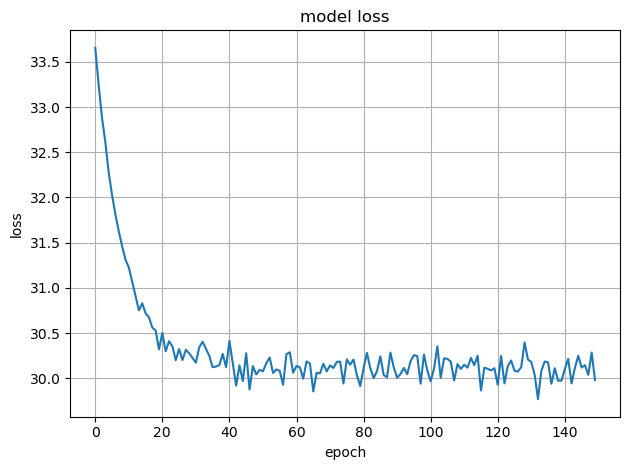

In [68]:
# summarize history for loss
plt.figure()
plt.grid()
plt.plot(history.history['loss'])
# plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
# plt.legend(['Training', 'Validation'], loc='upper left')
plt.tight_layout()
# plt.savefig('autoencoder_learning_curve_loss.png', dpi=300)
plt.show()

In [69]:
test_loss, test_acc = comp_model.evaluate(x_test_scaled, disease_labels_test, verbose=2)

print('\nTest accuracy:', test_acc)

3/3 - 0s - loss: 28.9435 - accuracy: 0.5256 - 102ms/epoch - 34ms/step

Test accuracy: 0.5256410241127014


In [70]:
comp_model.predict(x_test_scaled.head(1))[0]

1/1 [==============================] - 0s 84ms/step


array([0.15977725, 0.5545653 , 0.28565738], dtype=float32)

In [71]:
x_test_scaled.iloc[[0],:]

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.84188,0.930171,0.886737,0.835678,0.297964,0.668498,0.26667,0.278122,0.93352,...,0.799811,0.0,0.0,0.315927,0.580699,0.652889,0.283662,0.02108,0.271046,0.0


In [72]:
comp_model.save("../data/models/cd_clf")

INFO:tensorflow:Assets written to: ../data/models/cd_clf\assets
